In [1]:
# string = 'Hydrogen'
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import os
from datetime import datetime
# from torchvision import datasets, transforms, utils
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import Dataset
import torchvision.utils as vutils
import json
import PIL


Matplotlib created a temporary config/cache directory at /tmp/pbs.3746356.pbsha.ib.sockeye/matplotlib-l0a2wnb5 because the default path (/home/jovyan/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:
torch.cuda.is_available()

True

In [3]:
import sys
sys.path.insert(1, '/scratch/st-mgorges-1/jtoledom/SynthData/util')

from loaders import generateDatasets, inOut#, saveJSON, loadJSON#, MyData
from NNets import SimpleClas, SimpleDisc, SimpleGen, Reshape
# from tools import accuracy, tools, per_image_error, predVsTarget
from plotter import myPlots

from train import train

In [15]:
###Start Here
PATH = "/scratch/st-mgorges-1/jtoledom/nobackup/SynData/KagCerCanRisk/"

dir = str(16)
BATCH_SIZE=120
NUM_WORKERS=8
ngpu = 1
lr = 0.00001
latentSpace=100
lam=0.0
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")



In [16]:
dict = inOut().newDict(PATH,dir)
# dictFilename = os.listdir(os.path.join(PATH, "Dict", dir))[0]
# dict = inOut().loadDict(os.path.join(PATH, "Dict", dir, dictFilename))
dict['BatchSize'] = BATCH_SIZE
dict['NumWorkers'] = NUM_WORKERS
dict['ngpu'] = ngpu
dict['lr'] = lr
dict['LS']=latentSpace
# len(dict["LossGen"])
dict.keys()


dict_keys(['Class', 'Gen', 'Gen-Best', 'Disc', 'Disc-Best', 'Path', 'PathRoot', 'Dir', 'BatchSize', 'NumWorkers', 'ngpu', 'lr', 'LS'])

In [6]:
# dict['LossReg']=[0]

/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/transforms/transforms.py:280: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(
/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgor

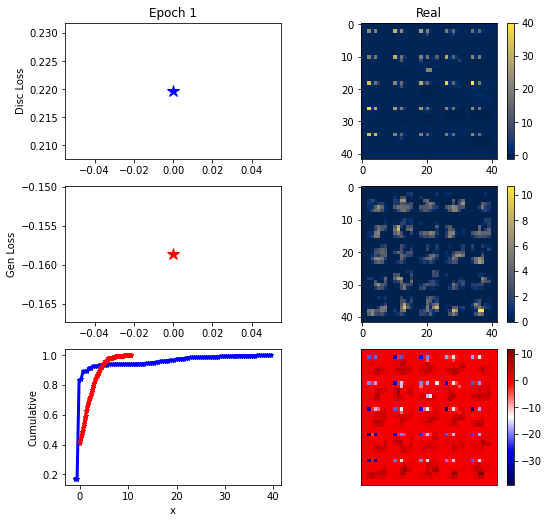

ErrG: -0.15859860394682204, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

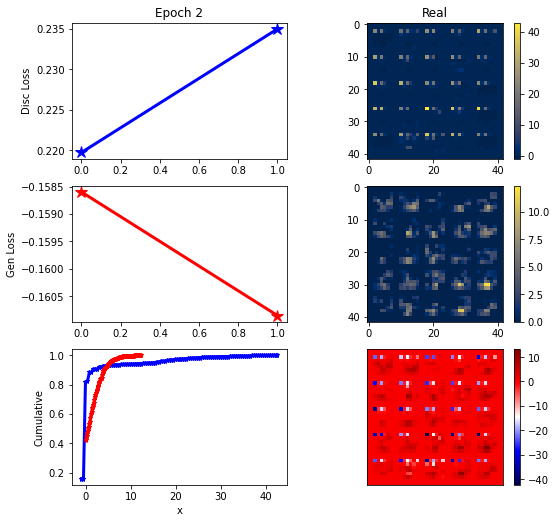

ErrG: -0.1608544715813228, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

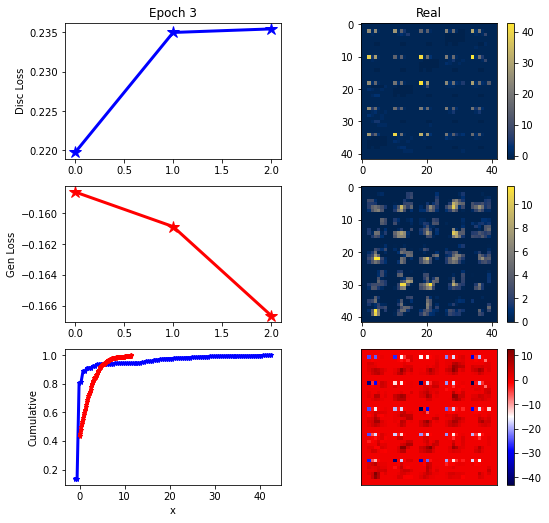

ErrG: -0.16665190245423997, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

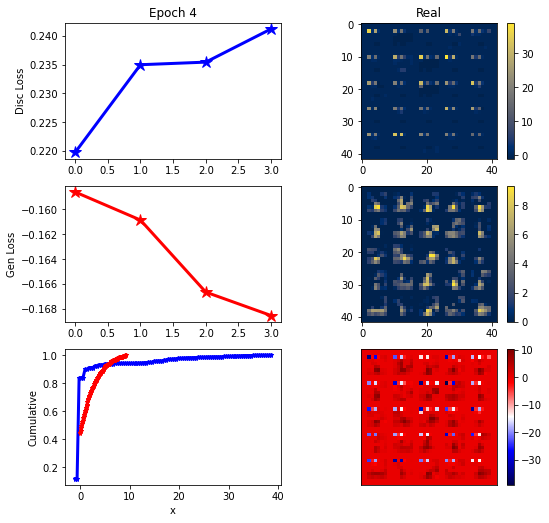

ErrG: -0.16853614151477814, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

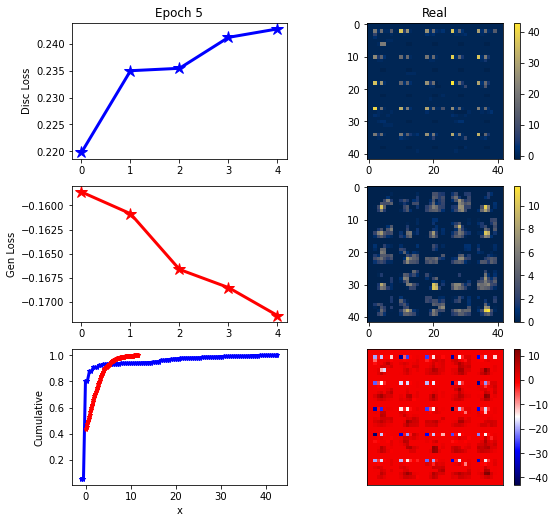

ErrG: -0.17144321756703512, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

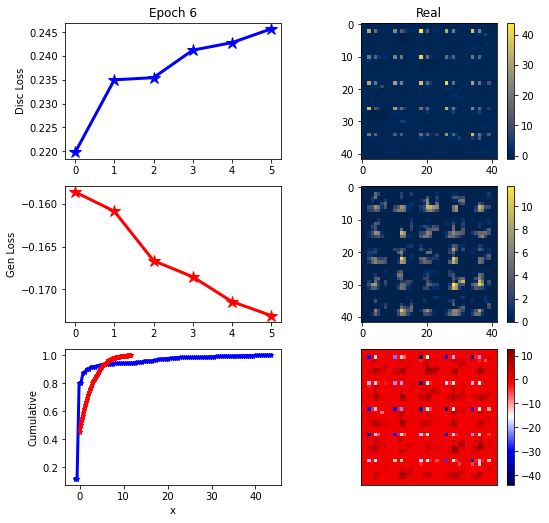

ErrG: -0.17307780470166886, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

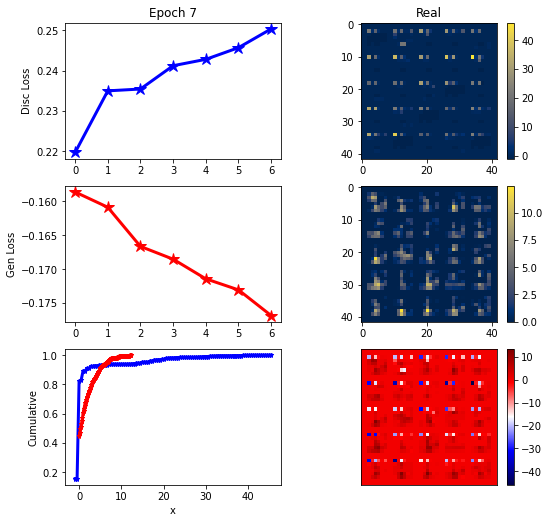

ErrG: -0.1768752464226314, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

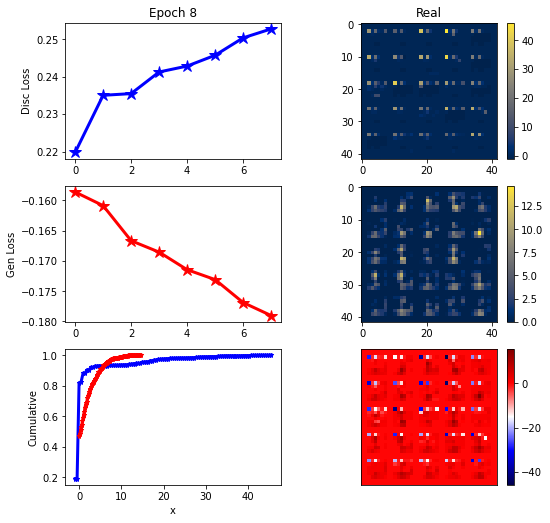

ErrG: -0.17902146066938127, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

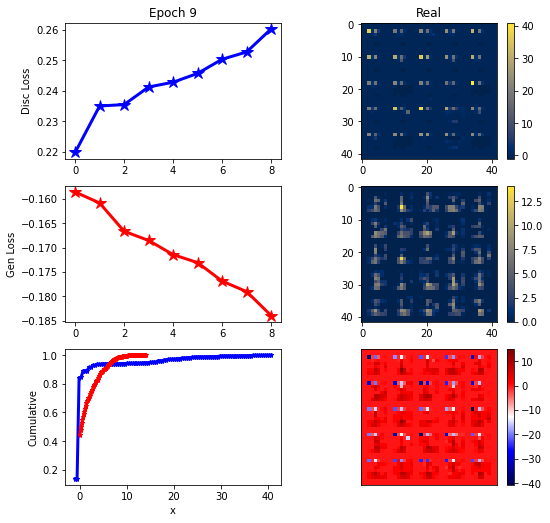

ErrG: -0.18393089302948543, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

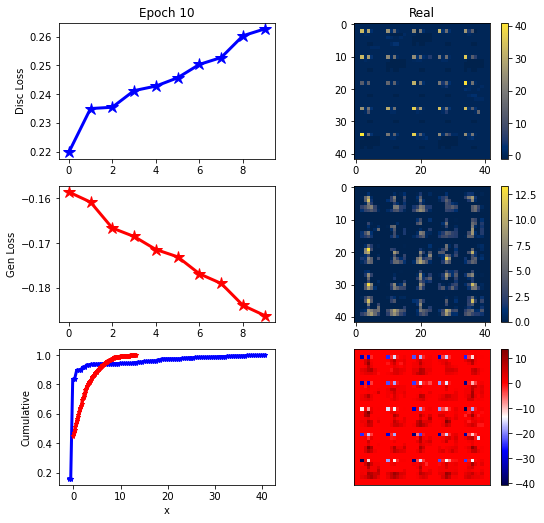

ErrG: -0.18619393237999507, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

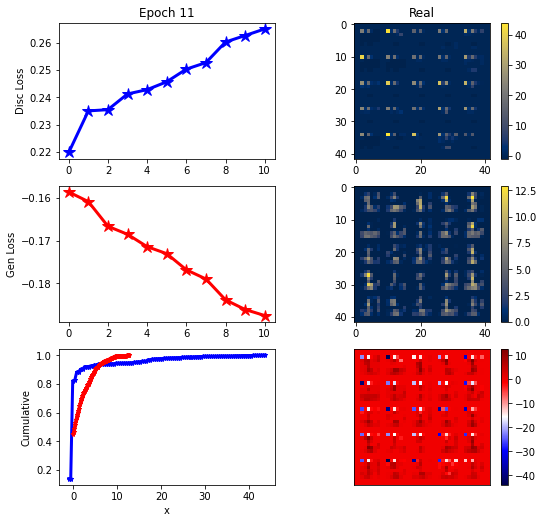

ErrG: -0.18760732454913004, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

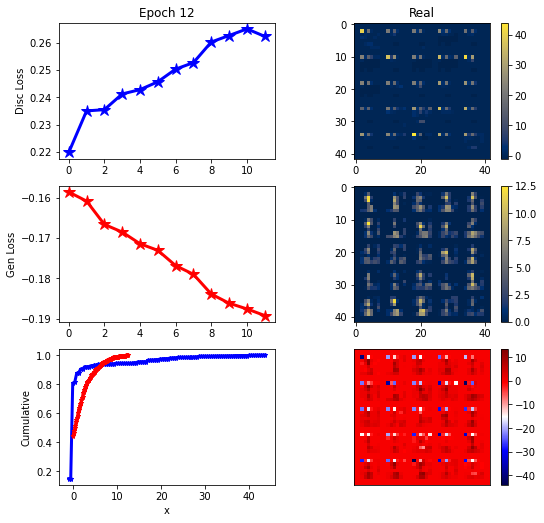

ErrG: -0.18925134624753678, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

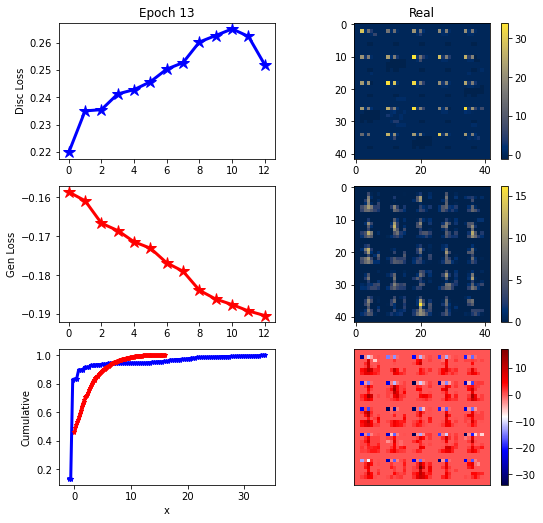

ErrG: -0.19043436433587754, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

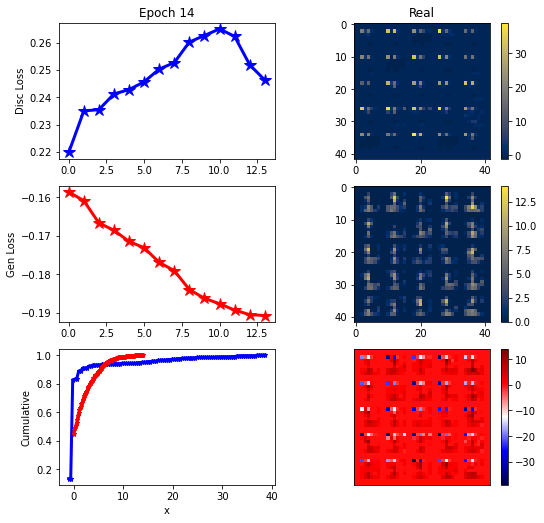

ErrG: -0.19066802518708365, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

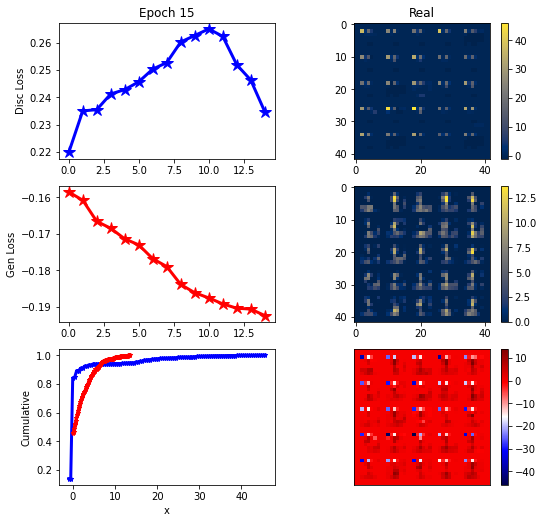

ErrG: -0.1924395923103605, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

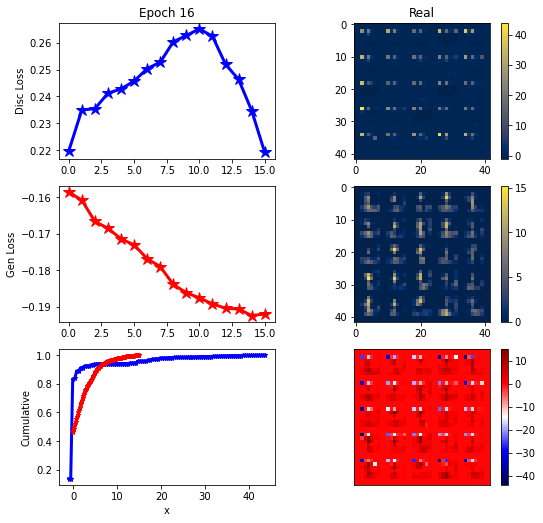

ErrG: -0.19202229806355067, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

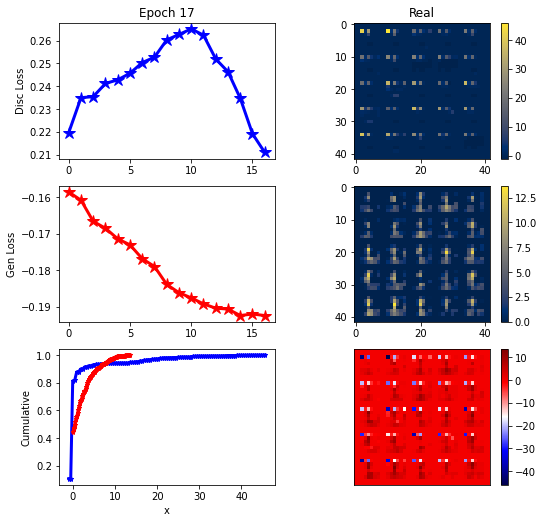

ErrG: -0.192445450595447, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

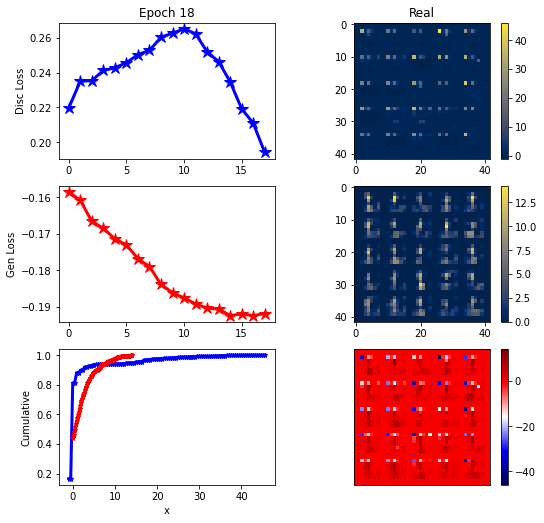

ErrG: -0.19192523189953395, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use 

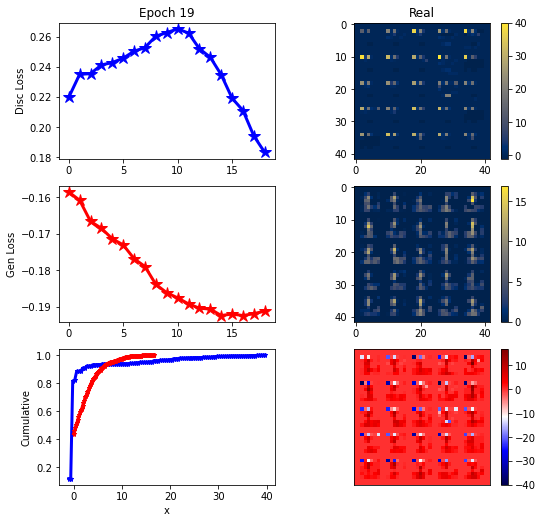

ErrG: -0.1912313380411693, ErrReg: 0.0


/scratch/st-mgorges-1/jtoledom/SynthData/train.py:198: UserWarning: torch.nn.utils.clip_grad_norm is now deprecated in favor of torch.nn.utils.clip_grad_norm_.
  torch.nn.utils.clip_grad_norm(disc.parameters(), 0.01)


In [ ]:
error_list_D, error_list_G  = train(dict, latentSpace=100, s=6, lam=lam).trainWGANs(device, 2000,25)
# error_list_D, error_list_G  = train(dict, latentSpace=100, s=6, lam=lam).trainGANs(device, 2000,25)

999


/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/transforms/transforms.py:280: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarn

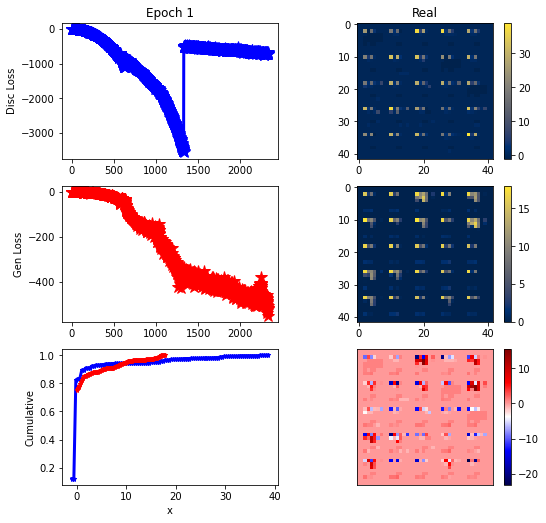

ErrG: -517.111833844866, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


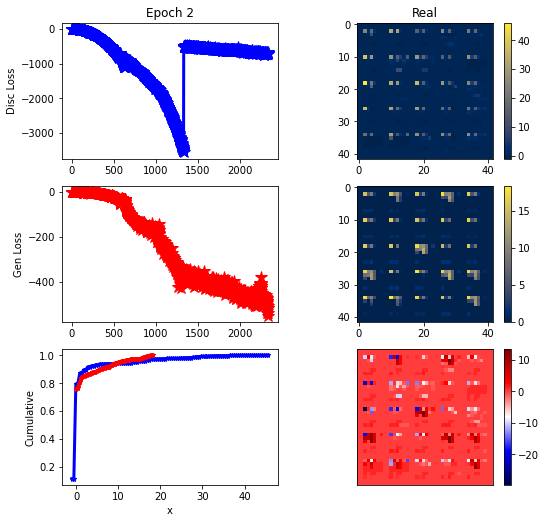

ErrG: -538.851824079241, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


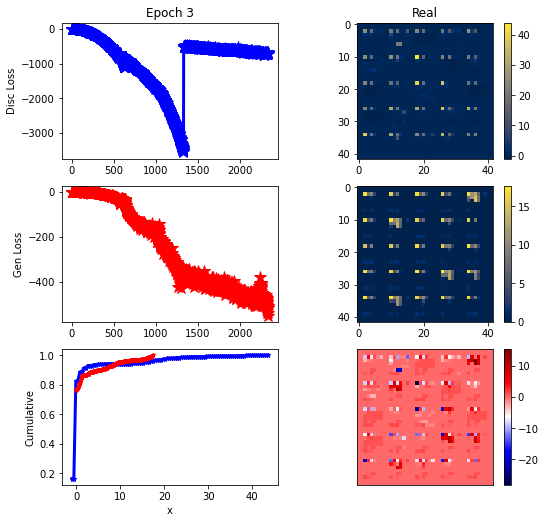

ErrG: -511.7481994628906, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


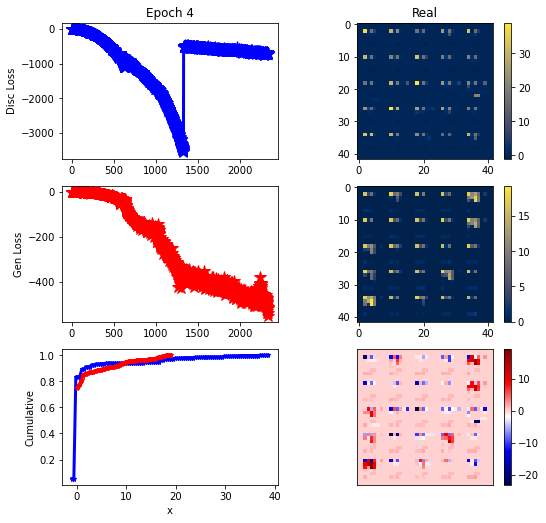

ErrG: -515.7529776436942, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


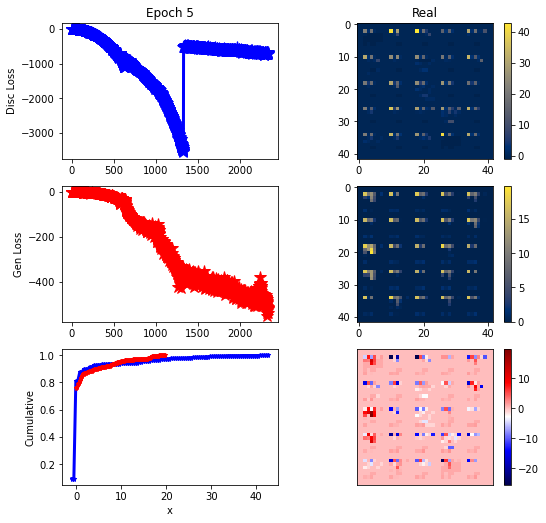

ErrG: -523.2813415527344, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


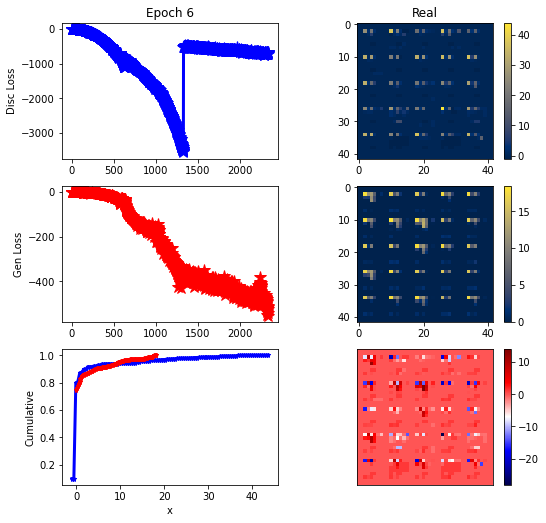

ErrG: -552.4070478166852, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


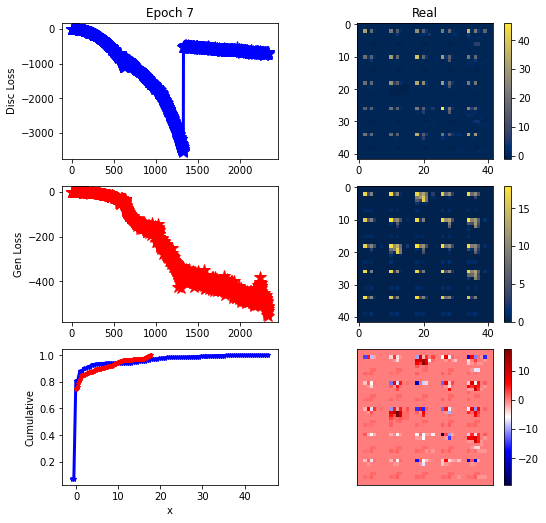

ErrG: -533.8821367536273, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


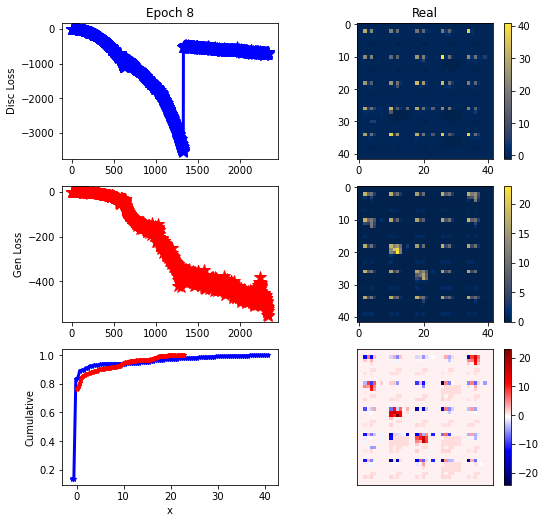

ErrG: -553.6935555594308, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


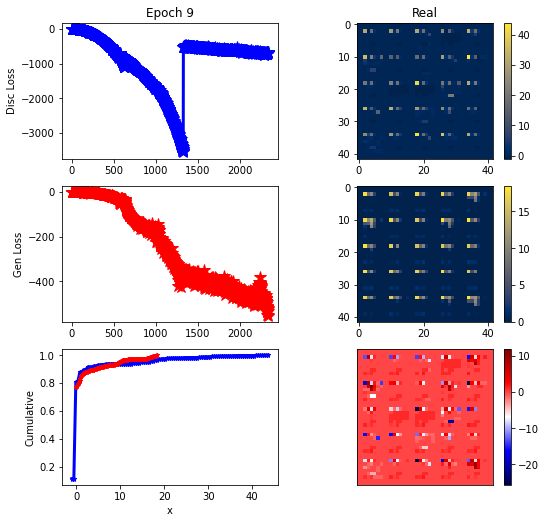

ErrG: -519.6598685128348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


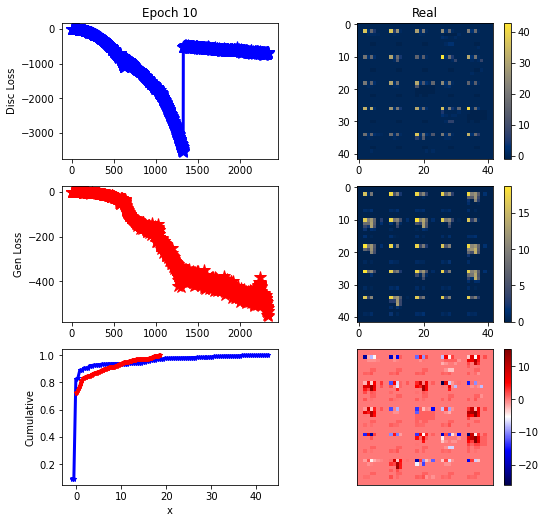

ErrG: -531.5518188476562, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


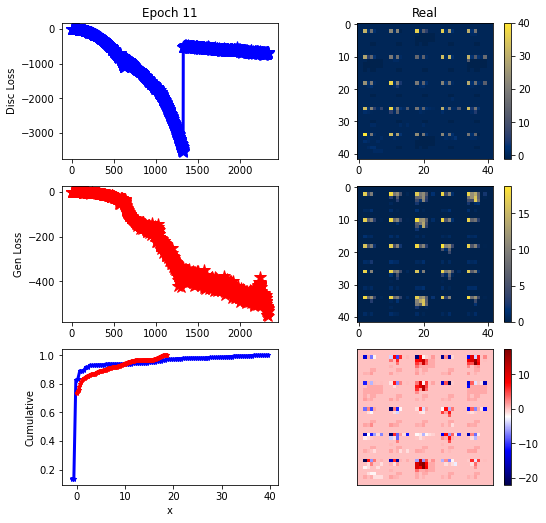

ErrG: -526.0553806849888, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


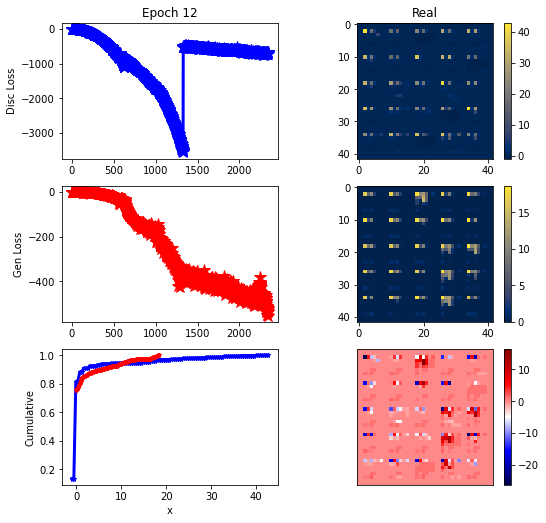

ErrG: -538.0020882742746, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


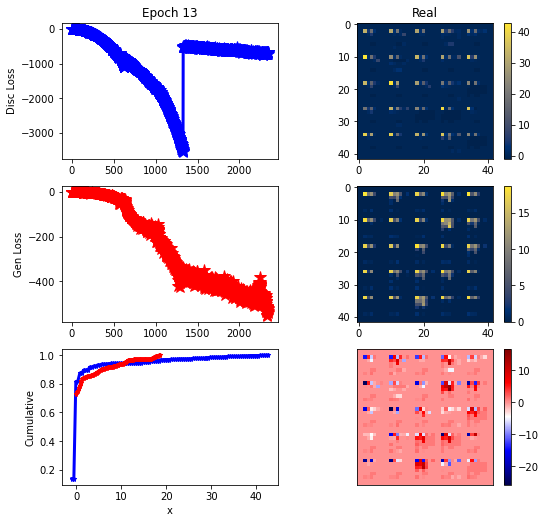

ErrG: -542.1309073311942, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


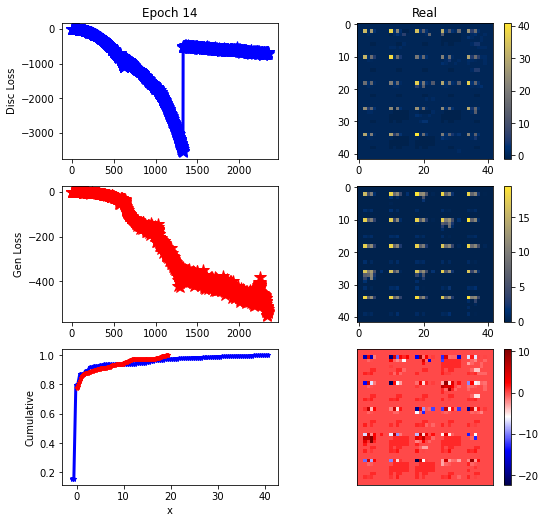

ErrG: -537.2462332589286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


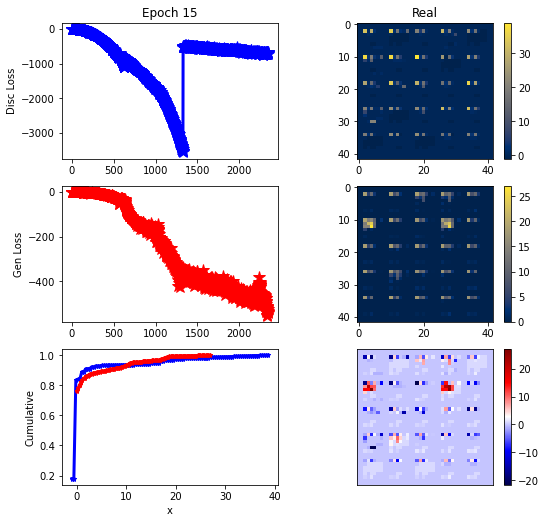

ErrG: -532.452902657645, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


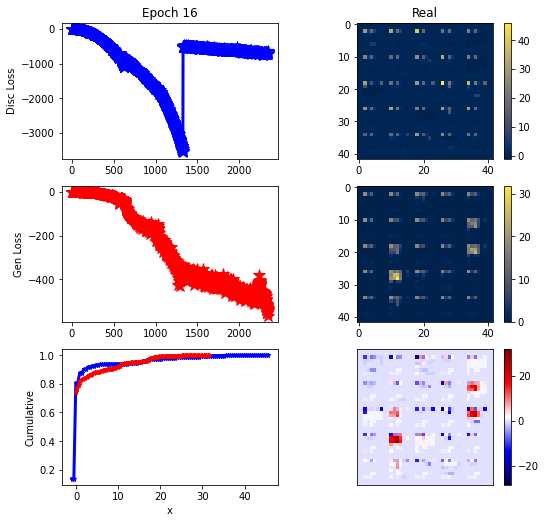

ErrG: -565.0561174665179, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


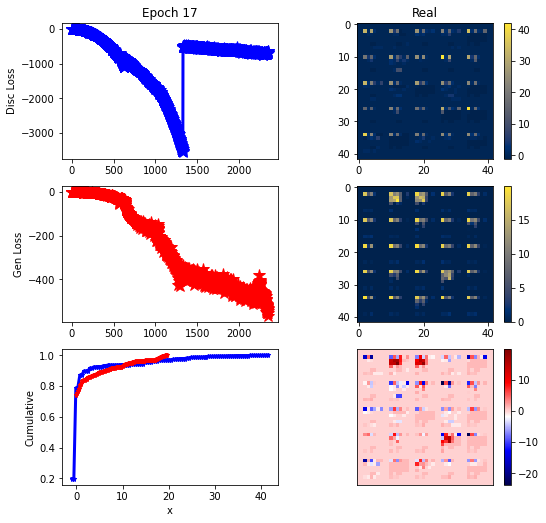

ErrG: -553.2423531668527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


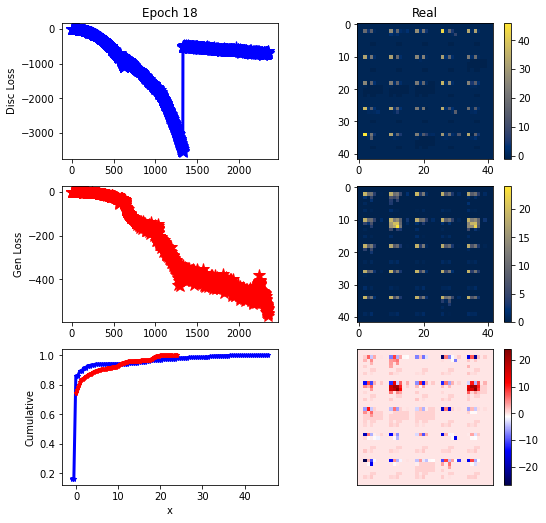

ErrG: -557.8705182756696, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


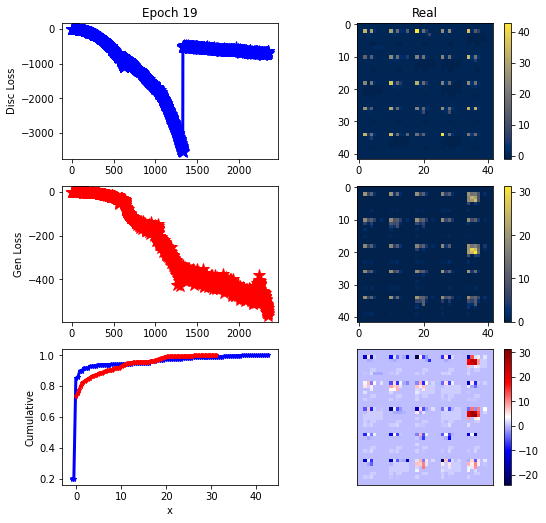

ErrG: -545.1789986746652, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


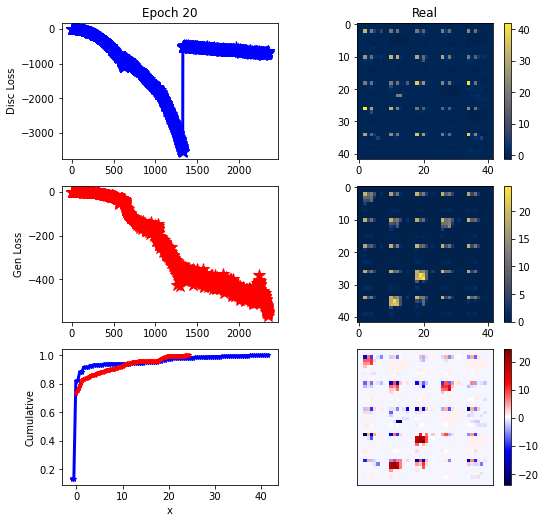

ErrG: -548.7911507742746, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


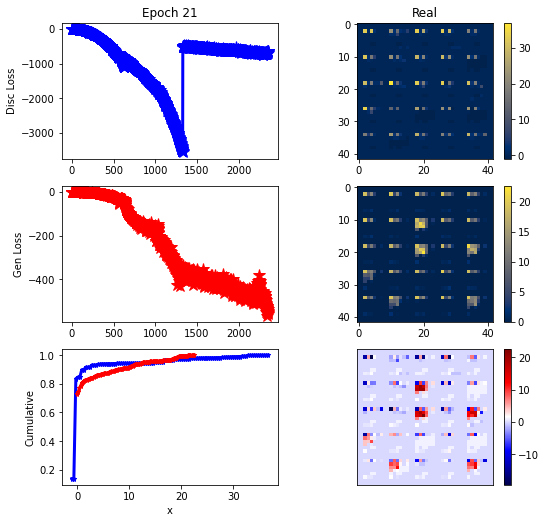

ErrG: -533.6697300502232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


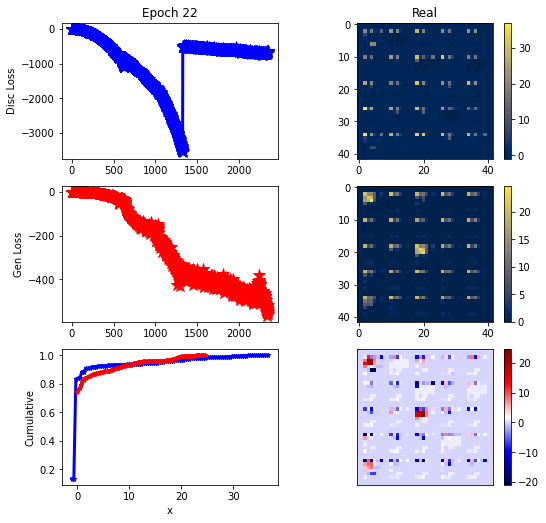

ErrG: -516.0581621442523, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


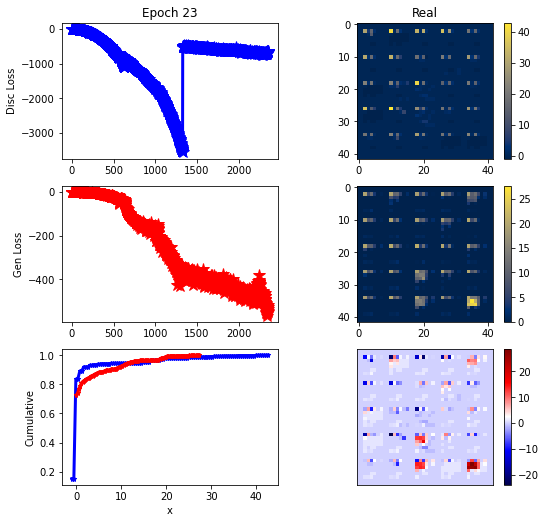

ErrG: -526.5704956054688, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


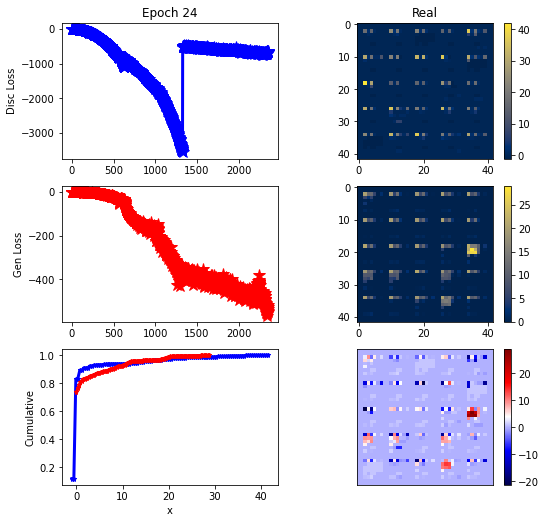

ErrG: -543.6351536342075, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


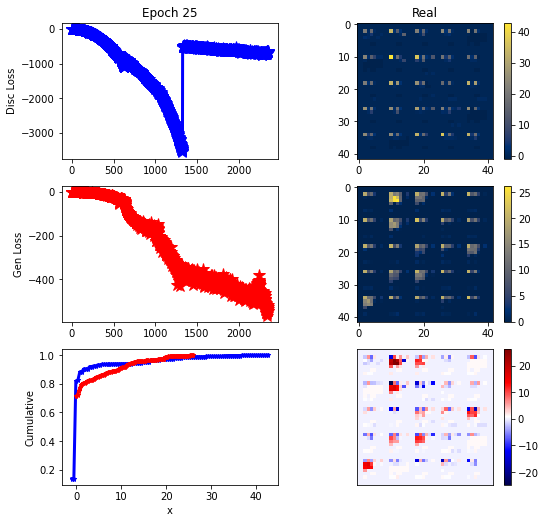

ErrG: -543.5091639927456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


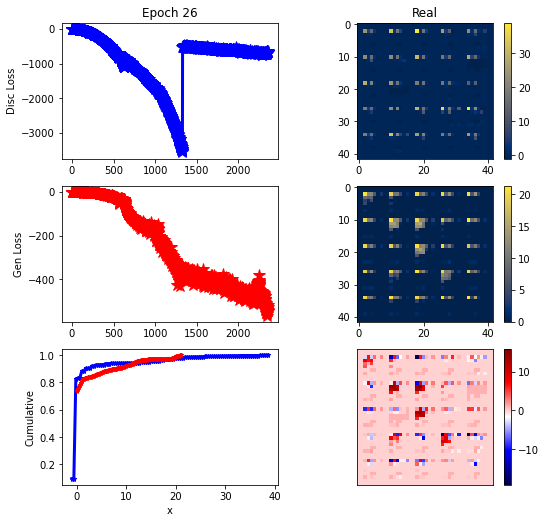

ErrG: -538.5259704589844, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


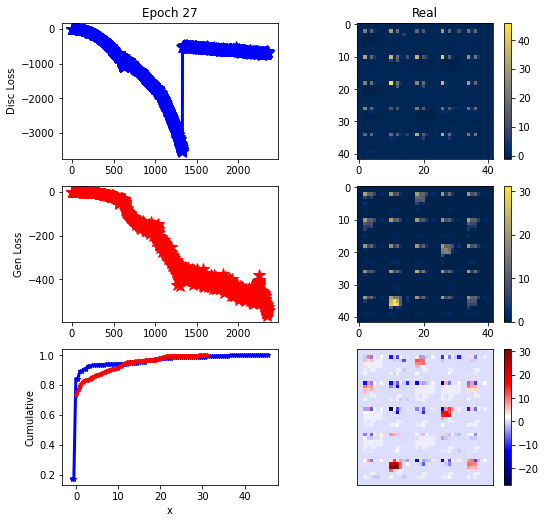

ErrG: -543.4065508161273, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


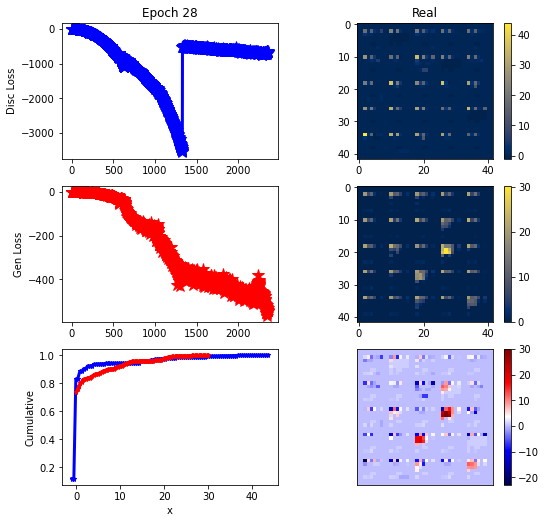

ErrG: -529.8622305733817, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


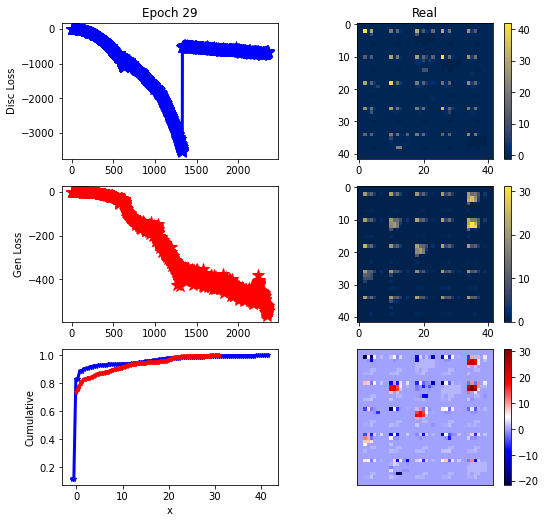

ErrG: -523.6355852399554, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


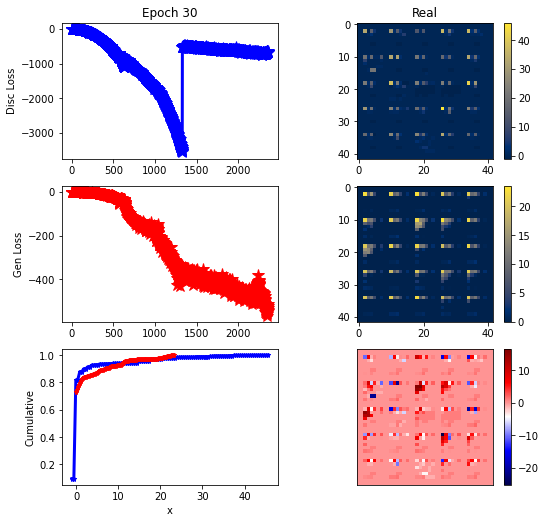

ErrG: -513.65480695452, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


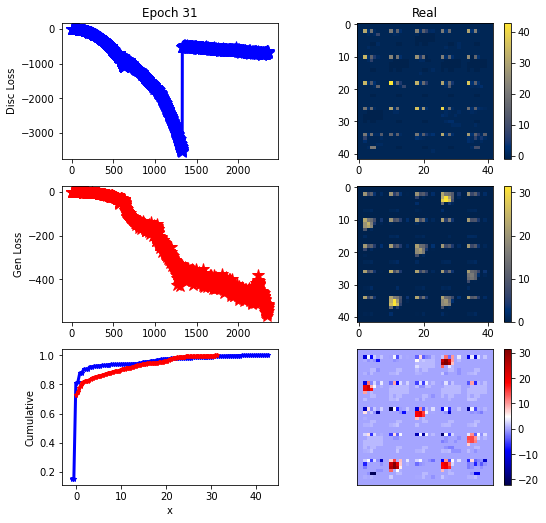

ErrG: -518.0777675083706, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


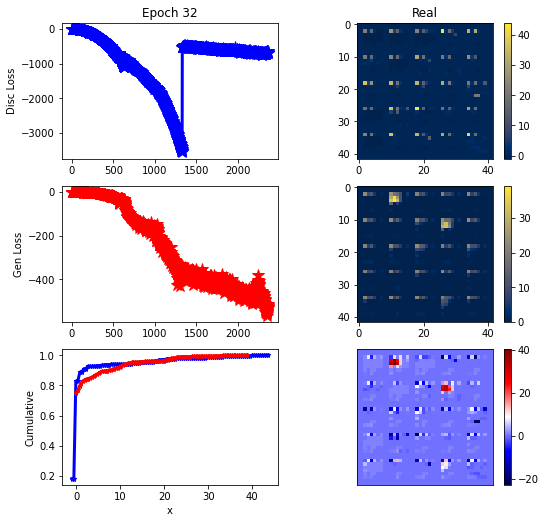

ErrG: -527.8505772181919, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


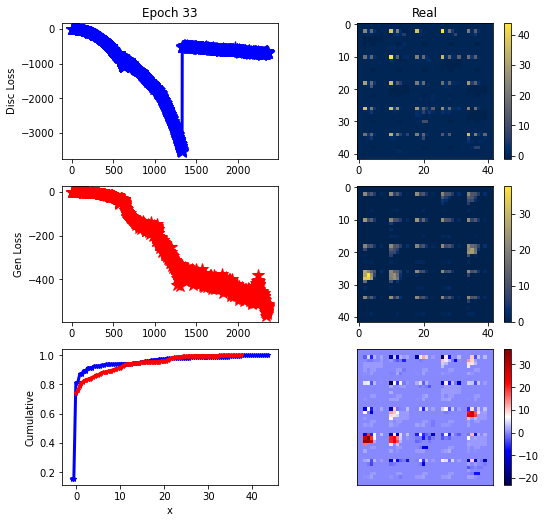

ErrG: -525.6074698311942, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


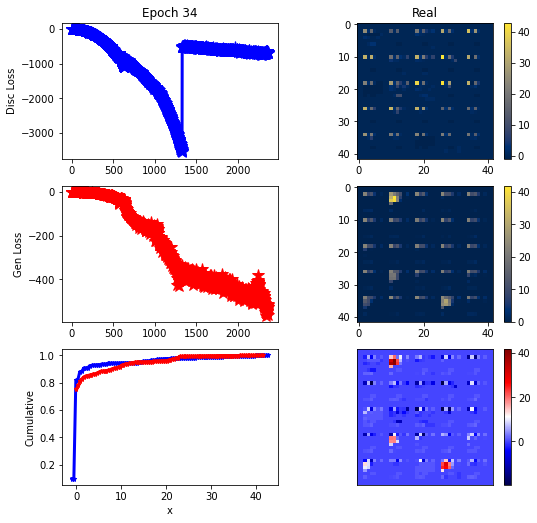

ErrG: -560.851296561105, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


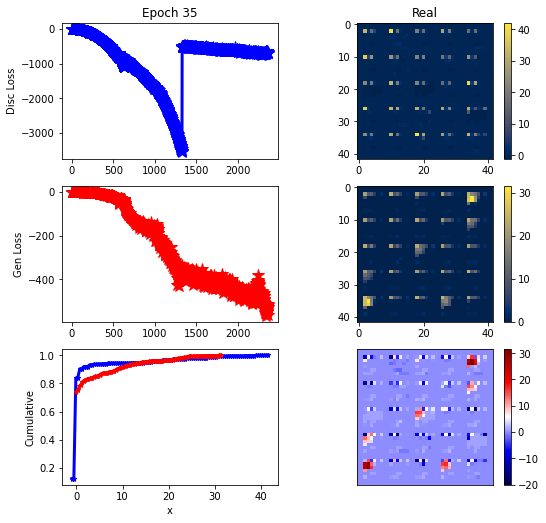

ErrG: -510.1384713309152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


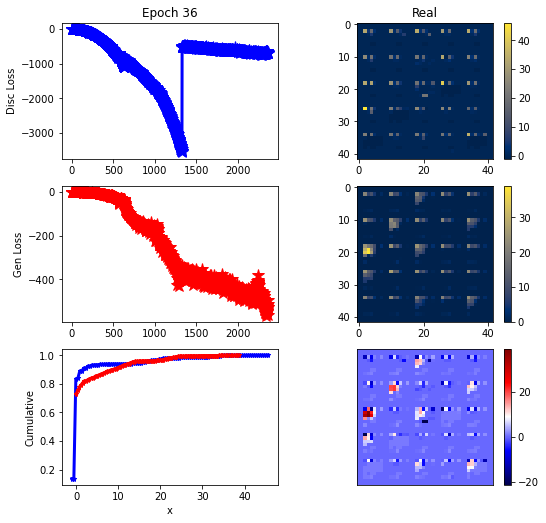

ErrG: -494.25125994001115, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


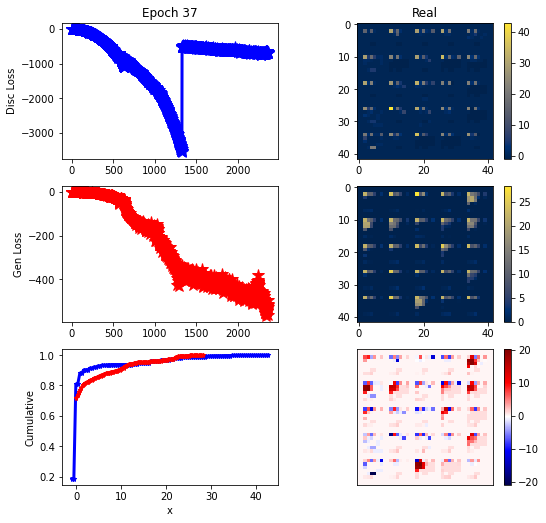

ErrG: -516.9439784458706, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


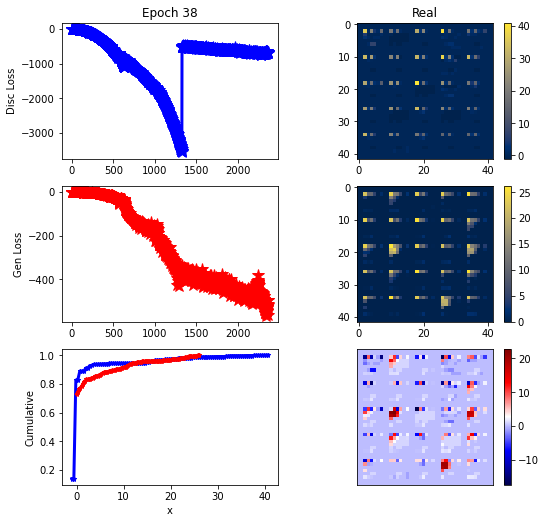

ErrG: -495.35818917410717, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


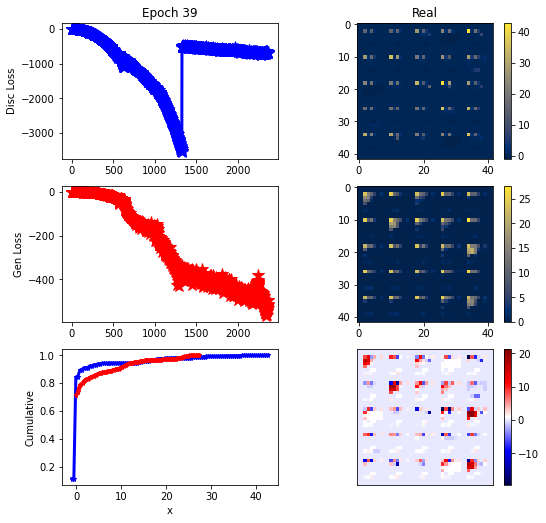

ErrG: -530.9620317731585, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


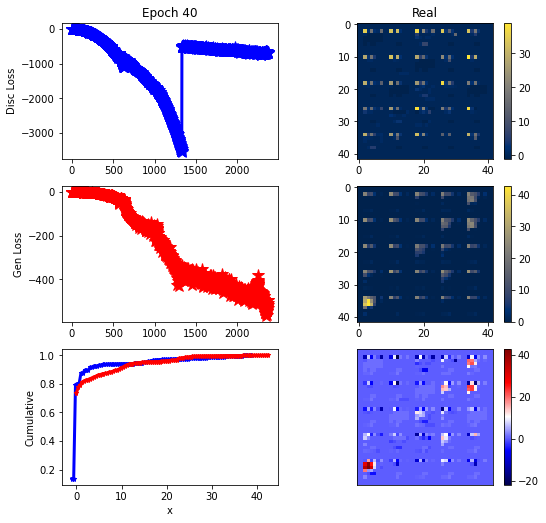

ErrG: -509.00819614955356, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


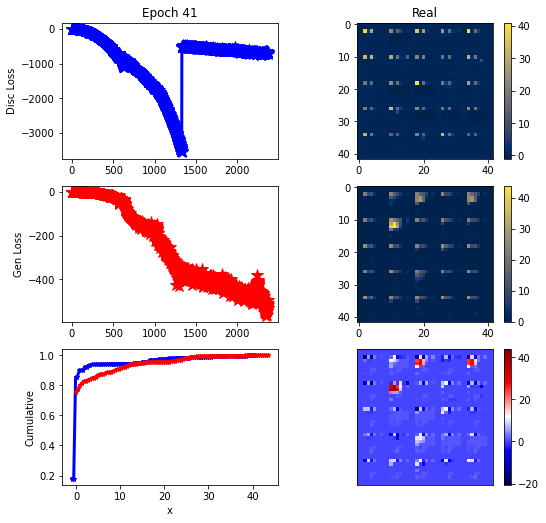

ErrG: -530.1208365304129, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


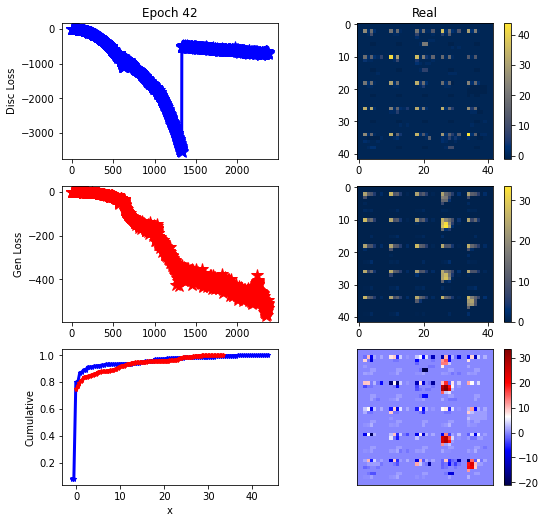

ErrG: -514.3363821847098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


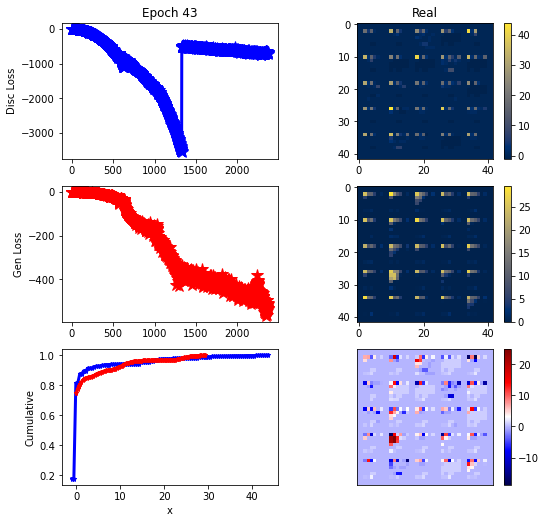

ErrG: -533.2142290387835, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


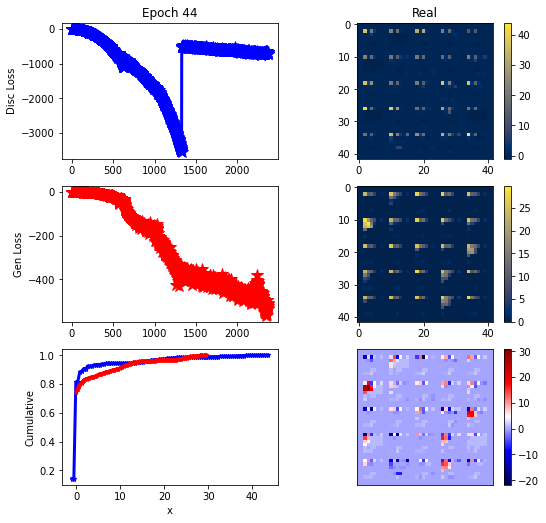

ErrG: -521.0299900599888, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


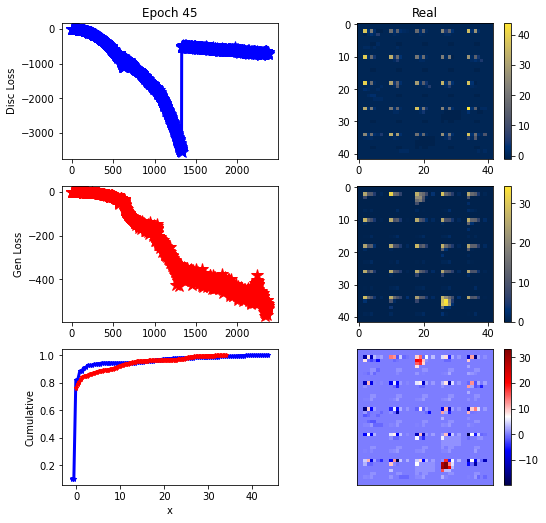

ErrG: -522.1395743233817, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


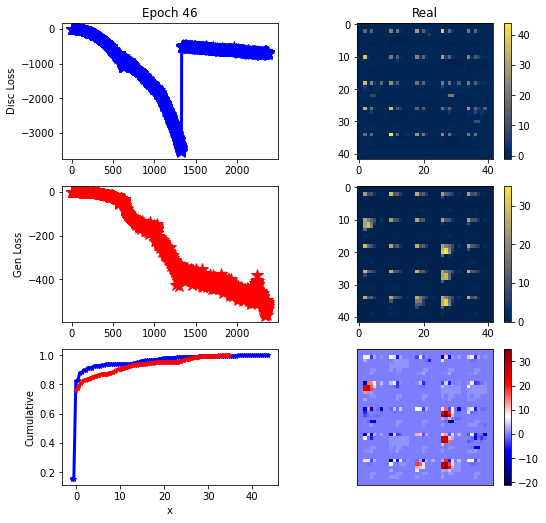

ErrG: -500.97613525390625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


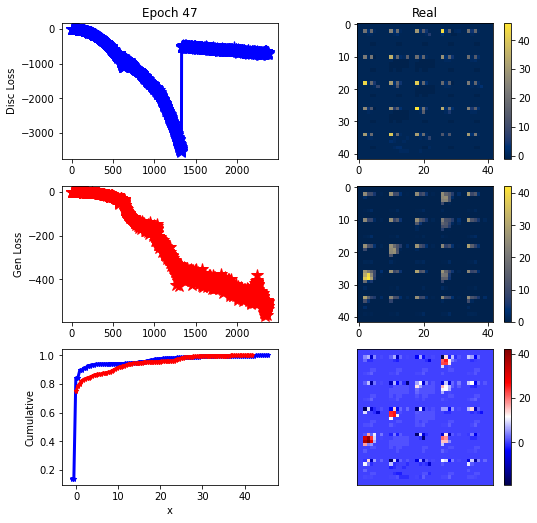

ErrG: -497.6891784667969, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


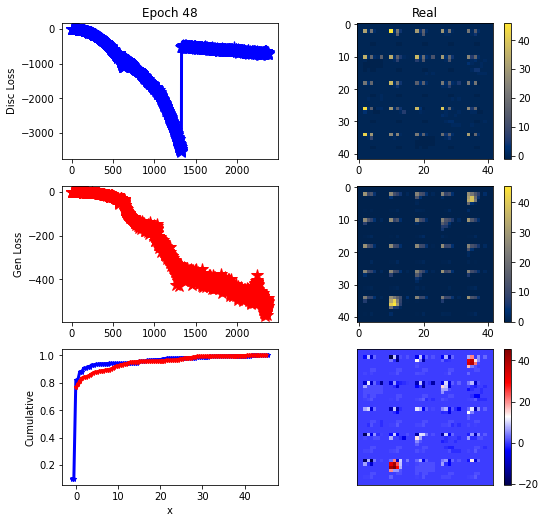

ErrG: -484.4989231654576, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


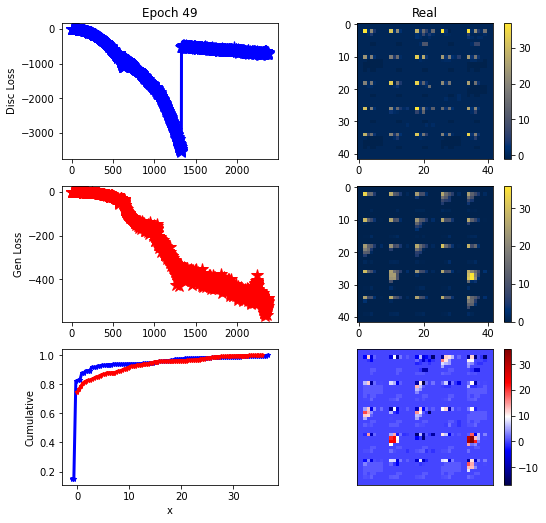

ErrG: -483.9714791434152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


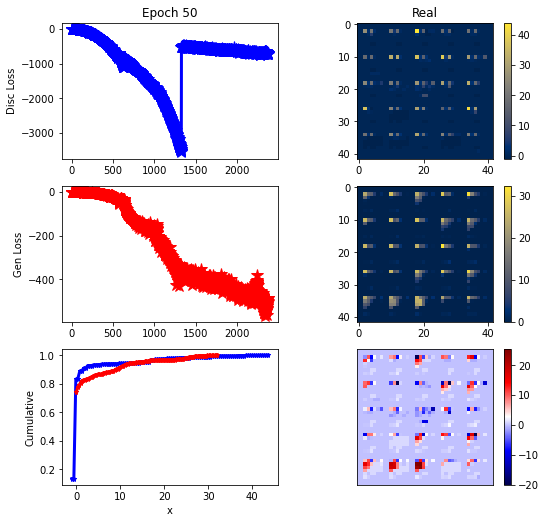

ErrG: -485.09805733816967, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


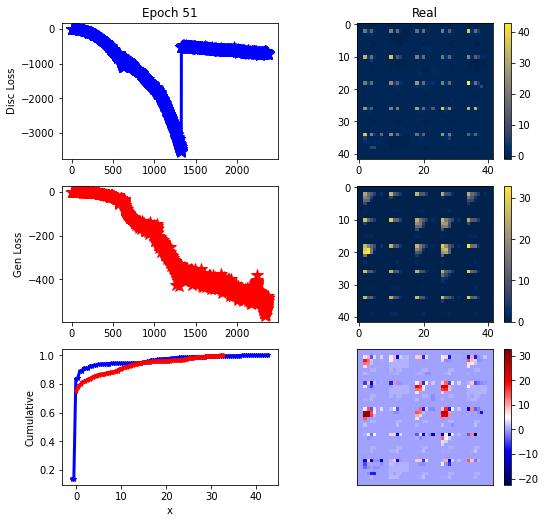

ErrG: -477.0490940638951, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


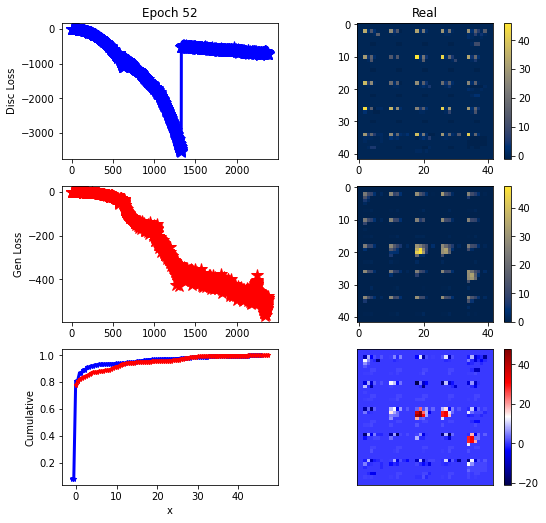

ErrG: -493.9368111746652, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


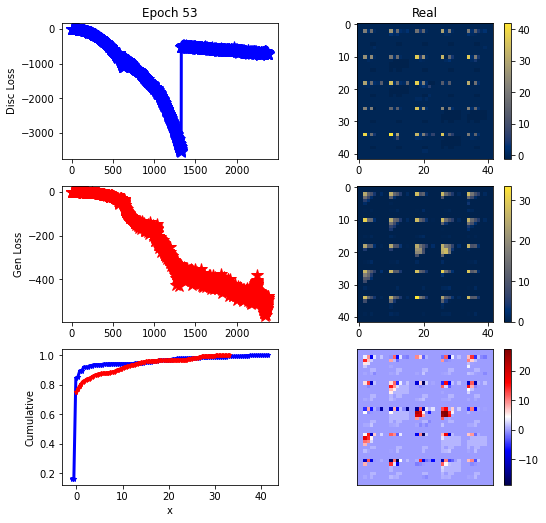

ErrG: -476.5482918875558, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


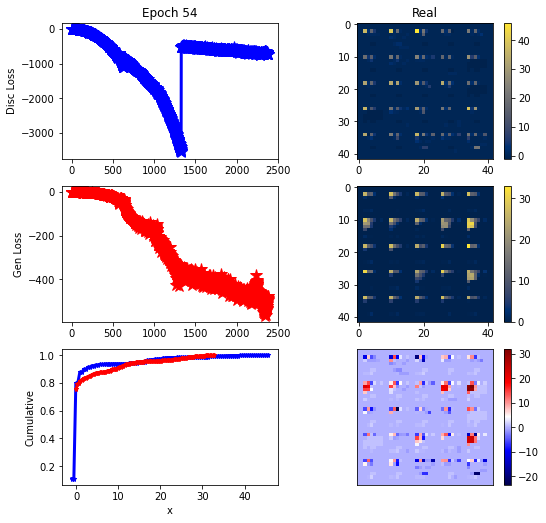

ErrG: -489.39969744001115, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


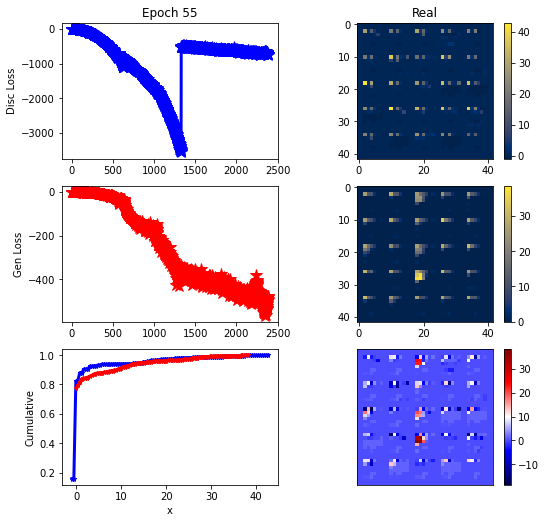

ErrG: -482.0037841796875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


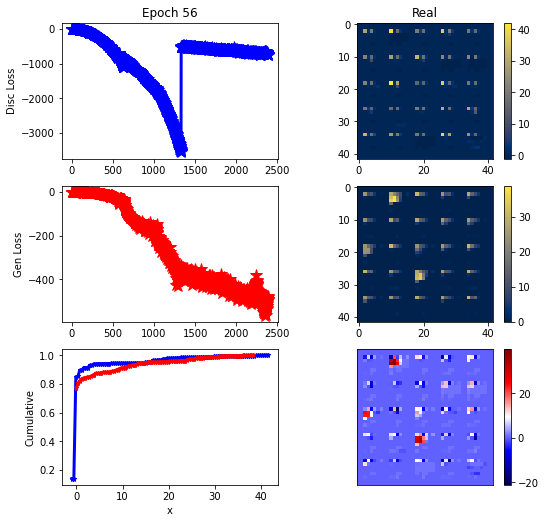

ErrG: -487.6055821010045, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


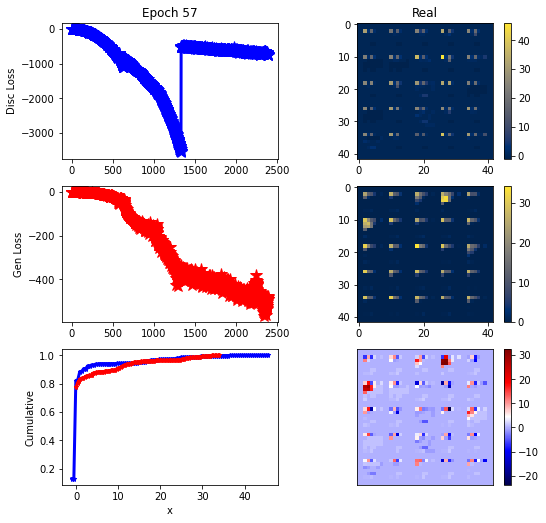

ErrG: -487.8533150809152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


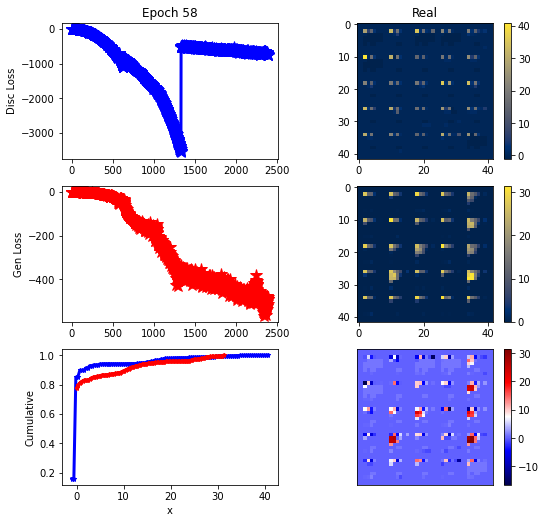

ErrG: -510.35794939313615, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


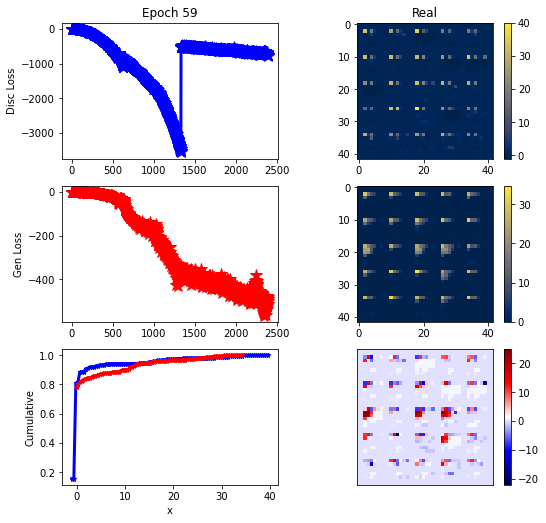

ErrG: -497.3302089146205, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


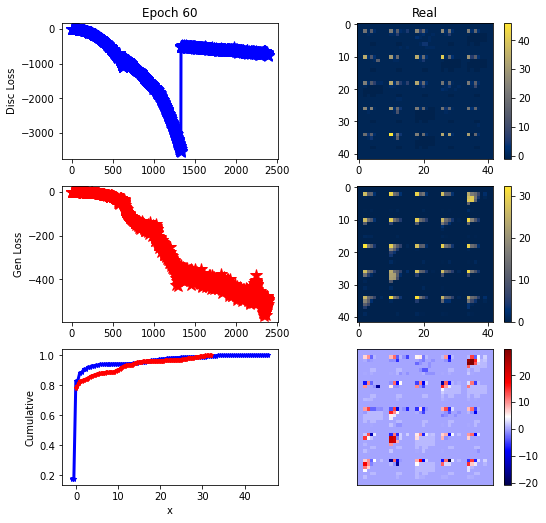

ErrG: -492.5984409877232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


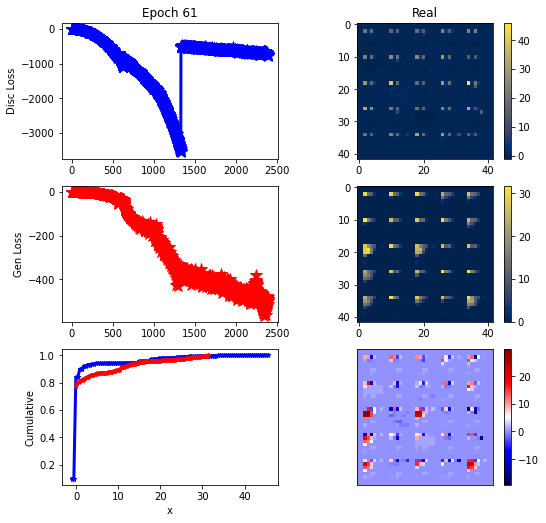

ErrG: -478.21597726004467, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


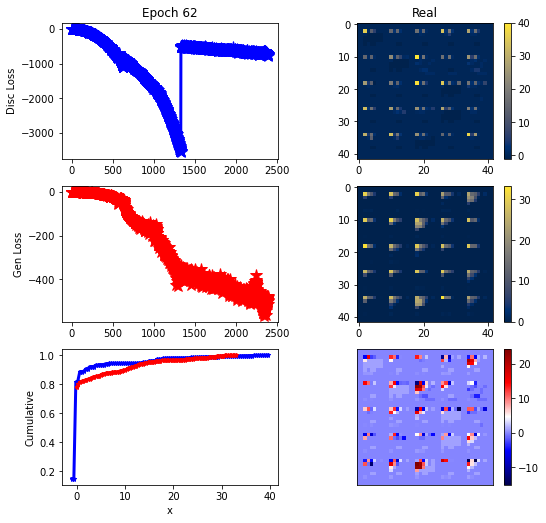

ErrG: -477.25621250697543, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


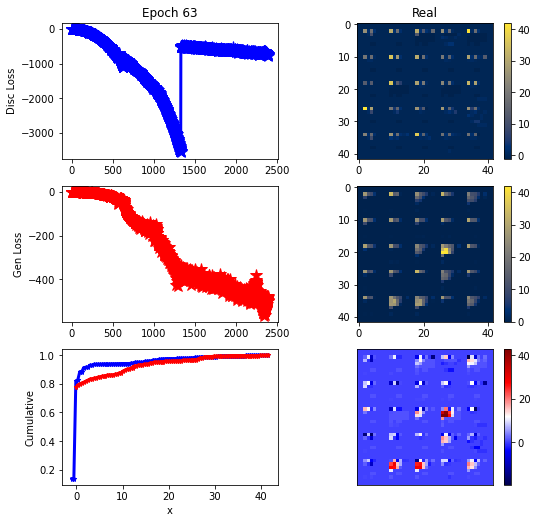

ErrG: -497.0066659109933, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


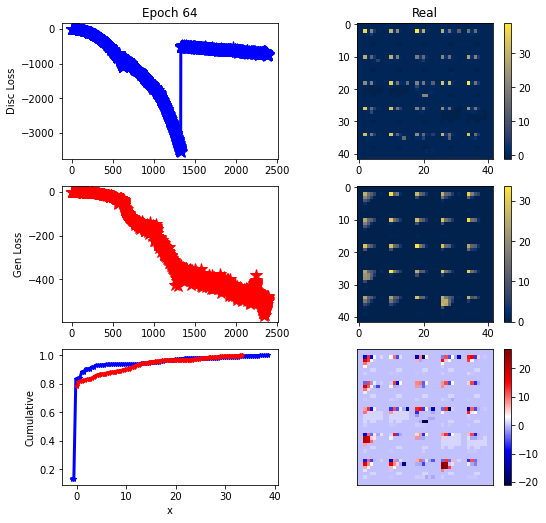

ErrG: -491.482674734933, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


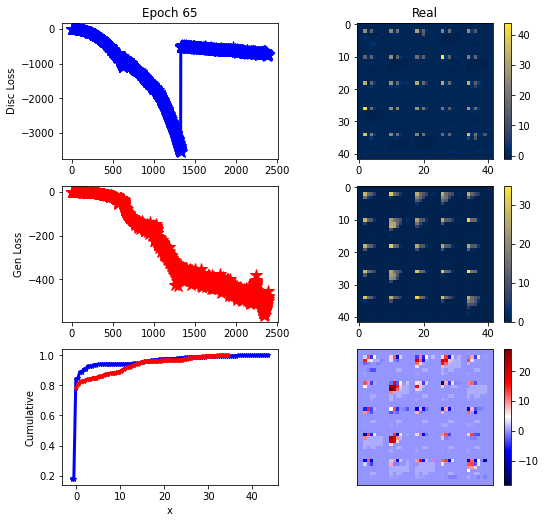

ErrG: -454.29466465541293, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


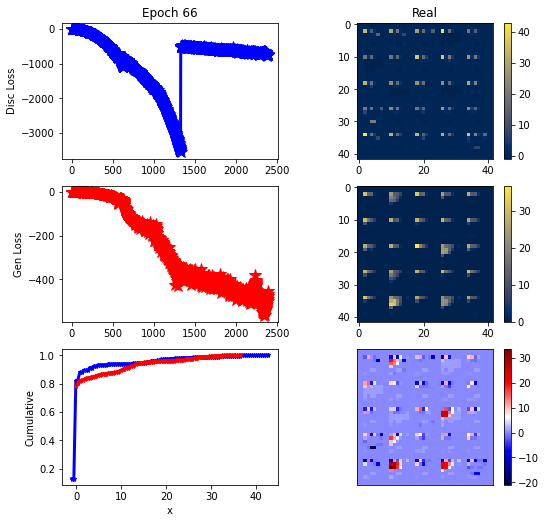

ErrG: -468.4987357003348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


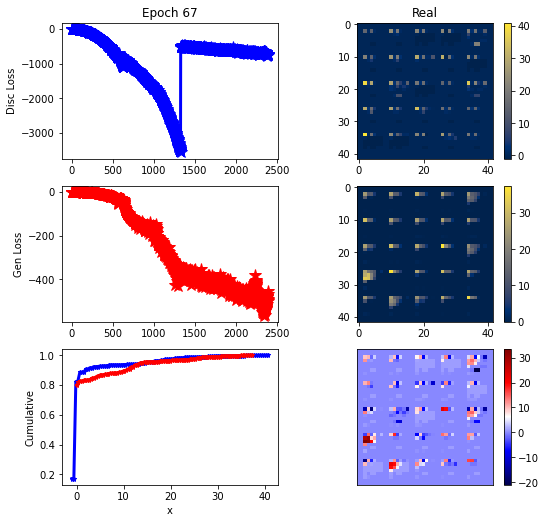

ErrG: -493.3990391322545, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


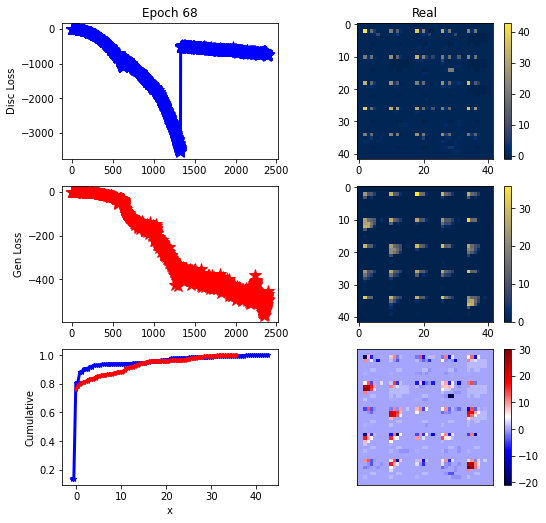

ErrG: -492.6941877092634, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


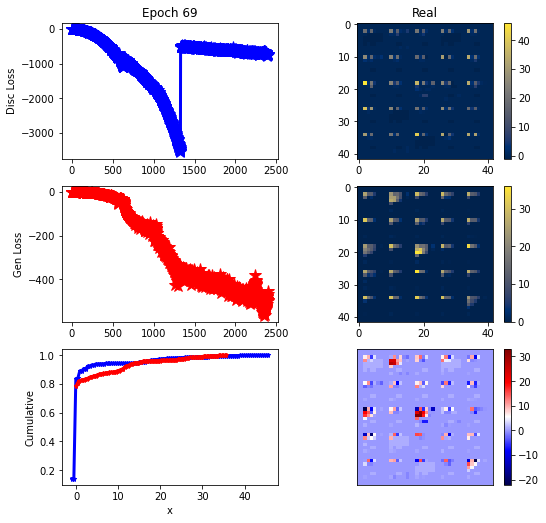

ErrG: -498.24230521065846, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


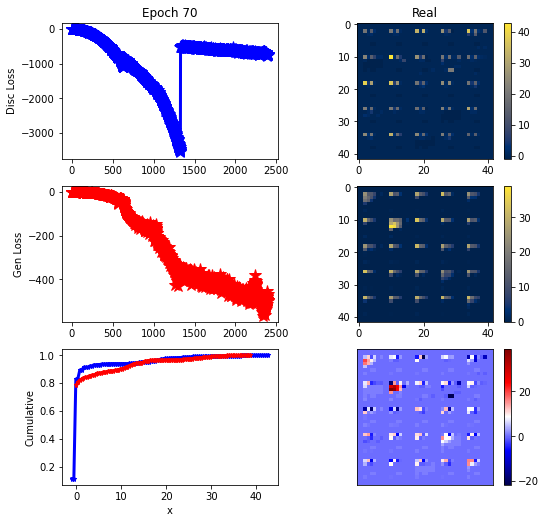

ErrG: -495.89280482700894, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


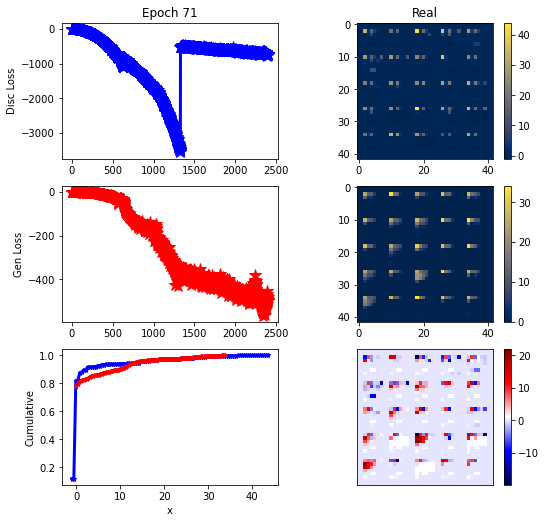

ErrG: -479.68554251534596, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


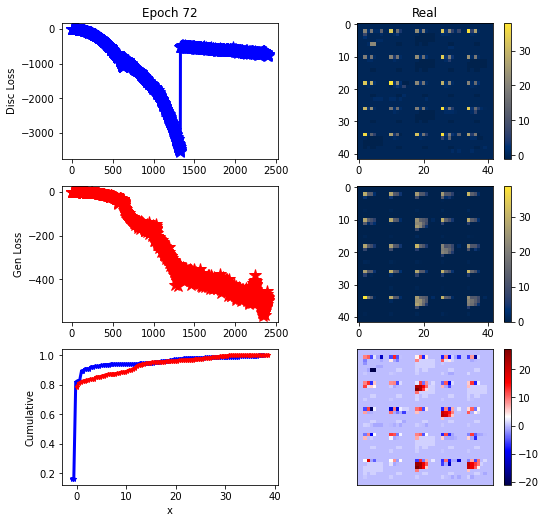

ErrG: -486.09175763811385, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


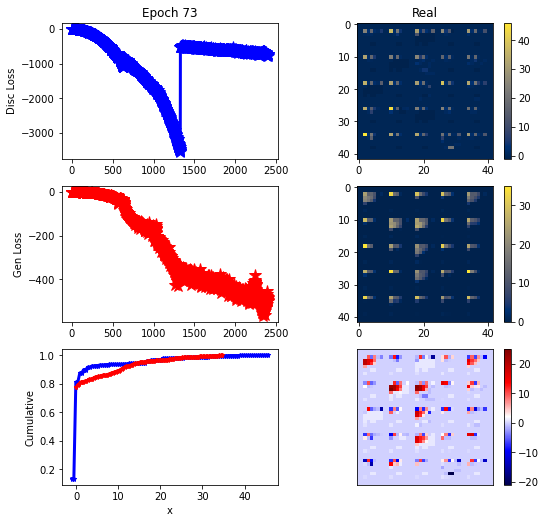

ErrG: -496.5747811453683, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


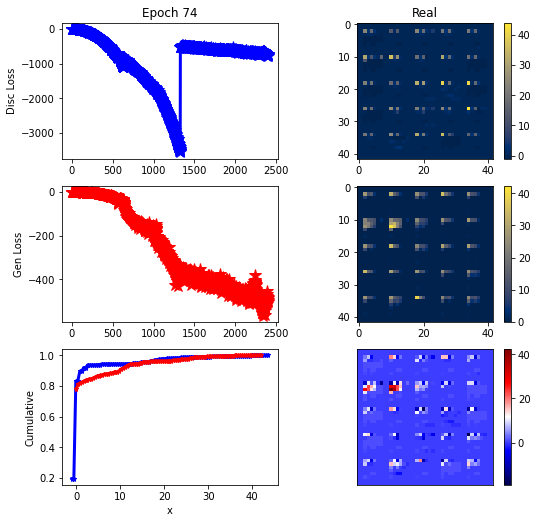

ErrG: -503.1174577985491, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


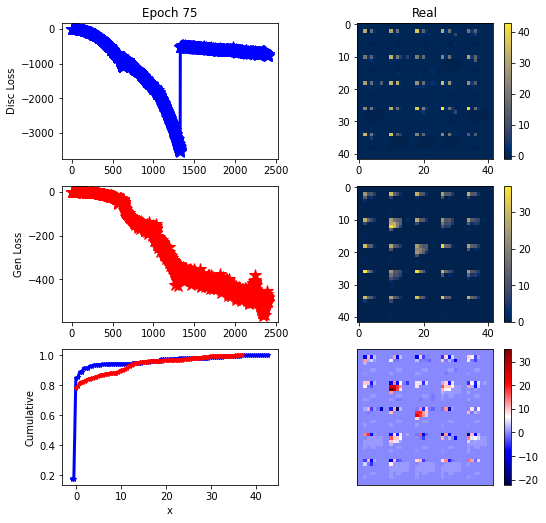

ErrG: -502.6878008161272, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


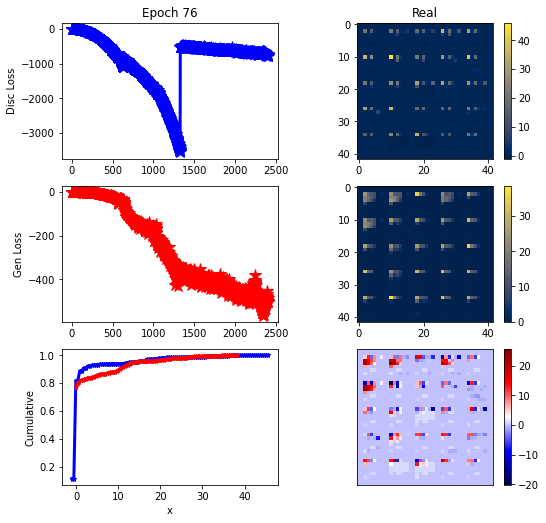

ErrG: -503.6199645996094, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


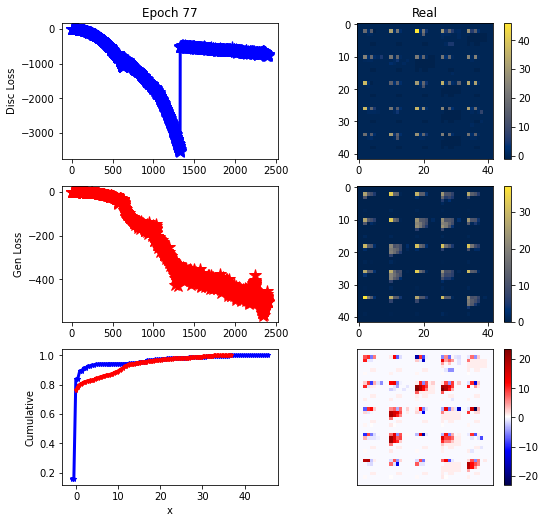

ErrG: -501.9625767299107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


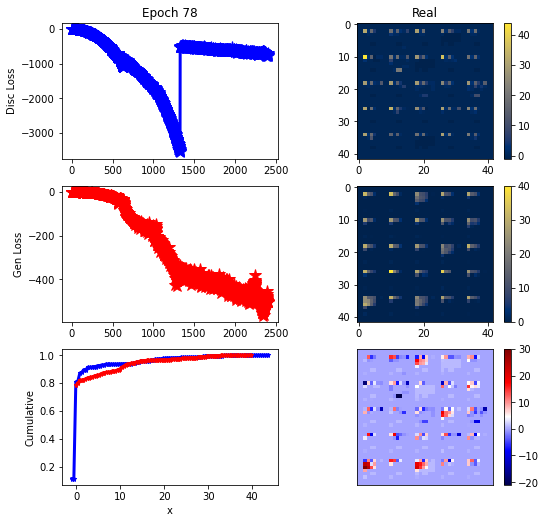

ErrG: -498.6196725027902, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


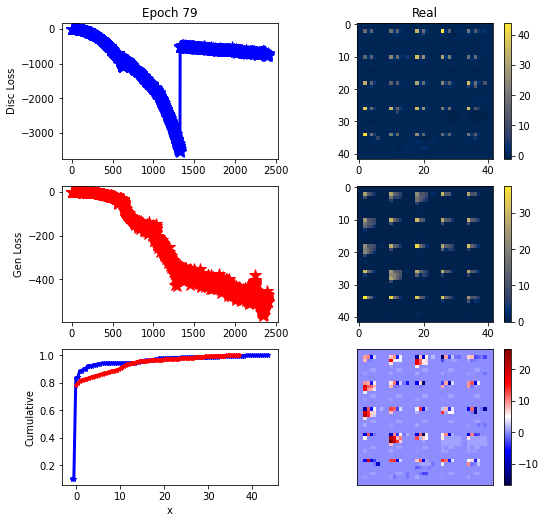

ErrG: -471.8958173479353, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


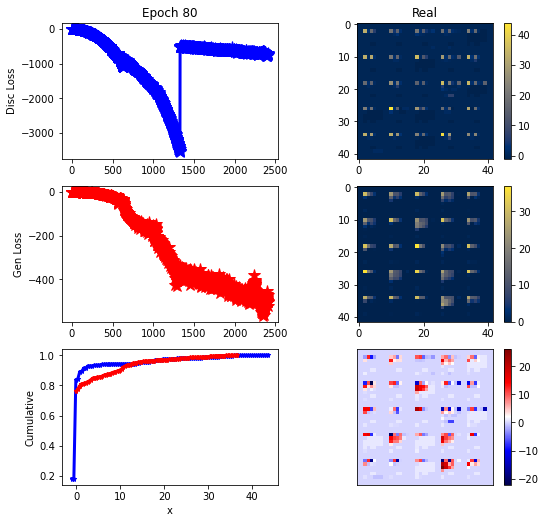

ErrG: -520.5636378696987, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


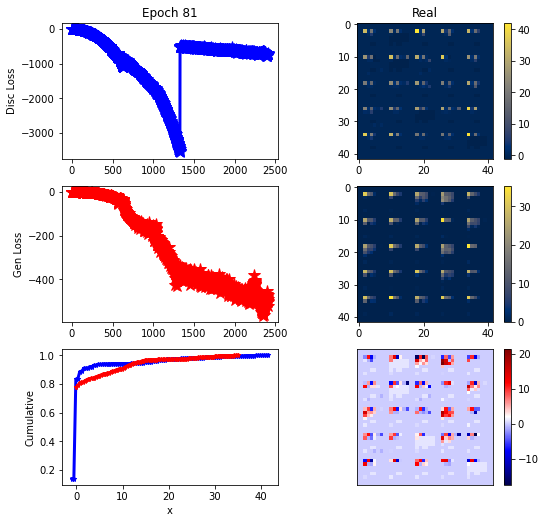

ErrG: -490.7313319614955, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


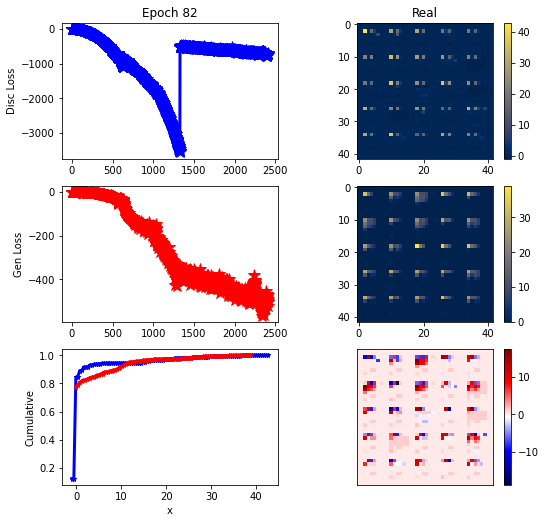

ErrG: -504.6253662109375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


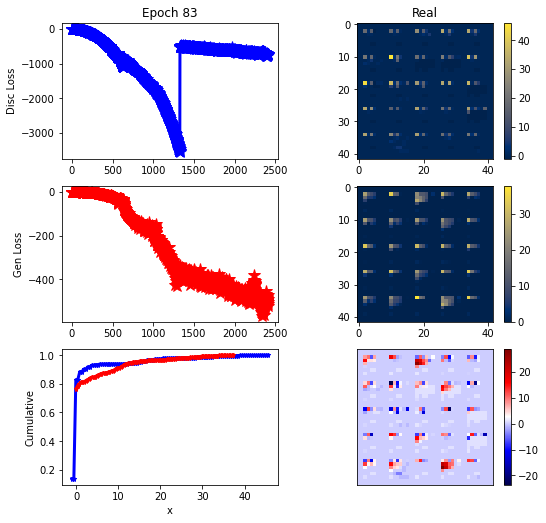

ErrG: -510.8763427734375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


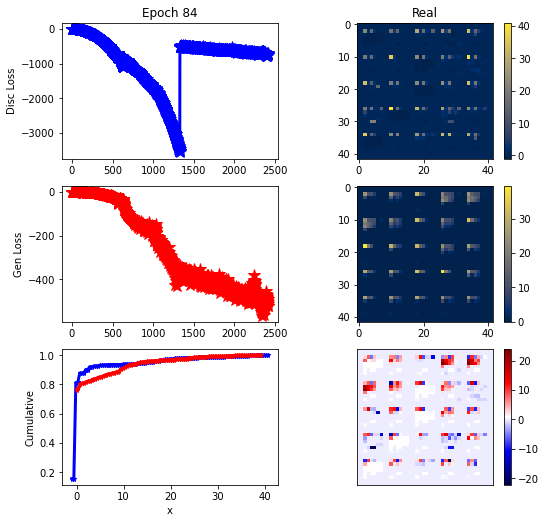

ErrG: -522.0088239397321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


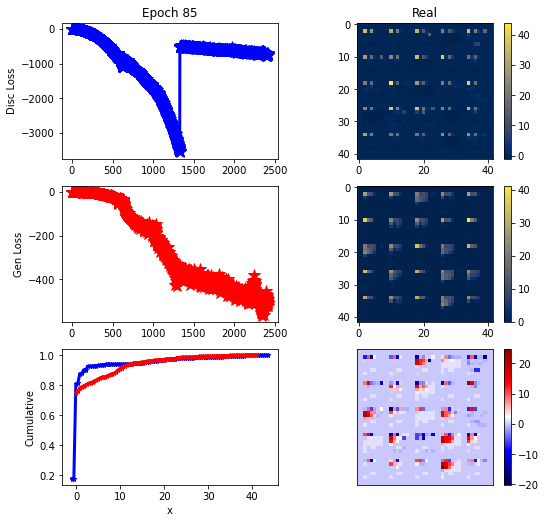

ErrG: -509.6401803152902, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


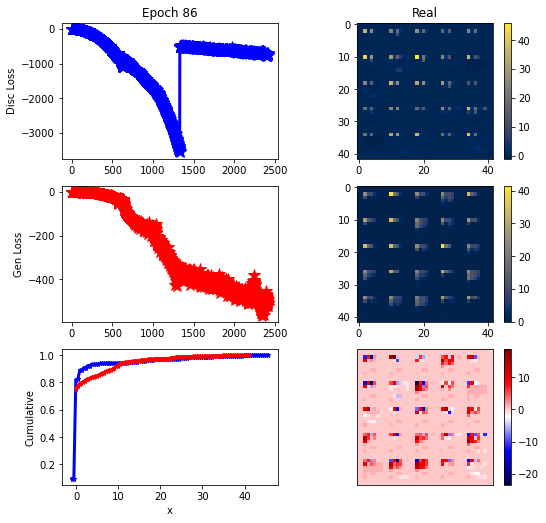

ErrG: -491.54500906808033, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


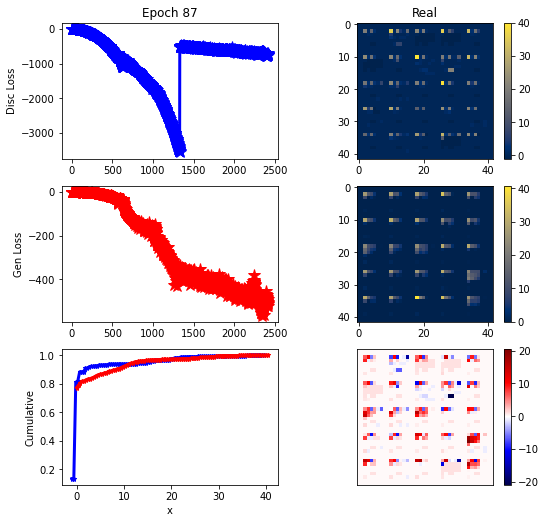

ErrG: -504.465323311942, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


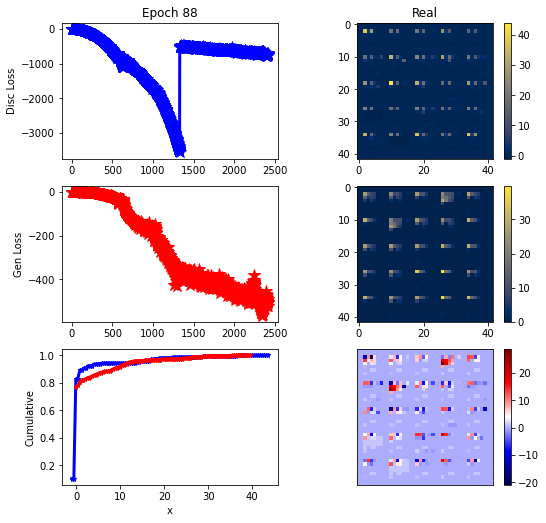

ErrG: -504.2434866768973, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


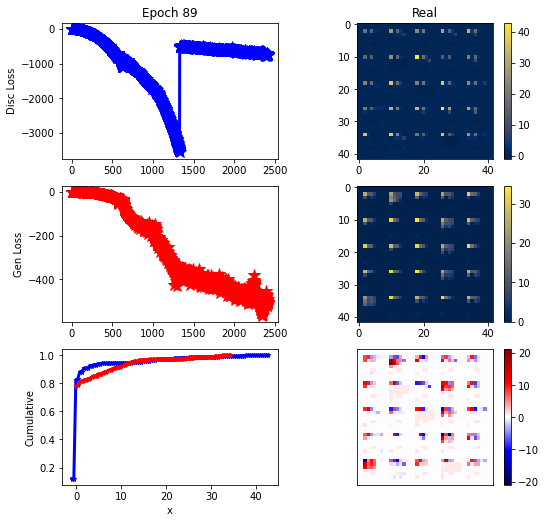

ErrG: -510.6187002999442, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


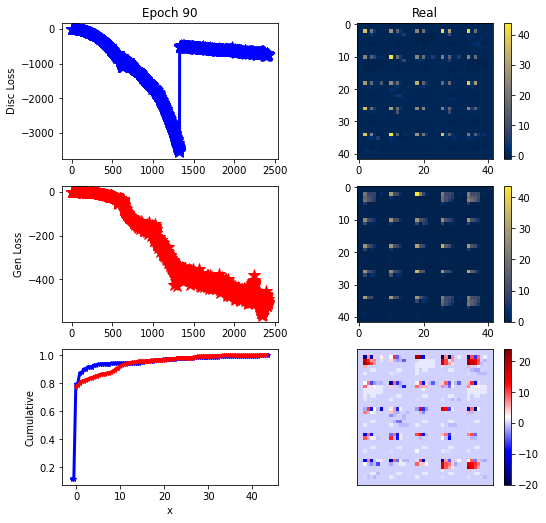

ErrG: -506.45678274972096, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


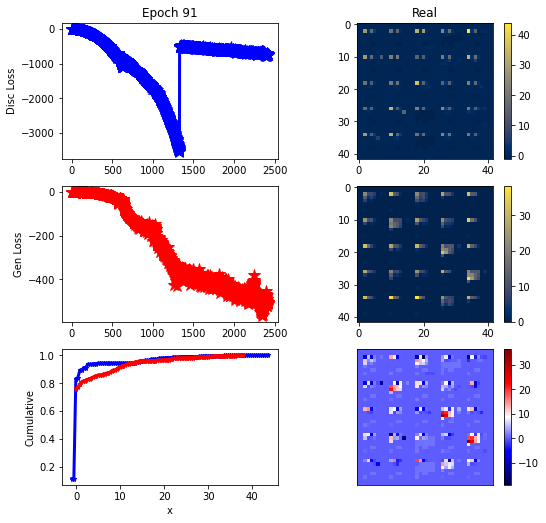

ErrG: -506.1951206752232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


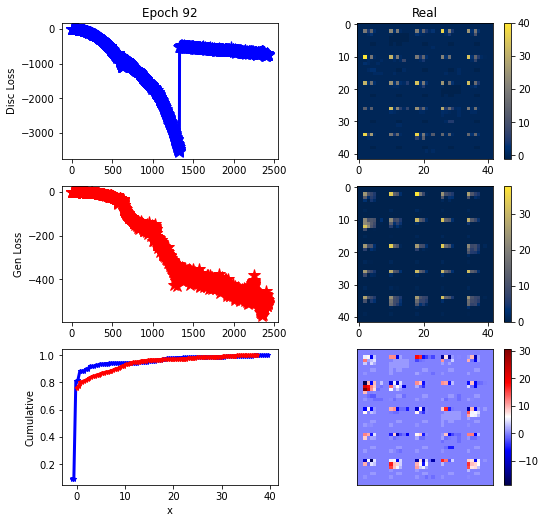

ErrG: -494.5913652692522, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


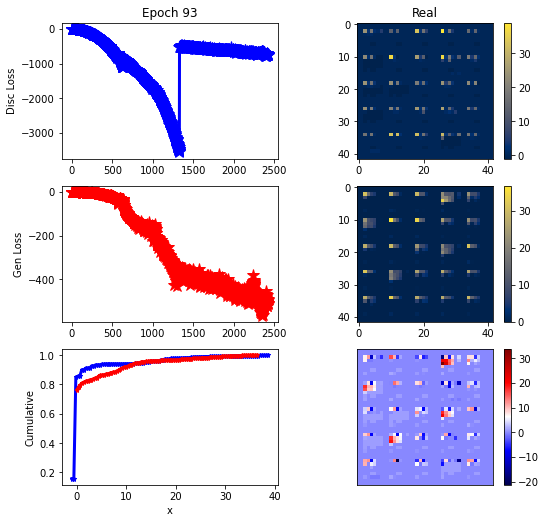

ErrG: -490.43031093052457, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


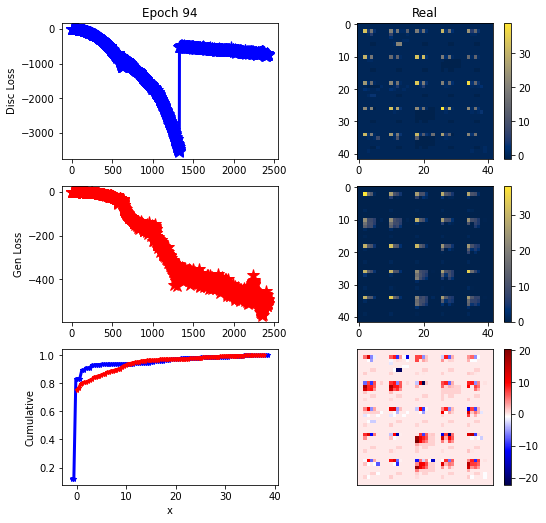

ErrG: -514.0624040876116, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


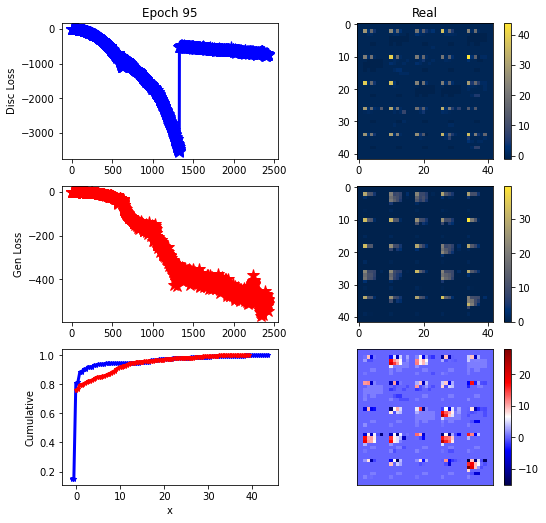

ErrG: -544.4631914411273, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


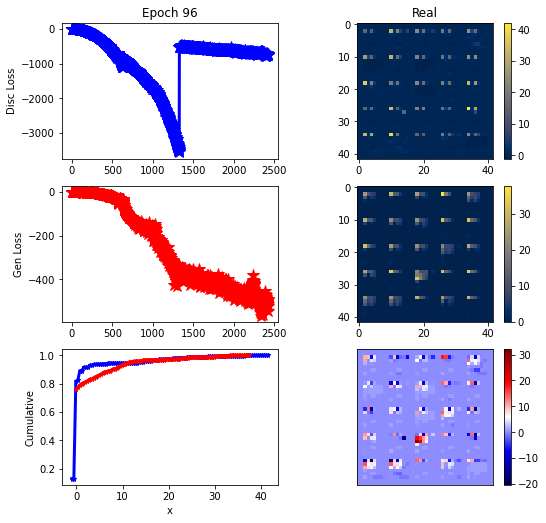

ErrG: -519.9838431222098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


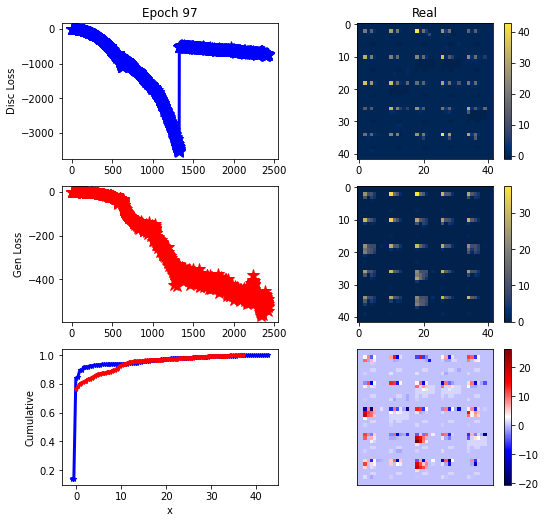

ErrG: -524.0519321986607, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


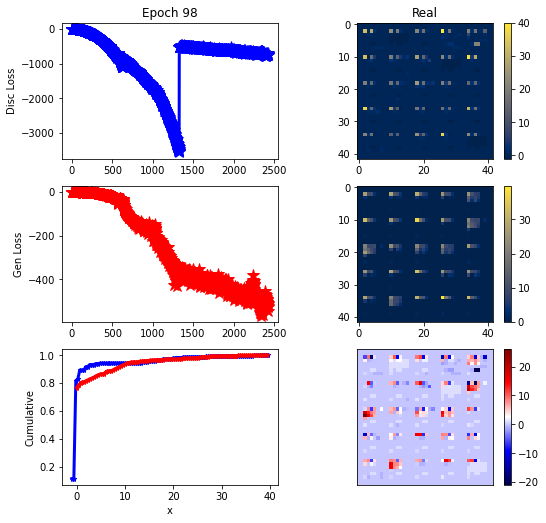

ErrG: -507.29439871651783, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


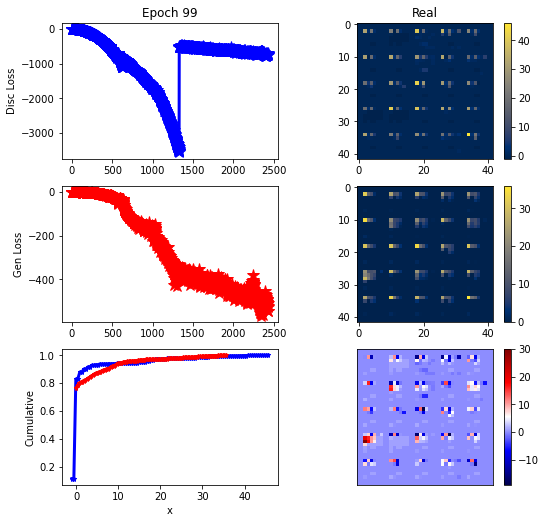

ErrG: -544.0984758649554, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


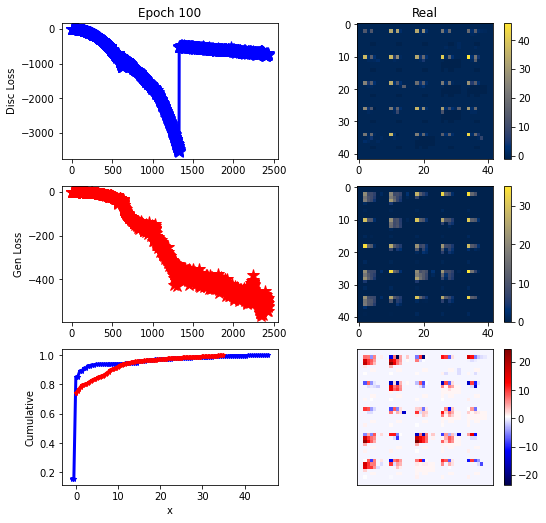

ErrG: -486.9191632952009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


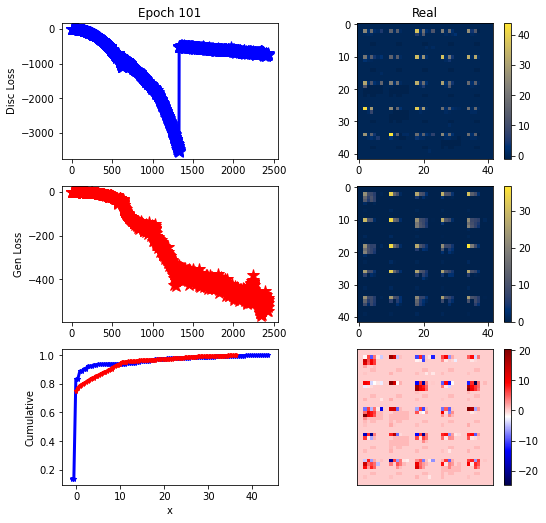

ErrG: -494.4262128557478, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


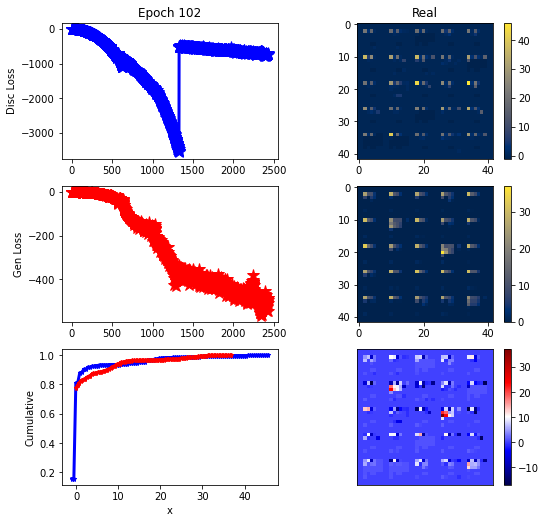

ErrG: -486.3681379045759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


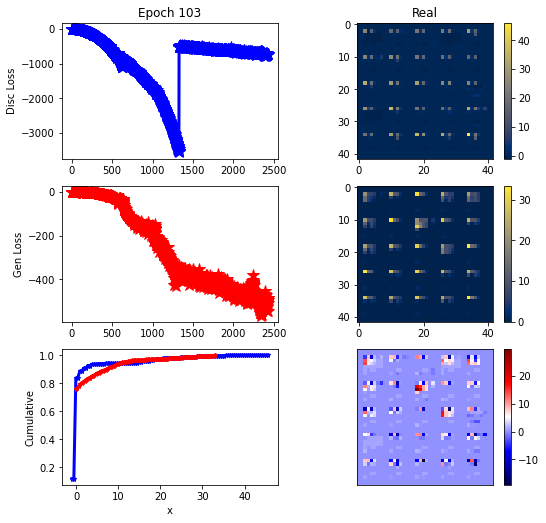

ErrG: -507.3214024135045, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


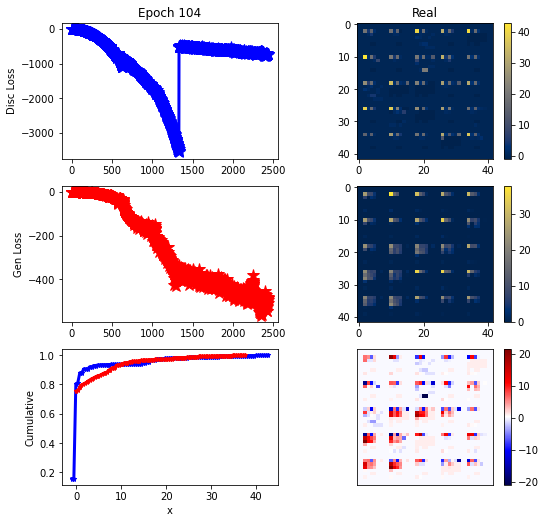

ErrG: -482.0069013323103, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


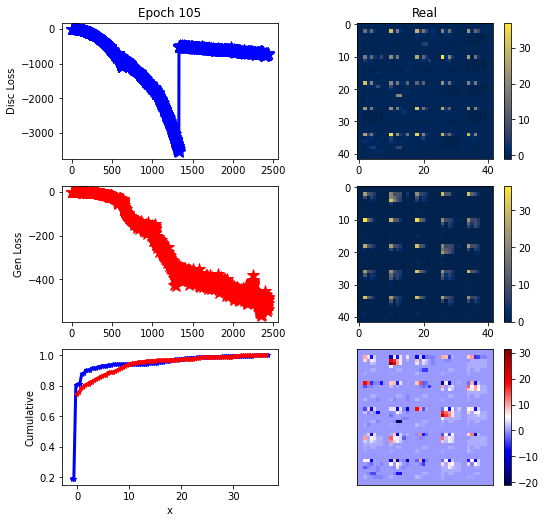

ErrG: -534.2038835797991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


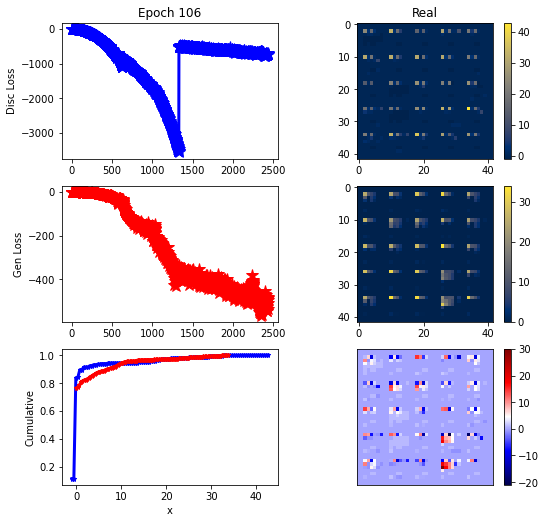

ErrG: -493.88841465541293, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


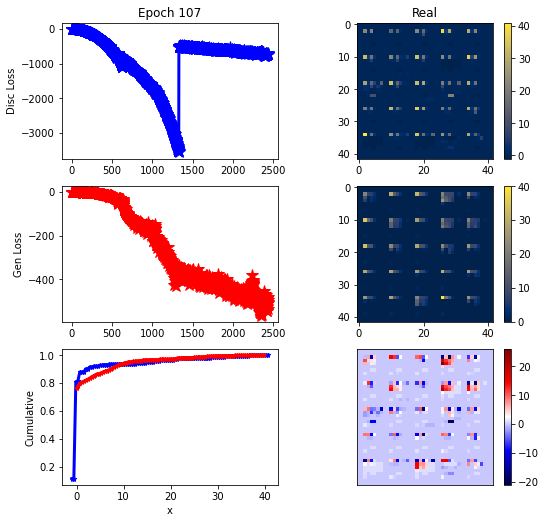

ErrG: -503.0691135951451, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


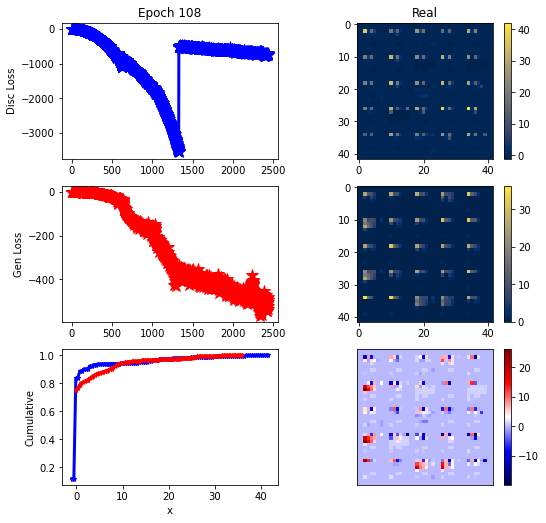

ErrG: -519.4709080287388, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


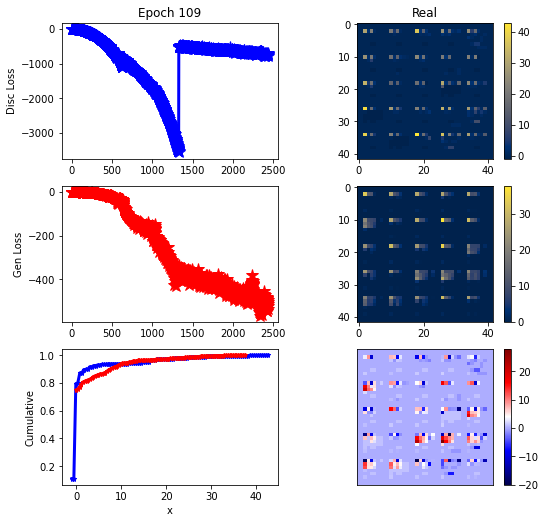

ErrG: -511.956787109375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


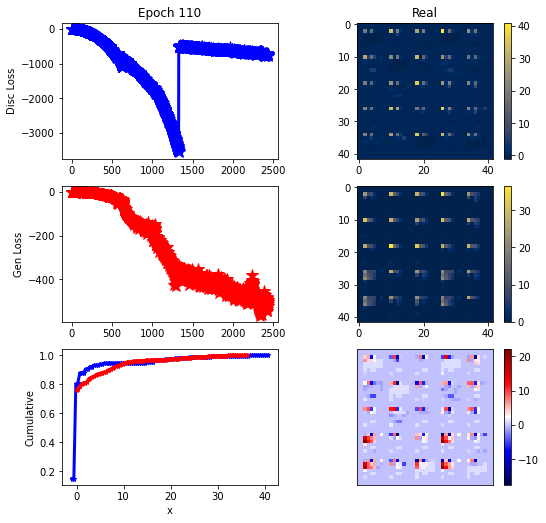

ErrG: -491.79439435686385, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


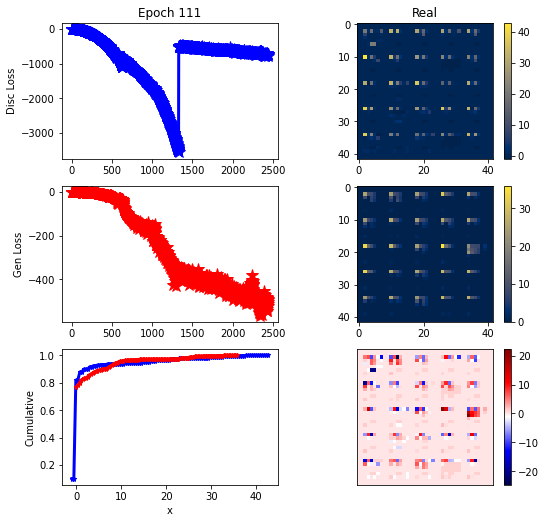

ErrG: -489.9679652622768, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


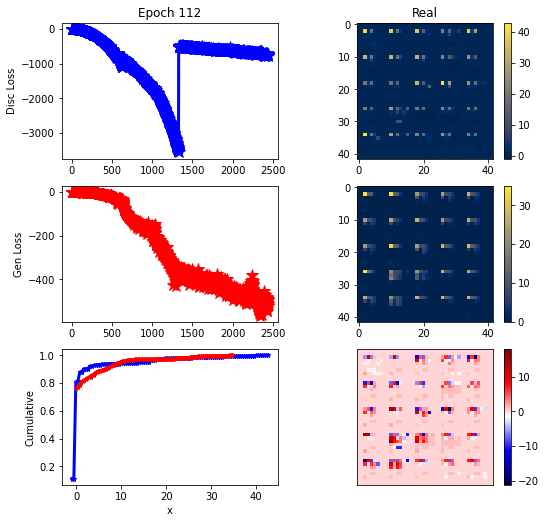

ErrG: -511.1464146205357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


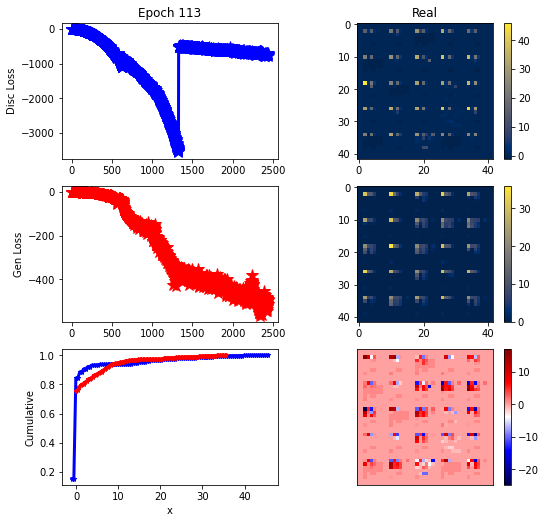

ErrG: -495.5791756766183, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


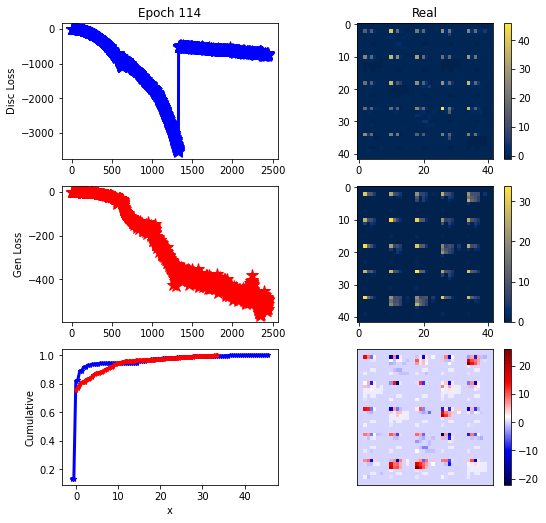

ErrG: -537.014665876116, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


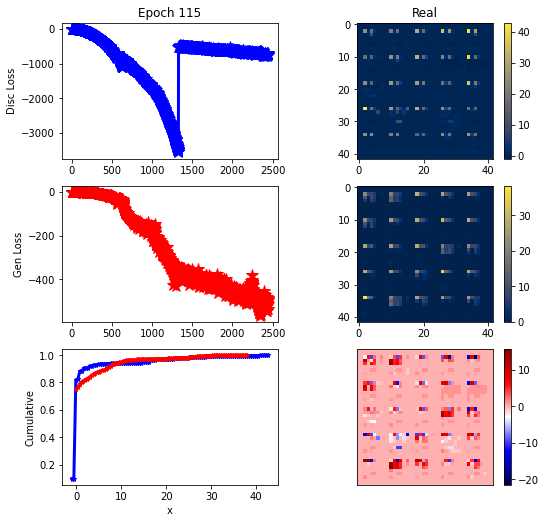

ErrG: -485.5272739955357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


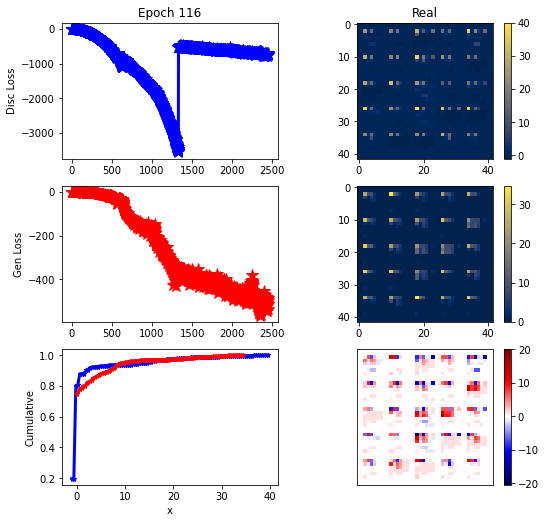

ErrG: -510.30614798409596, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


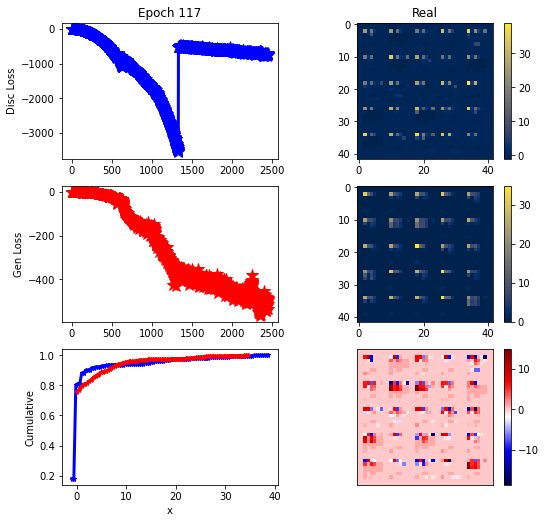

ErrG: -488.1454642159598, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


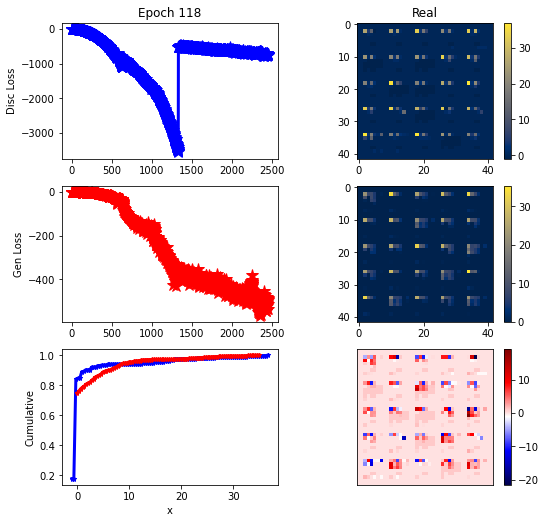

ErrG: -494.3937203543527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


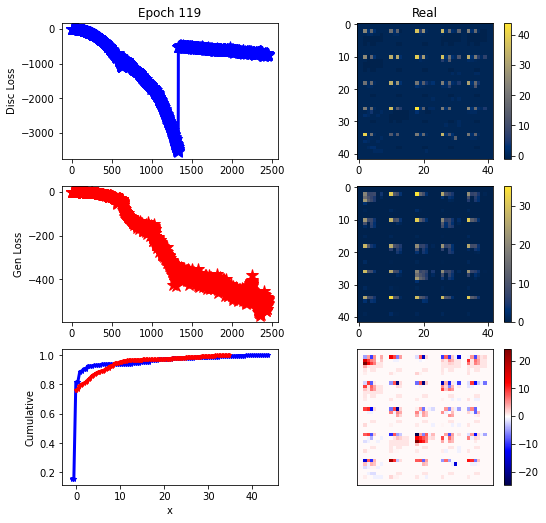

ErrG: -509.8410339355469, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


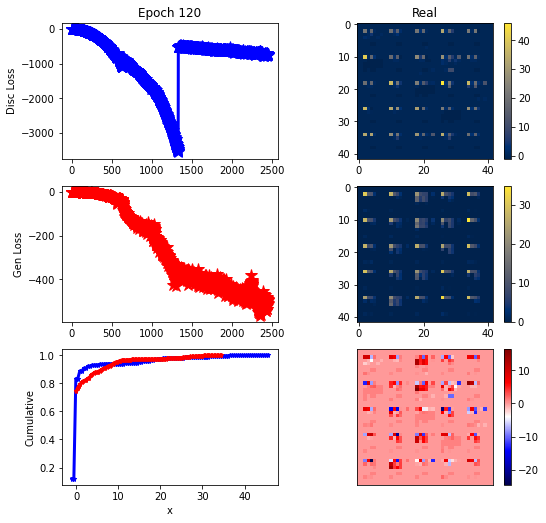

ErrG: -495.4082249232701, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


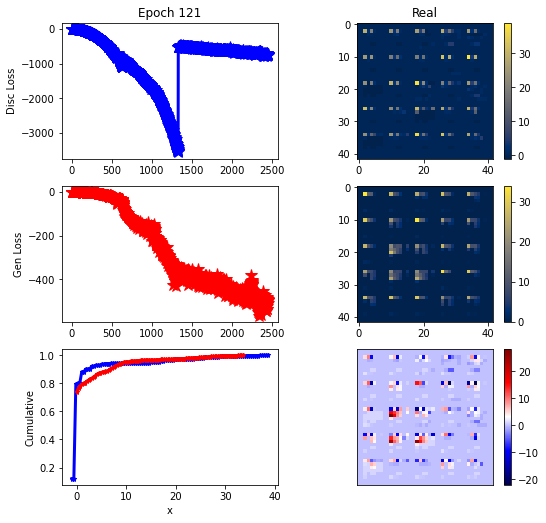

ErrG: -492.8201468331473, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


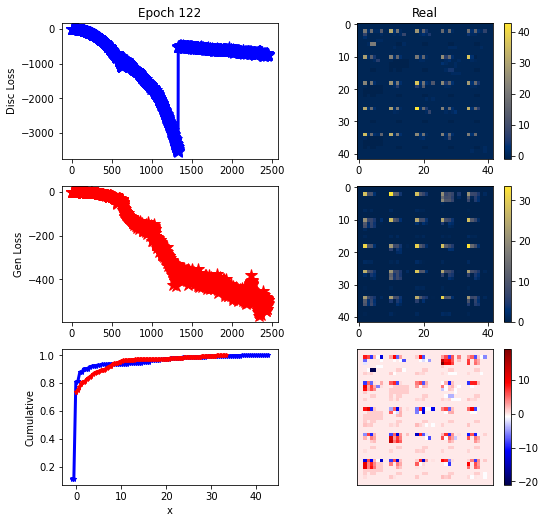

ErrG: -512.1657148088727, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


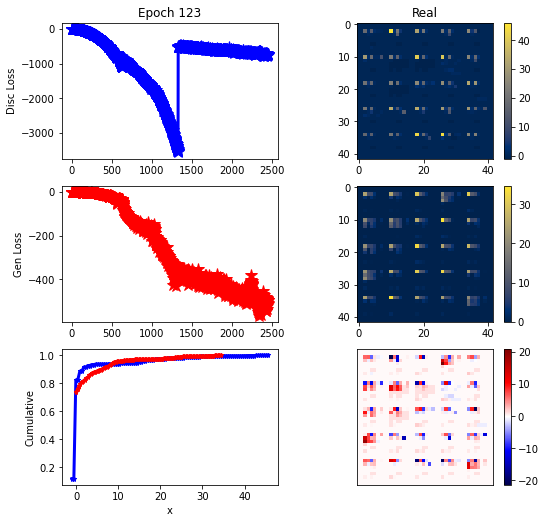

ErrG: -495.76707676478793, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


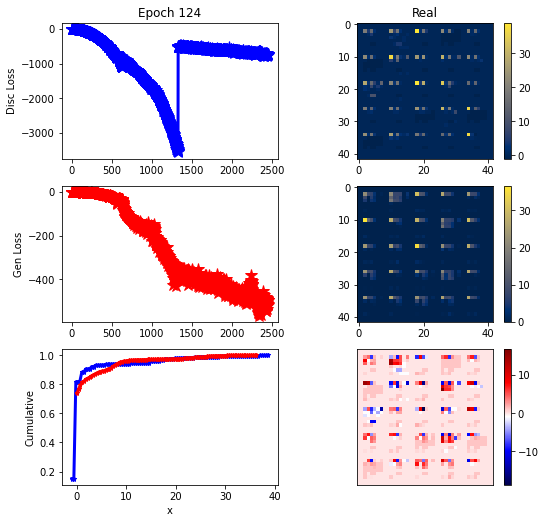

ErrG: -515.8707929338727, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


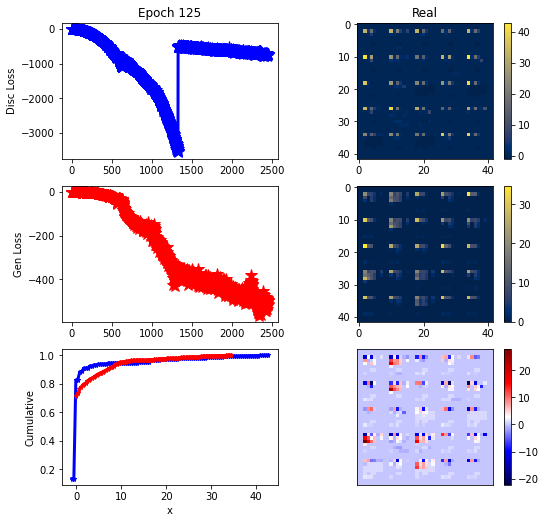

ErrG: -498.0297197614397, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


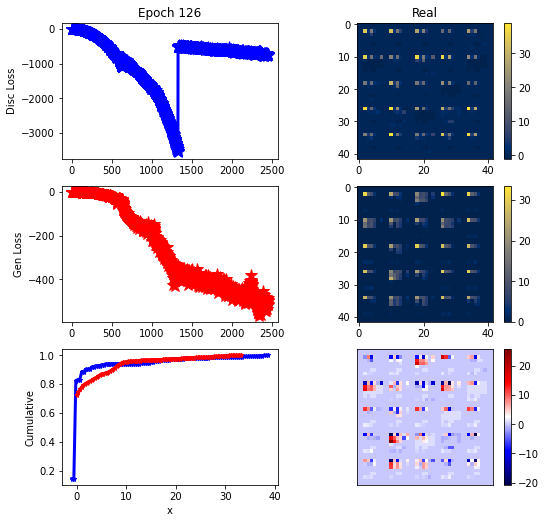

ErrG: -486.40299333844865, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


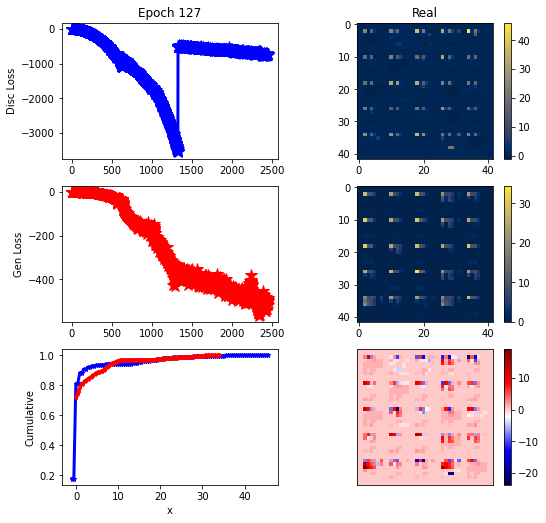

ErrG: -485.7471836635045, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


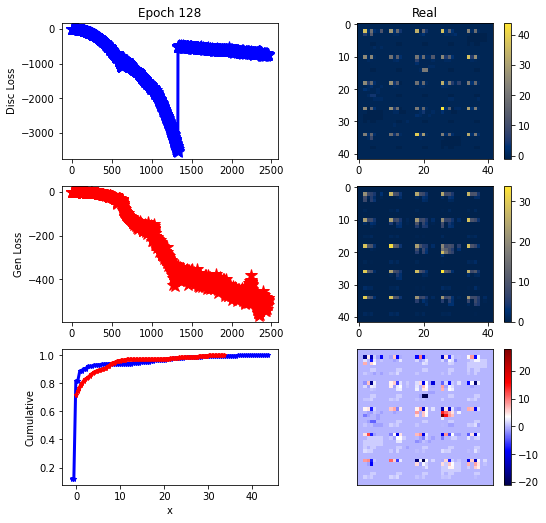

ErrG: -495.8186253138951, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


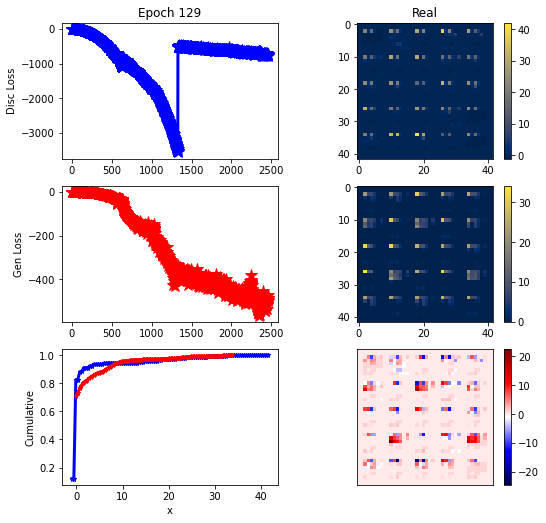

ErrG: -471.0243399483817, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


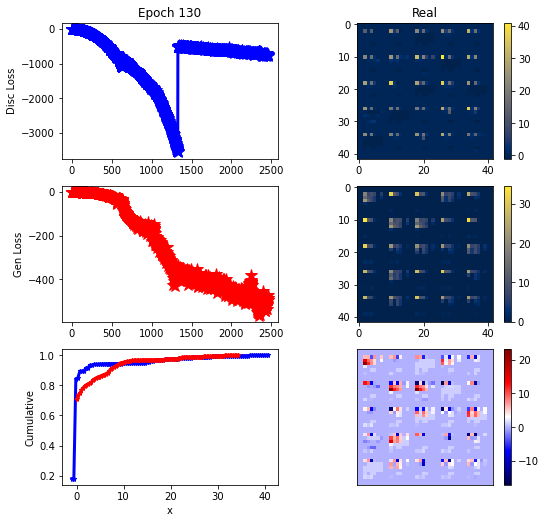

ErrG: -496.08357892717635, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


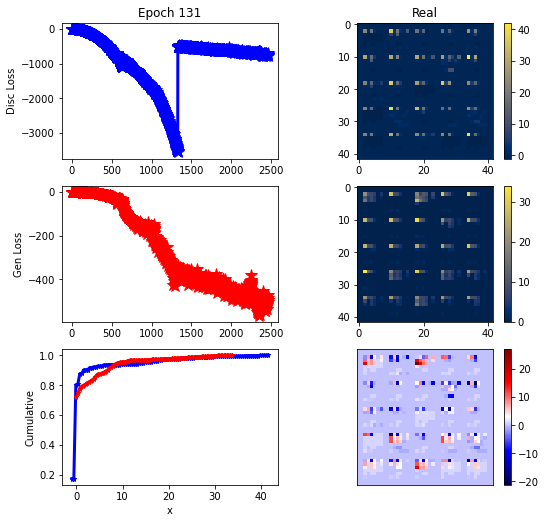

ErrG: -503.5610656738281, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


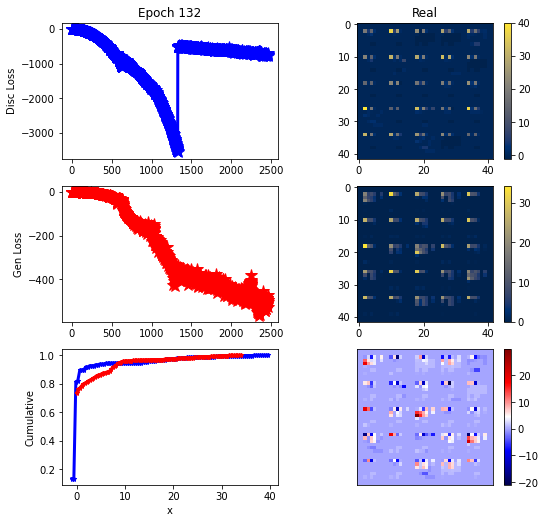

ErrG: -523.9449375697544, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


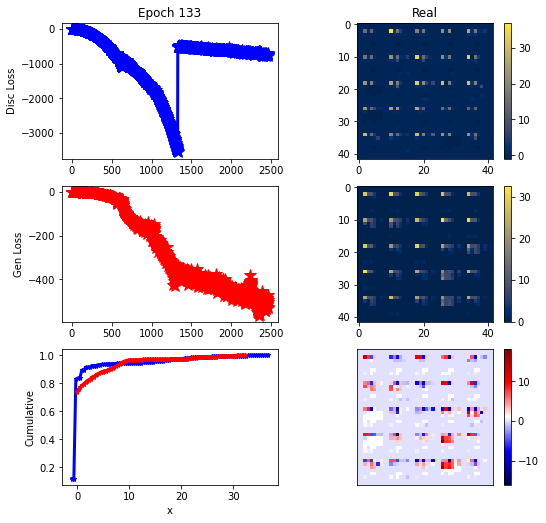

ErrG: -532.079572405134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


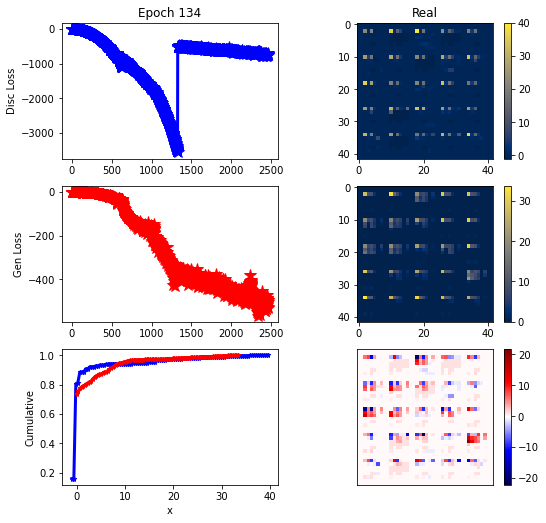

ErrG: -494.4330575125558, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


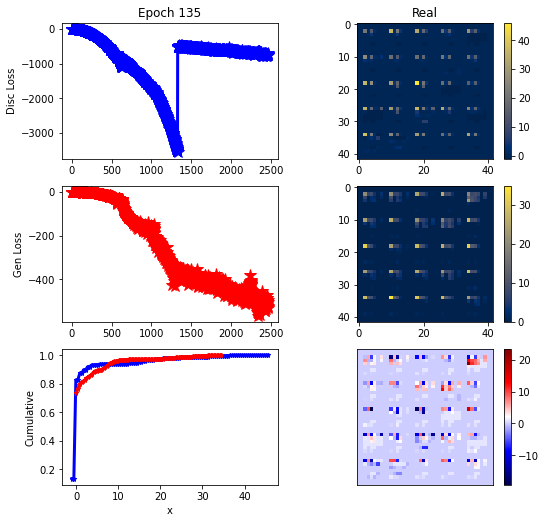

ErrG: -521.8390110560825, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


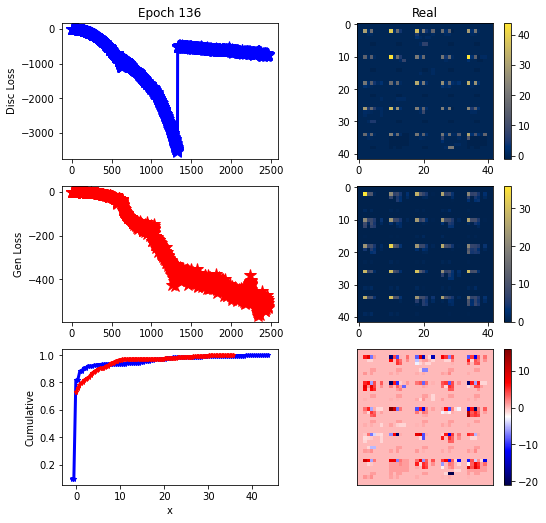

ErrG: -508.9543762207031, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


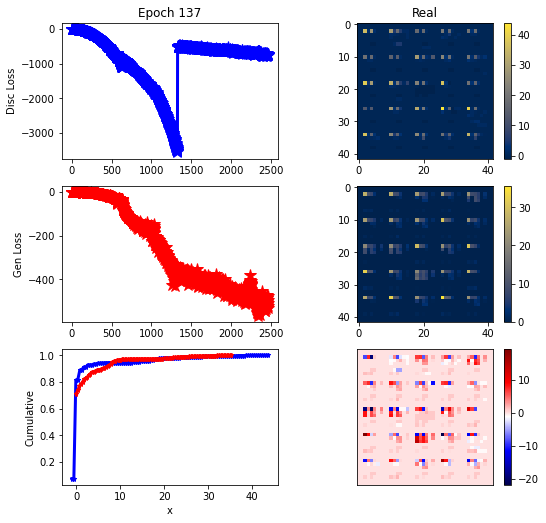

ErrG: -476.0081263950893, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


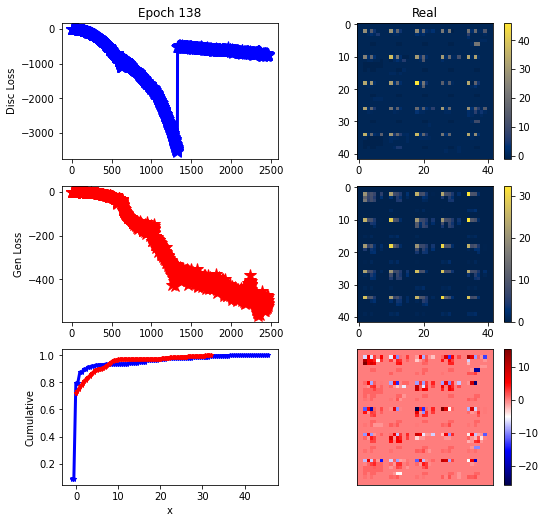

ErrG: -512.3911568777902, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


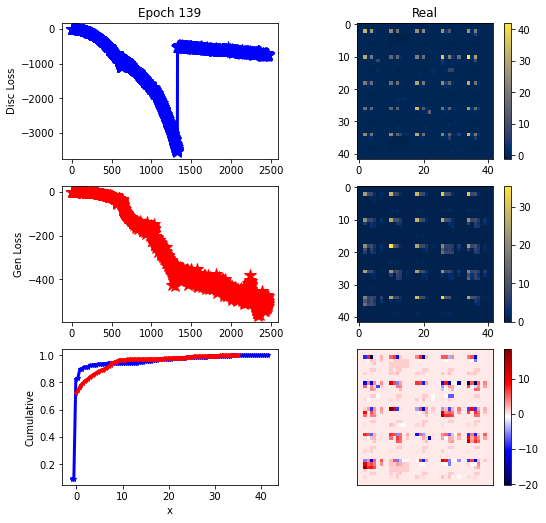

ErrG: -500.74583217075894, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


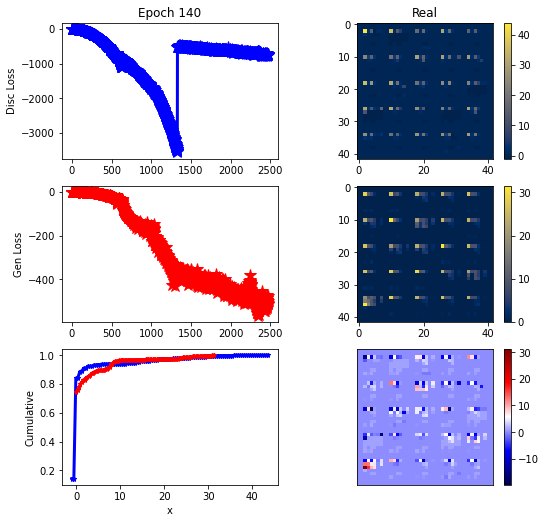

ErrG: -514.3456464494977, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


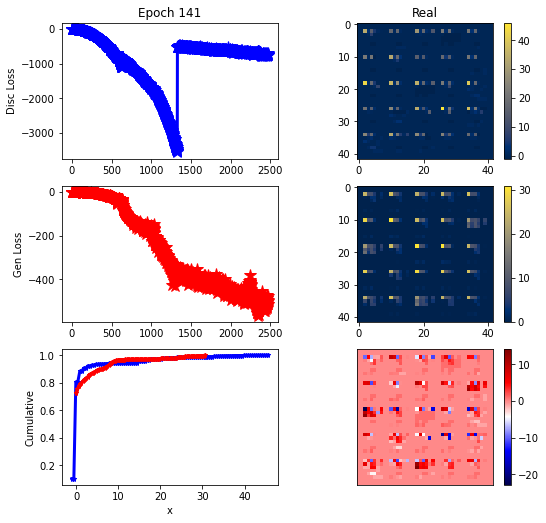

ErrG: -493.4328351702009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


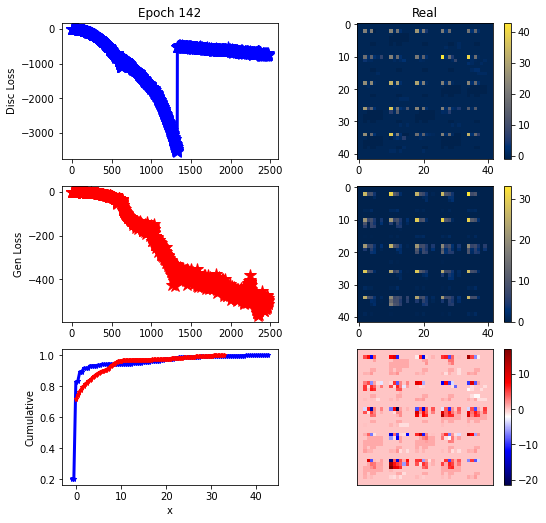

ErrG: -484.9823259626116, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


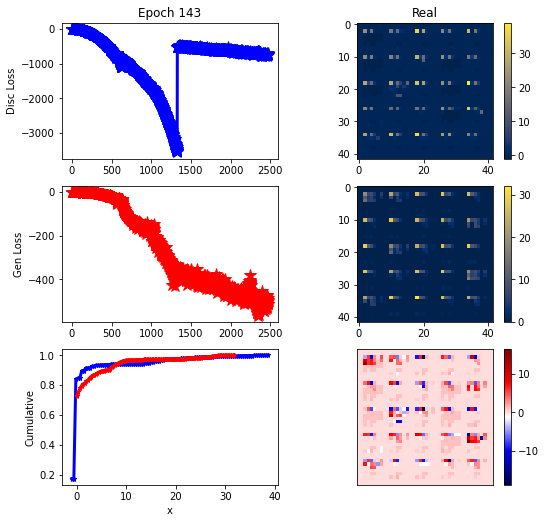

ErrG: -510.60557338169644, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


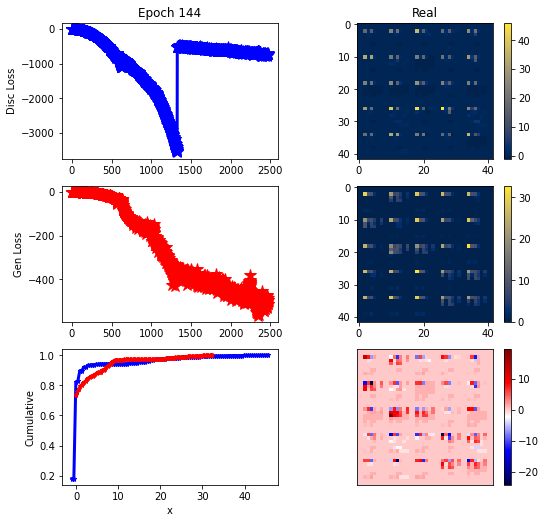

ErrG: -493.7529558454241, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


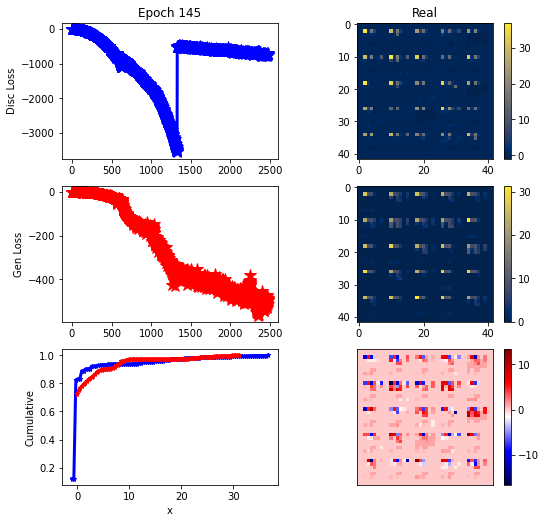

ErrG: -488.3698468889509, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


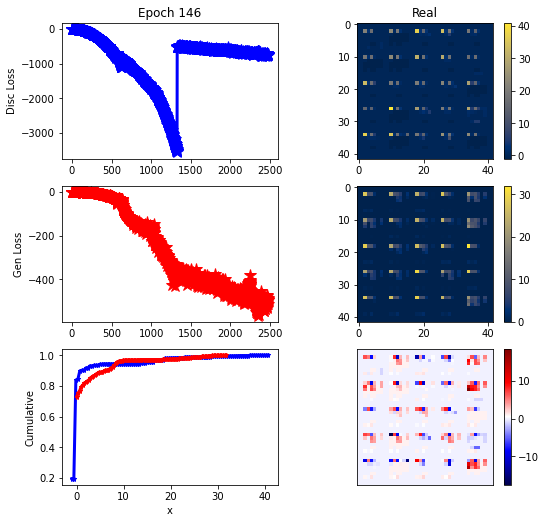

ErrG: -494.0020664760045, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


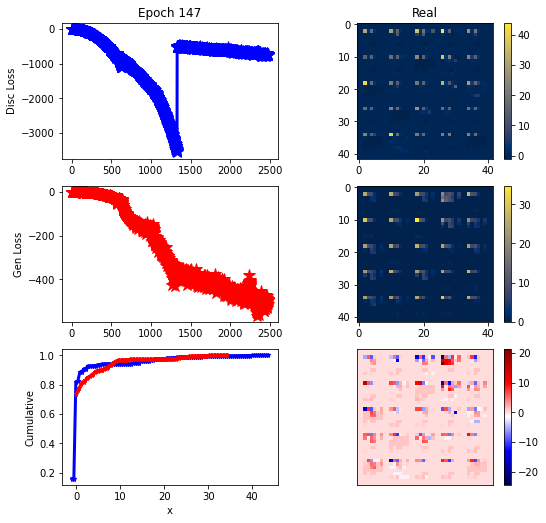

ErrG: -492.00455147879467, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


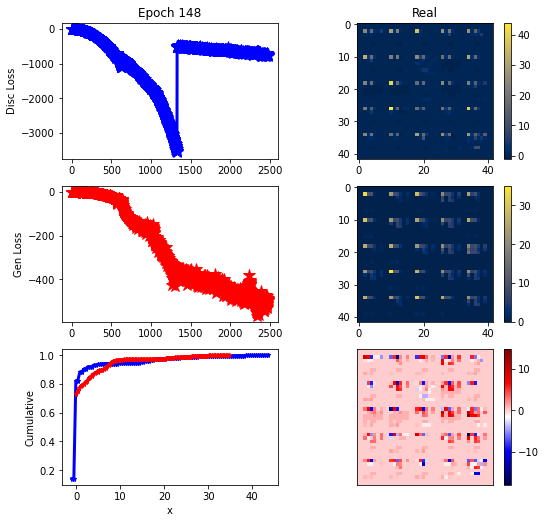

ErrG: -483.8376770019531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


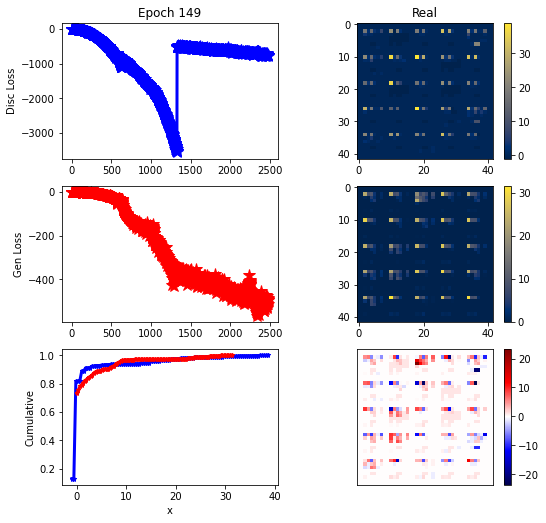

ErrG: -512.3568202427456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


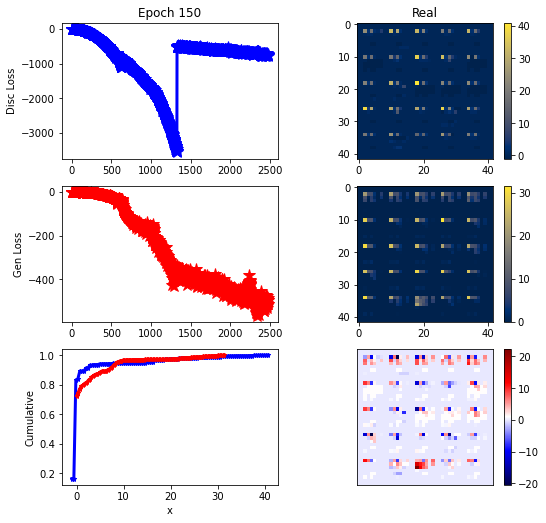

ErrG: -512.0564793178013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


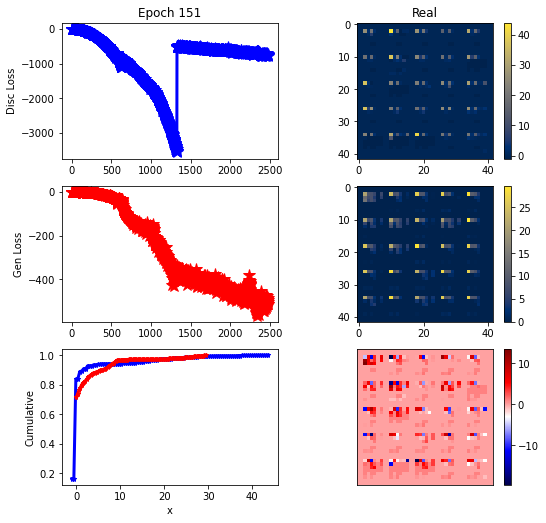

ErrG: -503.9170183454241, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


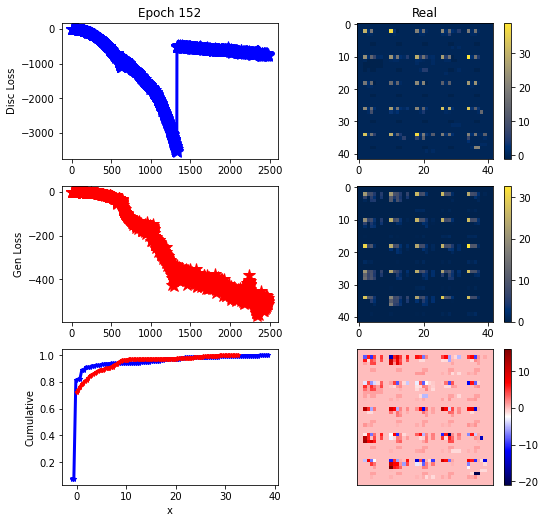

ErrG: -500.49068341936385, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


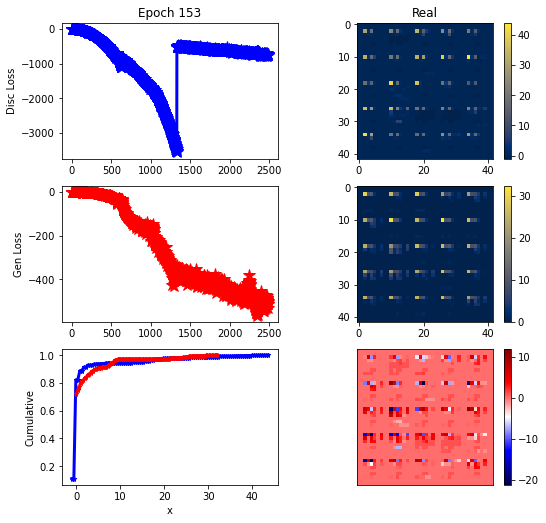

ErrG: -529.7986668178013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


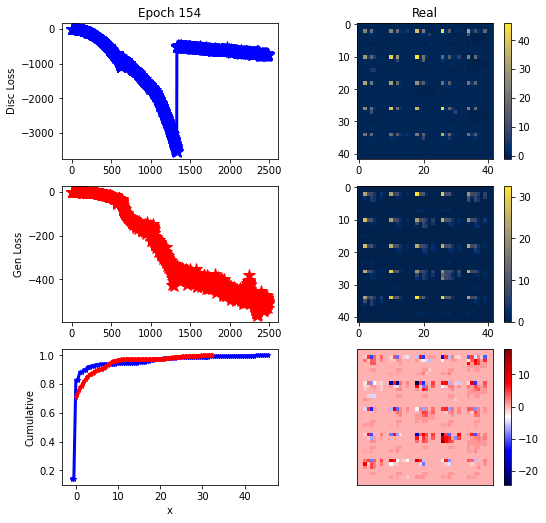

ErrG: -508.9144287109375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


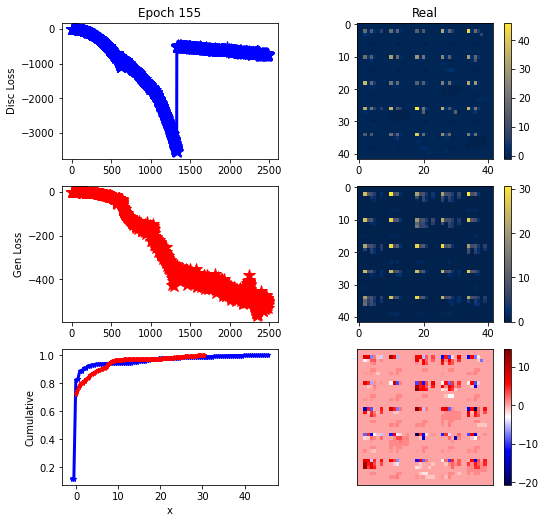

ErrG: -515.6409955705915, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


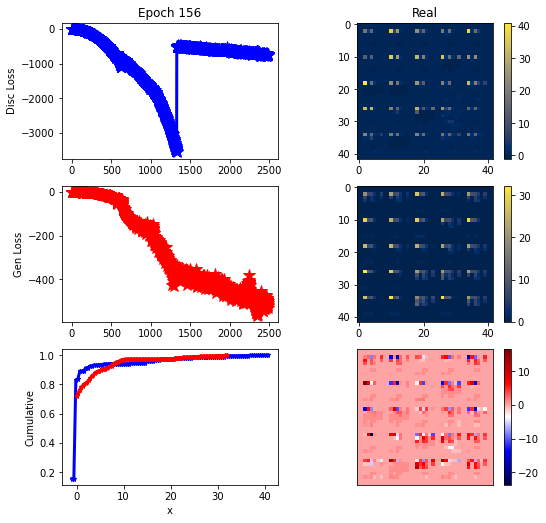

ErrG: -519.2689470563616, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


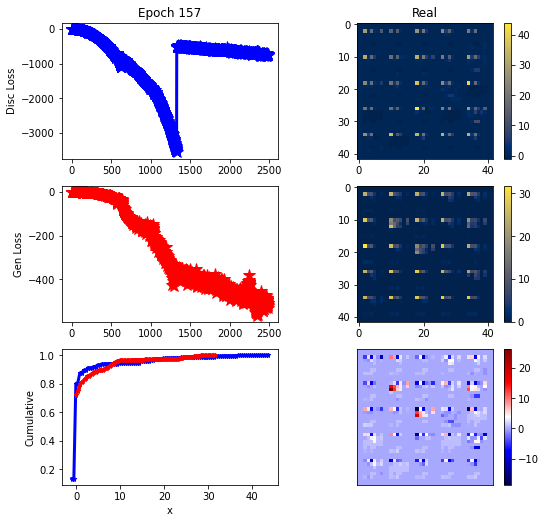

ErrG: -509.2029811314174, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


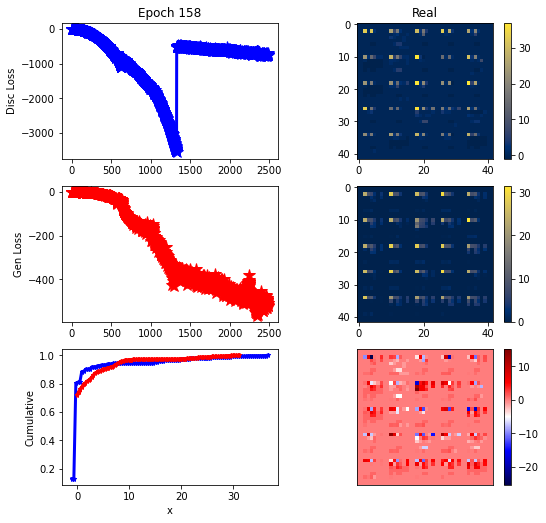

ErrG: -521.2160382952009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


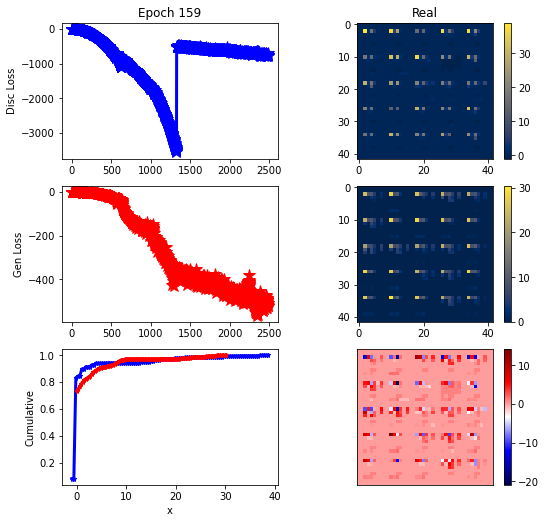

ErrG: -508.5151628766741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


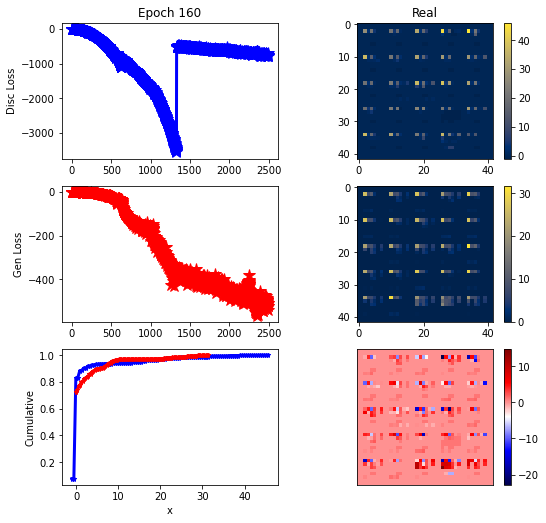

ErrG: -539.0876857212612, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


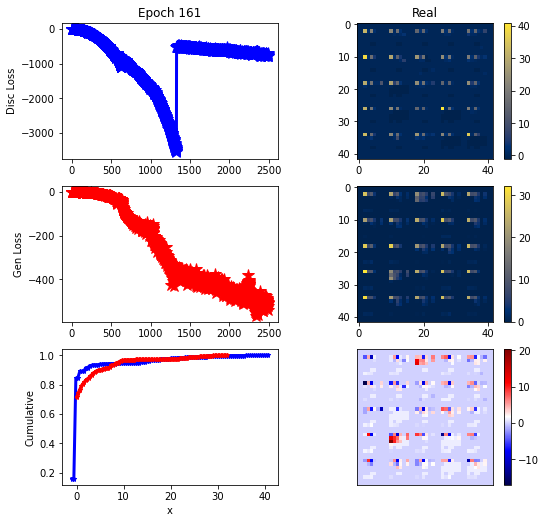

ErrG: -501.7277047293527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


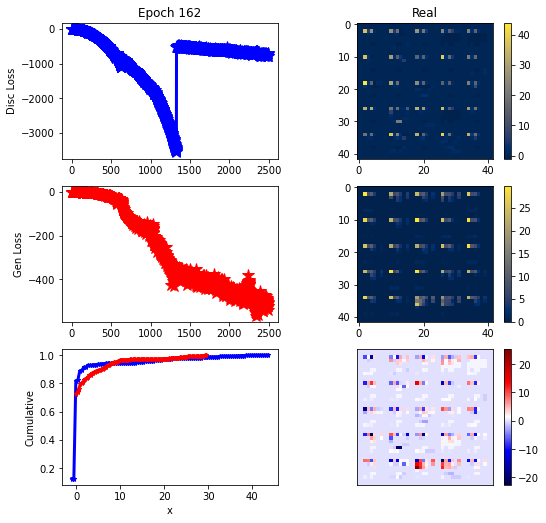

ErrG: -520.123779296875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


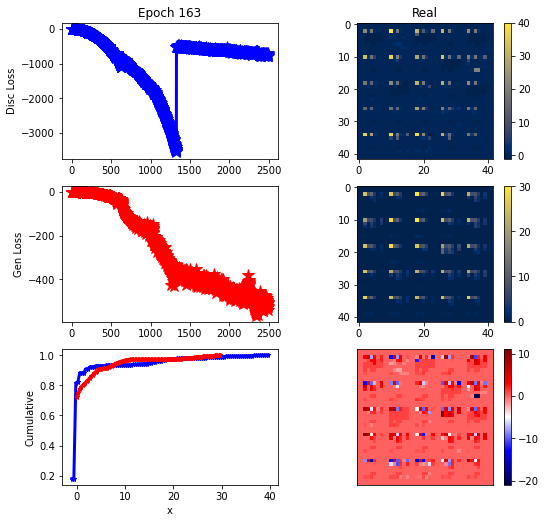

ErrG: -527.9837166922433, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


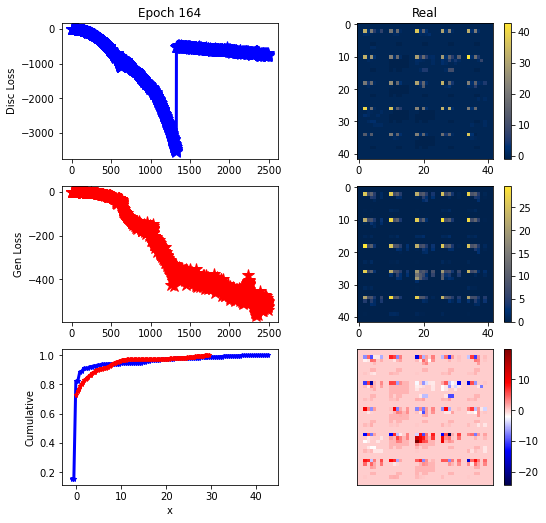

ErrG: -498.61045619419644, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


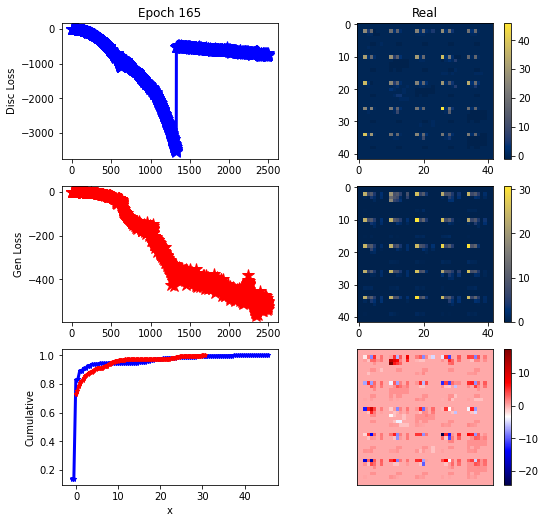

ErrG: -533.6663818359375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


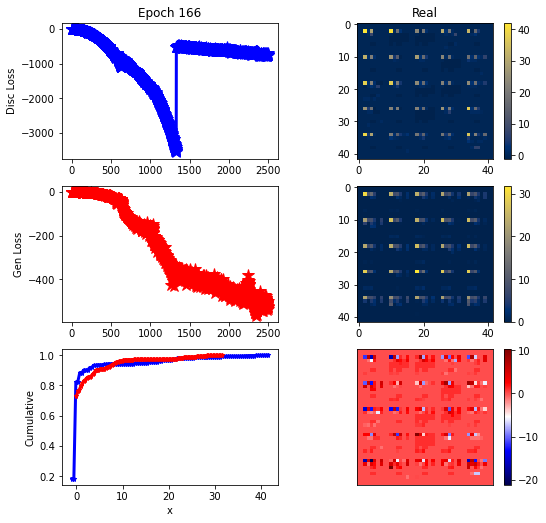

ErrG: -523.7195129394531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


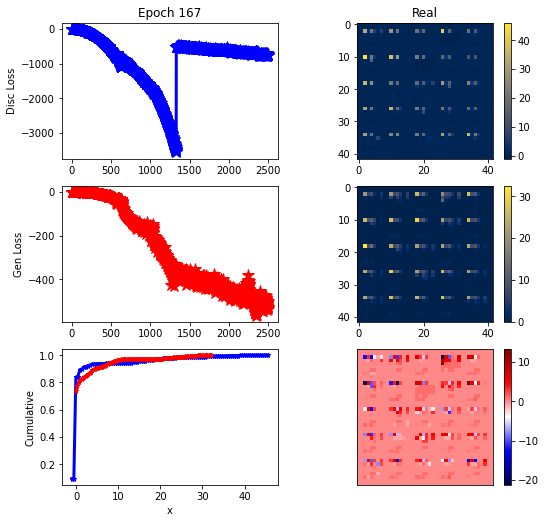

ErrG: -527.7482343401227, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


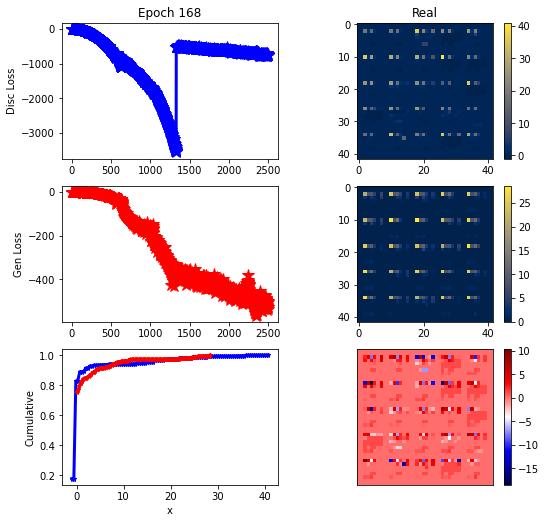

ErrG: -502.7169974190848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


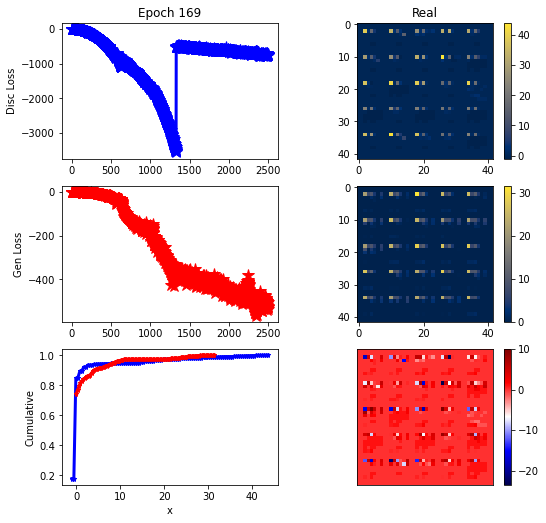

ErrG: -519.7267412458148, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


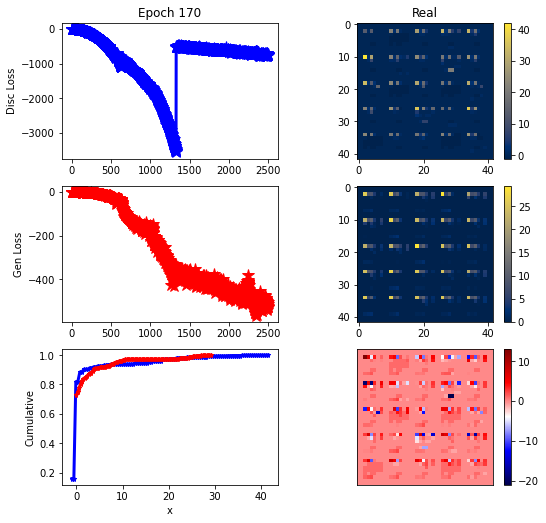

ErrG: -510.3154296875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


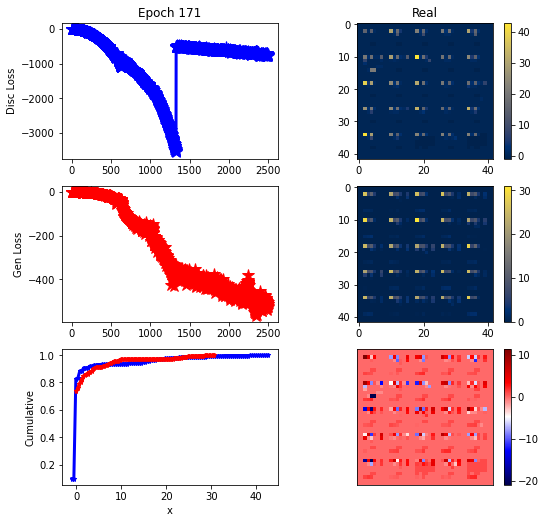

ErrG: -514.0809413364956, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


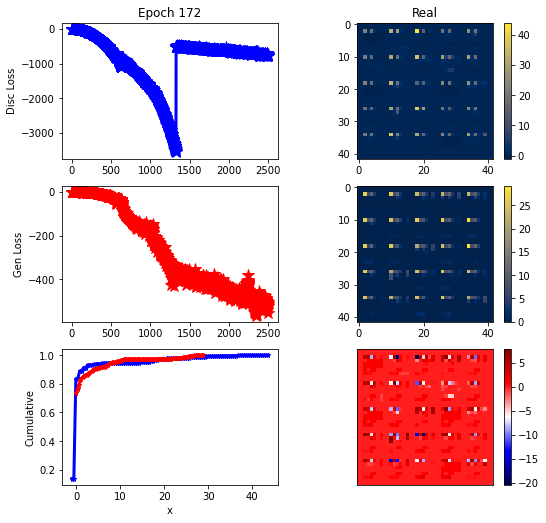

ErrG: -551.8302917480469, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


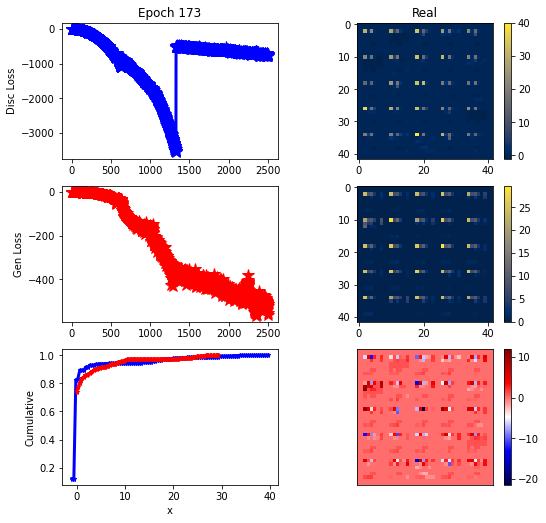

ErrG: -561.3071594238281, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


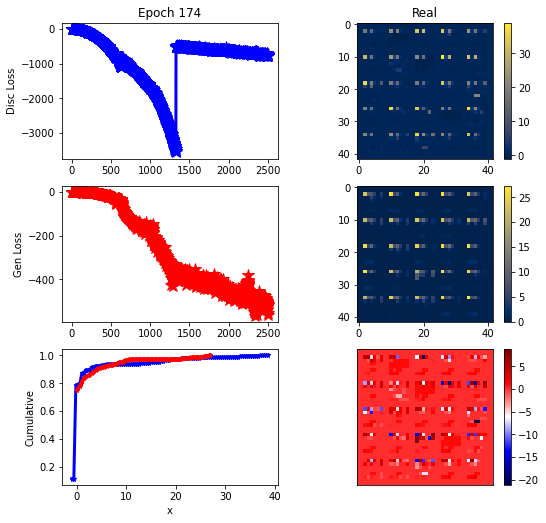

ErrG: -519.0131181989398, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


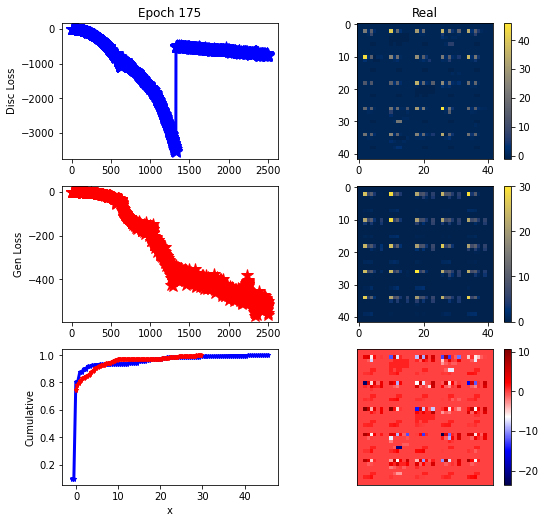

ErrG: -496.7030465262277, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


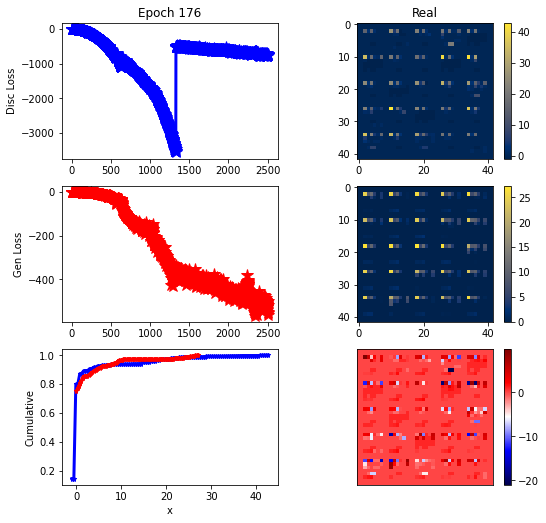

ErrG: -549.0266418457031, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


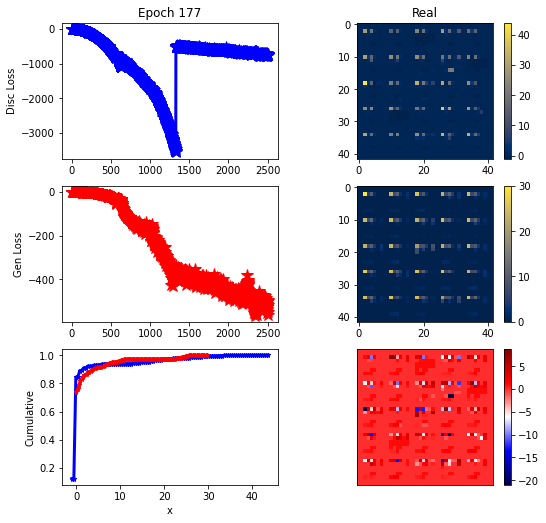

ErrG: -494.96976143973217, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


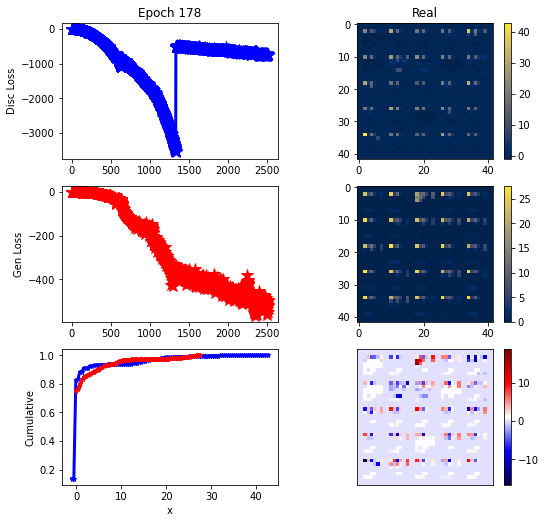

ErrG: -522.7144731794085, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


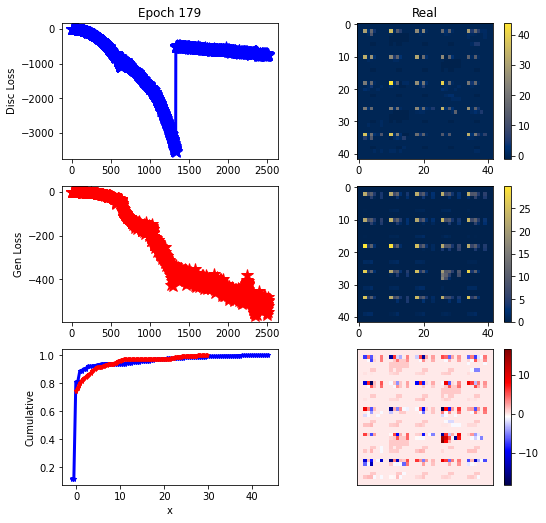

ErrG: -480.09130859375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


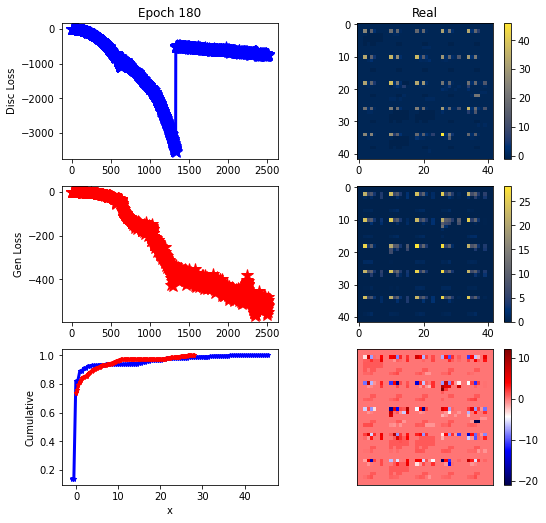

ErrG: -516.5587986537388, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


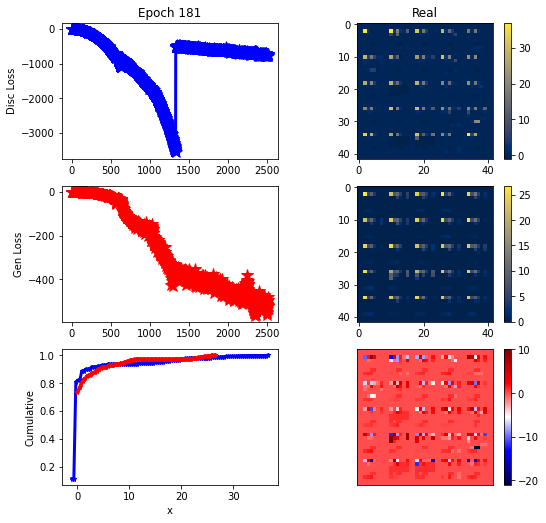

ErrG: -522.1478489467075, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


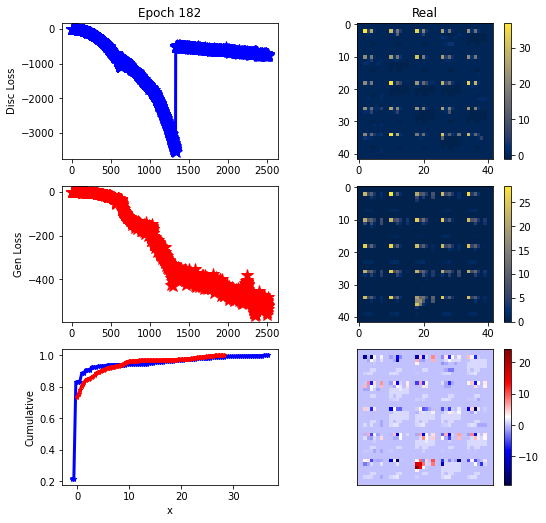

ErrG: -533.6391339983259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


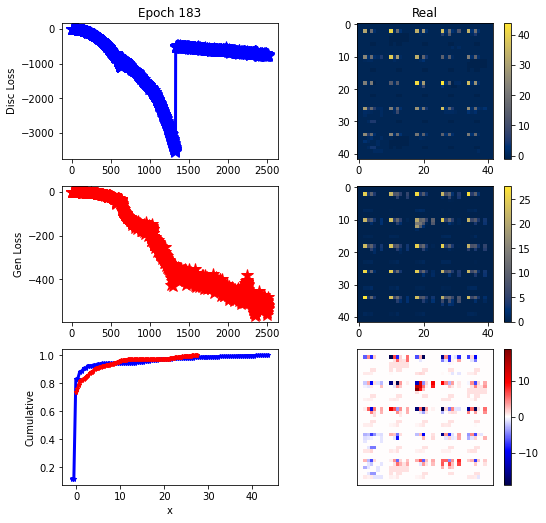

ErrG: -530.656494140625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


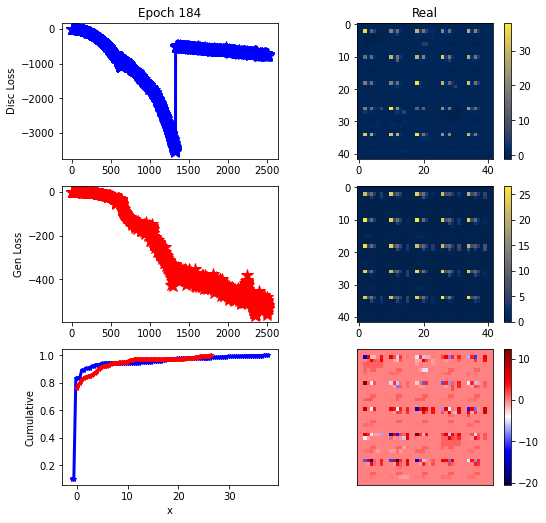

ErrG: -530.1170043945312, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


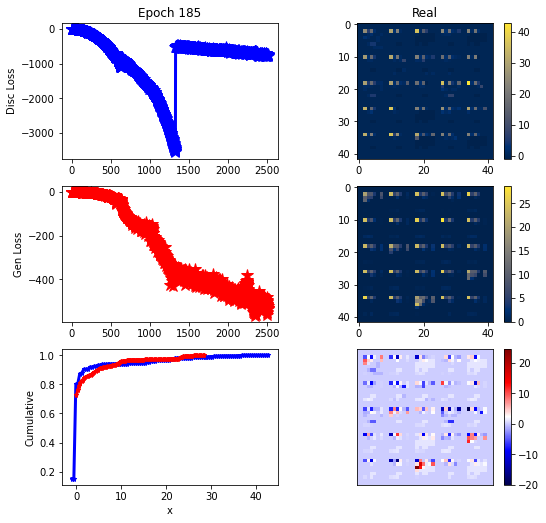

ErrG: -528.9451860700335, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


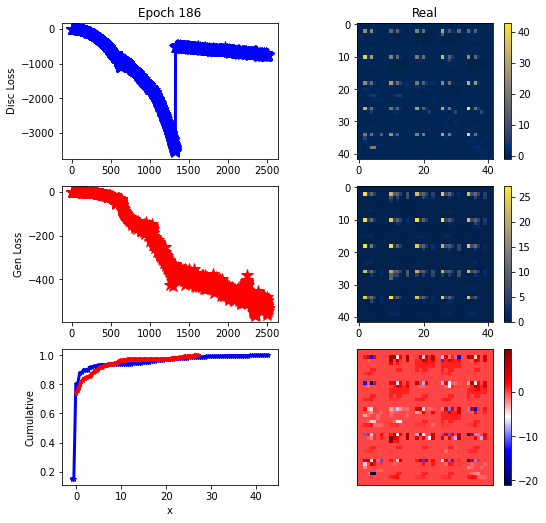

ErrG: -546.5035400390625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


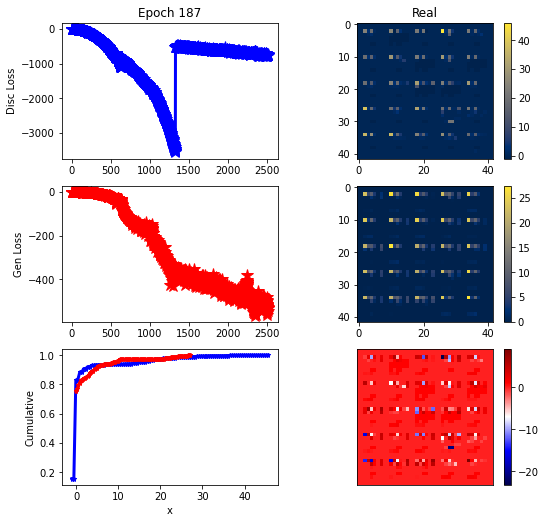

ErrG: -524.415043422154, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


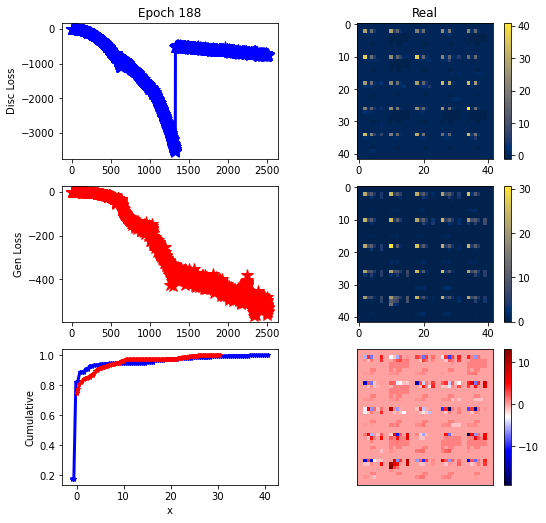

ErrG: -546.6923130580357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


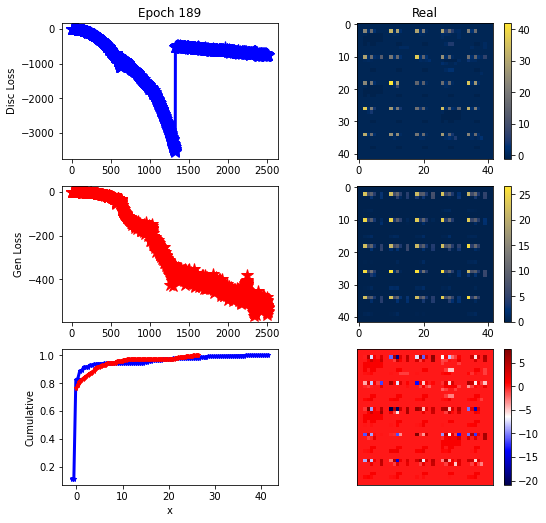

ErrG: -528.9806213378906, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


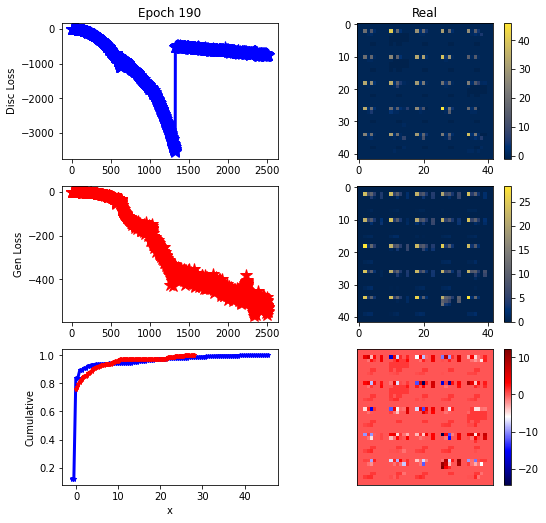

ErrG: -524.0648585728237, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


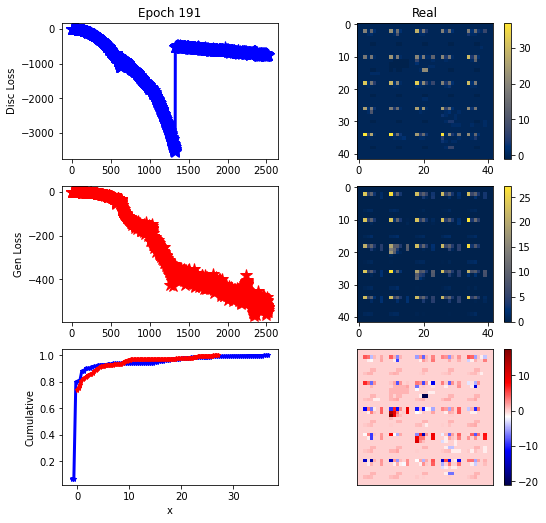

ErrG: -541.4213474818638, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


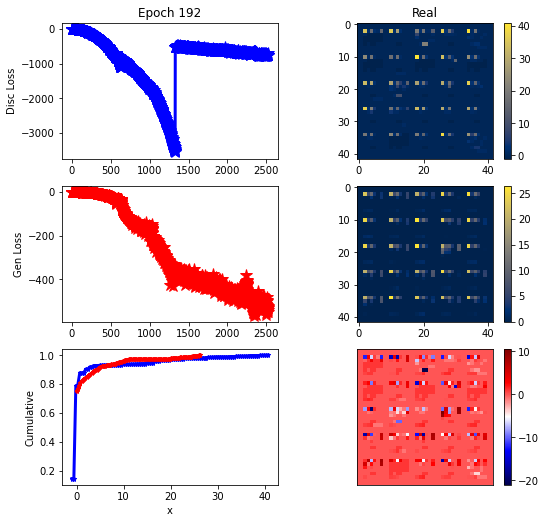

ErrG: -521.5944737025669, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


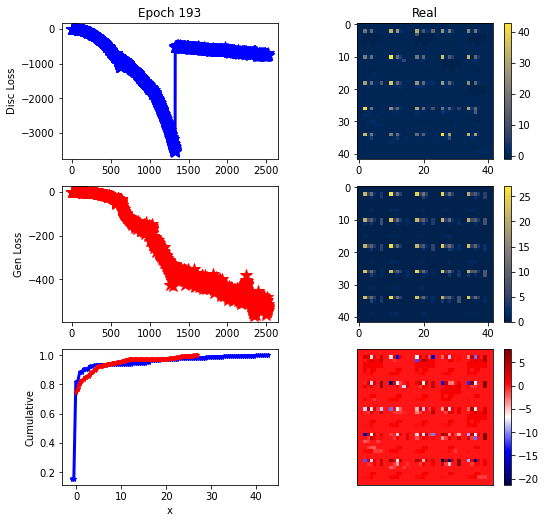

ErrG: -513.7054268973214, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


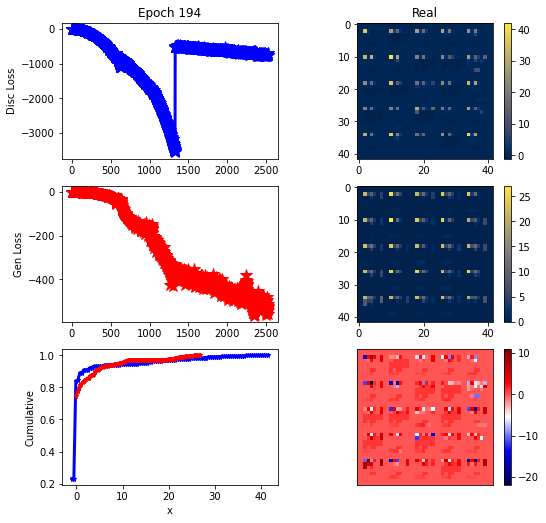

ErrG: -557.1050545828683, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


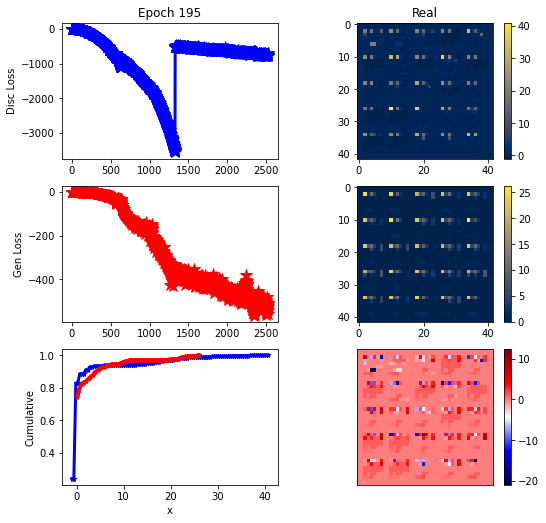

ErrG: -507.3162754603795, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


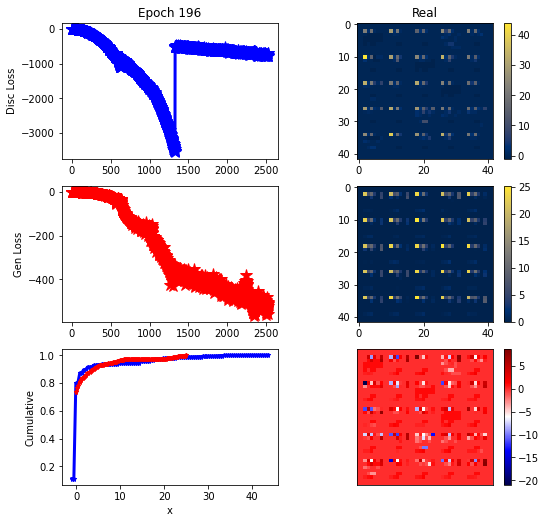

ErrG: -502.7770560128348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


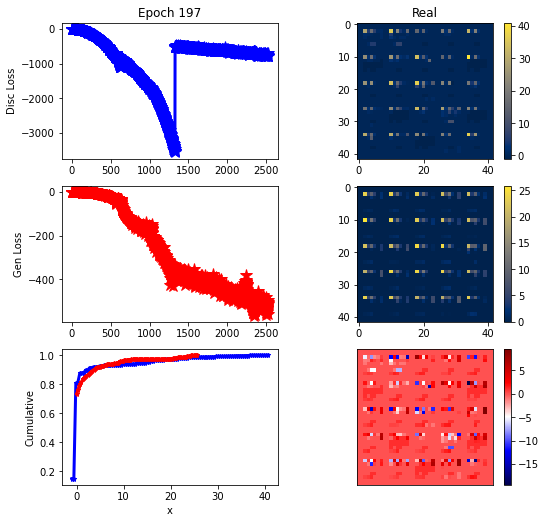

ErrG: -496.2242344447545, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


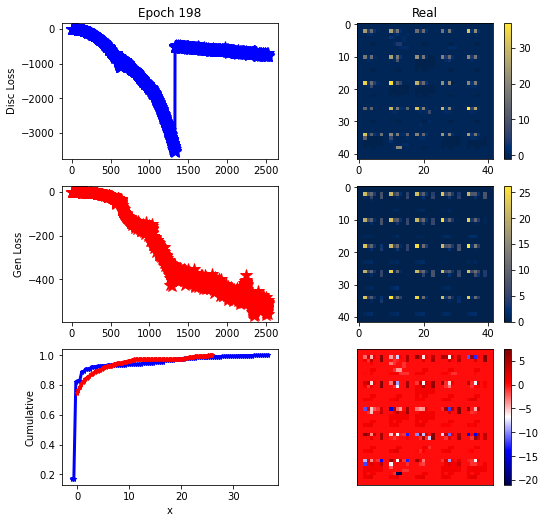

ErrG: -512.2751028878348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


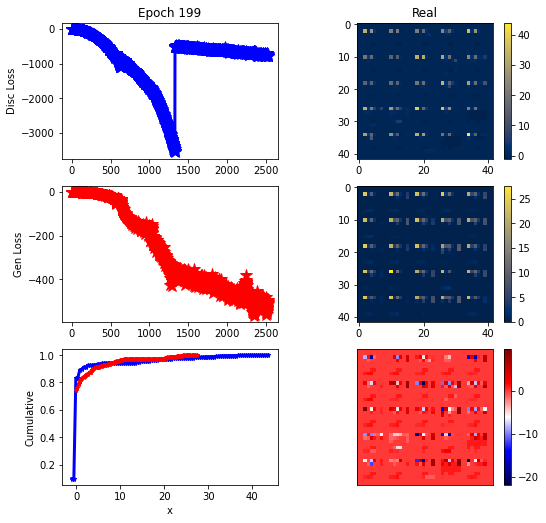

ErrG: -499.4424612862723, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


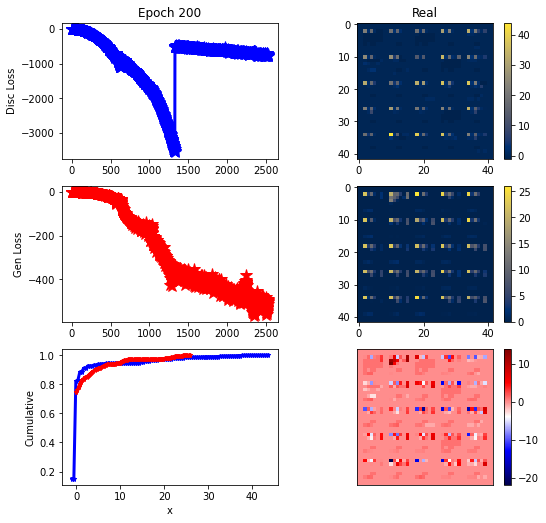

ErrG: -487.35255214146207, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


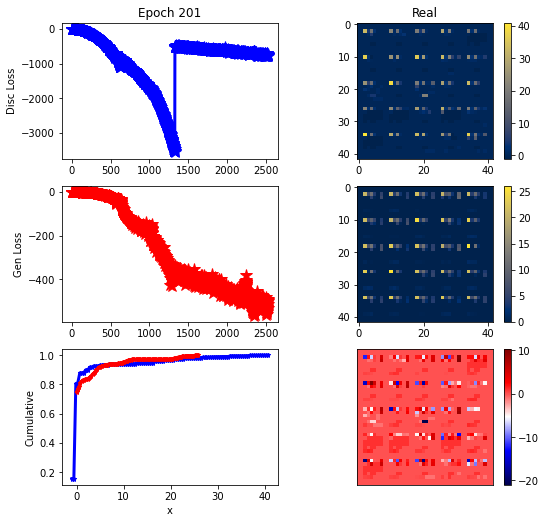

ErrG: -531.4247610909598, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


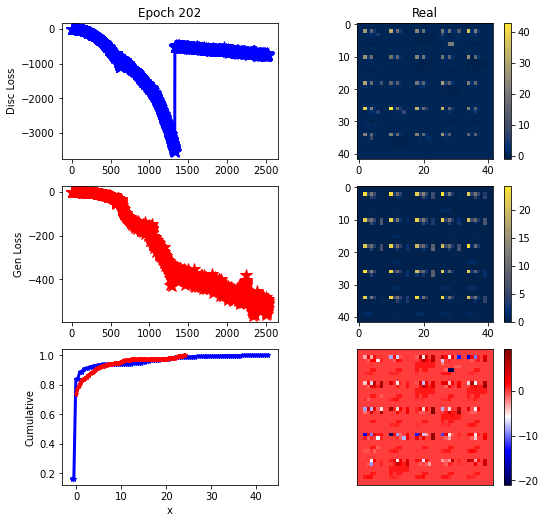

ErrG: -507.77127511160717, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


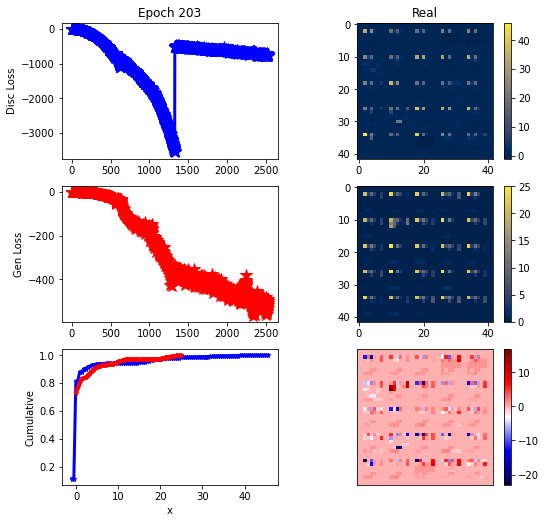

ErrG: -516.1023646763393, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


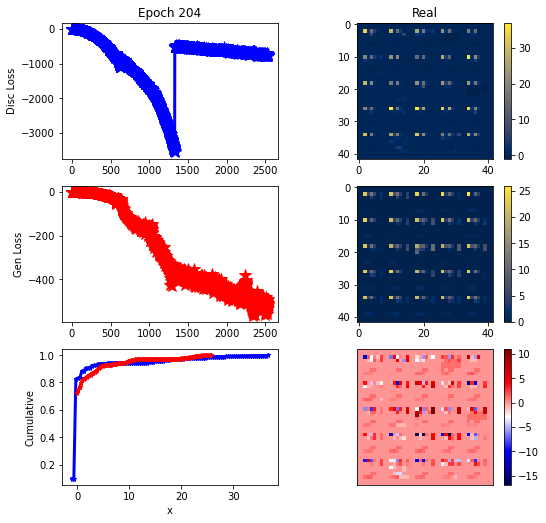

ErrG: -510.09814453125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


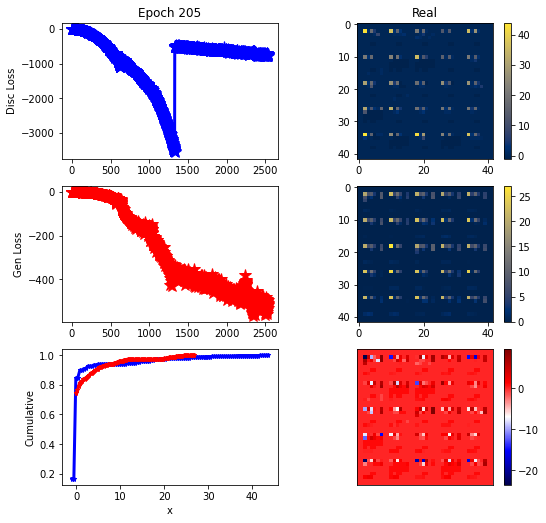

ErrG: -492.7966831752232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


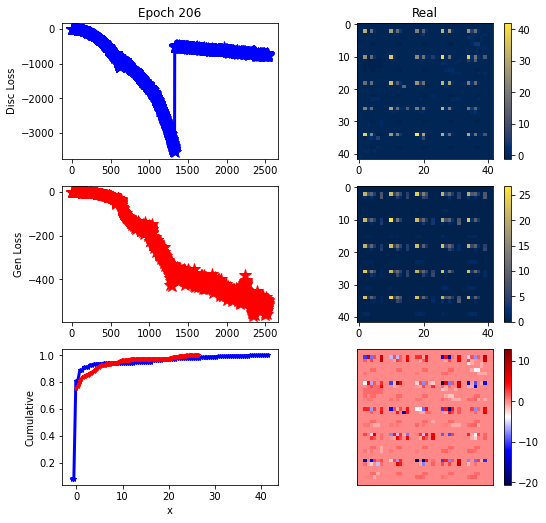

ErrG: -500.04879324776783, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


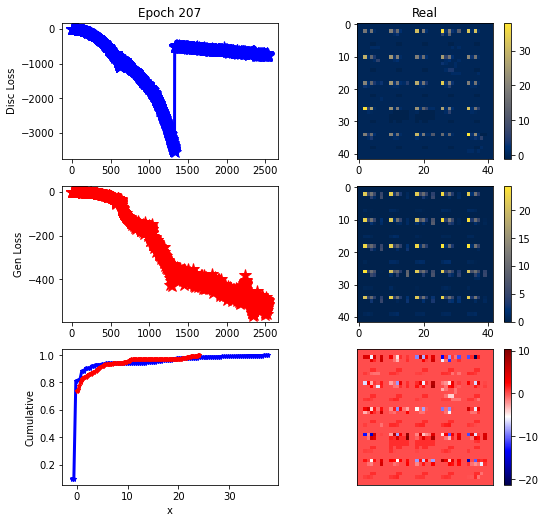

ErrG: -512.2791312081473, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


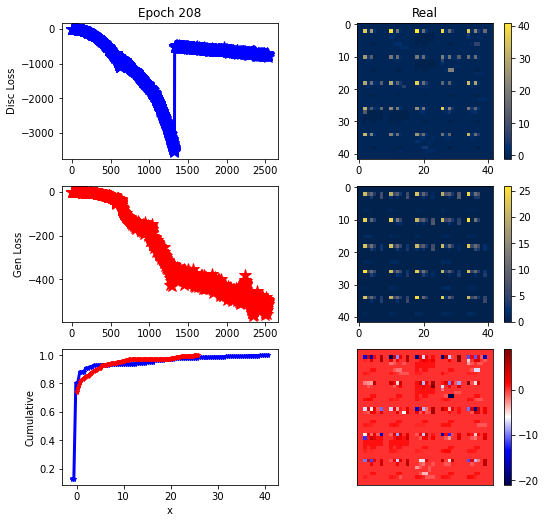

ErrG: -503.2511509486607, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


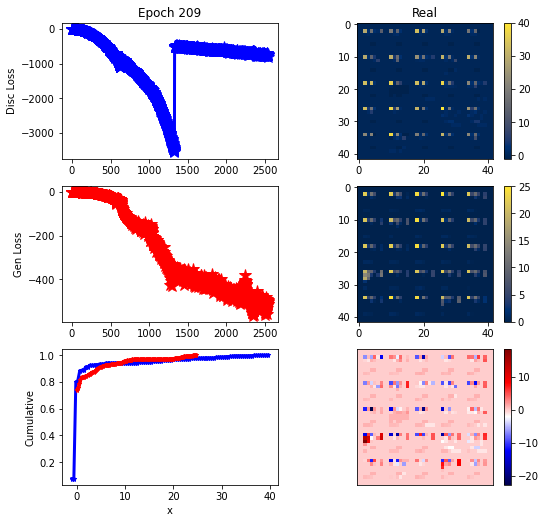

ErrG: -513.493918282645, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


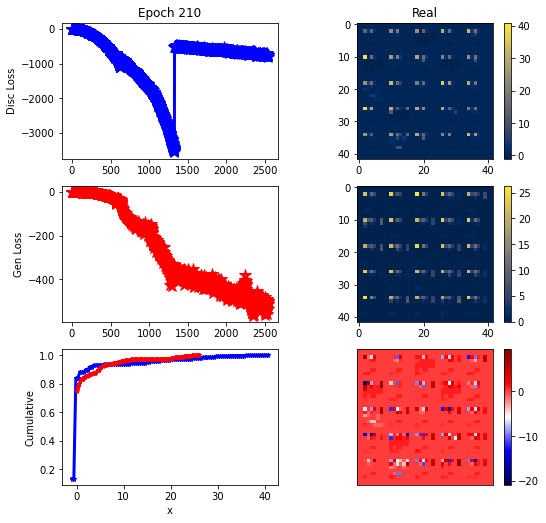

ErrG: -535.9070739746094, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


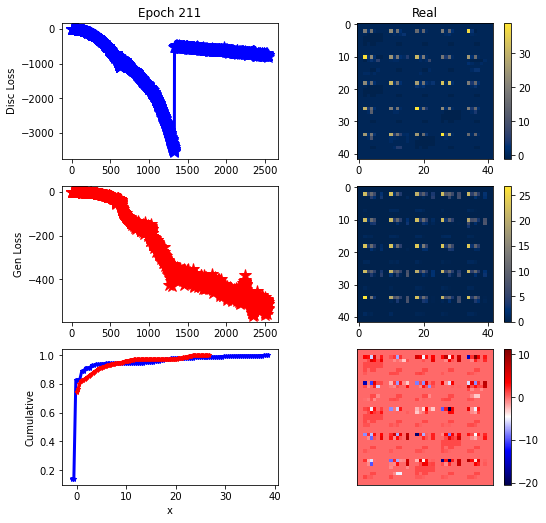

ErrG: -530.9609069824219, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


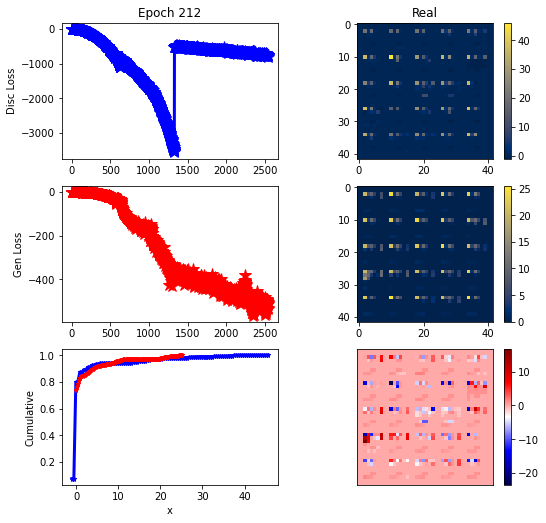

ErrG: -509.66786411830356, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


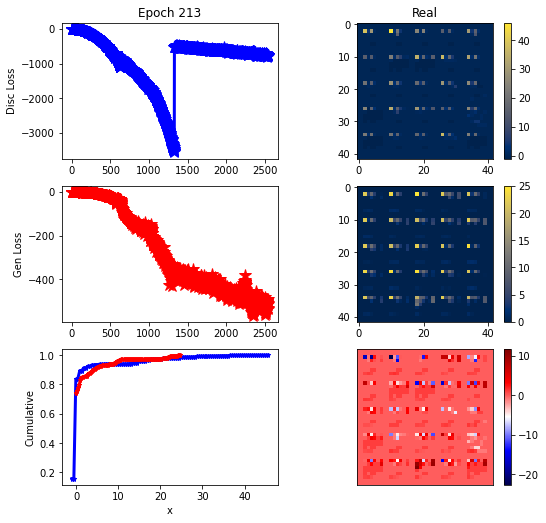

ErrG: -491.27125331333707, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


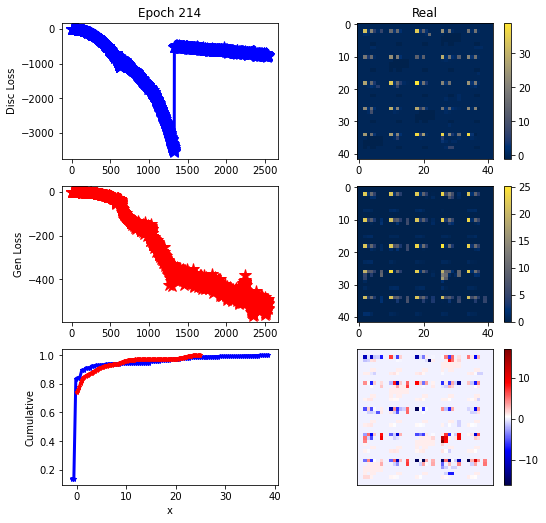

ErrG: -512.8525739397321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


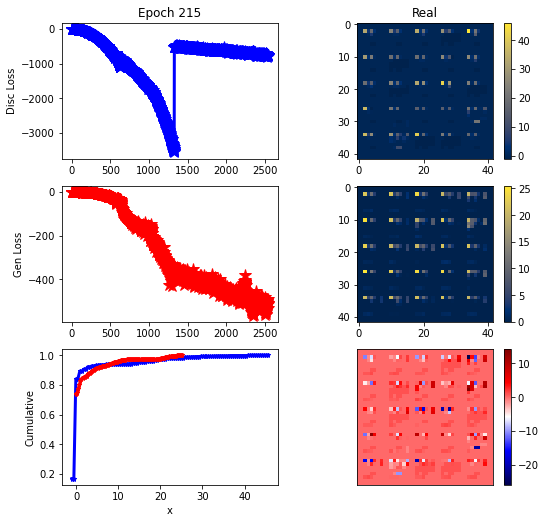

ErrG: -507.79945591517856, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


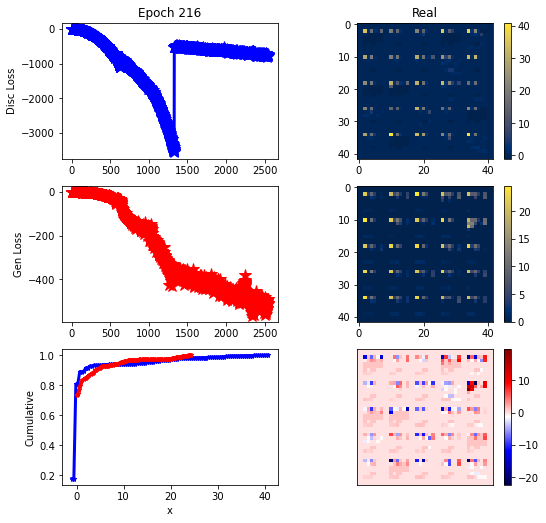

ErrG: -489.41526576450894, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


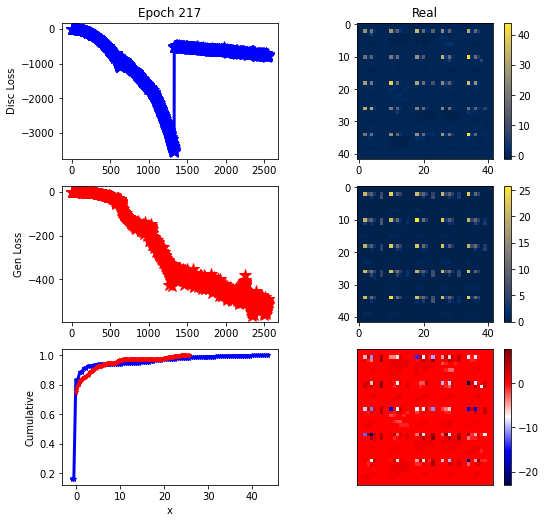

ErrG: -517.8338623046875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


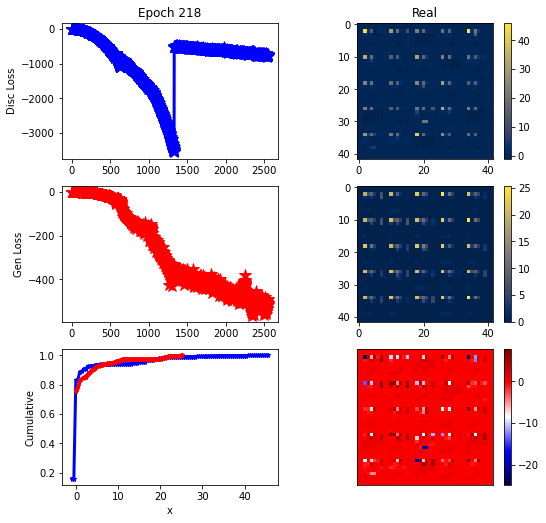

ErrG: -509.4874005998884, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


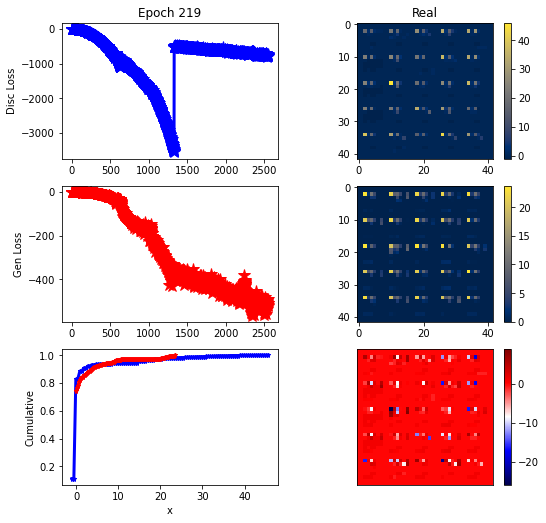

ErrG: -520.2866298130581, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


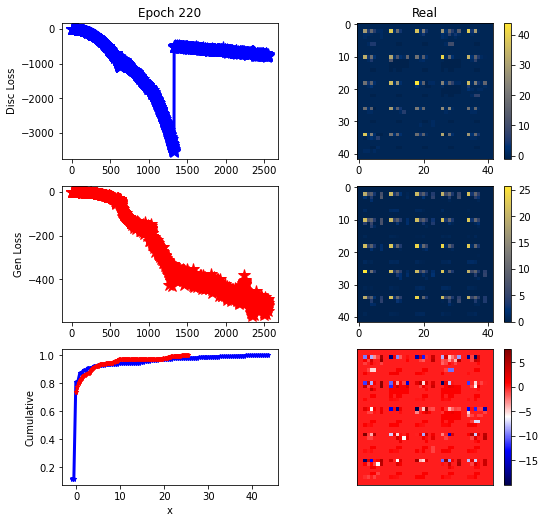

ErrG: -544.4198739188058, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


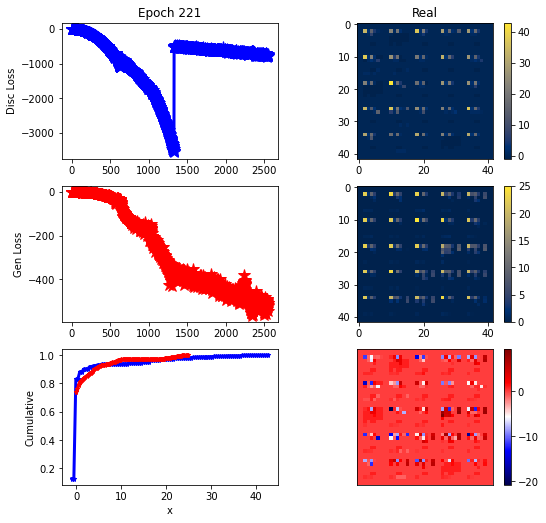

ErrG: -509.688973563058, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


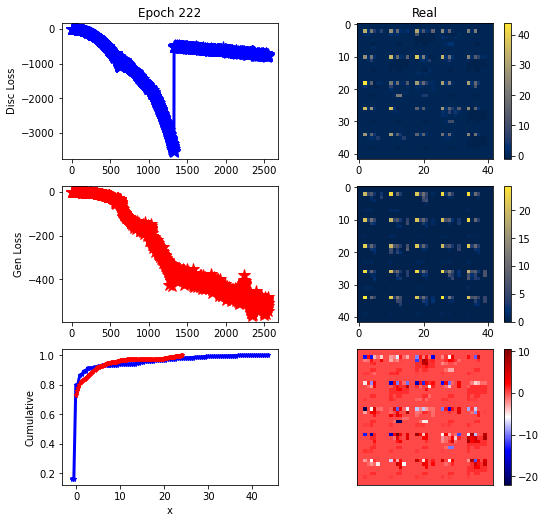

ErrG: -479.55174037388394, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


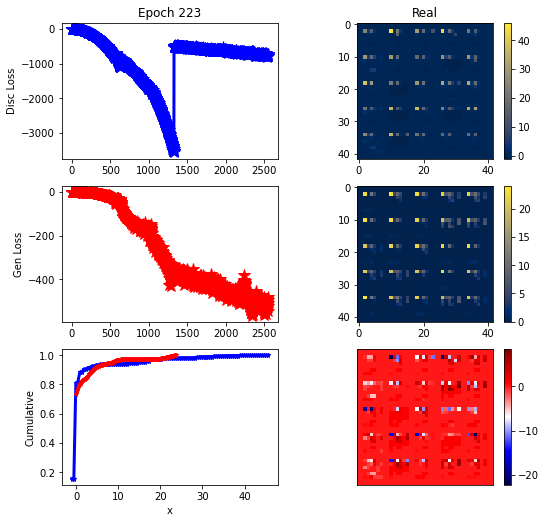

ErrG: -494.94803728376115, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


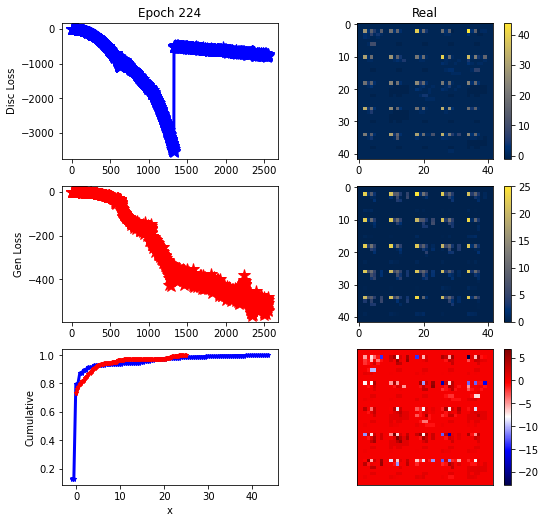

ErrG: -540.5650852748325, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


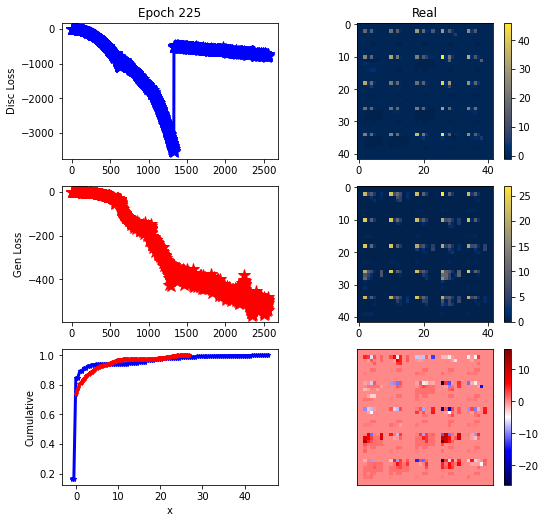

ErrG: -498.7110857282366, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


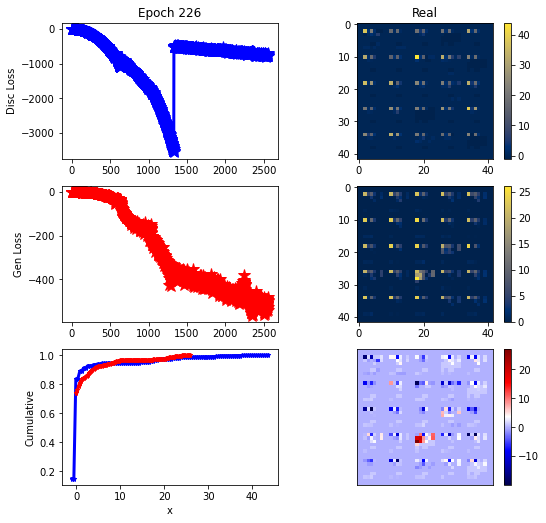

ErrG: -526.8407069614956, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


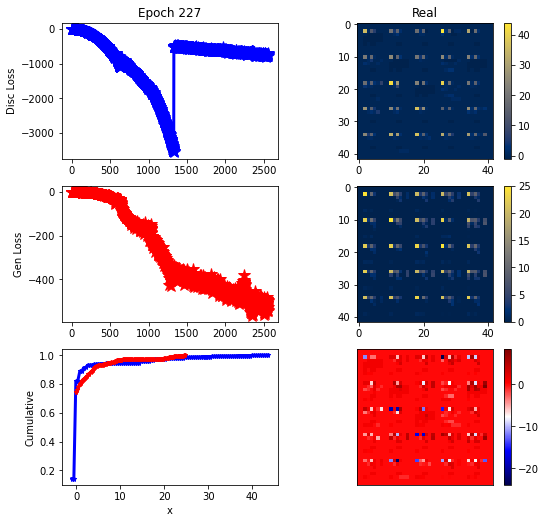

ErrG: -543.6650259835379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


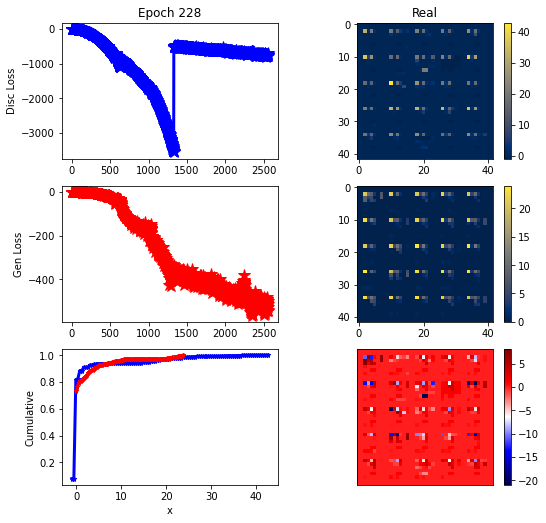

ErrG: -511.77528599330356, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


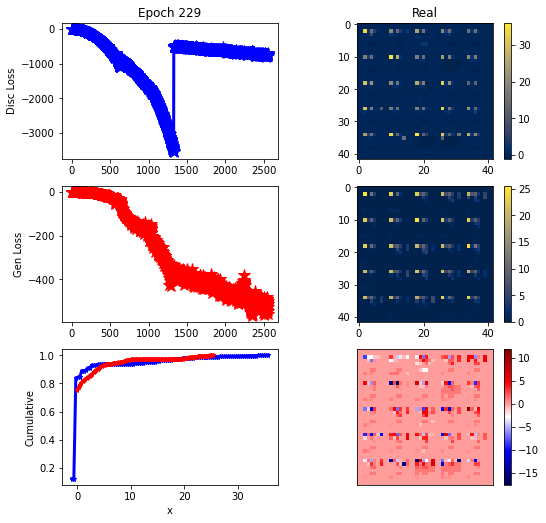

ErrG: -560.1121477399554, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


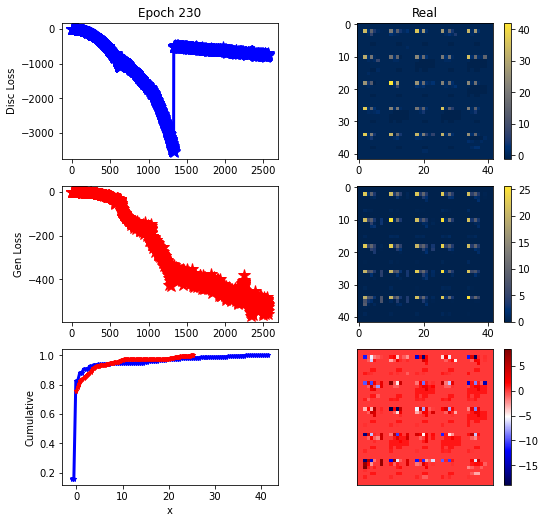

ErrG: -516.6959490094866, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


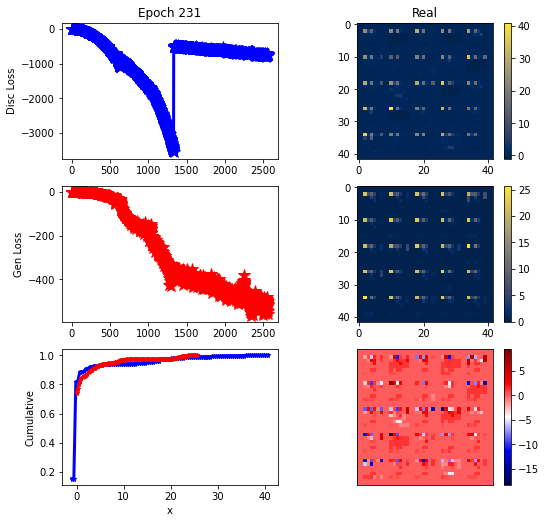

ErrG: -498.9482116699219, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


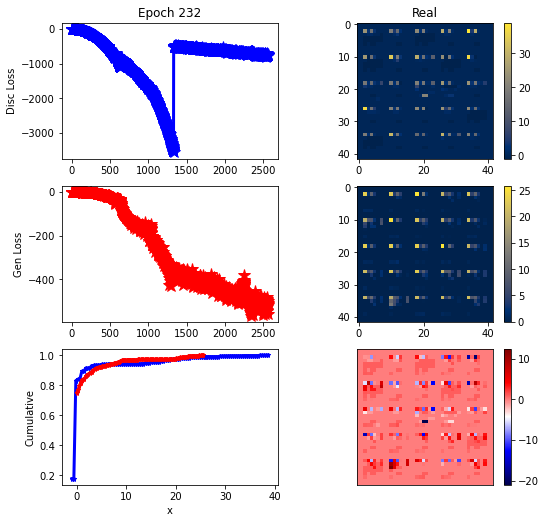

ErrG: -508.51956612723217, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


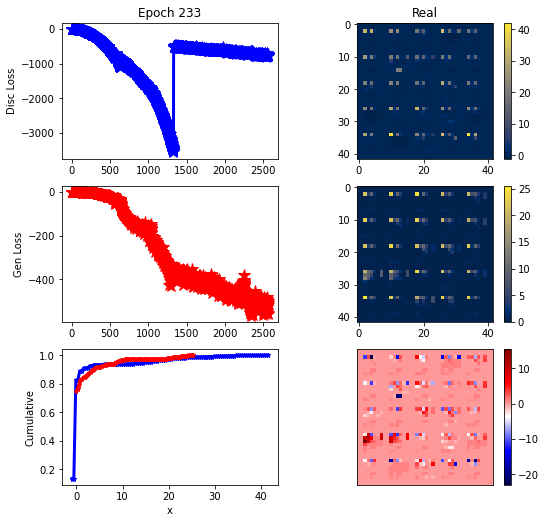

ErrG: -553.1486118861607, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


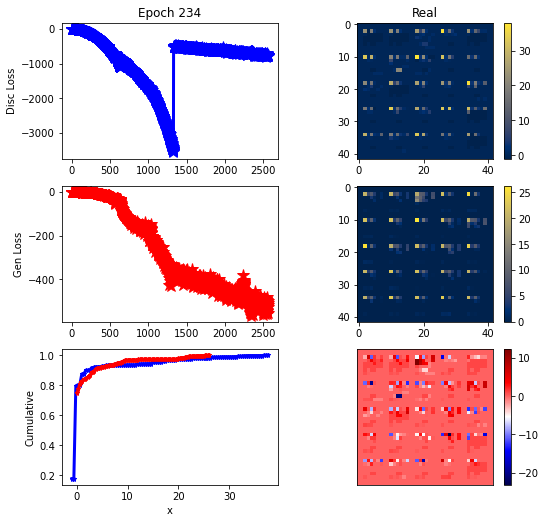

ErrG: -526.5547964913504, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


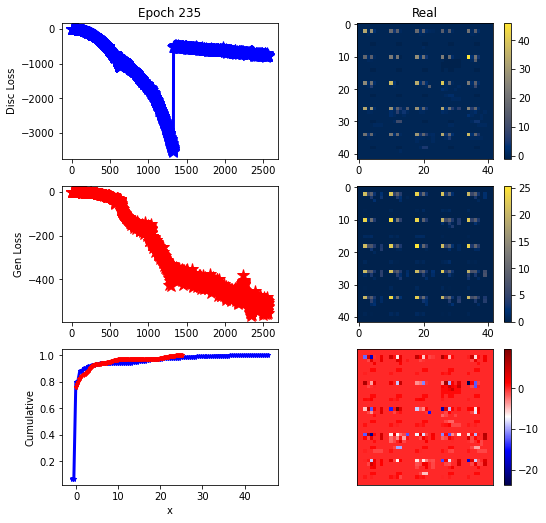

ErrG: -523.4520743233817, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


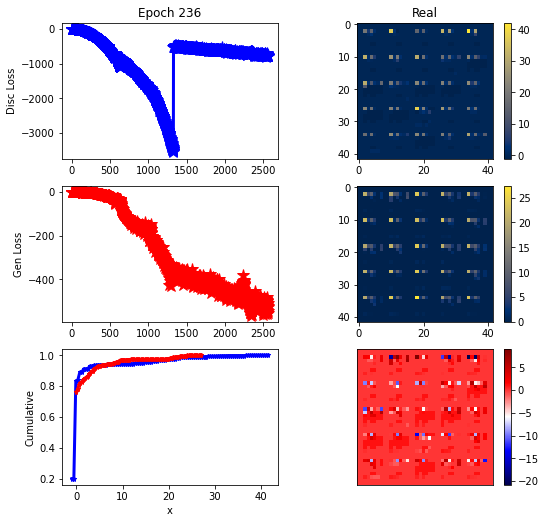

ErrG: -544.533708844866, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


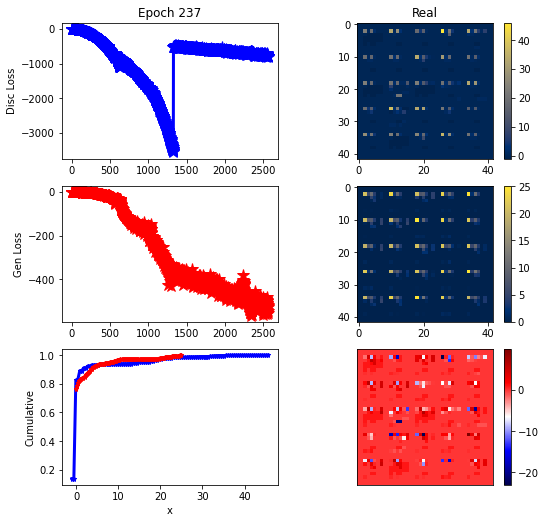

ErrG: -515.6686532156808, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


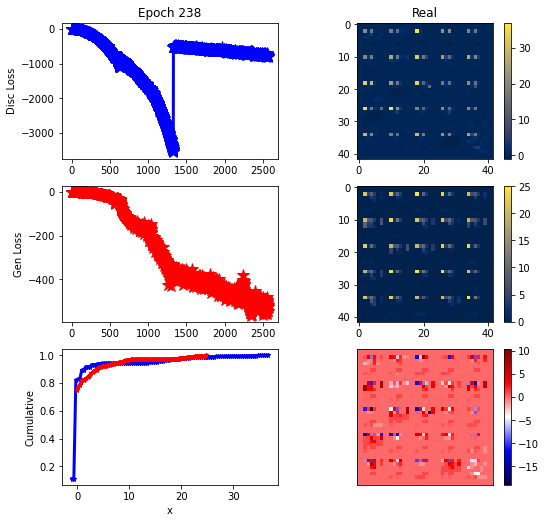

ErrG: -543.853288922991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


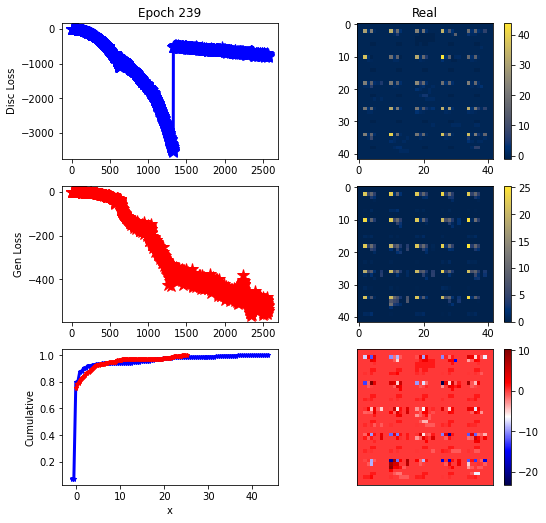

ErrG: -536.5263759068081, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


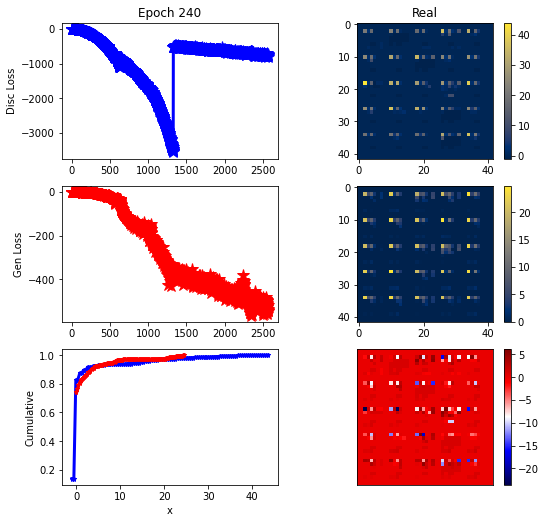

ErrG: -539.4261474609375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


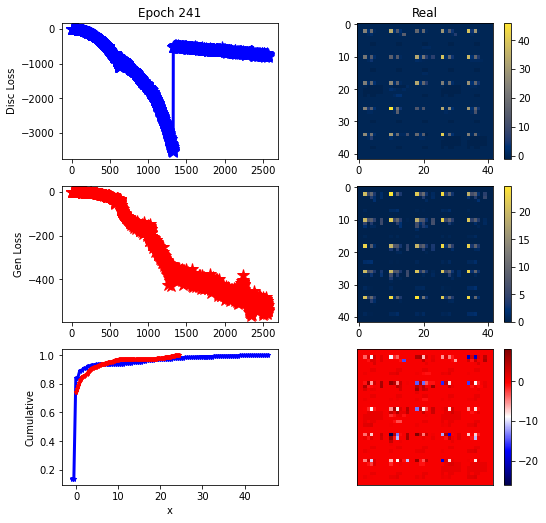

ErrG: -545.5777369907925, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


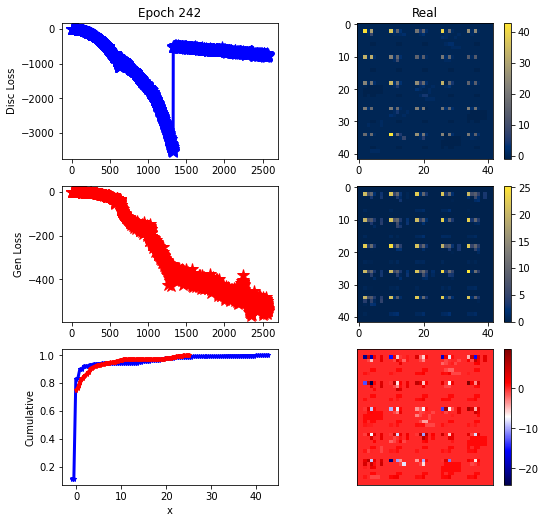

ErrG: -529.4151175362723, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


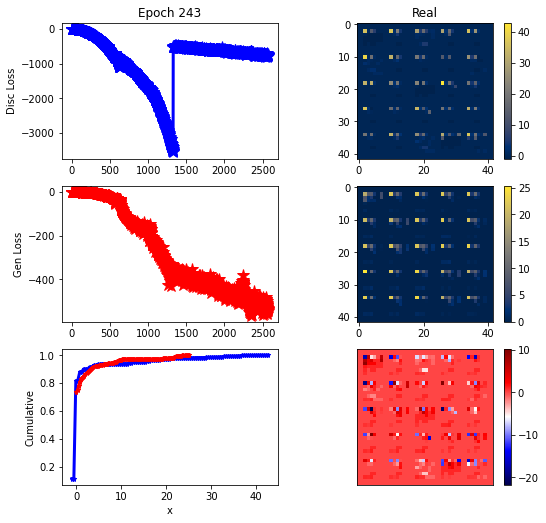

ErrG: -534.3964930943081, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


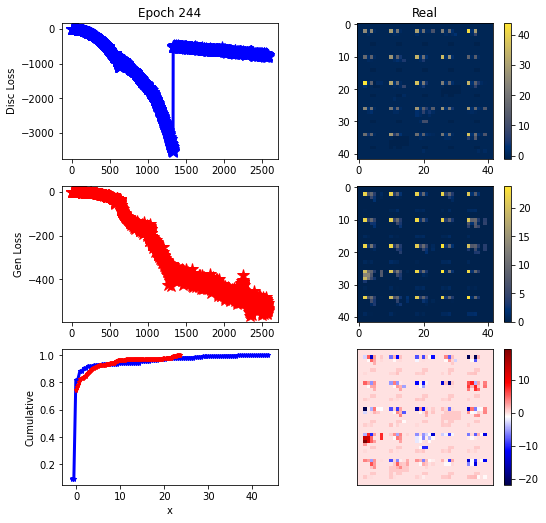

ErrG: -507.0253601074219, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


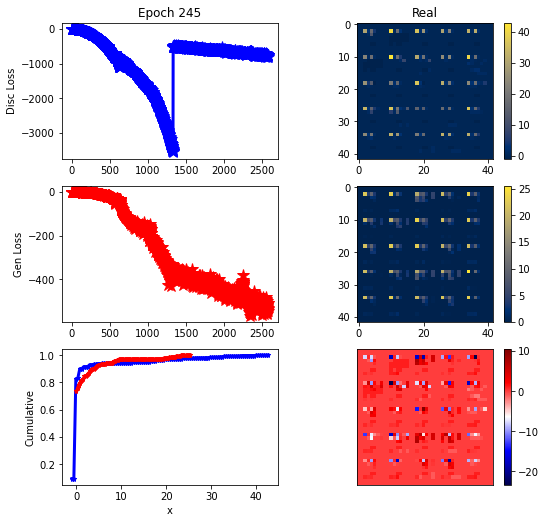

ErrG: -509.78536551339283, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


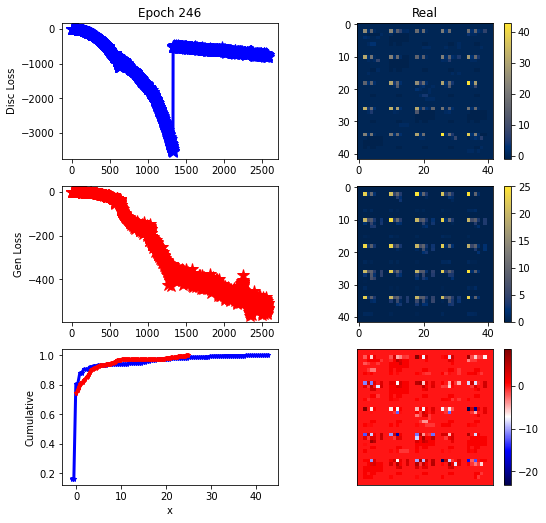

ErrG: -529.4845755440848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


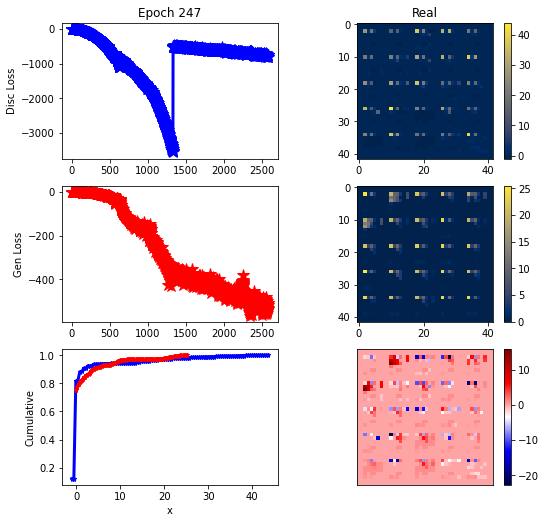

ErrG: -516.3385402134487, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


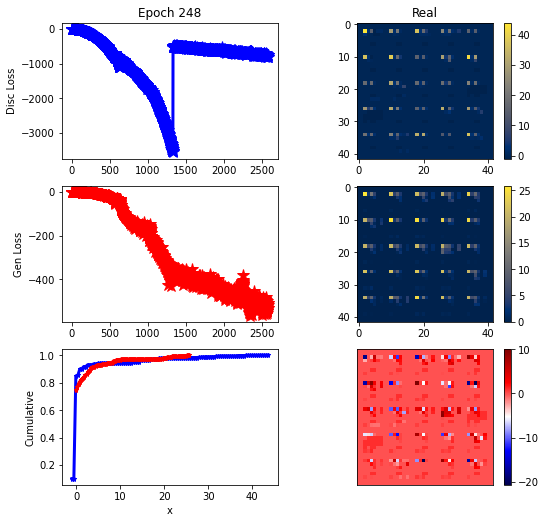

ErrG: -530.8700299944196, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


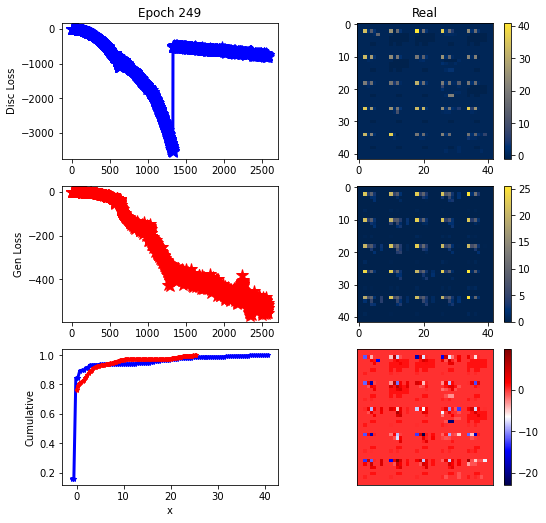

ErrG: -554.5734514508929, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


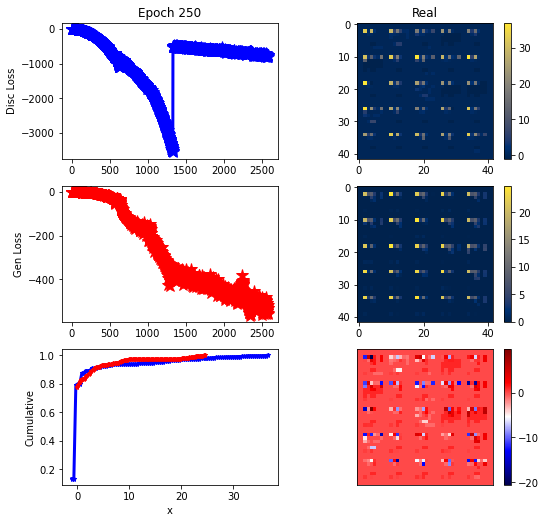

ErrG: -558.4919782366071, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


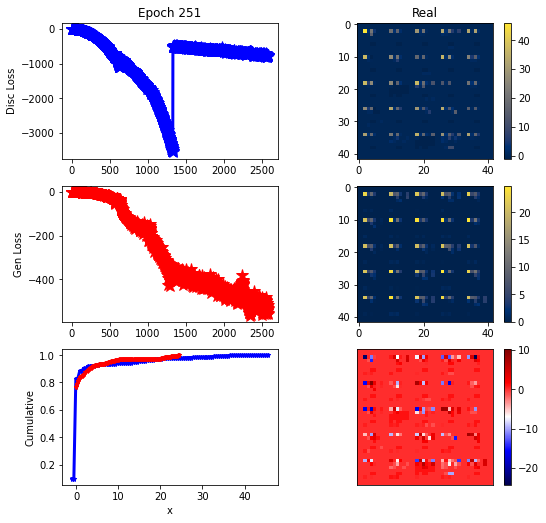

ErrG: -533.5349426269531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


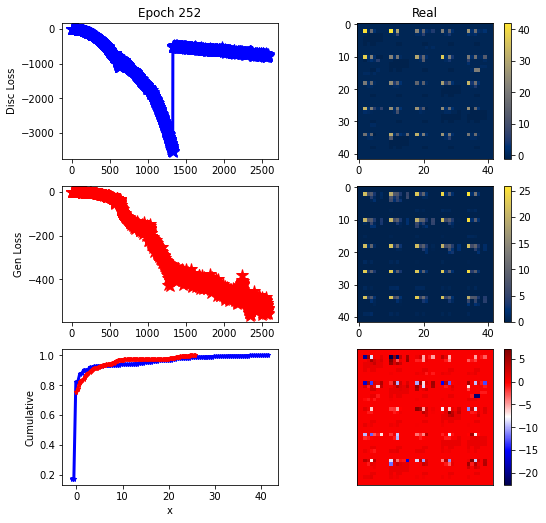

ErrG: -532.1551818847656, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


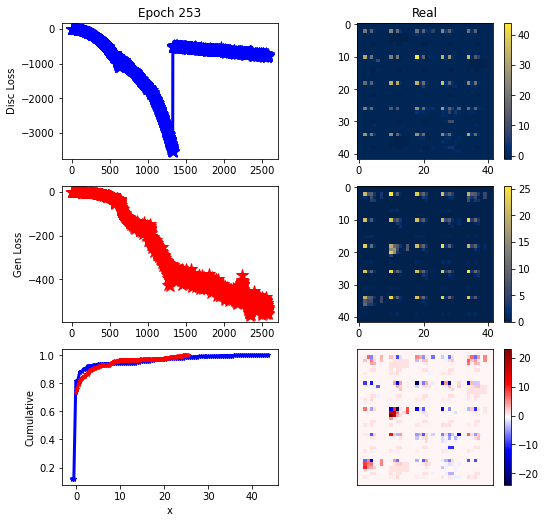

ErrG: -527.1603567940848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


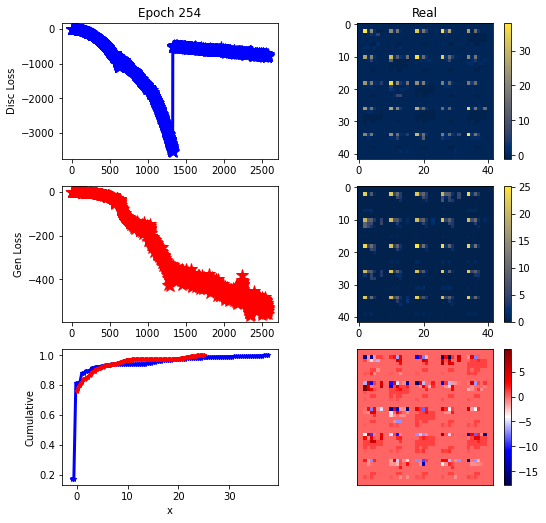

ErrG: -543.8354404994419, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


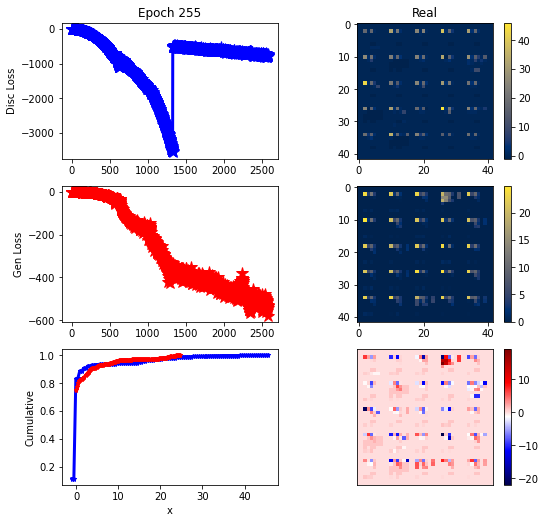

ErrG: -578.7791748046875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


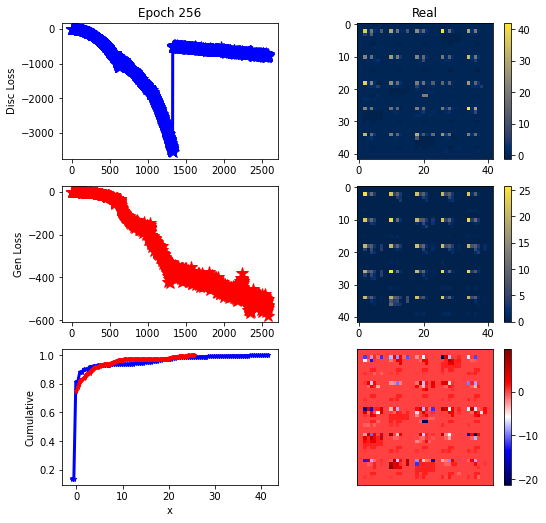

ErrG: -500.8258274623326, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


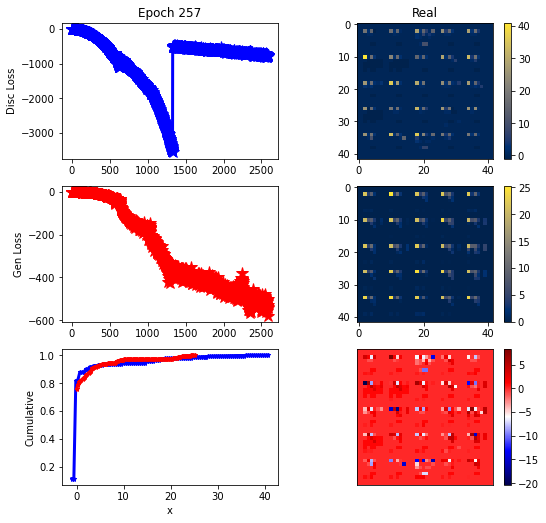

ErrG: -540.519771030971, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


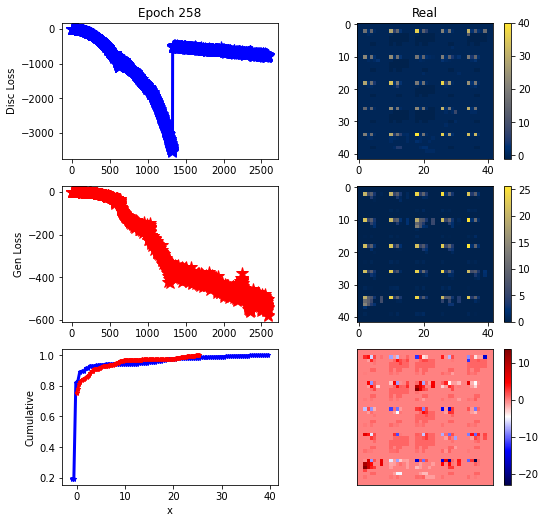

ErrG: -580.9284580775669, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


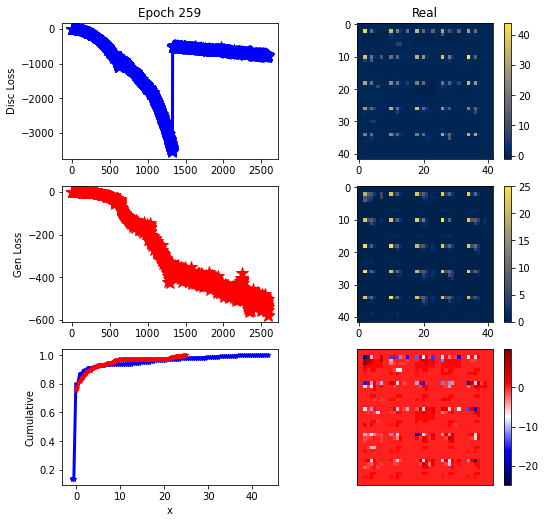

ErrG: -553.8129054478237, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


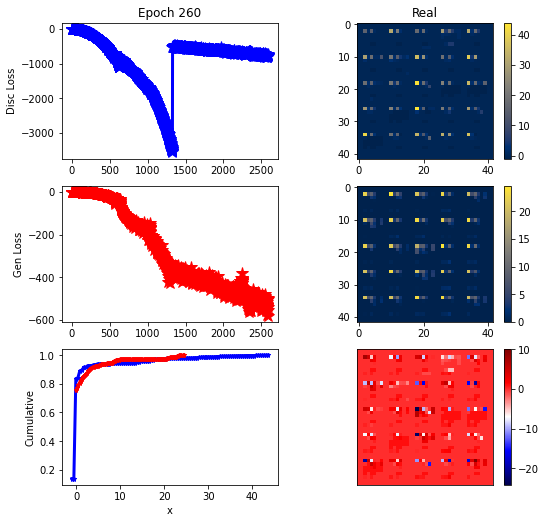

ErrG: -497.97447422572543, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


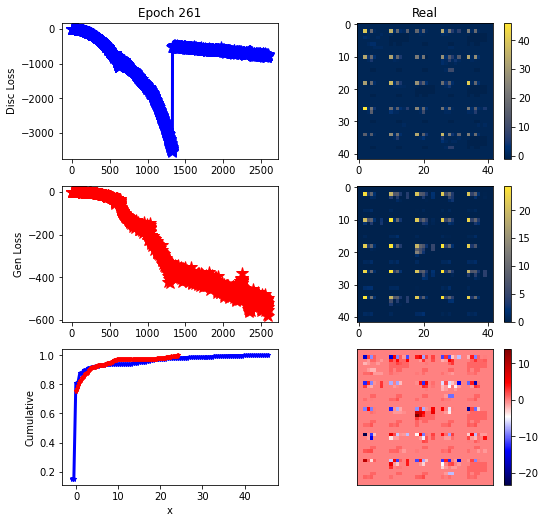

ErrG: -521.8457903180804, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


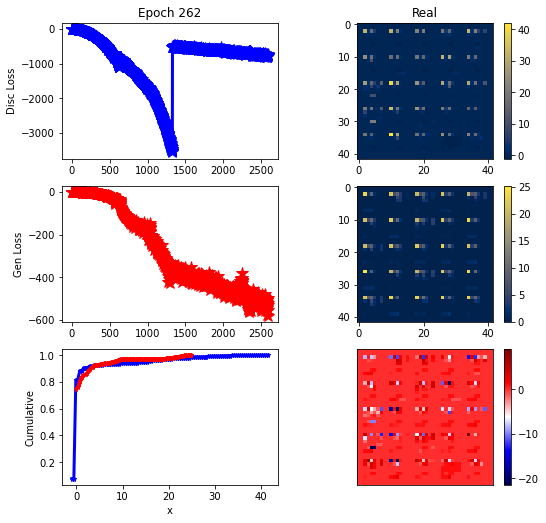

ErrG: -530.6225847516741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


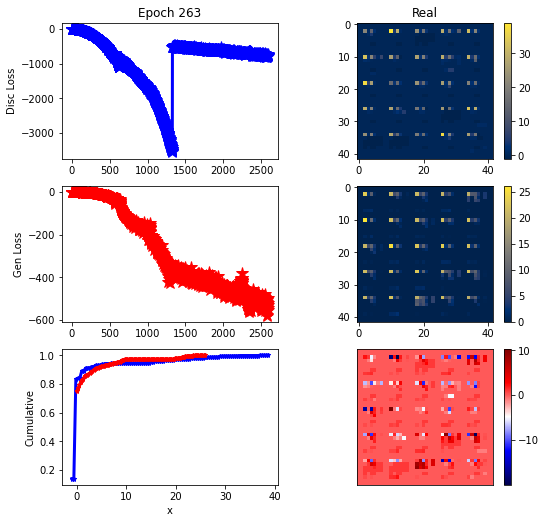

ErrG: -547.4959673200335, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


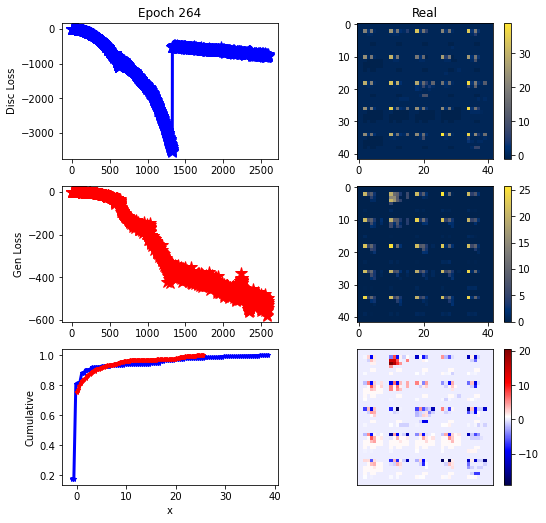

ErrG: -514.7579650878906, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


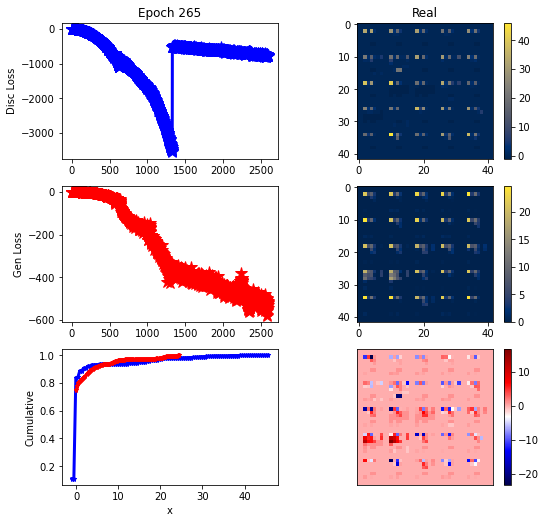

ErrG: -518.8828778948102, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


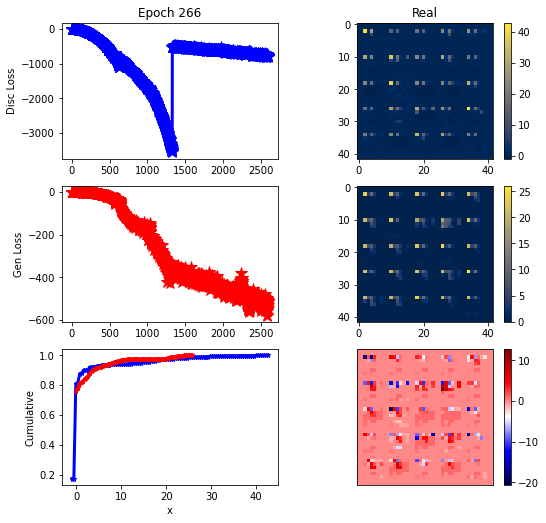

ErrG: -509.04200526646207, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


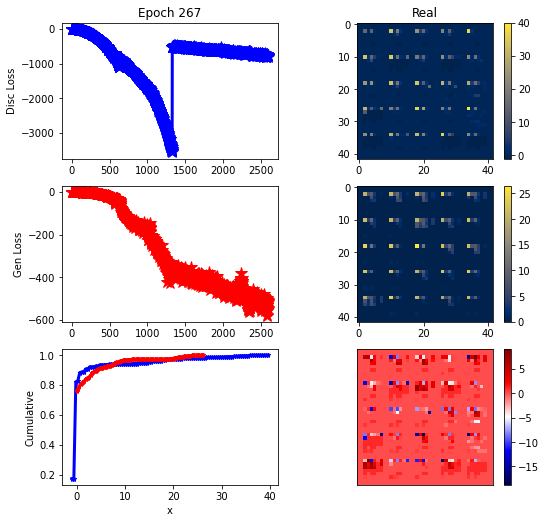

ErrG: -551.6702575683594, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


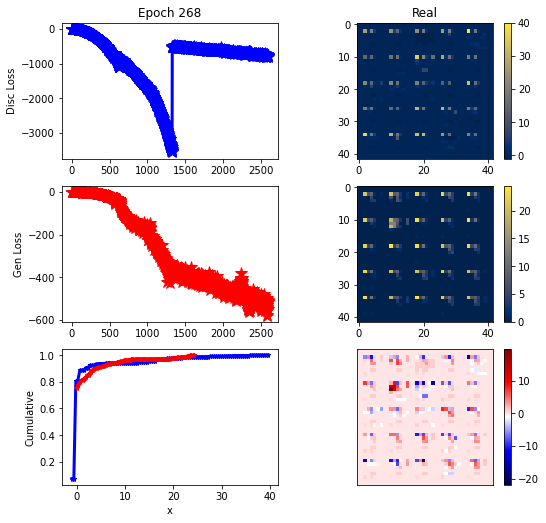

ErrG: -516.9573538643973, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


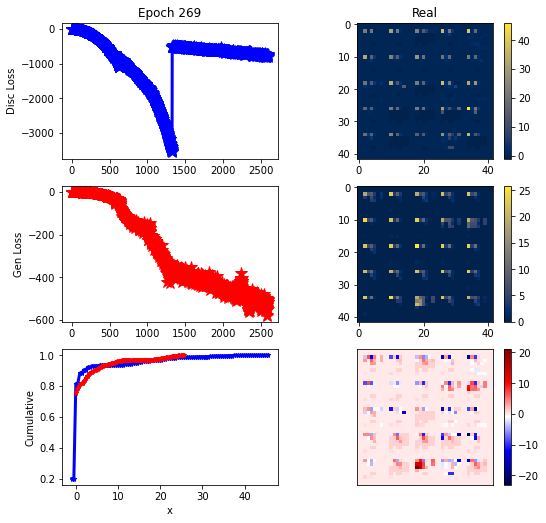

ErrG: -503.06173270089283, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


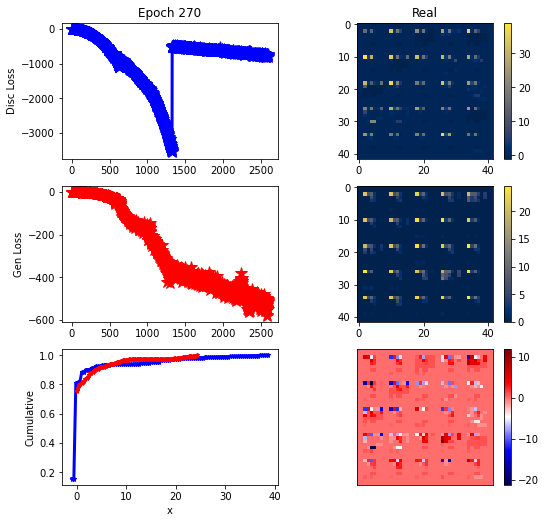

ErrG: -511.2335946219308, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


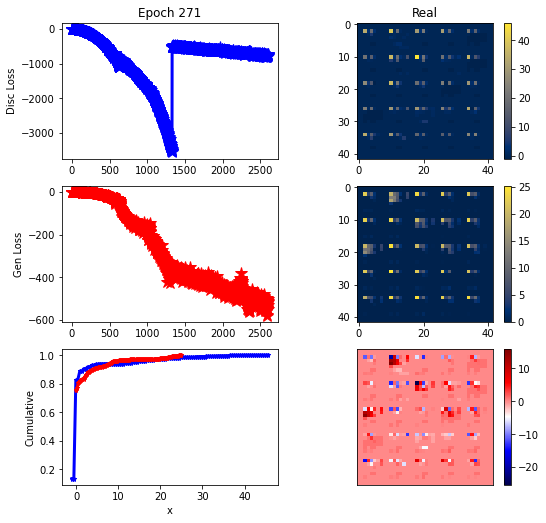

ErrG: -532.5670950753348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


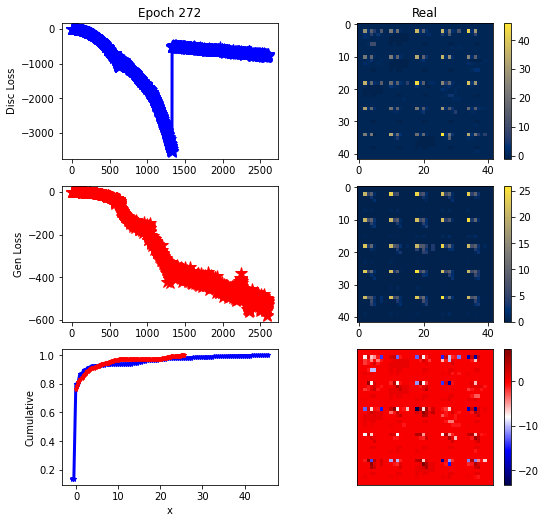

ErrG: -527.902326311384, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


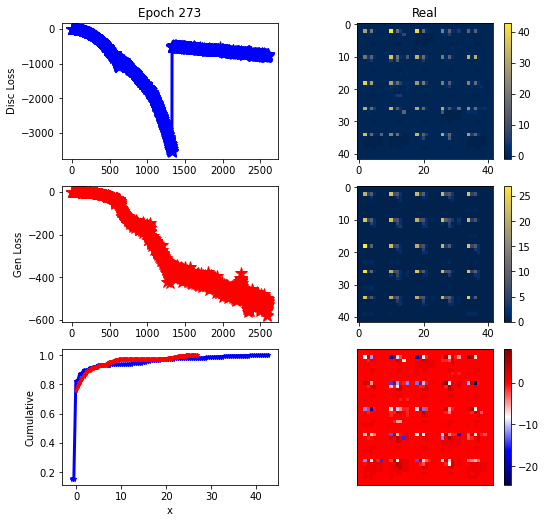

ErrG: -515.5008414132254, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


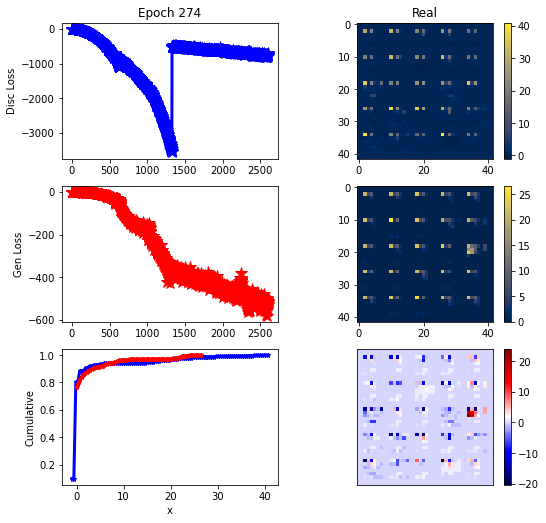

ErrG: -517.9177594866071, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


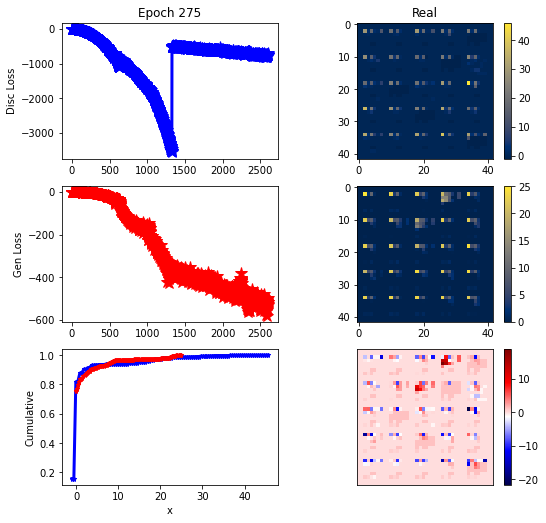

ErrG: -496.74342564174106, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


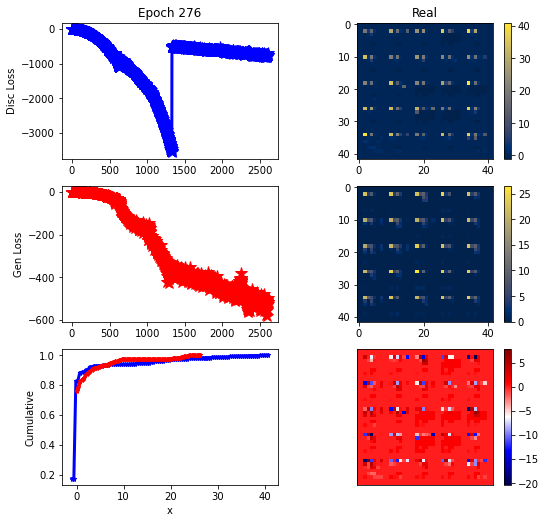

ErrG: -516.1708286830357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


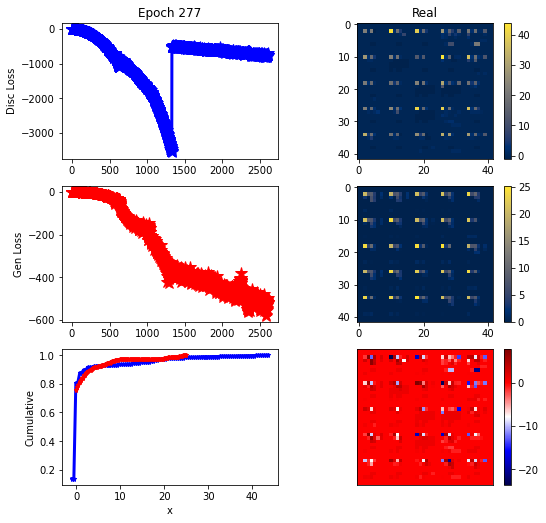

ErrG: -521.0160391671317, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


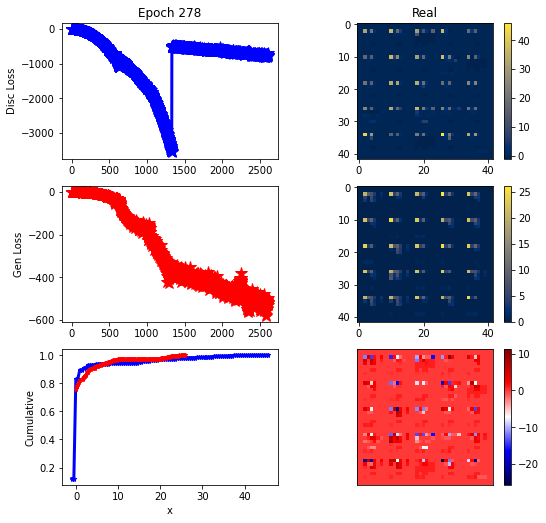

ErrG: -532.1935599190848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


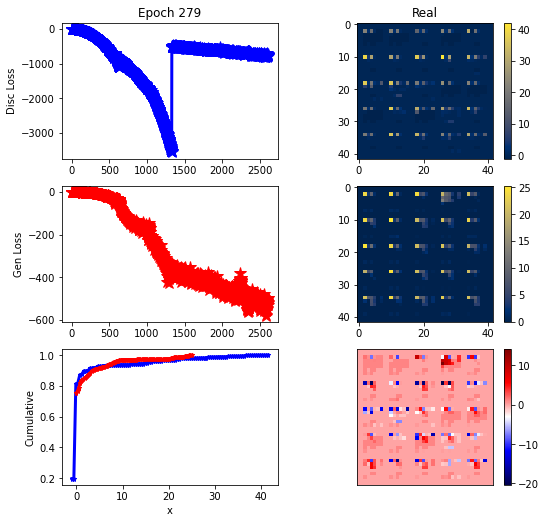

ErrG: -498.3908037458147, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


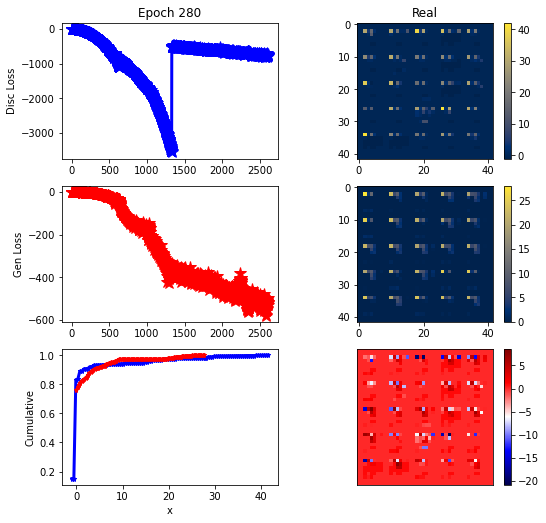

ErrG: -519.2178344726562, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


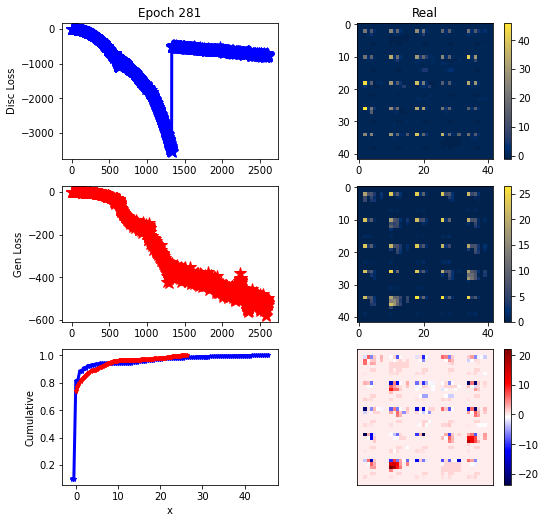

ErrG: -521.7653459821429, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


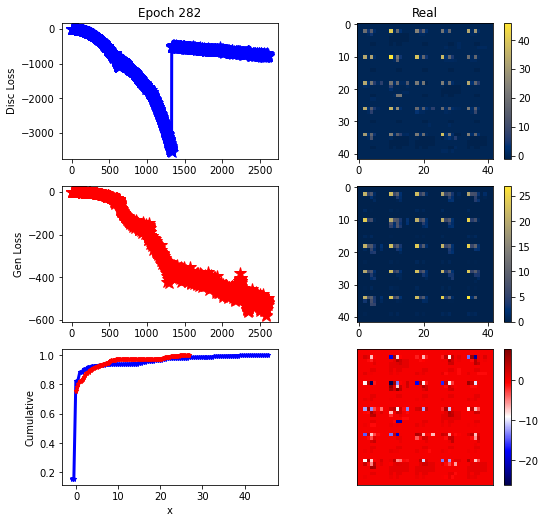

ErrG: -524.0925728934152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


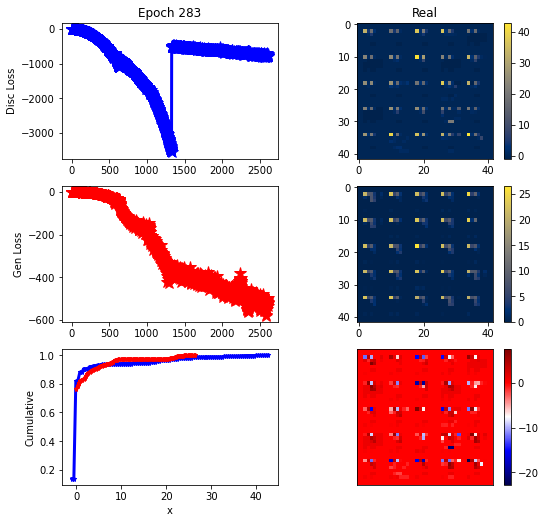

ErrG: -537.655277797154, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


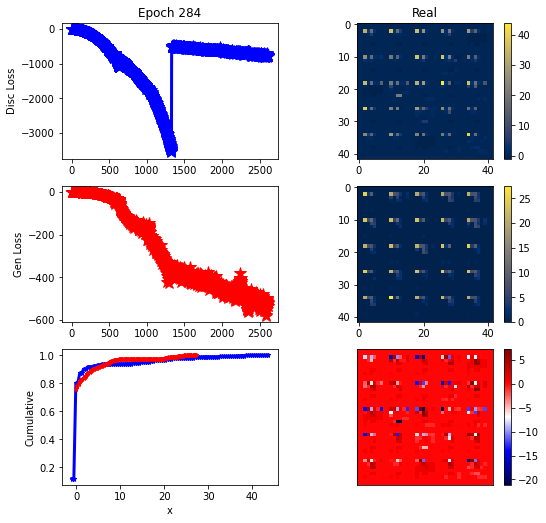

ErrG: -534.6117553710938, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


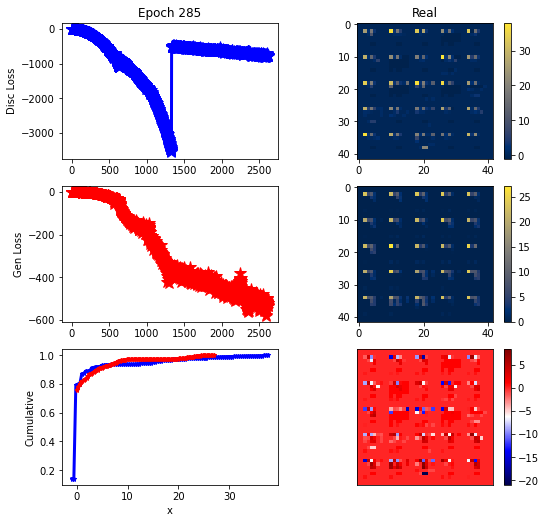

ErrG: -530.805659702846, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


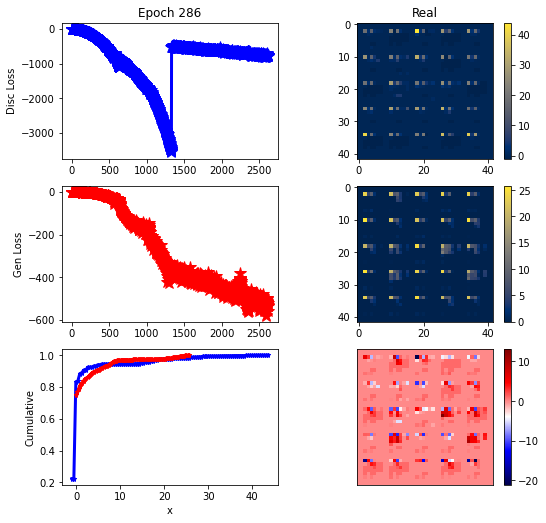

ErrG: -560.3958435058594, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


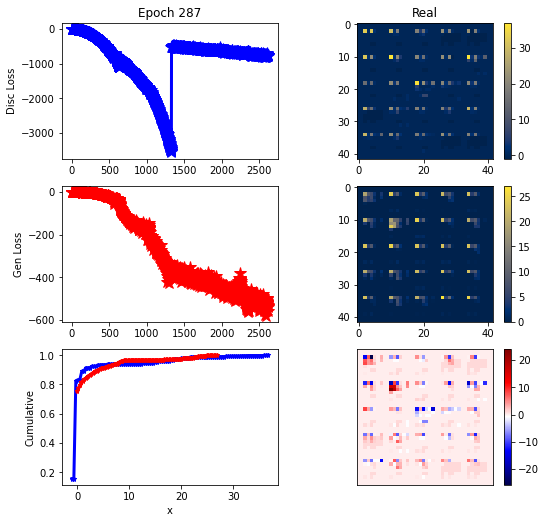

ErrG: -539.3052629743304, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


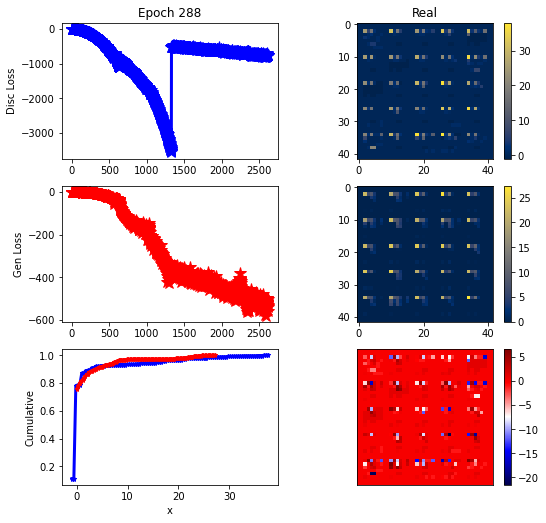

ErrG: -505.41783360072543, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


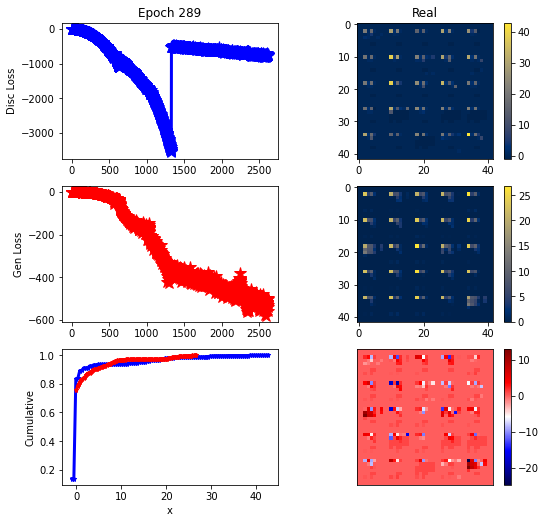

ErrG: -497.8464093889509, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


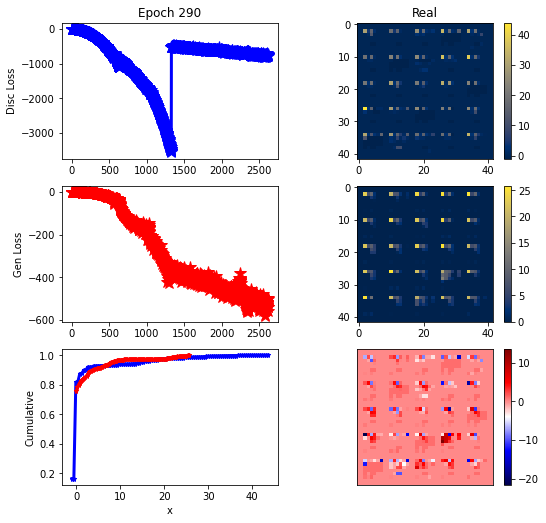

ErrG: -543.0253644670759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


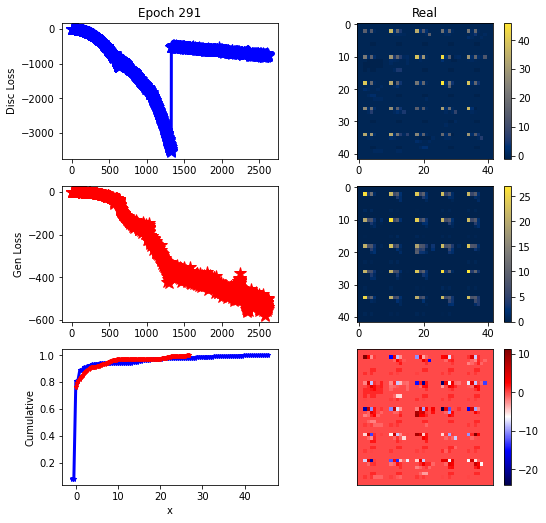

ErrG: -548.149174281529, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


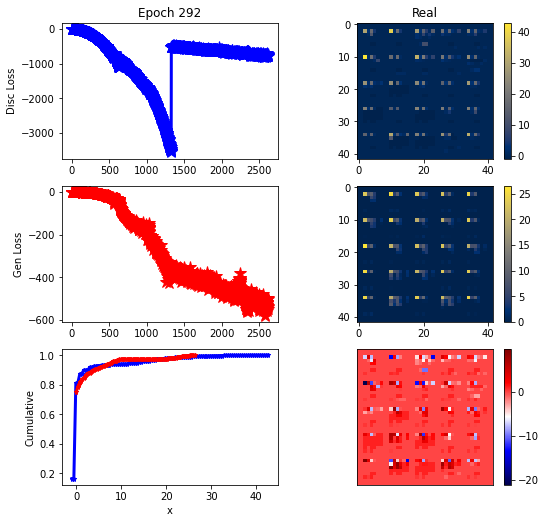

ErrG: -537.6464102608817, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


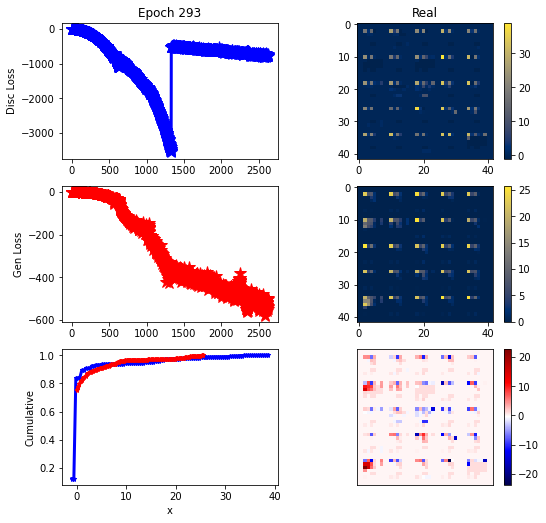

ErrG: -503.9009704589844, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


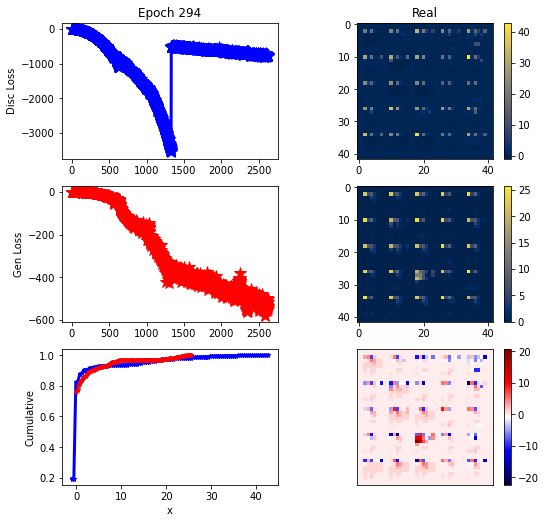

ErrG: -516.1316702706473, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


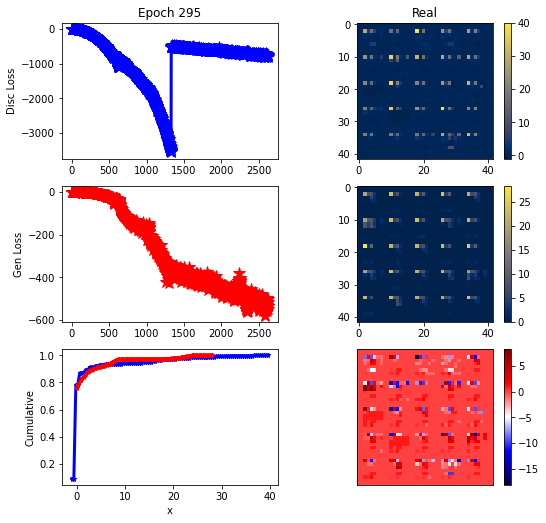

ErrG: -535.9121573311942, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


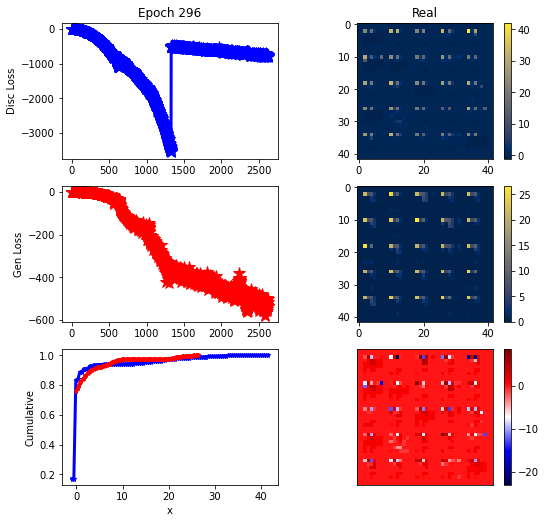

ErrG: -537.6627328055246, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


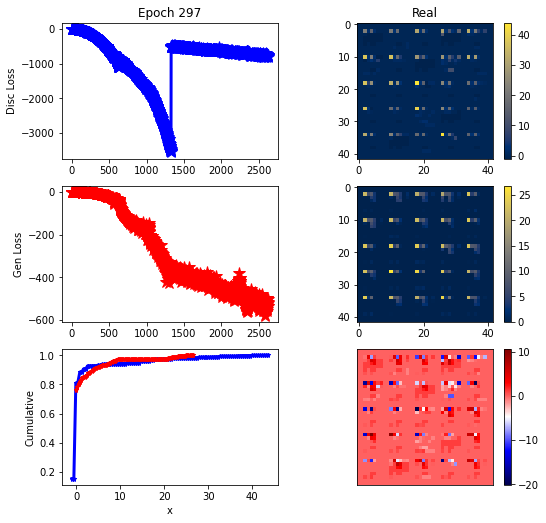

ErrG: -521.9010663713727, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


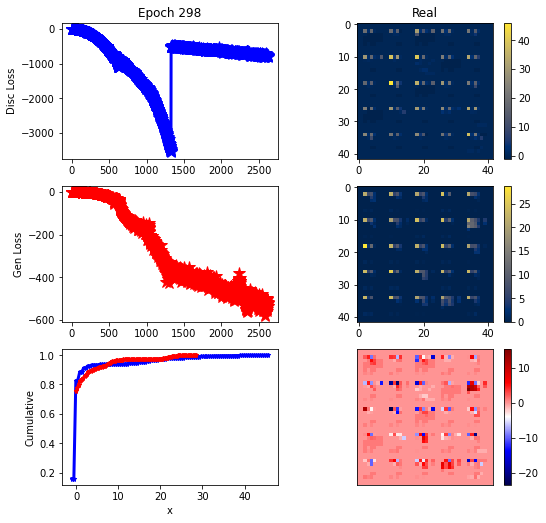

ErrG: -519.9478105817523, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


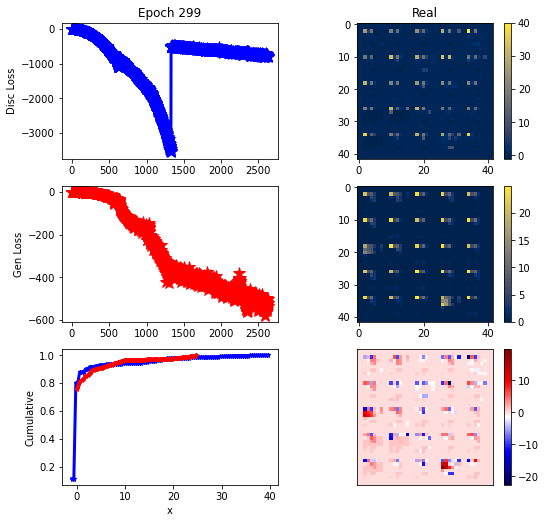

ErrG: -505.0226135253906, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


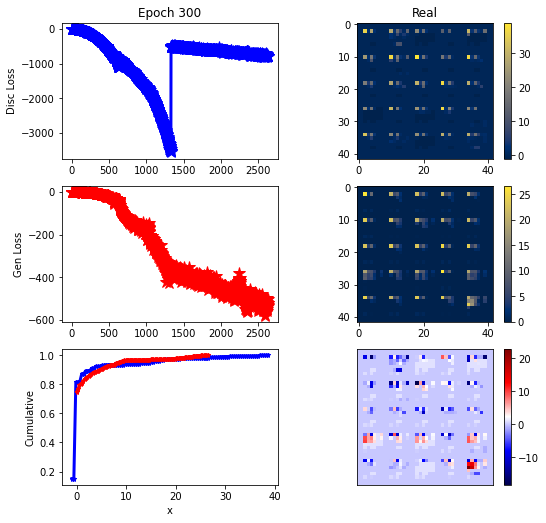

ErrG: -530.4017726353237, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


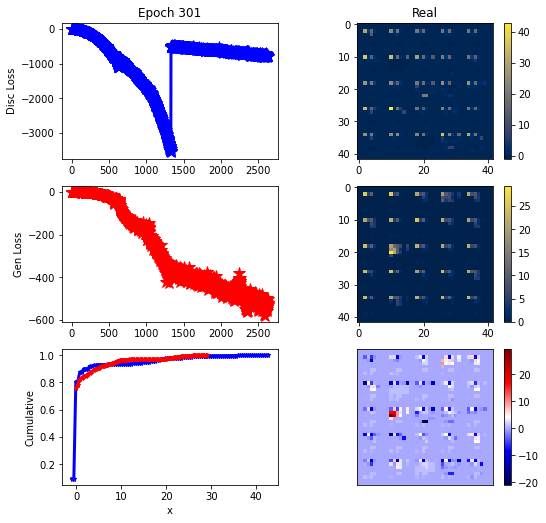

ErrG: -525.5977957589286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


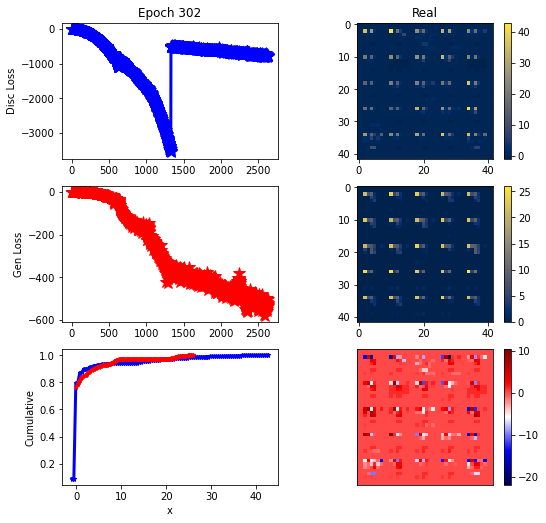

ErrG: -534.2532871791294, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


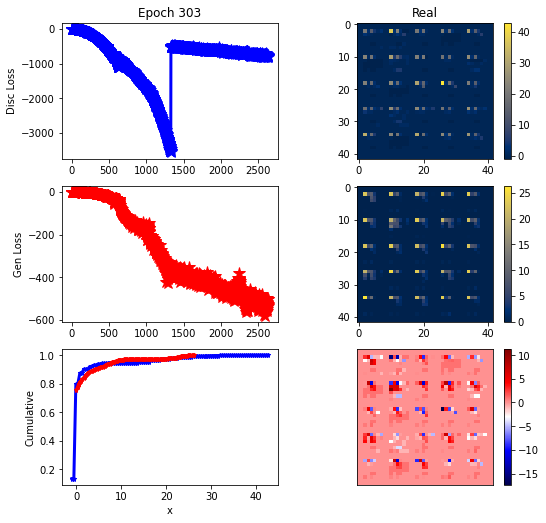

ErrG: -502.97802734375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


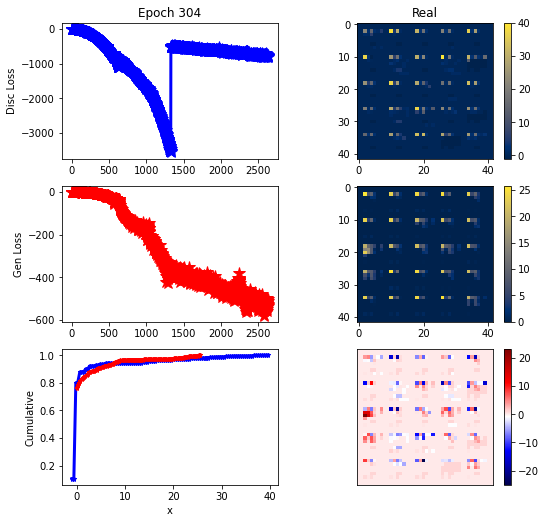

ErrG: -512.7595781598773, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


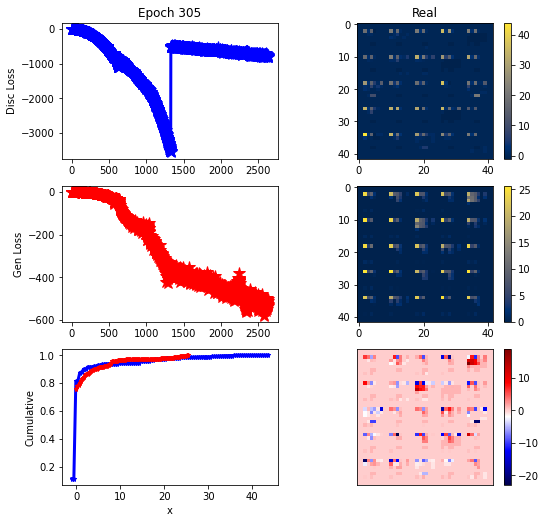

ErrG: -530.9635750906808, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


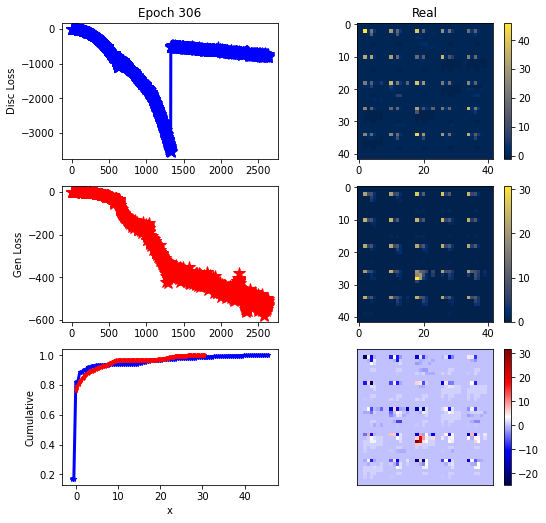

ErrG: -525.5308794294085, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


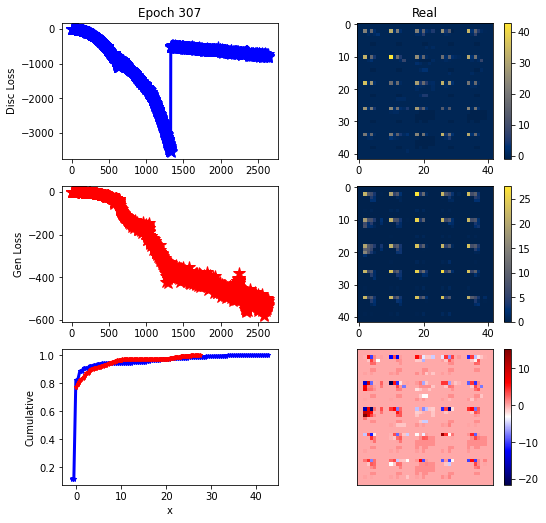

ErrG: -536.791730608259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


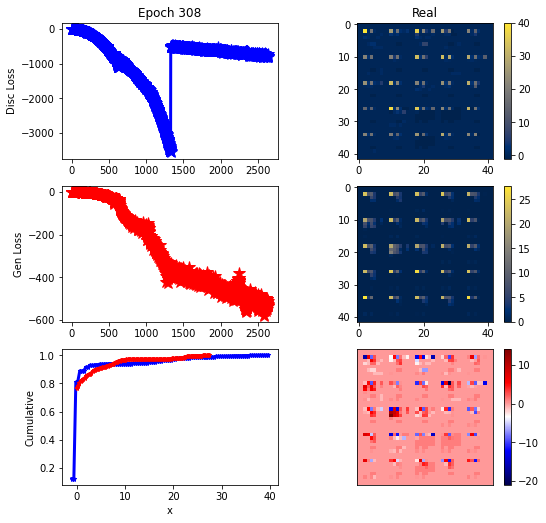

ErrG: -535.7982526506696, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


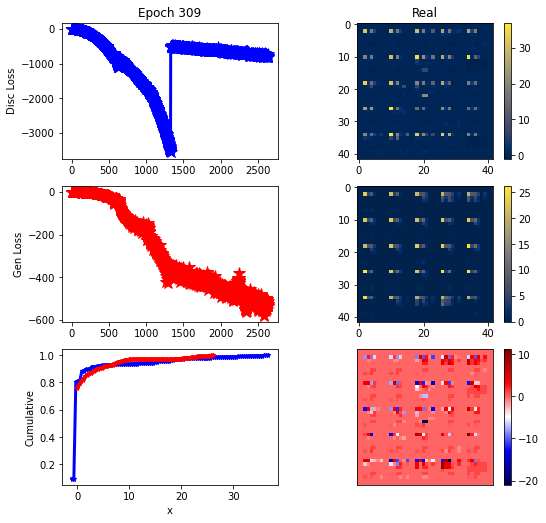

ErrG: -511.27757045200894, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


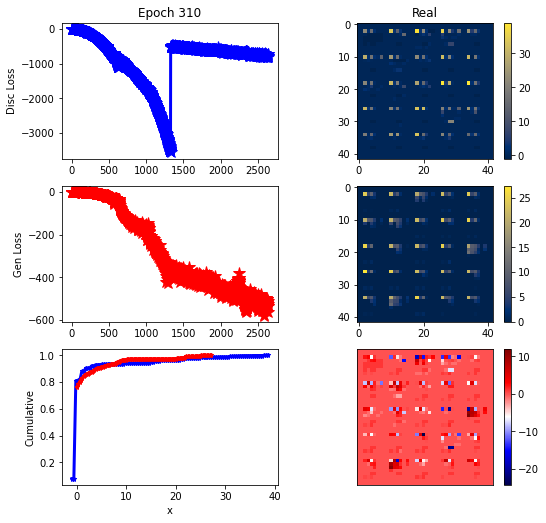

ErrG: -565.211669921875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


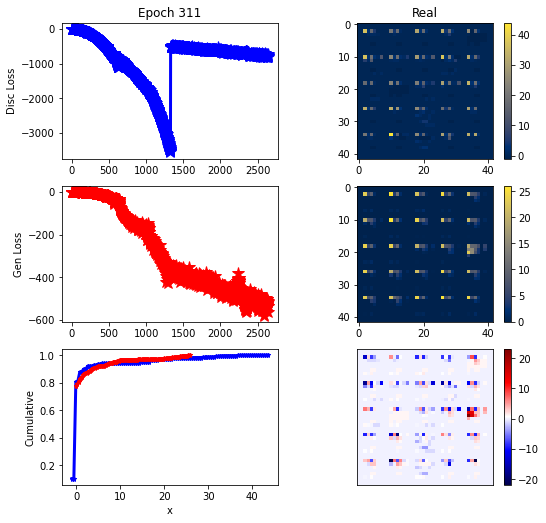

ErrG: -518.5288652692523, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


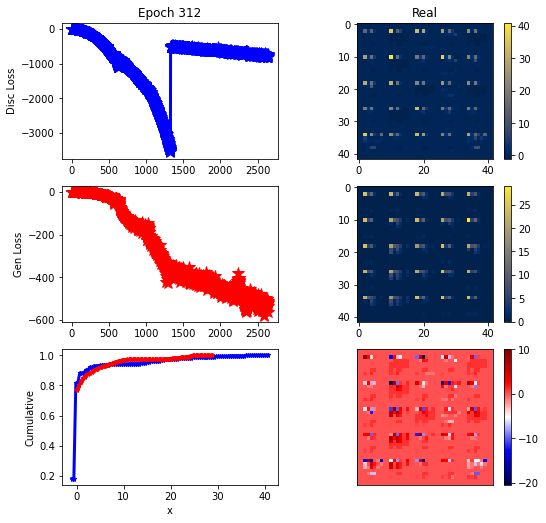

ErrG: -520.9847760881696, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


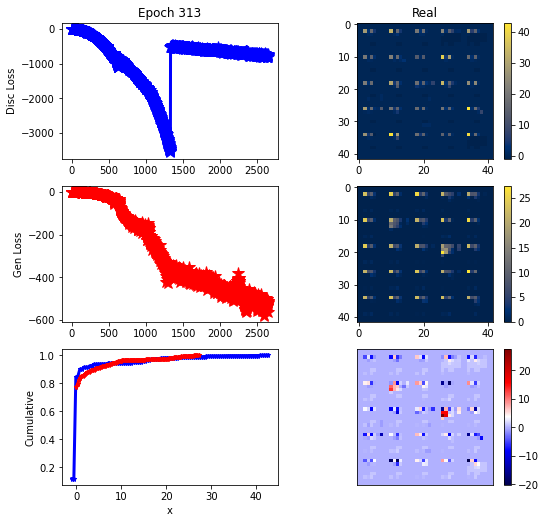

ErrG: -511.7453874860491, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


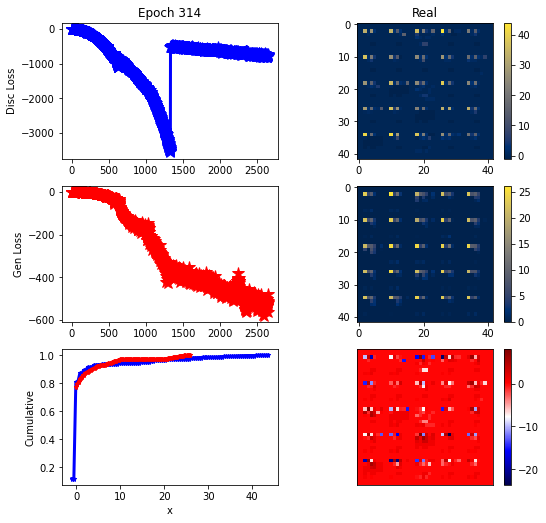

ErrG: -480.52117919921875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


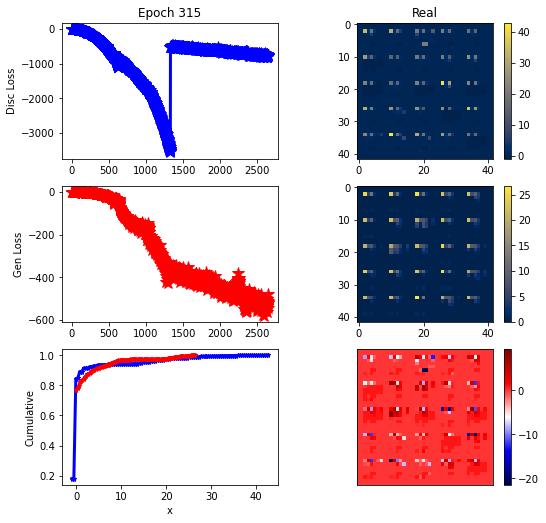

ErrG: -547.5417872837612, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


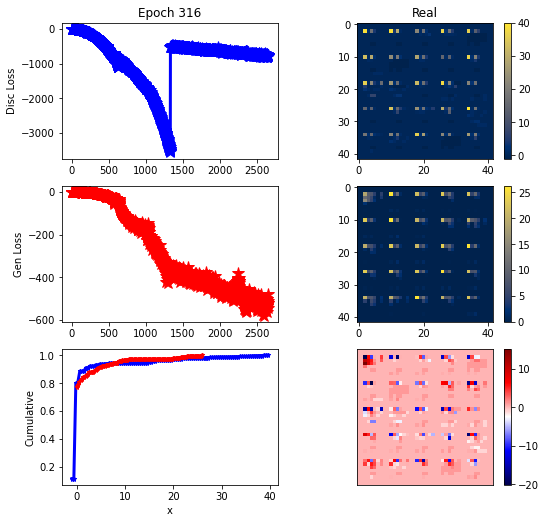

ErrG: -522.8973868233817, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


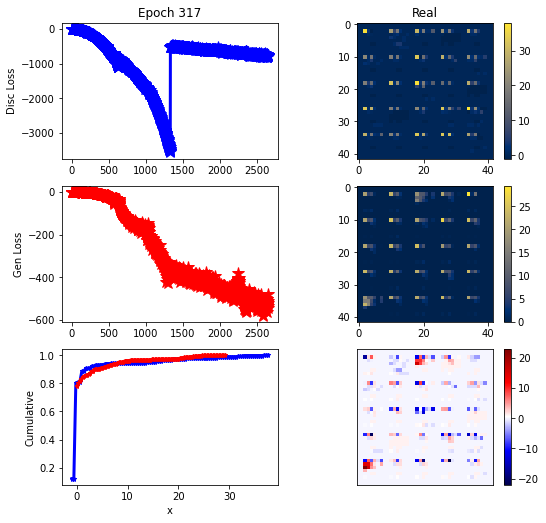

ErrG: -534.7672685895648, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


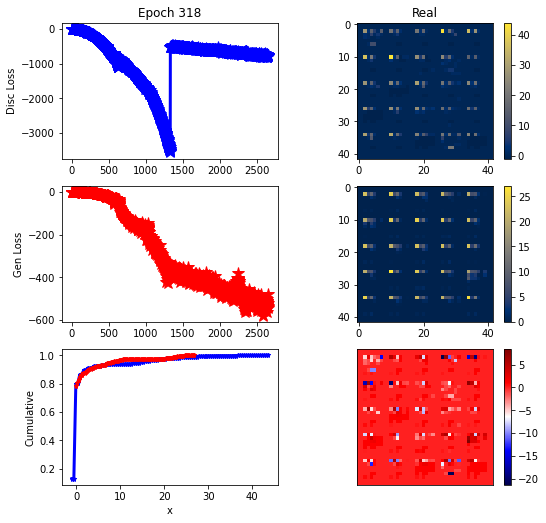

ErrG: -539.211430140904, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


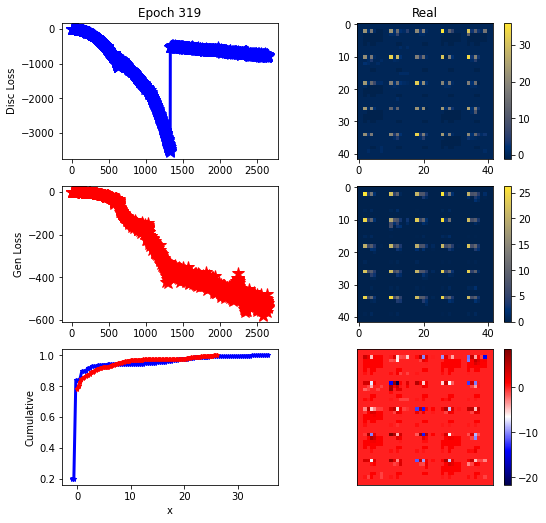

ErrG: -539.8129054478237, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


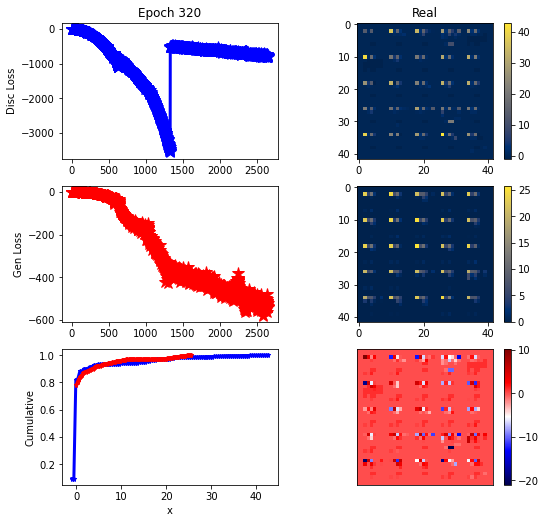

ErrG: -538.5780378069196, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


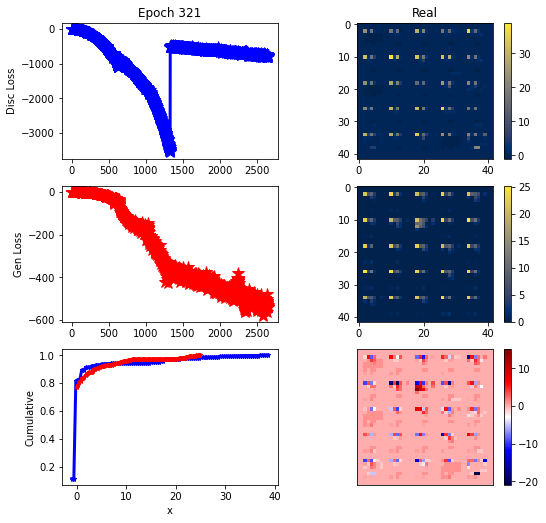

ErrG: -532.1594587053571, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


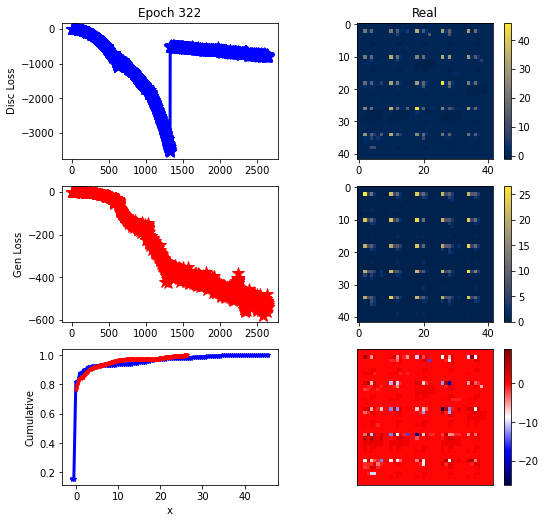

ErrG: -520.5618634905134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


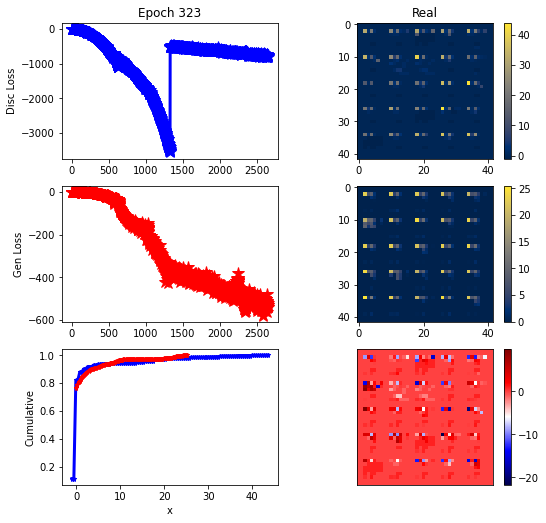

ErrG: -530.1555611746652, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


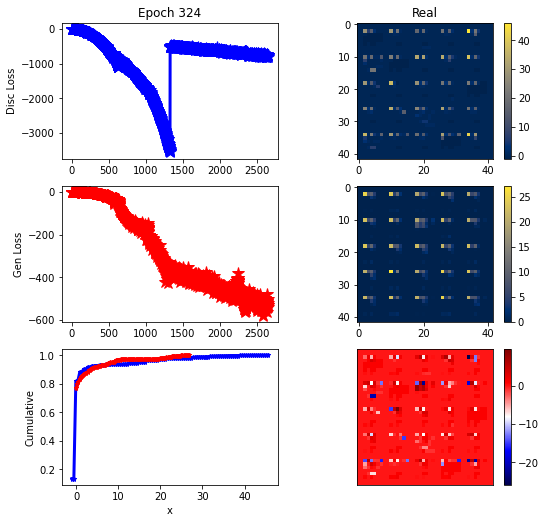

ErrG: -501.98319353376115, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


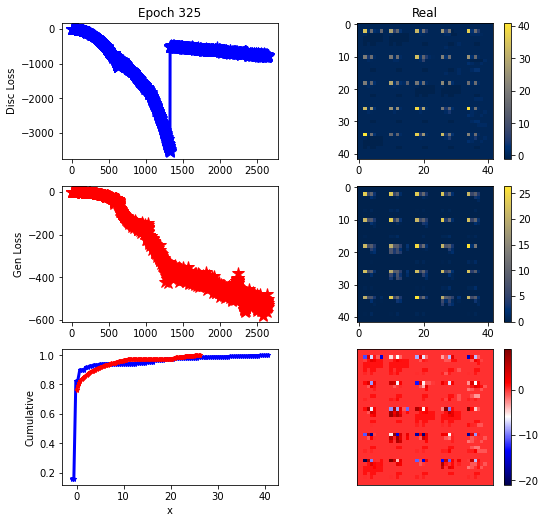

ErrG: -540.0447605678013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


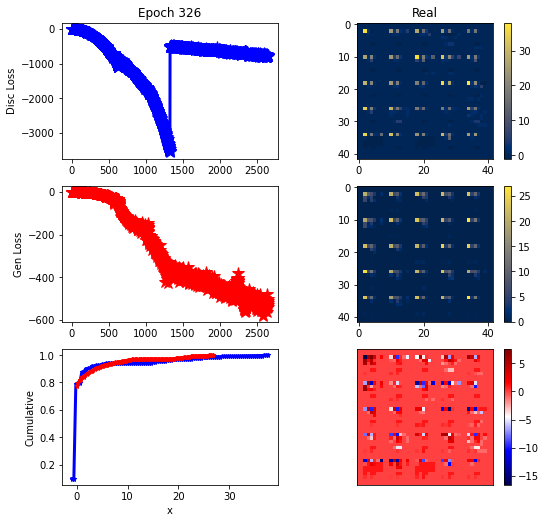

ErrG: -513.8409380231585, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


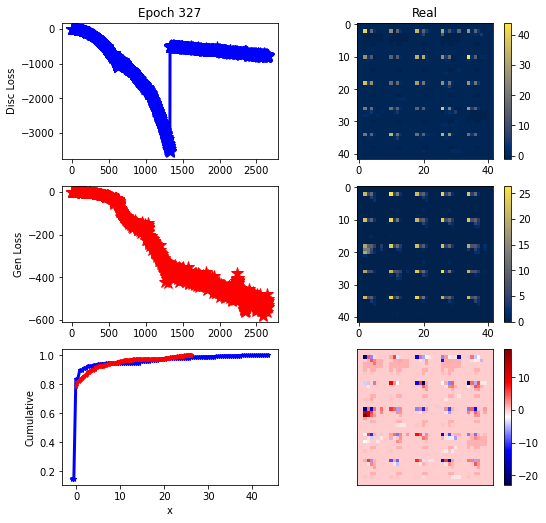

ErrG: -540.7014639718192, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


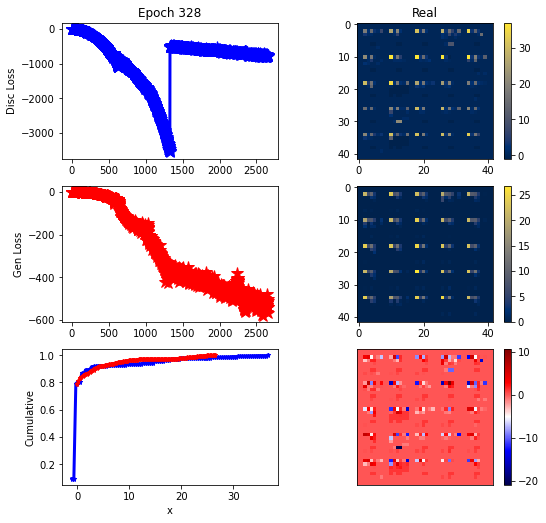

ErrG: -570.4967476981027, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


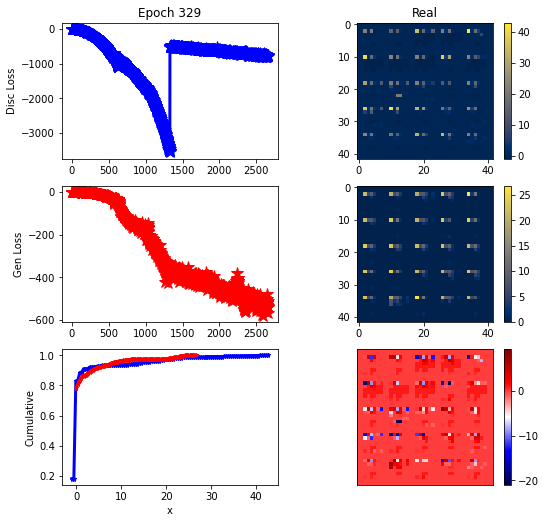

ErrG: -537.7876804896763, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


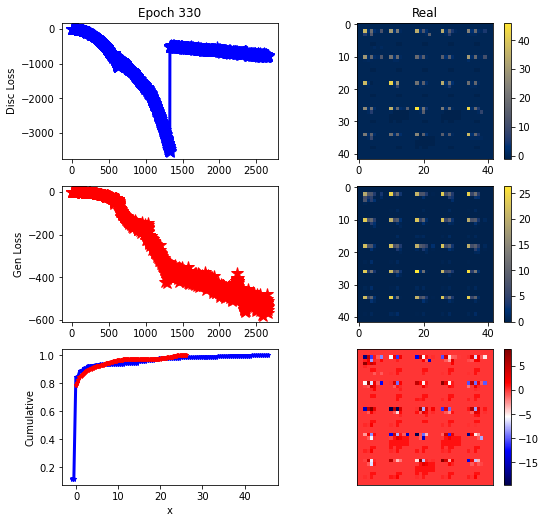

ErrG: -554.0336826869419, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


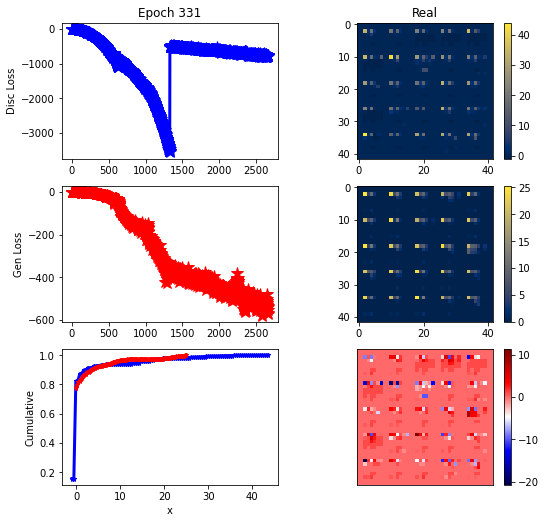

ErrG: -574.7821960449219, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


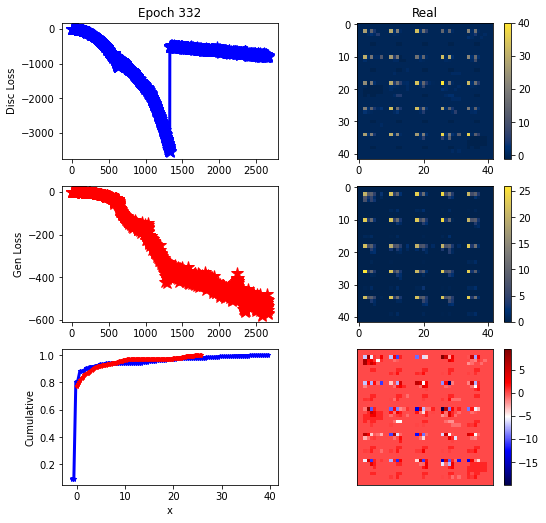

ErrG: -507.6467808314732, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


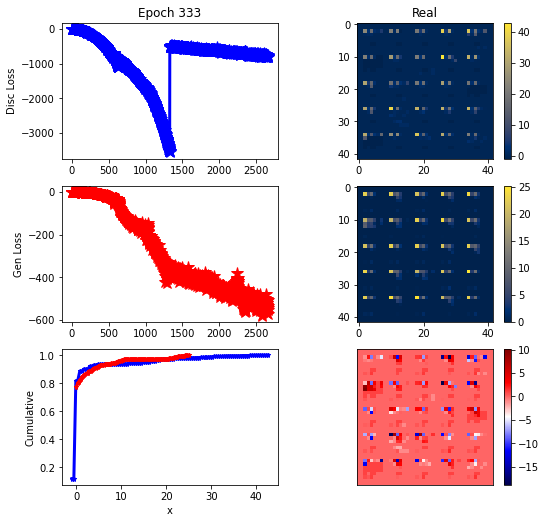

ErrG: -543.7561732700893, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


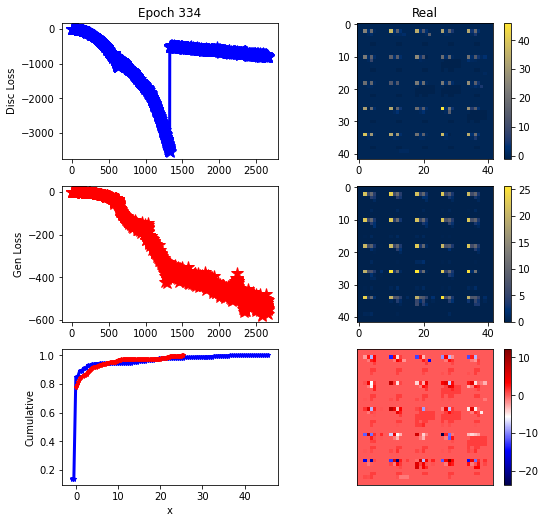

ErrG: -550.3693760463169, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


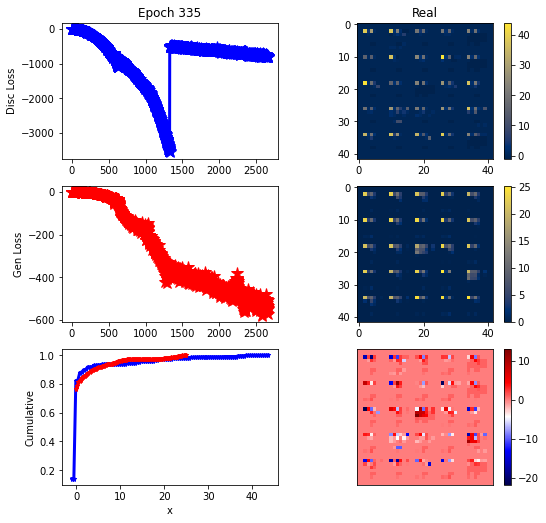

ErrG: -534.7144252232143, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


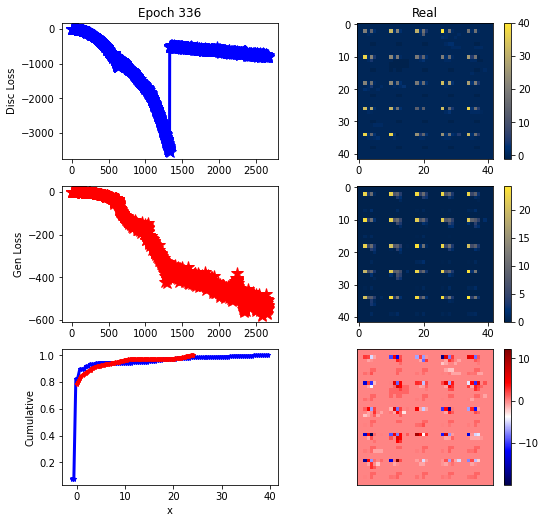

ErrG: -529.9053737095425, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


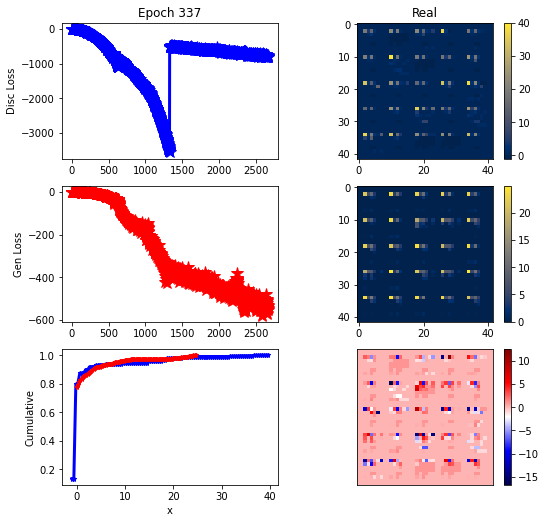

ErrG: -553.969970703125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


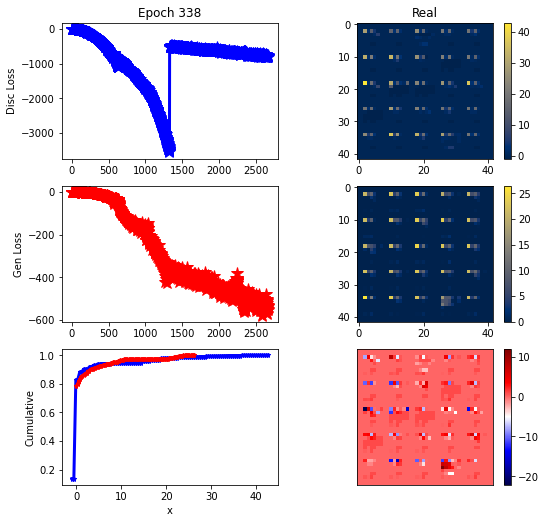

ErrG: -536.604976109096, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


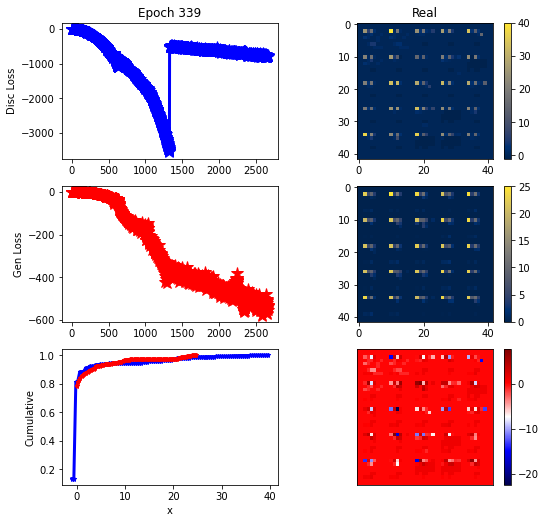

ErrG: -533.3581019810268, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


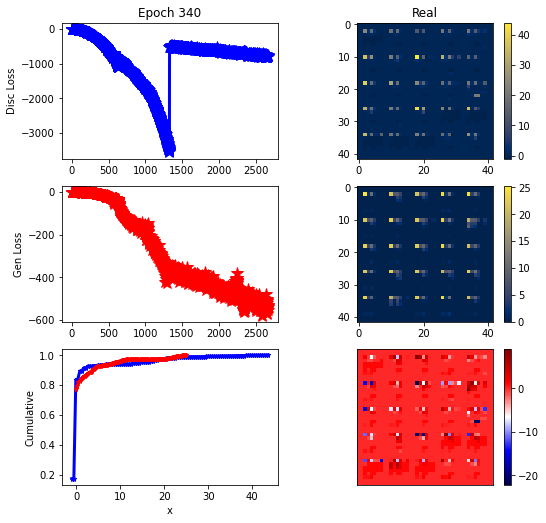

ErrG: -538.8062264578683, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


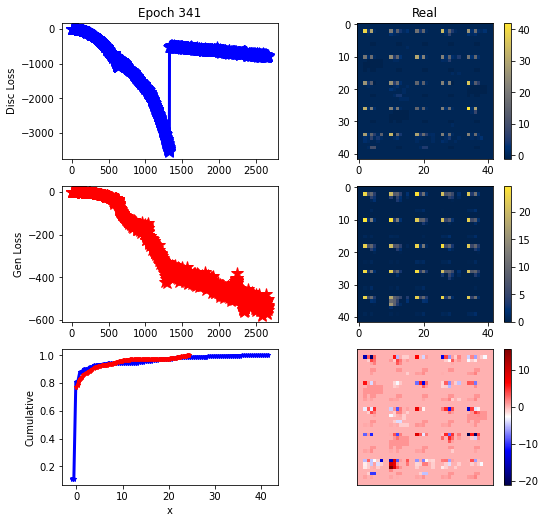

ErrG: -502.5835527692522, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


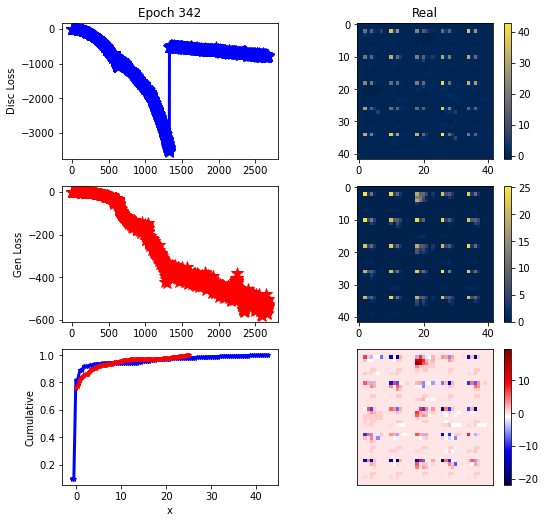

ErrG: -525.8730599539621, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


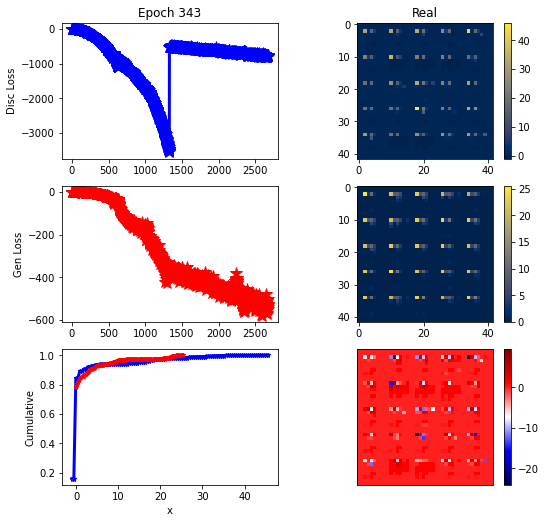

ErrG: -551.4361746651786, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


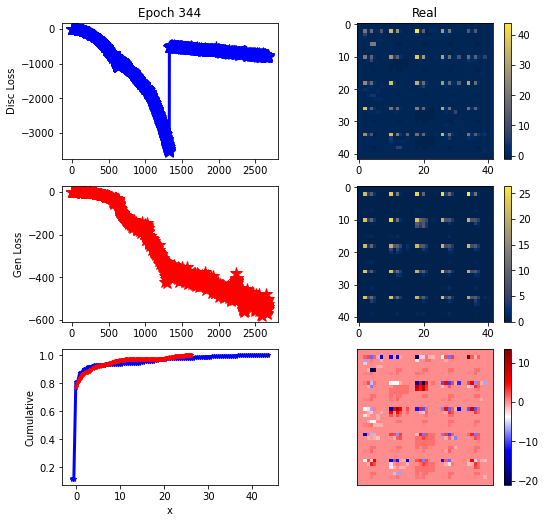

ErrG: -539.788103376116, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


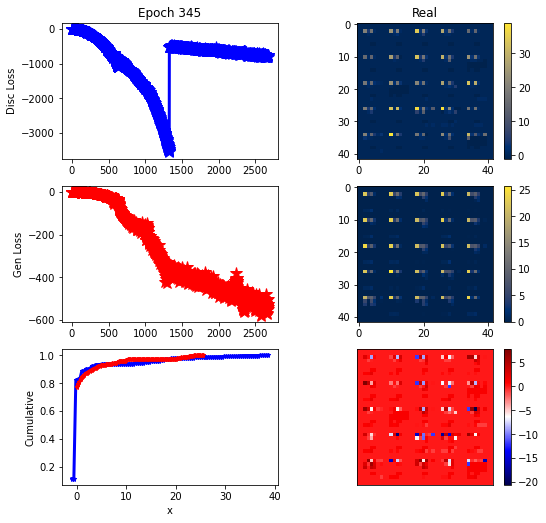

ErrG: -528.013676234654, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


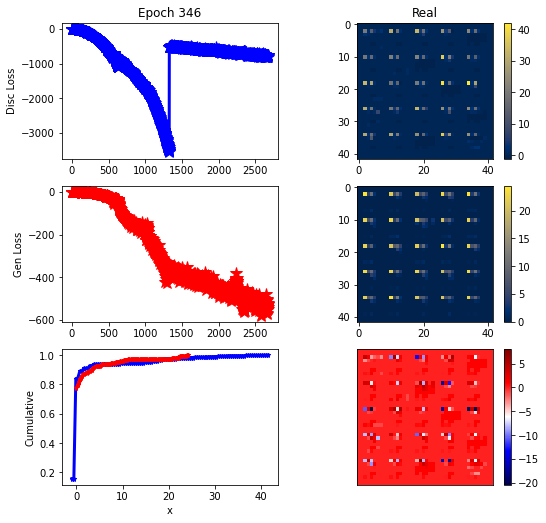

ErrG: -523.7615530831473, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


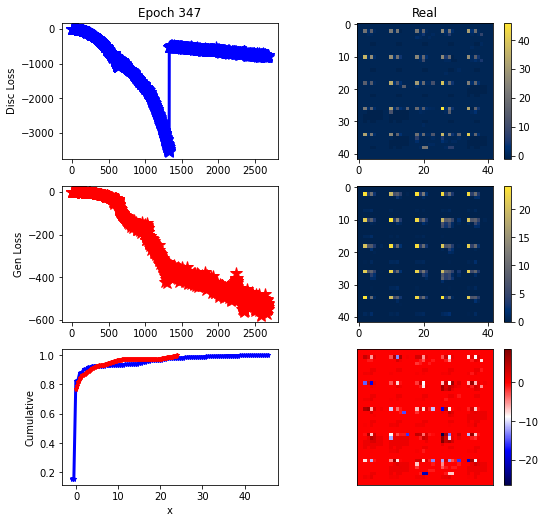

ErrG: -548.29736328125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


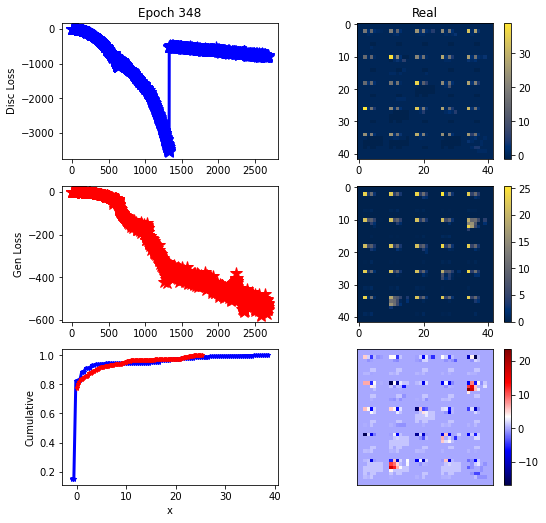

ErrG: -554.39797101702, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


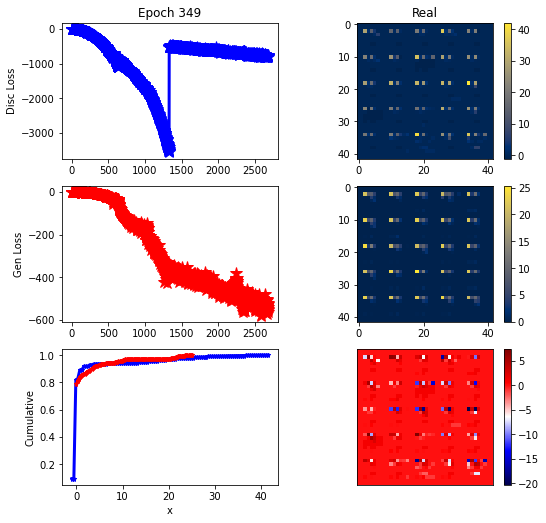

ErrG: -563.0088326590402, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


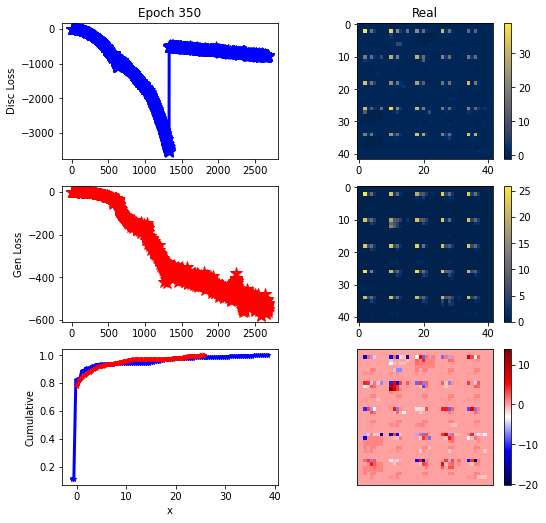

ErrG: -527.5095520019531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


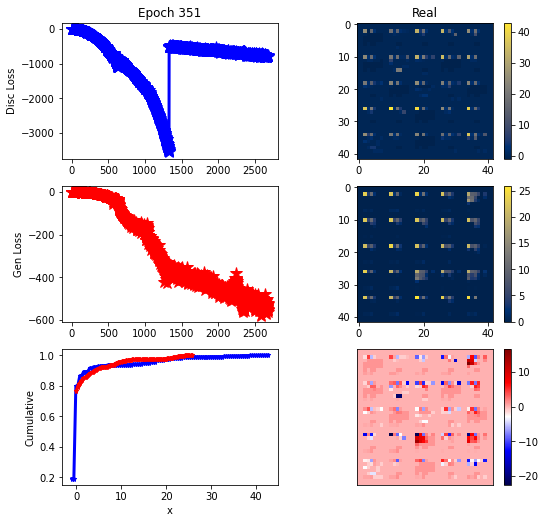

ErrG: -554.6130763462612, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


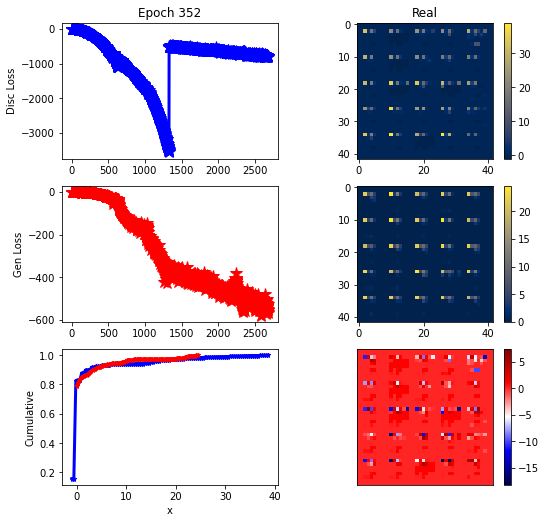

ErrG: -568.6272234235491, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


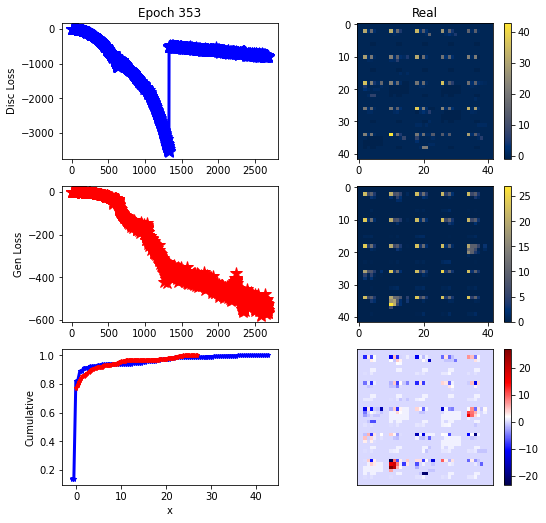

ErrG: -567.4118347167969, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


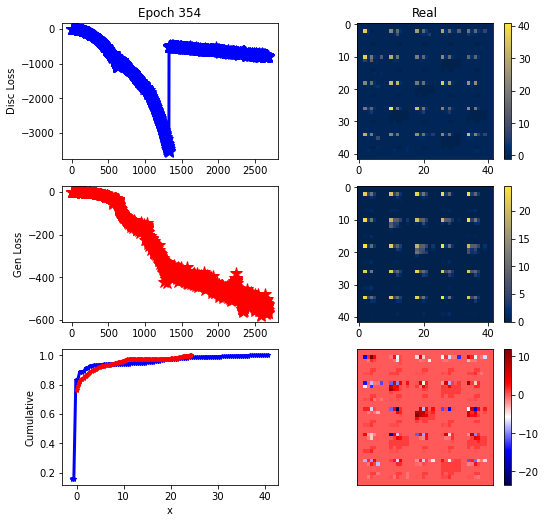

ErrG: -530.8991001674107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


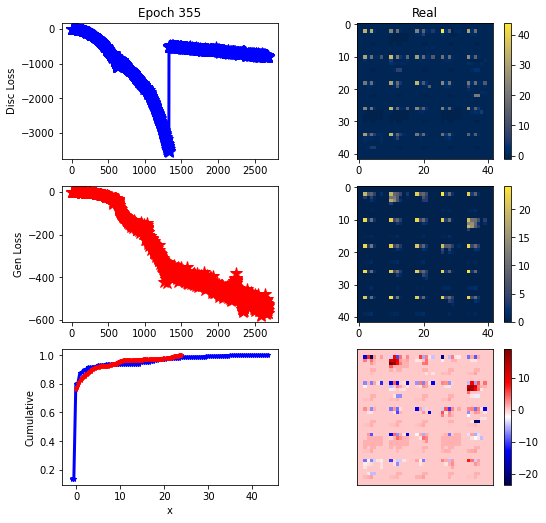

ErrG: -535.3123561314175, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


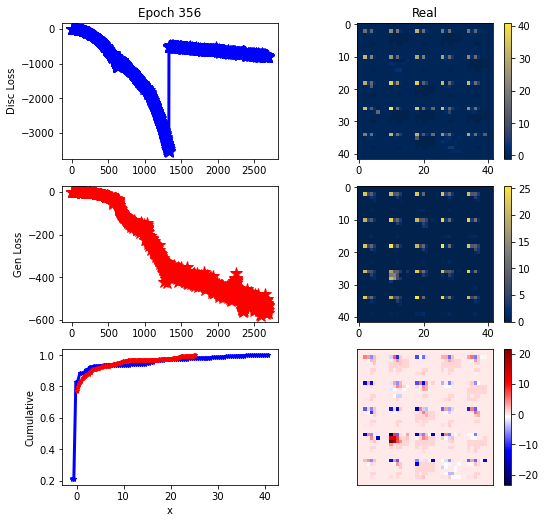

ErrG: -532.588361467634, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


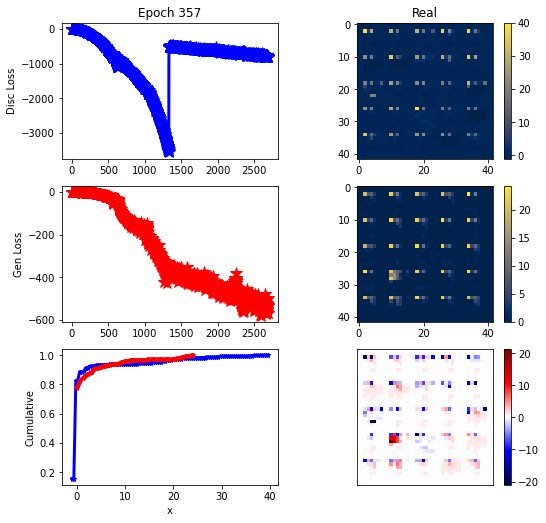

ErrG: -498.521248953683, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


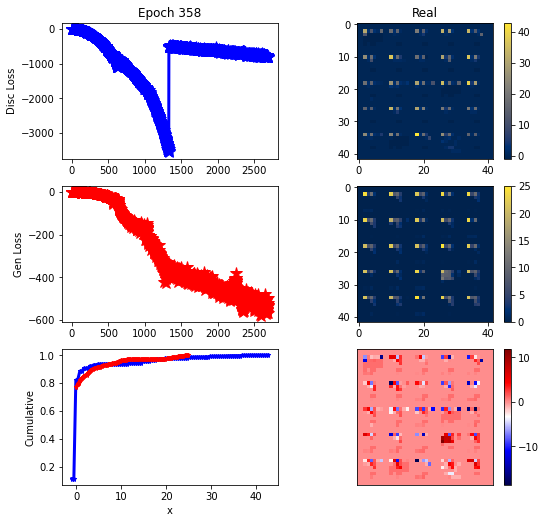

ErrG: -520.8616681780134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


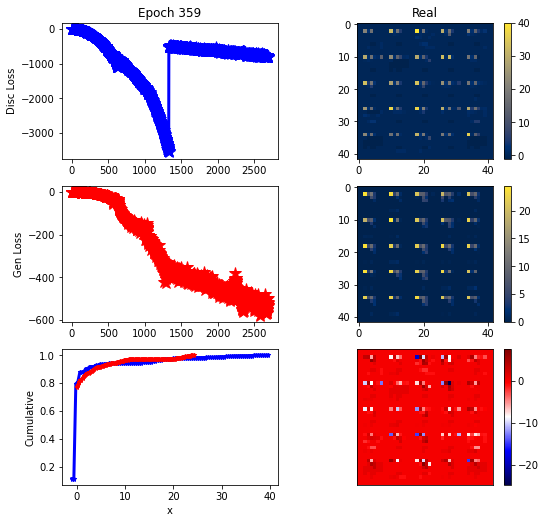

ErrG: -518.5330592564175, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


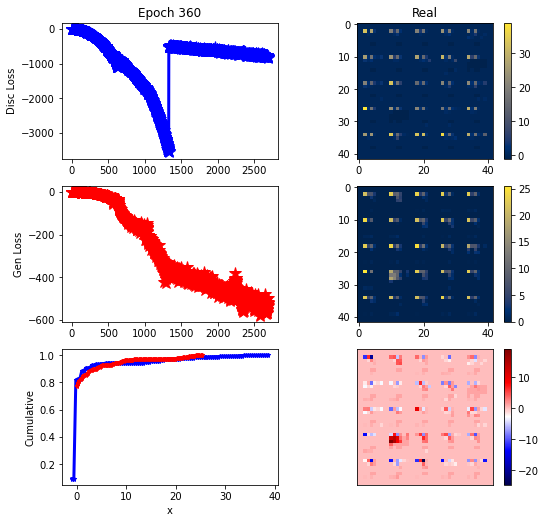

ErrG: -521.5201285226004, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


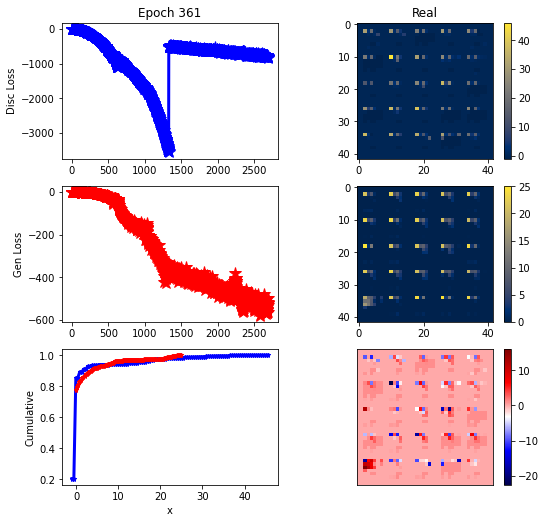

ErrG: -561.9433201381138, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


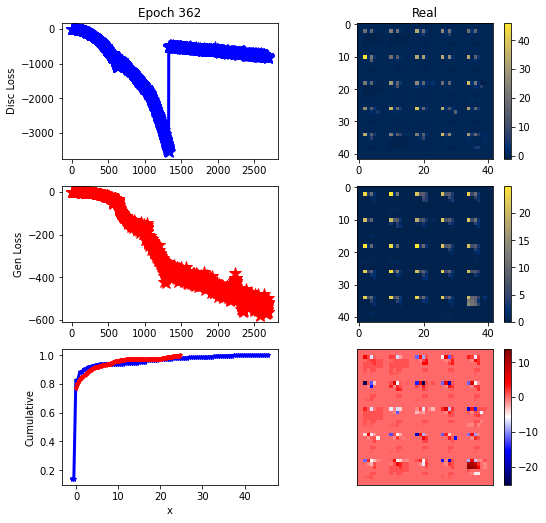

ErrG: -564.1219744001116, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


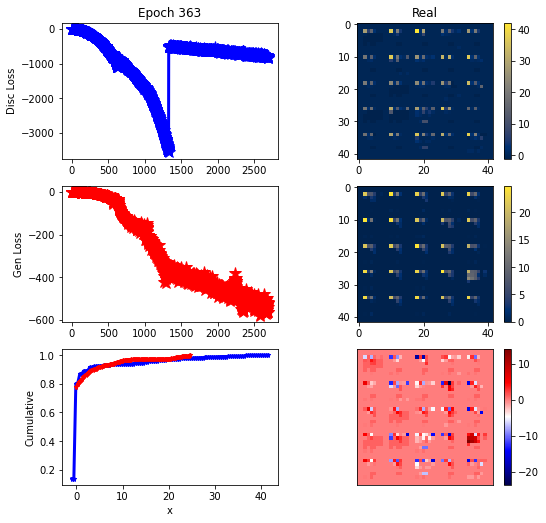

ErrG: -540.0552455357143, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


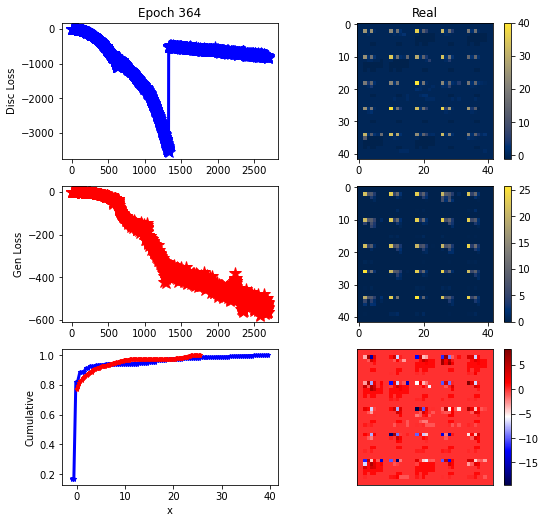

ErrG: -547.0960083007812, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


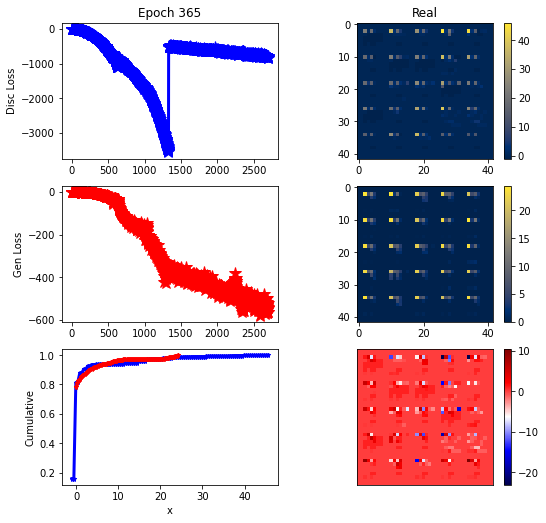

ErrG: -544.9503173828125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


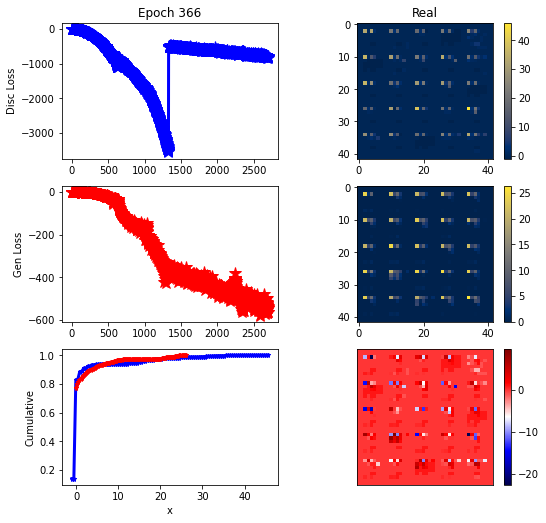

ErrG: -537.9911368233817, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


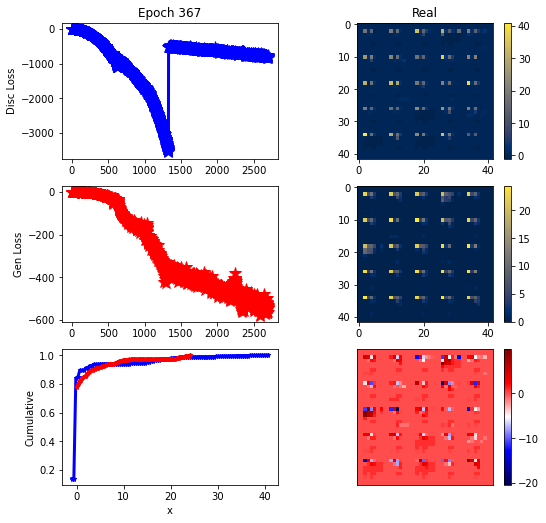

ErrG: -529.4060320172991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


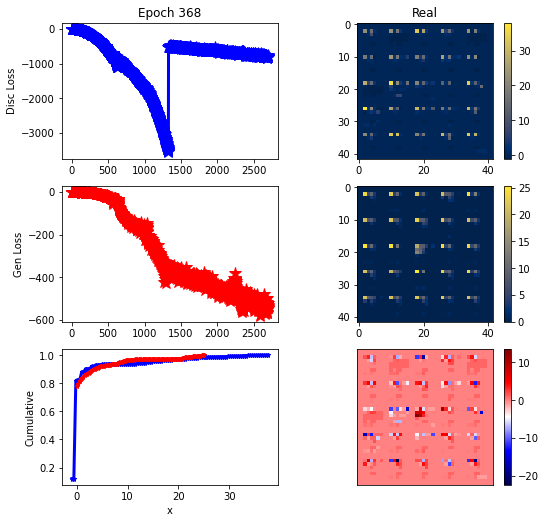

ErrG: -523.7975027901786, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


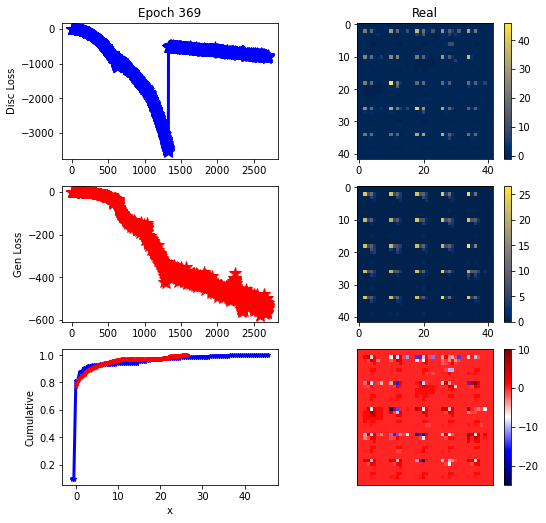

ErrG: -537.5312892368862, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


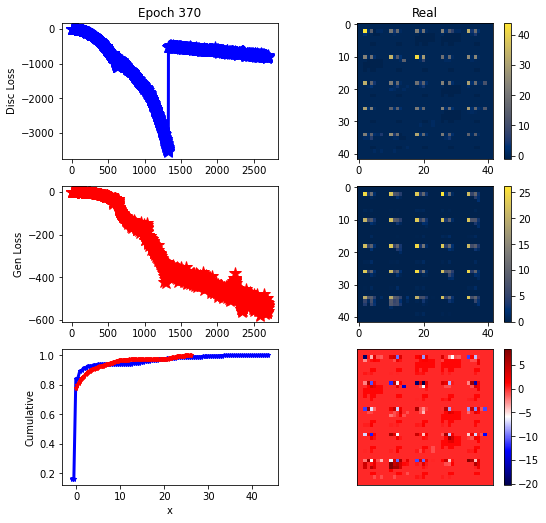

ErrG: -559.7367379324777, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


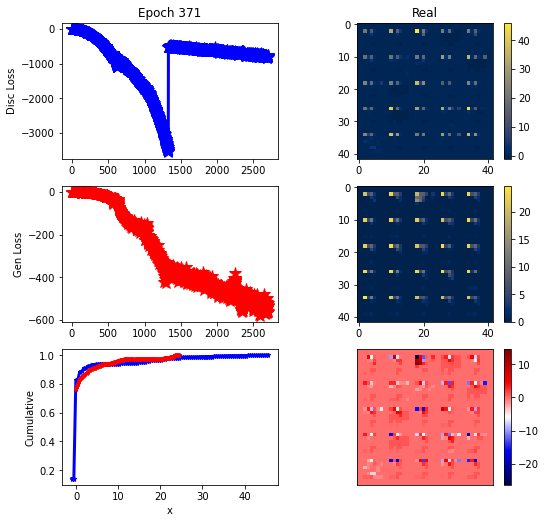

ErrG: -562.4369376046317, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


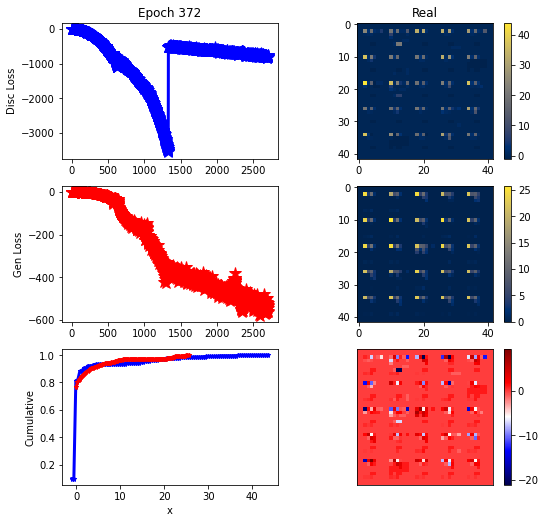

ErrG: -546.9541451590402, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


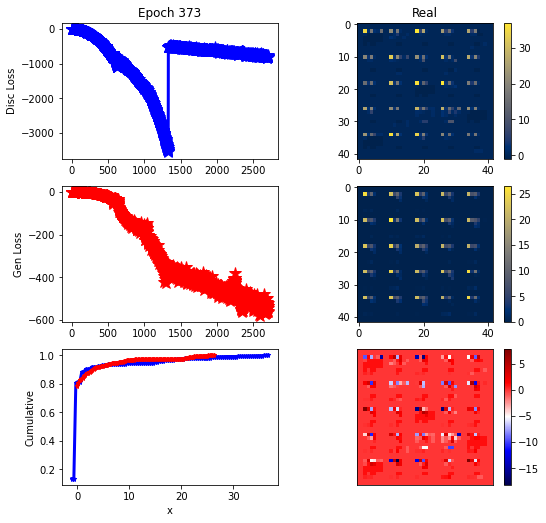

ErrG: -535.8200596400669, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


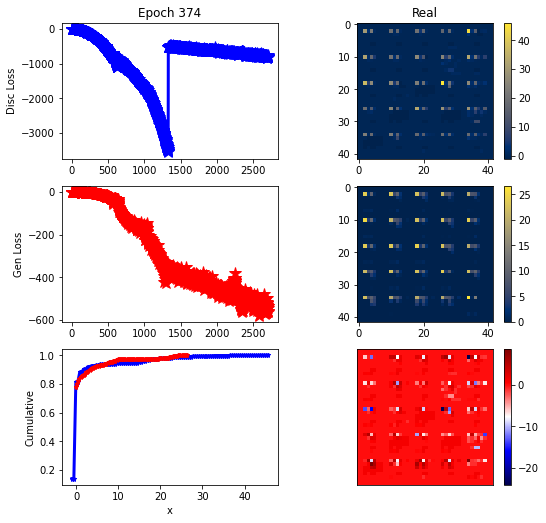

ErrG: -558.1904776436942, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


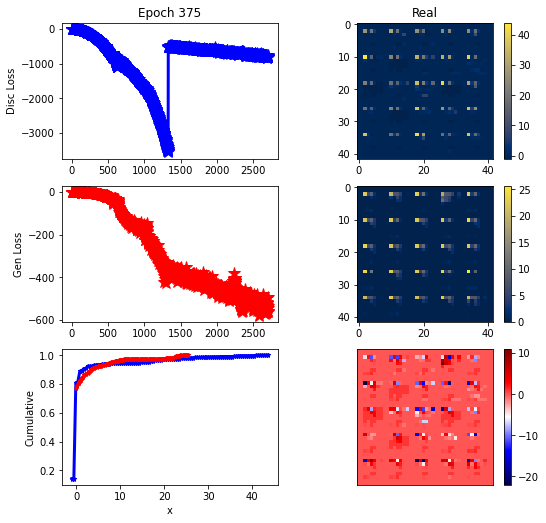

ErrG: -495.0449698311942, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


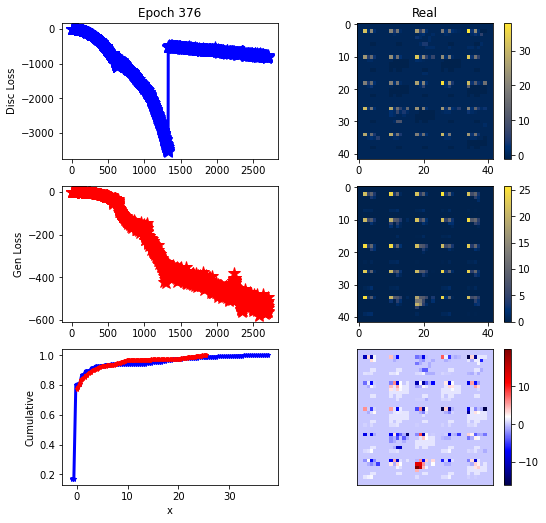

ErrG: -510.5933750697545, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


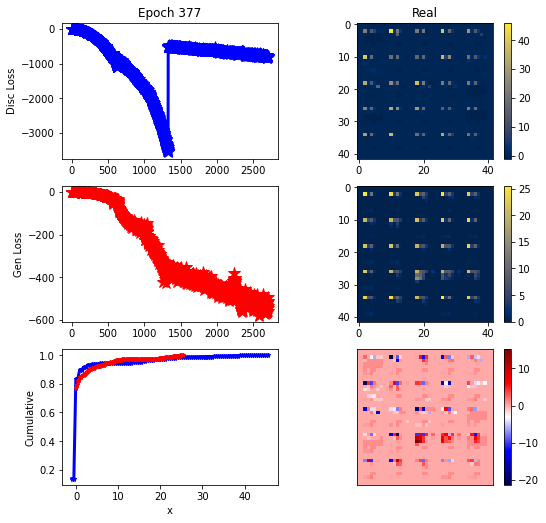

ErrG: -511.37738037109375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


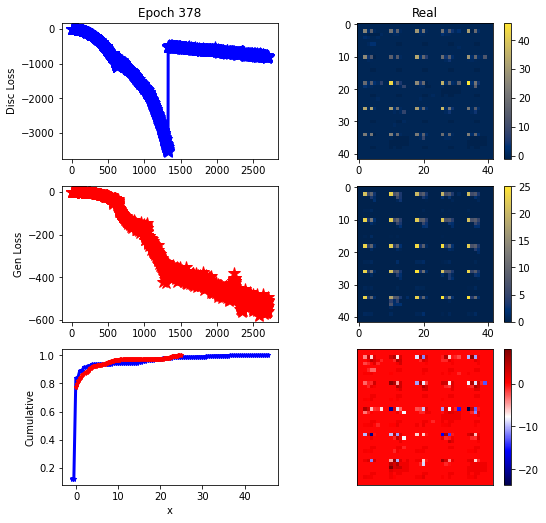

ErrG: -505.9310738699777, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


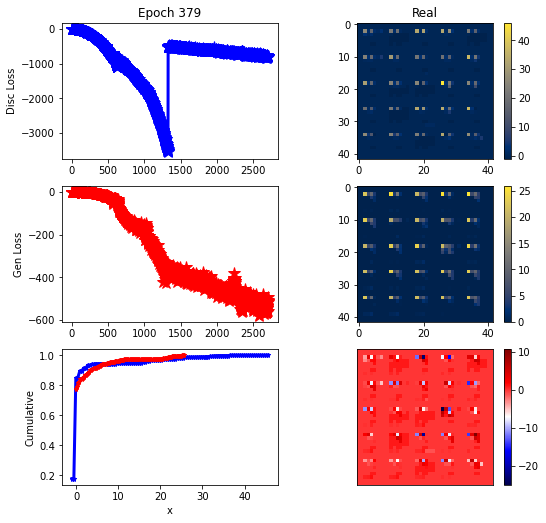

ErrG: -516.3104248046875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


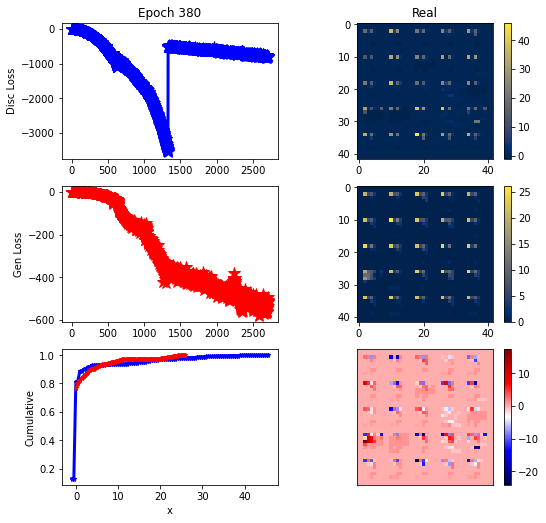

ErrG: -534.9669930594308, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


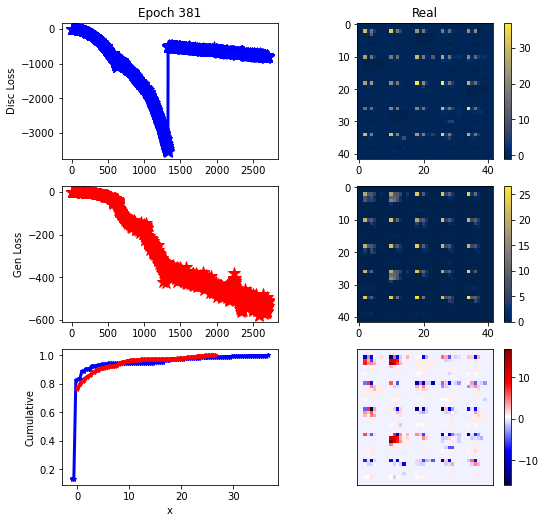

ErrG: -535.5454581124442, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


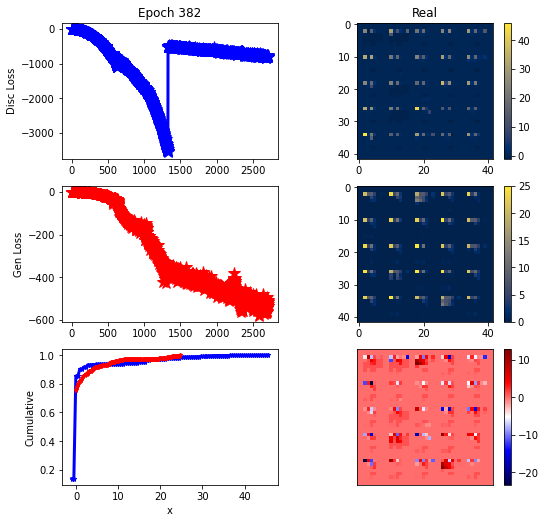

ErrG: -528.2706168038504, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


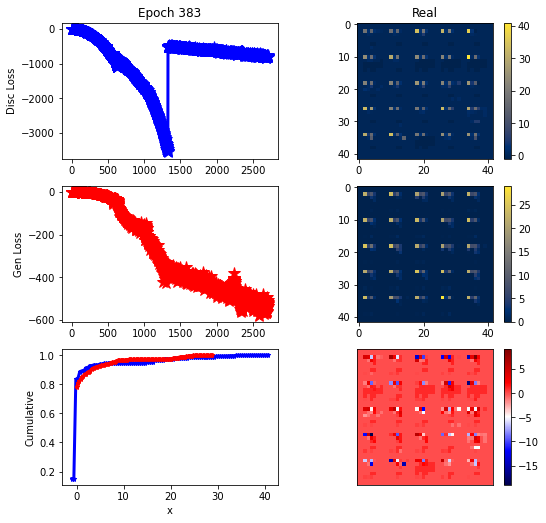

ErrG: -521.2850646972656, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


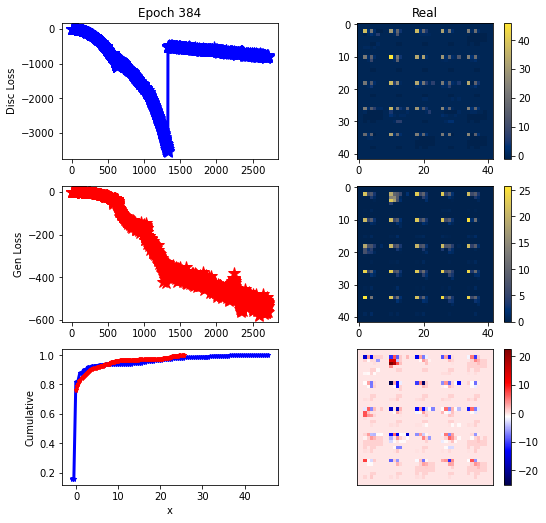

ErrG: -565.4269583565848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


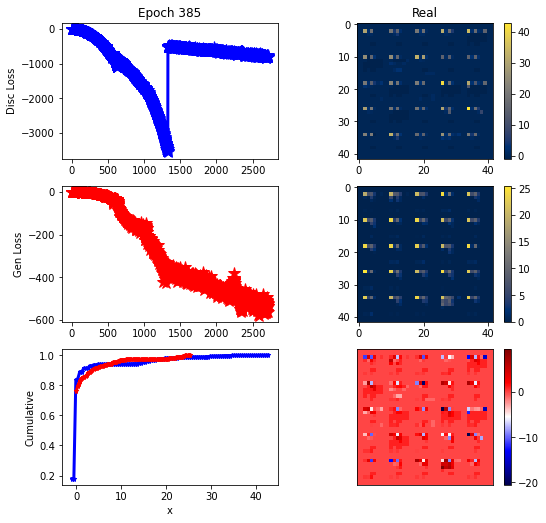

ErrG: -537.9626900809152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


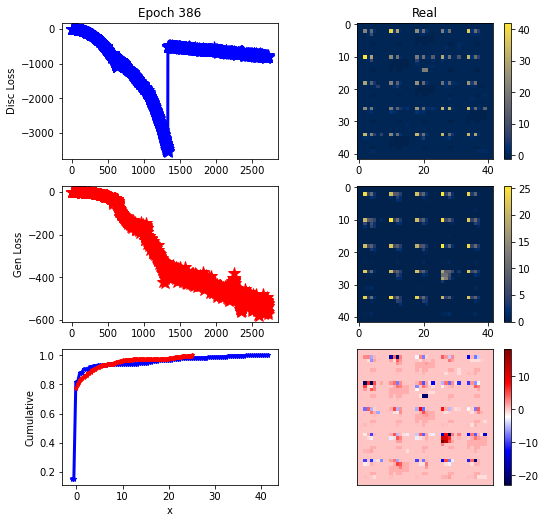

ErrG: -573.6140877859933, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


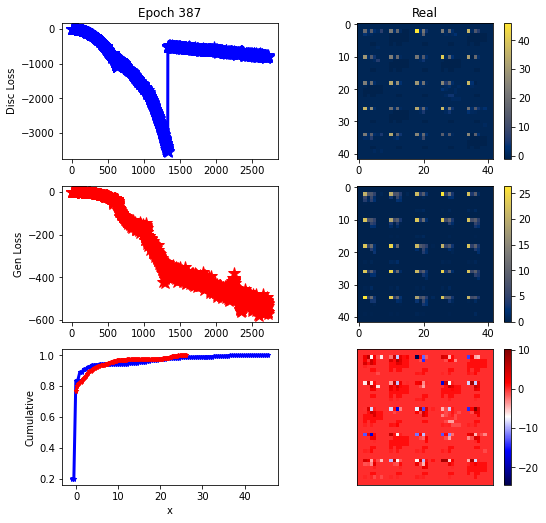

ErrG: -565.6883544921875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


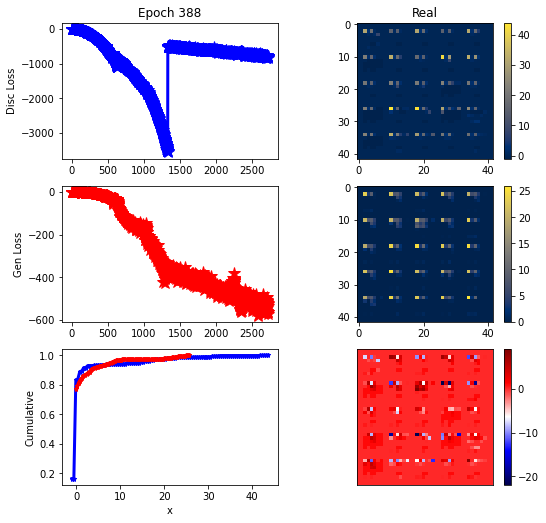

ErrG: -524.7561950683594, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


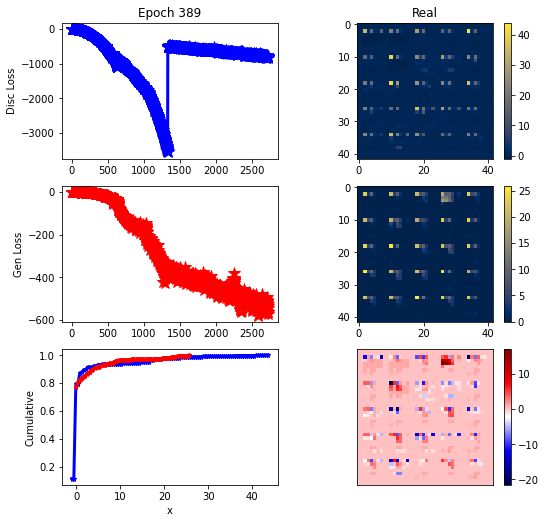

ErrG: -543.7931692940848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


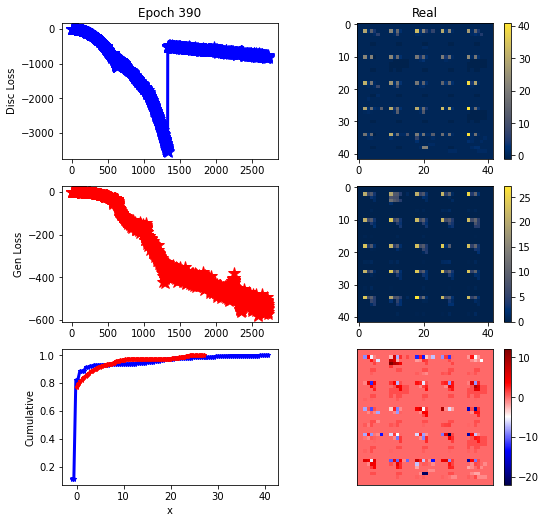

ErrG: -549.2511640276227, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


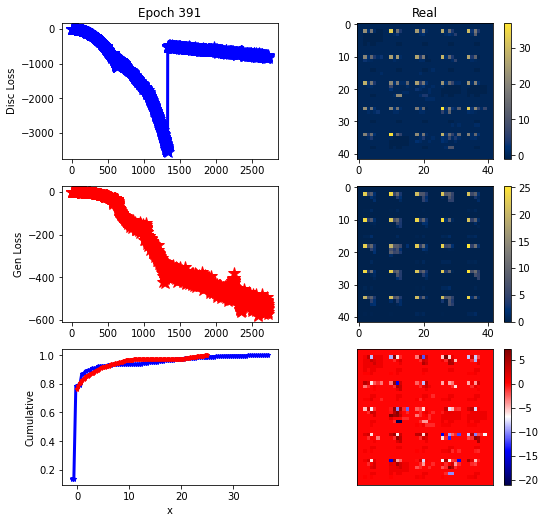

ErrG: -534.0505632672991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


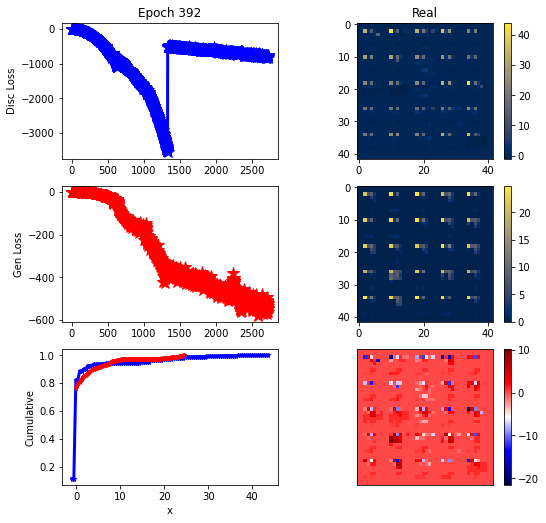

ErrG: -519.6581464494977, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


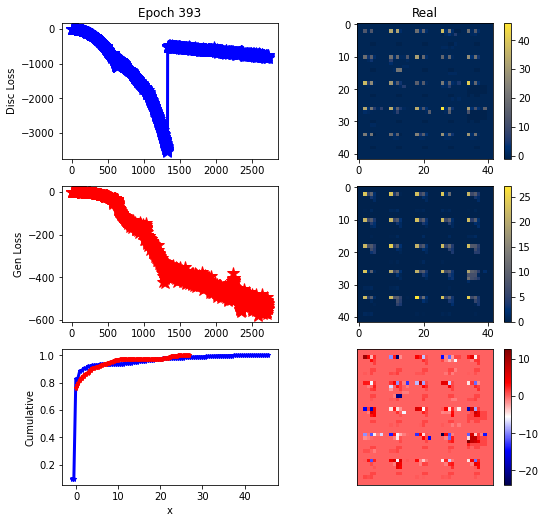

ErrG: -549.1906127929688, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


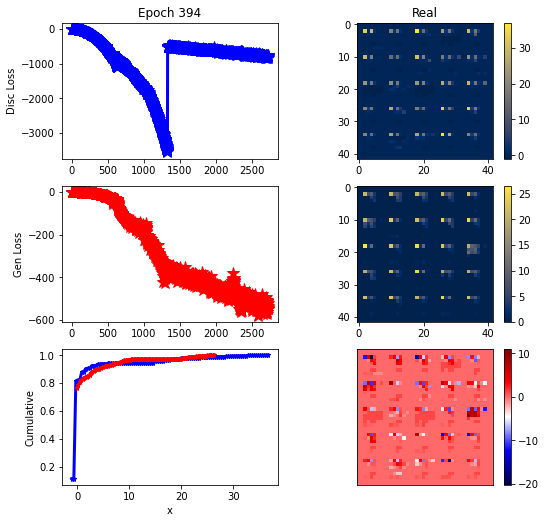

ErrG: -539.6289803641183, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


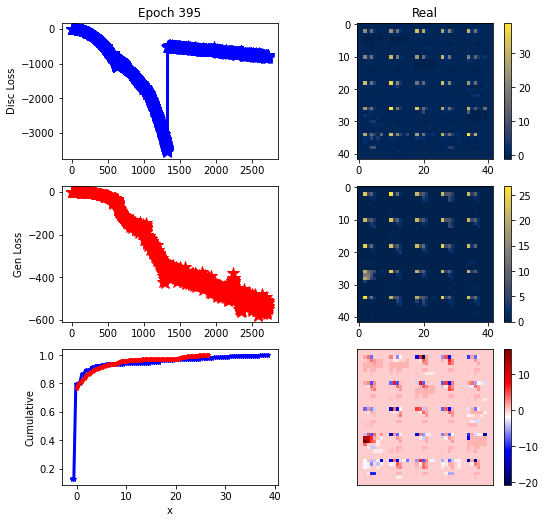

ErrG: -513.6746913364956, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


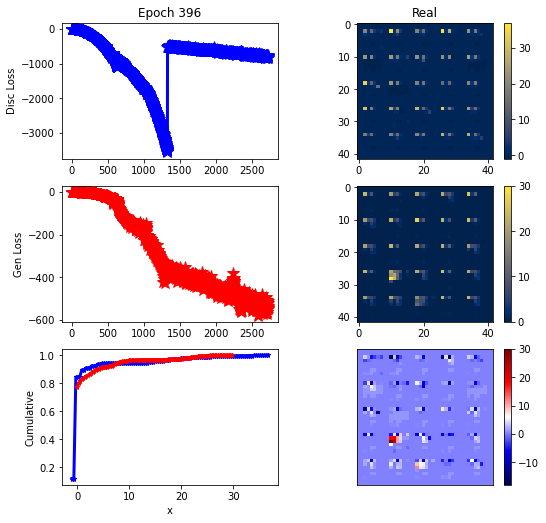

ErrG: -543.2652326311384, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


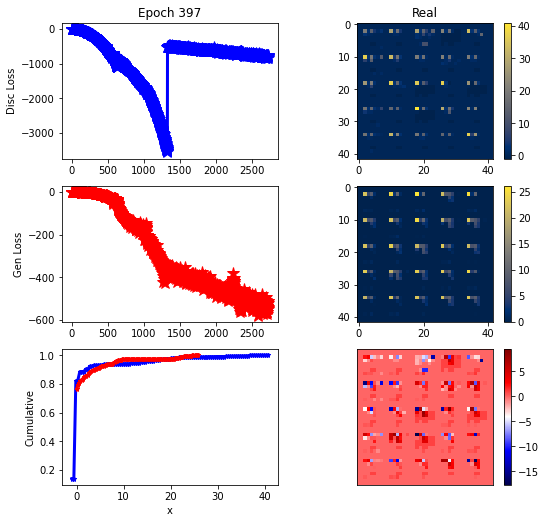

ErrG: -512.3405674525669, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


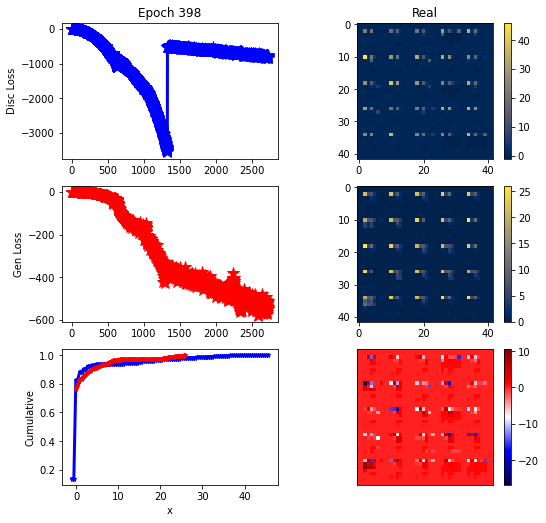

ErrG: -512.9537091936384, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


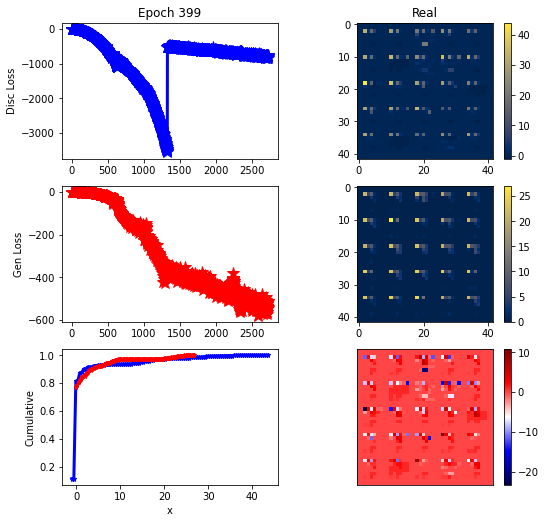

ErrG: -514.0599626813616, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


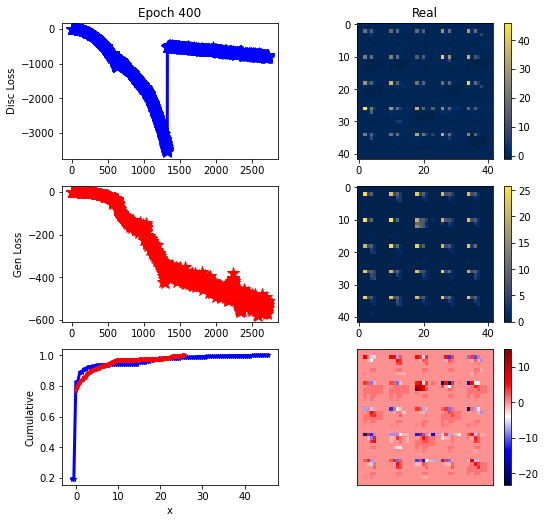

ErrG: -531.0733555385044, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


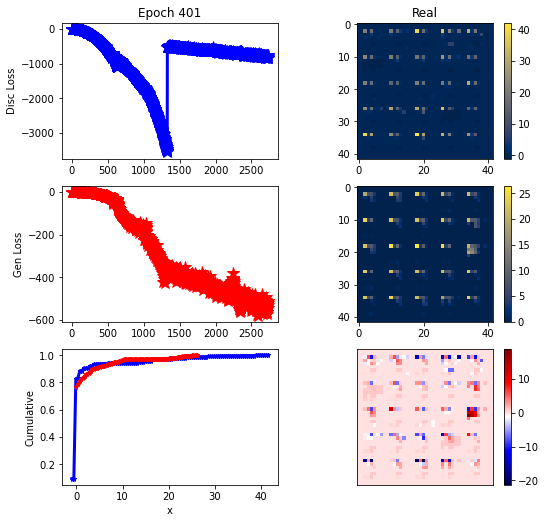

ErrG: -520.8065054757254, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


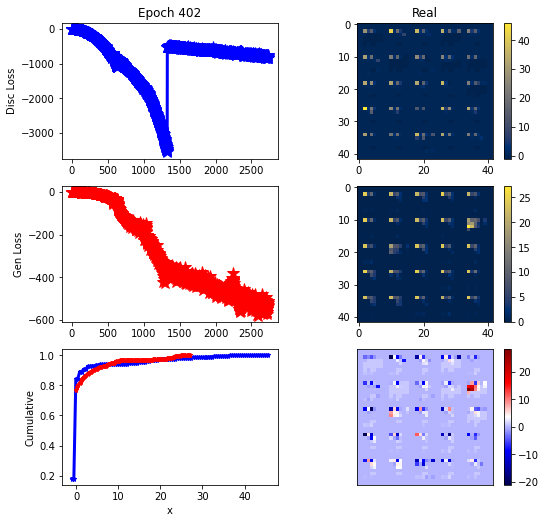

ErrG: -534.7079206194196, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


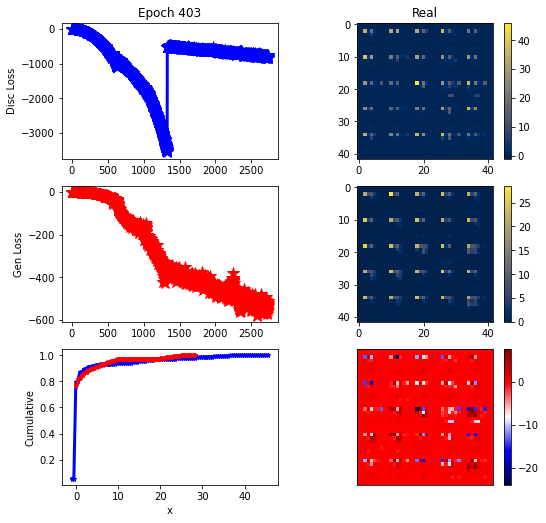

ErrG: -555.0398864746094, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


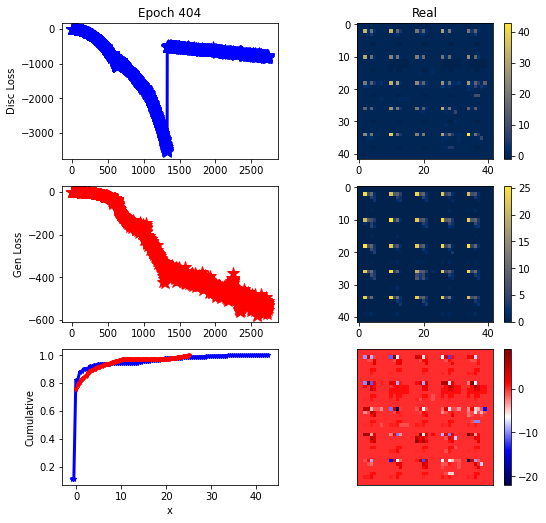

ErrG: -530.6172180175781, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


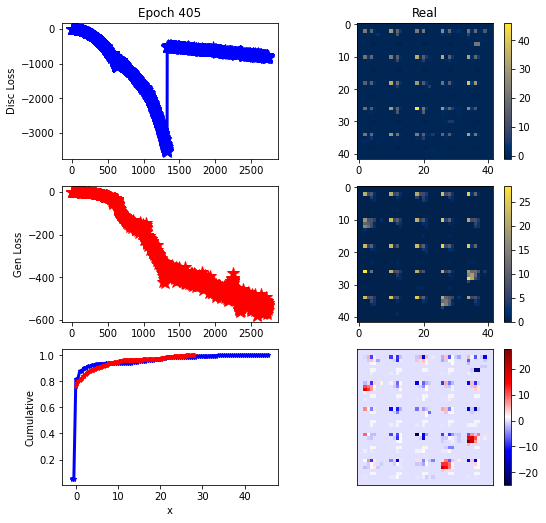

ErrG: -524.0386614118304, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


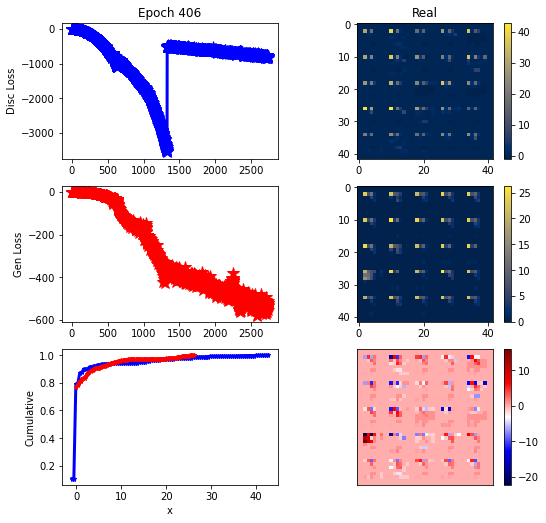

ErrG: -511.20605904715404, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


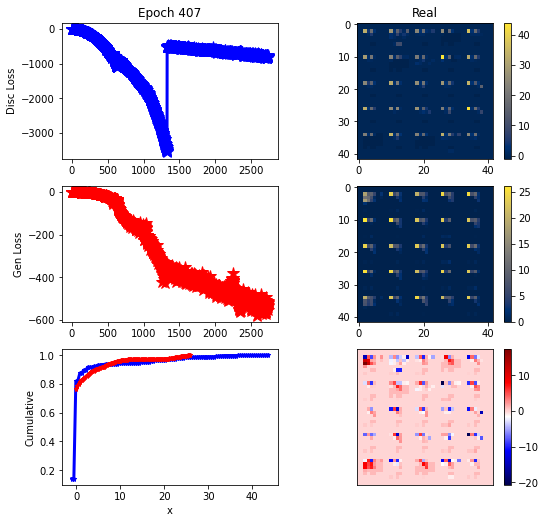

ErrG: -516.6611197335379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


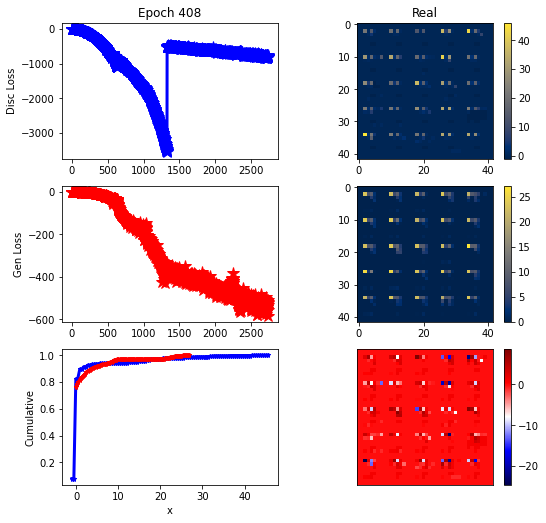

ErrG: -582.1482979910714, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


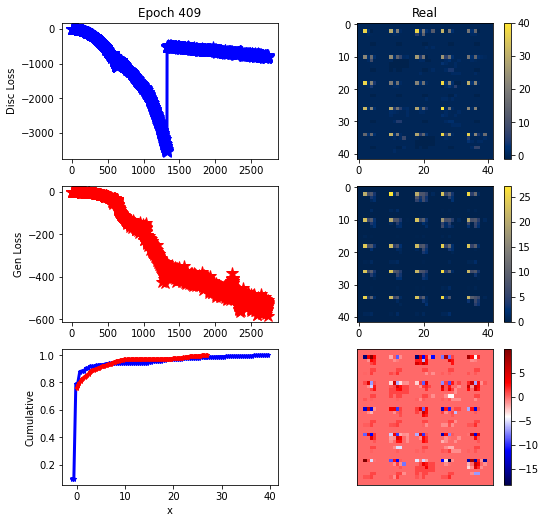

ErrG: -526.7135184151786, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


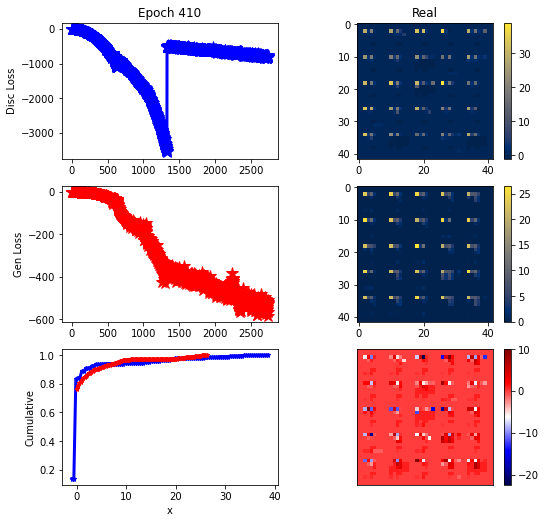

ErrG: -564.3053719656808, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


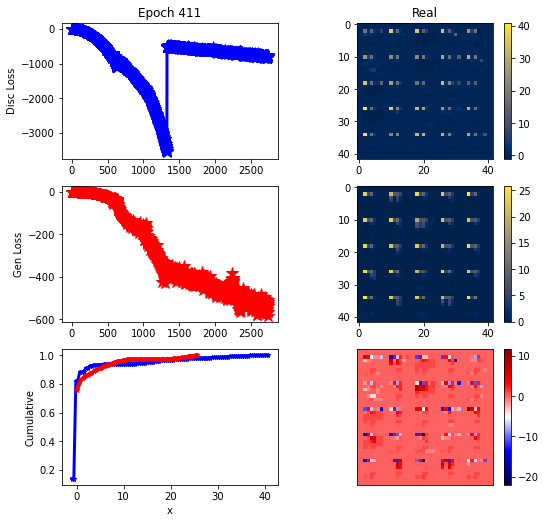

ErrG: -535.6123657226562, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


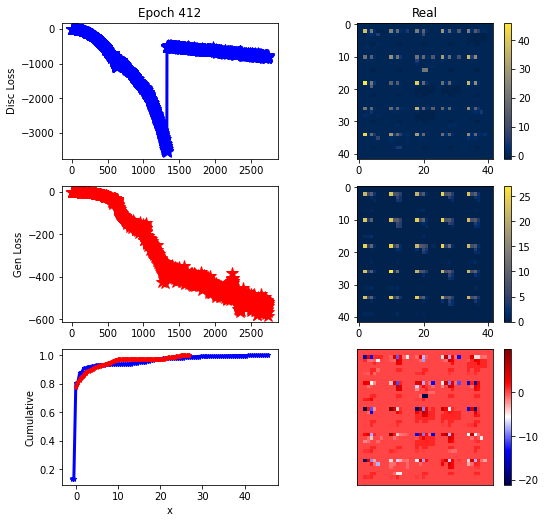

ErrG: -518.8995710100446, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


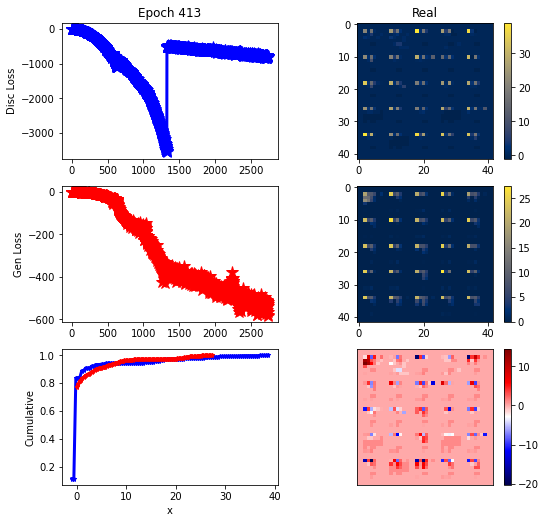

ErrG: -582.619367327009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


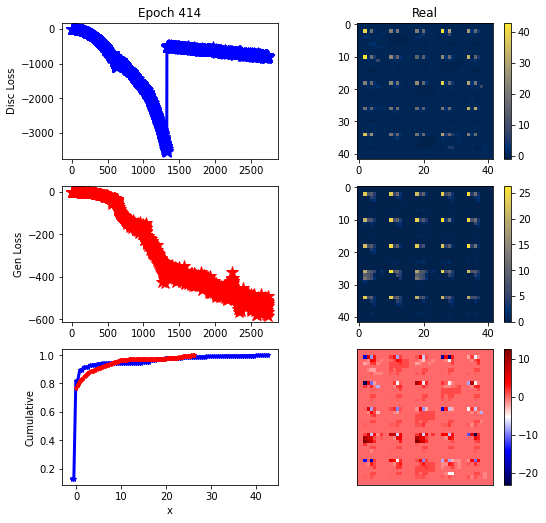

ErrG: -492.32936314174106, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


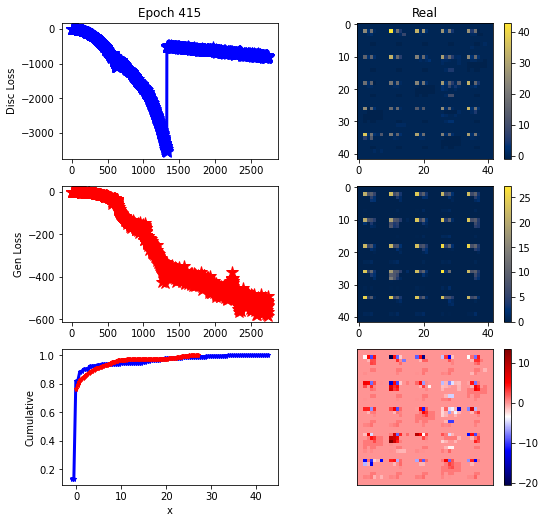

ErrG: -531.7286594935825, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


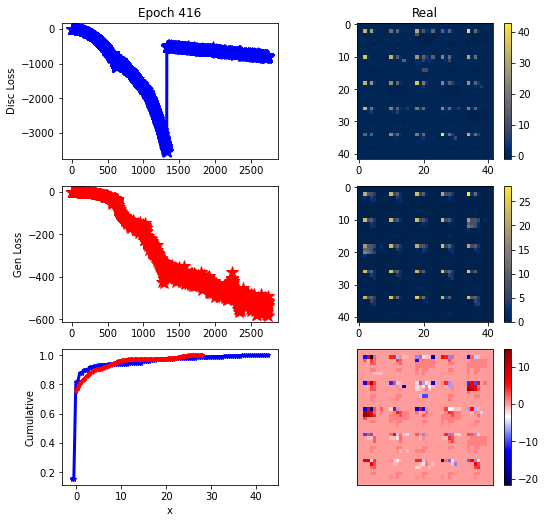

ErrG: -515.7198486328125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


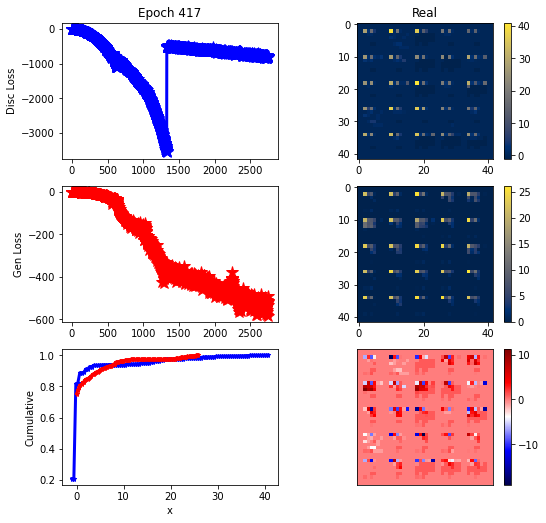

ErrG: -513.577144077846, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


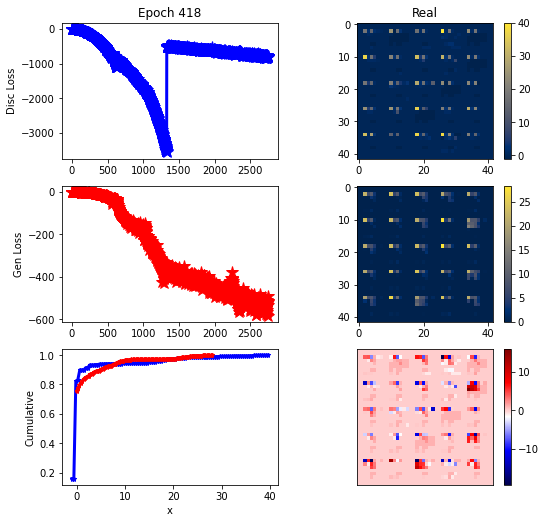

ErrG: -519.1569083077567, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


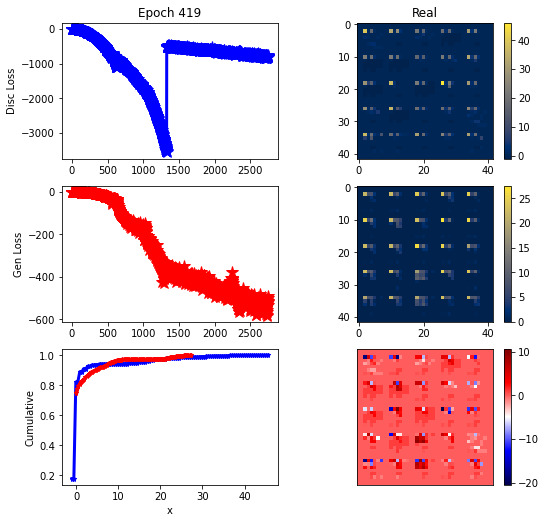

ErrG: -501.3039986746652, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


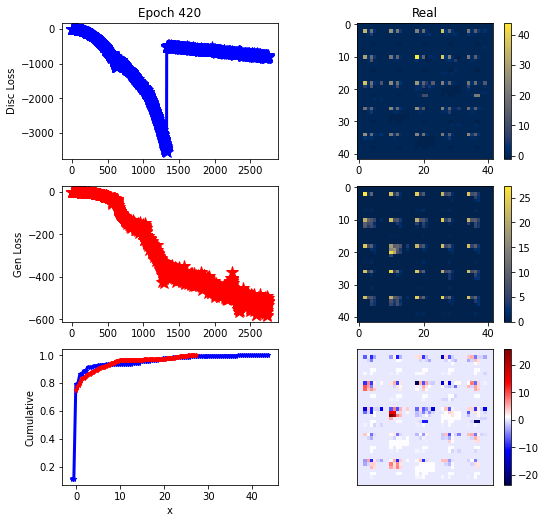

ErrG: -520.8037806919643, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


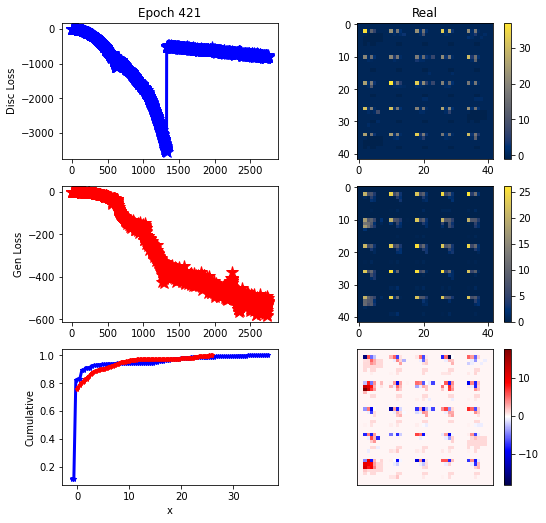

ErrG: -525.1240626743862, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


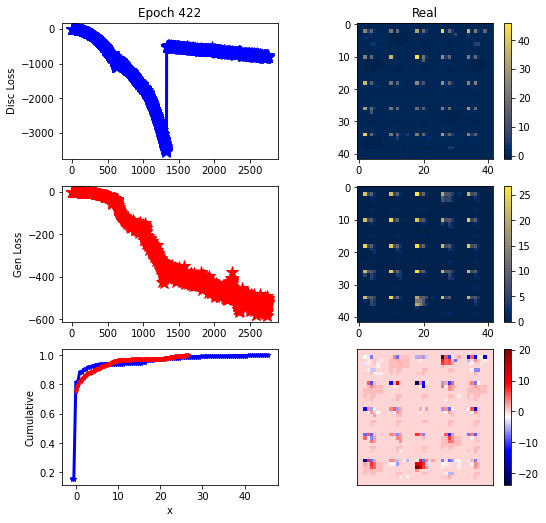

ErrG: -505.9836120605469, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


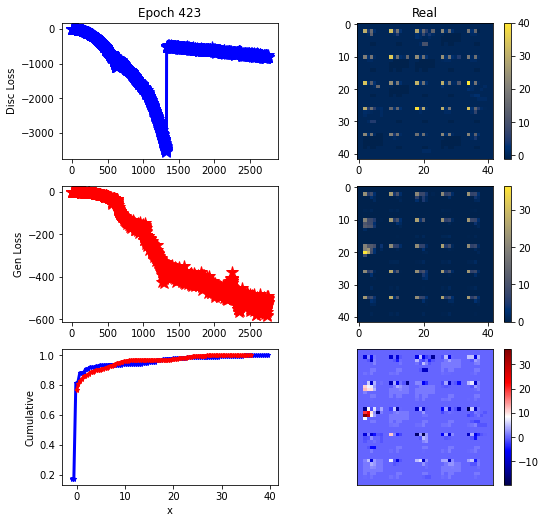

ErrG: -488.42156982421875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


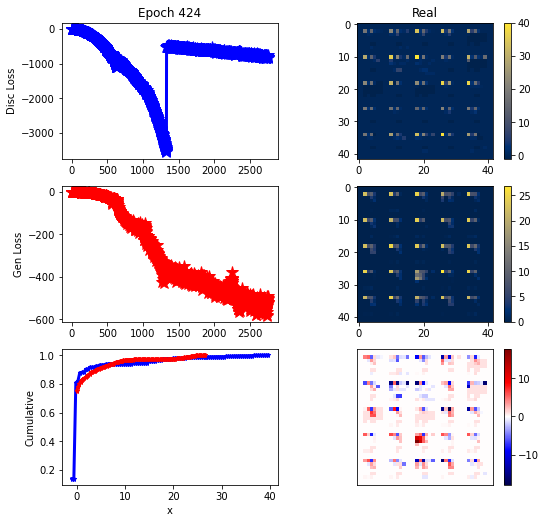

ErrG: -518.763911655971, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


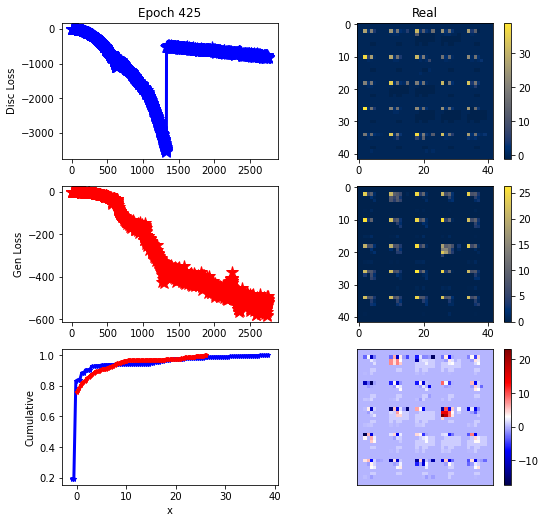

ErrG: -510.2907496861049, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


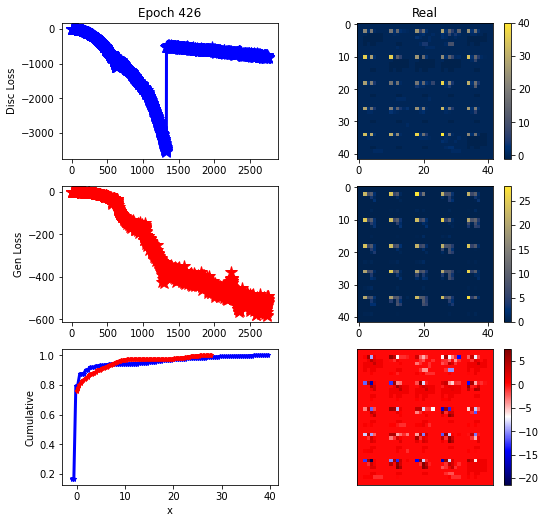

ErrG: -492.419198172433, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


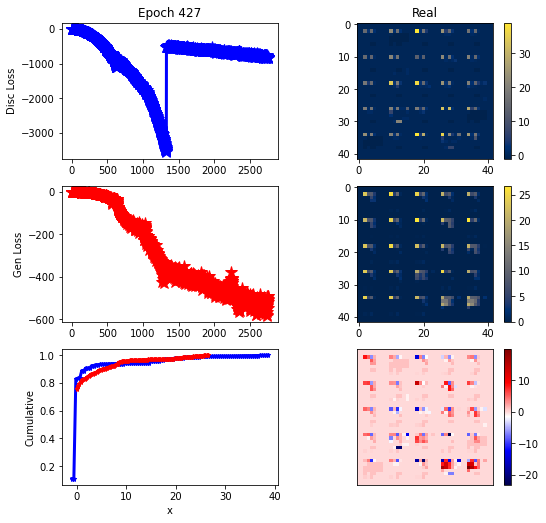

ErrG: -548.3822239467075, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


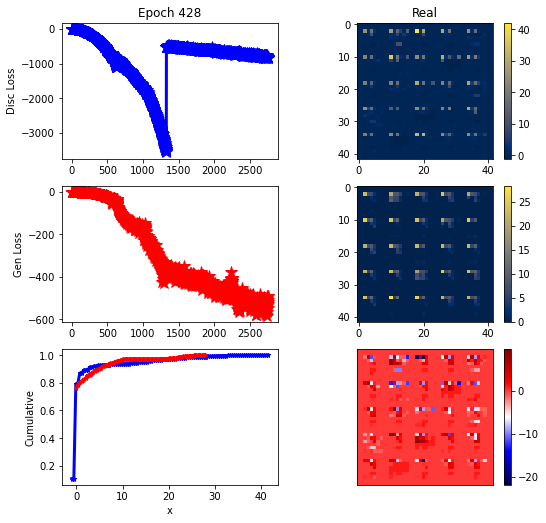

ErrG: -526.6966770717075, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


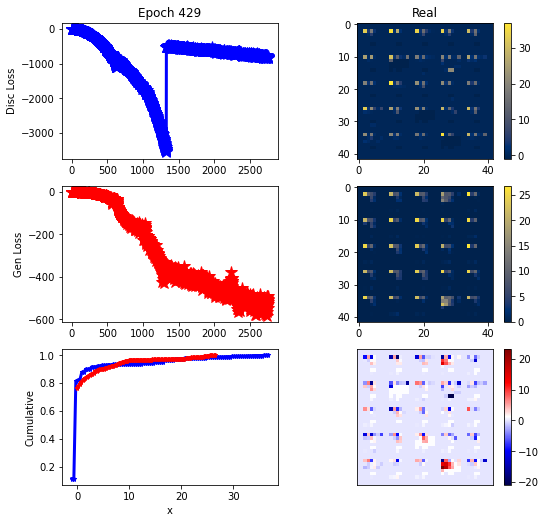

ErrG: -506.9265398297991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


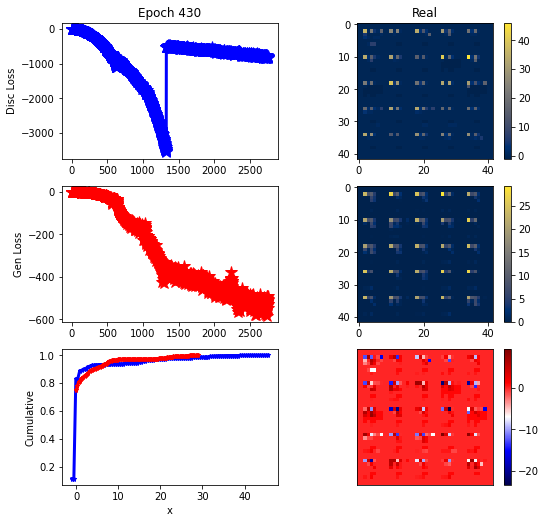

ErrG: -527.718000139509, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


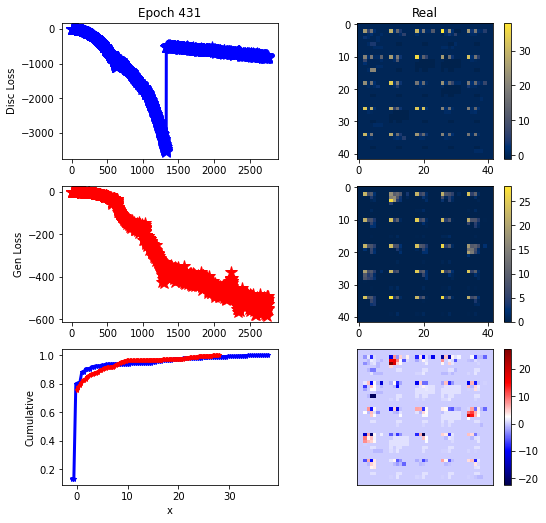

ErrG: -551.9671848842075, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


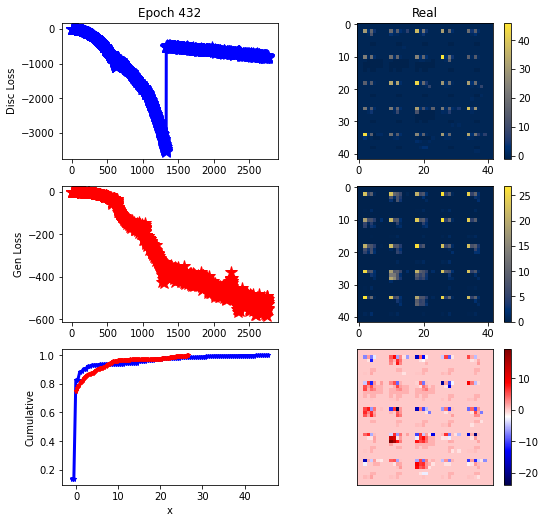

ErrG: -518.0019008091518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


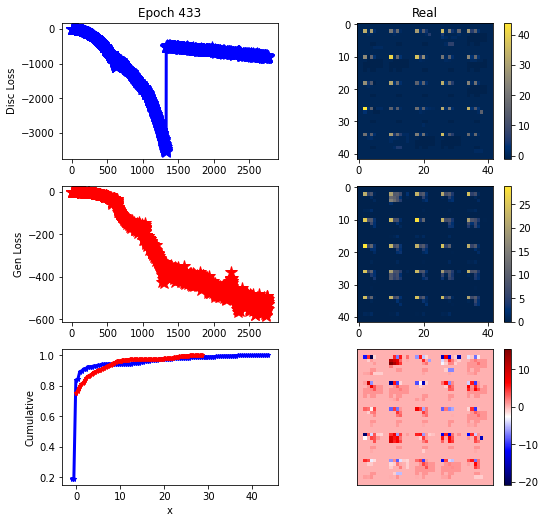

ErrG: -527.7294791085379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


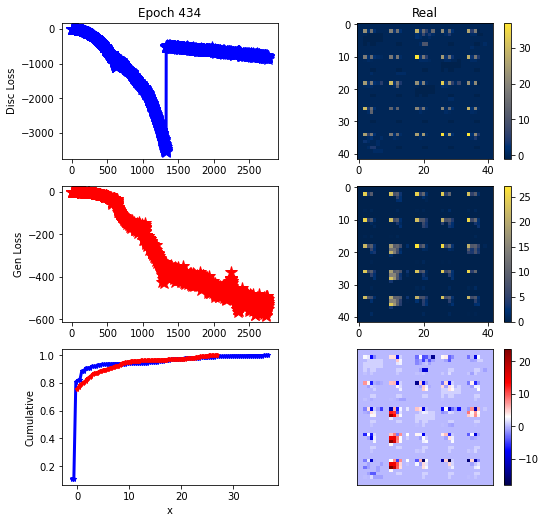

ErrG: -539.3634469168527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


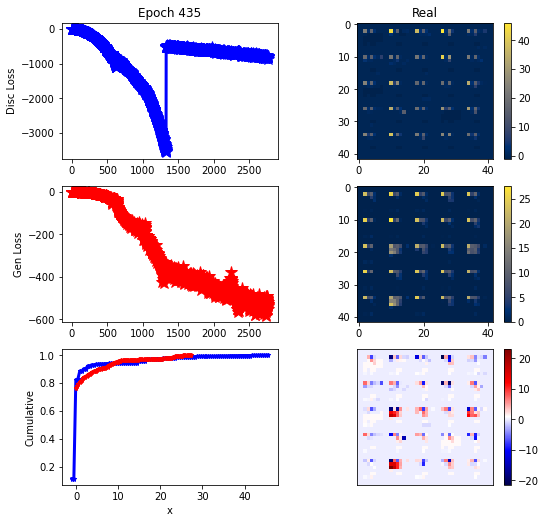

ErrG: -532.3157610212054, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


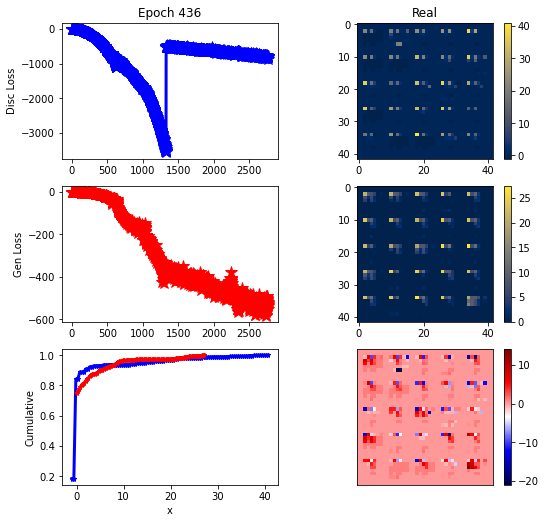

ErrG: -523.0570417131696, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


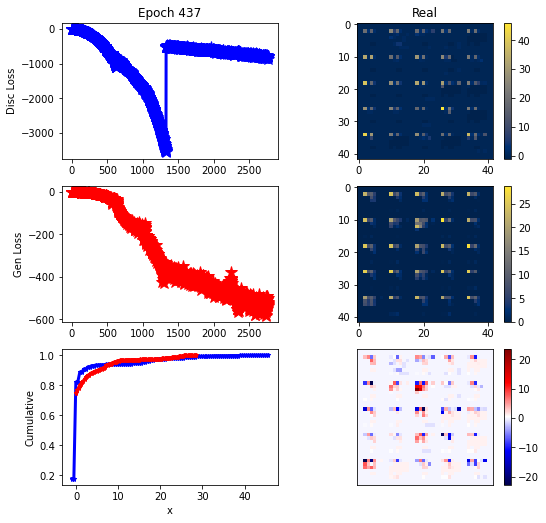

ErrG: -501.86695643833707, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


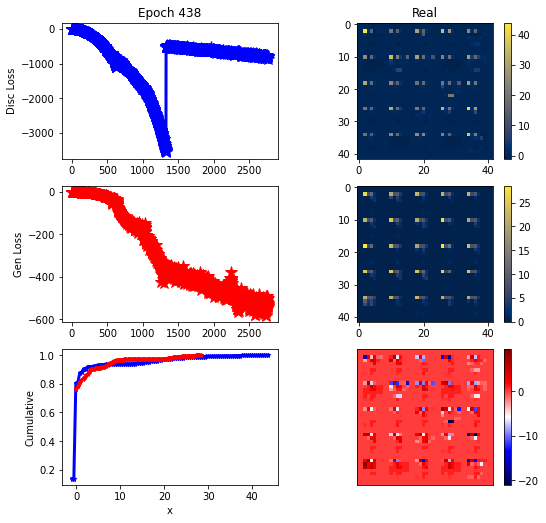

ErrG: -543.5356750488281, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


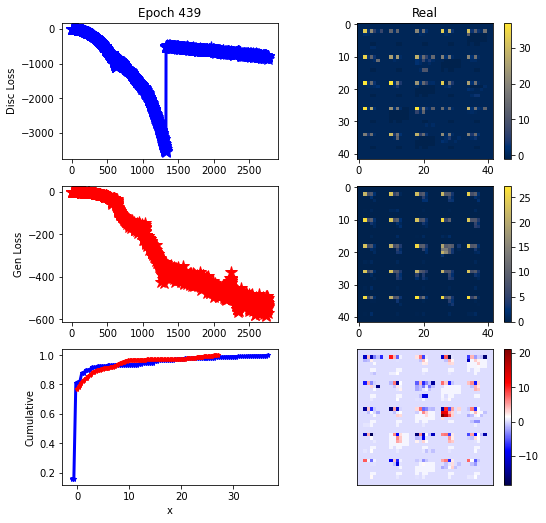

ErrG: -569.3928527832031, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


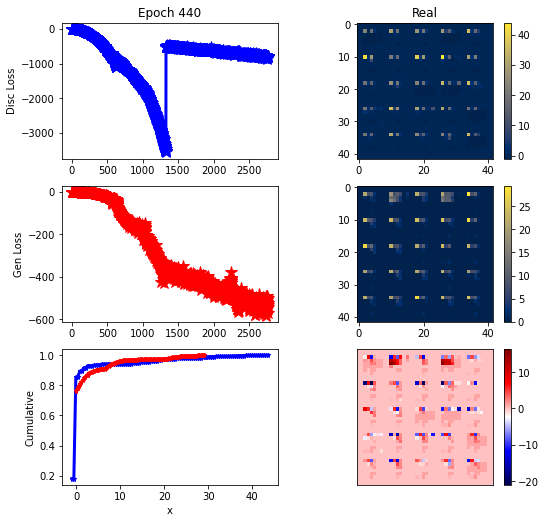

ErrG: -522.7094421386719, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


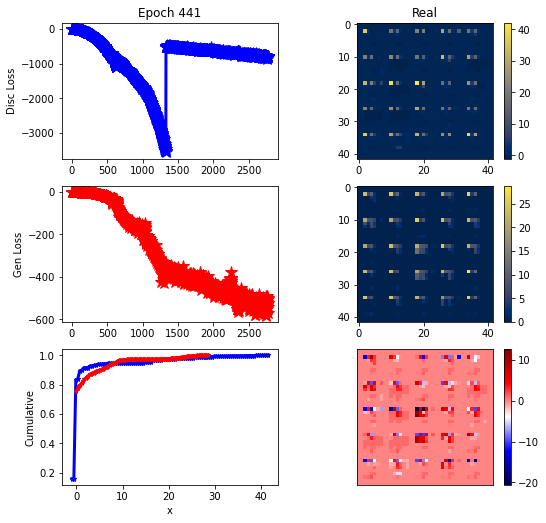

ErrG: -504.51732090541293, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


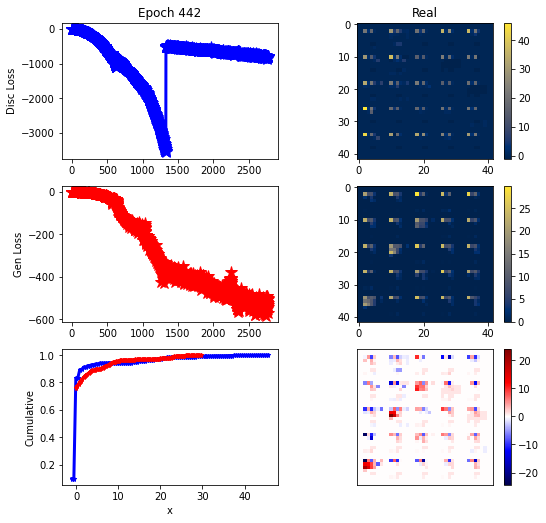

ErrG: -534.7681318010602, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


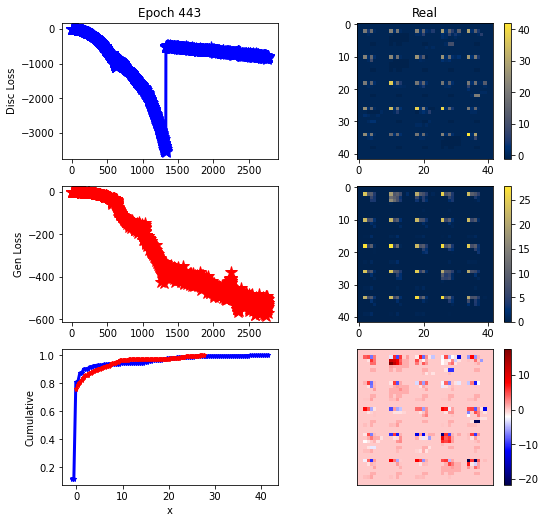

ErrG: -521.3861955915179, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


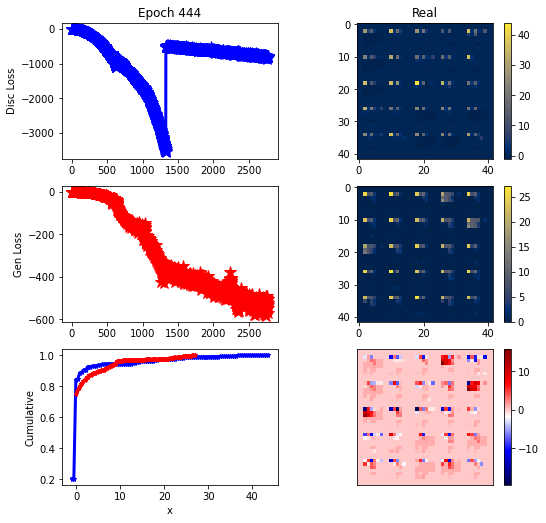

ErrG: -548.301252092634, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


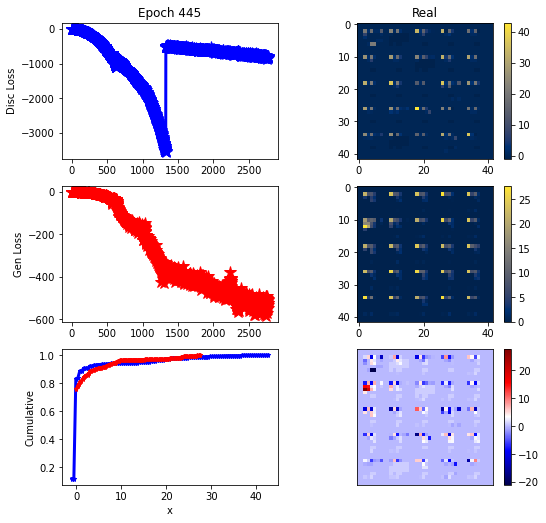

ErrG: -511.05606951032365, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


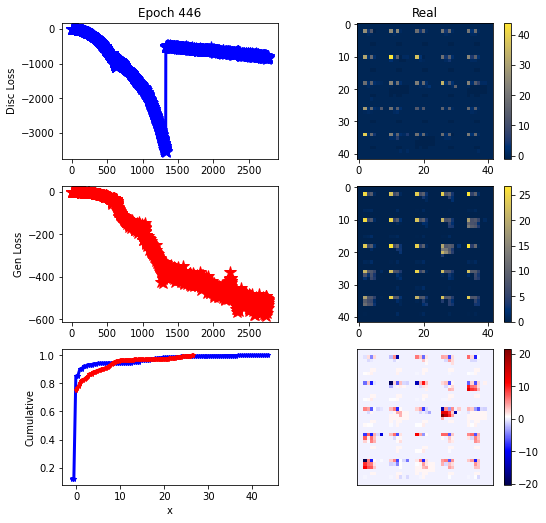

ErrG: -513.7525242396763, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


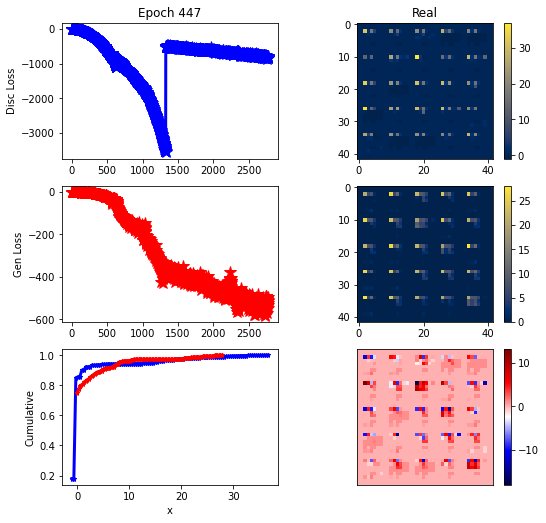

ErrG: -495.12196568080356, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


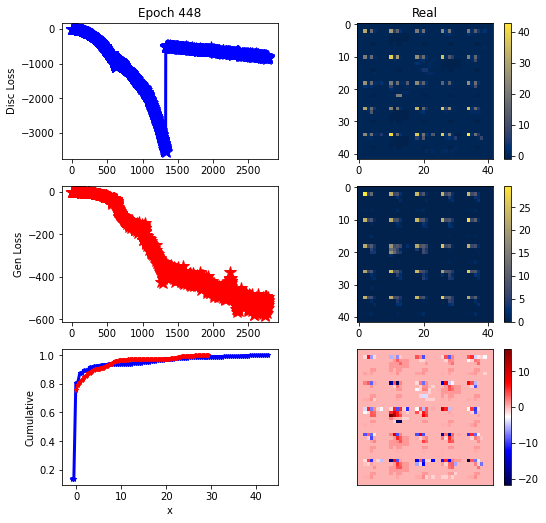

ErrG: -530.7769775390625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


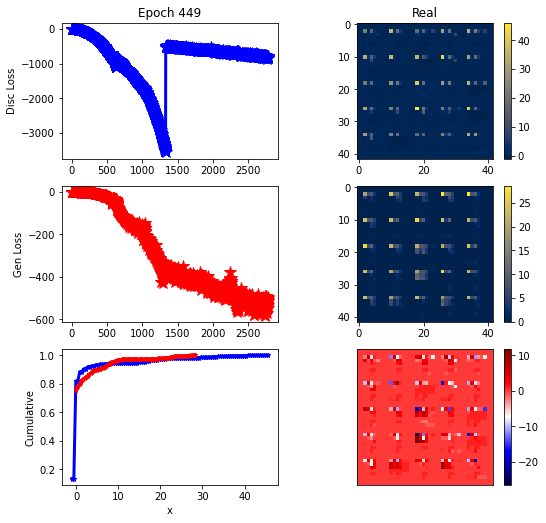

ErrG: -500.2721034458705, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


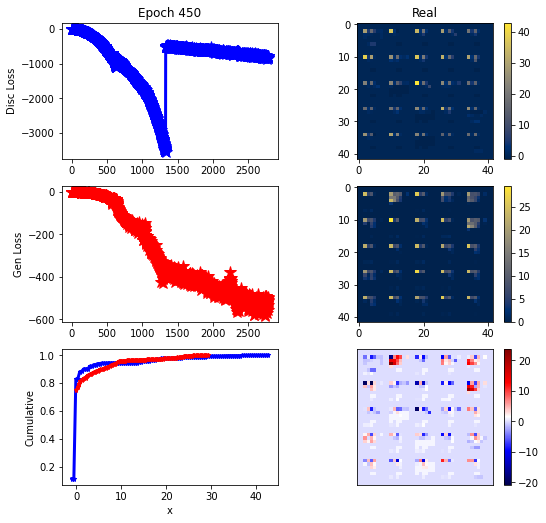

ErrG: -556.484130859375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


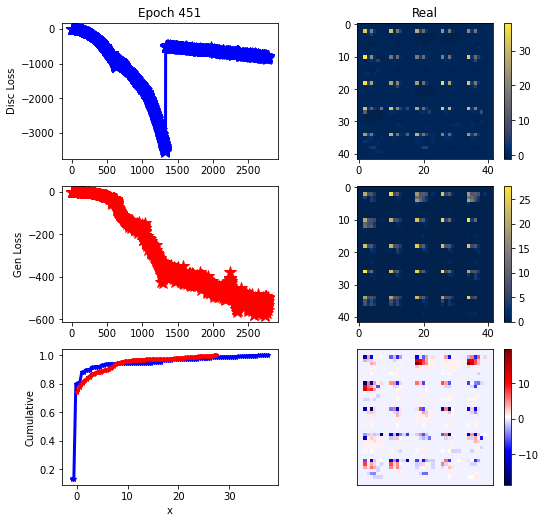

ErrG: -497.8172912597656, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


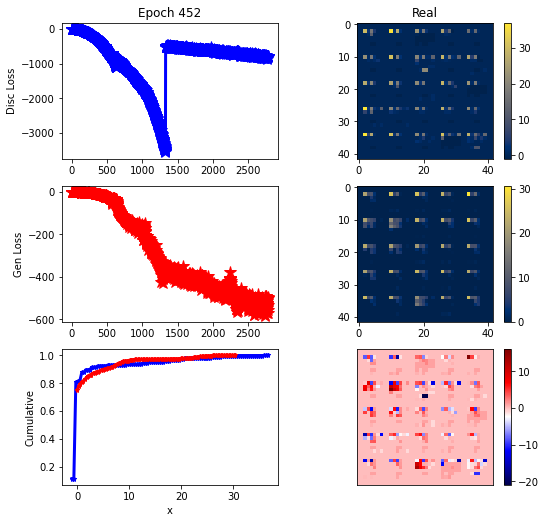

ErrG: -570.9327479771206, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


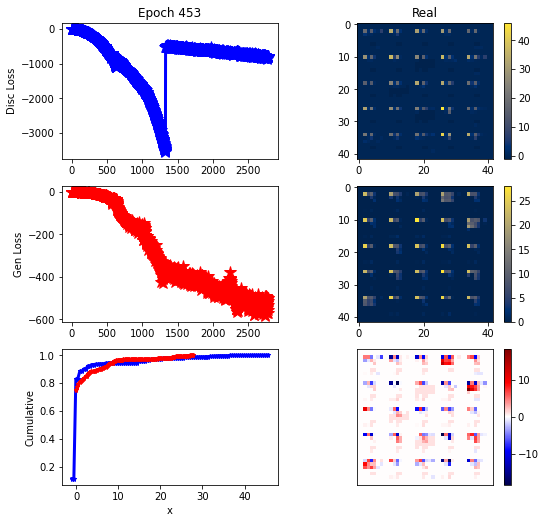

ErrG: -514.8033229282925, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


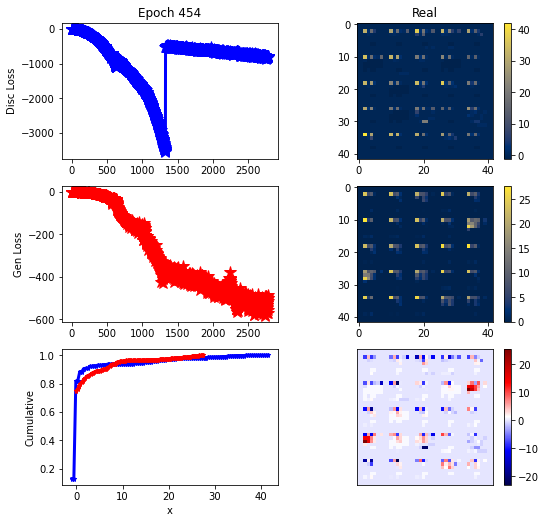

ErrG: -485.13370186941967, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


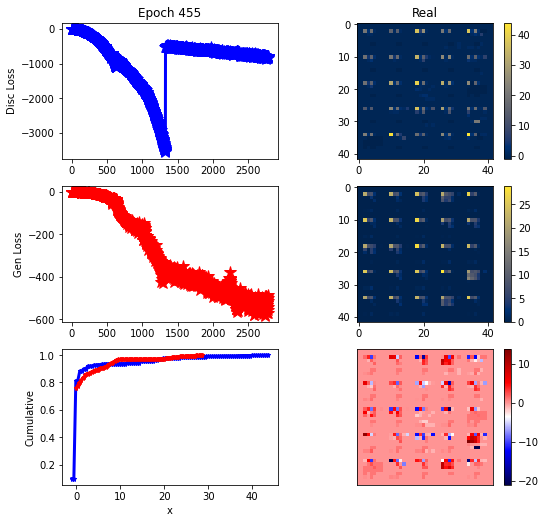

ErrG: -544.6883893694196, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


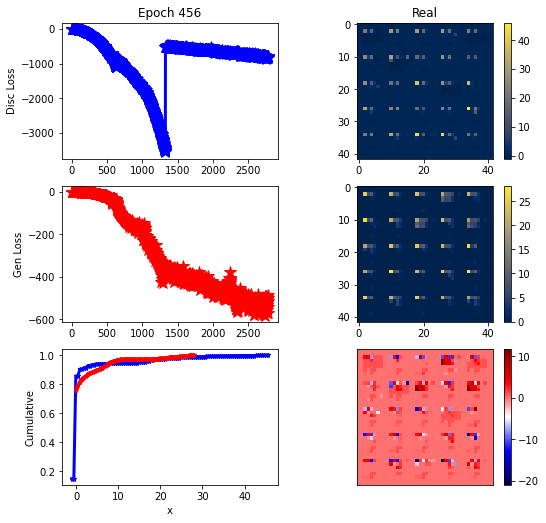

ErrG: -515.4361354282925, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


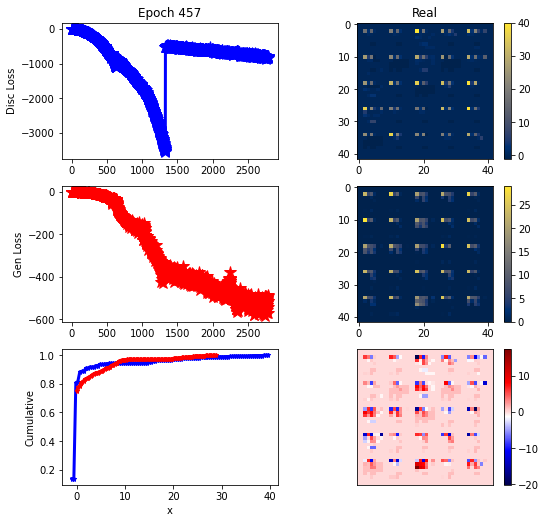

ErrG: -489.0630580357143, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


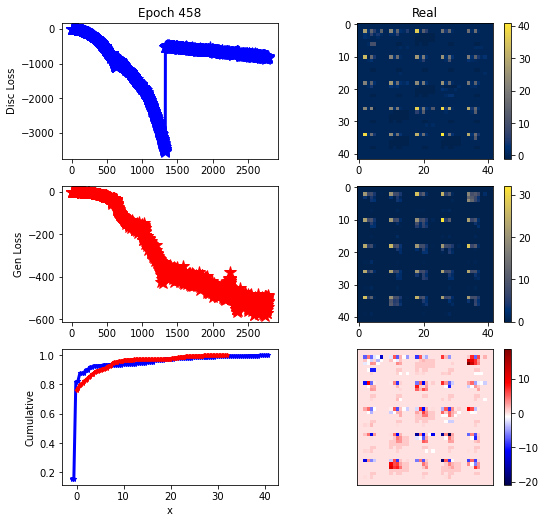

ErrG: -519.1970520019531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


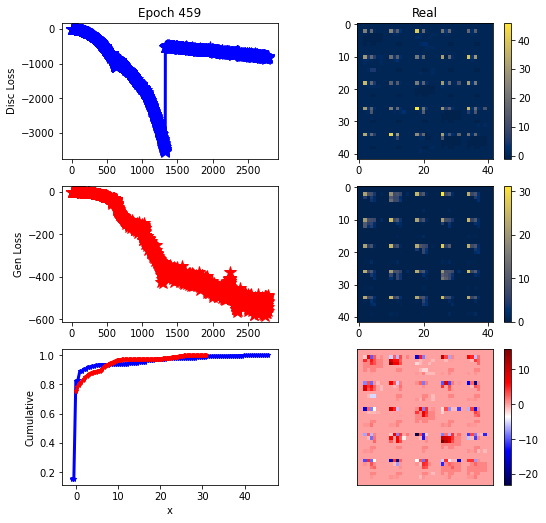

ErrG: -561.9818769182477, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


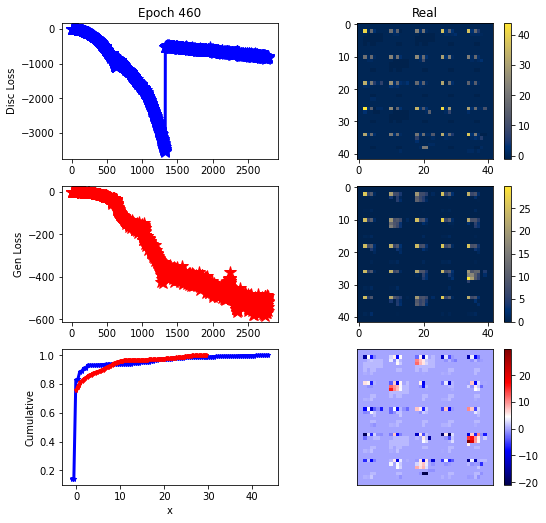

ErrG: -518.0710972377232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


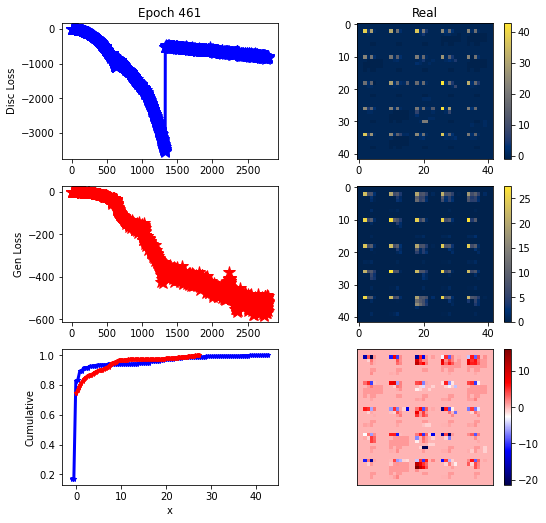

ErrG: -522.7918526785714, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


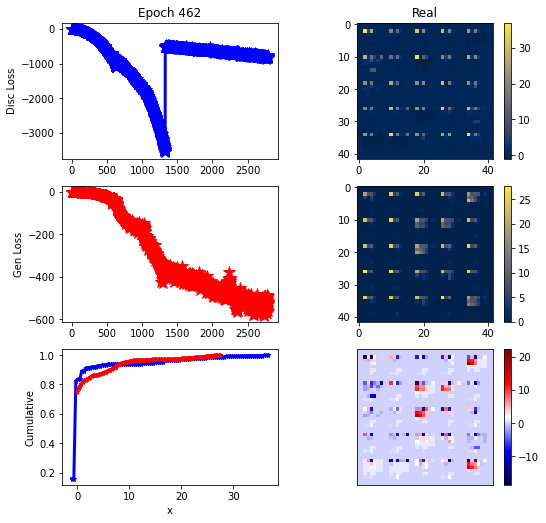

ErrG: -529.2725481305804, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


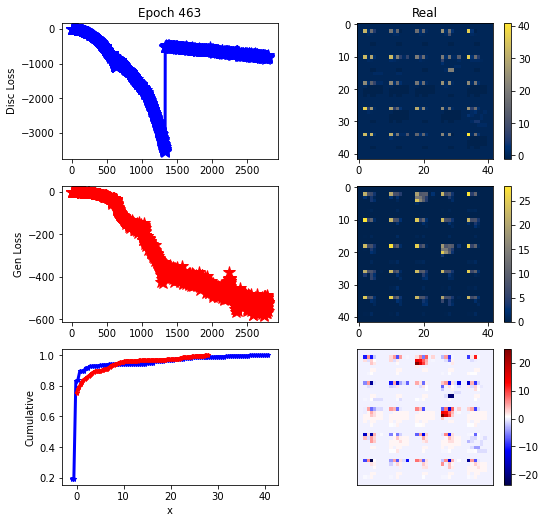

ErrG: -520.6448146275112, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


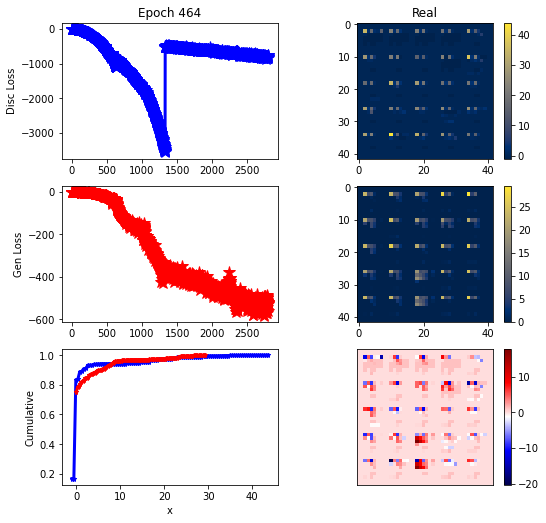

ErrG: -525.6831708635602, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


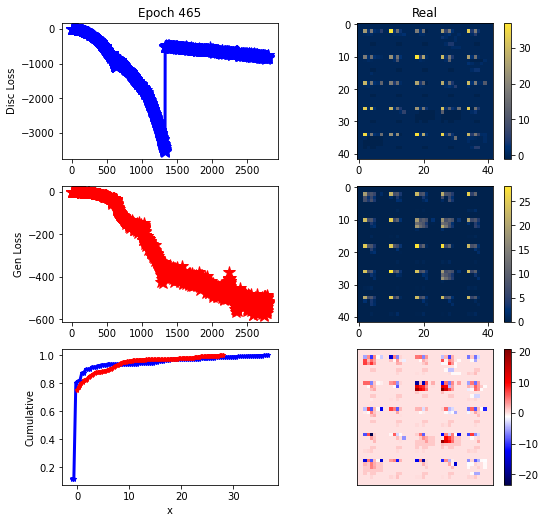

ErrG: -514.4042184012277, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


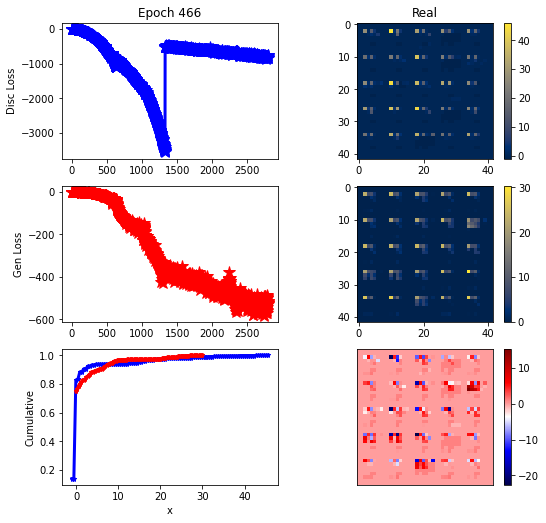

ErrG: -512.3051321847098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


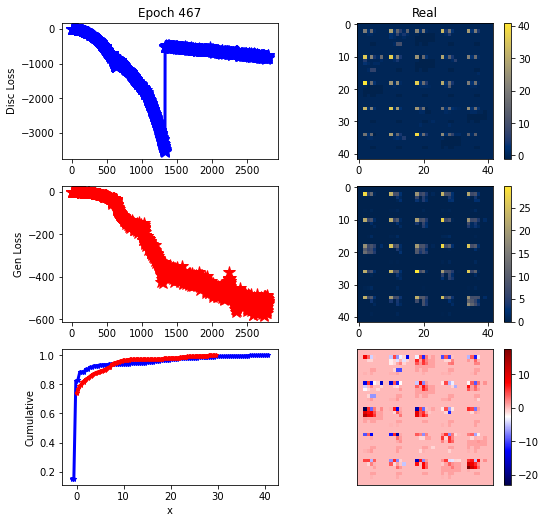

ErrG: -504.5305916922433, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


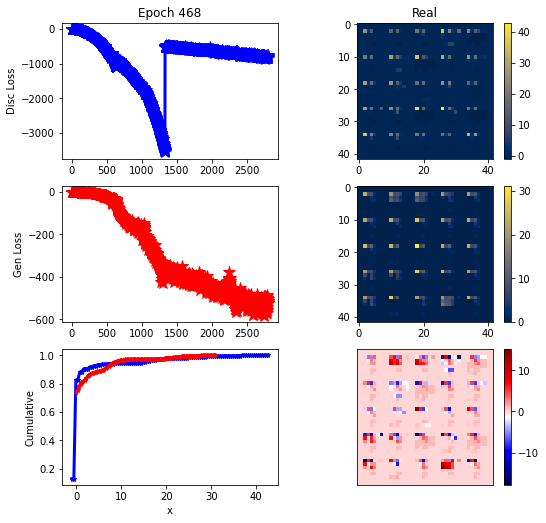

ErrG: -525.3018668038504, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


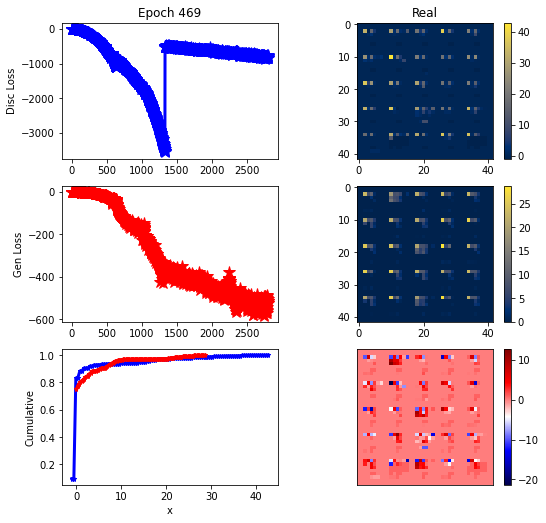

ErrG: -513.0265154157366, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


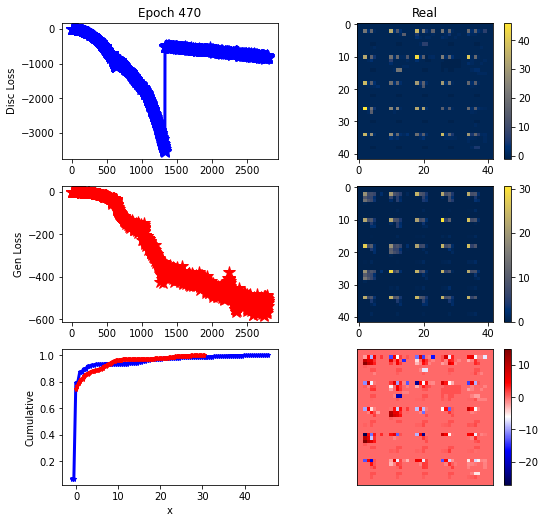

ErrG: -538.8981672014509, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


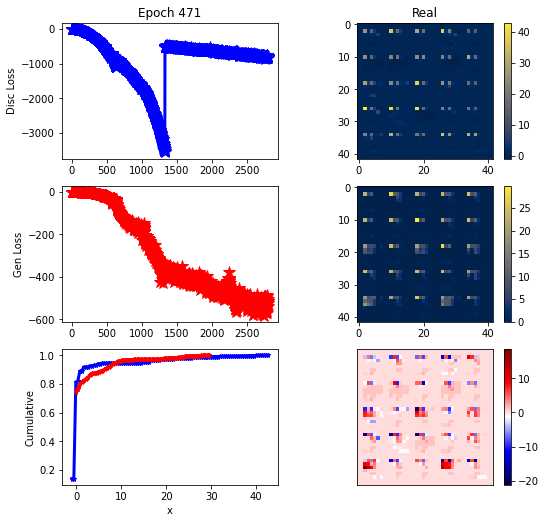

ErrG: -514.9288199288504, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


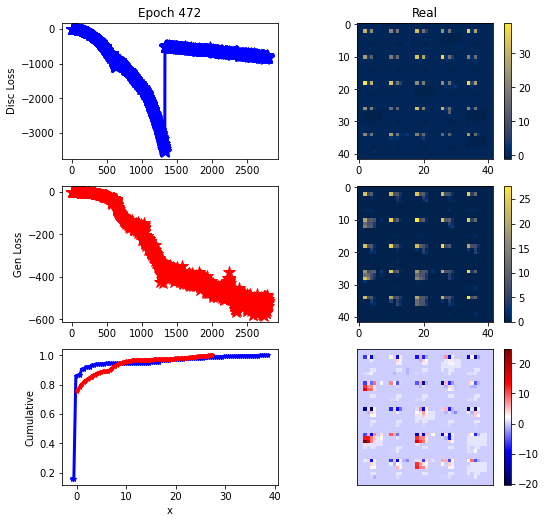

ErrG: -518.4331316266741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


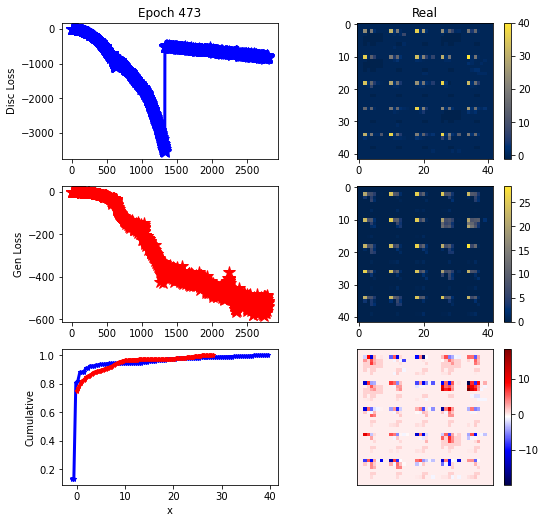

ErrG: -540.681862967355, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


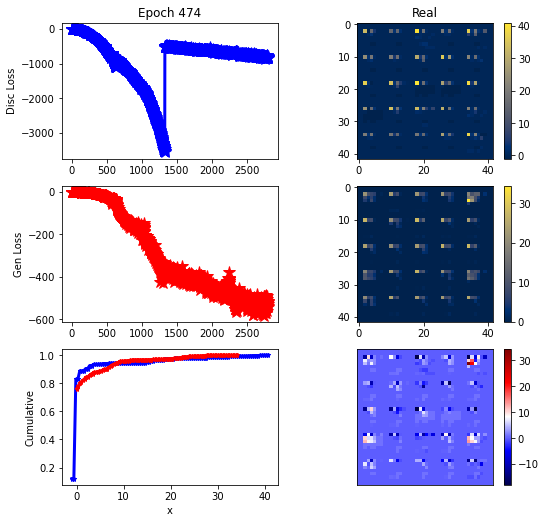

ErrG: -526.5420619419643, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


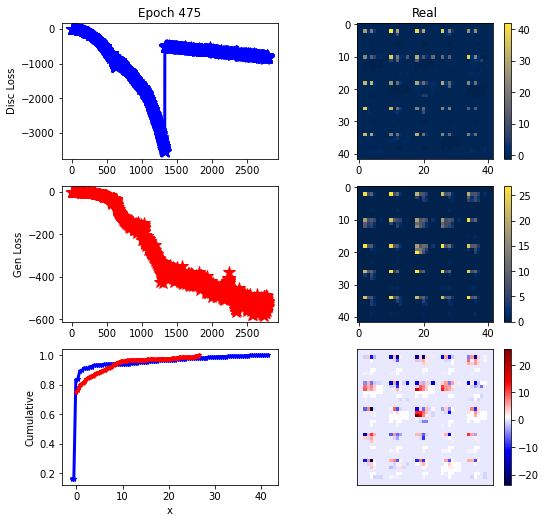

ErrG: -519.7140066964286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


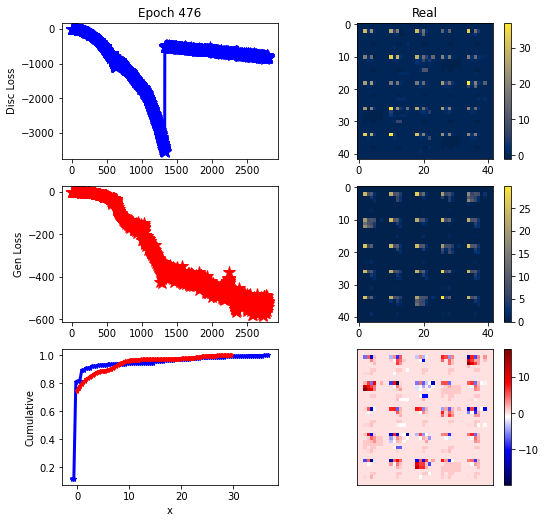

ErrG: -520.212668282645, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


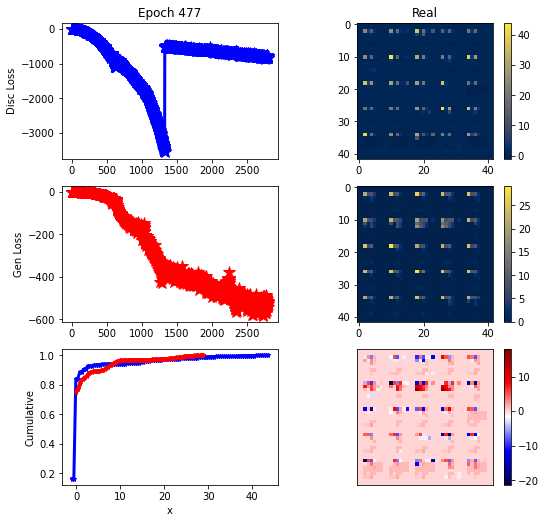

ErrG: -514.202880859375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


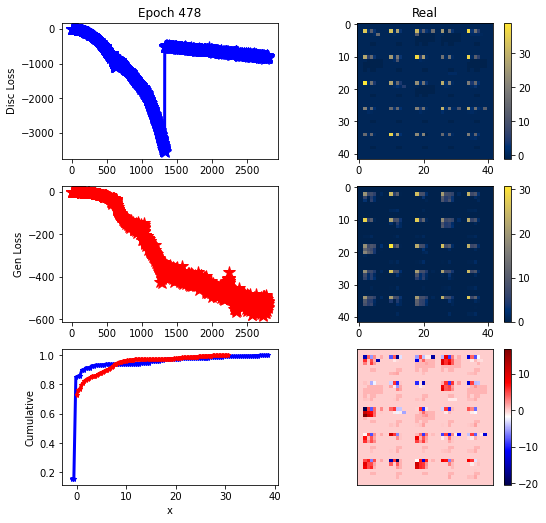

ErrG: -549.3044172014509, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


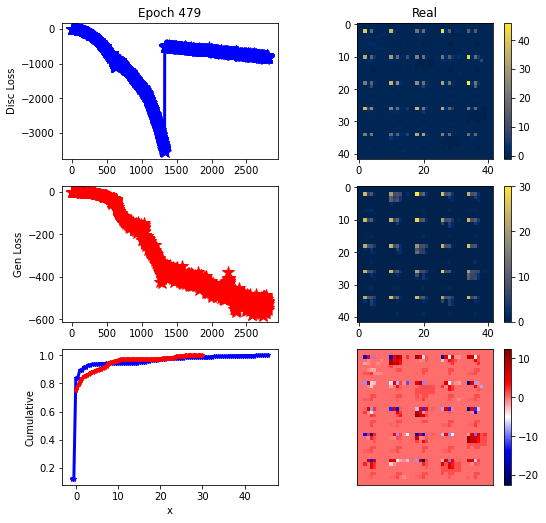

ErrG: -554.4480547223773, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


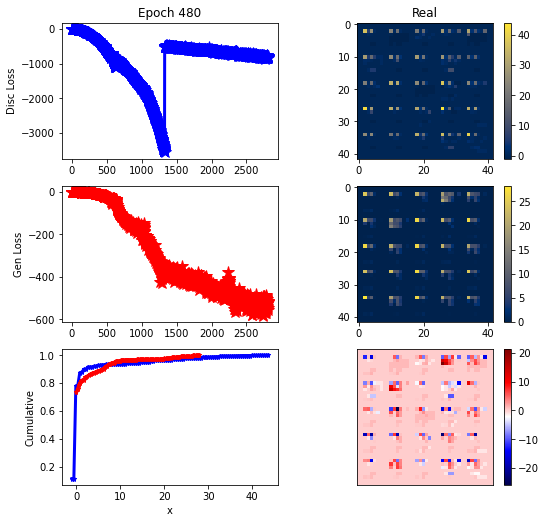

ErrG: -516.0197884695871, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


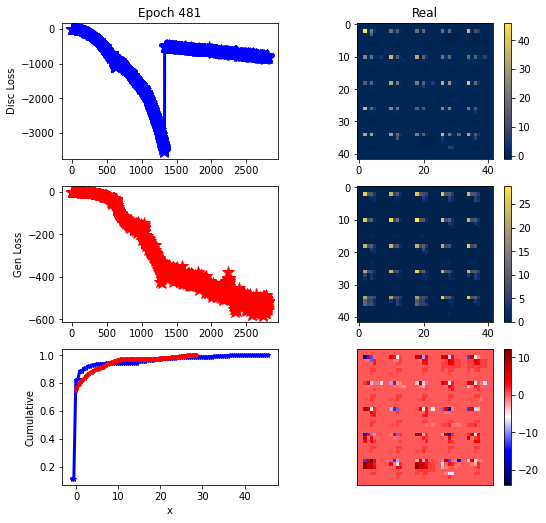

ErrG: -512.41892351423, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


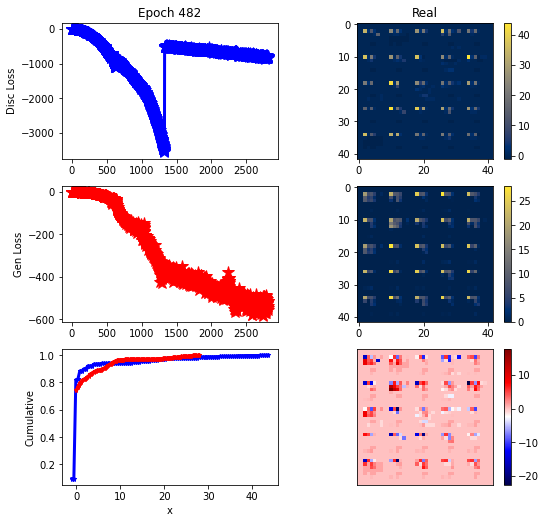

ErrG: -538.1299264090402, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


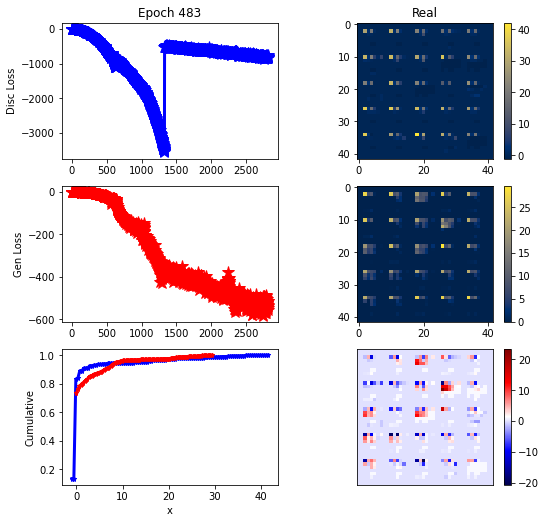

ErrG: -530.6162719726562, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


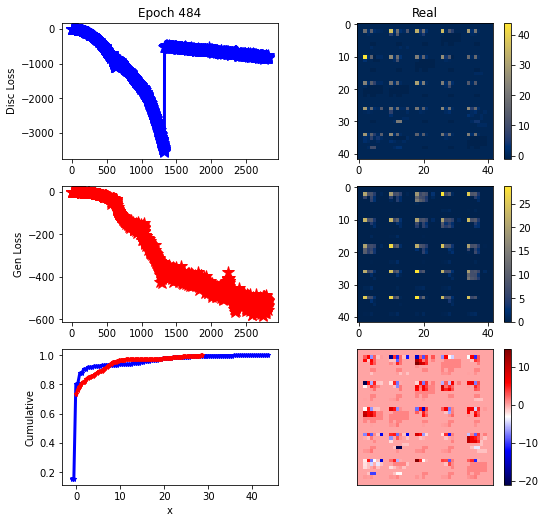

ErrG: -508.02127511160717, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


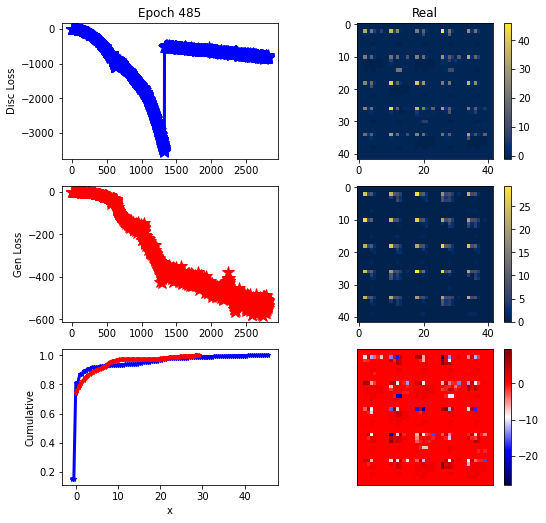

ErrG: -549.3521379743304, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


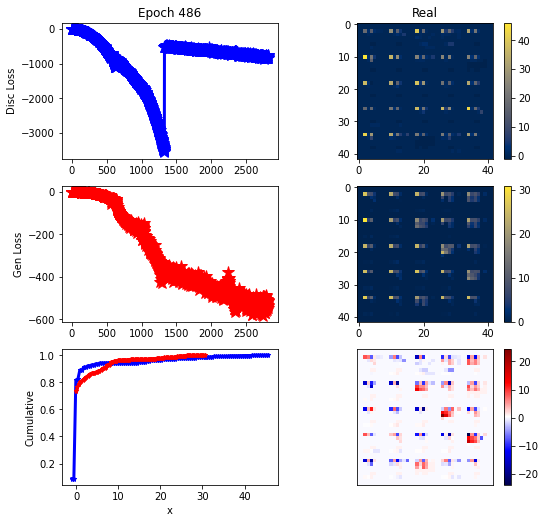

ErrG: -516.329833984375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


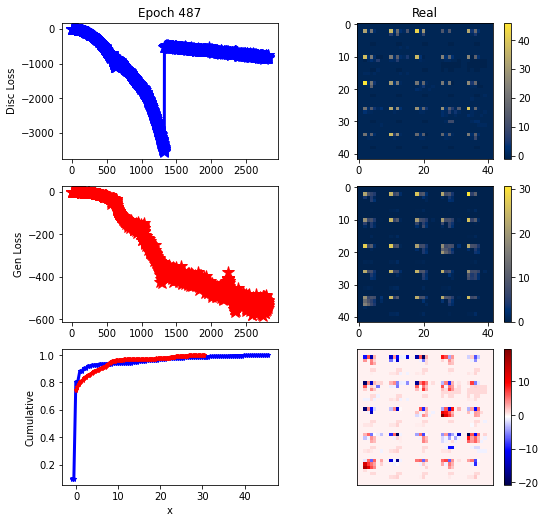

ErrG: -523.8305184500558, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


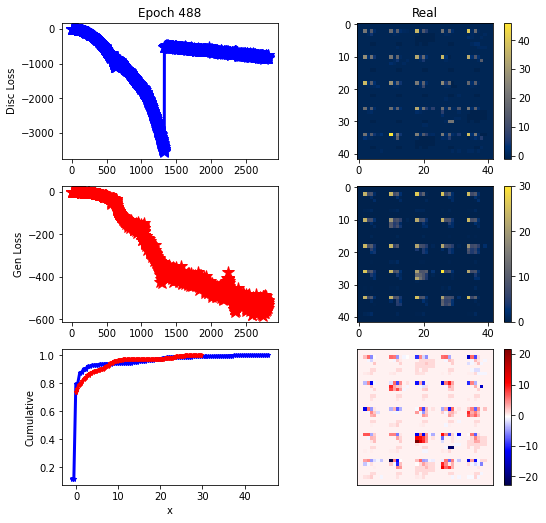

ErrG: -533.2610430036273, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


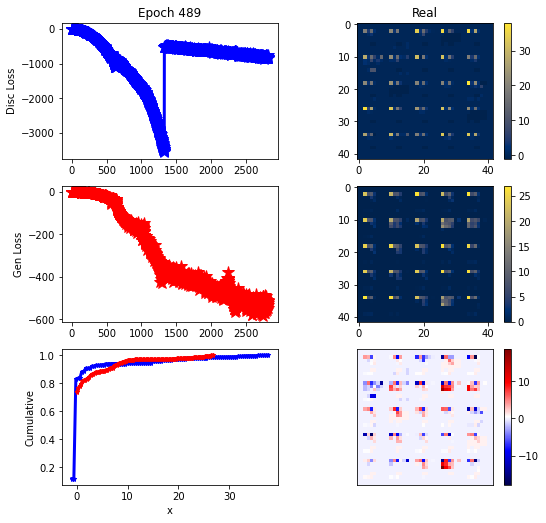

ErrG: -511.7153581891741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


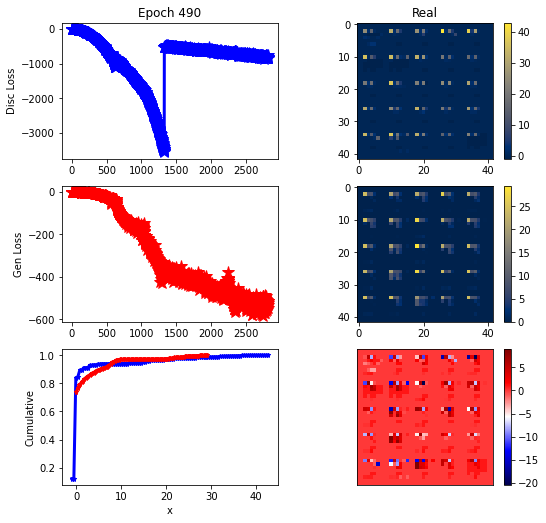

ErrG: -515.6370588030134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


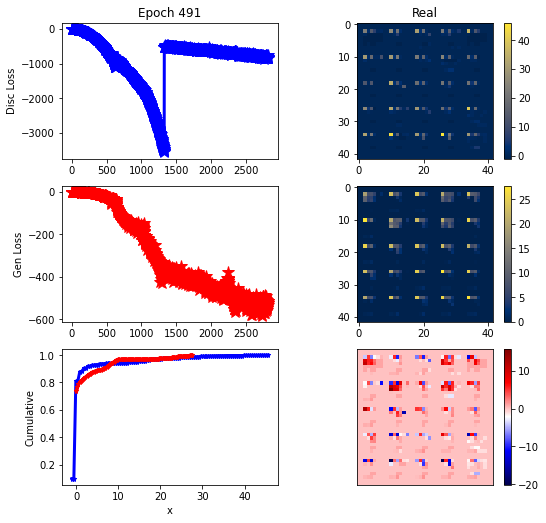

ErrG: -522.4437299455915, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


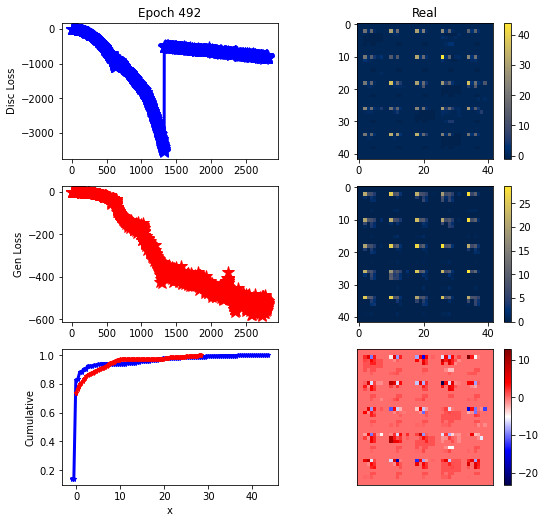

ErrG: -528.7940848214286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


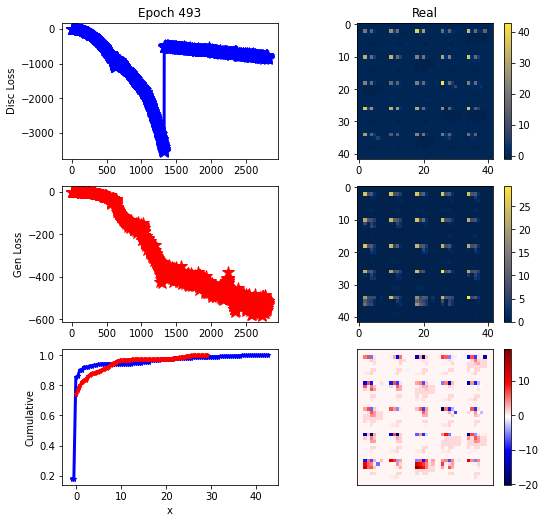

ErrG: -524.5906066894531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


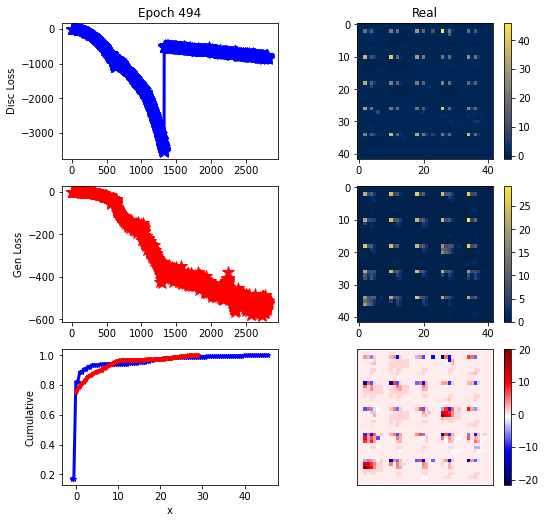

ErrG: -526.9221976143973, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


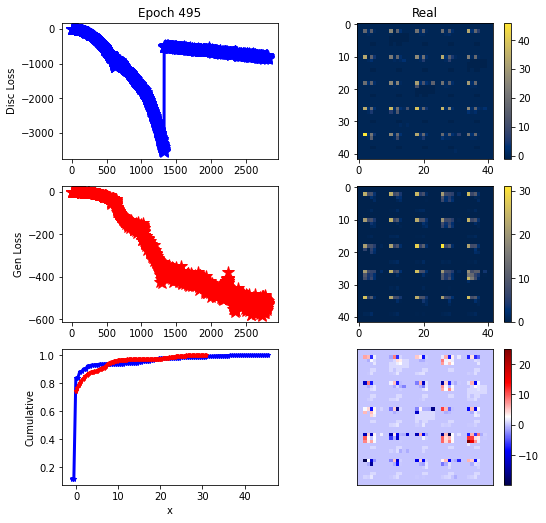

ErrG: -531.7665754045759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


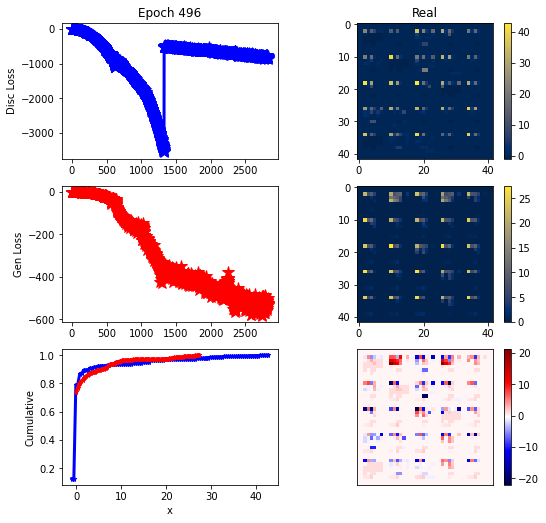

ErrG: -501.318368094308, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


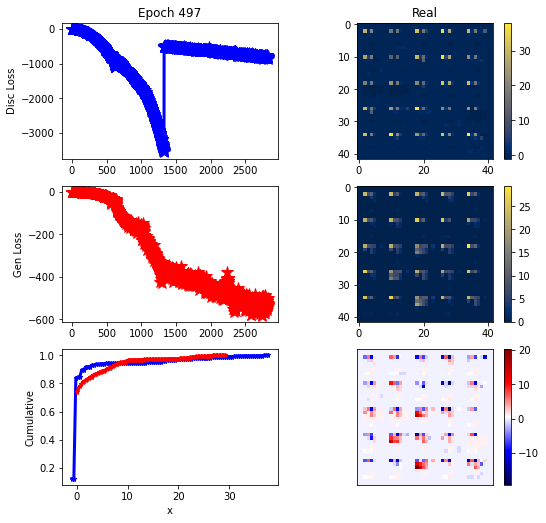

ErrG: -535.5222865513393, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


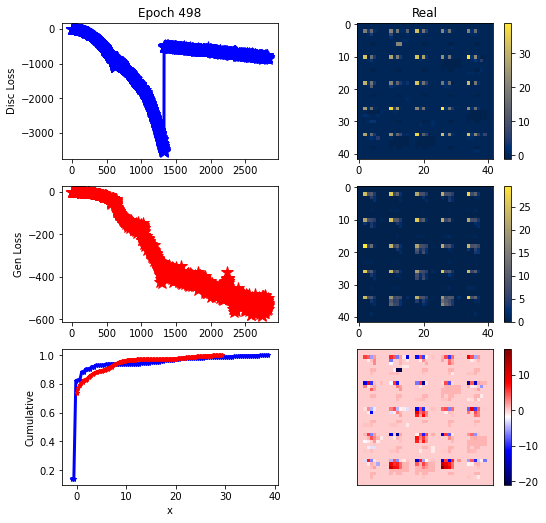

ErrG: -549.9086042131696, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


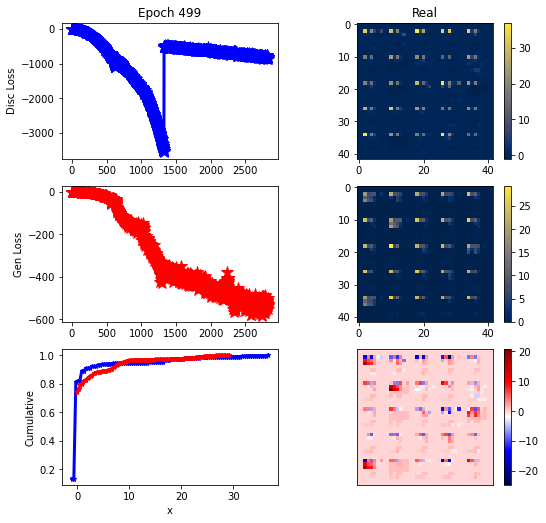

ErrG: -528.2486703055246, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


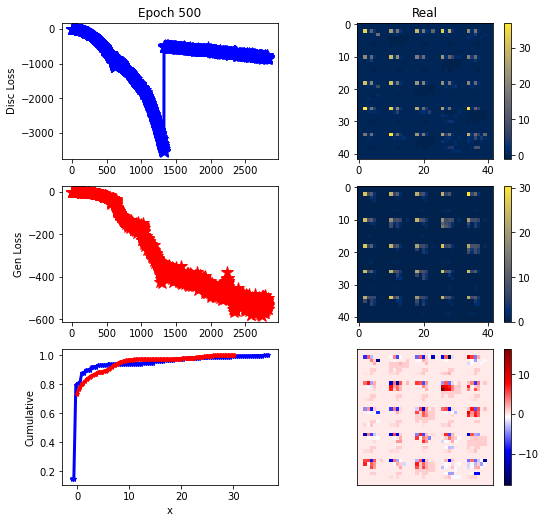

ErrG: -551.705788748605, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


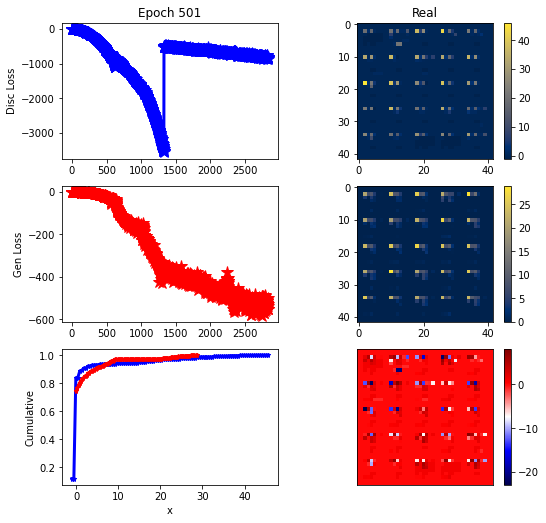

ErrG: -553.8850184849331, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


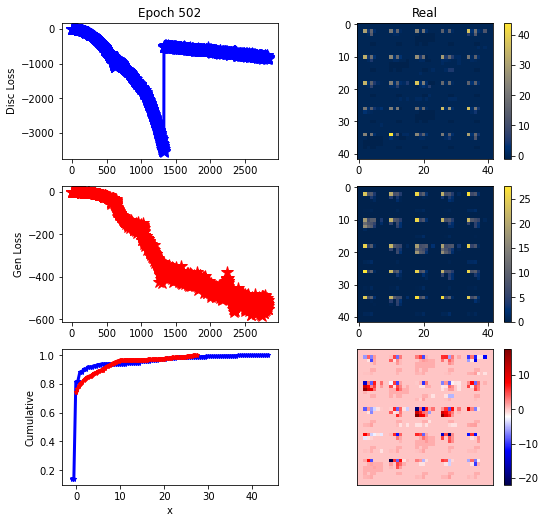

ErrG: -509.4081028529576, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


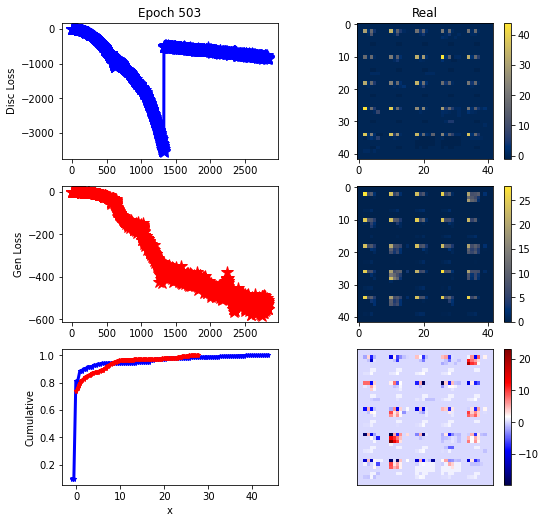

ErrG: -519.275168282645, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


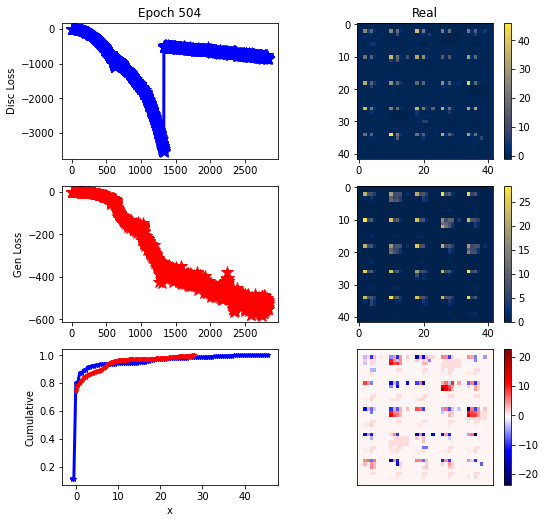

ErrG: -542.0404052734375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


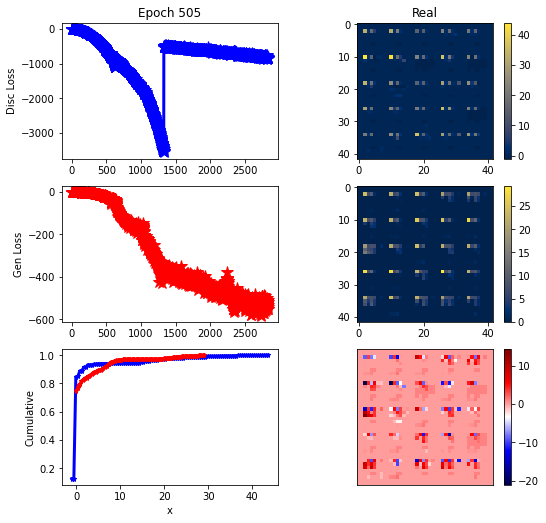

ErrG: -532.9693908691406, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


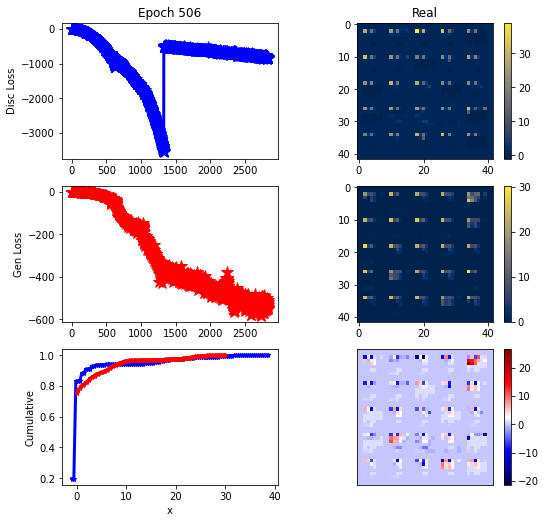

ErrG: -548.4629342215402, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


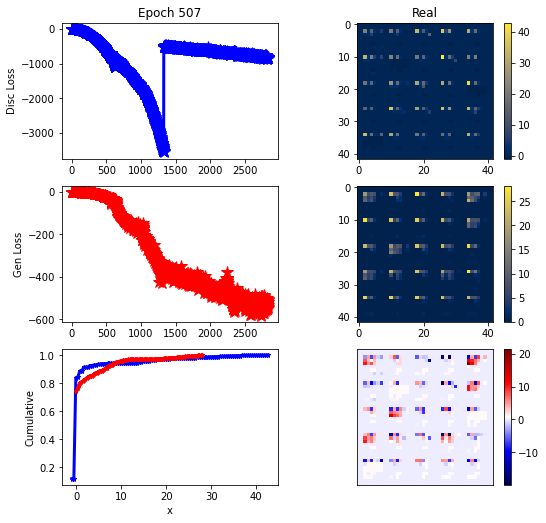

ErrG: -506.2775399344308, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


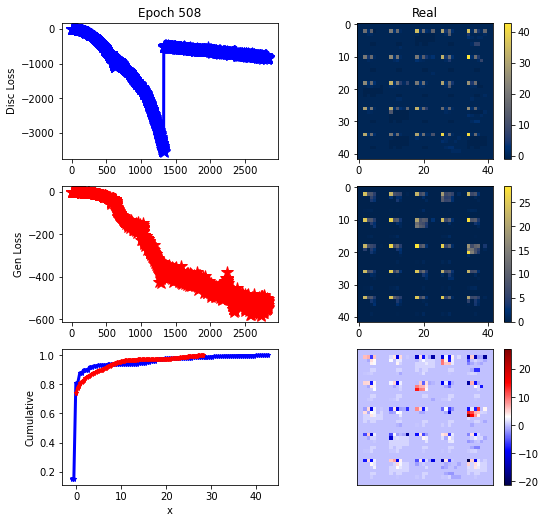

ErrG: -514.721684047154, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


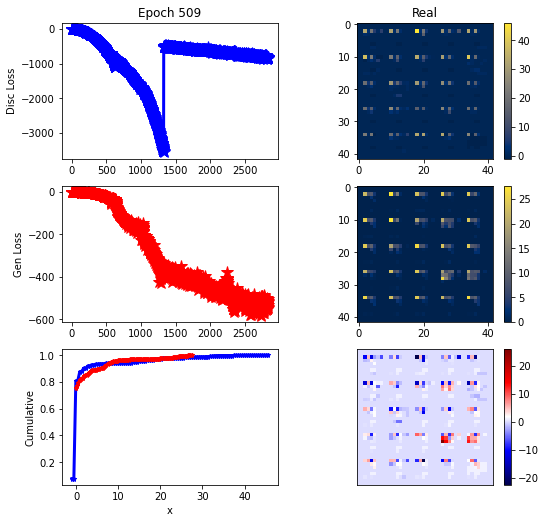

ErrG: -517.0275791713169, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


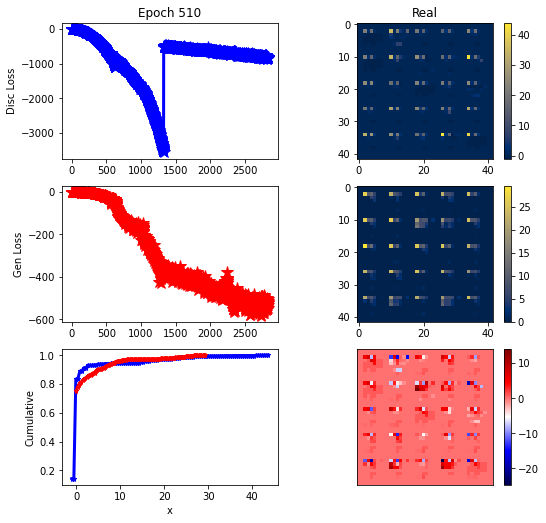

ErrG: -522.7921229771206, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


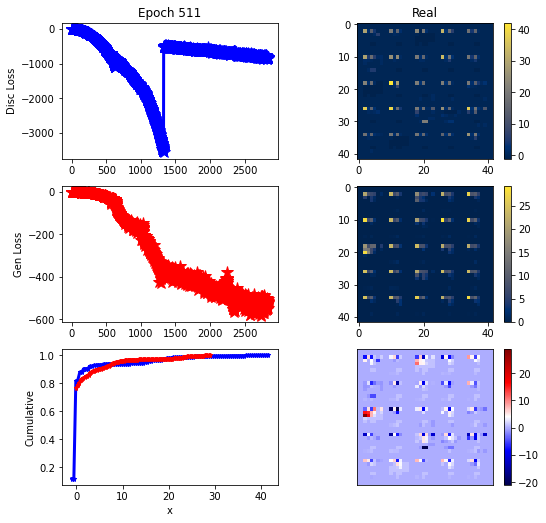

ErrG: -517.2344098772321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


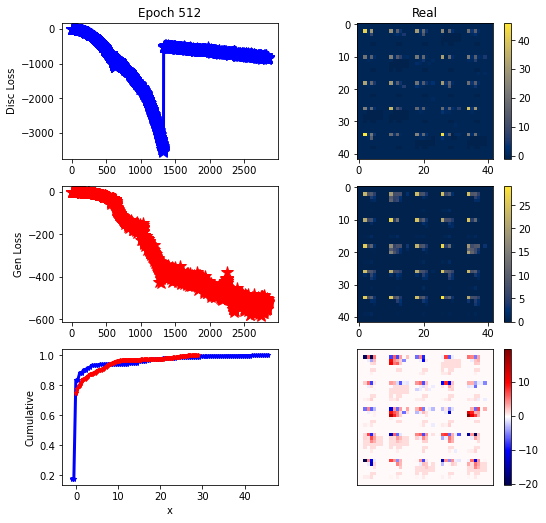

ErrG: -519.1534249441964, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


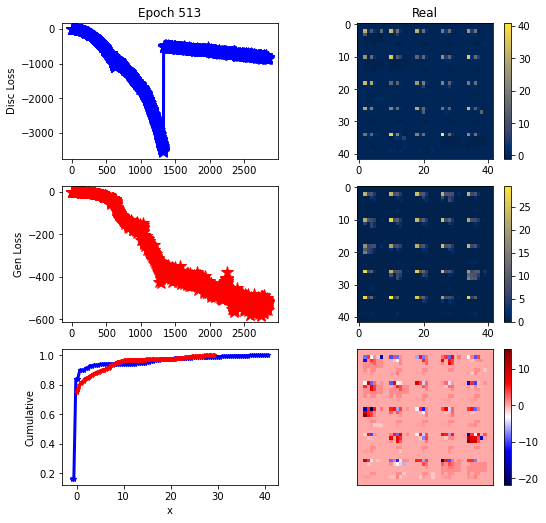

ErrG: -555.7310180664062, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


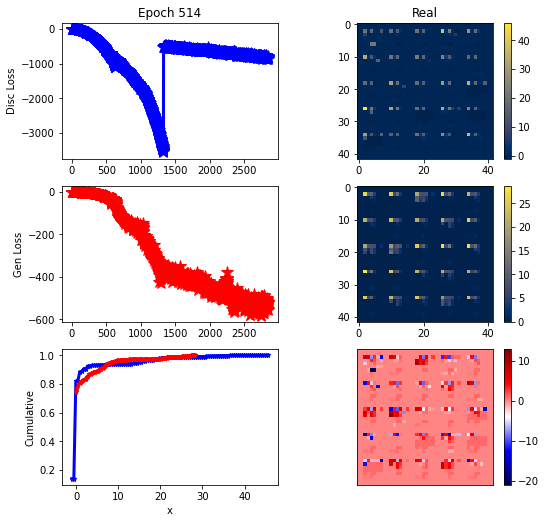

ErrG: -549.8783046177456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


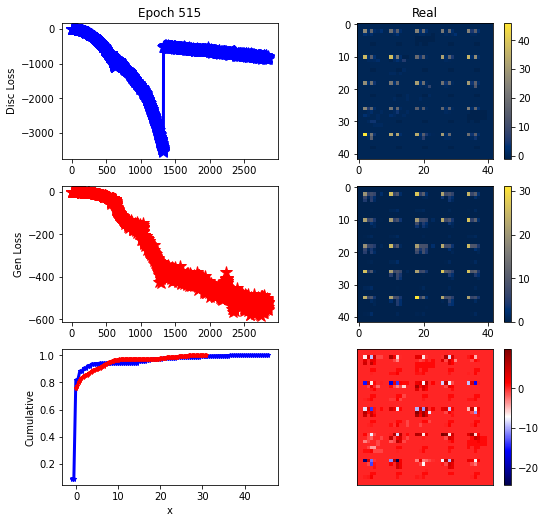

ErrG: -541.3459603445871, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


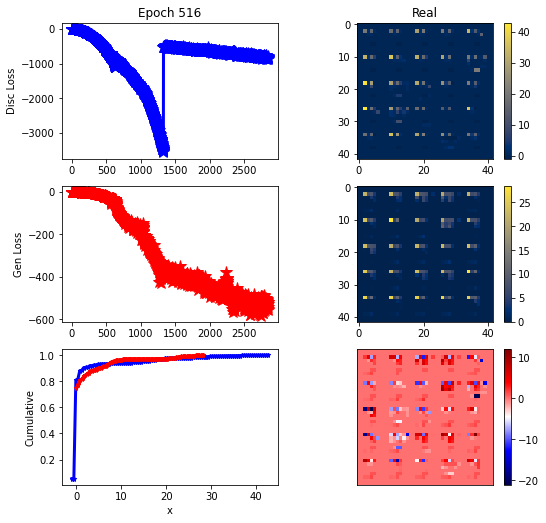

ErrG: -528.3298906598773, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


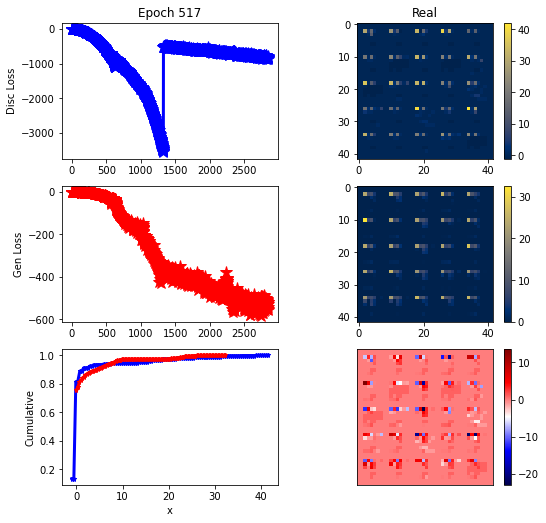

ErrG: -516.6834237234933, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


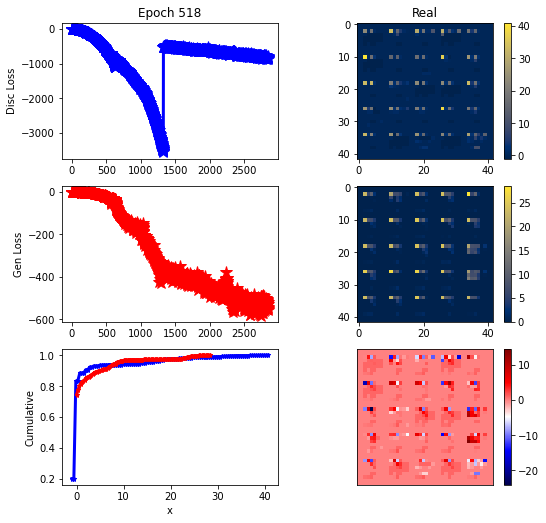

ErrG: -549.2461024693081, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


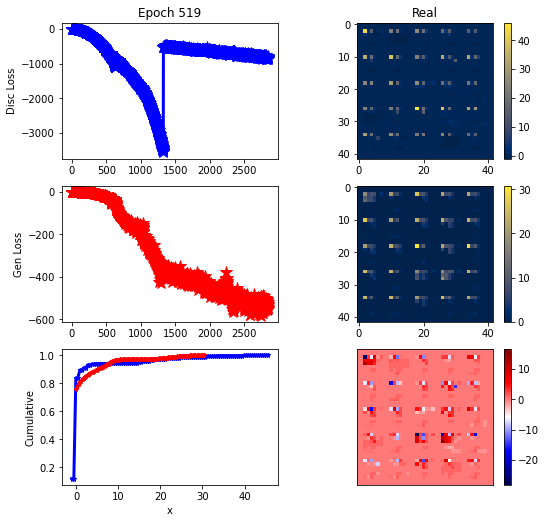

ErrG: -534.3208530970982, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


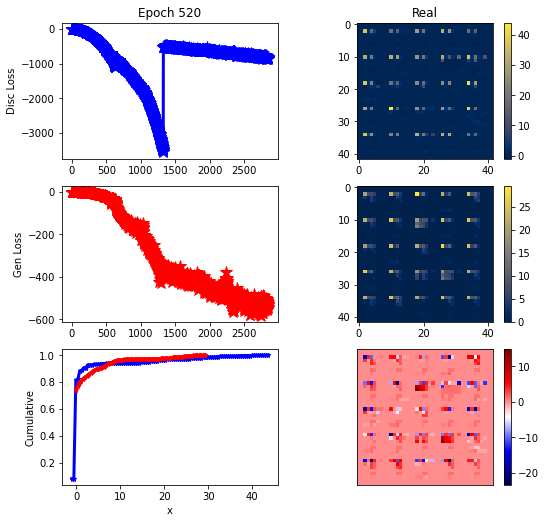

ErrG: -528.8411690848214, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


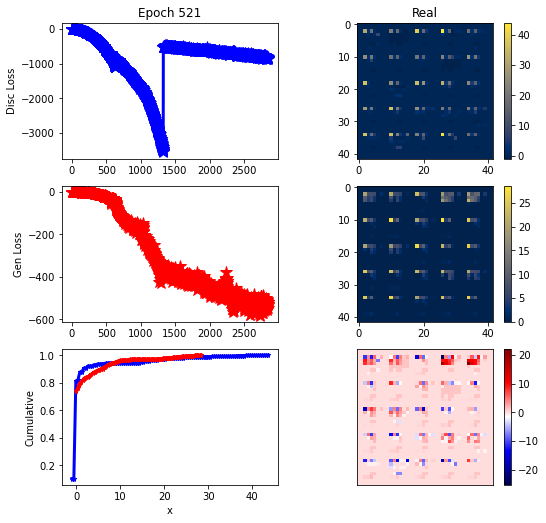

ErrG: -518.6216997419085, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


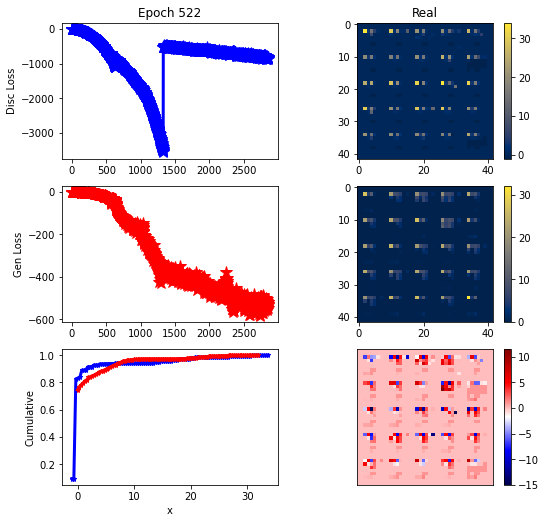

ErrG: -530.3311244419643, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


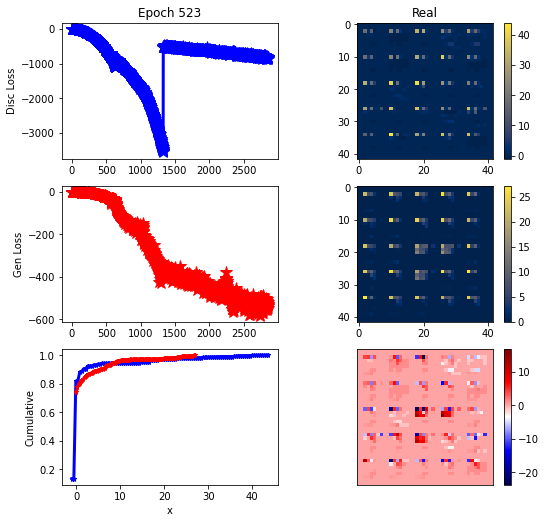

ErrG: -539.9345354352679, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


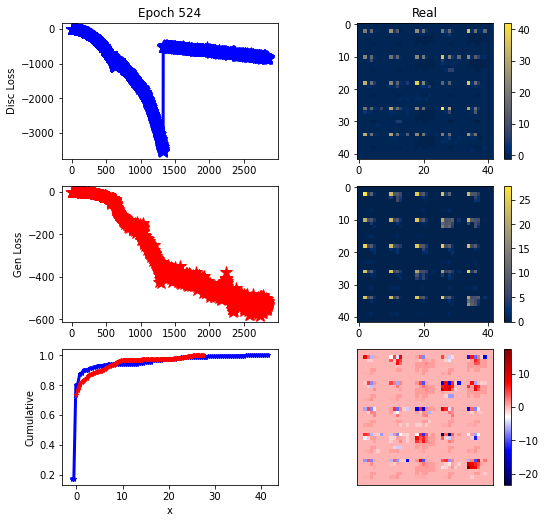

ErrG: -516.2774396623884, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


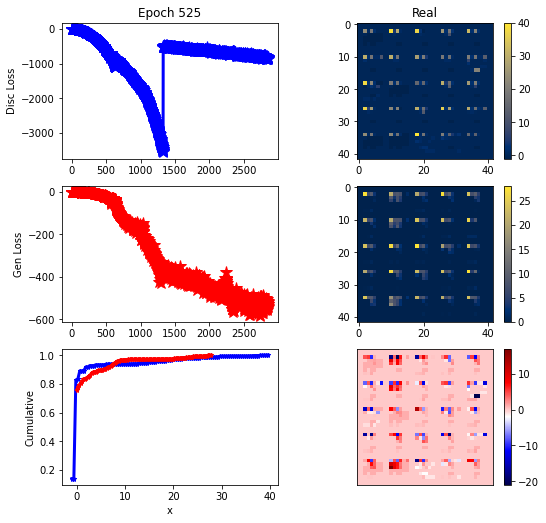

ErrG: -542.5509817940848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


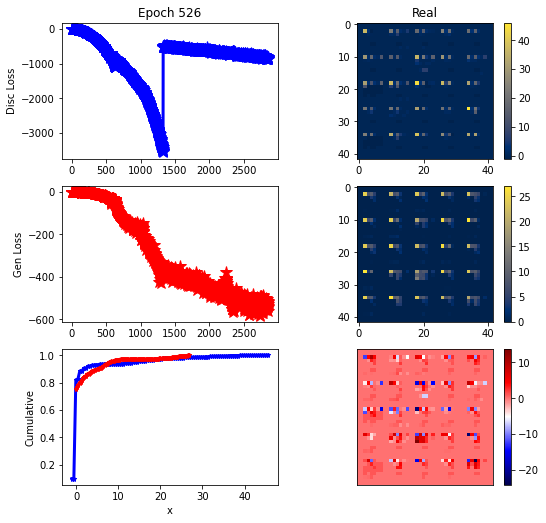

ErrG: -558.9615042550223, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


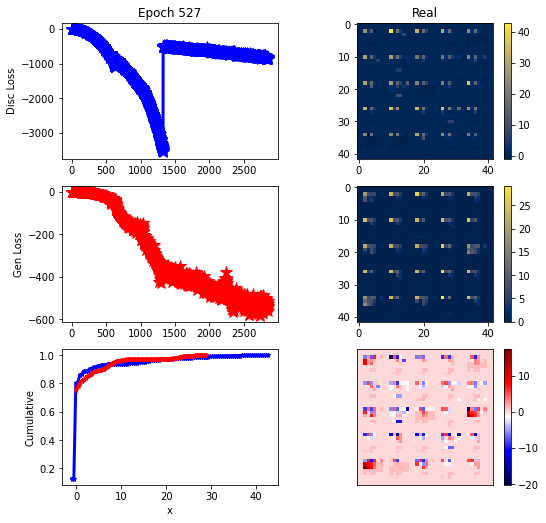

ErrG: -512.763916015625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


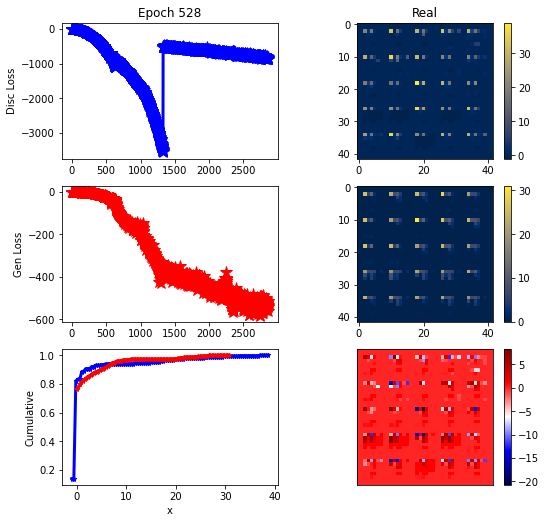

ErrG: -532.6348615373884, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


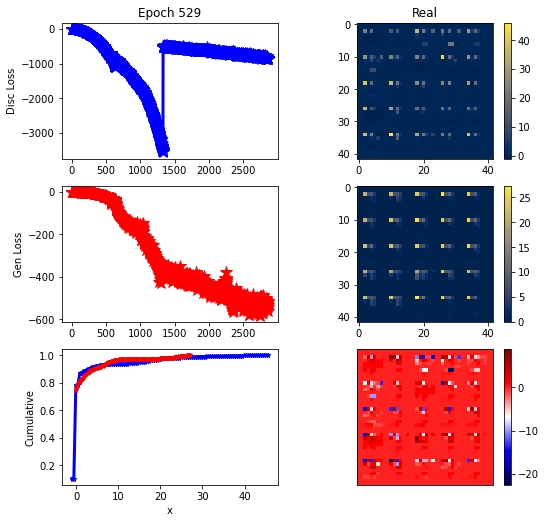

ErrG: -512.5536281040737, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


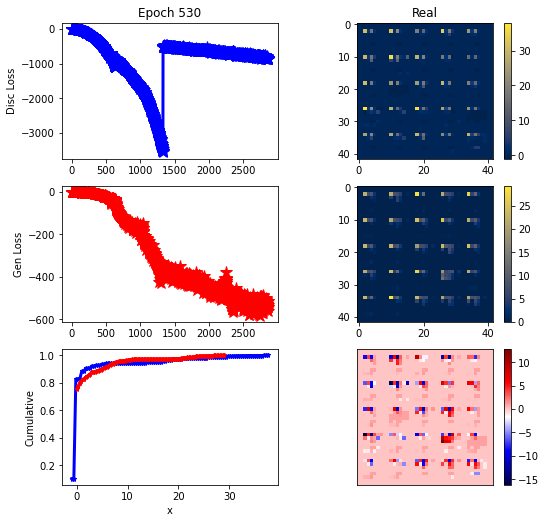

ErrG: -540.7602015904018, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


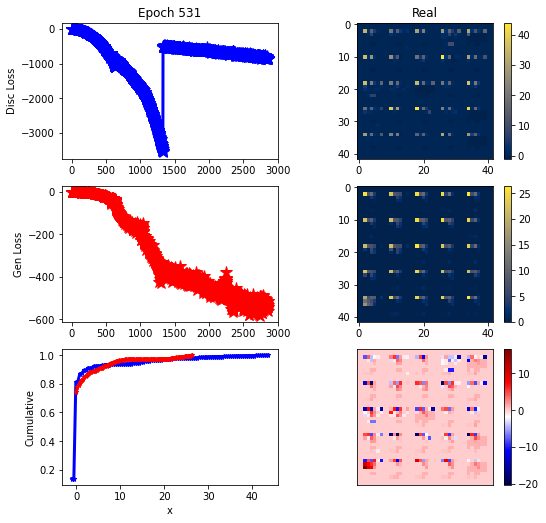

ErrG: -544.5322004045759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


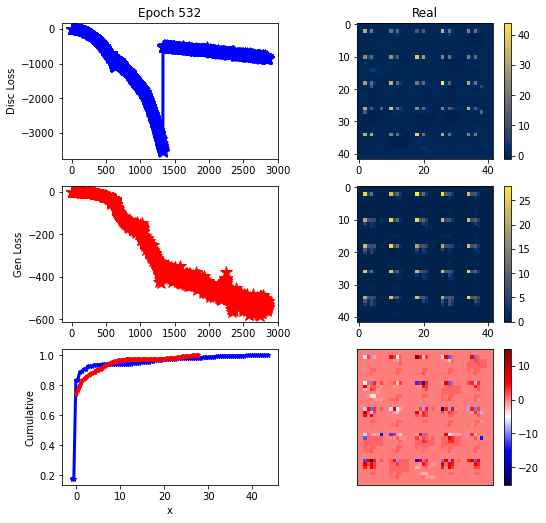

ErrG: -545.3940734863281, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


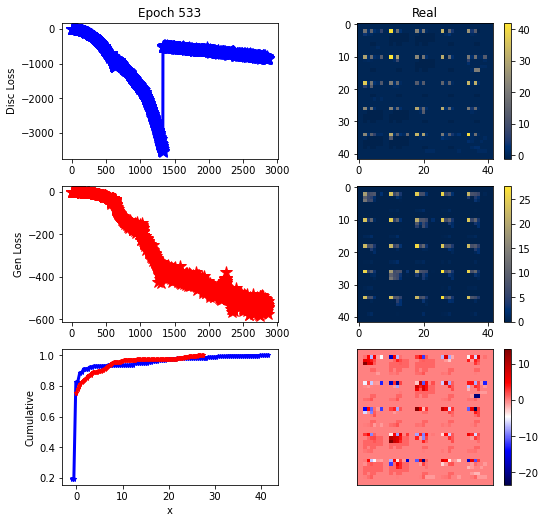

ErrG: -577.461164202009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


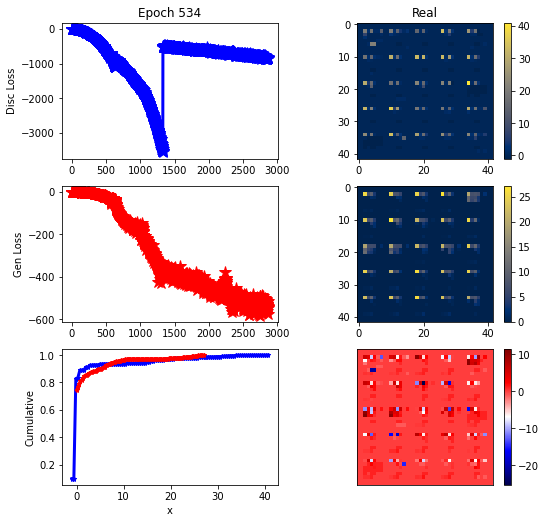

ErrG: -535.6226588657925, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


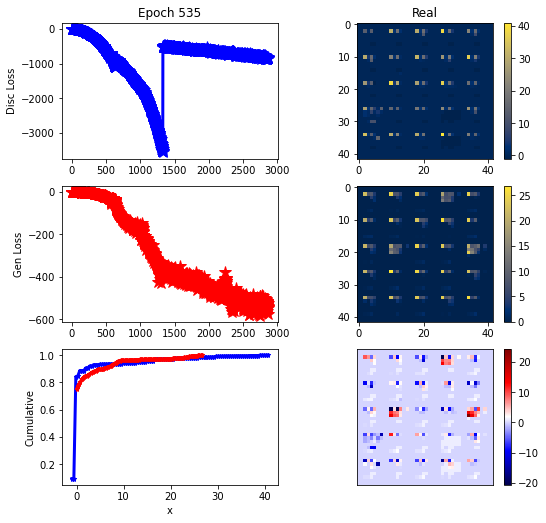

ErrG: -523.313969203404, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


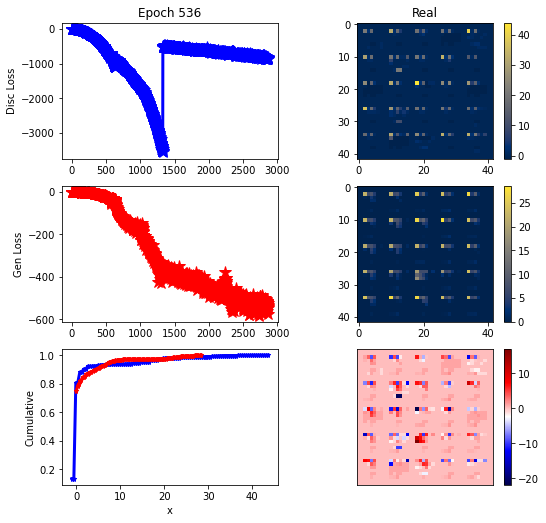

ErrG: -533.1312517438616, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


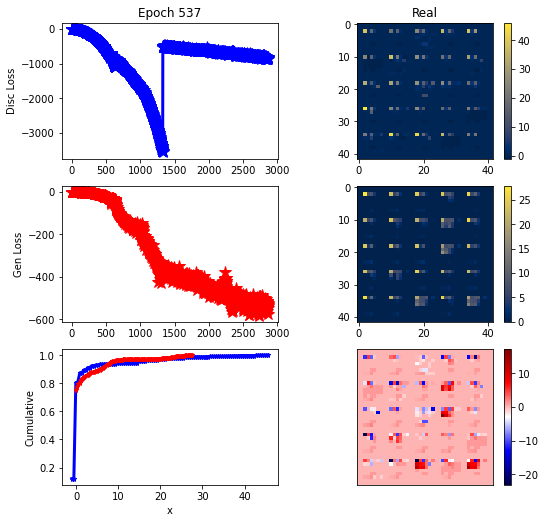

ErrG: -526.9631260463169, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


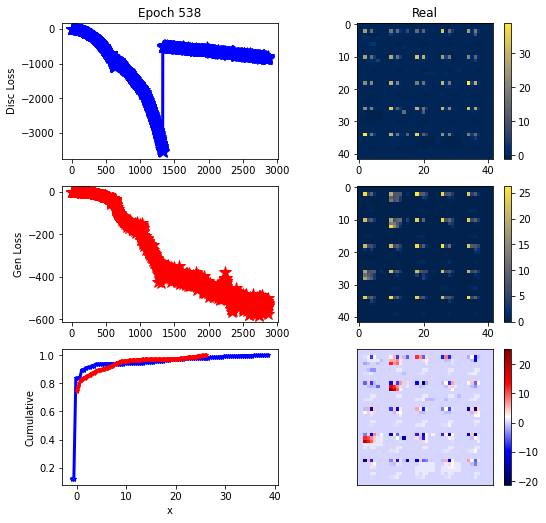

ErrG: -501.8767613002232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


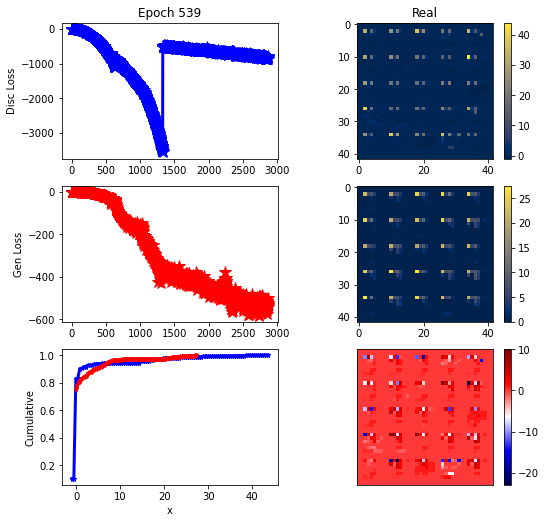

ErrG: -541.952165876116, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


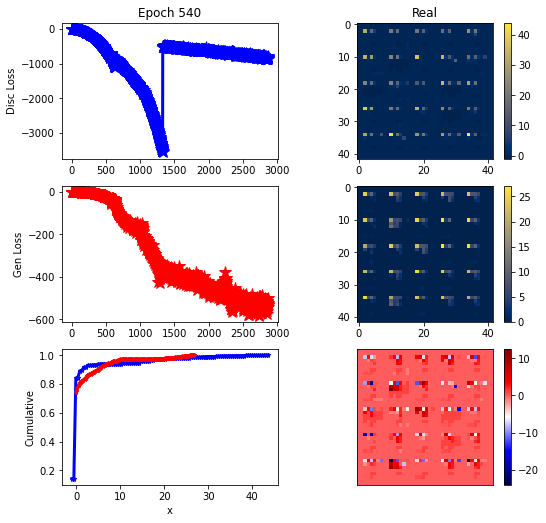

ErrG: -533.4777047293527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


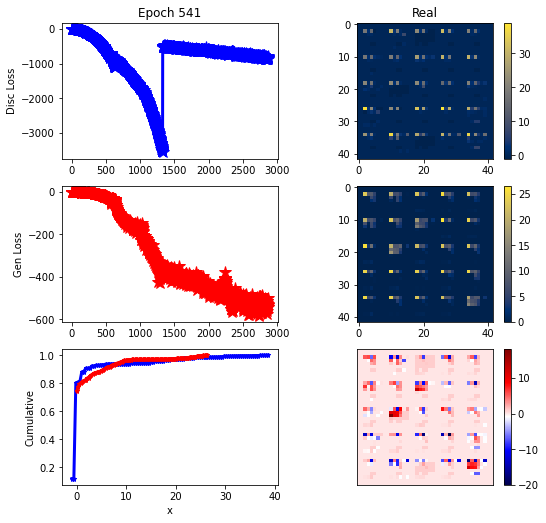

ErrG: -542.0818612234933, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


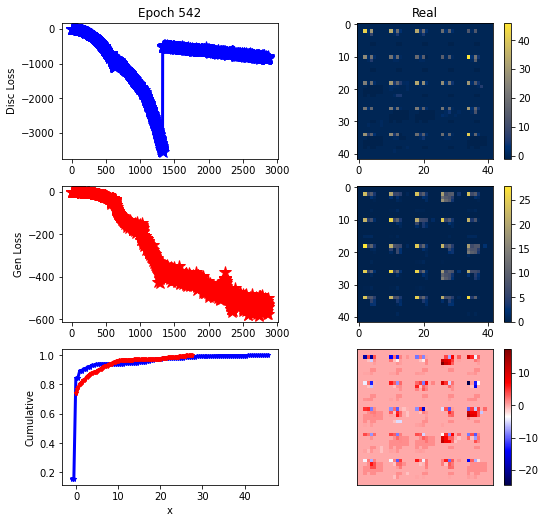

ErrG: -574.9418422154018, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


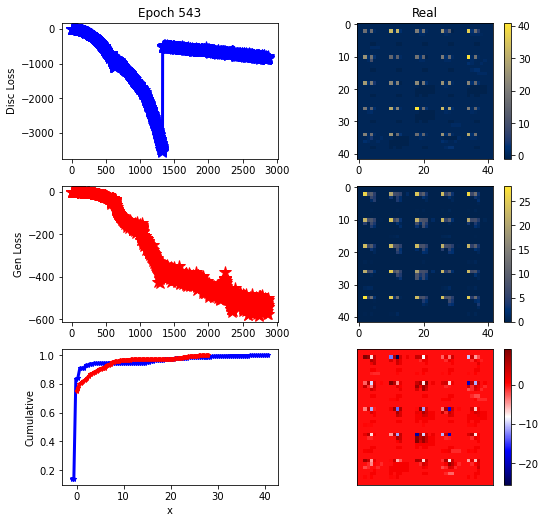

ErrG: -511.3695547921317, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


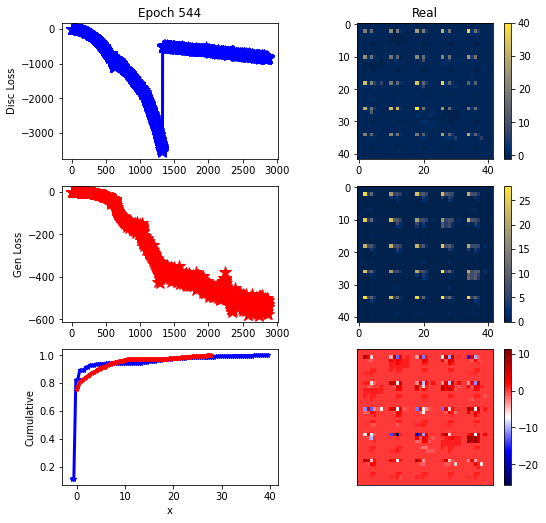

ErrG: -529.9040265764509, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


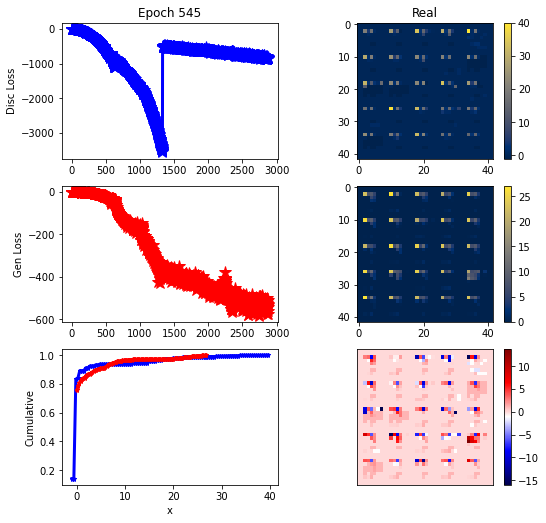

ErrG: -561.27195085798, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


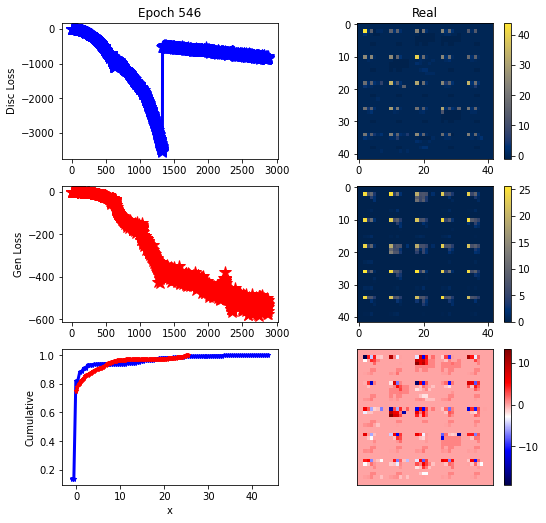

ErrG: -533.407976422991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


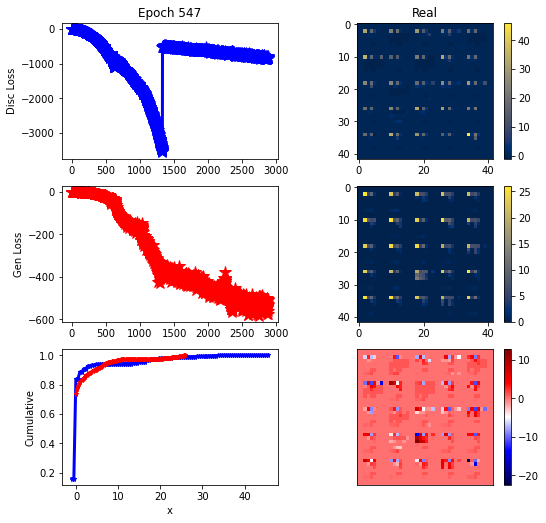

ErrG: -502.3880353655134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


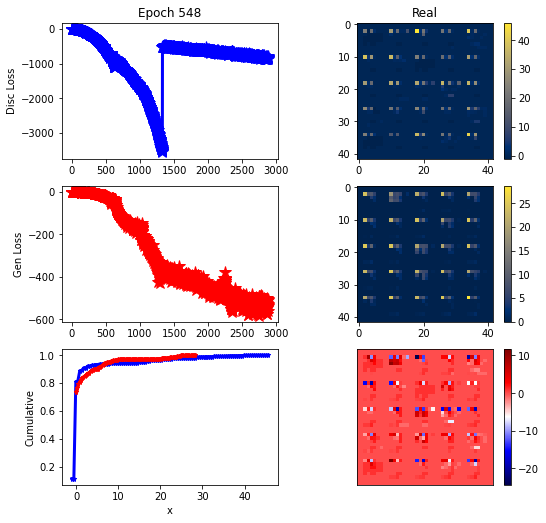

ErrG: -536.69626726423, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


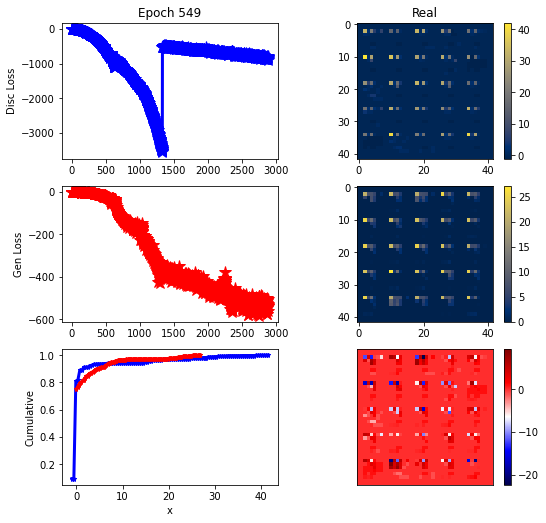

ErrG: -538.4366716657366, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


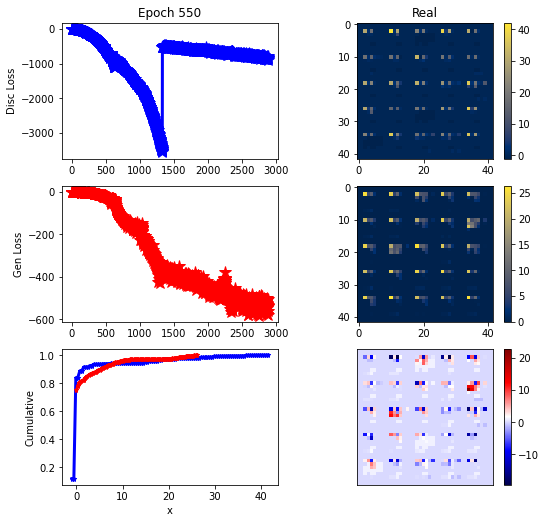

ErrG: -580.88427734375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


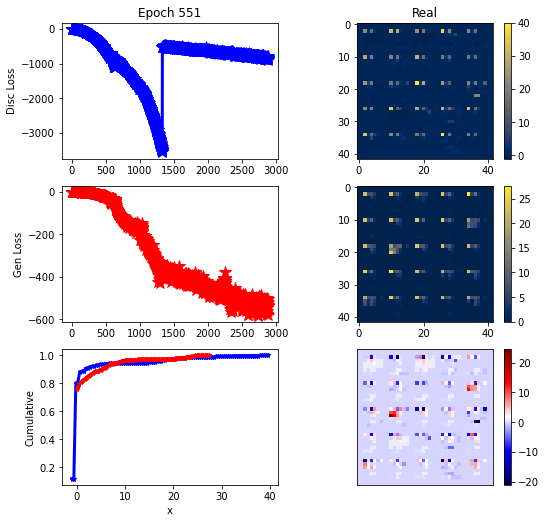

ErrG: -518.4398760114398, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


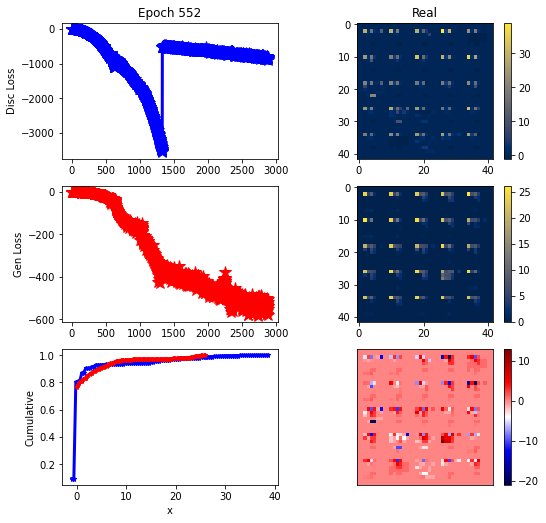

ErrG: -553.9750714983259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


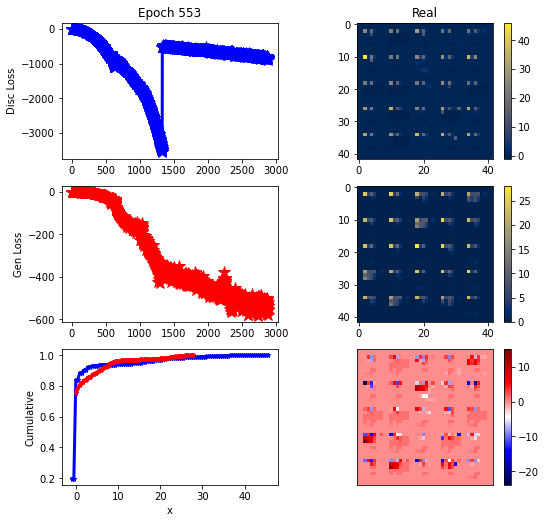

ErrG: -557.4792742047991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


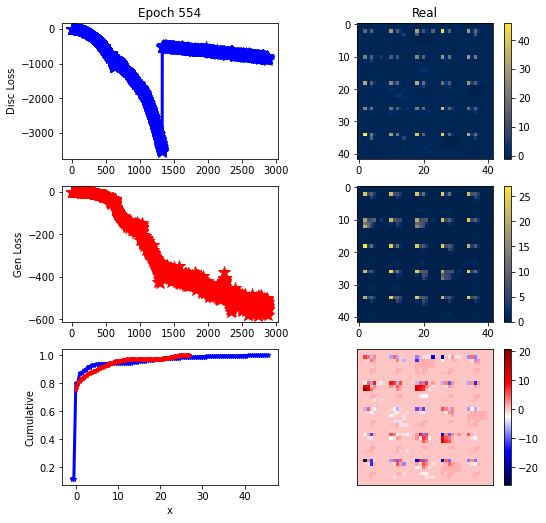

ErrG: -546.3695940290179, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


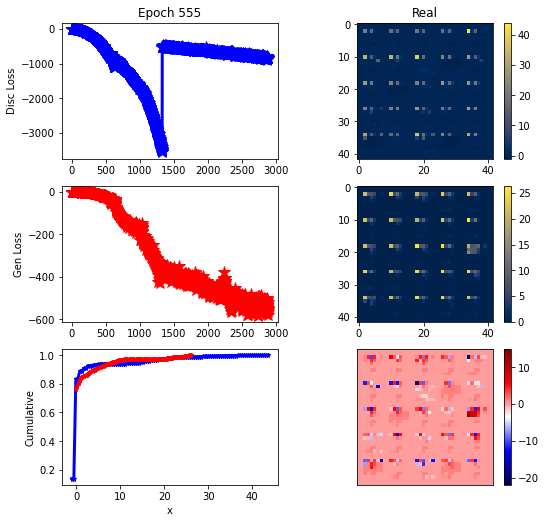

ErrG: -563.7034170968192, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


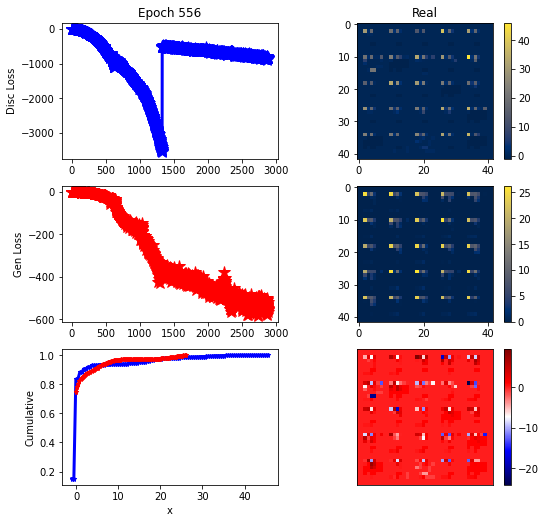

ErrG: -553.9130728585379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


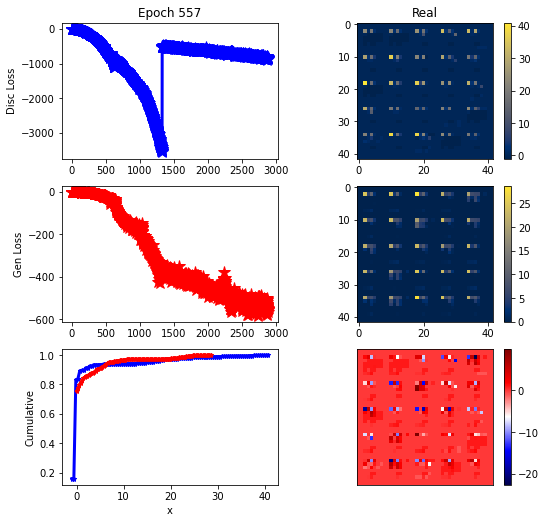

ErrG: -552.1443961007254, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


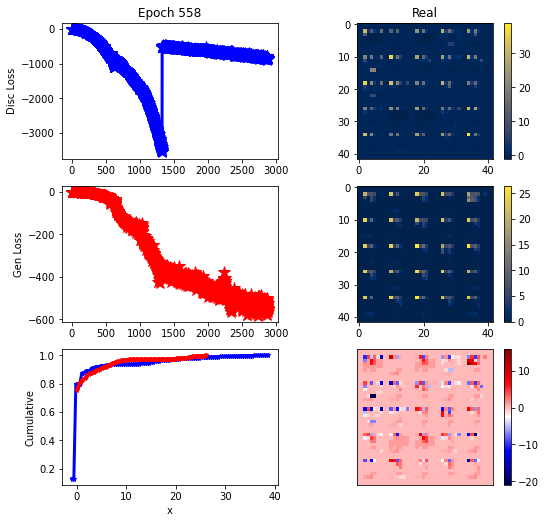

ErrG: -525.3318263462612, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


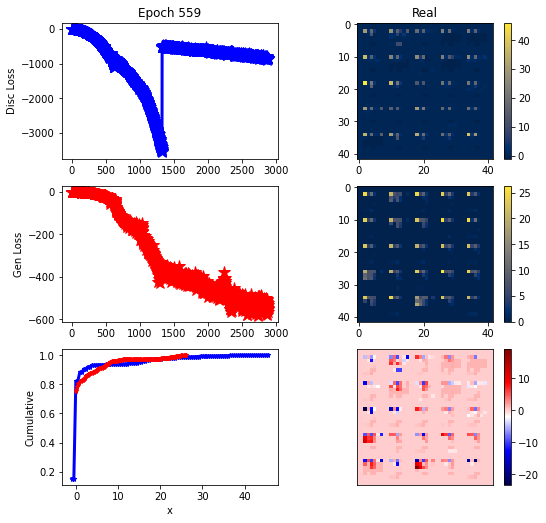

ErrG: -533.1150817871094, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


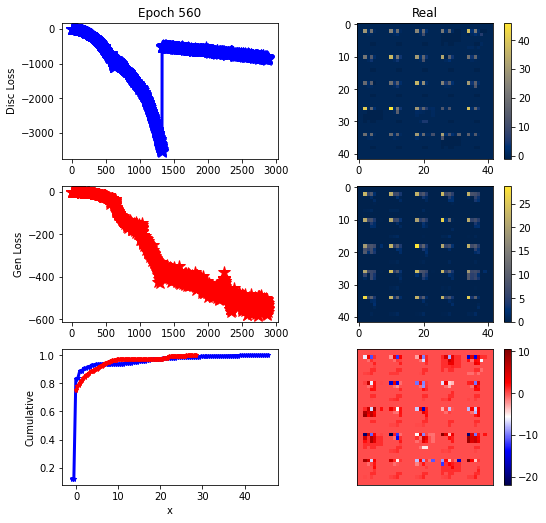

ErrG: -547.3726283482143, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


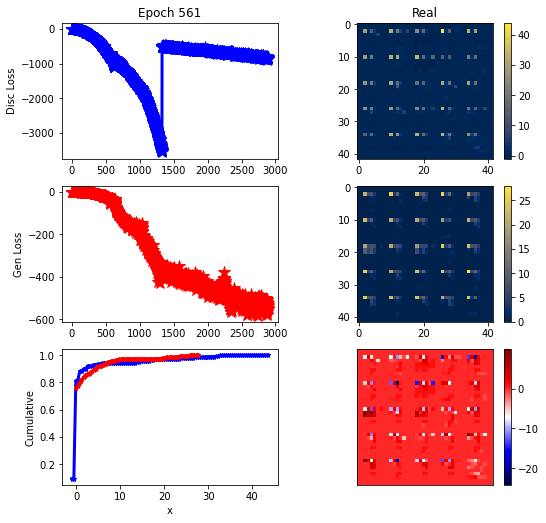

ErrG: -539.50392804827, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


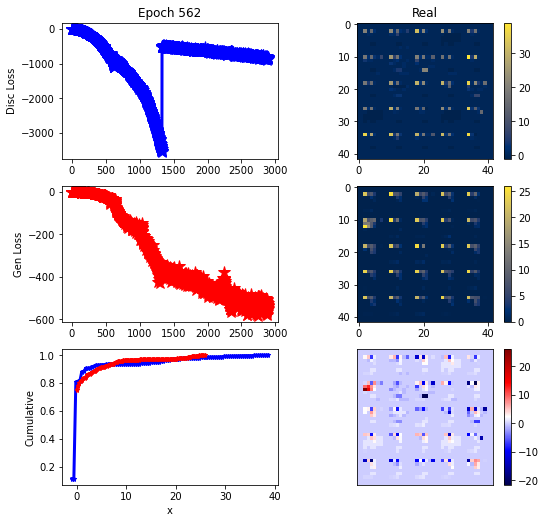

ErrG: -537.9620361328125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


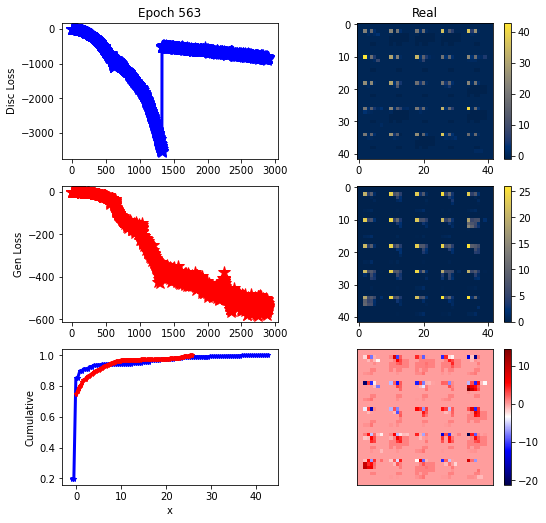

ErrG: -544.1362217494419, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


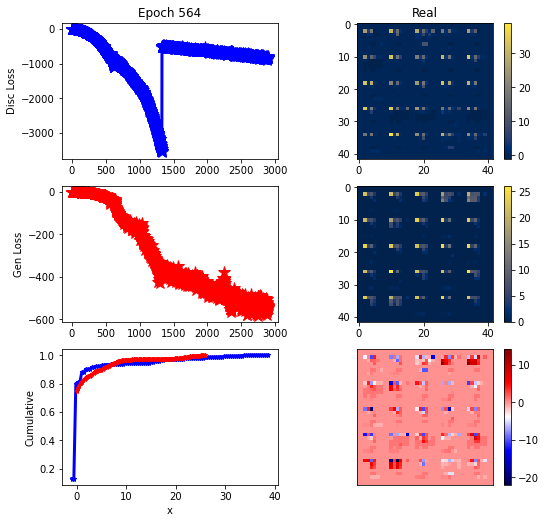

ErrG: -544.5247715541294, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


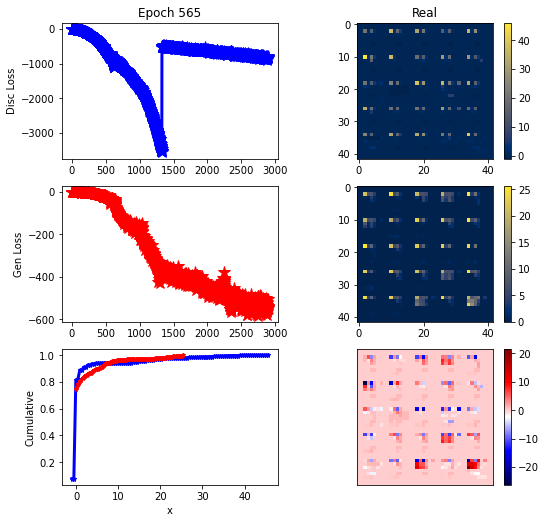

ErrG: -503.8706795828683, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


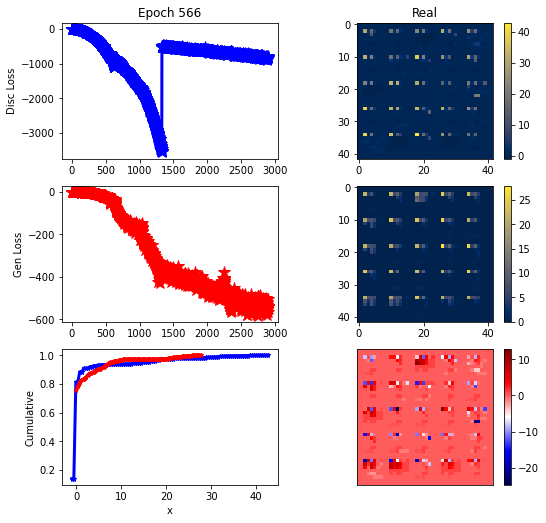

ErrG: -564.4495936802456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


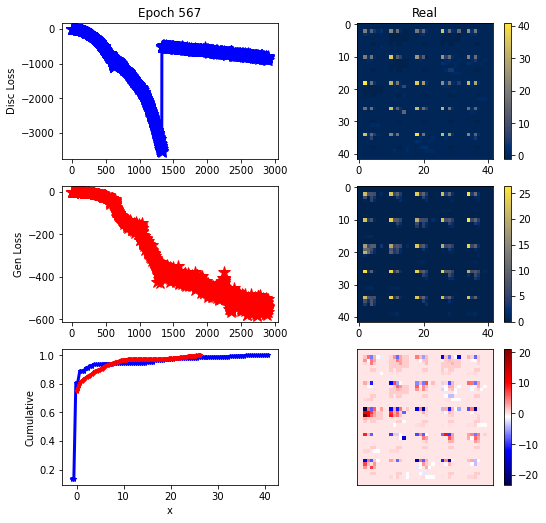

ErrG: -542.8873814174107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


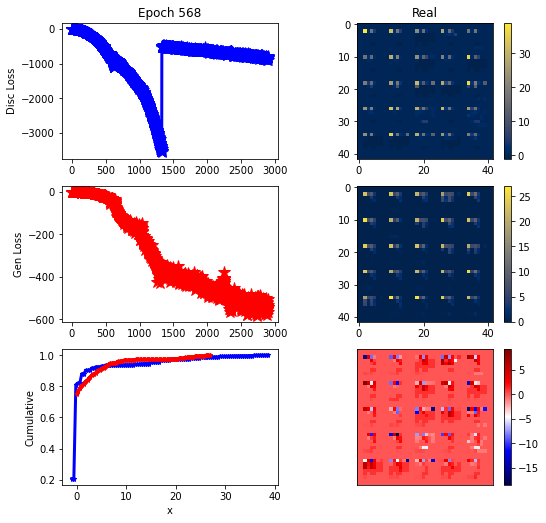

ErrG: -532.7407749720982, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


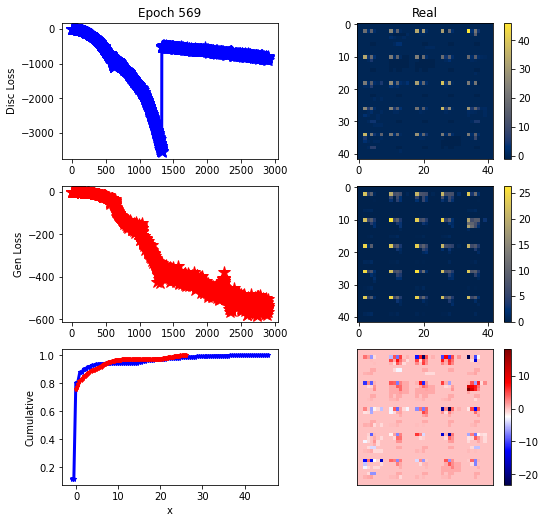

ErrG: -533.3785313197544, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


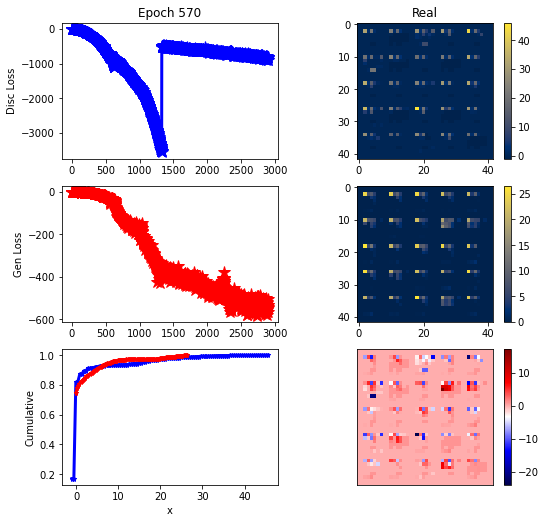

ErrG: -548.2995997837612, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


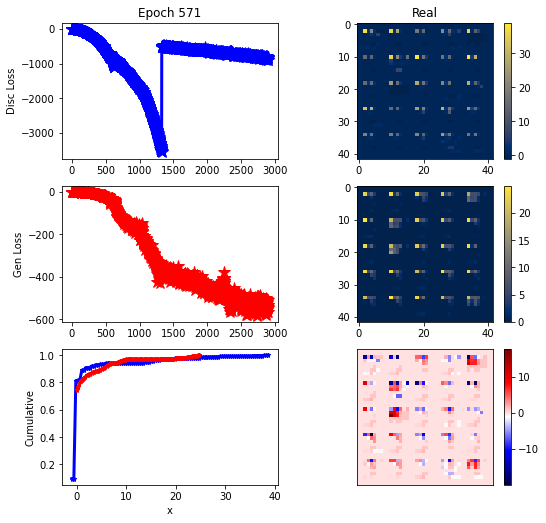

ErrG: -509.5516880580357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


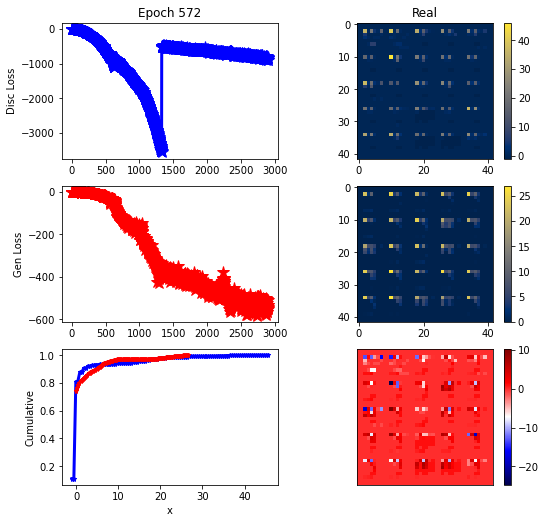

ErrG: -549.9345615931919, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


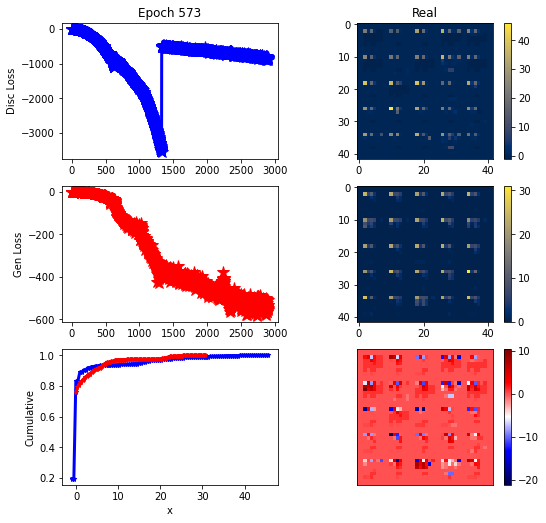

ErrG: -557.9854256766183, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


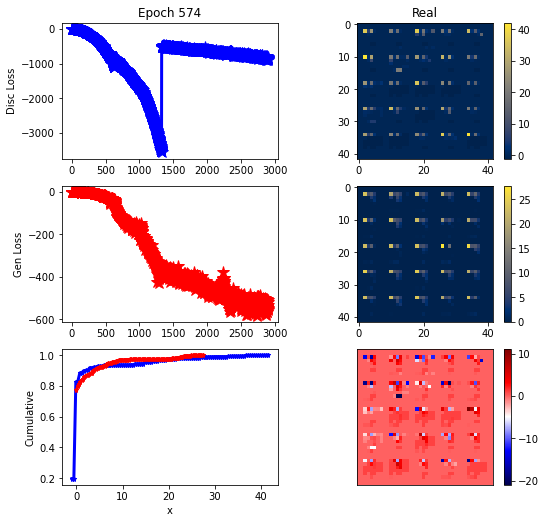

ErrG: -520.4535304478237, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


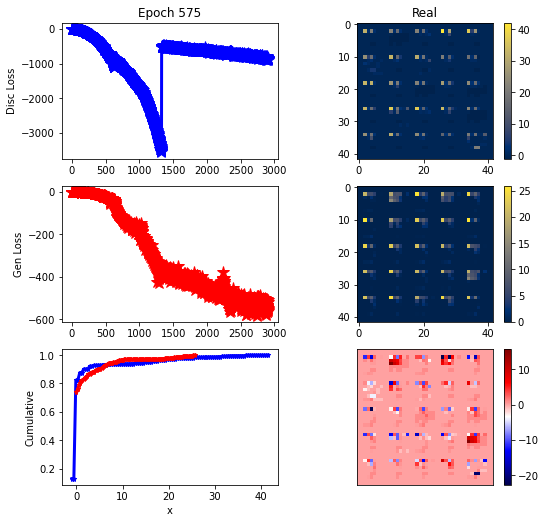

ErrG: -560.3810729980469, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


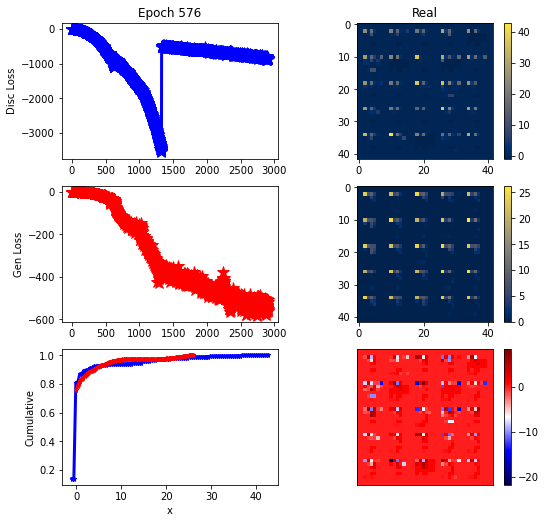

ErrG: -558.8739972795759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


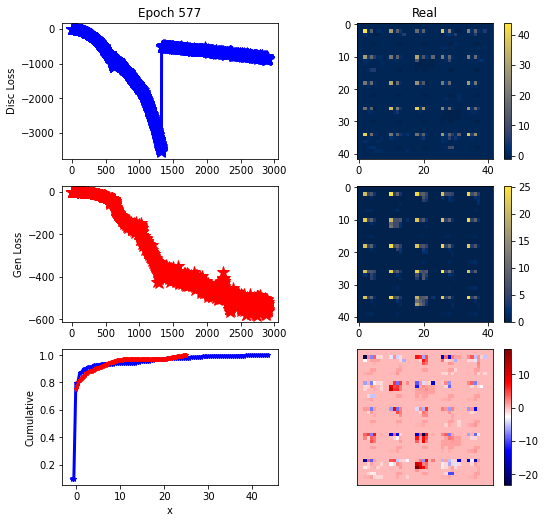

ErrG: -528.4329790387835, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


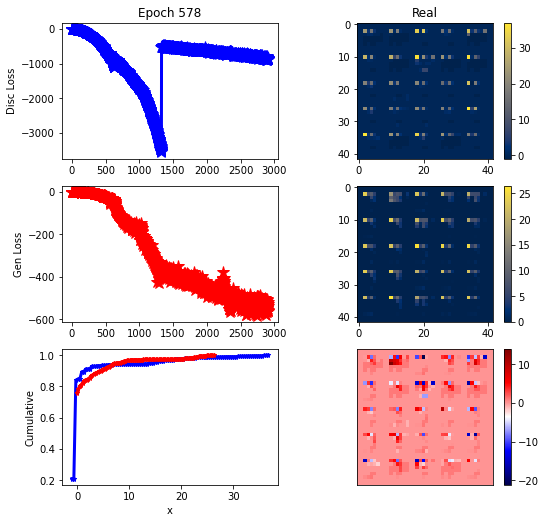

ErrG: -535.3138514927456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


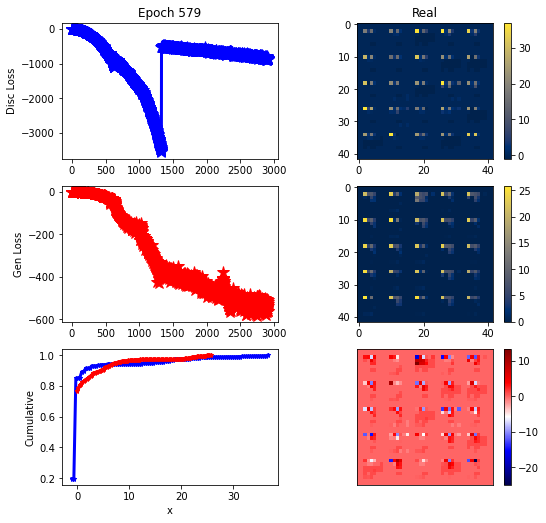

ErrG: -507.46690586635043, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


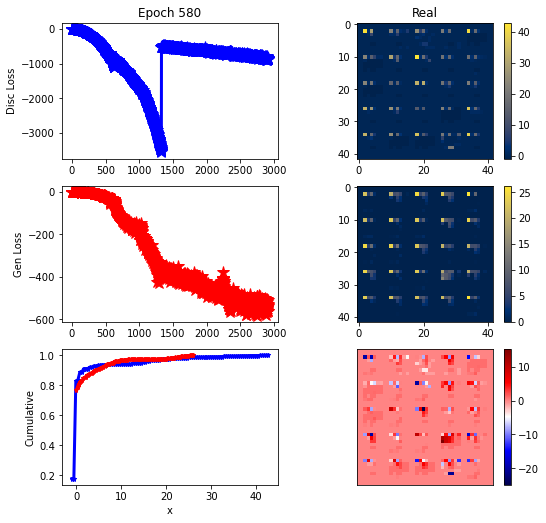

ErrG: -534.0170331682477, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


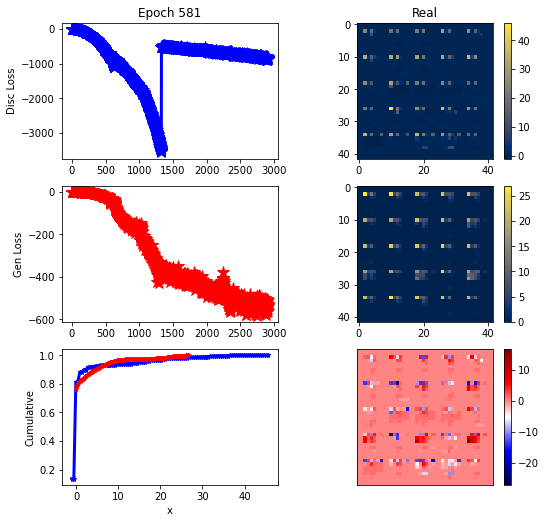

ErrG: -534.7418212890625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


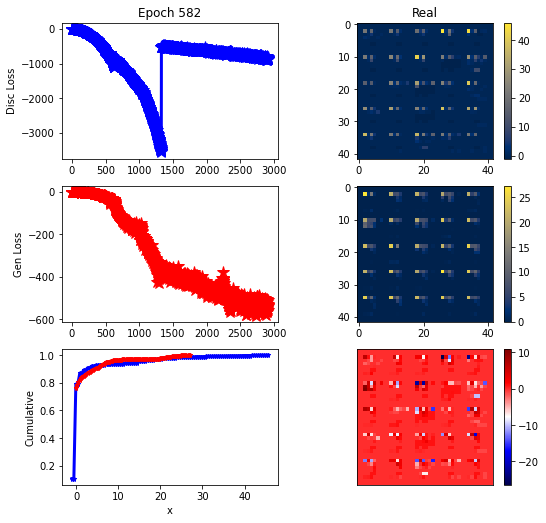

ErrG: -558.1425083705357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


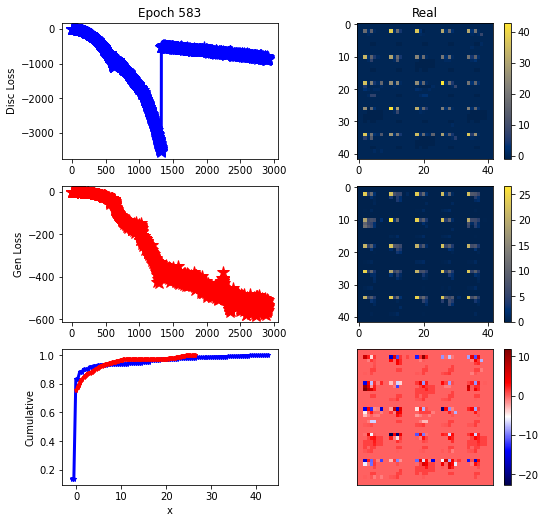

ErrG: -543.6240583147321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


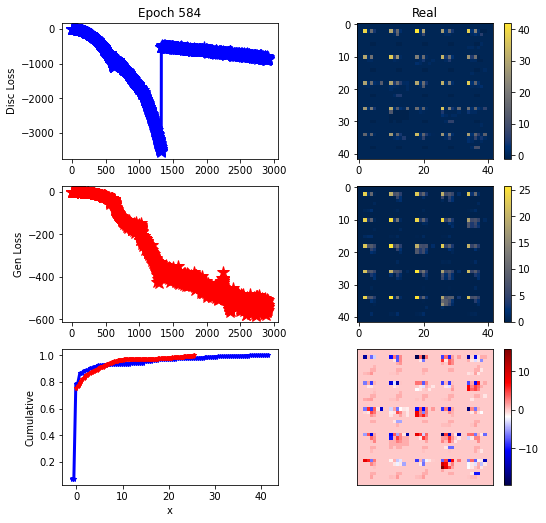

ErrG: -542.091792515346, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


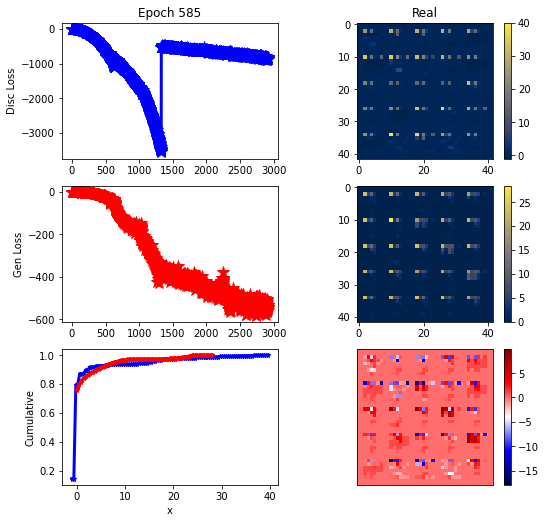

ErrG: -545.8838544573102, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


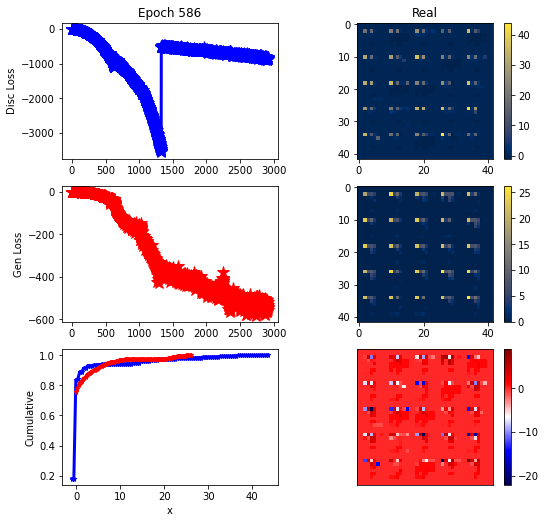

ErrG: -518.6033848353794, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


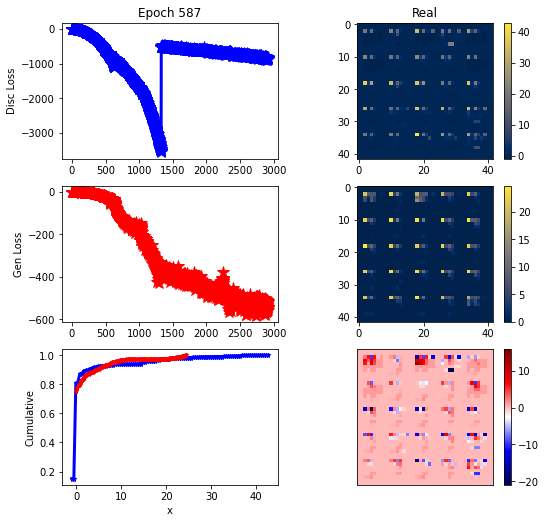

ErrG: -514.791264125279, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


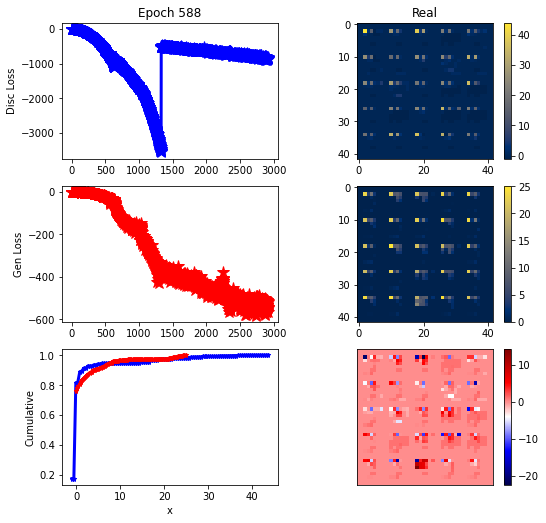

ErrG: -565.004660470145, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


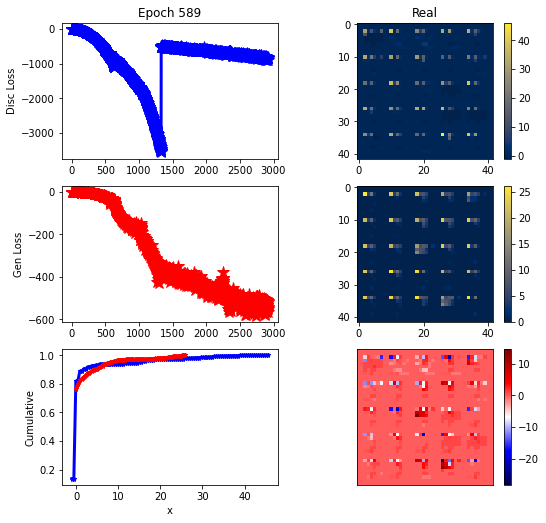

ErrG: -552.2335379464286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


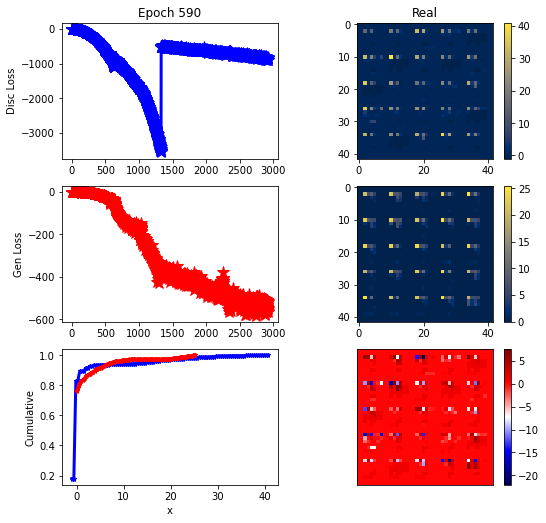

ErrG: -561.2524675641741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


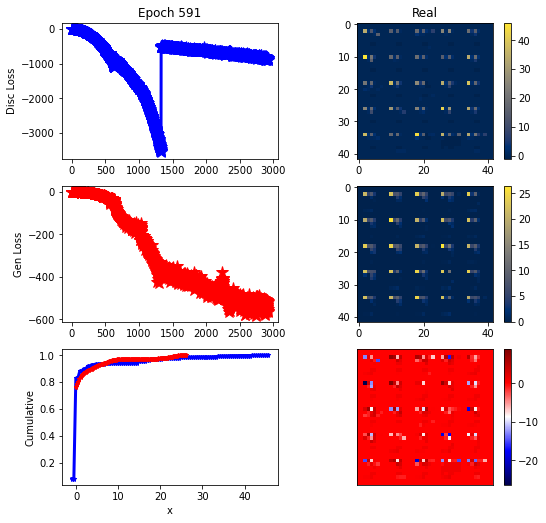

ErrG: -559.5673217773438, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


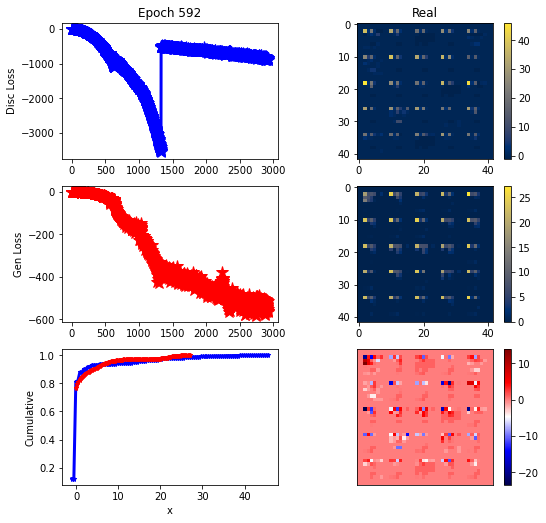

ErrG: -562.3228585379464, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


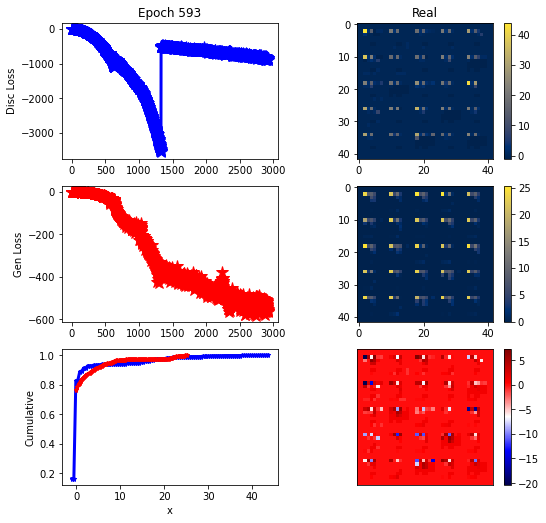

ErrG: -554.4363882882254, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


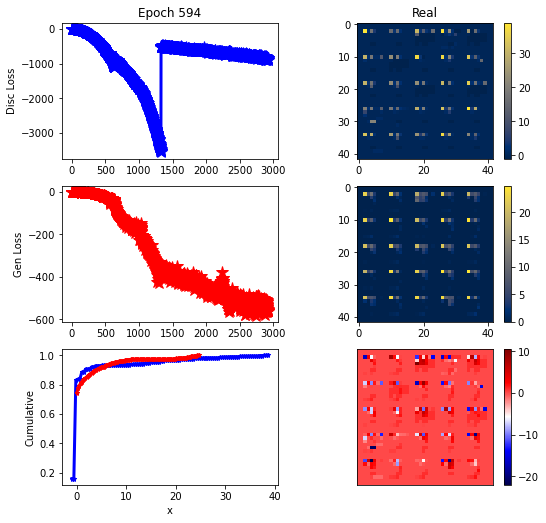

ErrG: -556.3373761858259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


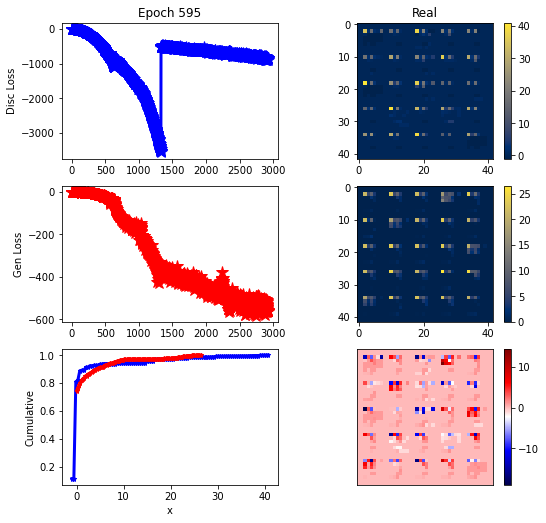

ErrG: -561.9408569335938, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


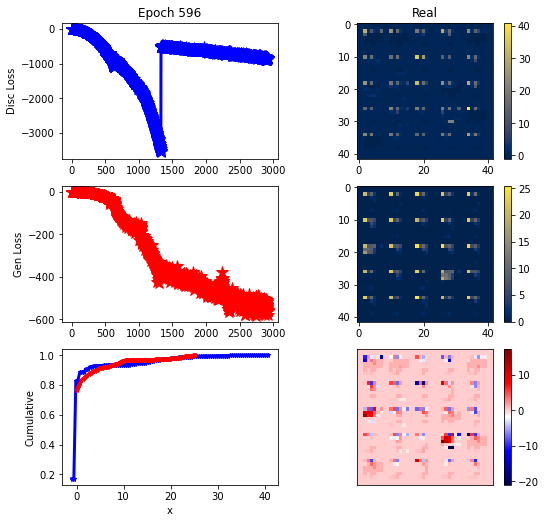

ErrG: -579.3641095842634, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


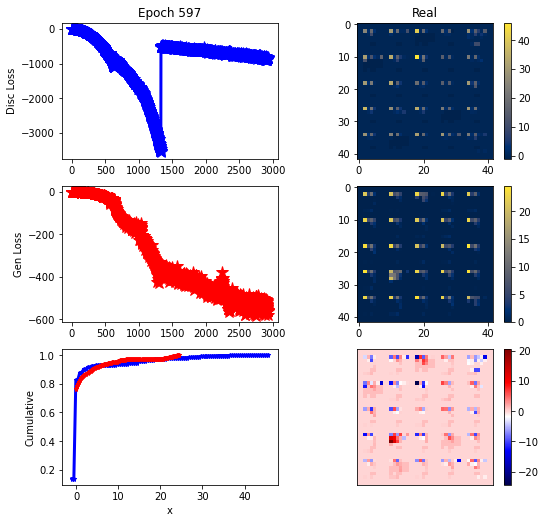

ErrG: -562.8333696637835, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


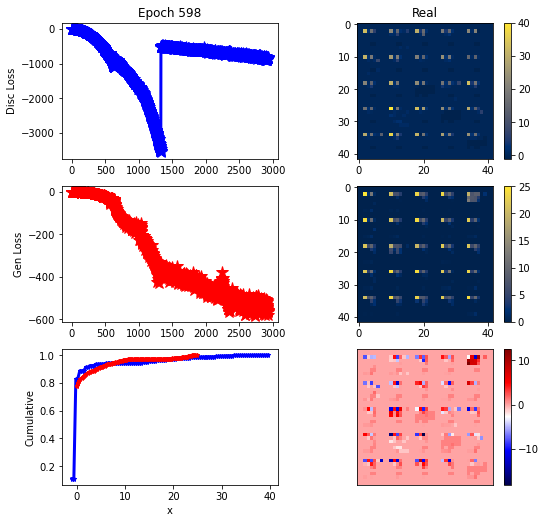

ErrG: -568.0748814174107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


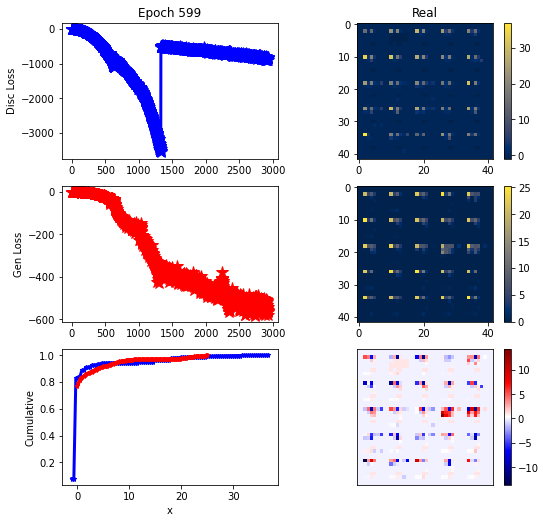

ErrG: -543.4227382114956, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


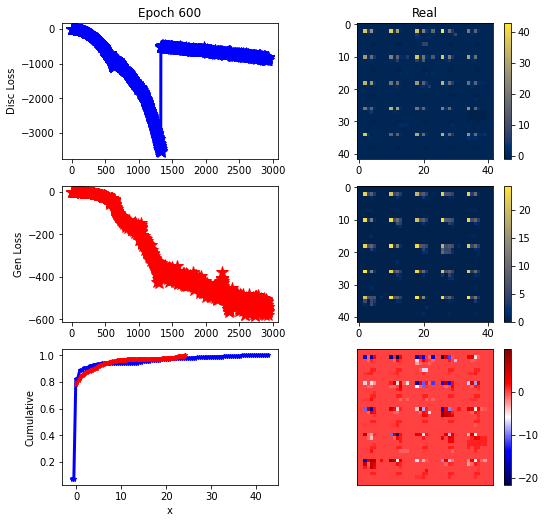

ErrG: -544.5203770228794, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


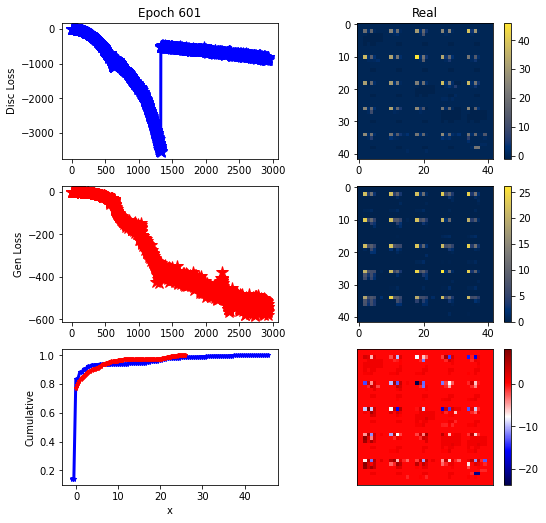

ErrG: -525.9855085100446, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


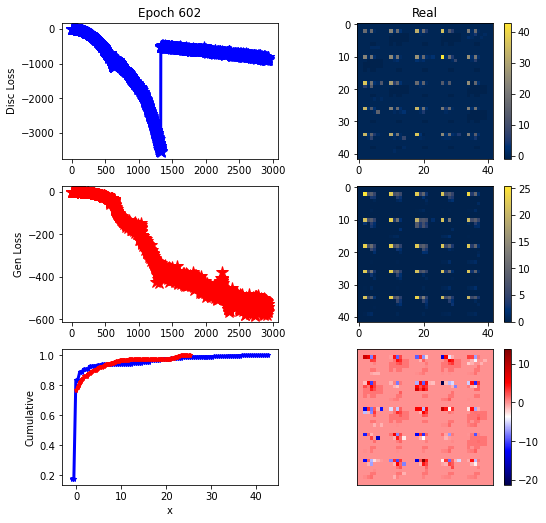

ErrG: -530.2902570452009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


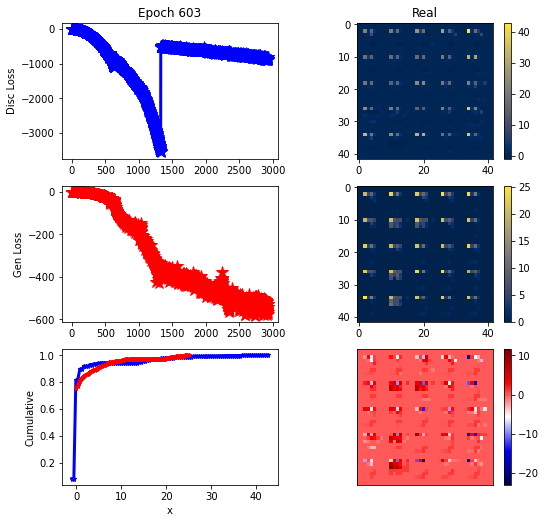

ErrG: -573.9277212960379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


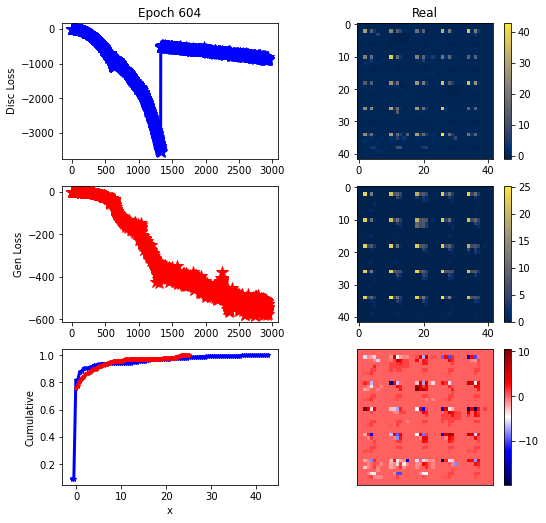

ErrG: -545.4120701381138, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


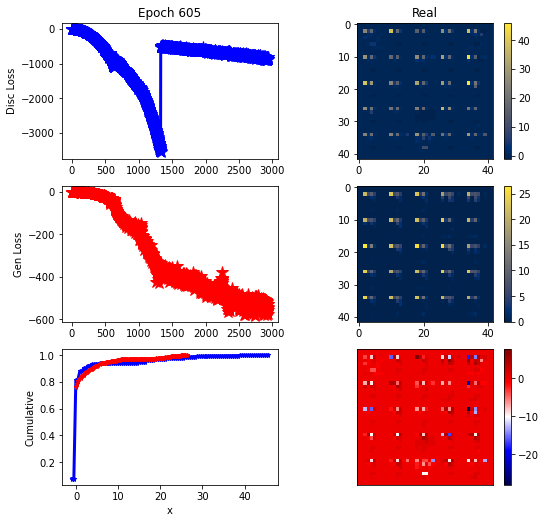

ErrG: -556.3927830287388, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


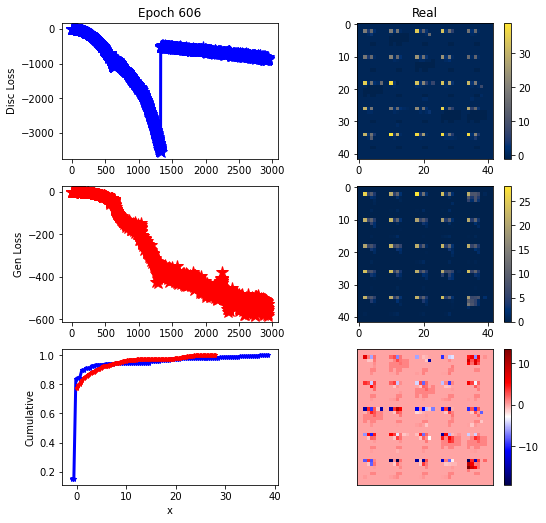

ErrG: -582.6175449916294, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


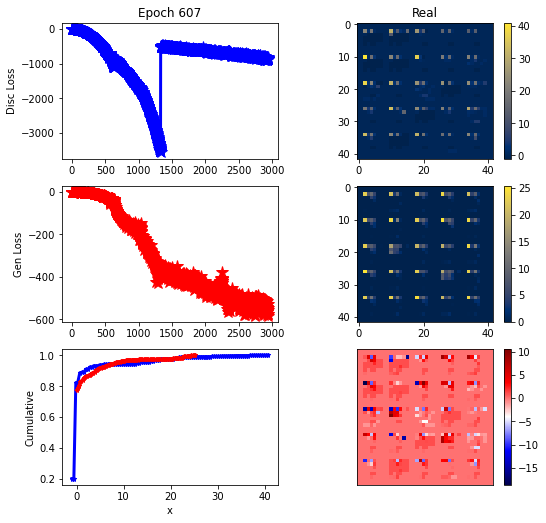

ErrG: -576.2108851841518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


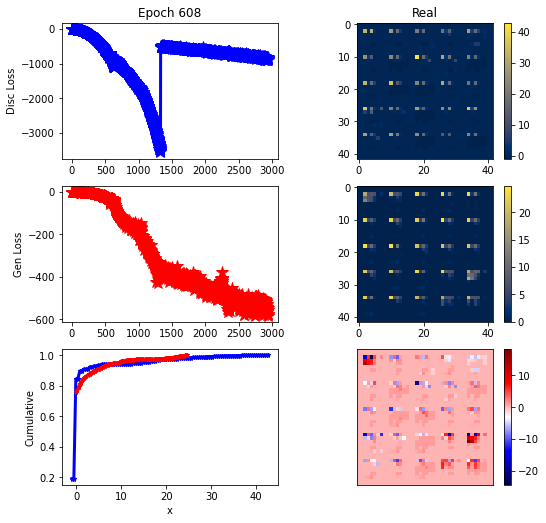

ErrG: -579.6229989188058, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


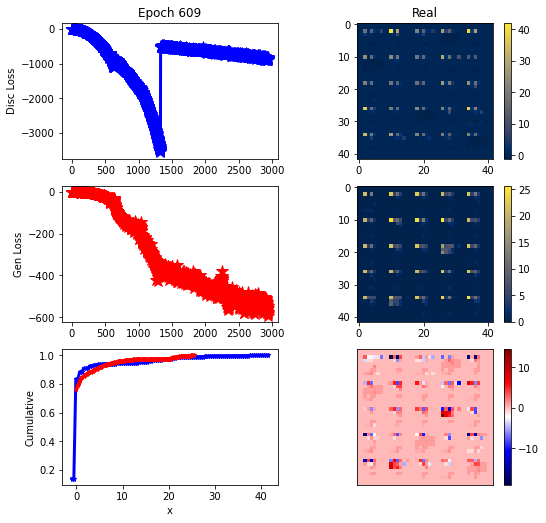

ErrG: -592.0876552036831, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


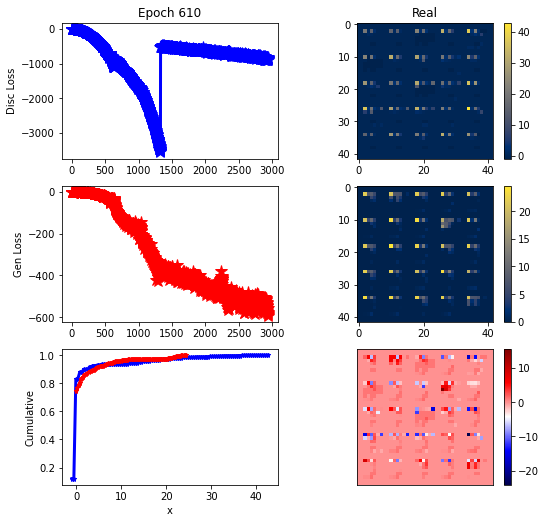

ErrG: -587.7376621791294, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


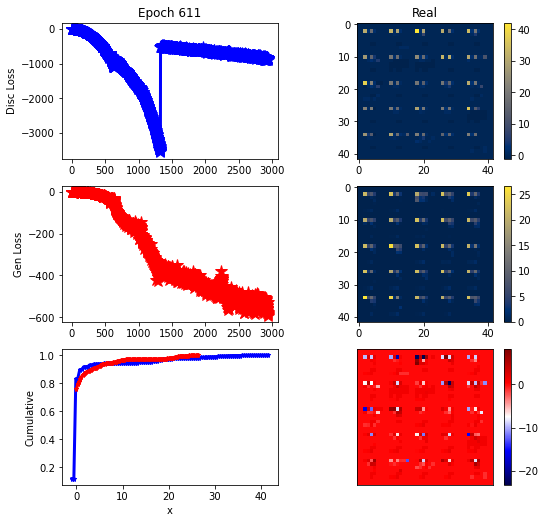

ErrG: -526.1330043247768, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


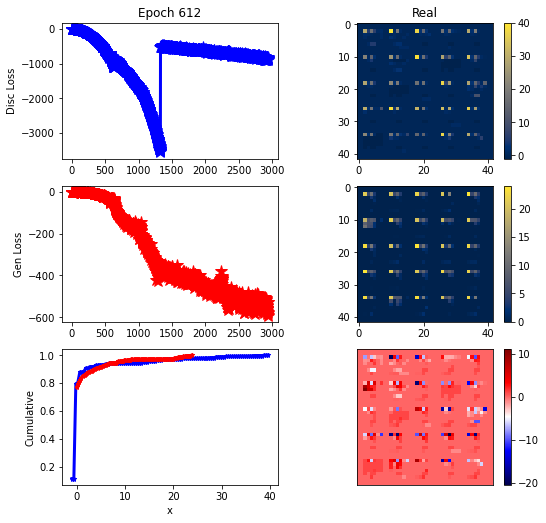

ErrG: -525.2607029506138, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


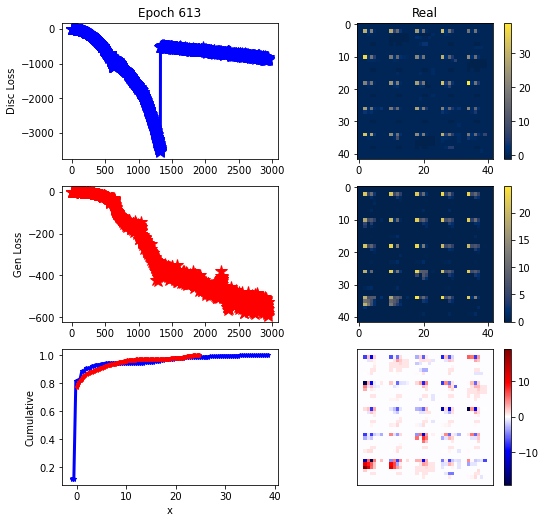

ErrG: -558.5946829659598, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


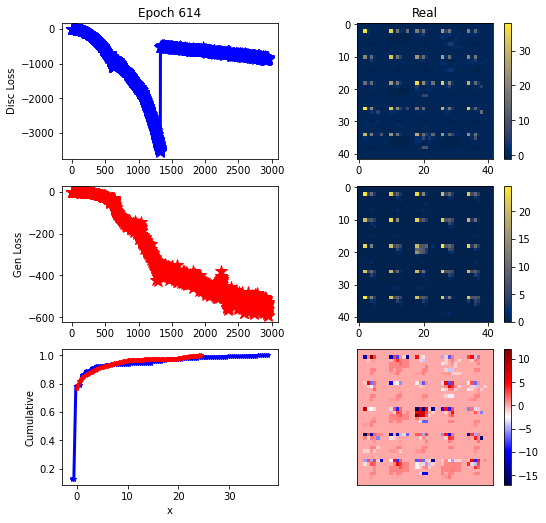

ErrG: -536.490944998605, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


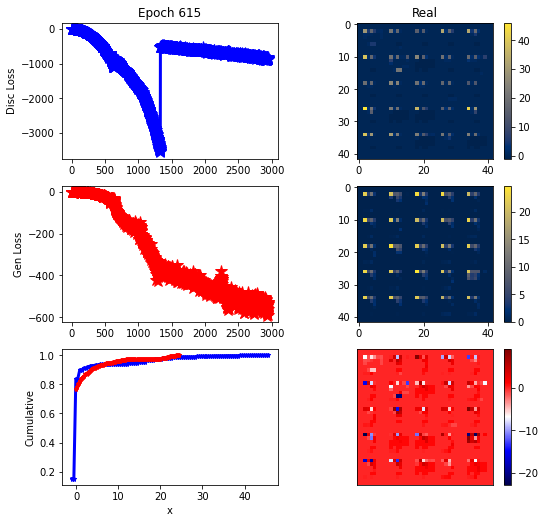

ErrG: -530.4421779087612, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


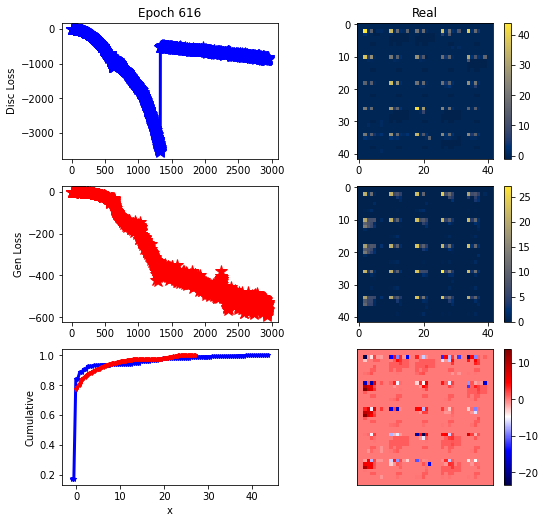

ErrG: -564.9379621233259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


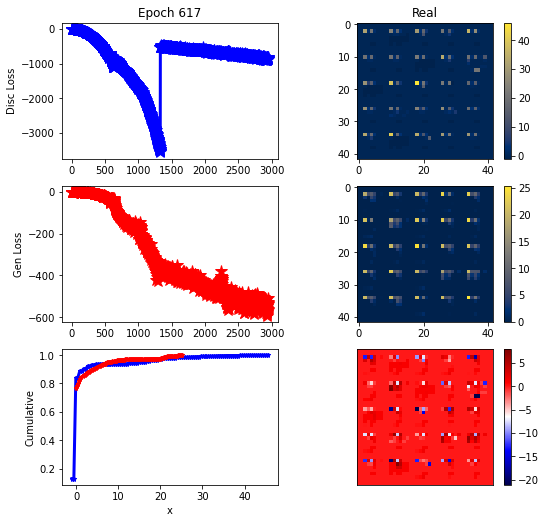

ErrG: -509.15628487723217, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


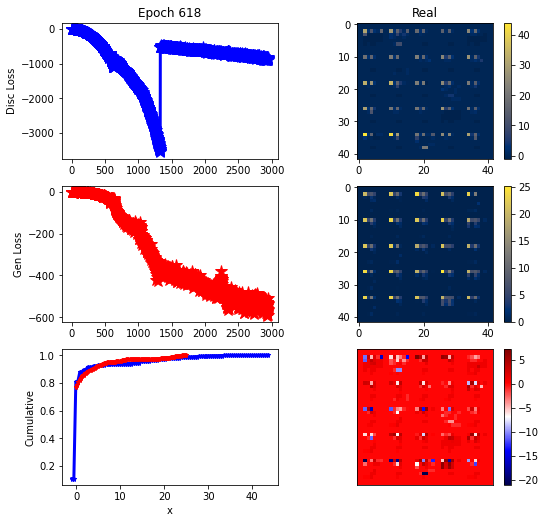

ErrG: -590.8113141741071, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


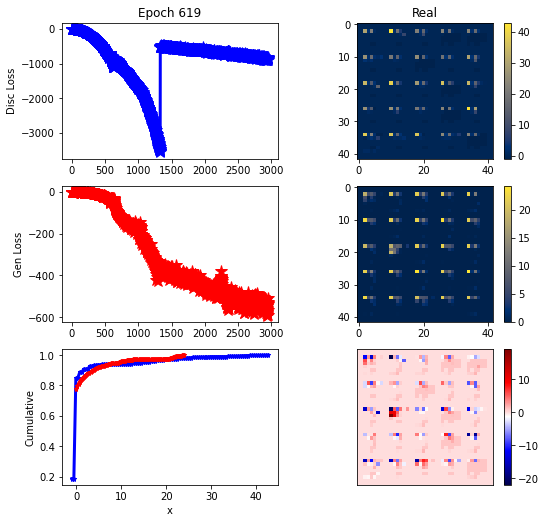

ErrG: -528.021706717355, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


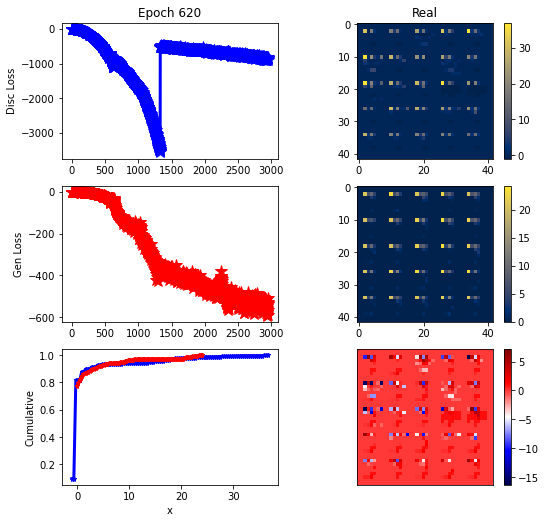

ErrG: -537.243634905134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


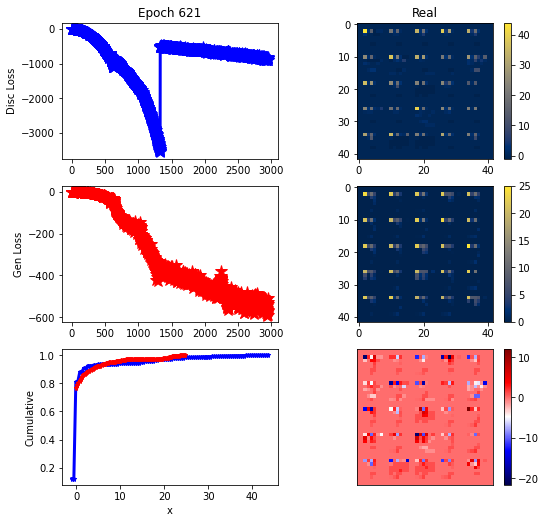

ErrG: -567.9324210030692, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


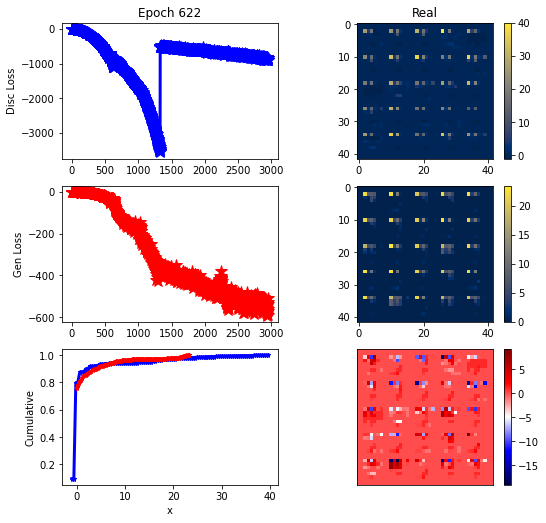

ErrG: -560.5767822265625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


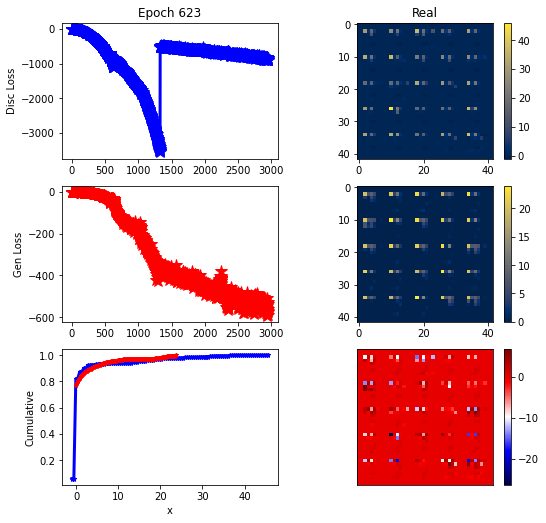

ErrG: -576.6338631766183, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


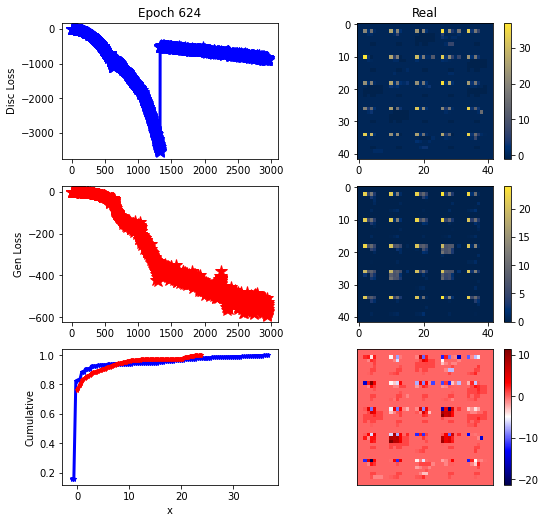

ErrG: -548.2322605678013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


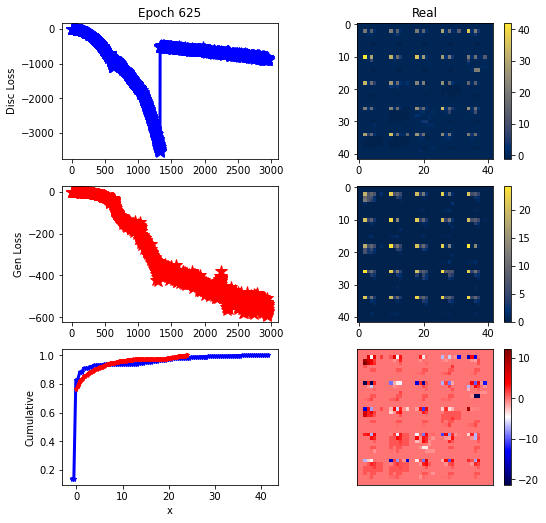

ErrG: -539.0881870814732, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


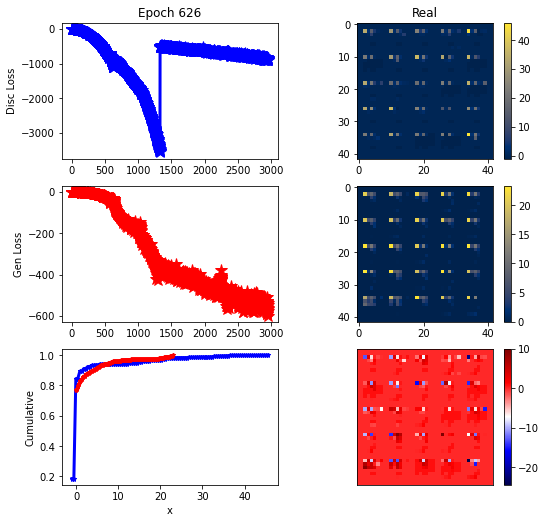

ErrG: -597.8410993303571, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


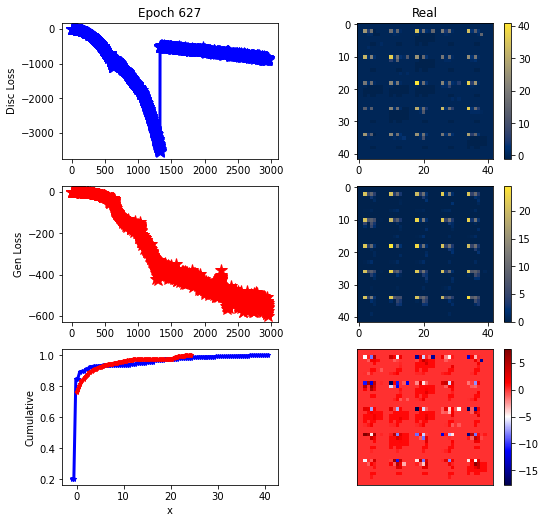

ErrG: -557.650634765625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


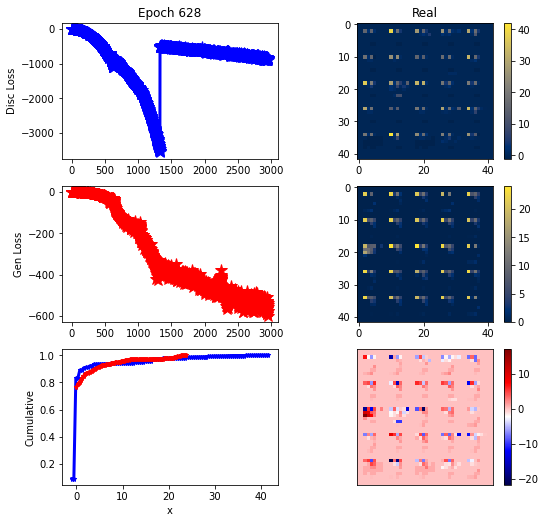

ErrG: -575.9838082449777, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


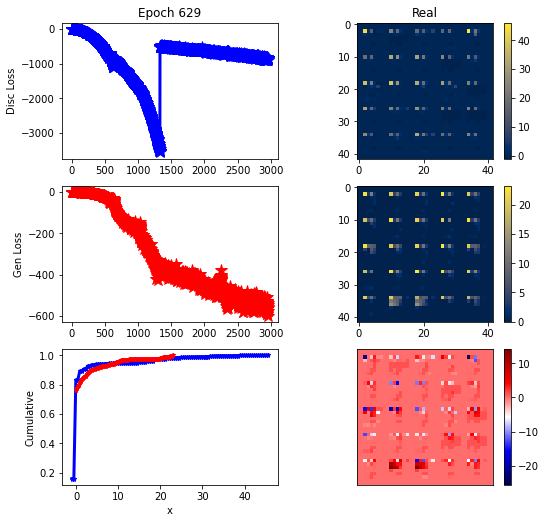

ErrG: -561.3016706194196, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


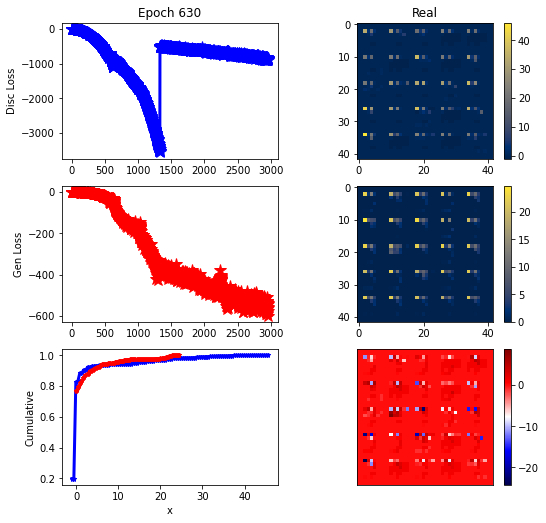

ErrG: -541.0630798339844, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


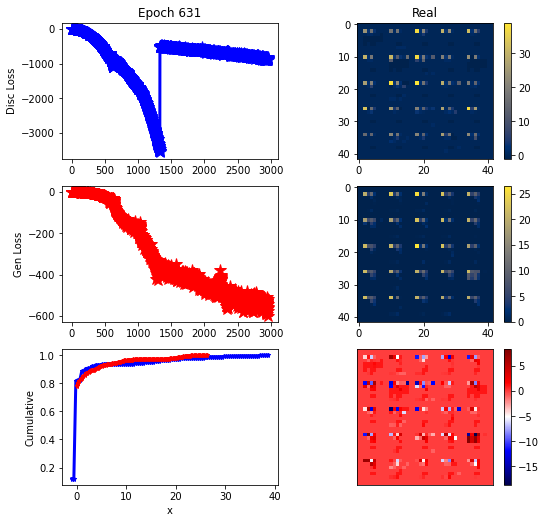

ErrG: -518.0276968819754, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


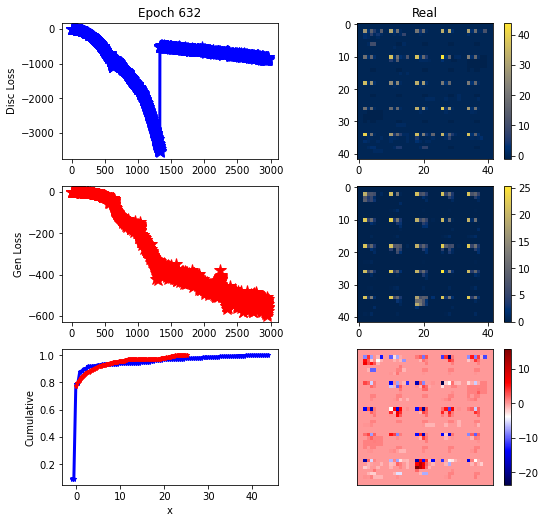

ErrG: -555.3620169503348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


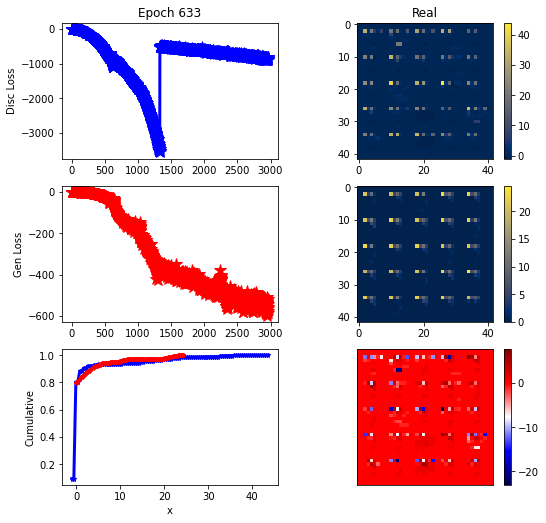

ErrG: -586.9393310546875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


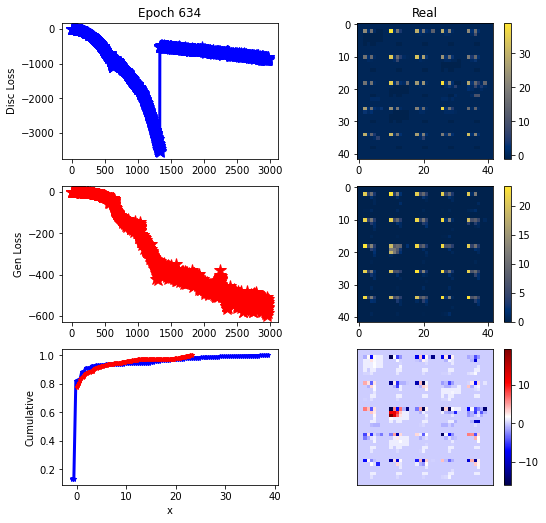

ErrG: -532.7279357910156, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


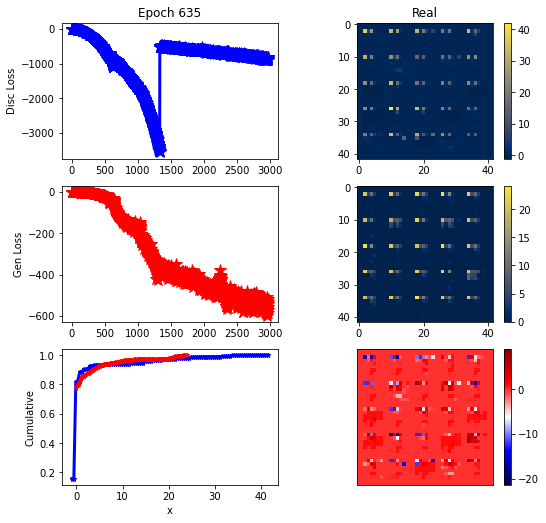

ErrG: -573.2064993722098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


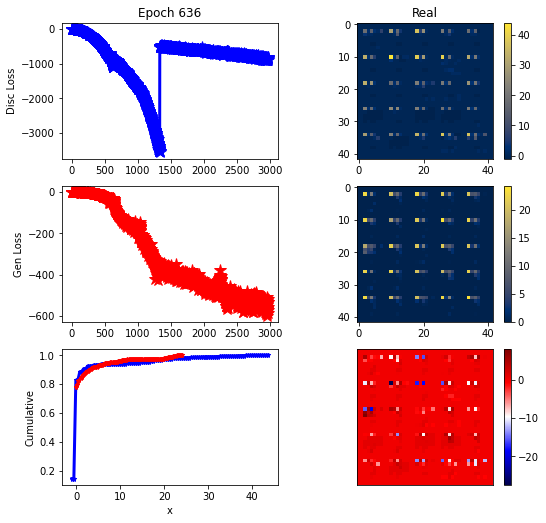

ErrG: -532.7852913992746, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


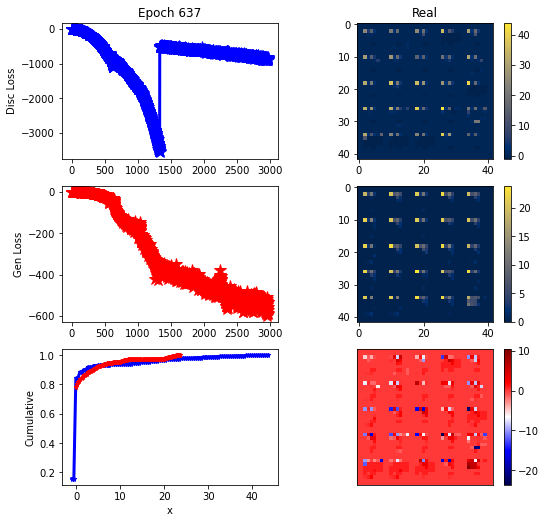

ErrG: -590.0902840750558, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


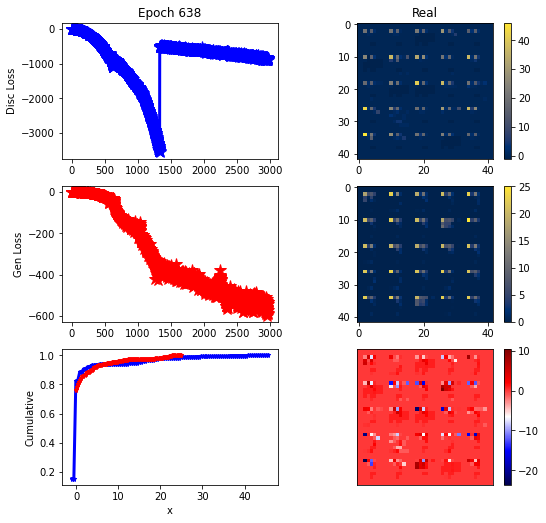

ErrG: -544.0511997767857, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


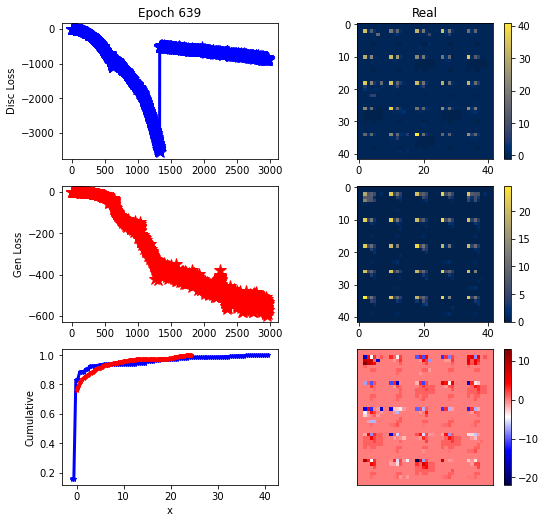

ErrG: -570.1941397530692, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


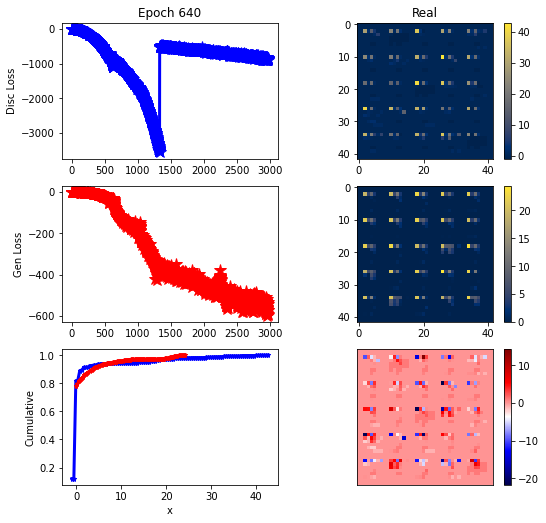

ErrG: -592.7975943429129, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


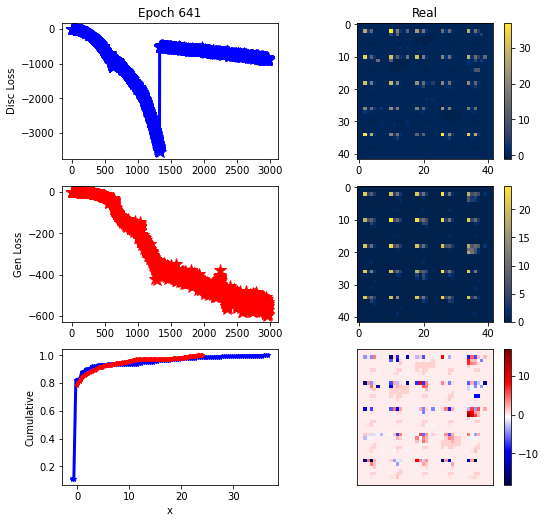

ErrG: -551.7651890345982, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


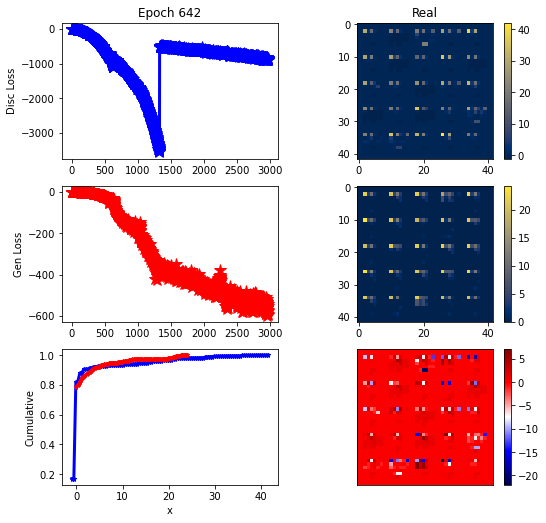

ErrG: -577.9281441824777, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


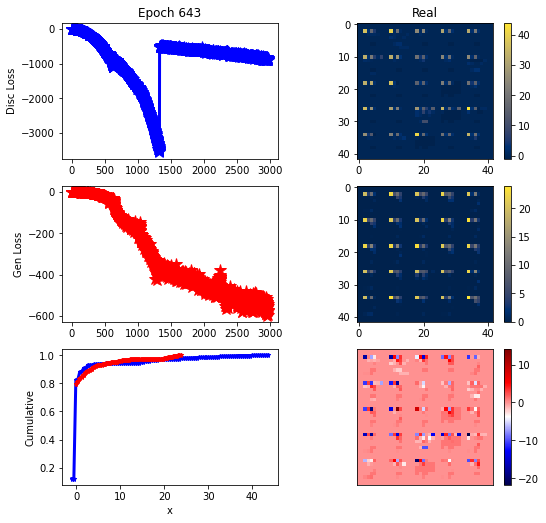

ErrG: -572.2543422154018, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


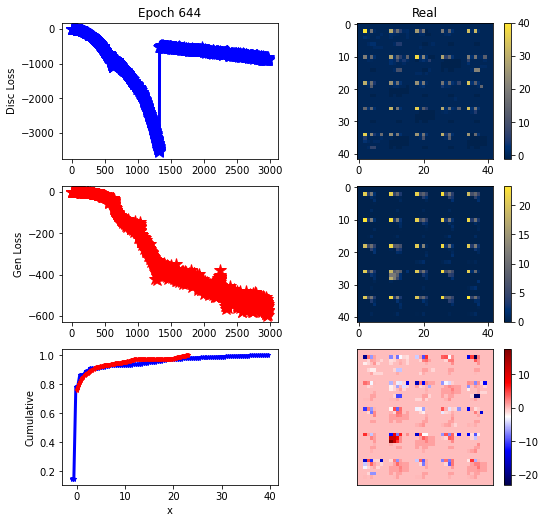

ErrG: -543.4211120605469, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


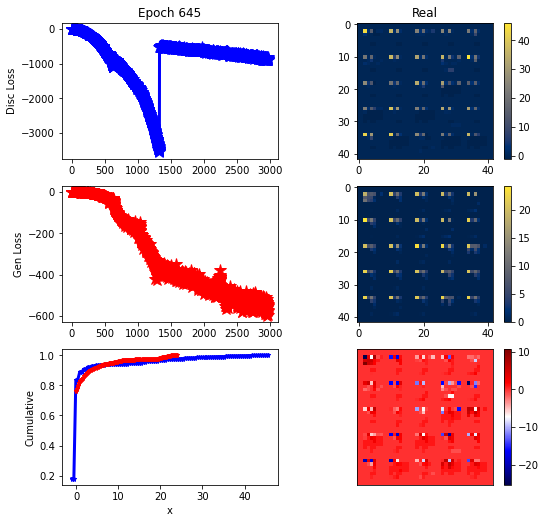

ErrG: -546.7747628348214, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


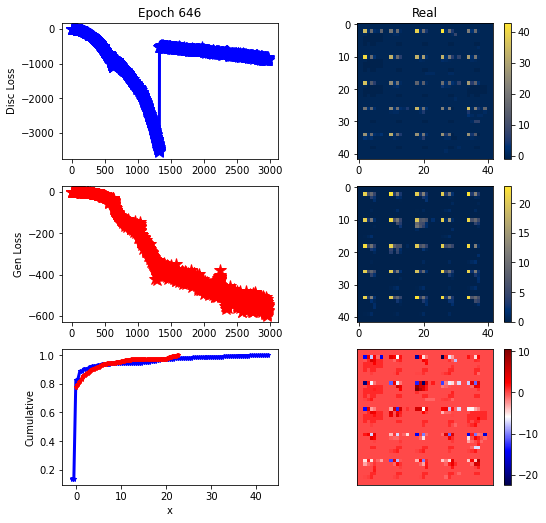

ErrG: -549.7734244210379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


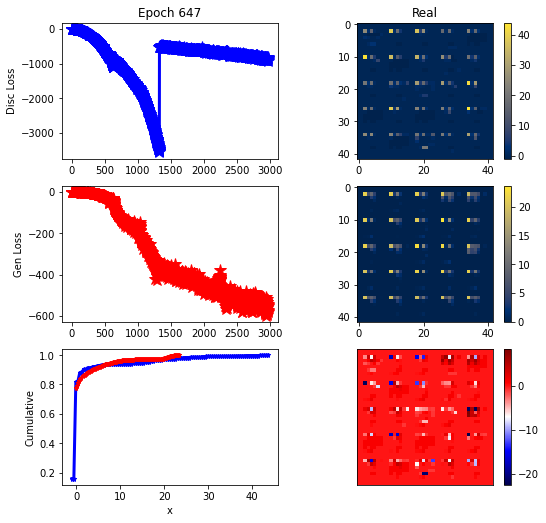

ErrG: -582.887429373605, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


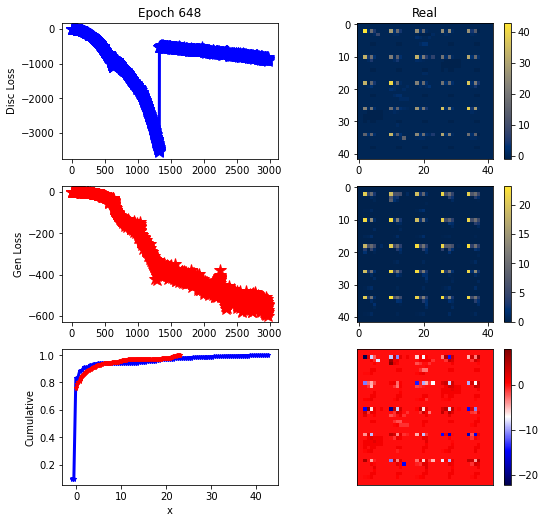

ErrG: -598.5058462960379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


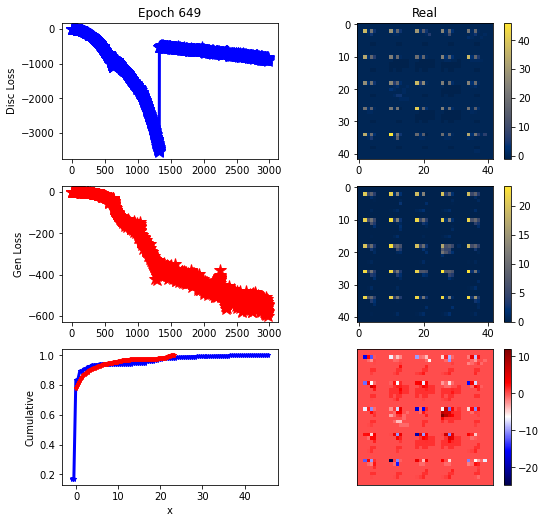

ErrG: -576.3815133231027, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


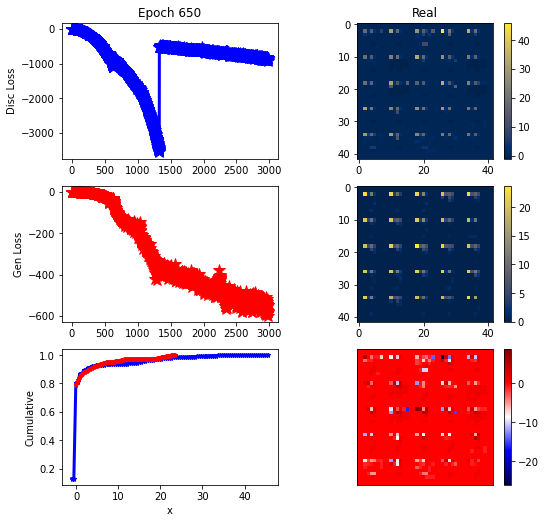

ErrG: -579.6938040597098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


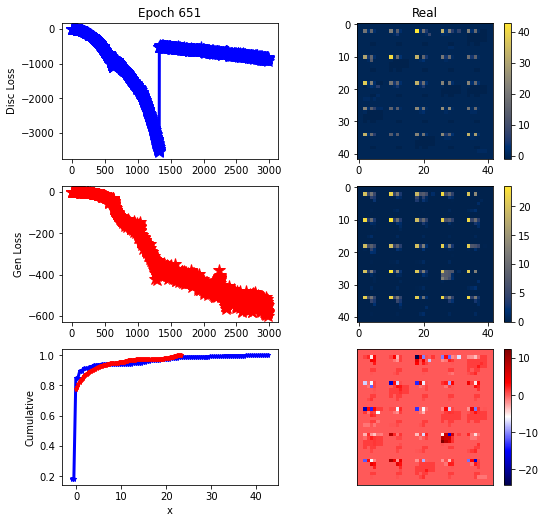

ErrG: -583.9477626255581, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


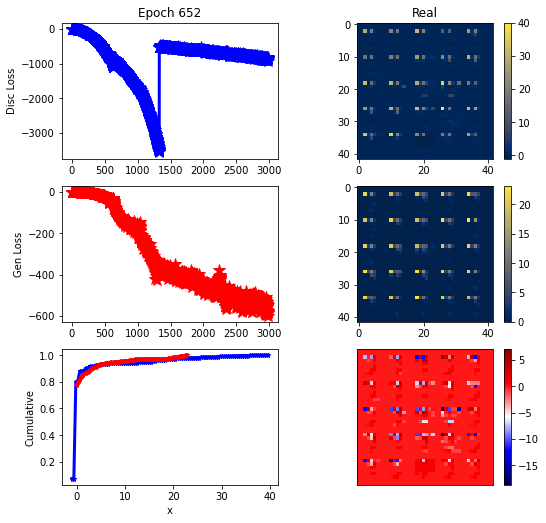

ErrG: -546.5050354003906, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


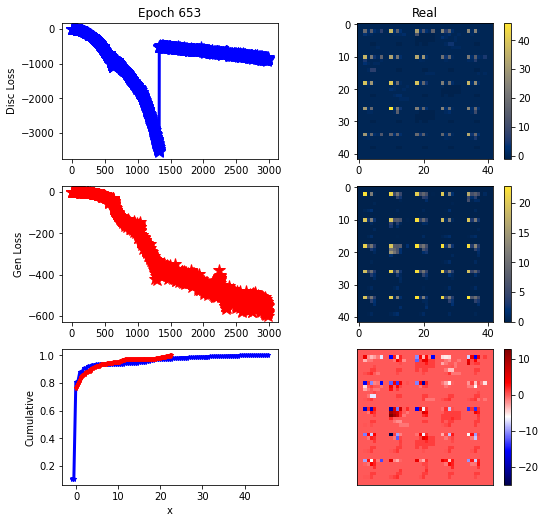

ErrG: -554.2068263462612, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


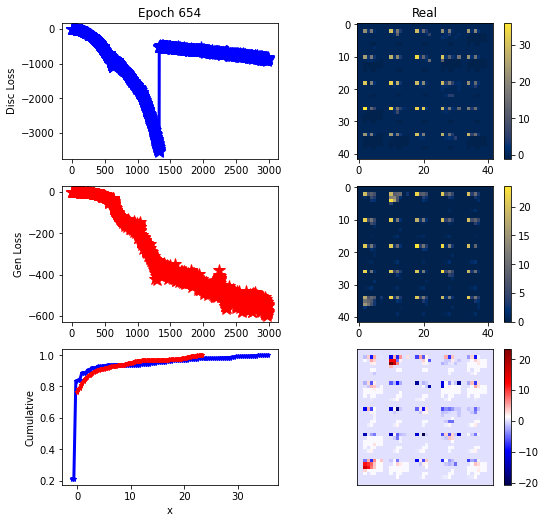

ErrG: -543.5082877022879, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


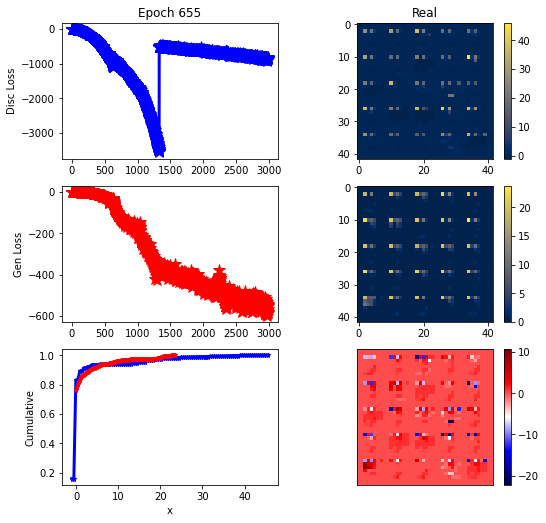

ErrG: -566.8260672433036, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


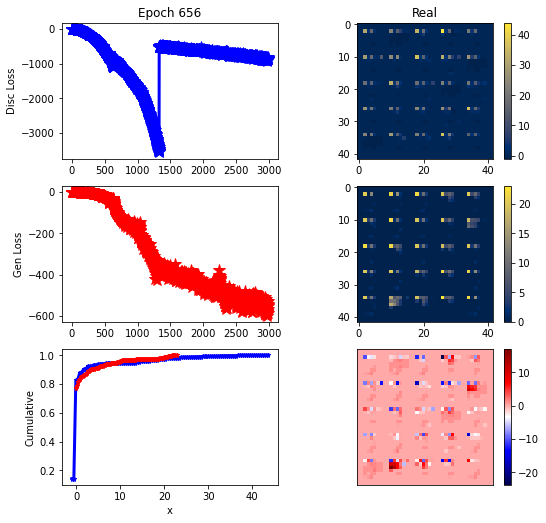

ErrG: -529.2017342703683, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


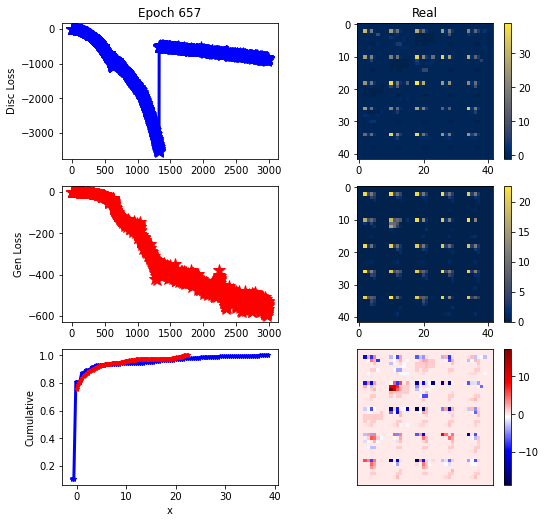

ErrG: -533.0797249930246, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


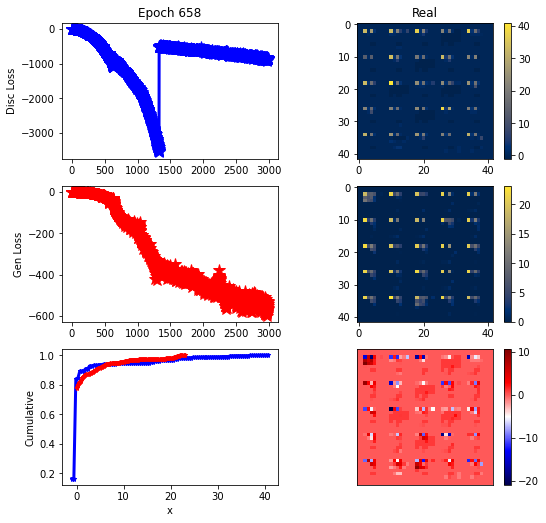

ErrG: -562.2242518833706, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


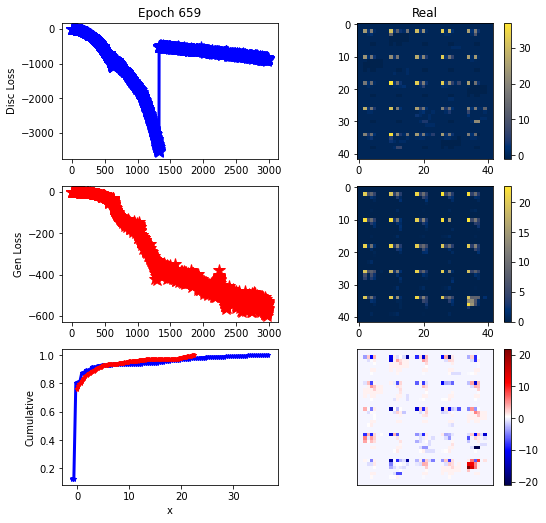

ErrG: -537.38674054827, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


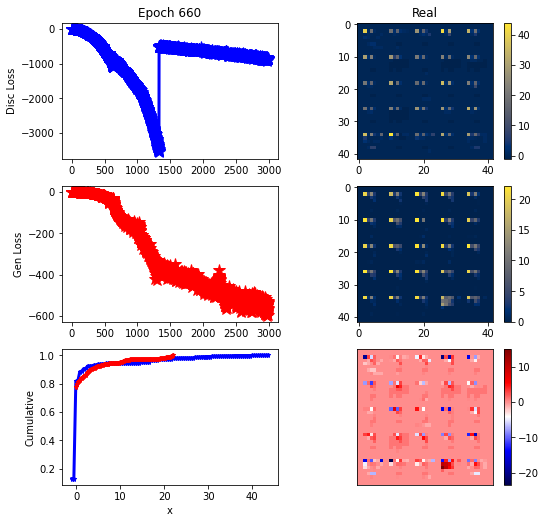

ErrG: -593.6106828962054, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


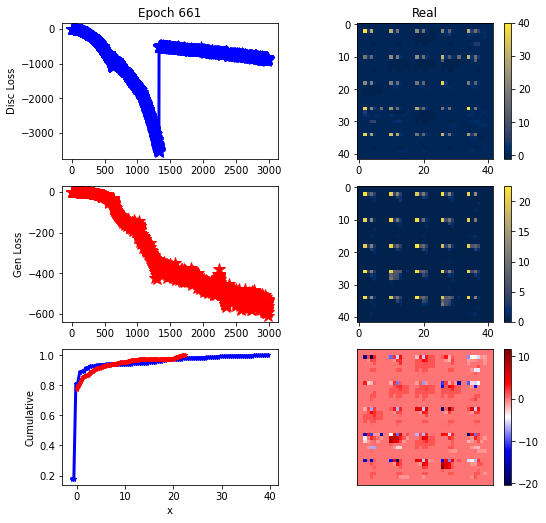

ErrG: -609.2032906668527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


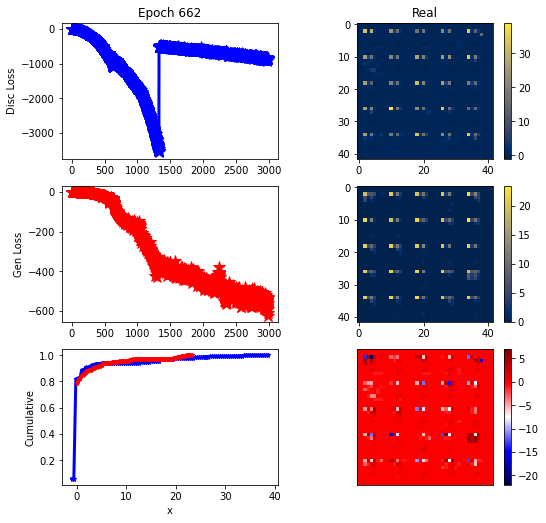

ErrG: -624.3164498465402, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


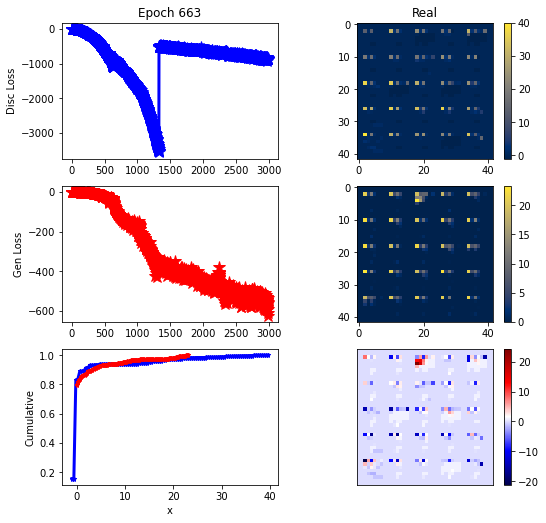

ErrG: -554.5986197335379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


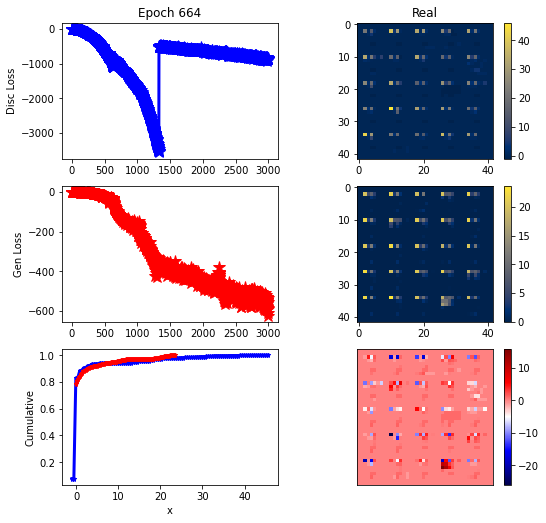

ErrG: -586.4151262555804, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


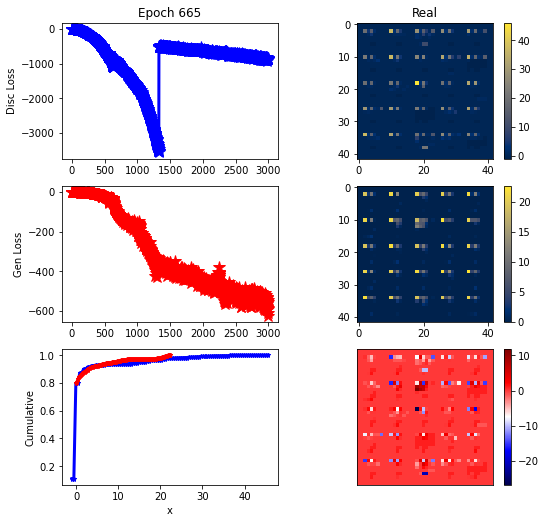

ErrG: -548.148921421596, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


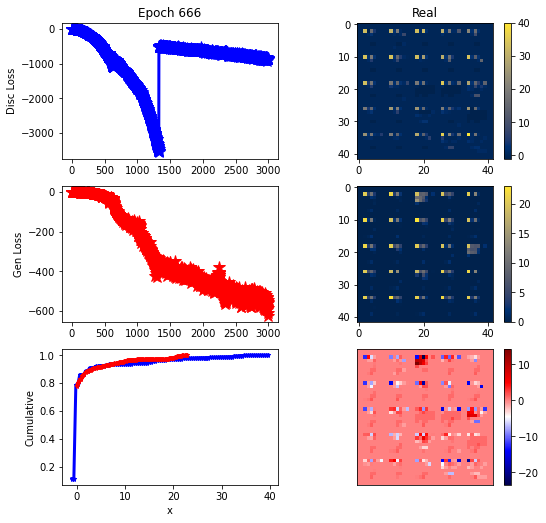

ErrG: -558.7013201032366, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


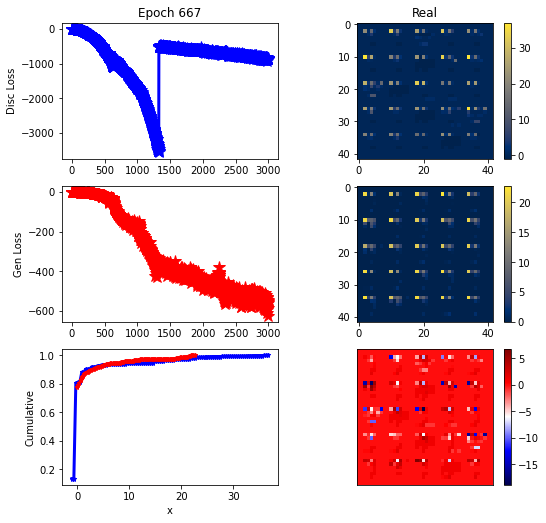

ErrG: -552.3998500279018, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


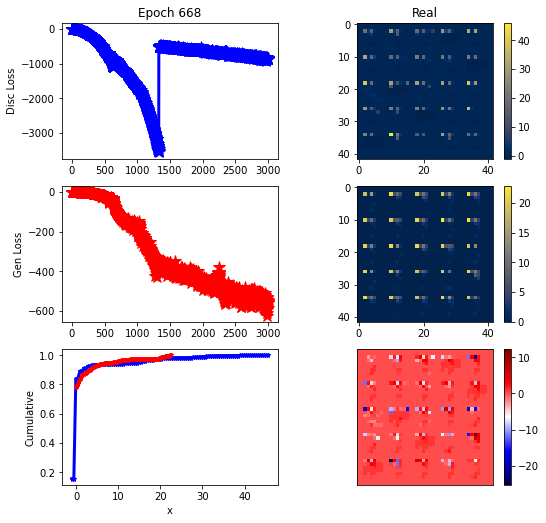

ErrG: -554.3512224469866, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


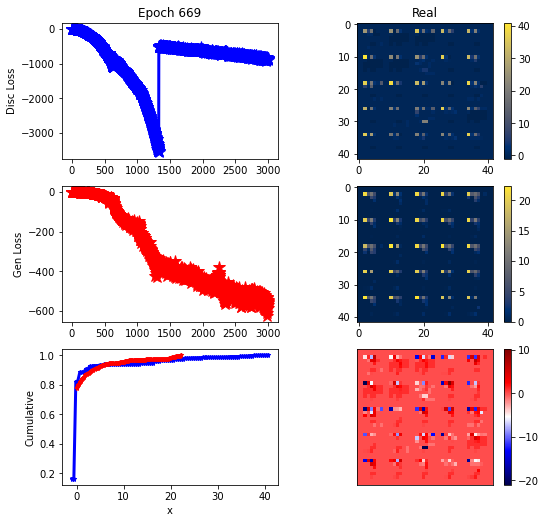

ErrG: -572.0560825892857, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


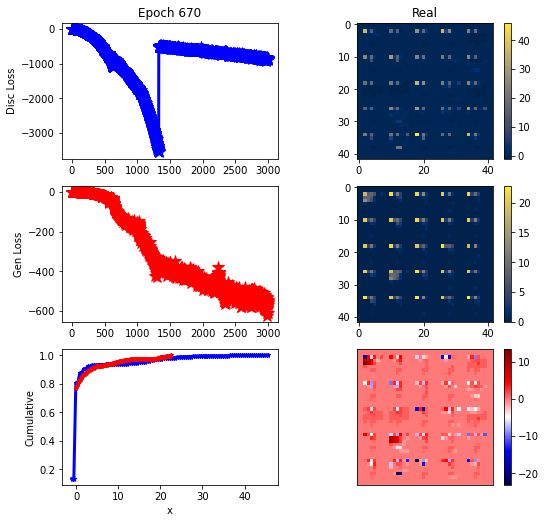

ErrG: -610.1496494838169, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


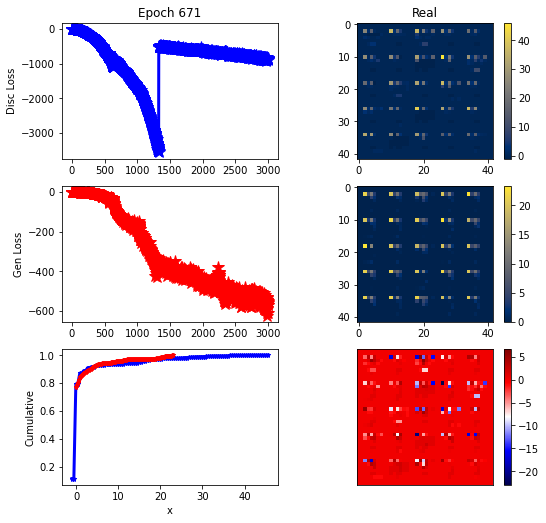

ErrG: -572.9734322684152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


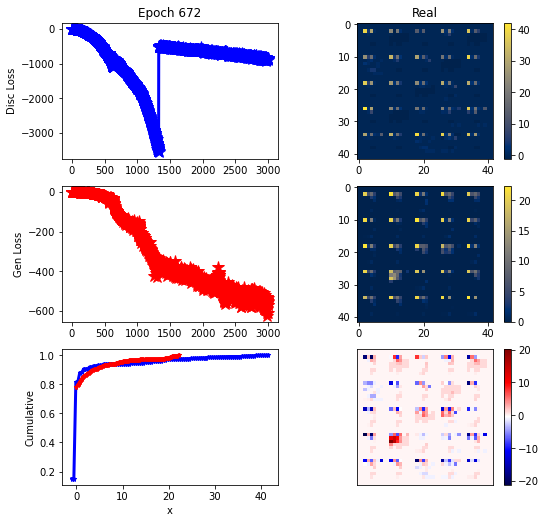

ErrG: -537.521235874721, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


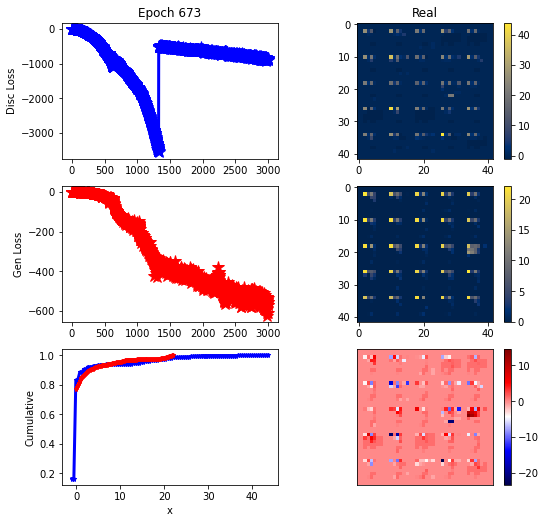

ErrG: -555.48293195452, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


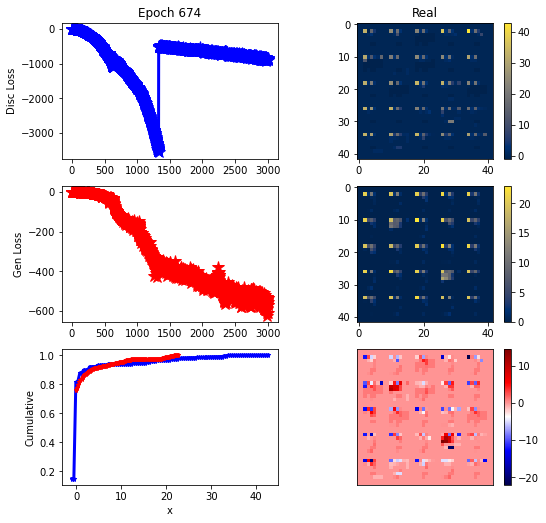

ErrG: -534.3969334193638, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


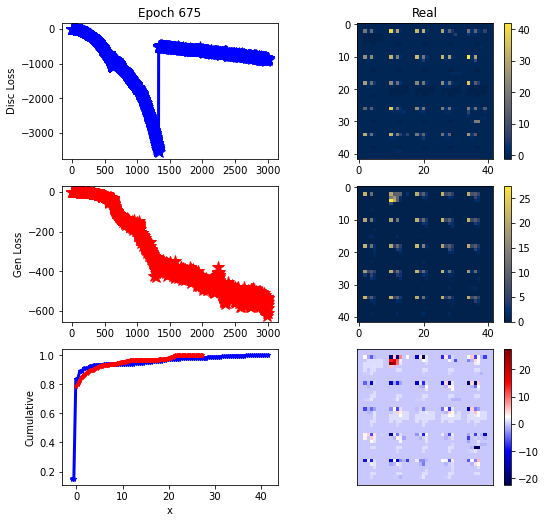

ErrG: -583.8528529575893, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


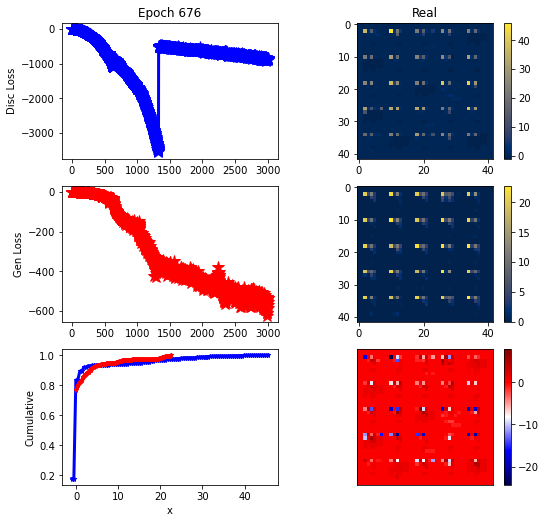

ErrG: -536.192631312779, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


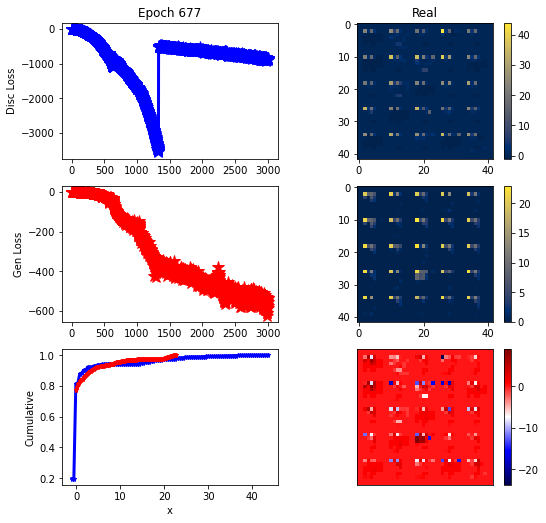

ErrG: -578.1938171386719, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


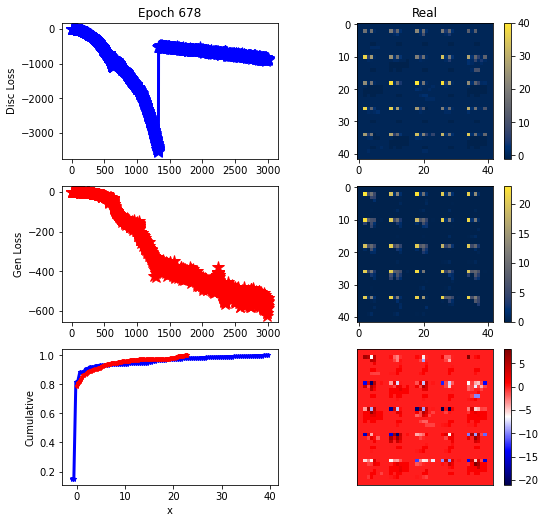

ErrG: -553.3017142159598, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


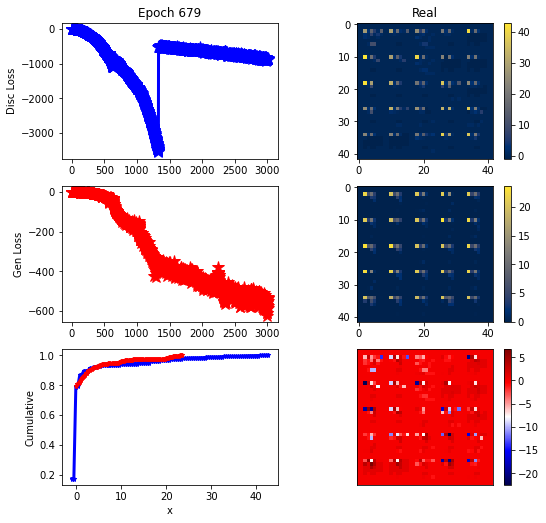

ErrG: -532.9447849818638, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


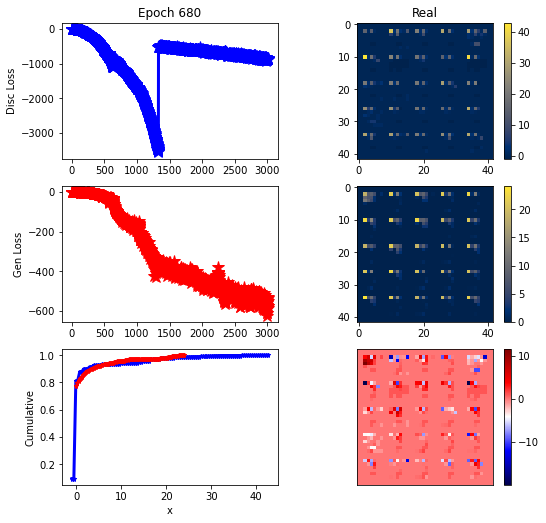

ErrG: -575.4344090053013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


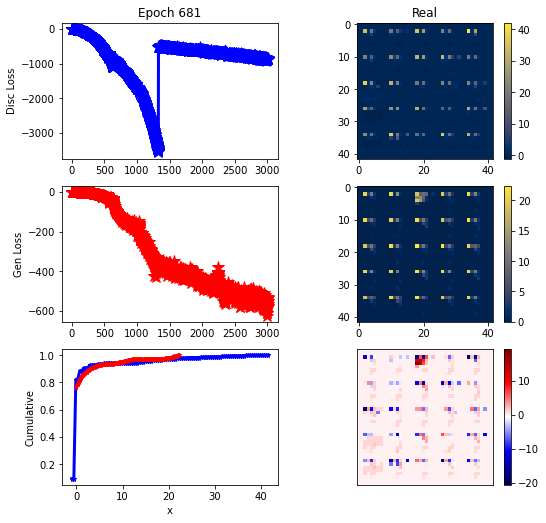

ErrG: -566.6521301269531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


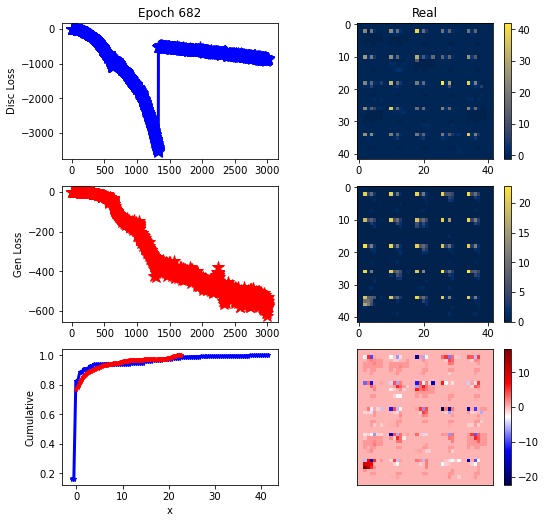

ErrG: -572.792253766741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


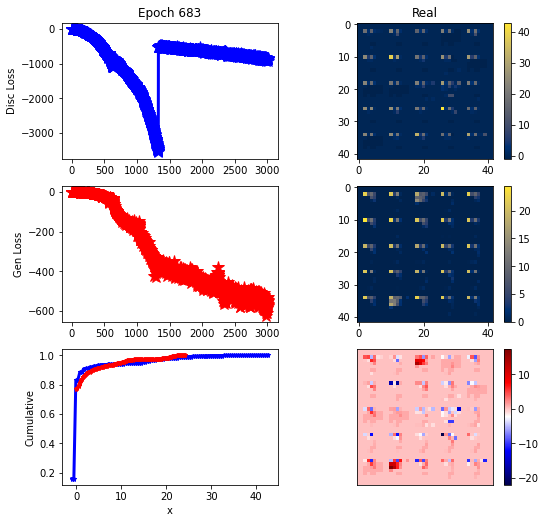

ErrG: -546.601335797991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


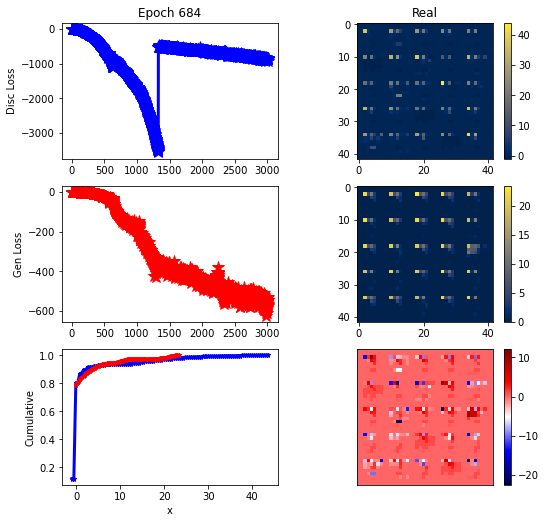

ErrG: -544.1237444196429, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


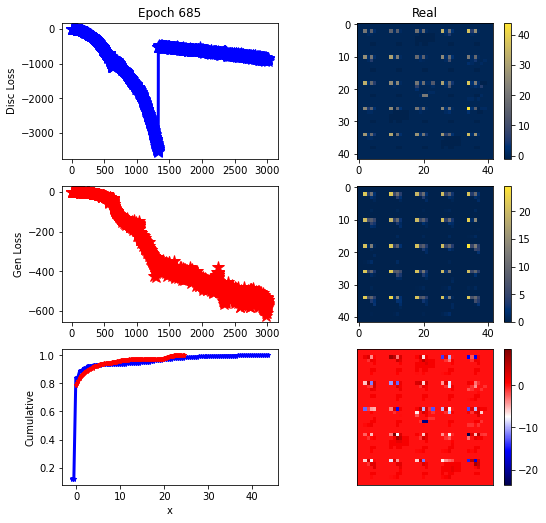

ErrG: -559.649169921875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


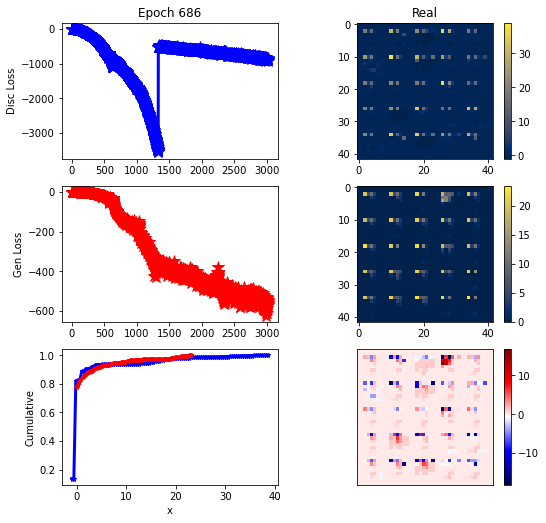

ErrG: -556.0978262765067, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


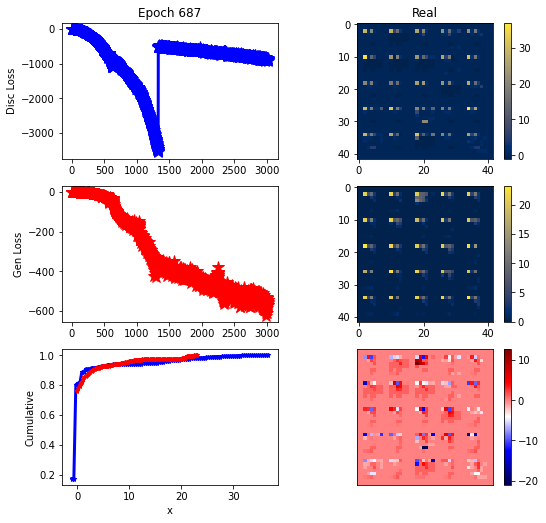

ErrG: -572.0135236467634, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


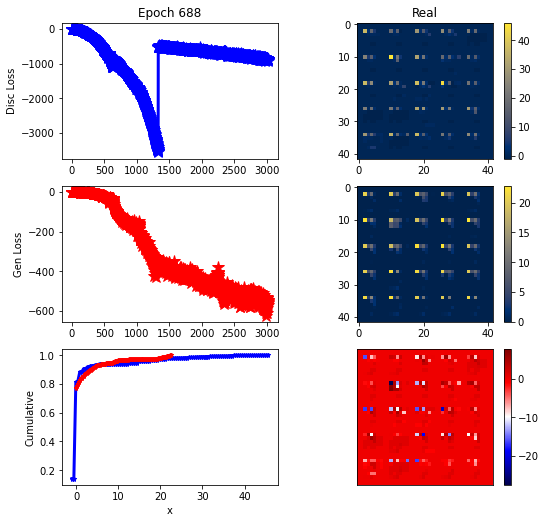

ErrG: -551.0071193150112, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


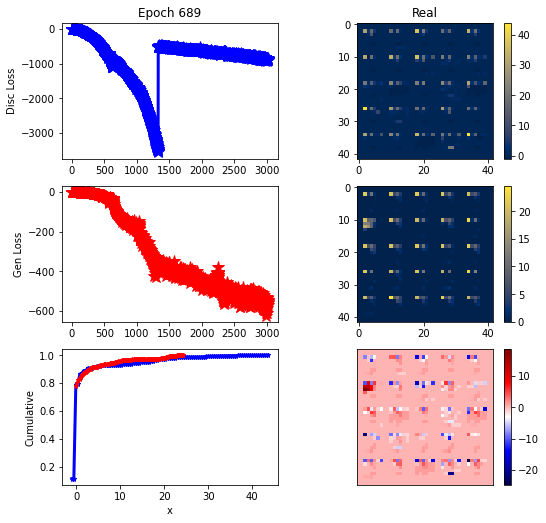

ErrG: -547.5320652553013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


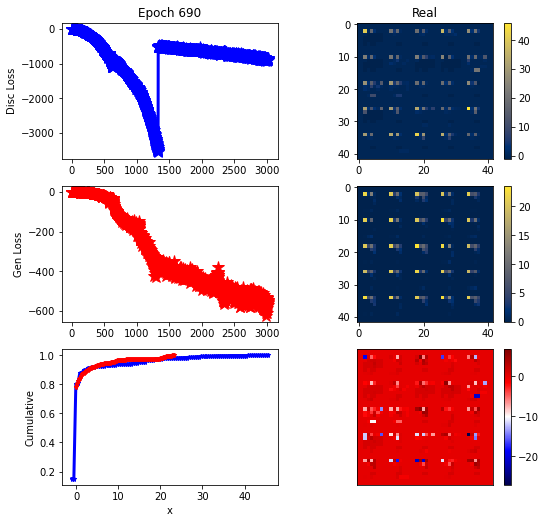

ErrG: -547.3385184151786, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


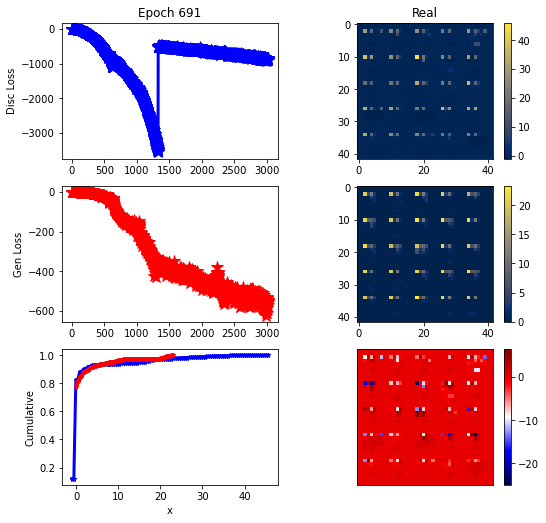

ErrG: -548.0614536830357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


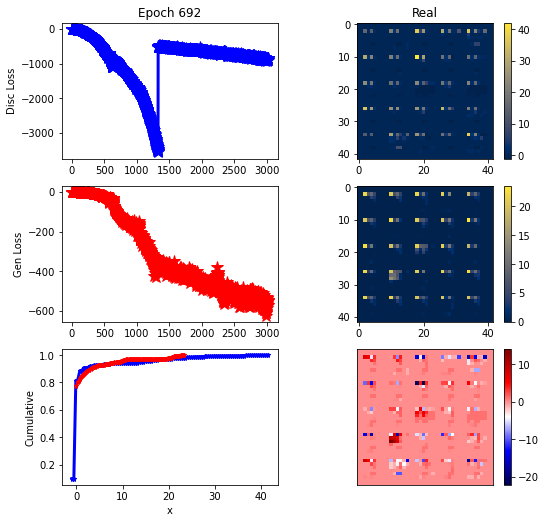

ErrG: -568.7067260742188, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


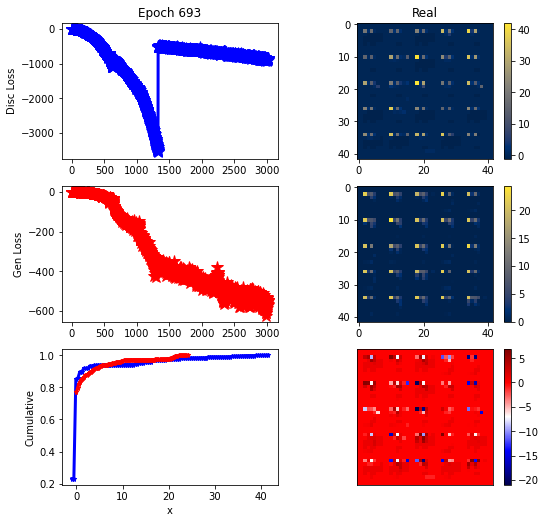

ErrG: -563.9446193150112, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


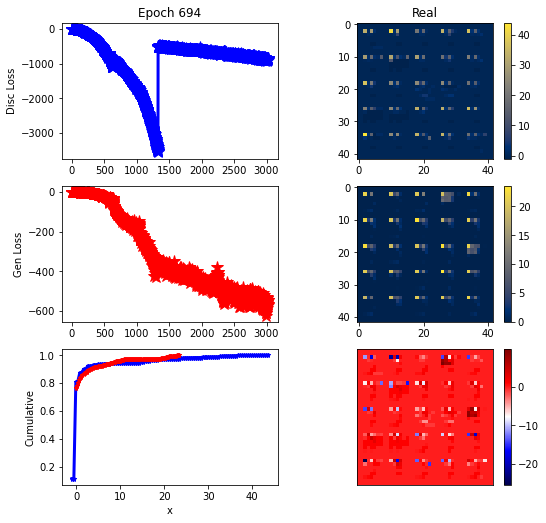

ErrG: -564.947283063616, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


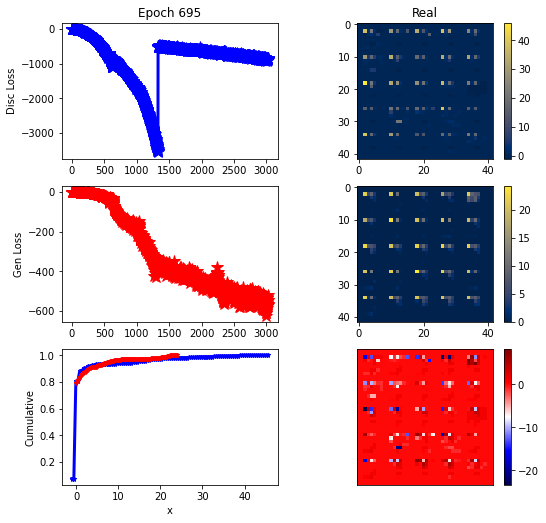

ErrG: -521.6420549665179, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


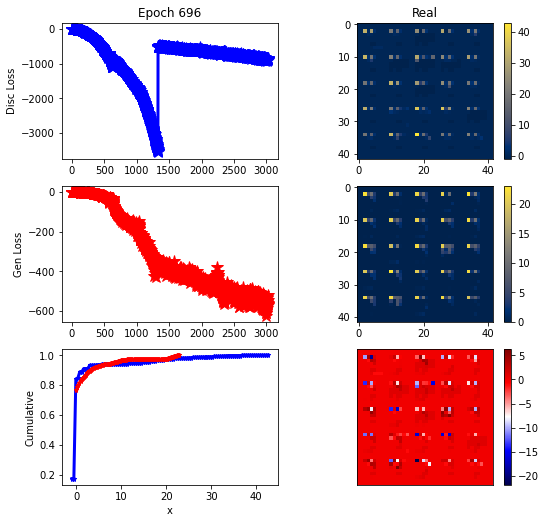

ErrG: -560.2434648786273, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


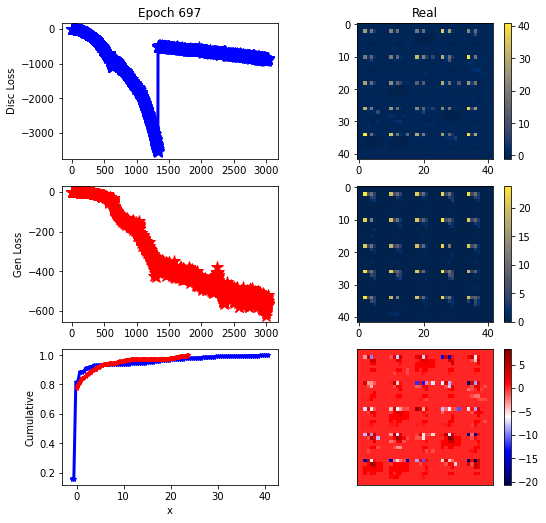

ErrG: -553.1212681361607, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


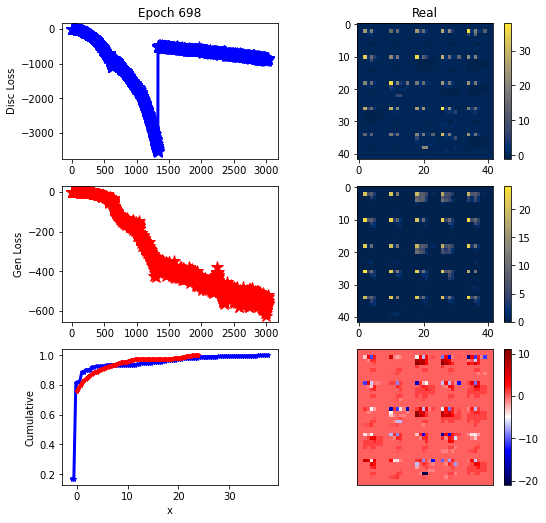

ErrG: -530.6892700195312, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


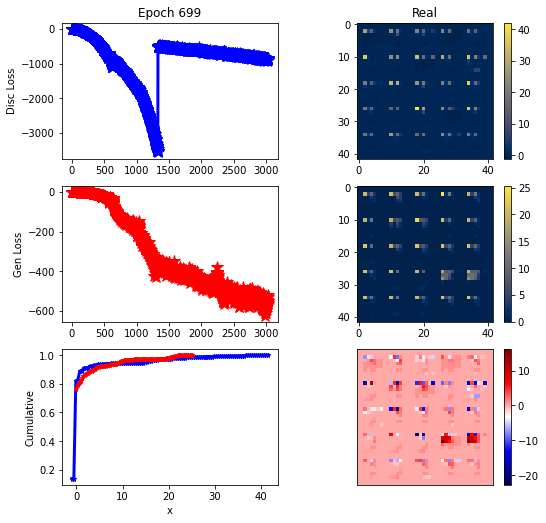

ErrG: -552.8267211914062, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


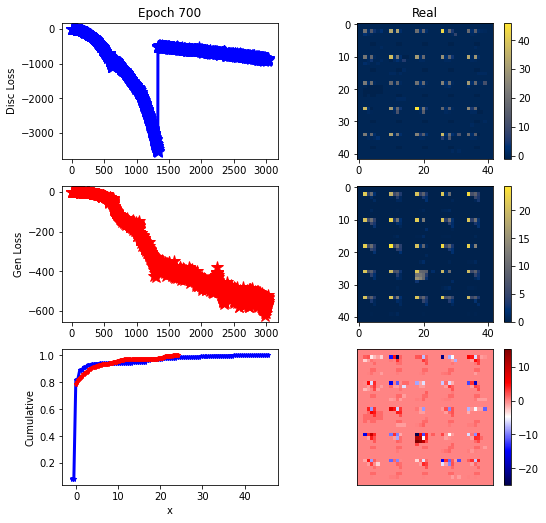

ErrG: -536.223371233259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


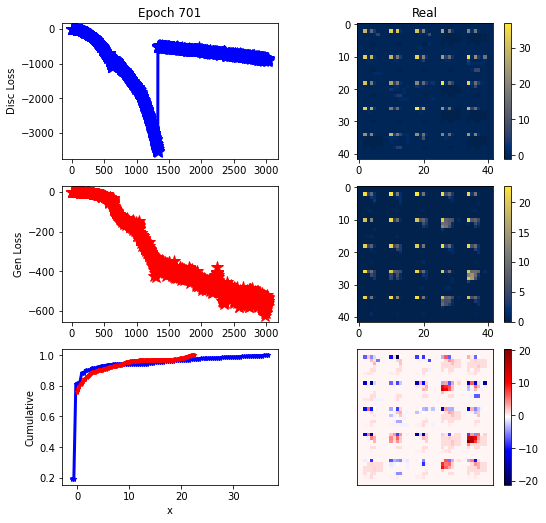

ErrG: -577.9637887137277, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


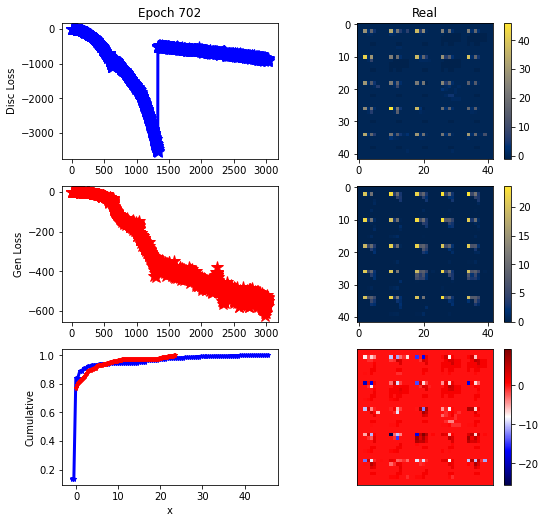

ErrG: -552.7464599609375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


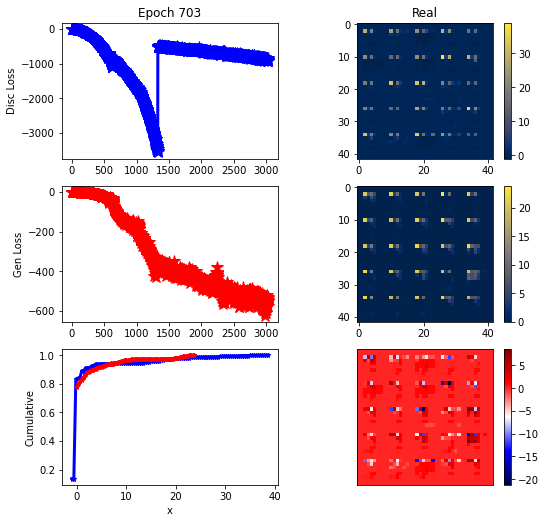

ErrG: -546.1310555594308, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


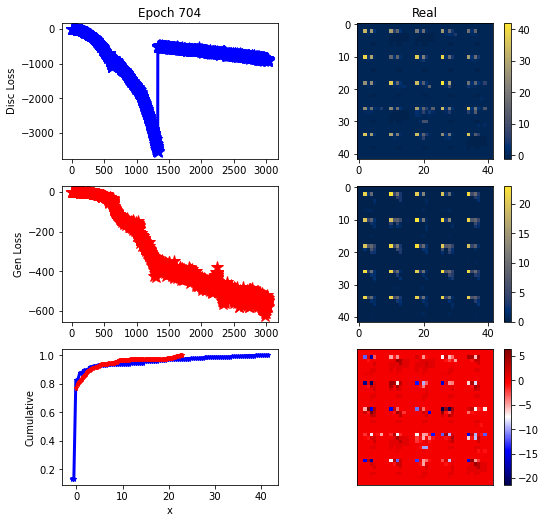

ErrG: -578.6988874162946, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


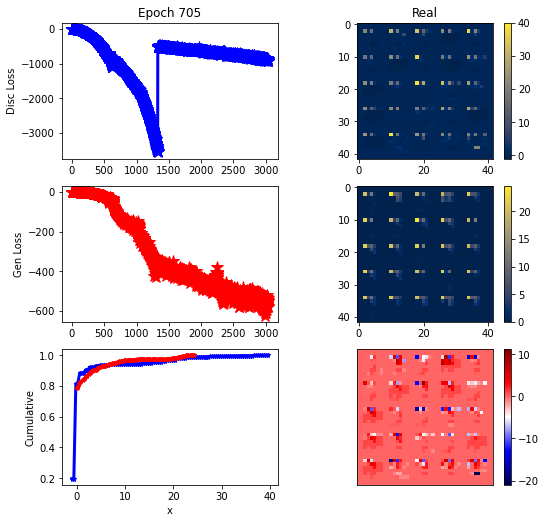

ErrG: -553.047119140625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


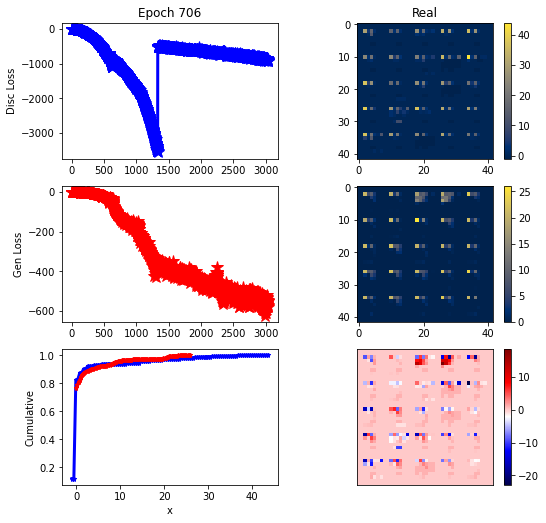

ErrG: -569.4131644112723, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


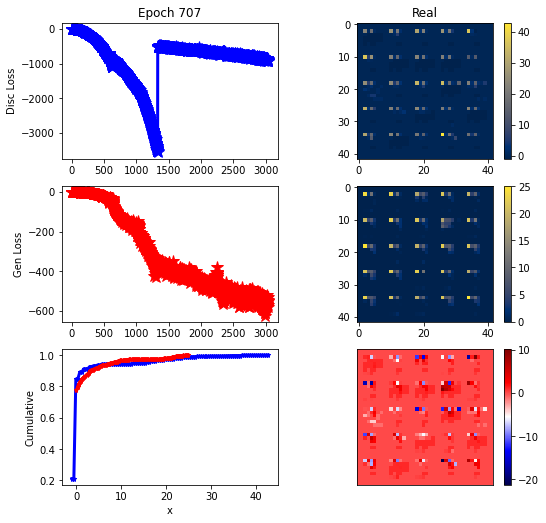

ErrG: -530.6883414132254, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


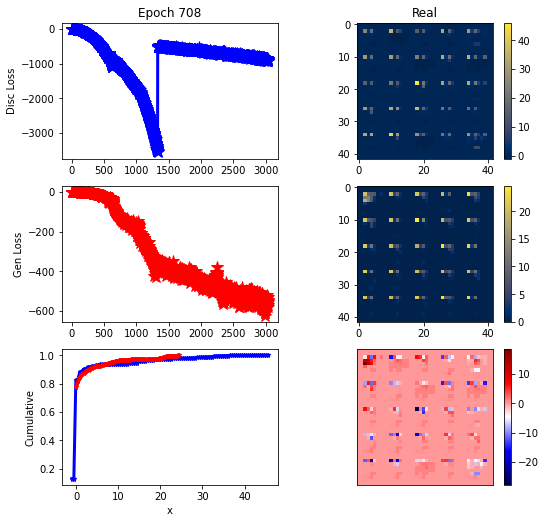

ErrG: -558.2205548967634, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


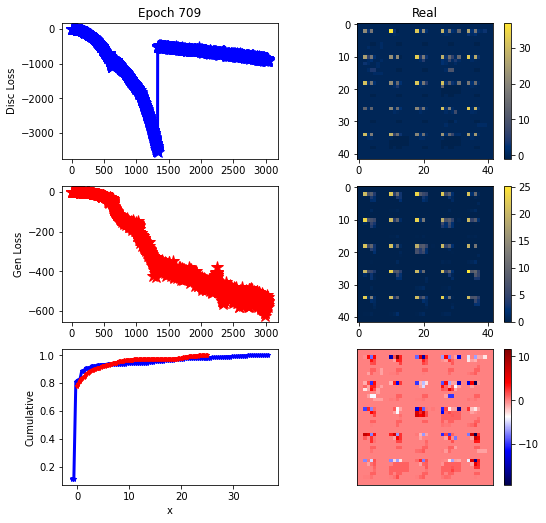

ErrG: -549.4555969238281, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


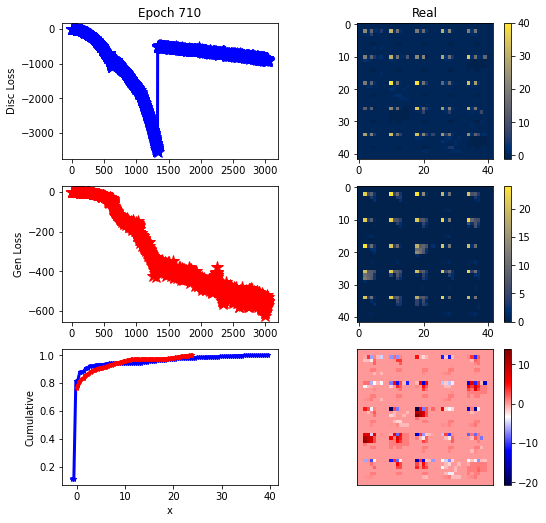

ErrG: -552.4295305524554, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


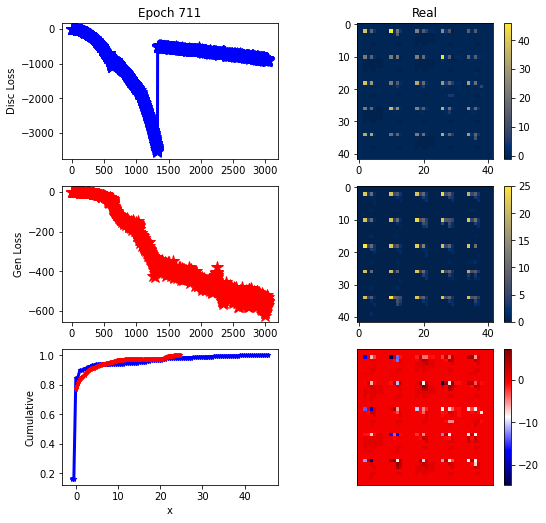

ErrG: -550.18505859375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


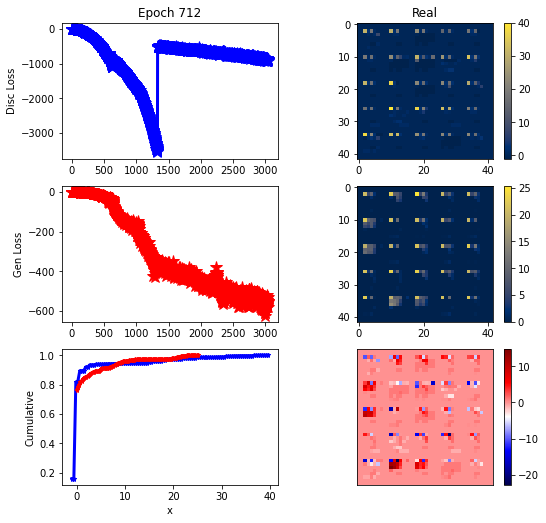

ErrG: -579.6870029994419, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


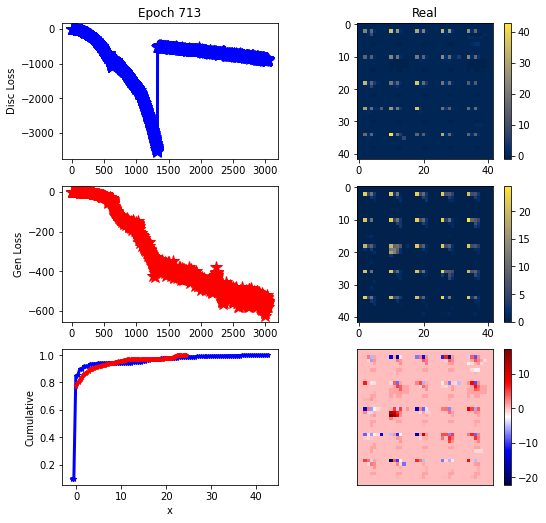

ErrG: -559.6527317592075, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


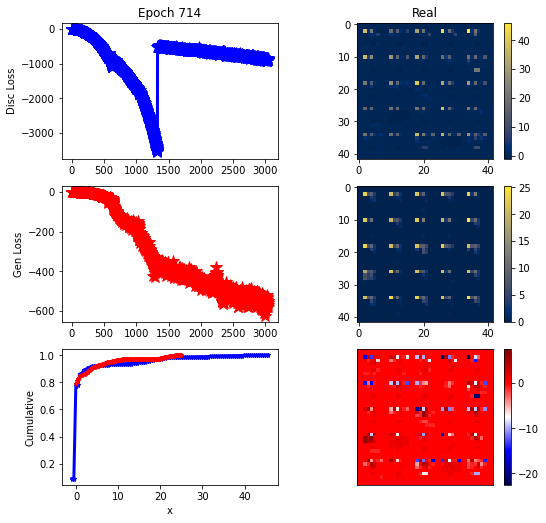

ErrG: -569.9532427106585, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


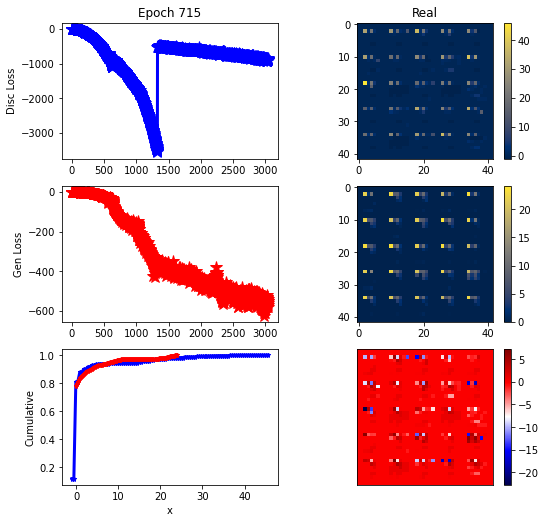

ErrG: -540.7427673339844, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


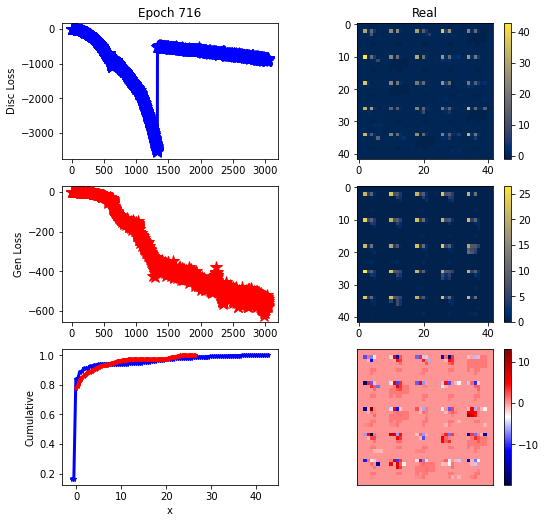

ErrG: -575.3762991768973, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


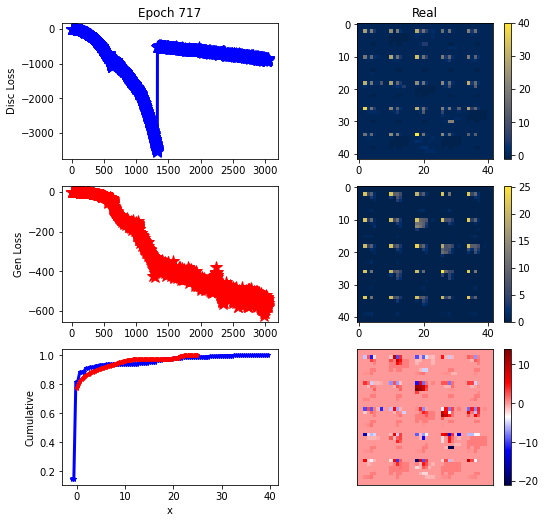

ErrG: -561.5637294224331, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


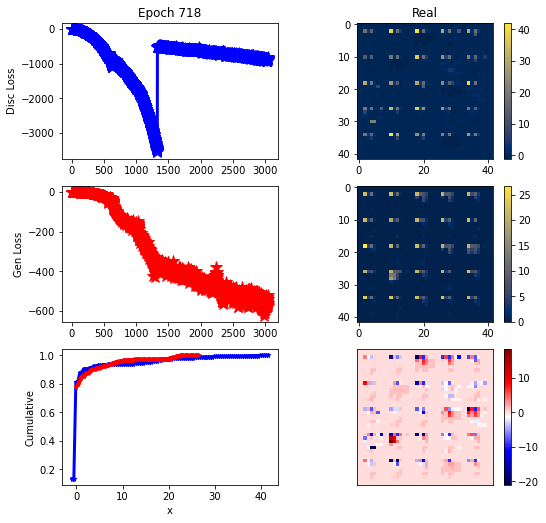

ErrG: -520.6498107910156, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


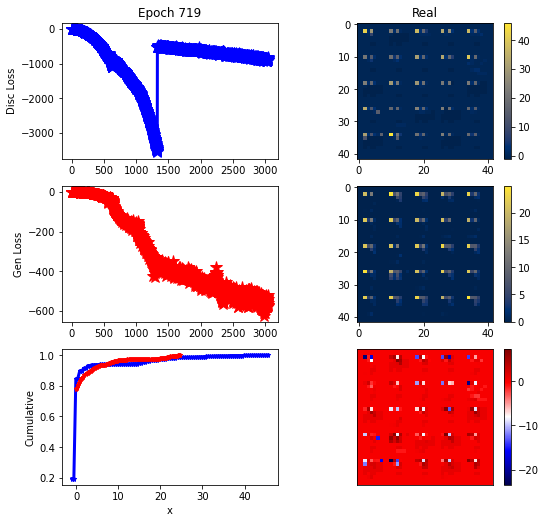

ErrG: -571.6363438197544, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


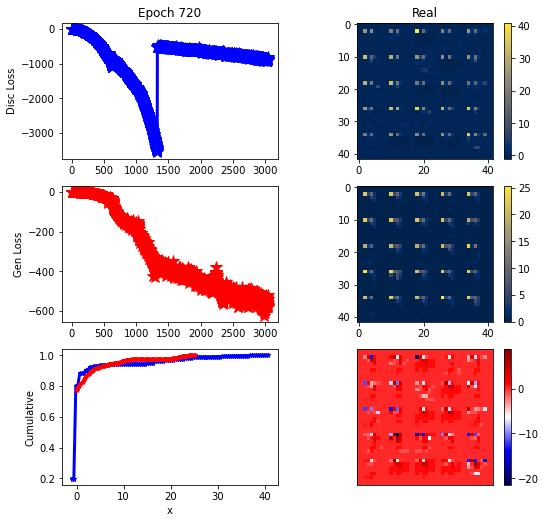

ErrG: -582.8599591936384, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


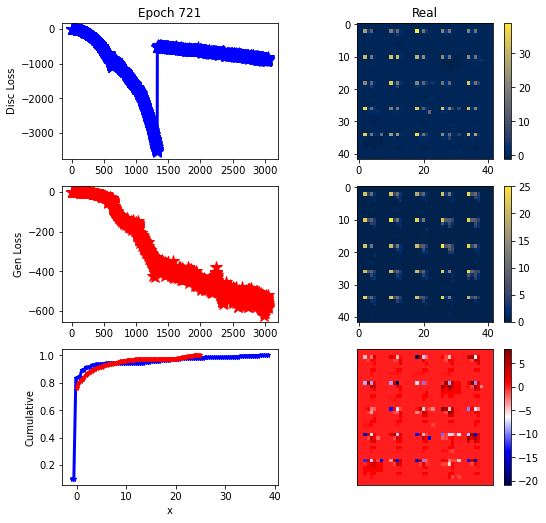

ErrG: -587.2014508928571, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


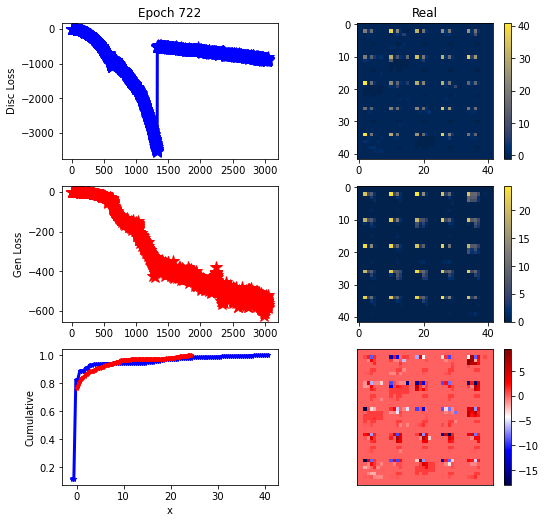

ErrG: -572.623273577009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


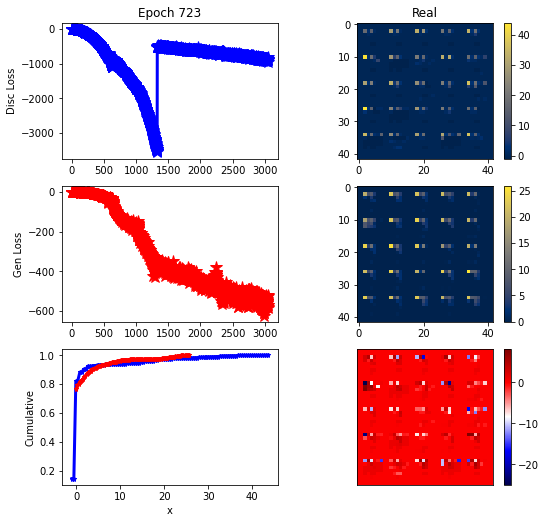

ErrG: -525.7537144252232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


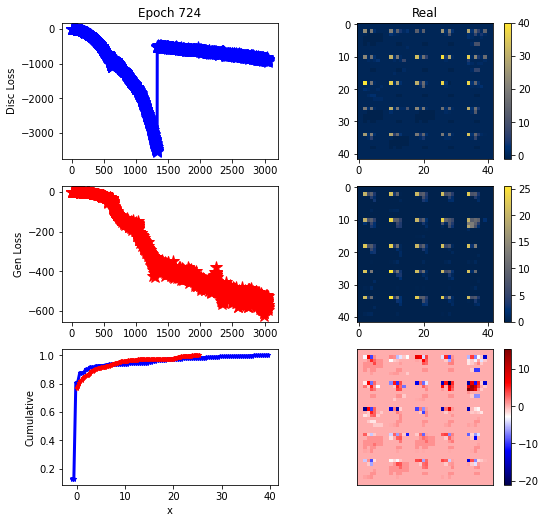

ErrG: -597.1680603027344, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


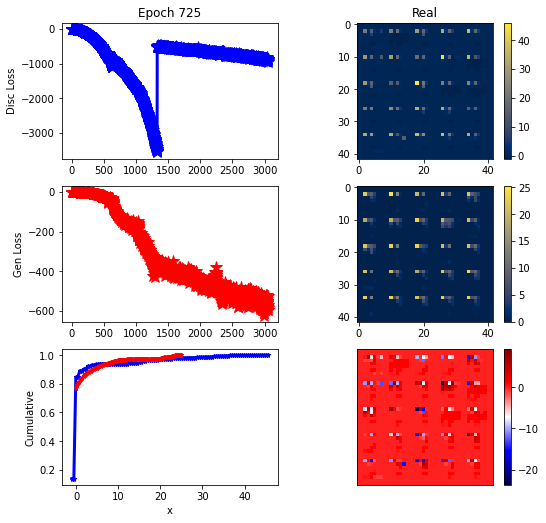

ErrG: -595.434077671596, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


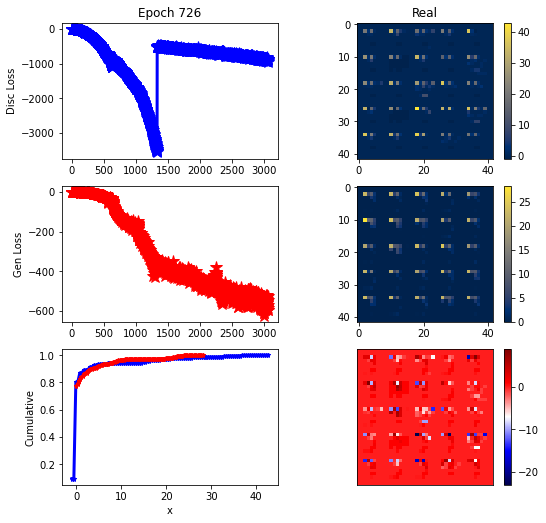

ErrG: -546.7166355678013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


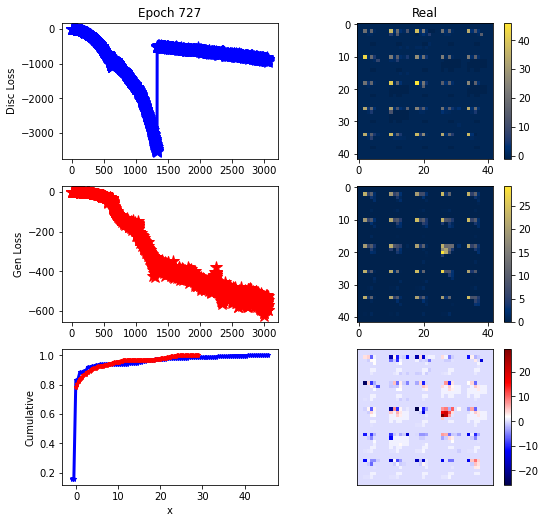

ErrG: -572.7975071498325, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


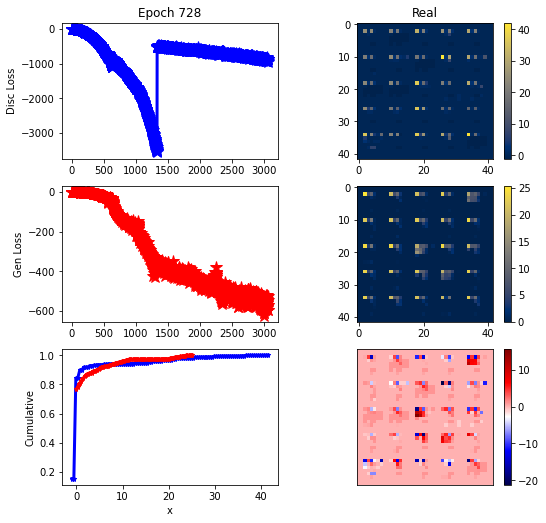

ErrG: -571.0405796595982, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


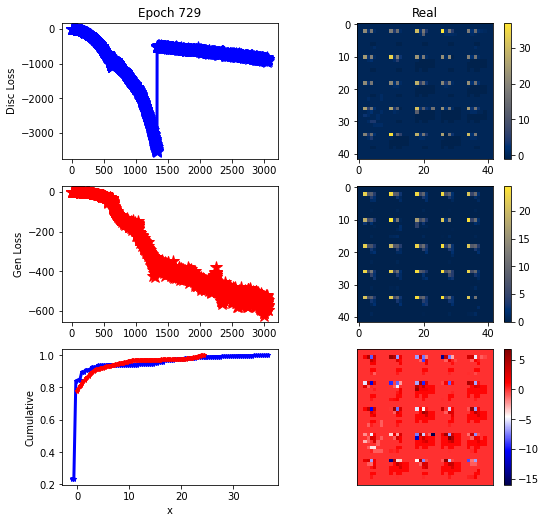

ErrG: -576.4205147879464, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


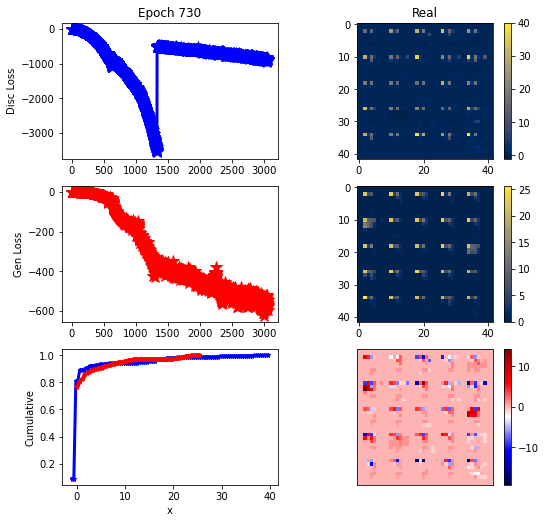

ErrG: -559.8726196289062, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


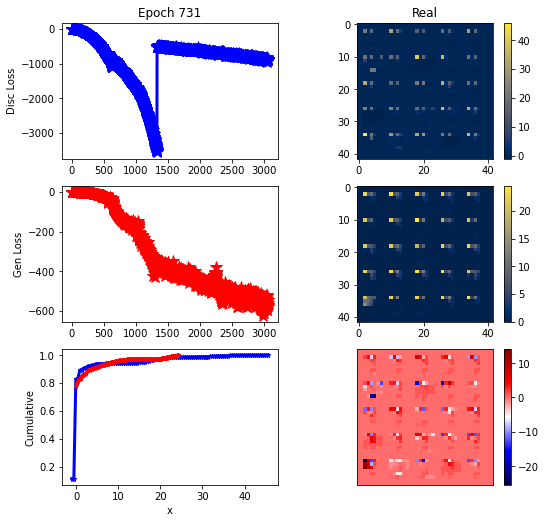

ErrG: -569.4798017229352, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


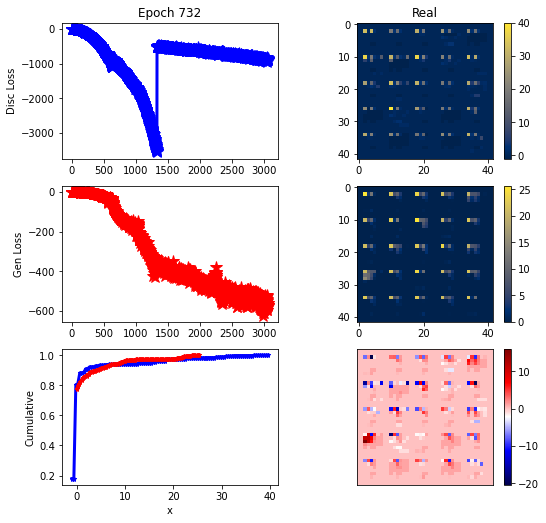

ErrG: -562.2536926269531, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


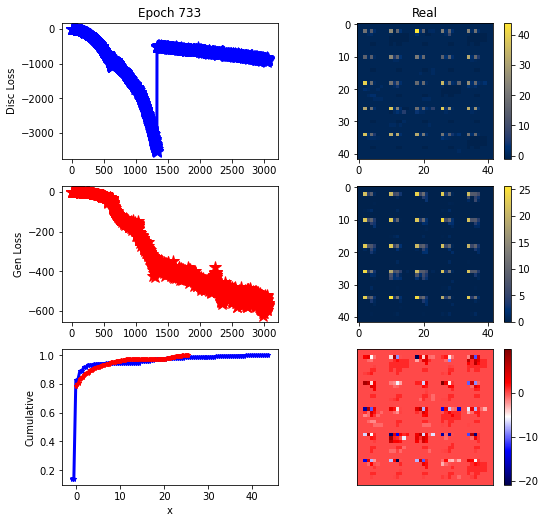

ErrG: -567.0348597935268, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


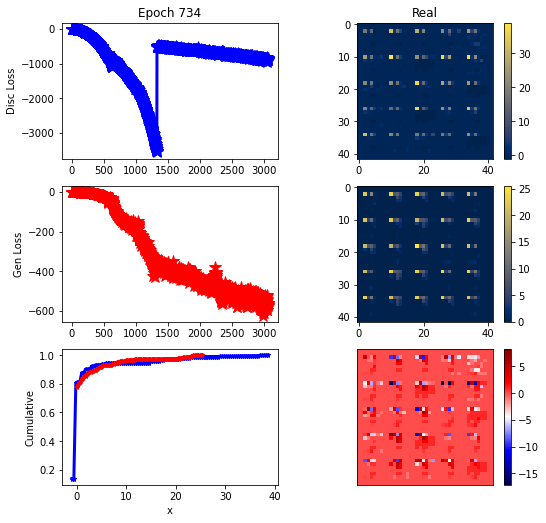

ErrG: -562.3653041294643, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


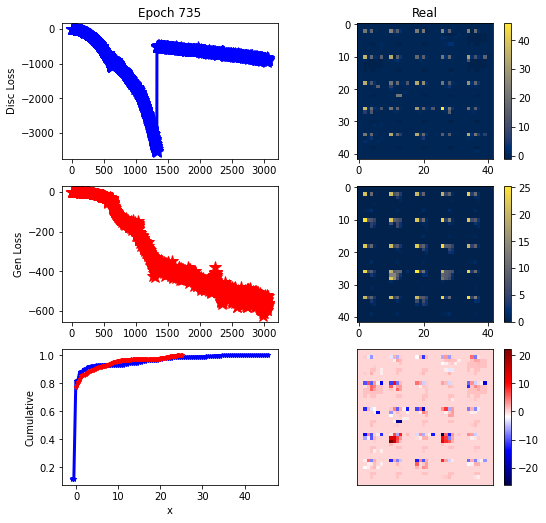

ErrG: -527.8648812430246, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


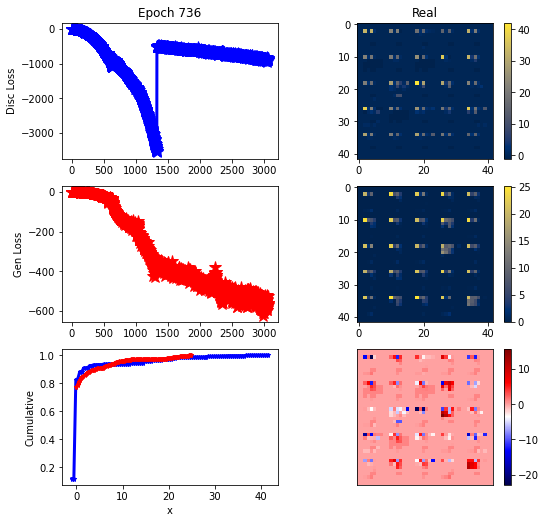

ErrG: -562.085710797991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


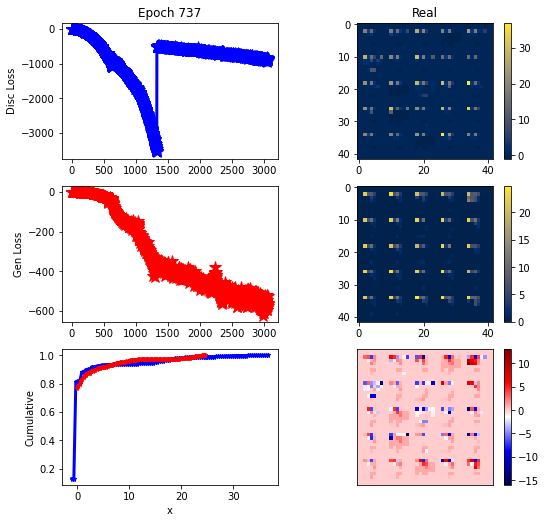

ErrG: -575.5978175571987, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


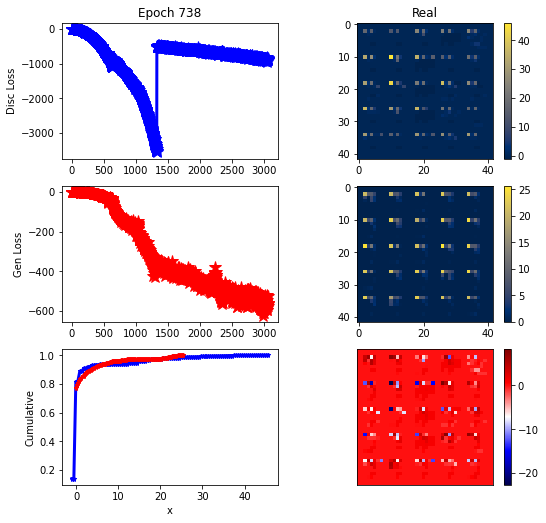

ErrG: -563.3186732700893, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


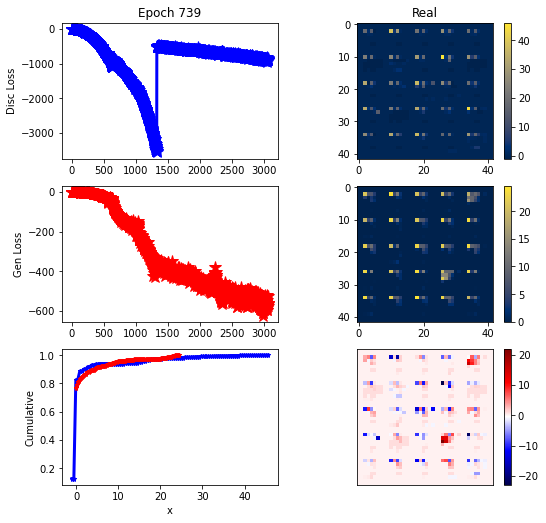

ErrG: -565.5963657924107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


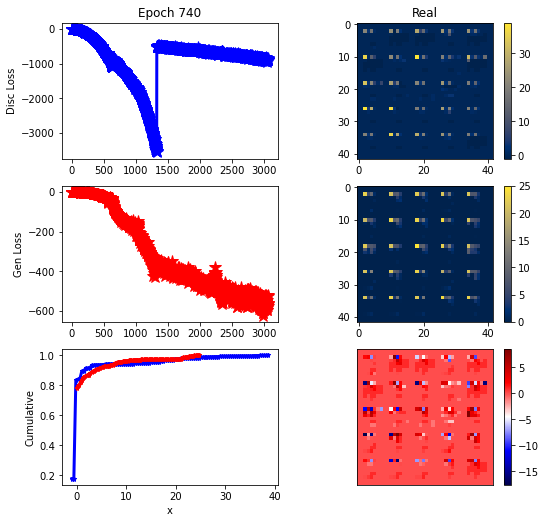

ErrG: -521.1840122767857, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


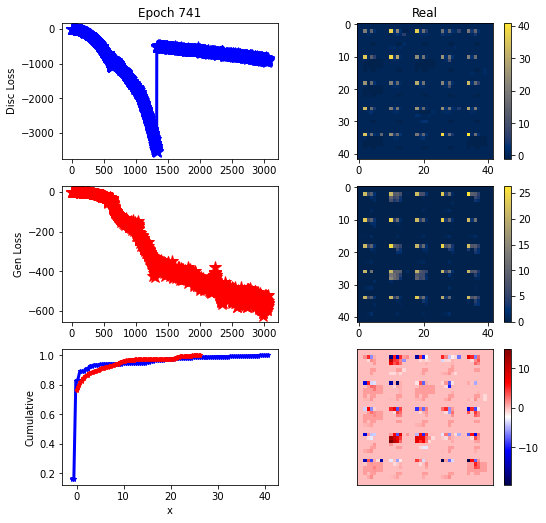

ErrG: -549.5681893484933, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


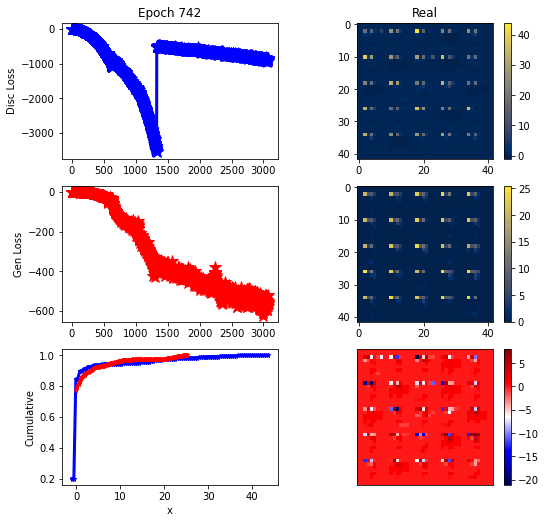

ErrG: -553.6018851143973, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


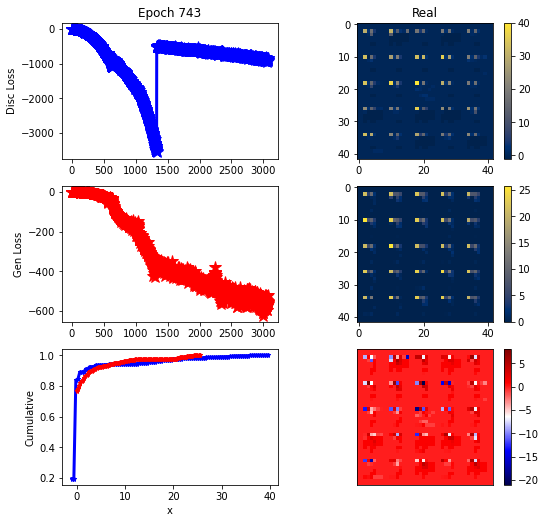

ErrG: -555.5323529924665, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


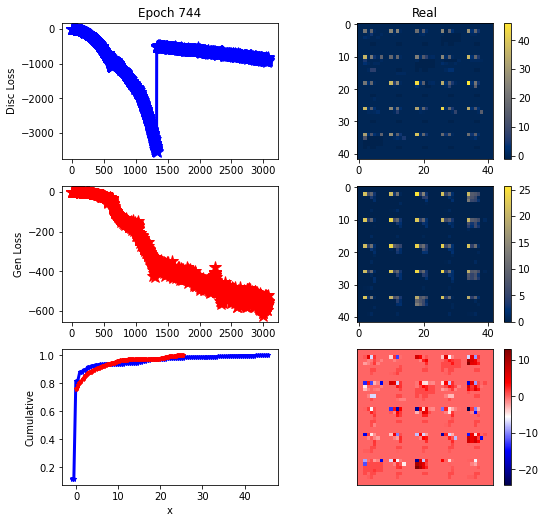

ErrG: -550.9363708496094, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


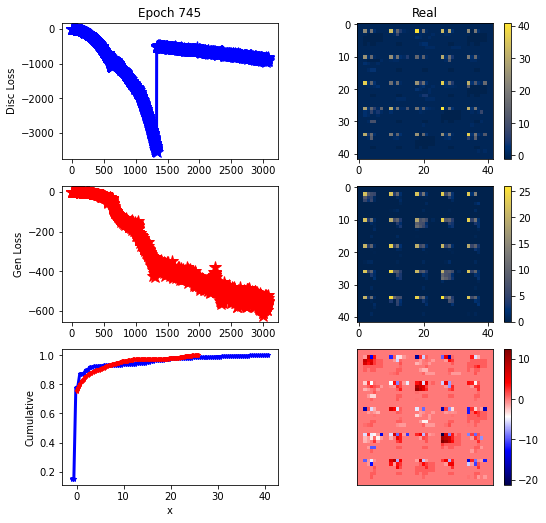

ErrG: -533.9751935686384, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


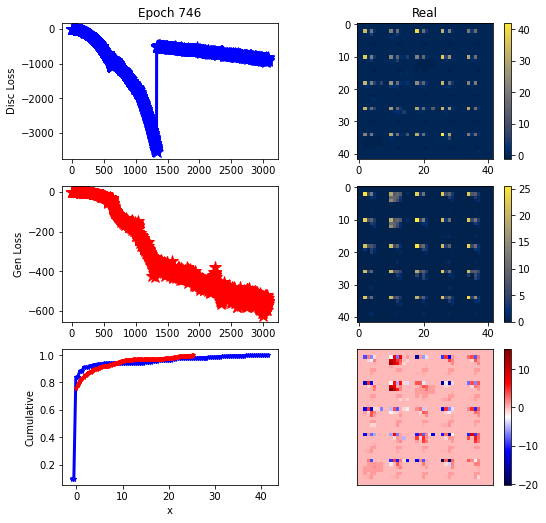

ErrG: -563.8385532924107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


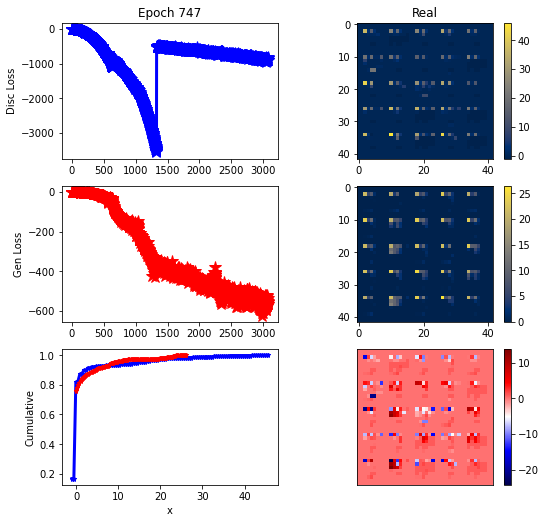

ErrG: -564.1992449079241, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


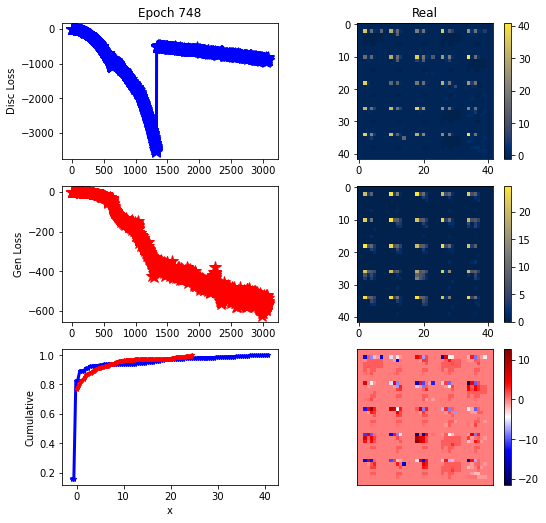

ErrG: -562.8768964494977, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


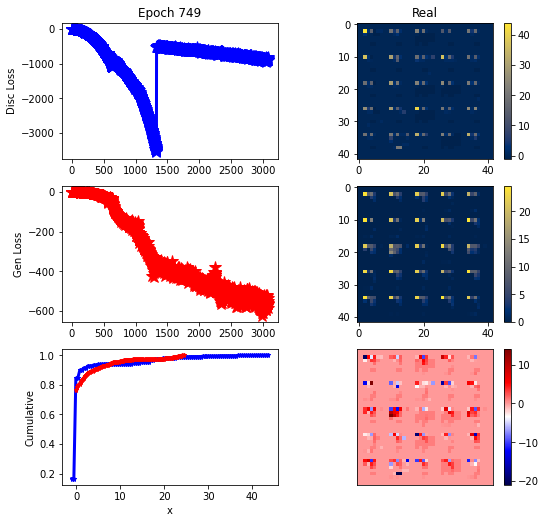

ErrG: -585.8381740025112, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


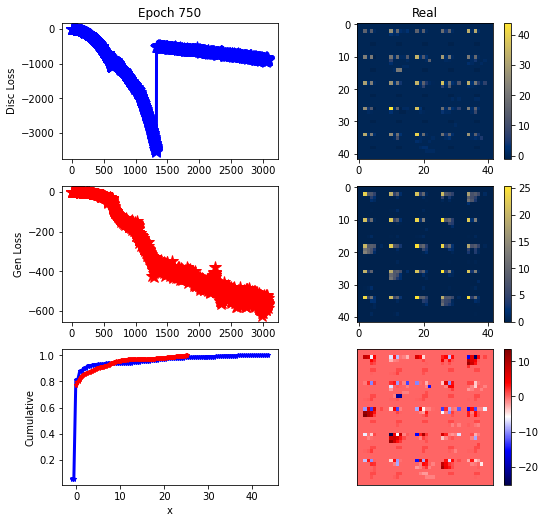

ErrG: -571.0919015066964, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


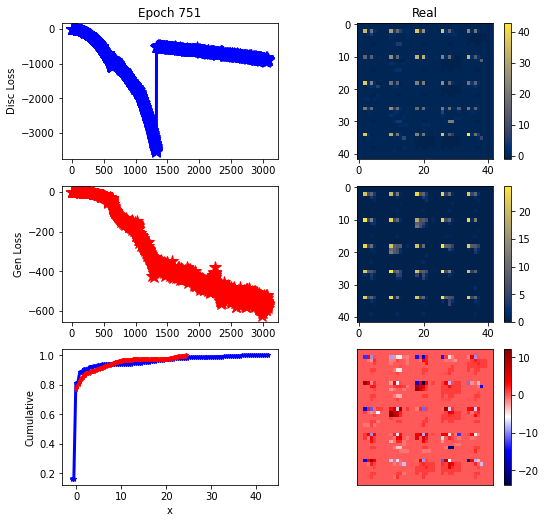

ErrG: -576.7807704380581, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


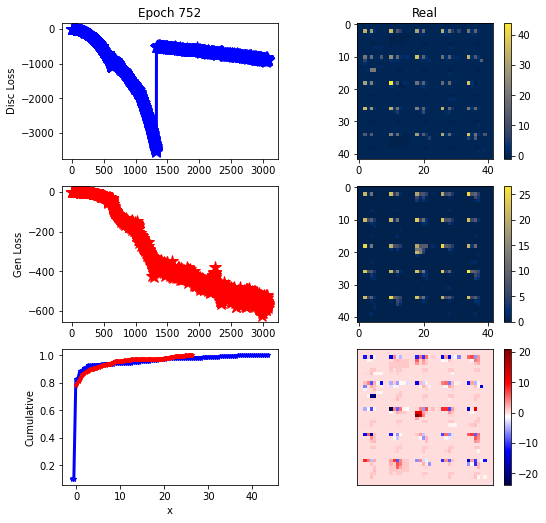

ErrG: -573.3219735281808, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


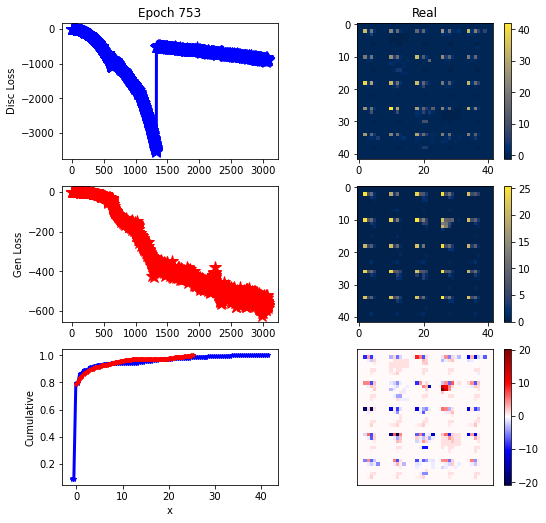

ErrG: -575.5403921944754, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


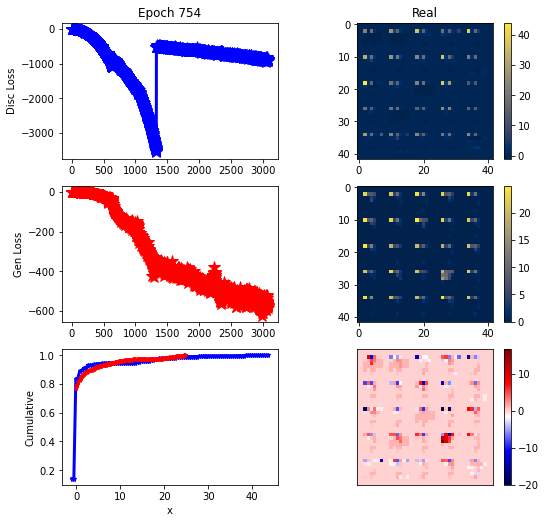

ErrG: -573.6794564383371, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


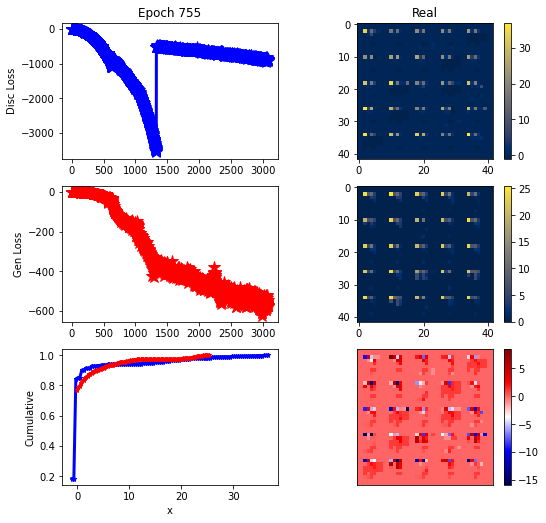

ErrG: -547.5536499023438, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


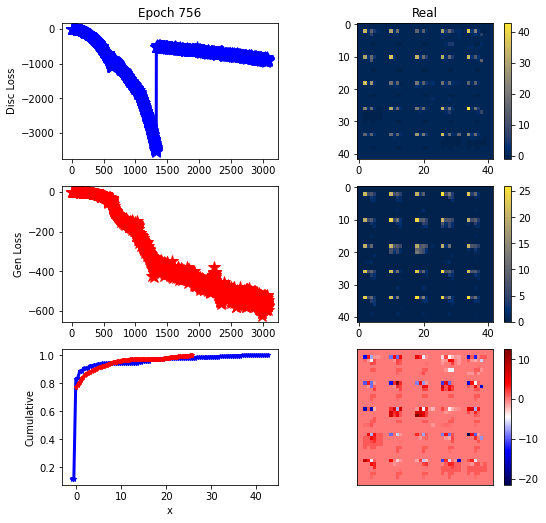

ErrG: -596.6705671037946, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


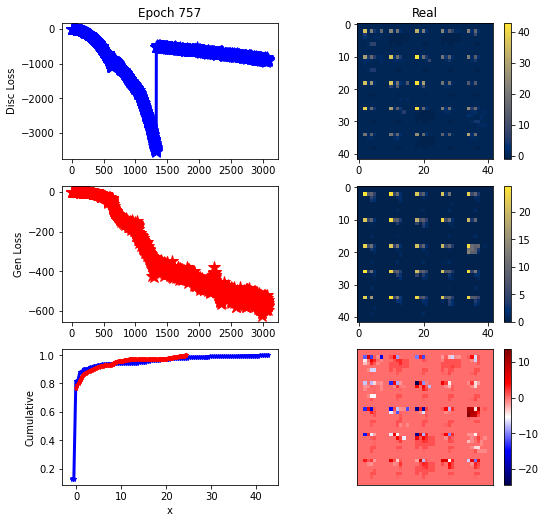

ErrG: -558.460693359375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


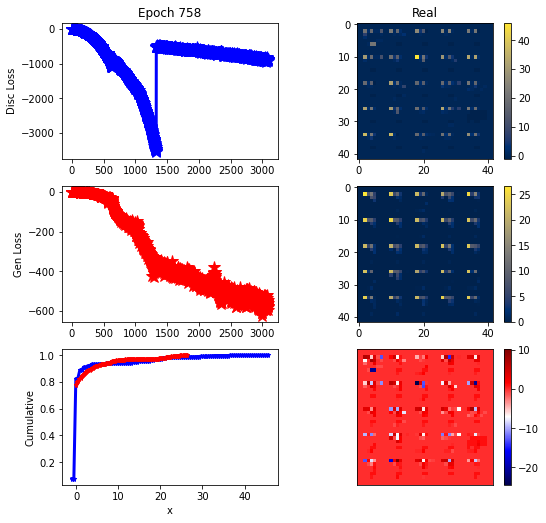

ErrG: -583.0814296177456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


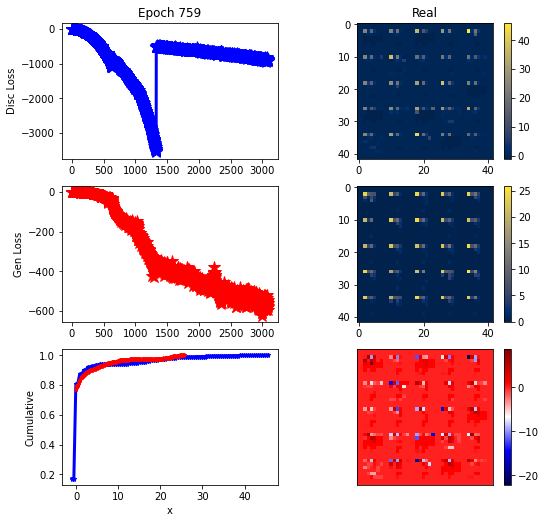

ErrG: -561.0121765136719, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


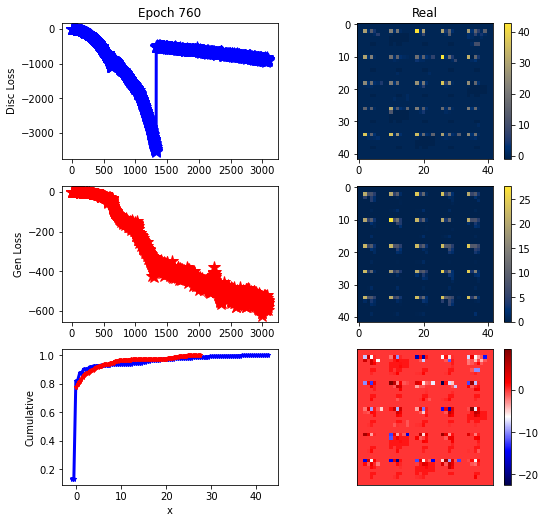

ErrG: -552.3364606584821, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


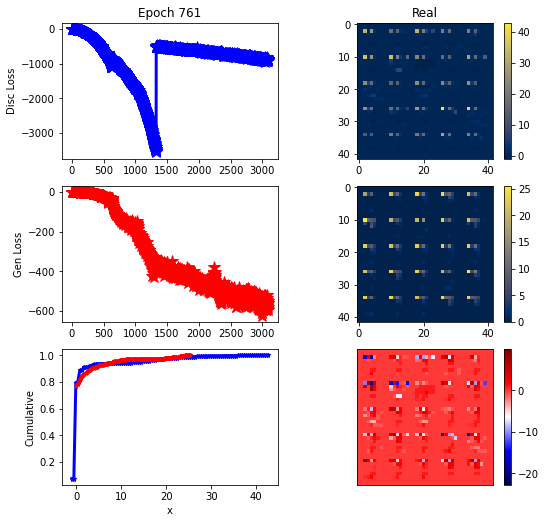

ErrG: -589.7445940290179, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


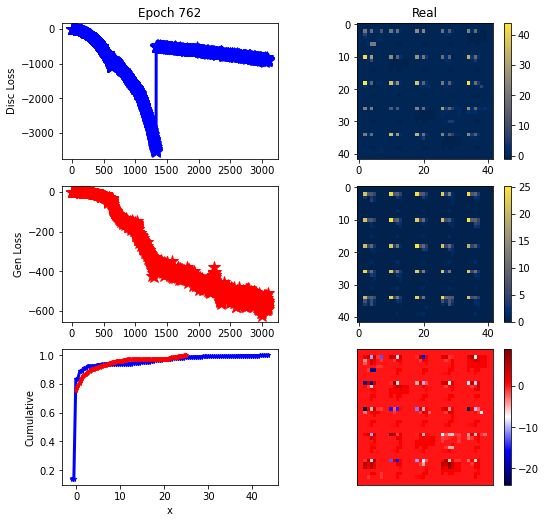

ErrG: -508.2101571219308, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


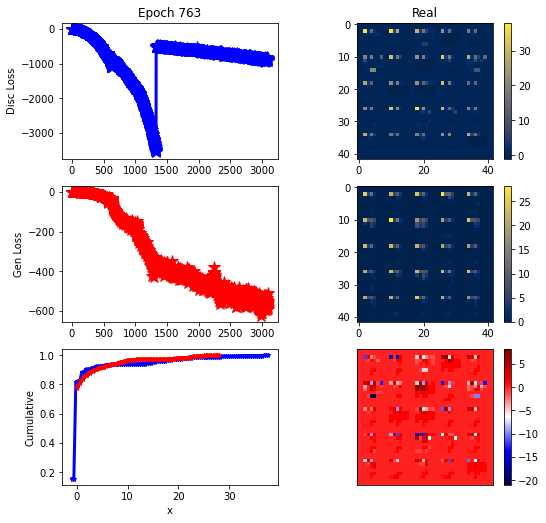

ErrG: -551.3347952706473, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


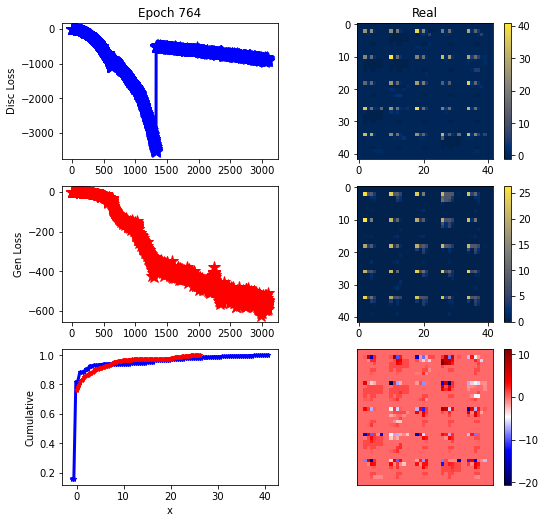

ErrG: -547.94382585798, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


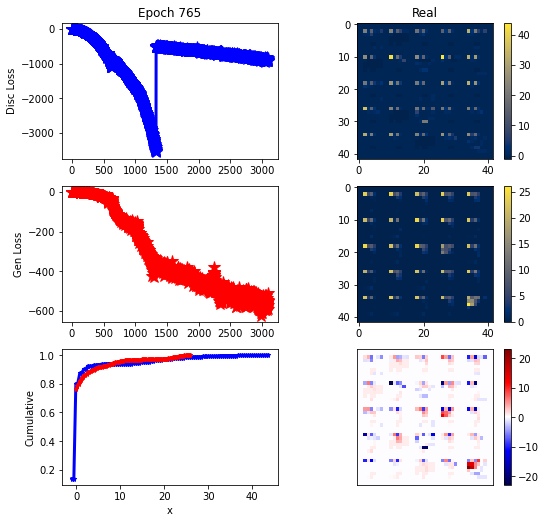

ErrG: -571.54296875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


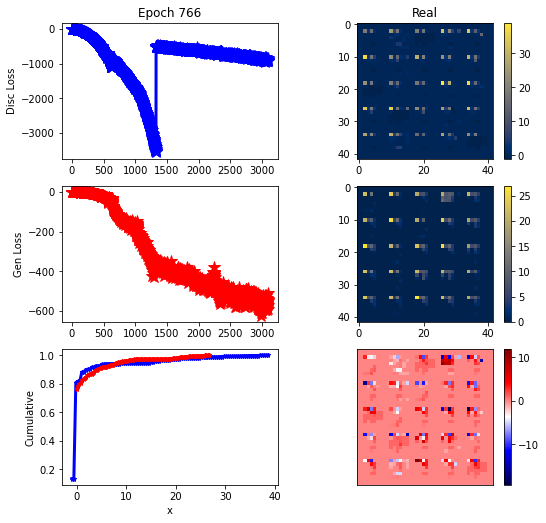

ErrG: -539.297097342355, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


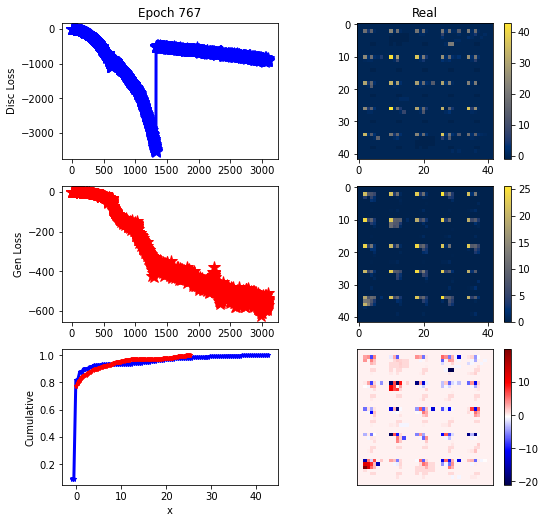

ErrG: -533.6980721609933, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


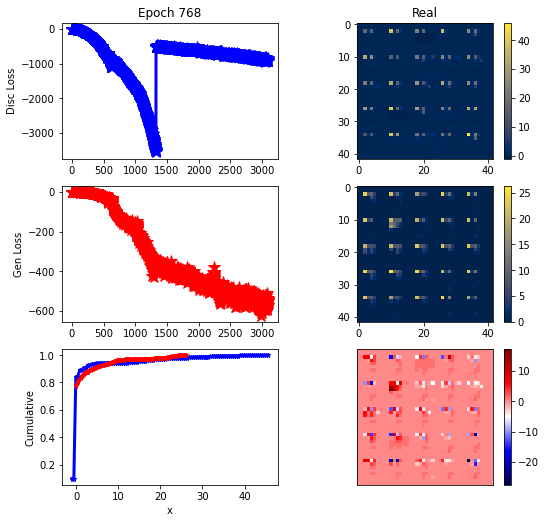

ErrG: -571.9739205496652, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


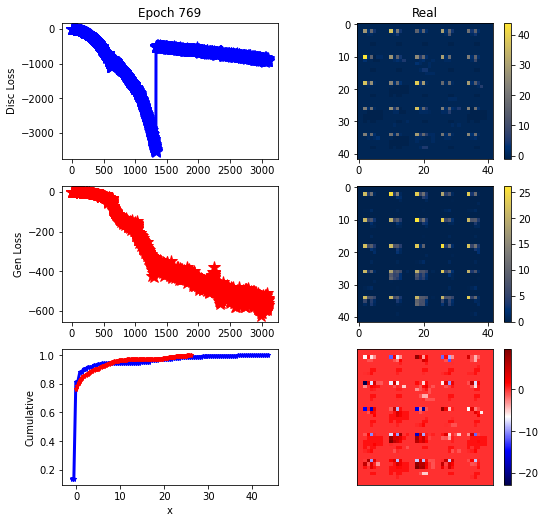

ErrG: -558.5843636648996, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


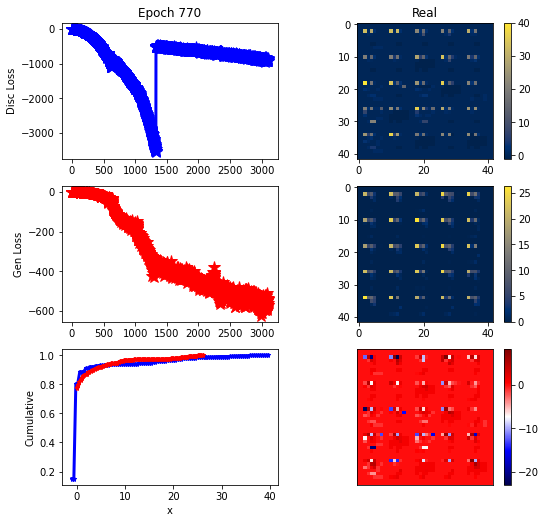

ErrG: -542.3959699358259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


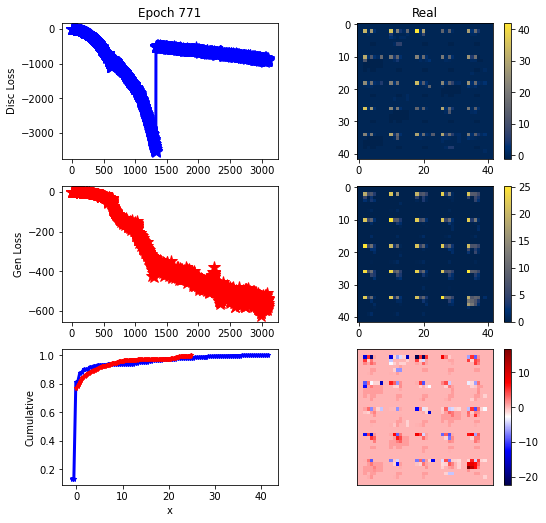

ErrG: -579.1762608119419, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


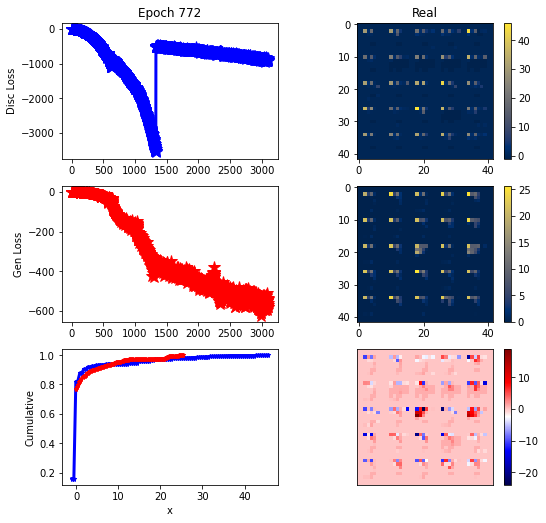

ErrG: -582.5448608398438, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


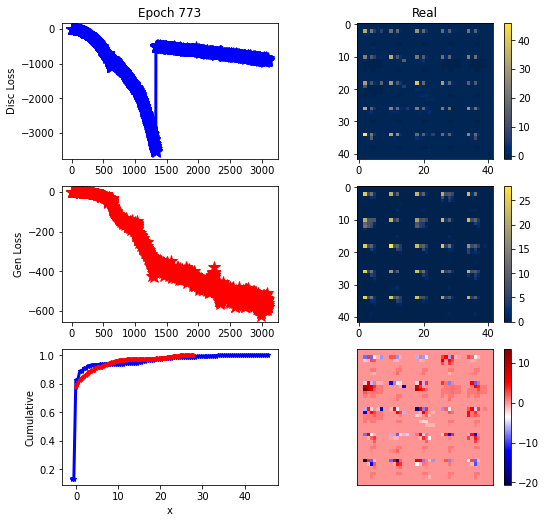

ErrG: -582.6734706333706, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


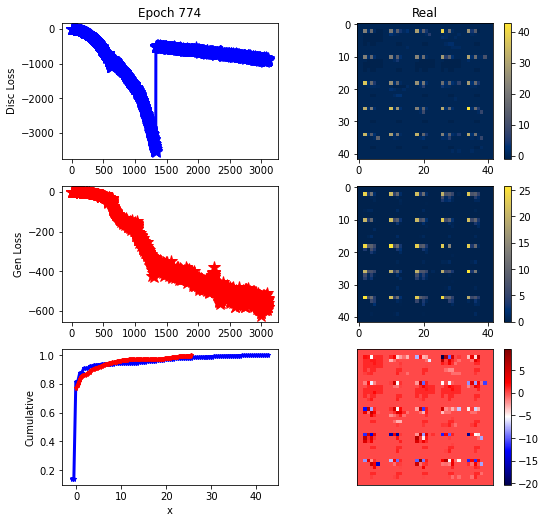

ErrG: -537.3552725655692, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


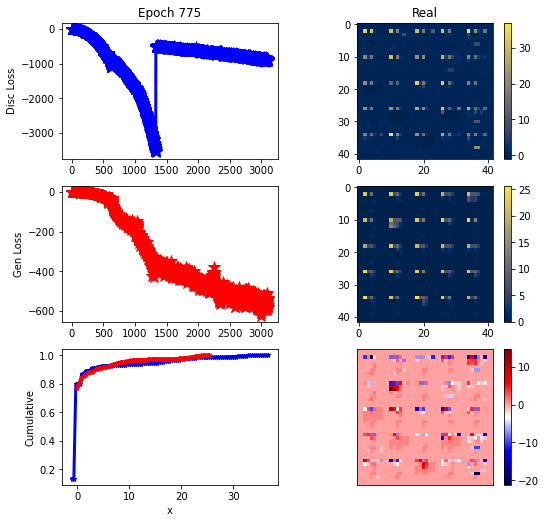

ErrG: -570.1451633998325, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


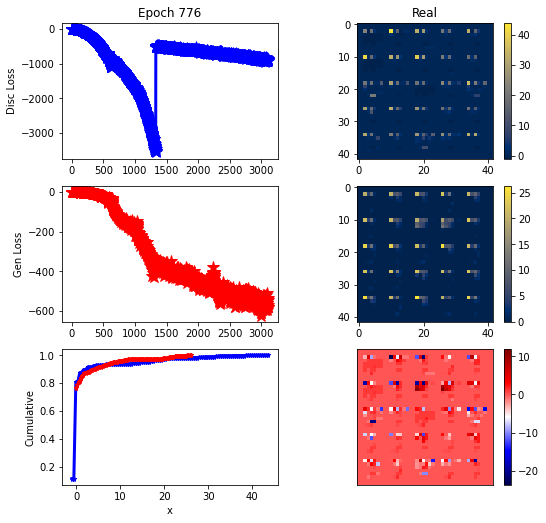

ErrG: -546.2268851143973, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


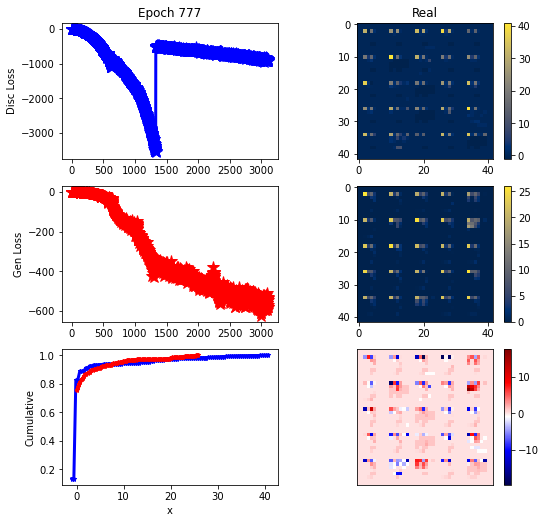

ErrG: -532.5346548897879, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


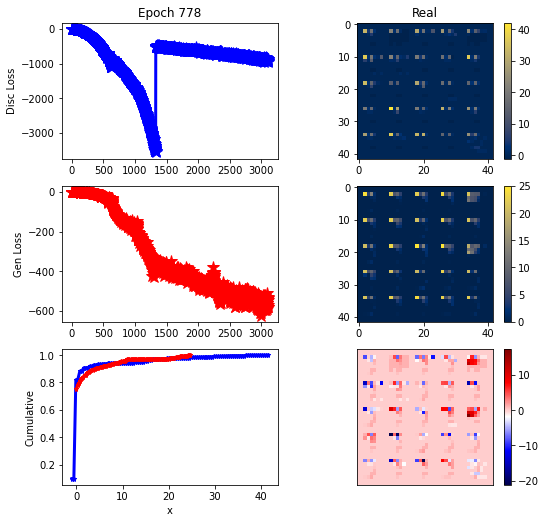

ErrG: -580.3075474330357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


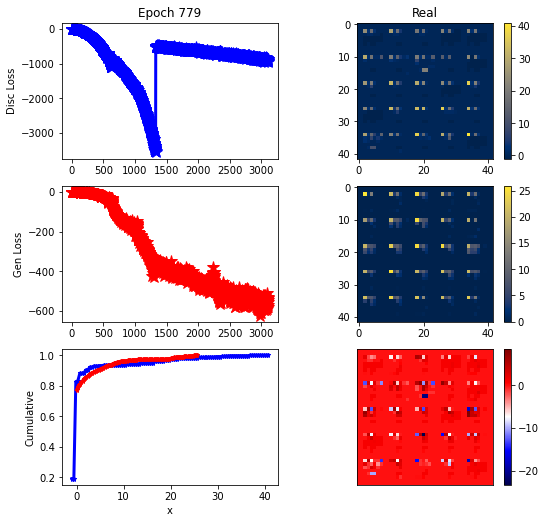

ErrG: -557.0543910435268, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


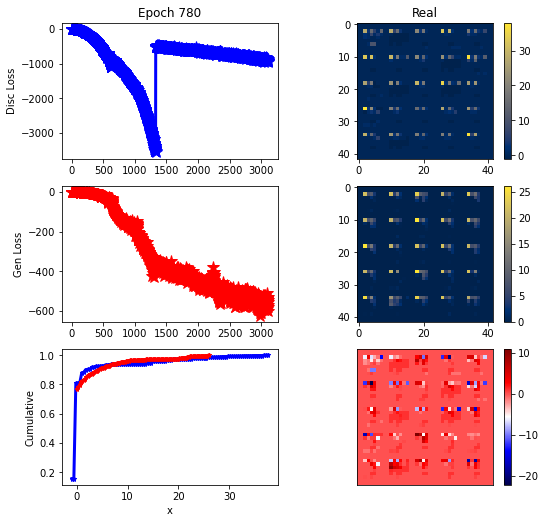

ErrG: -603.0865914481027, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


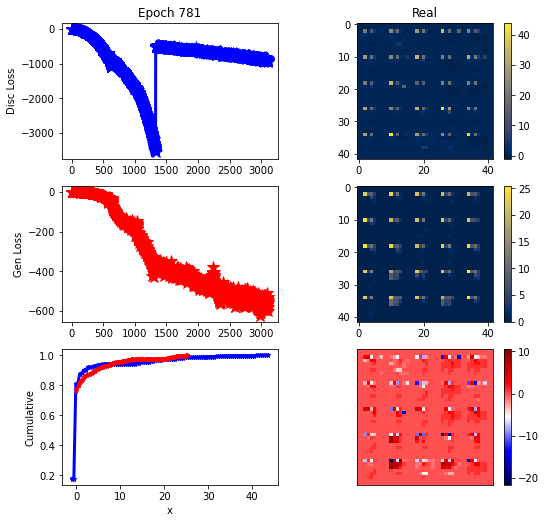

ErrG: -561.7658429827009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


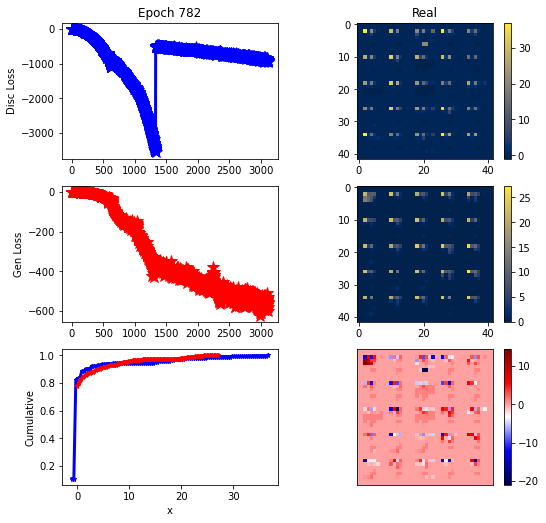

ErrG: -557.3616725376675, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


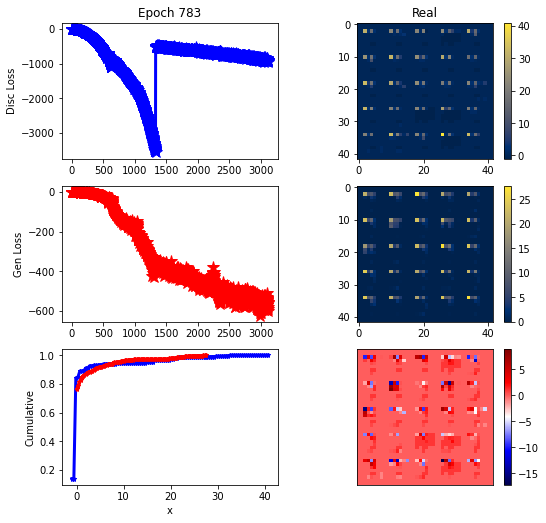

ErrG: -590.6100463867188, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


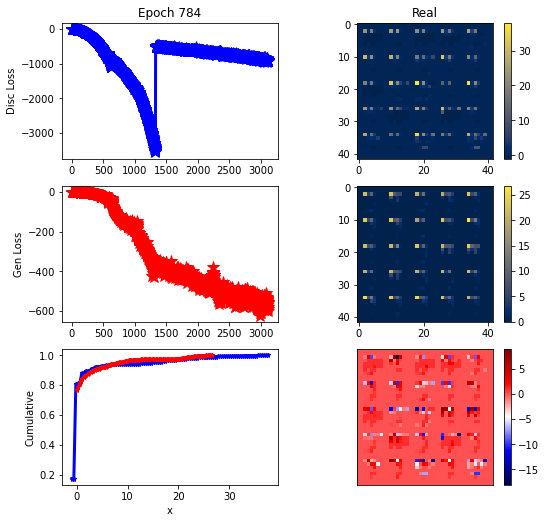

ErrG: -582.8055332728794, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


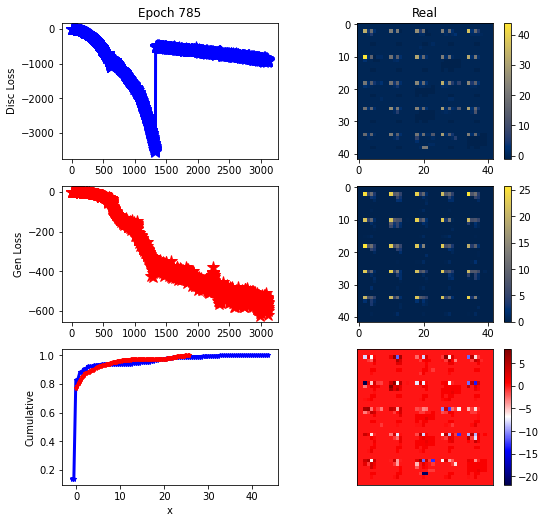

ErrG: -623.1556134905134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


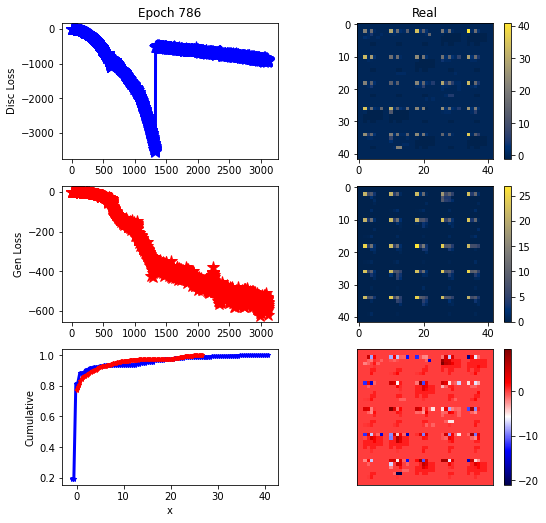

ErrG: -573.3870457240513, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


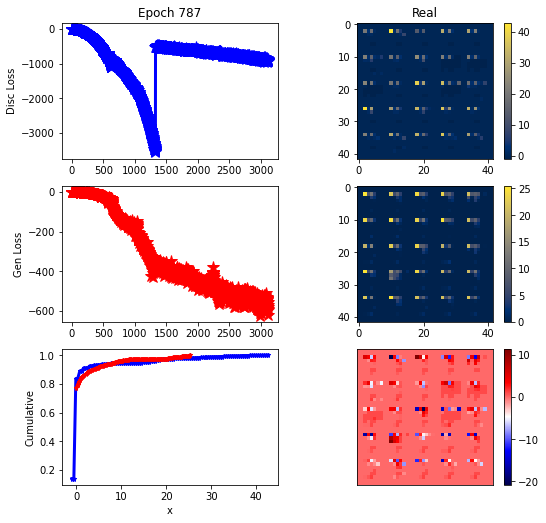

ErrG: -594.466081891741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


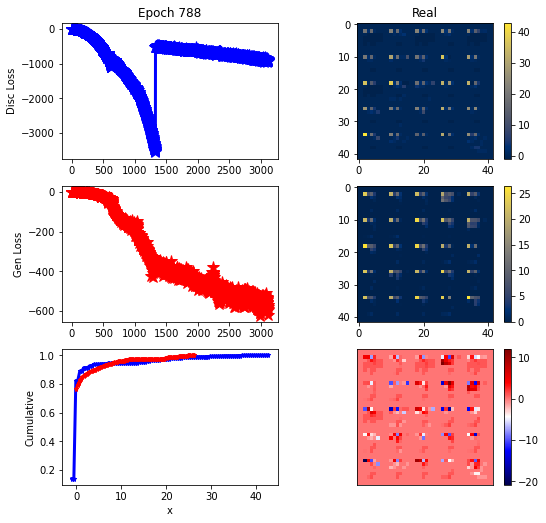

ErrG: -570.2418997628348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


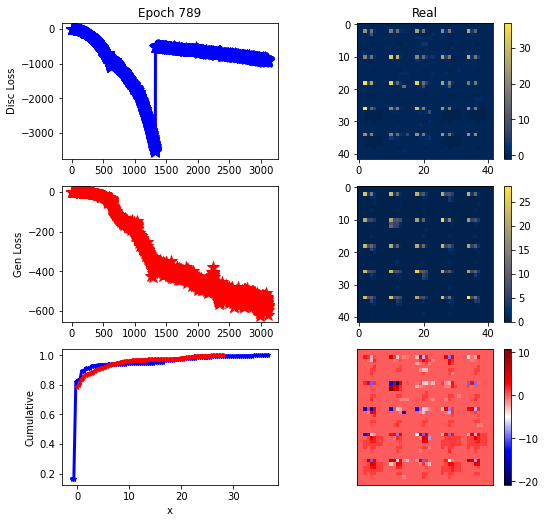

ErrG: -576.5994262695312, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


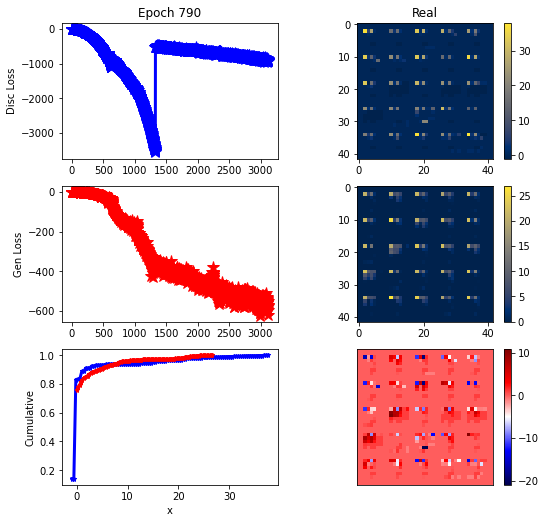

ErrG: -552.2792271205357, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


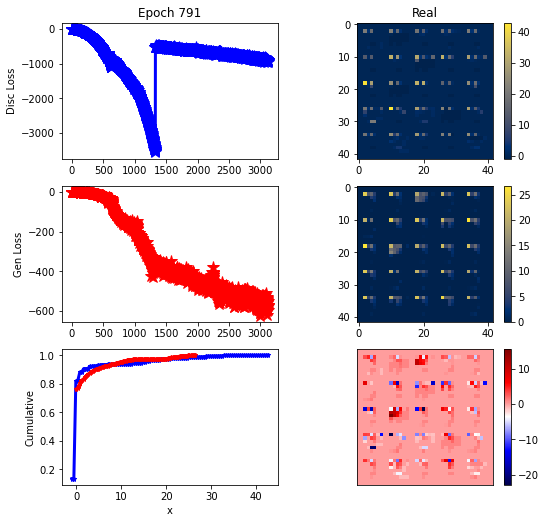

ErrG: -572.4682704380581, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


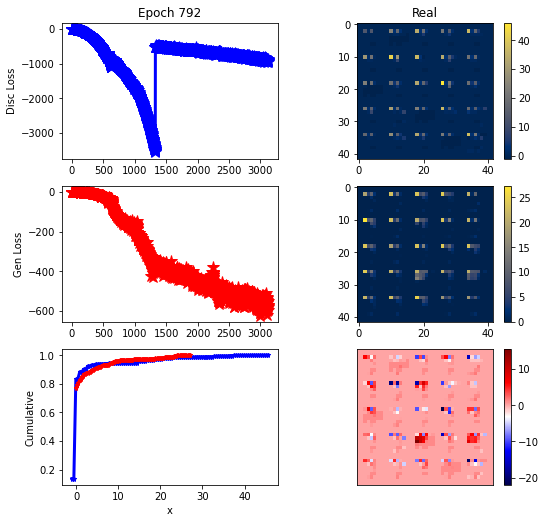

ErrG: -579.6543753487723, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


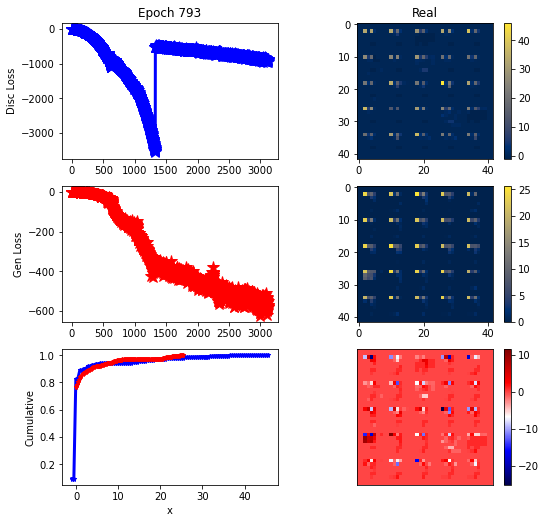

ErrG: -579.5066179547991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


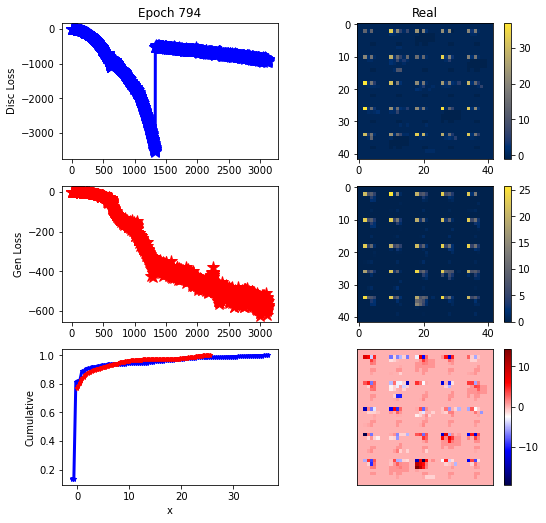

ErrG: -571.8251081194196, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


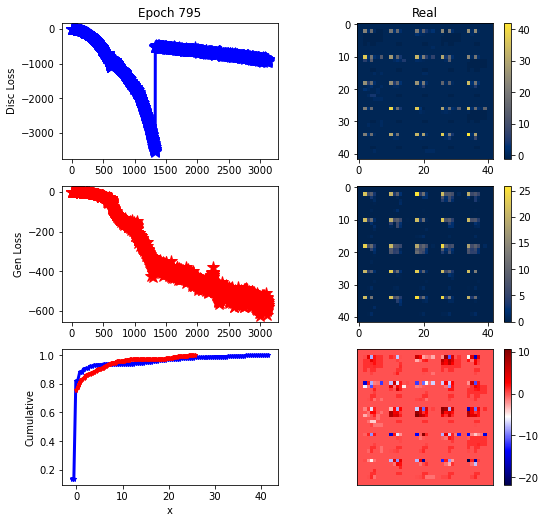

ErrG: -562.5542689732143, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


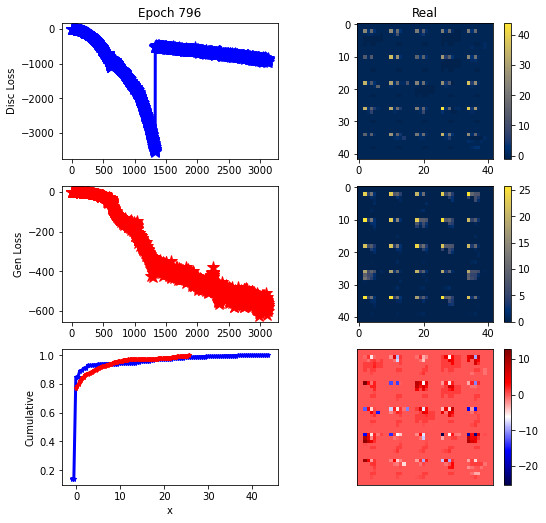

ErrG: -599.4389997209821, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


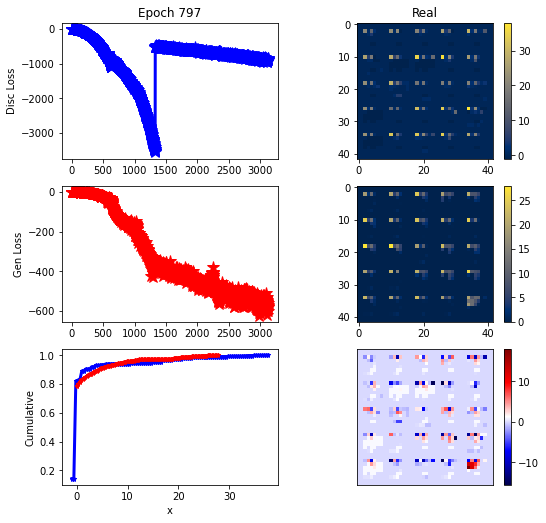

ErrG: -577.6521126883371, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


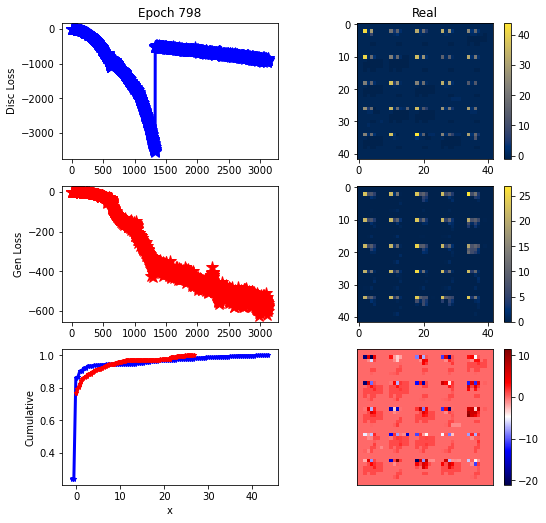

ErrG: -581.34714617048, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


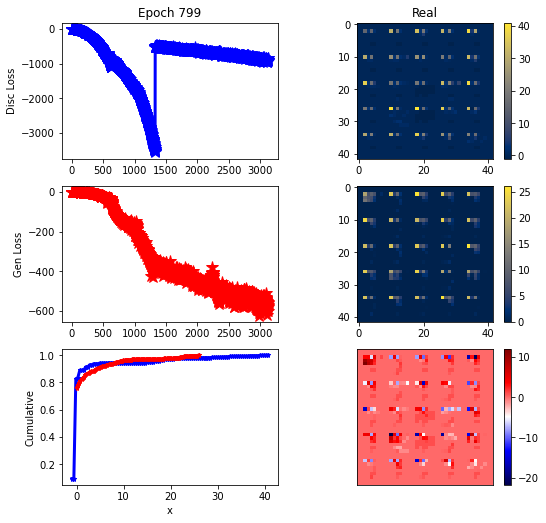

ErrG: -555.5207606724331, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


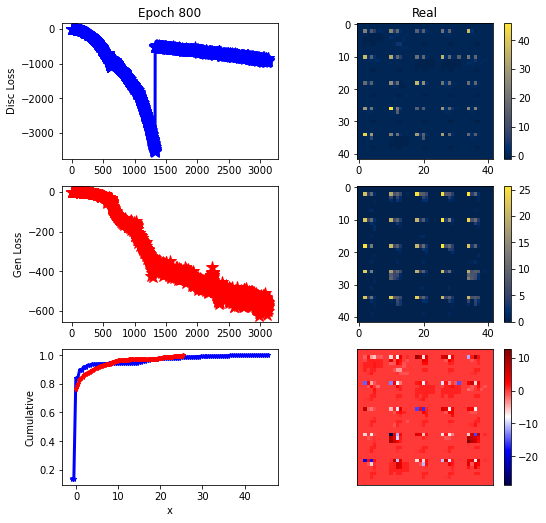

ErrG: -570.0121023995536, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


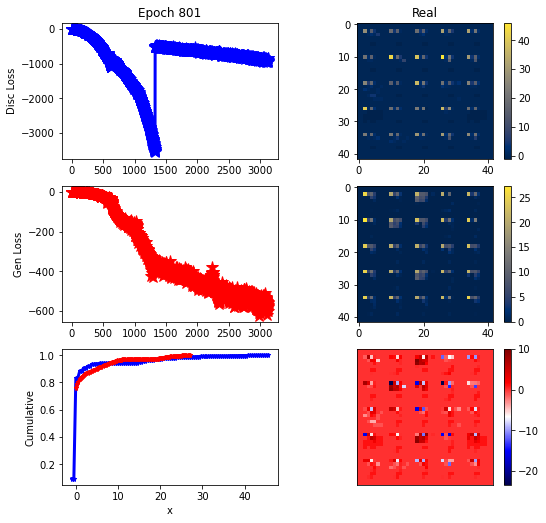

ErrG: -560.9152396065848, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


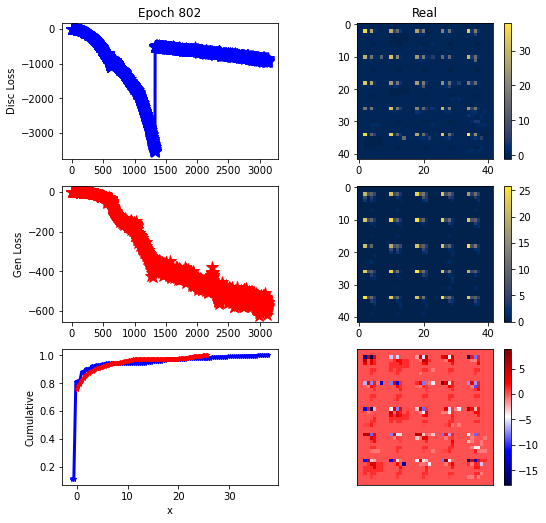

ErrG: -554.8150155203683, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


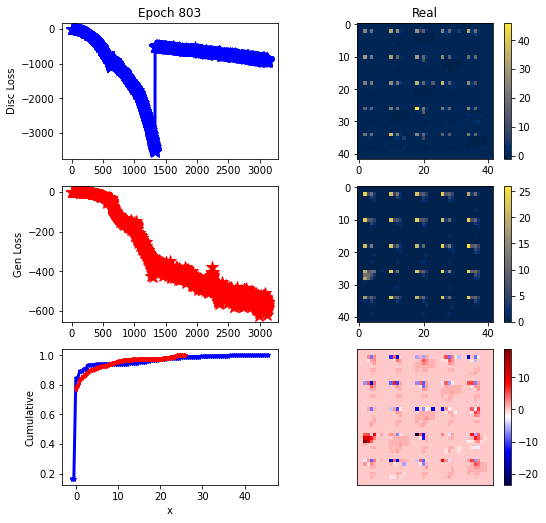

ErrG: -588.0997619628906, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


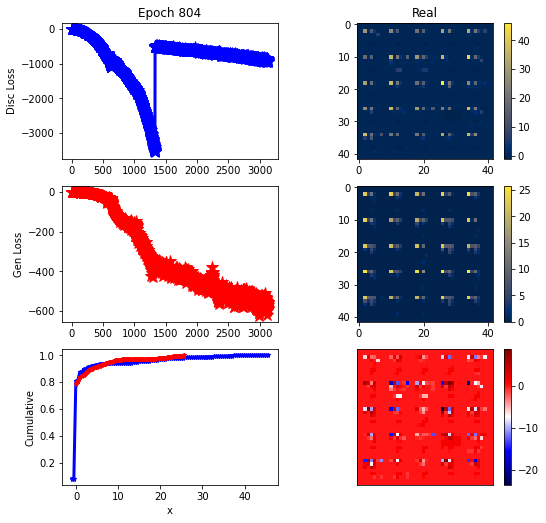

ErrG: -593.4588099888393, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


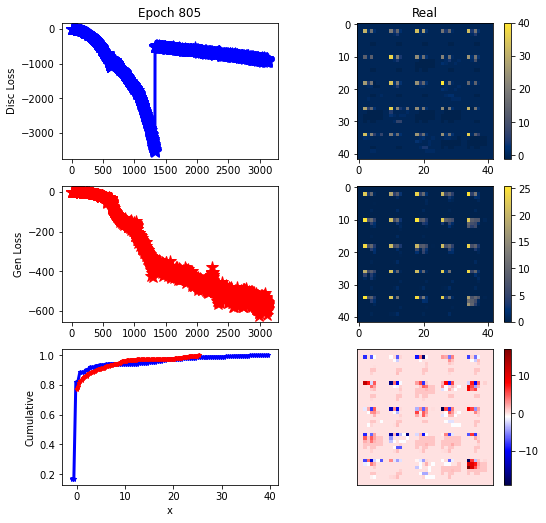

ErrG: -564.7679443359375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


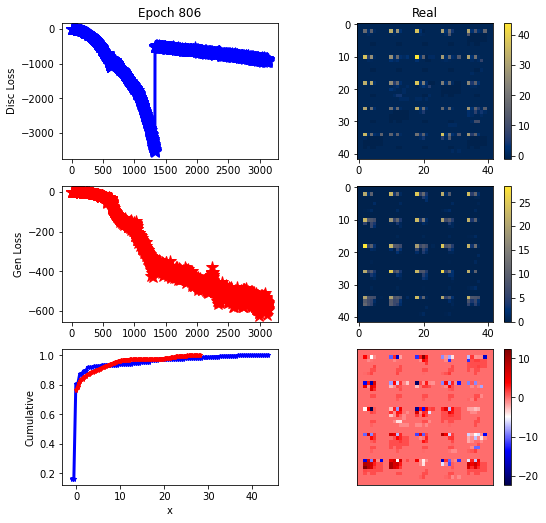

ErrG: -596.5648193359375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


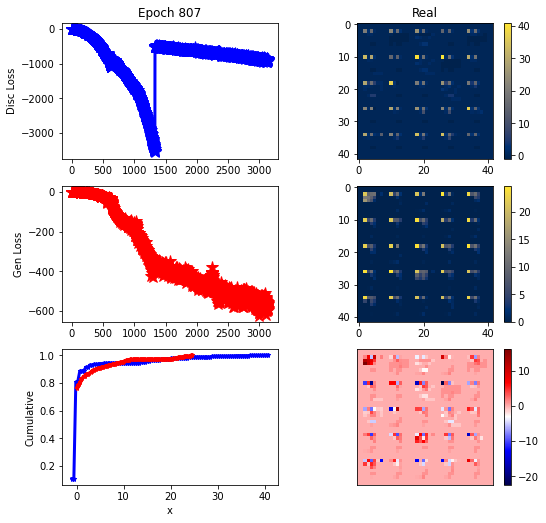

ErrG: -559.4716273716518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


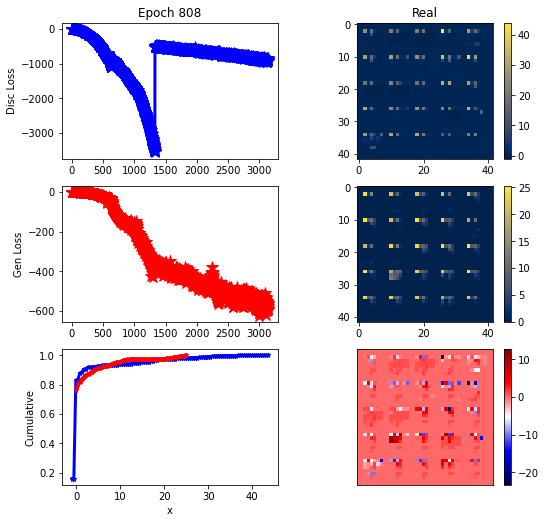

ErrG: -577.7484872000558, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


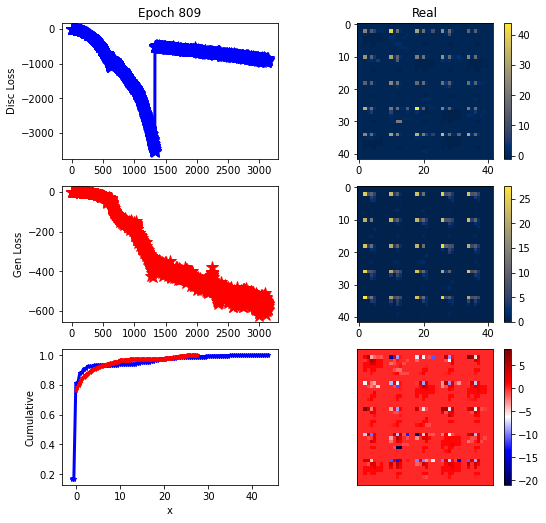

ErrG: -564.7953665597098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


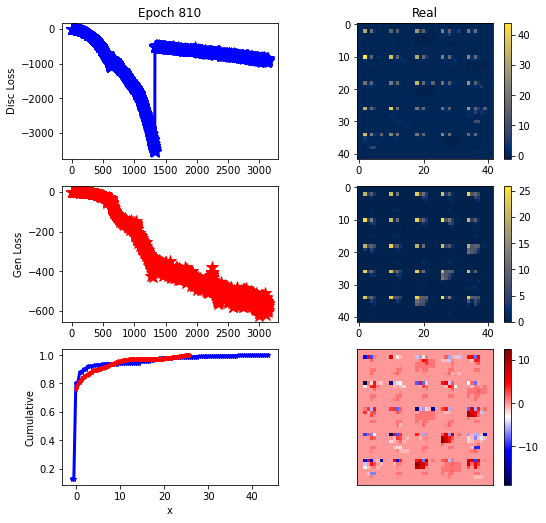

ErrG: -608.8242972237723, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


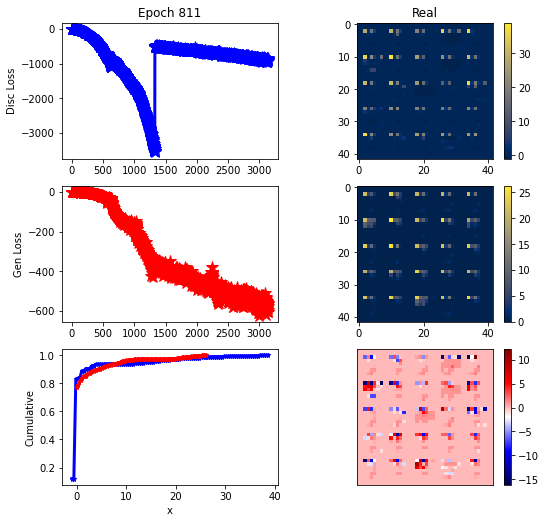

ErrG: -603.9573625837054, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


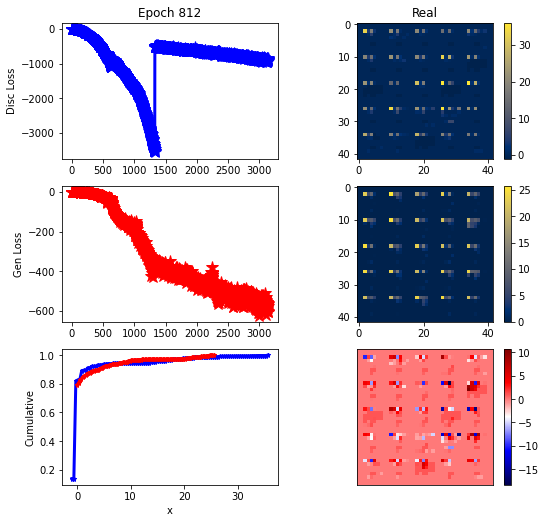

ErrG: -600.2627301897321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


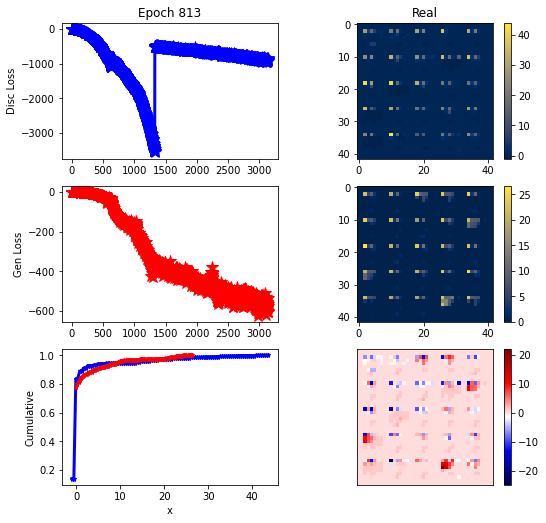

ErrG: -533.4034598214286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


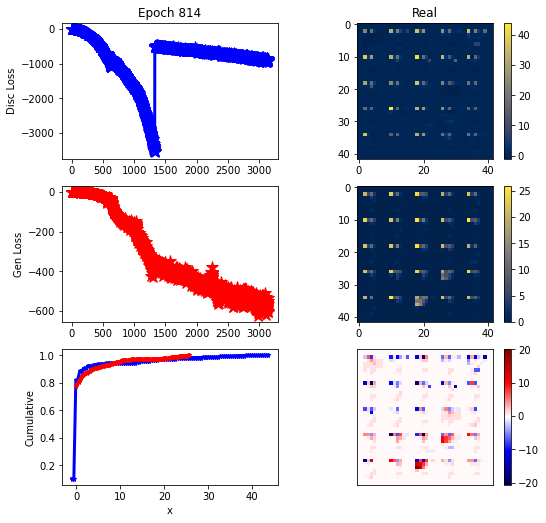

ErrG: -548.7522321428571, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


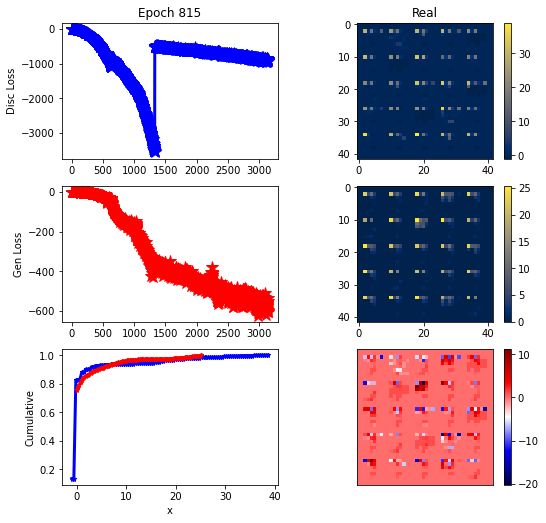

ErrG: -595.1308506556919, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


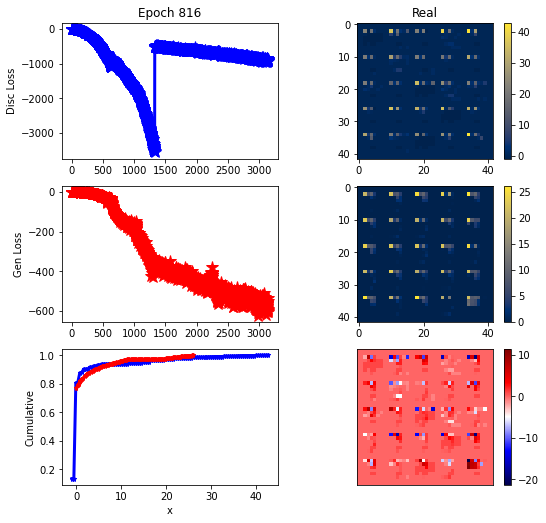

ErrG: -591.2081647600446, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


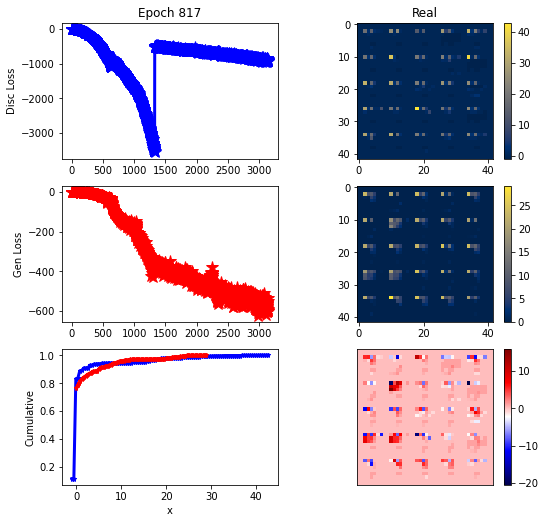

ErrG: -601.0647059849331, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


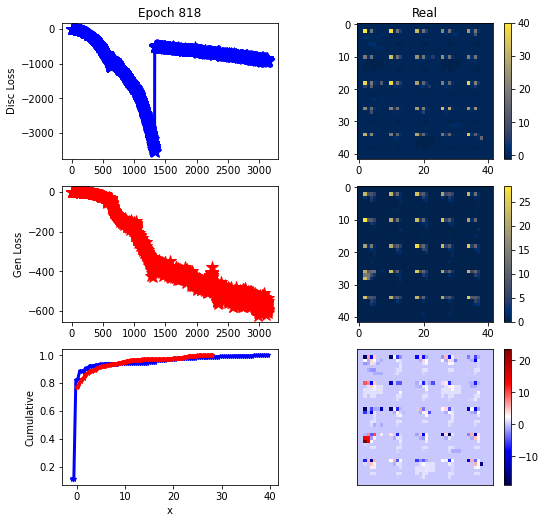

ErrG: -608.996826171875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


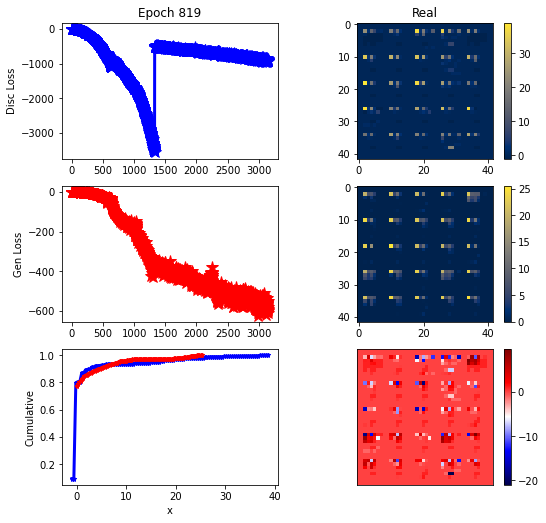

ErrG: -580.5650329589844, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


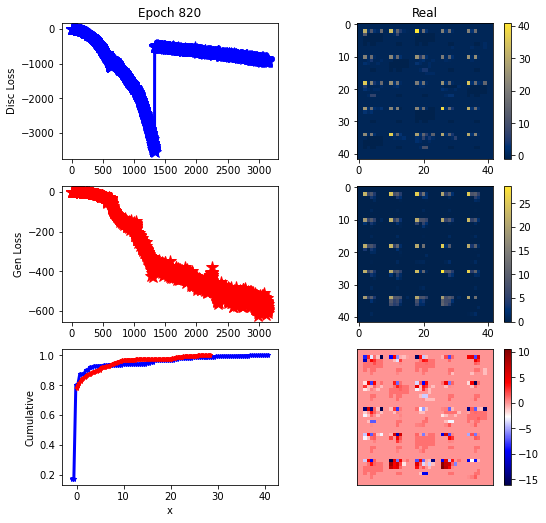

ErrG: -563.4977591378348, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


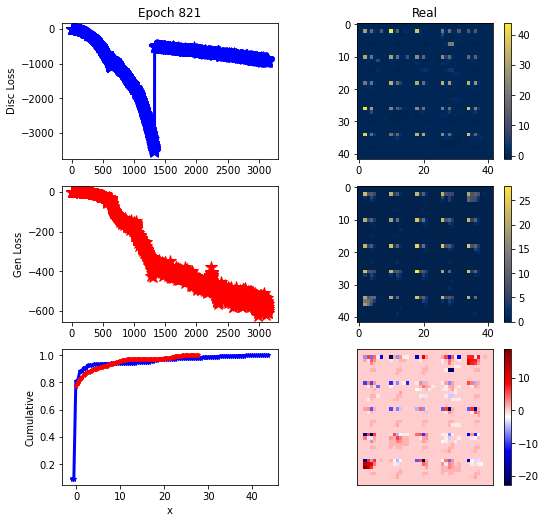

ErrG: -609.7398943219866, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


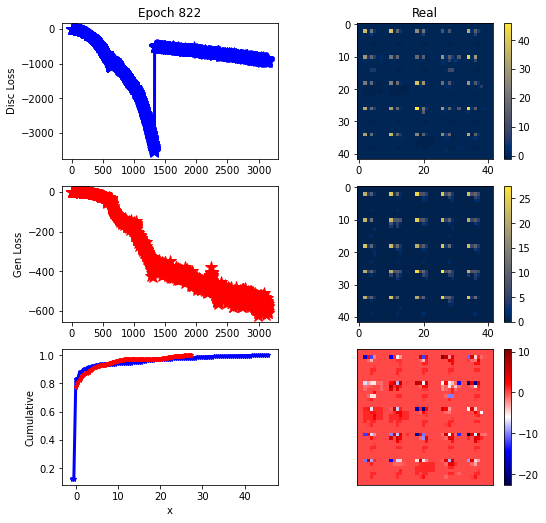

ErrG: -578.4026489257812, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


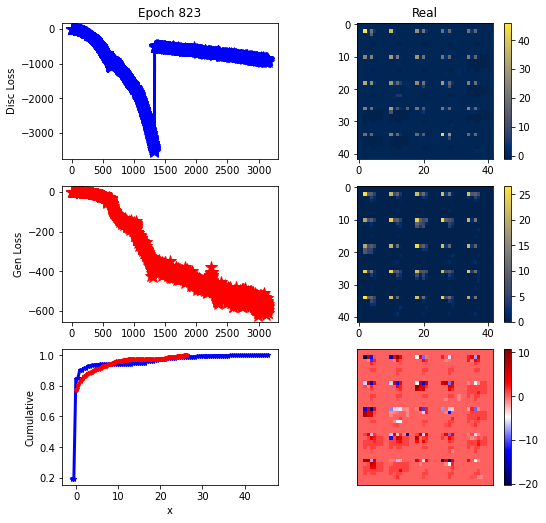

ErrG: -598.37158203125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


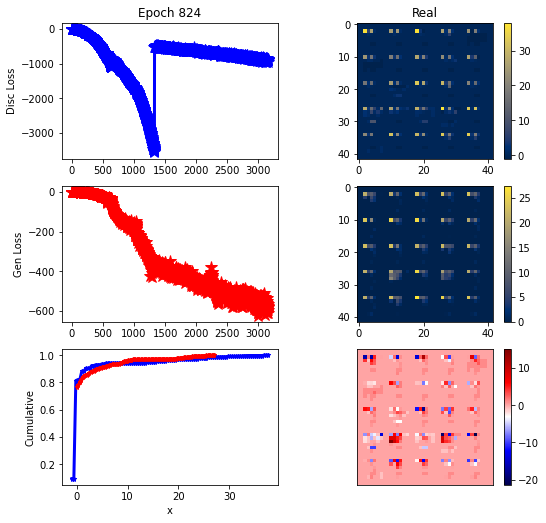

ErrG: -583.0242701939175, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


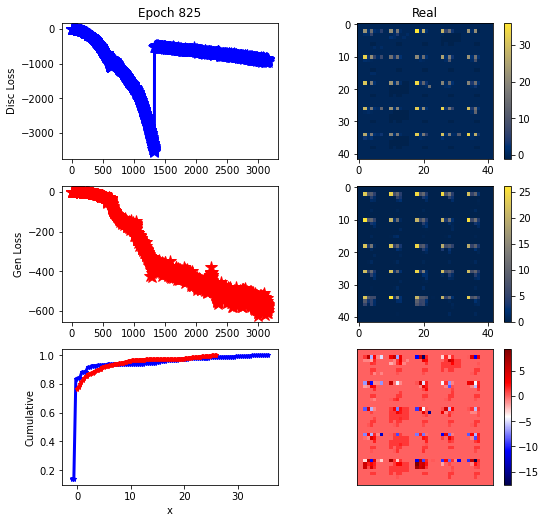

ErrG: -571.711896623884, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


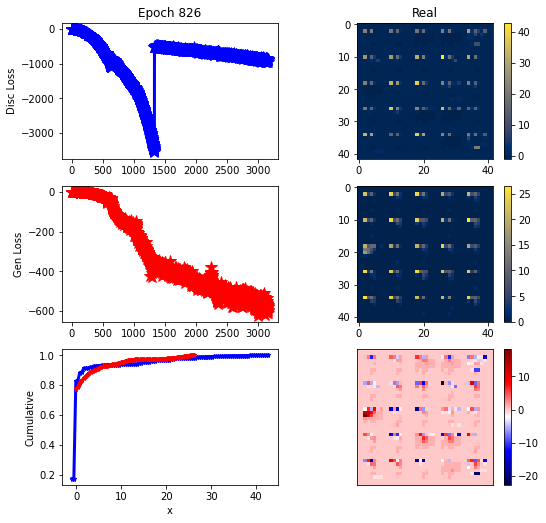

ErrG: -601.8594665527344, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


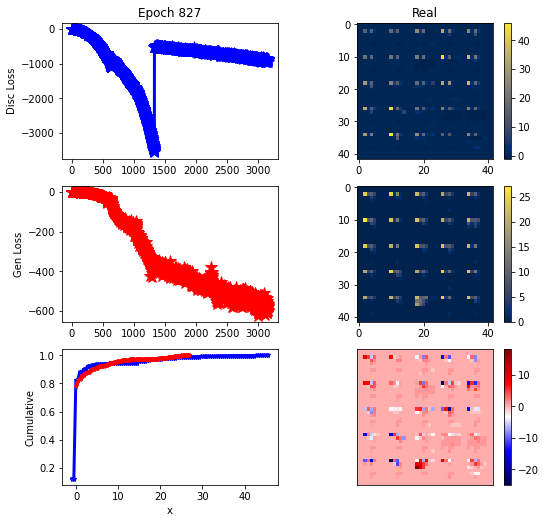

ErrG: -568.4639674595425, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


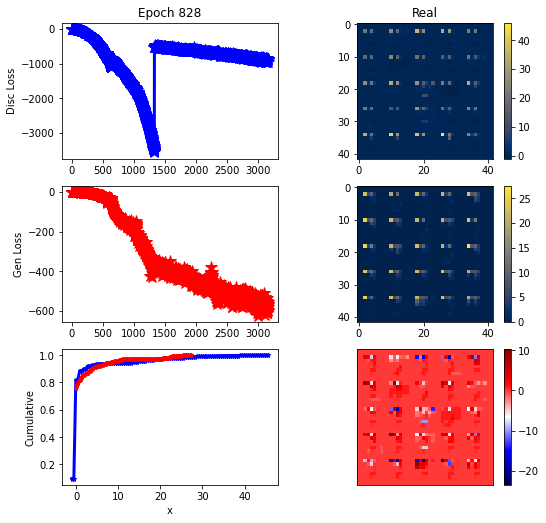

ErrG: -554.4896022251675, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


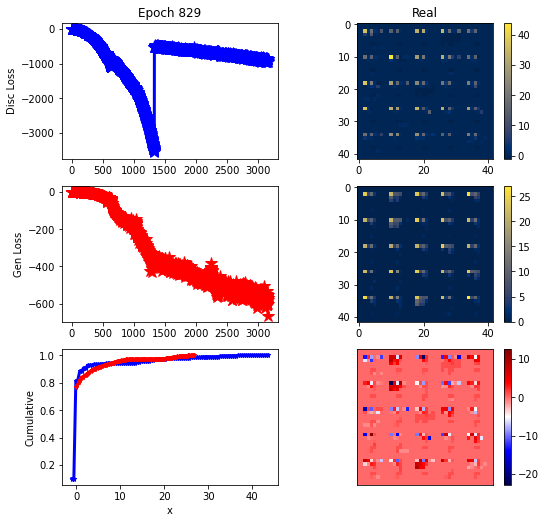

ErrG: -664.7319771902902, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


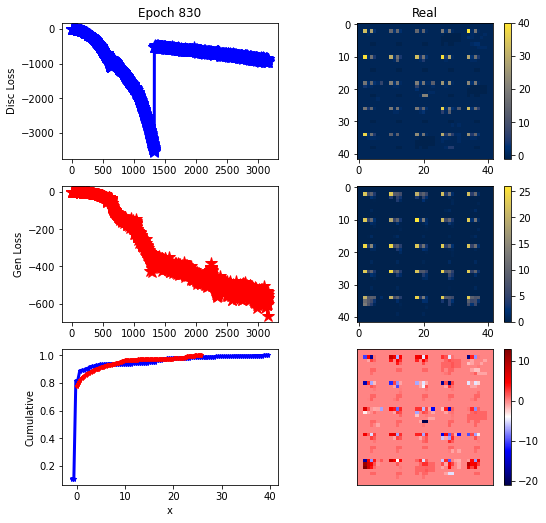

ErrG: -538.8500409807477, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


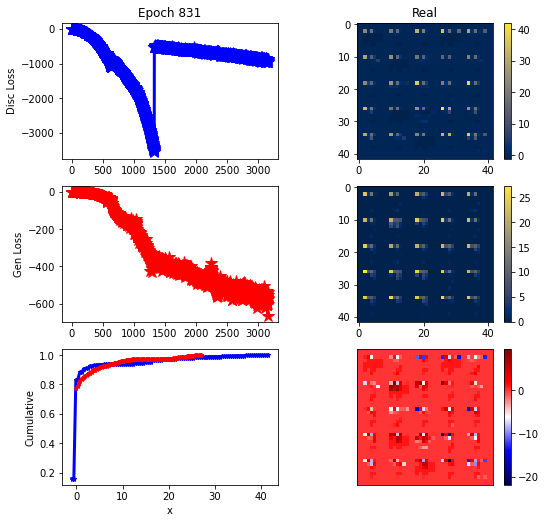

ErrG: -577.3111223493304, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


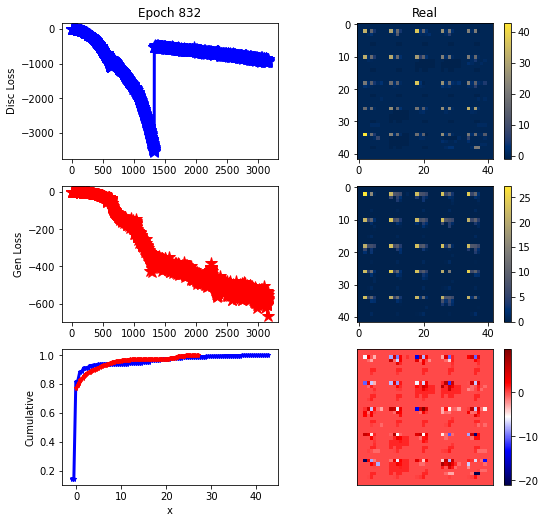

ErrG: -580.6863228934152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


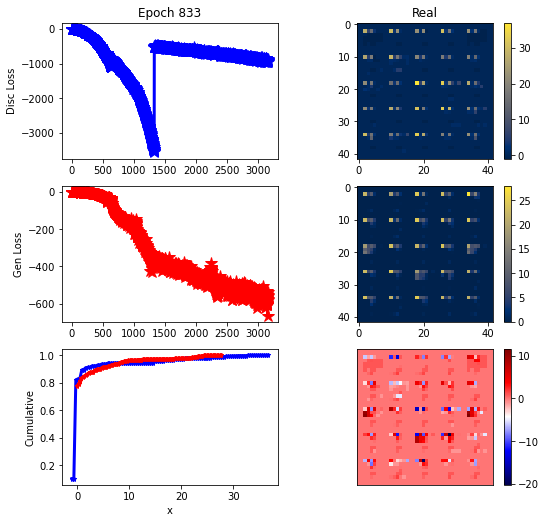

ErrG: -557.7367379324777, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


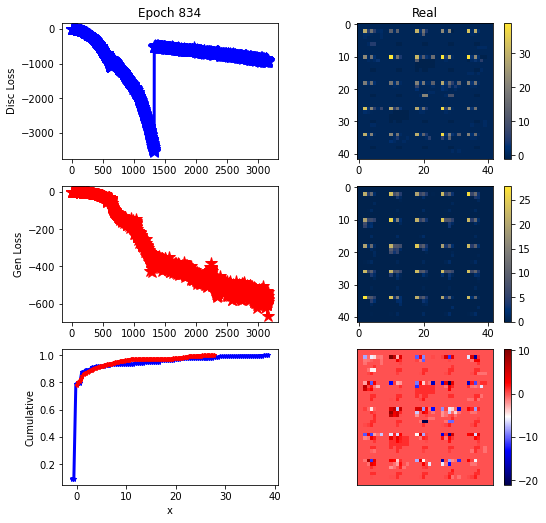

ErrG: -593.5032697405134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


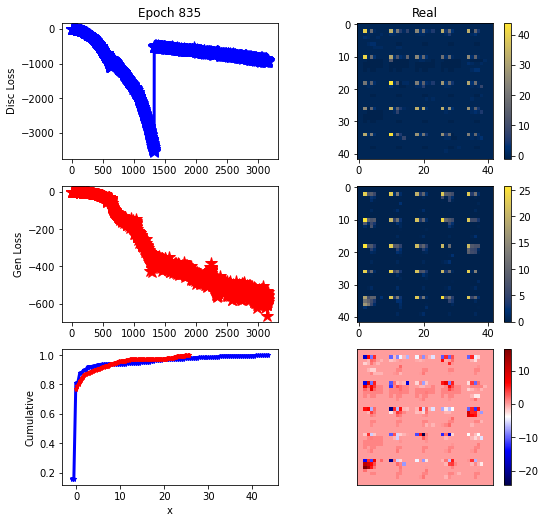

ErrG: -556.4442705426898, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


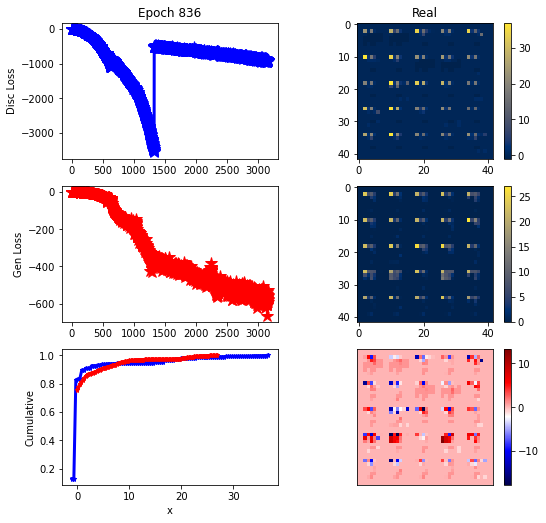

ErrG: -529.82663835798, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


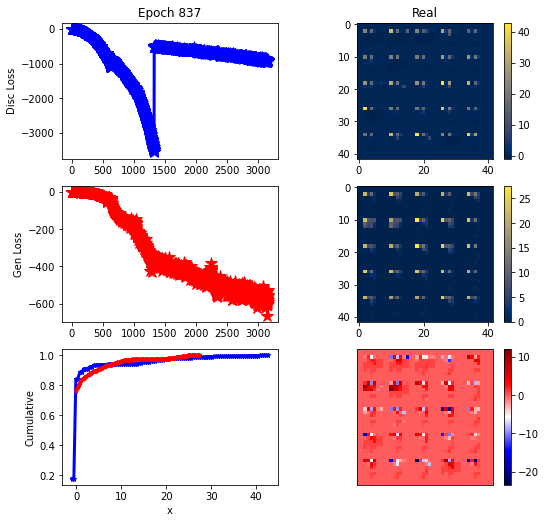

ErrG: -603.2168927873884, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


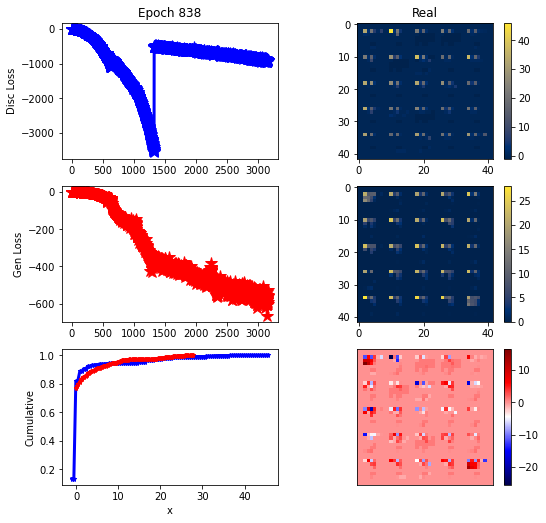

ErrG: -560.5658307756696, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


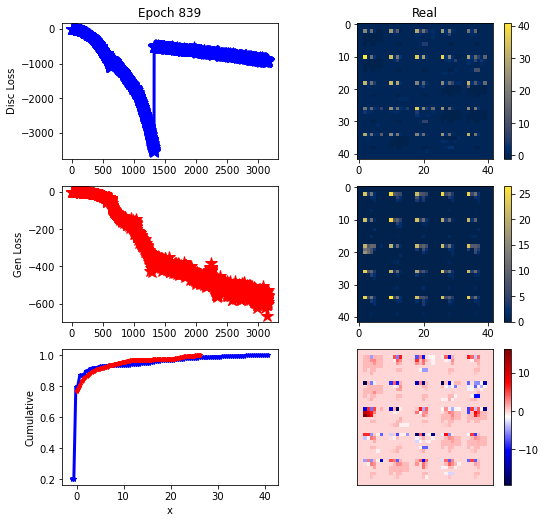

ErrG: -557.9378400530134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


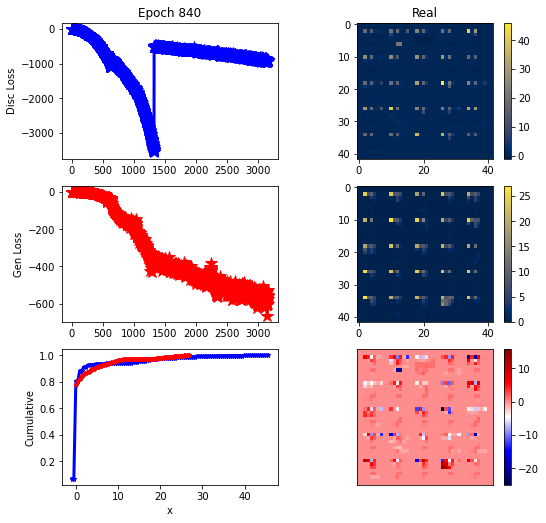

ErrG: -574.4828839983259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


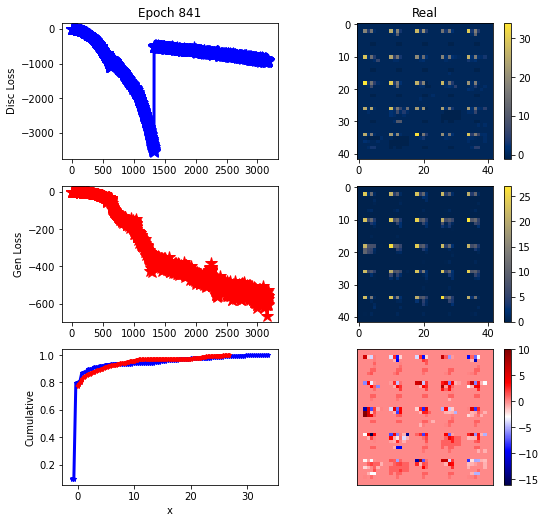

ErrG: -607.1732613699777, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


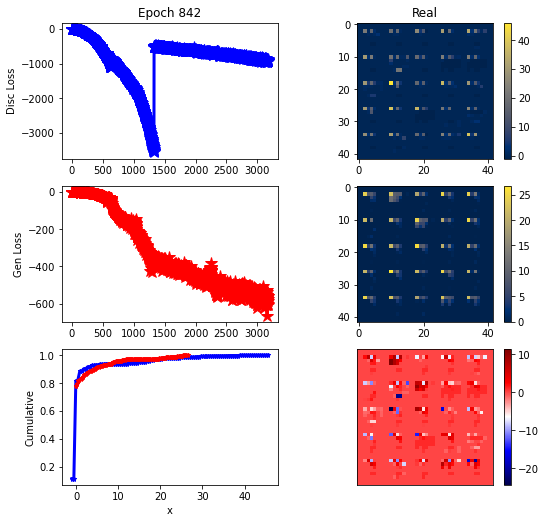

ErrG: -589.1514500209263, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


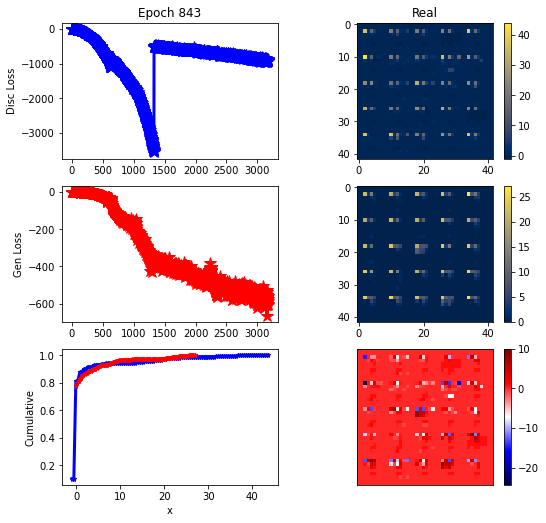

ErrG: -600.9135131835938, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


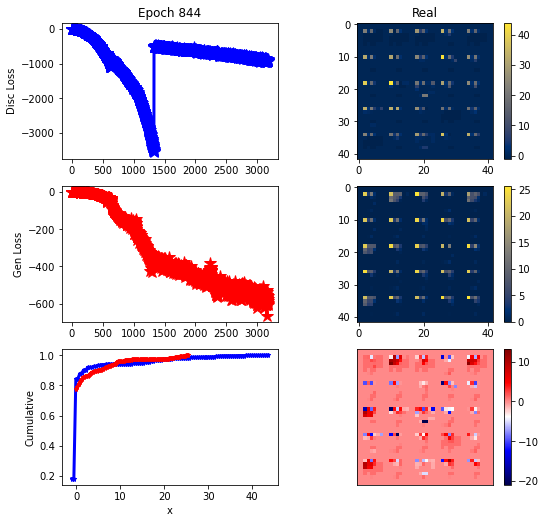

ErrG: -594.5712105887277, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


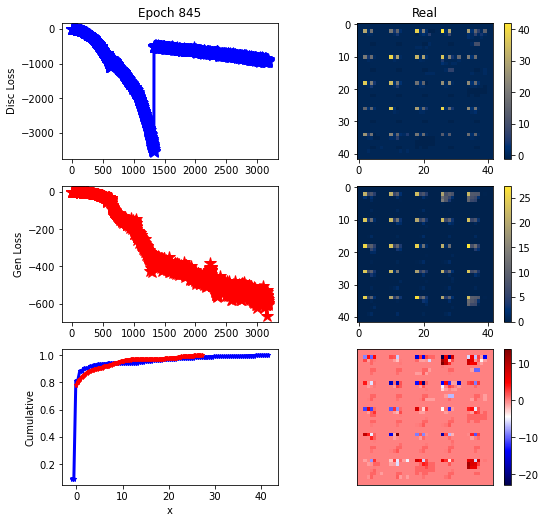

ErrG: -596.7637154715402, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


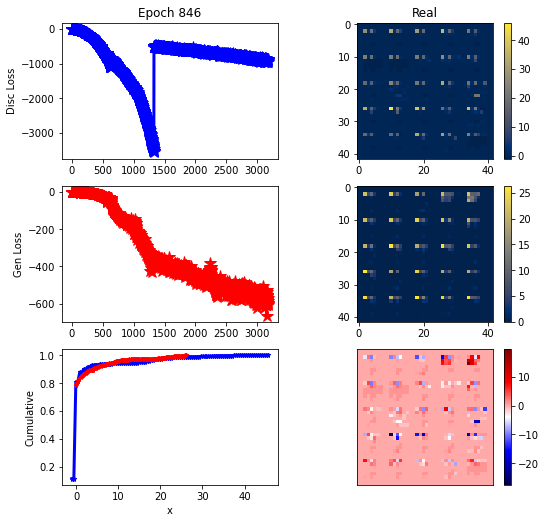

ErrG: -569.31103515625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


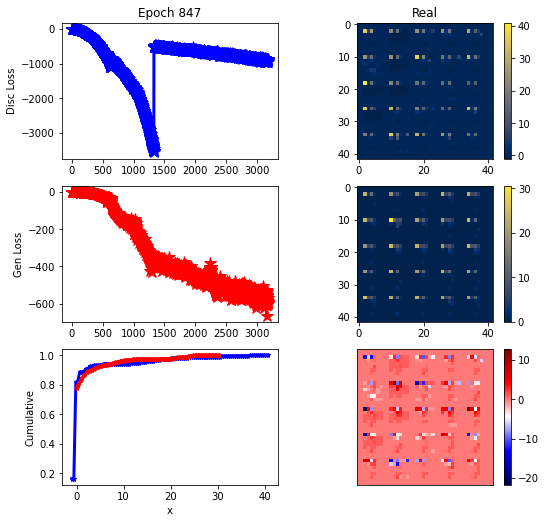

ErrG: -592.7173897879464, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


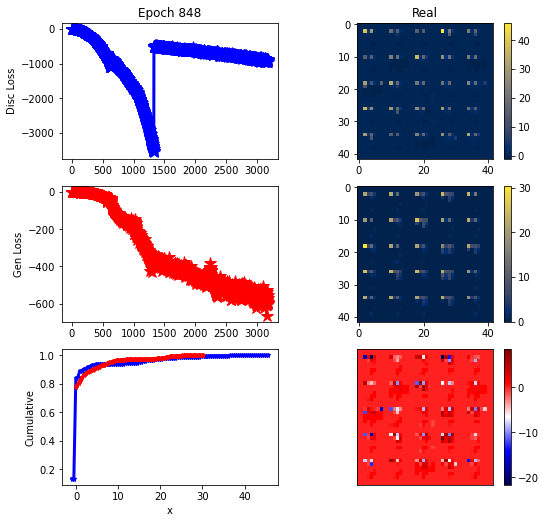

ErrG: -552.0479125976562, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


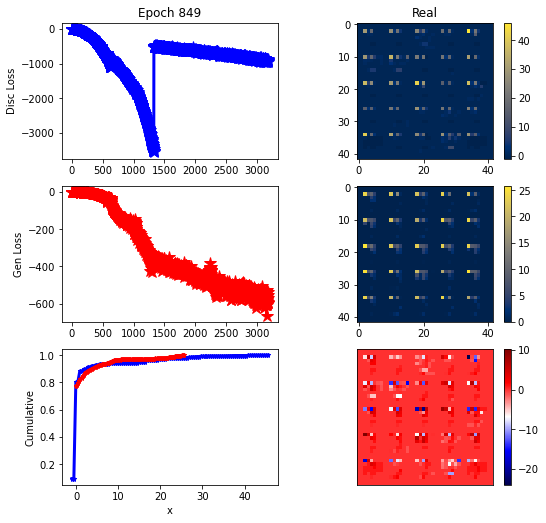

ErrG: -536.7454921177456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


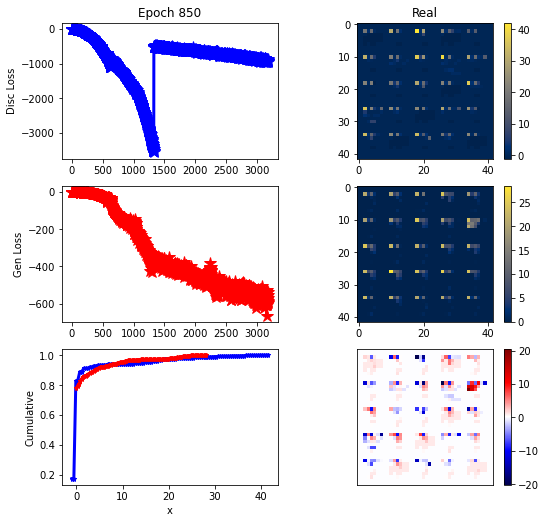

ErrG: -584.0728585379464, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


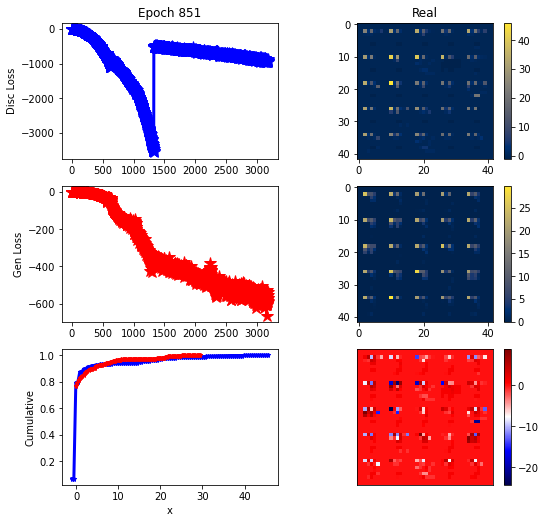

ErrG: -569.5297502790179, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


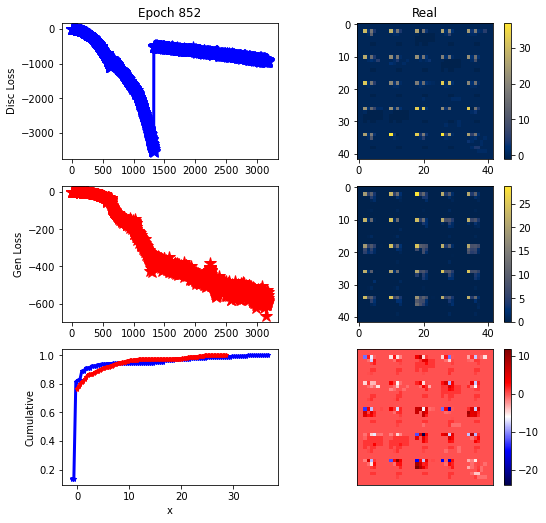

ErrG: -578.6182948521206, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


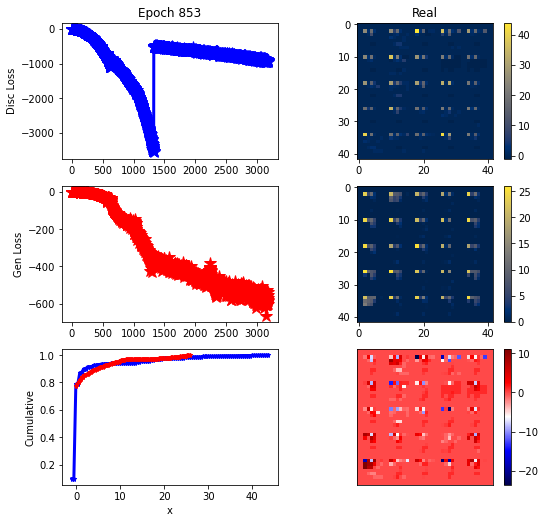

ErrG: -603.3230067661831, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


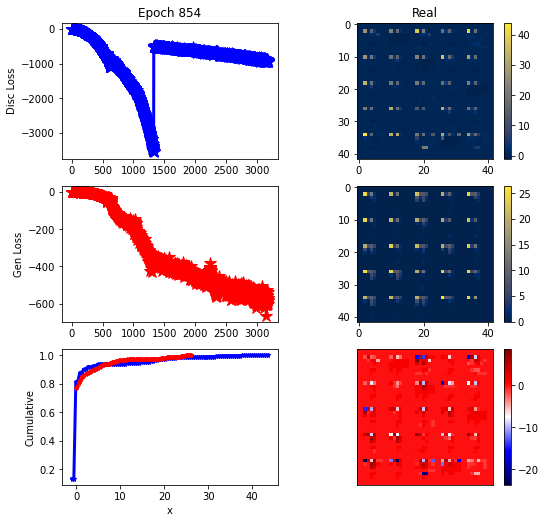

ErrG: -568.8863307407925, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


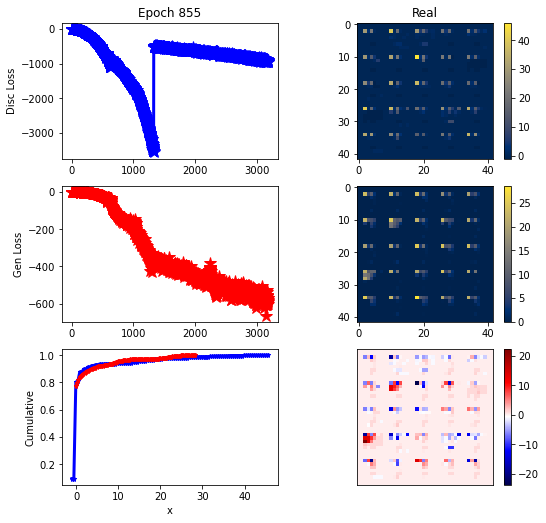

ErrG: -593.2404697963169, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


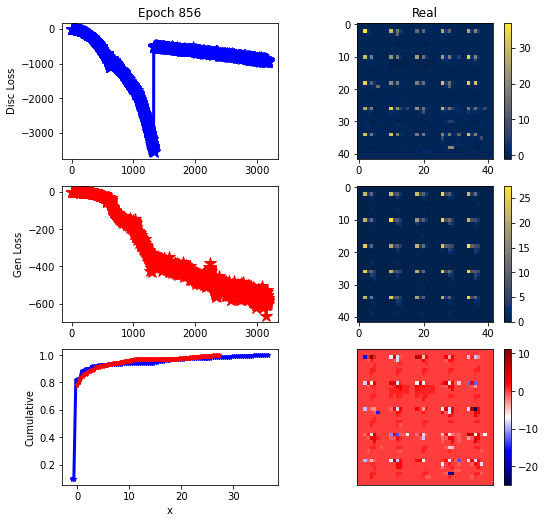

ErrG: -586.8993617466518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


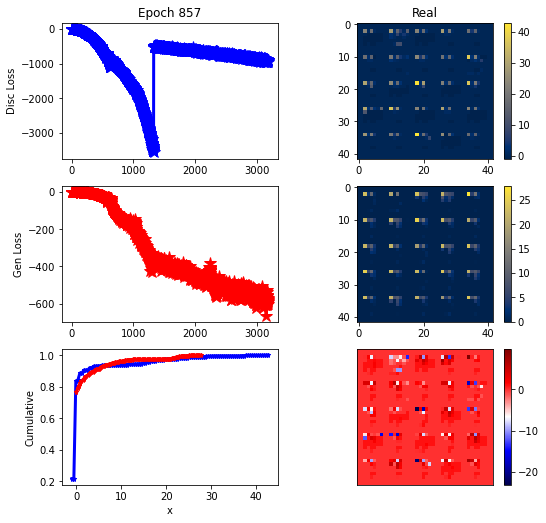

ErrG: -574.2491891043527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


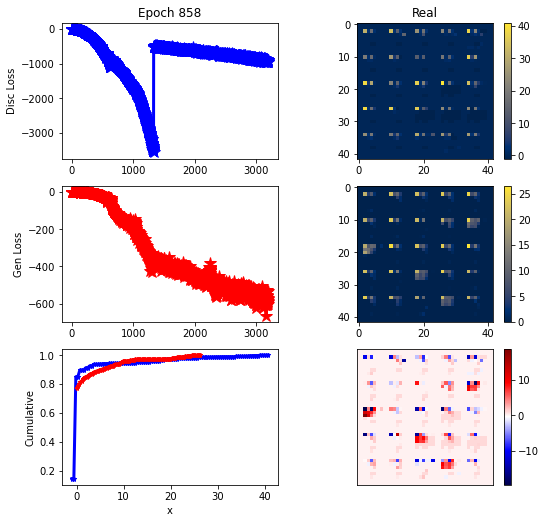

ErrG: -533.89206804548, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


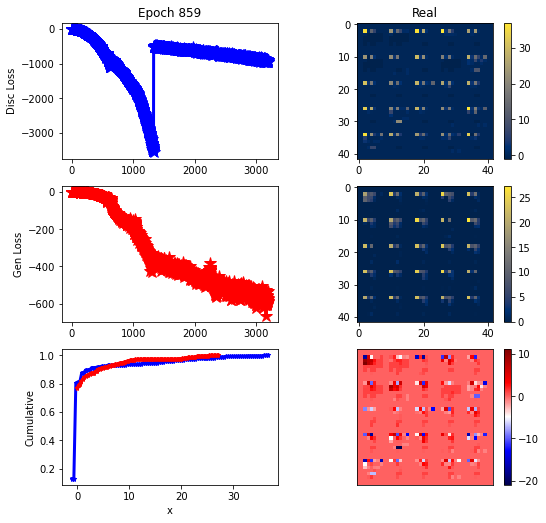

ErrG: -587.0839582170759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


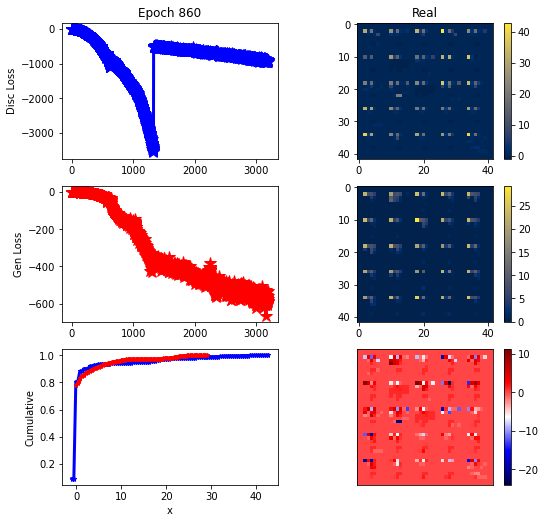

ErrG: -560.8910522460938, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


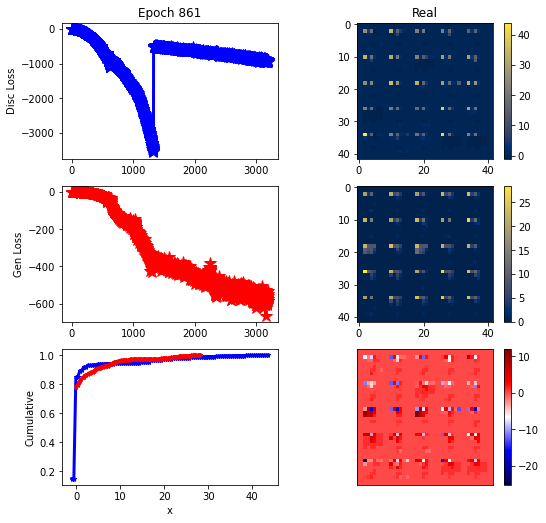

ErrG: -549.4207327706473, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


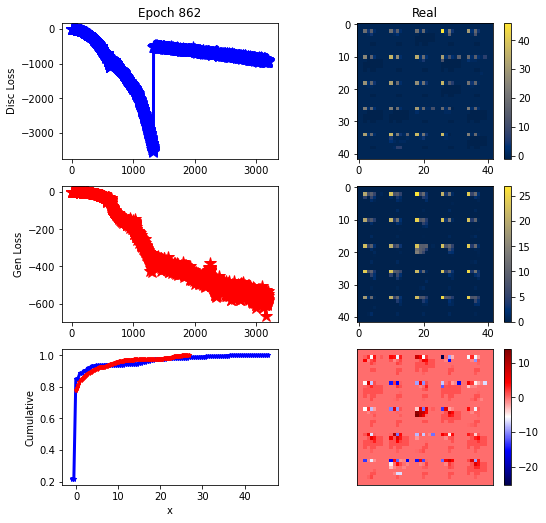

ErrG: -582.9358520507812, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


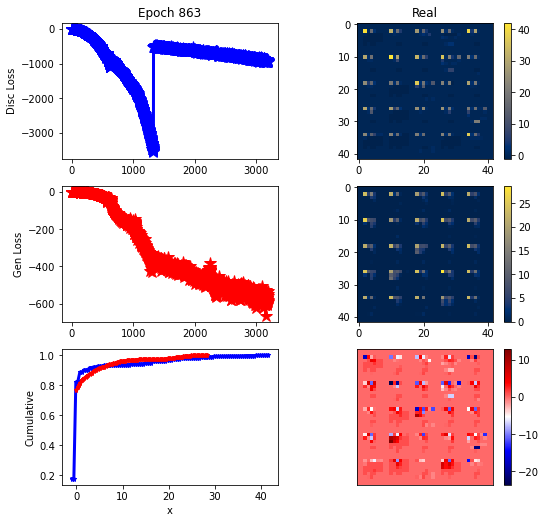

ErrG: -590.795148577009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


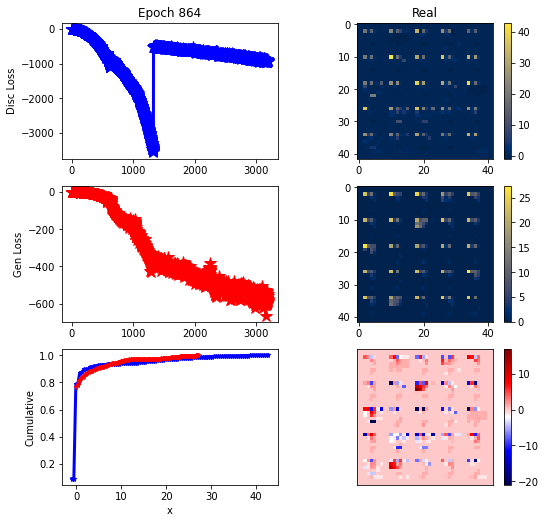

ErrG: -576.2846766880581, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


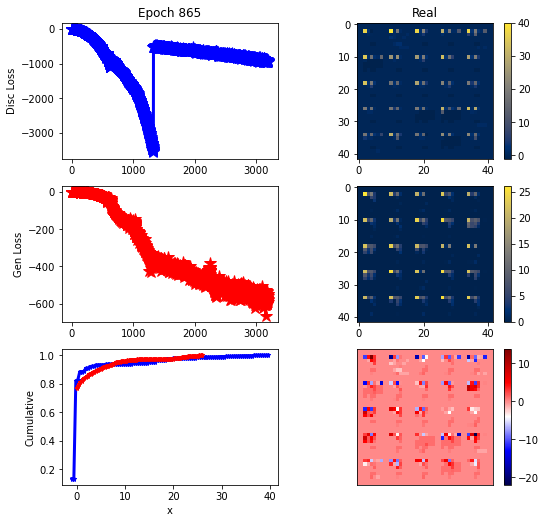

ErrG: -550.33982195173, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


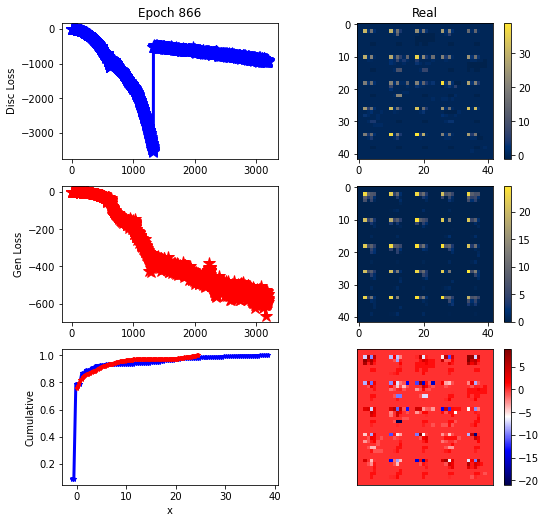

ErrG: -571.0507681710379, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


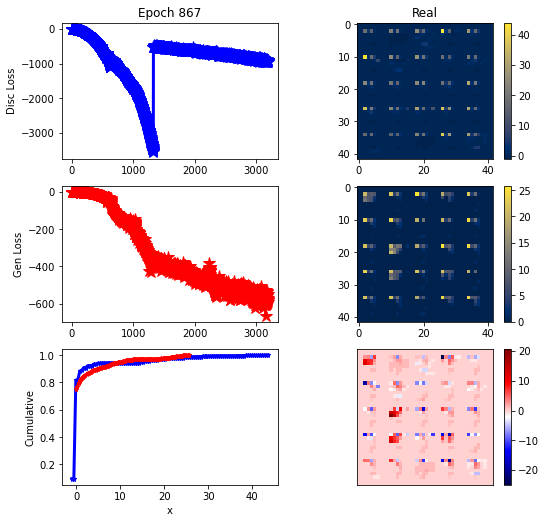

ErrG: -578.99367414202, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


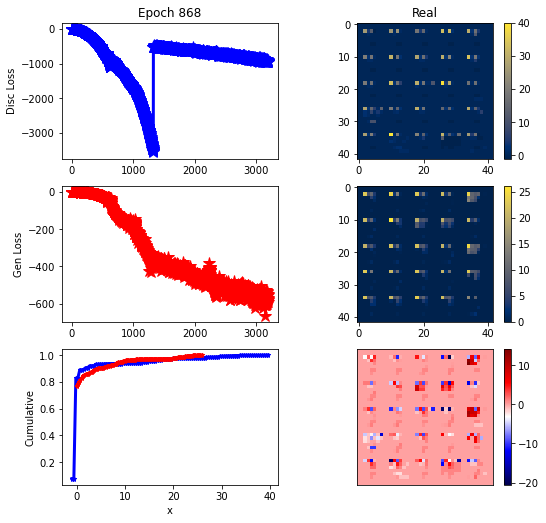

ErrG: -556.6558271135602, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


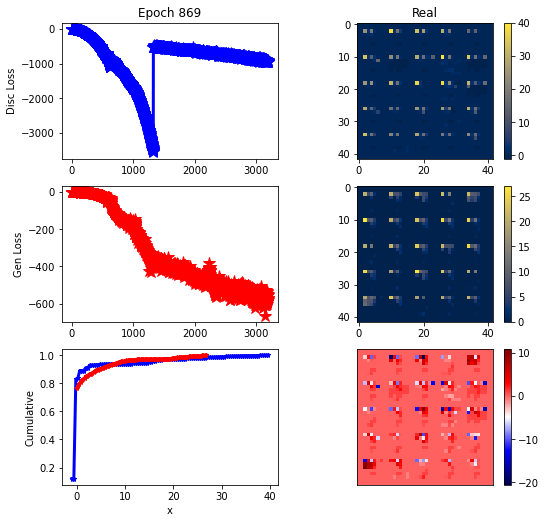

ErrG: -568.63525390625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


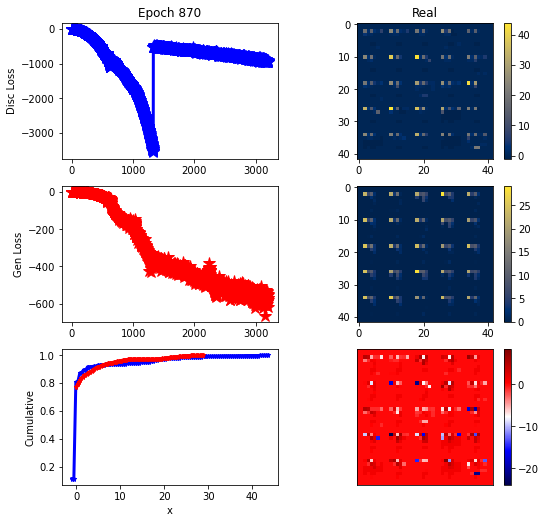

ErrG: -621.024640764509, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


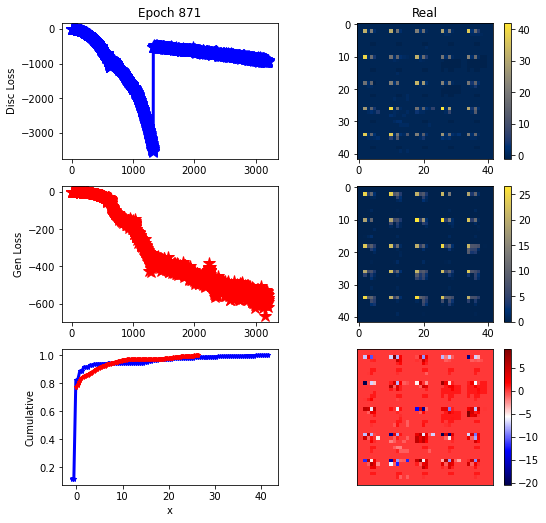

ErrG: -589.9359828404018, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


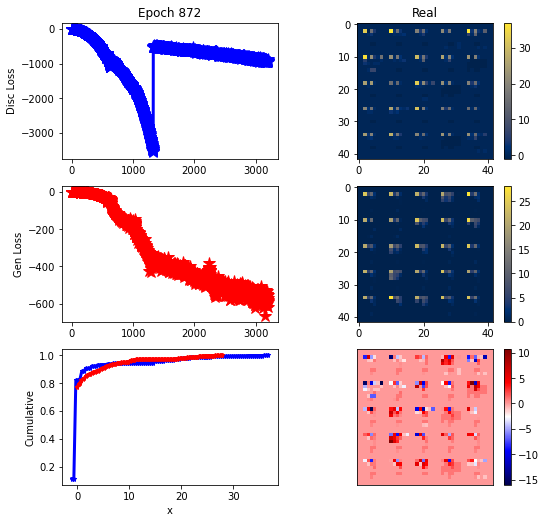

ErrG: -586.5460815429688, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


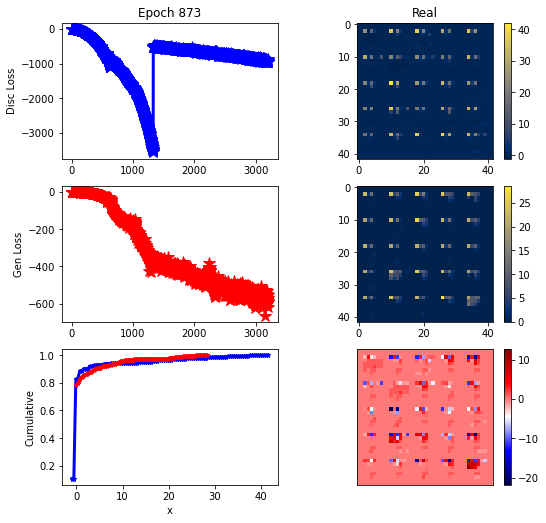

ErrG: -593.7378888811384, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


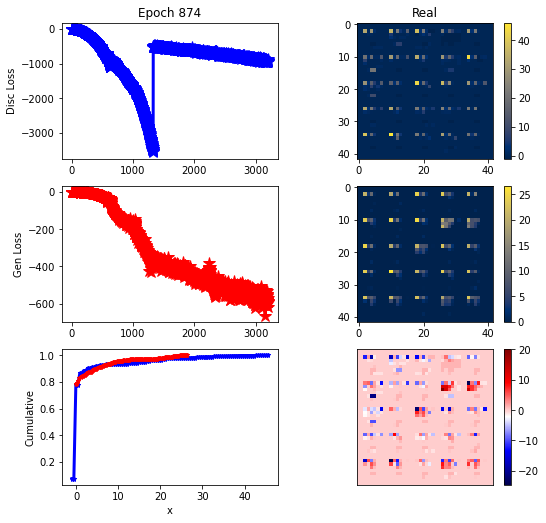

ErrG: -586.5767211914062, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


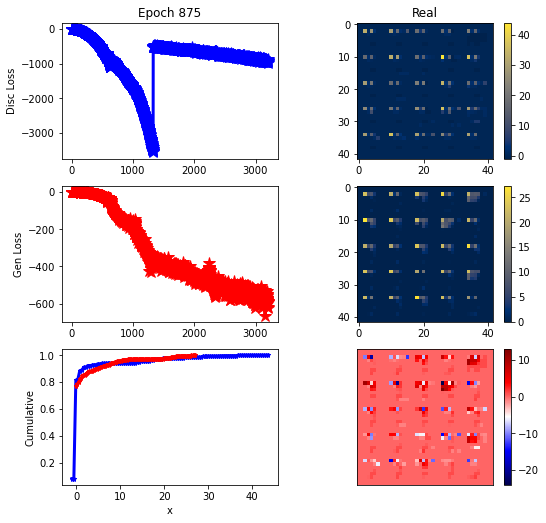

ErrG: -624.1471644810268, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


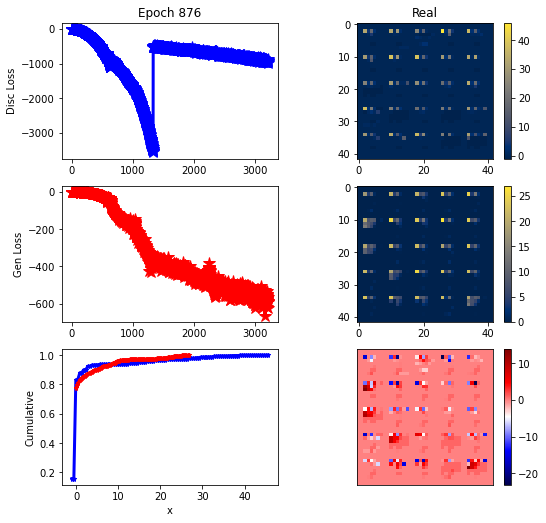

ErrG: -566.5917053222656, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


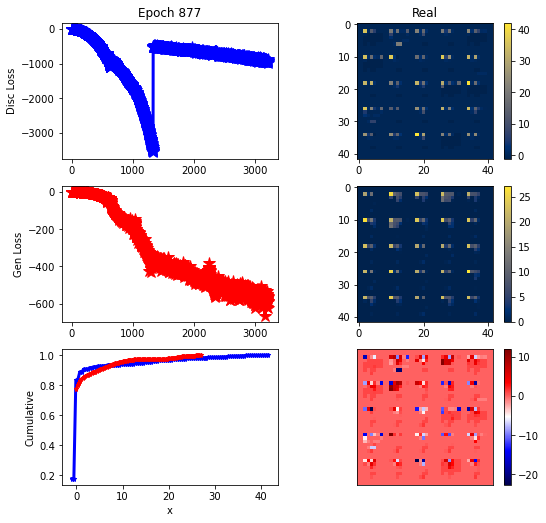

ErrG: -558.8981148856027, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


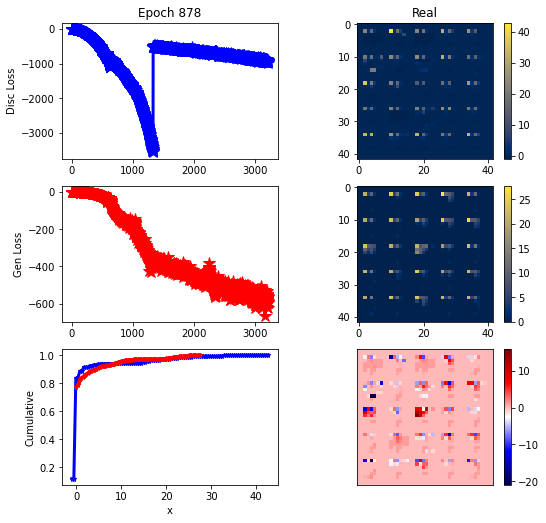

ErrG: -597.5976911272321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


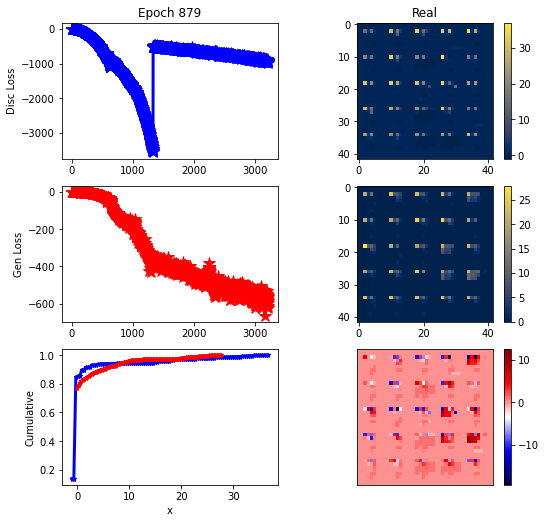

ErrG: -610.8130318777902, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


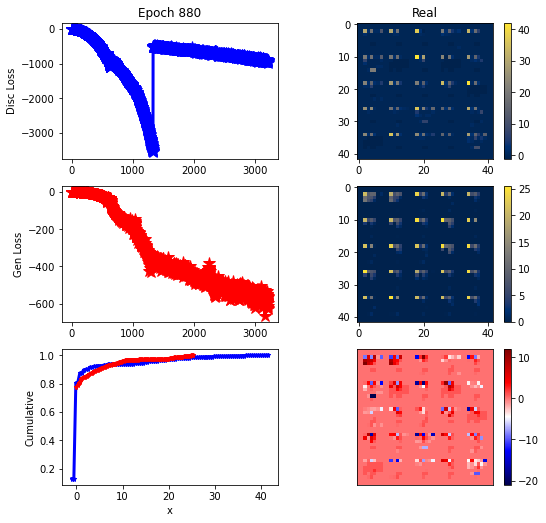

ErrG: -629.7589111328125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


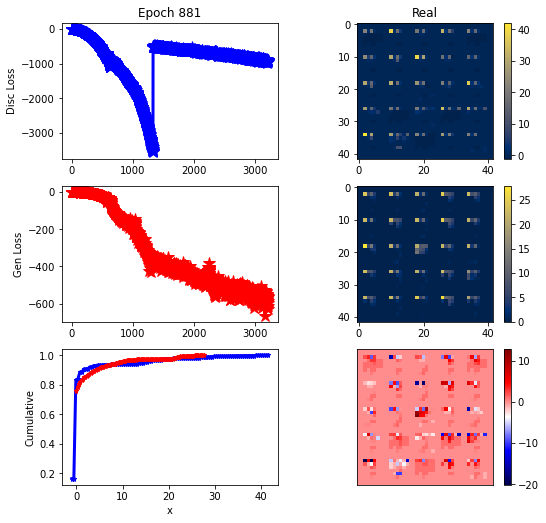

ErrG: -585.1458827427456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


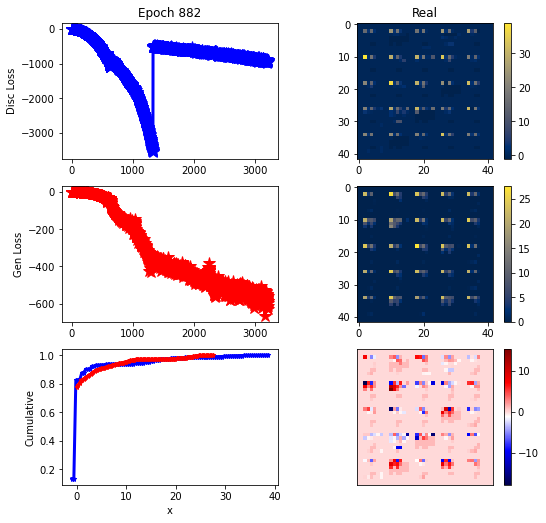

ErrG: -587.2310093470982, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


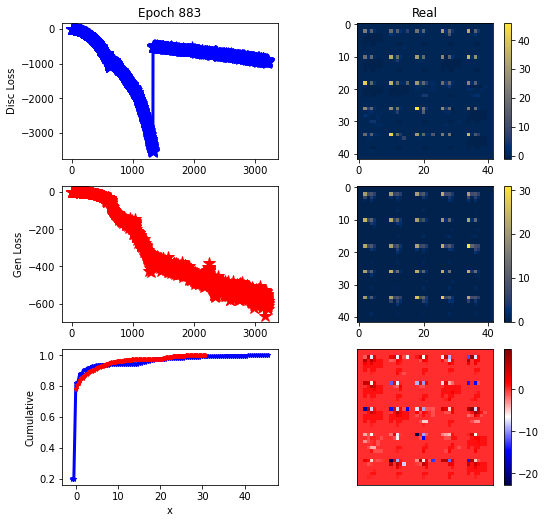

ErrG: -601.853515625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


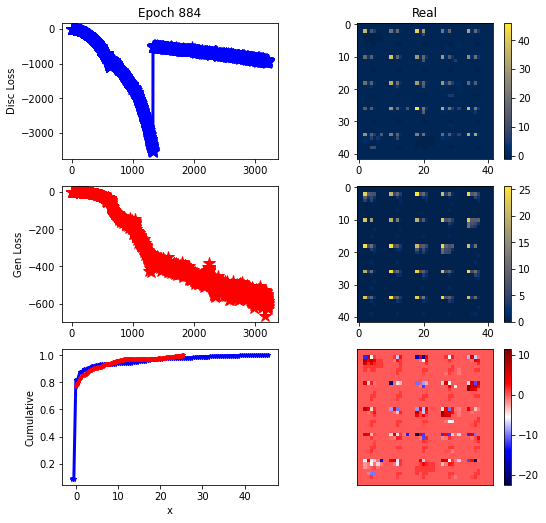

ErrG: -616.9139142717634, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


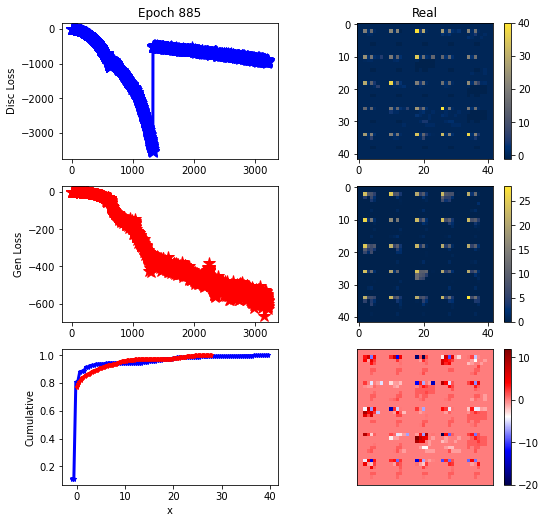

ErrG: -583.3482055664062, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


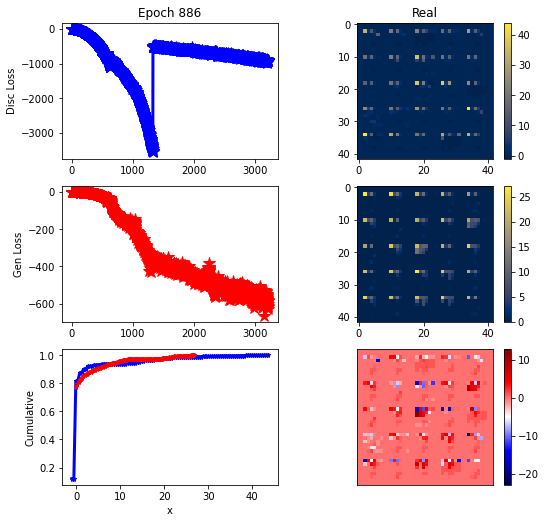

ErrG: -612.7753383091518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


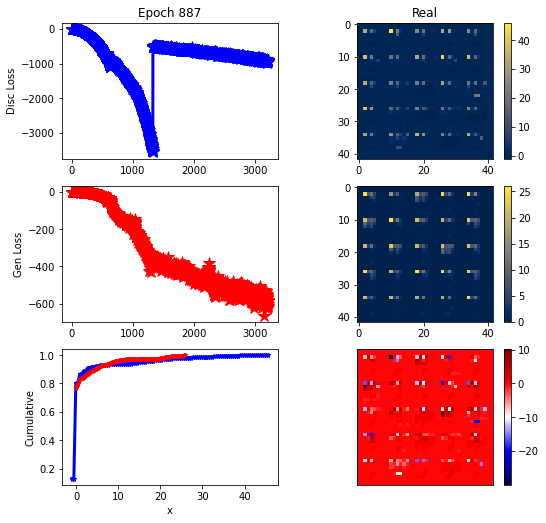

ErrG: -582.0924246651786, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


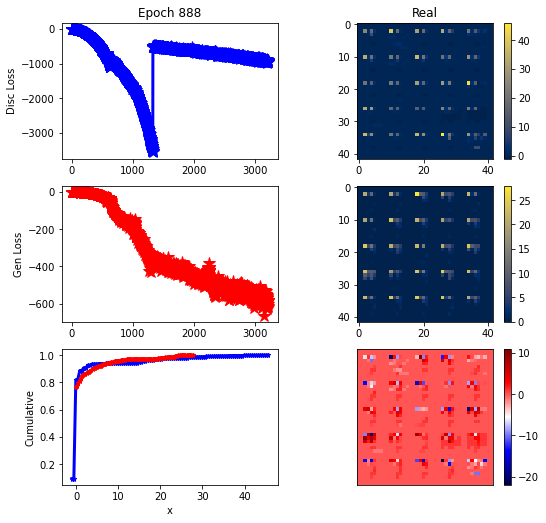

ErrG: -580.4464808872768, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


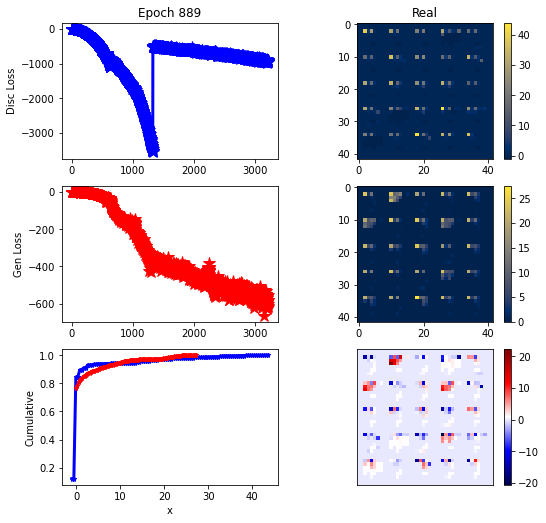

ErrG: -555.8474687848773, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


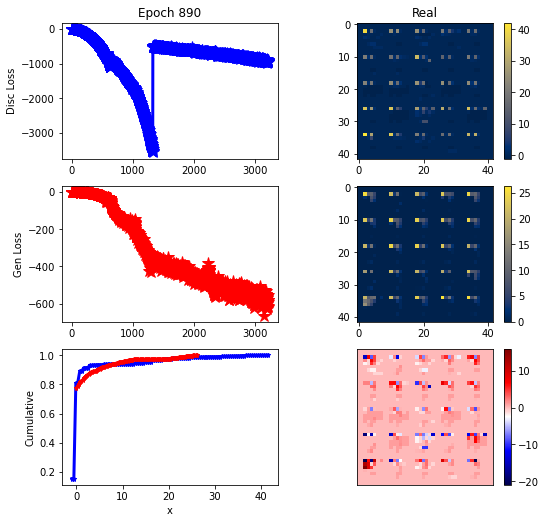

ErrG: -594.1811610630581, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


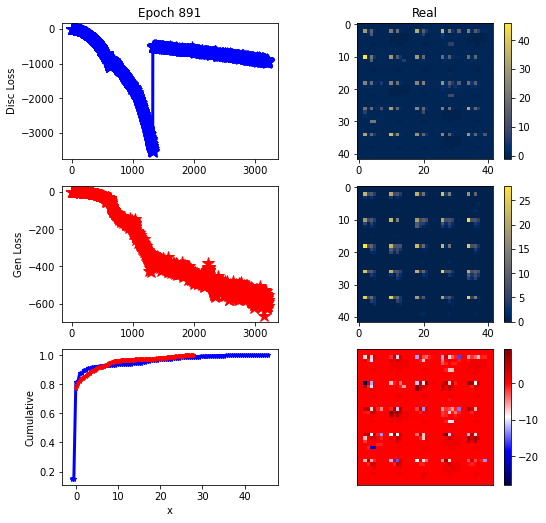

ErrG: -615.4695347377232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


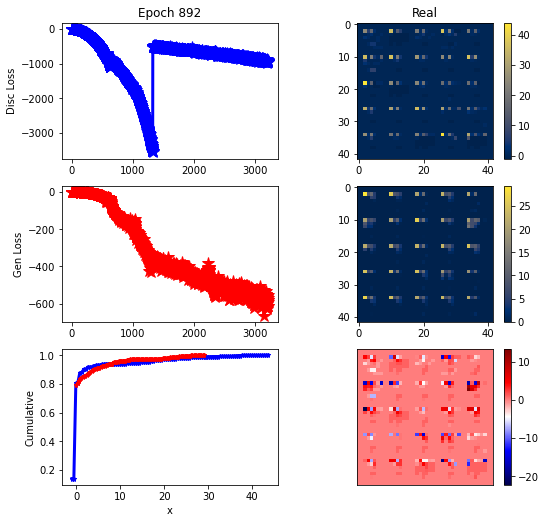

ErrG: -571.5308576311384, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


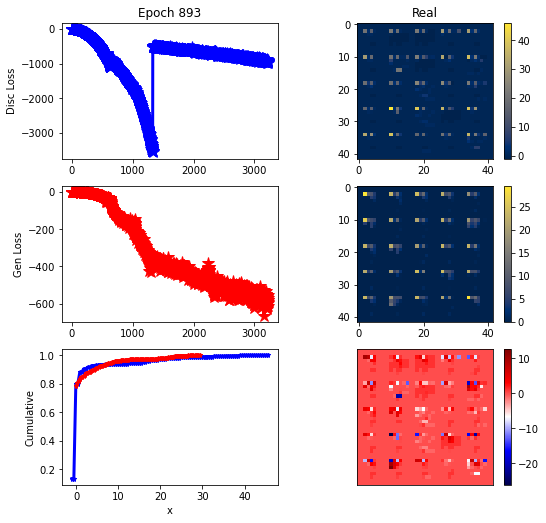

ErrG: -595.5360804966518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


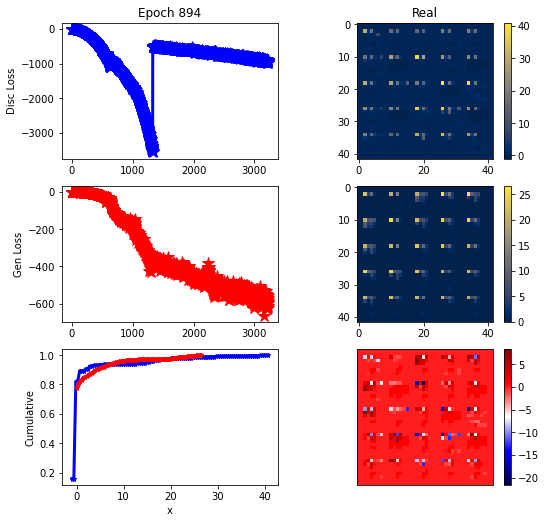

ErrG: -625.4945591517857, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


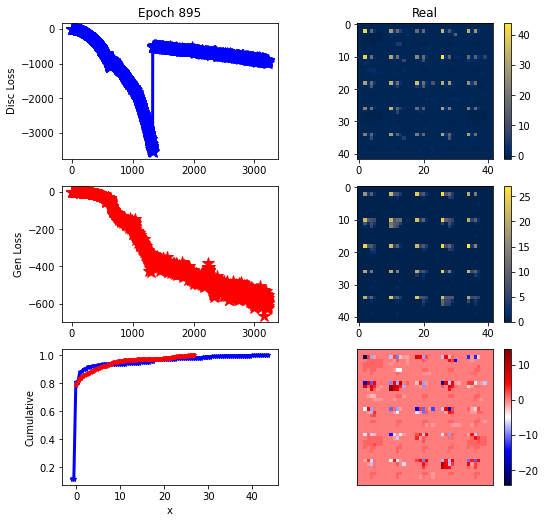

ErrG: -598.009769984654, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


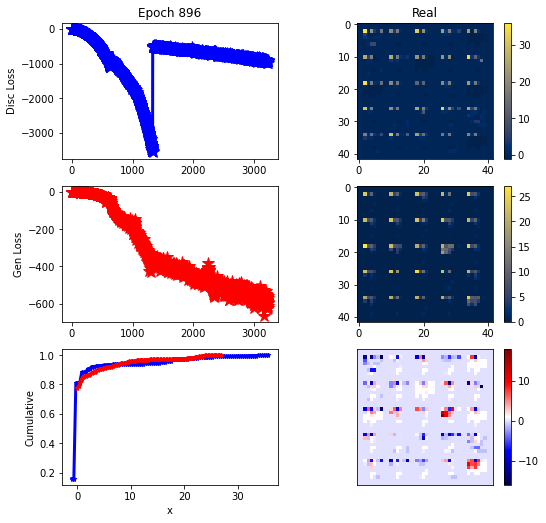

ErrG: -557.2171369280134, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


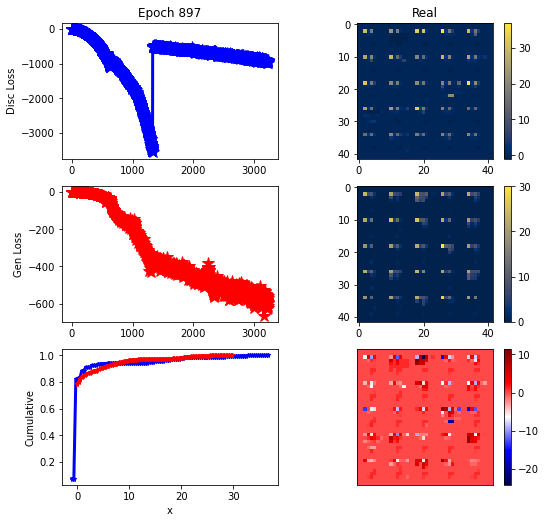

ErrG: -592.5757097516741, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


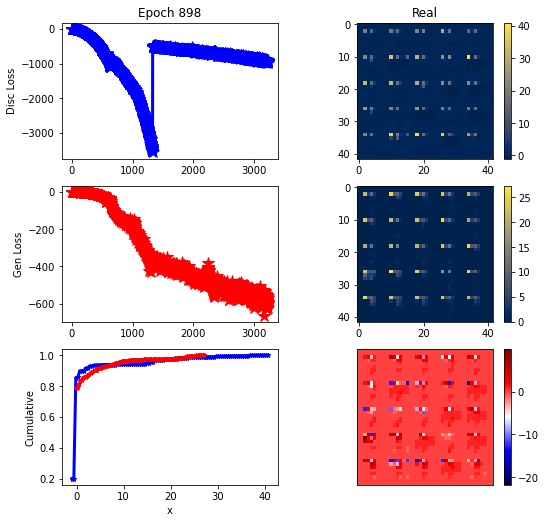

ErrG: -602.0546090262277, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


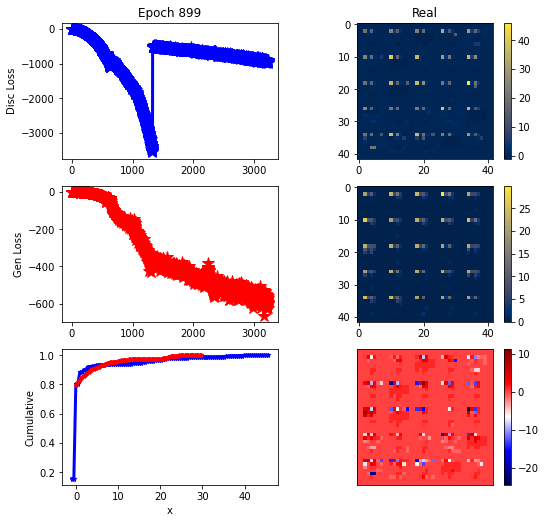

ErrG: -567.7281581333706, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


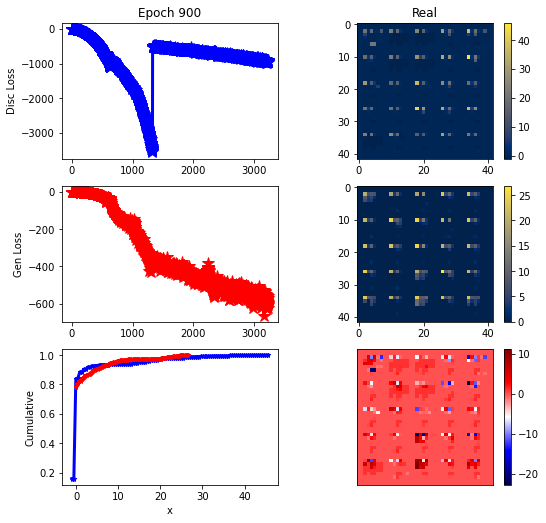

ErrG: -607.1498151506696, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


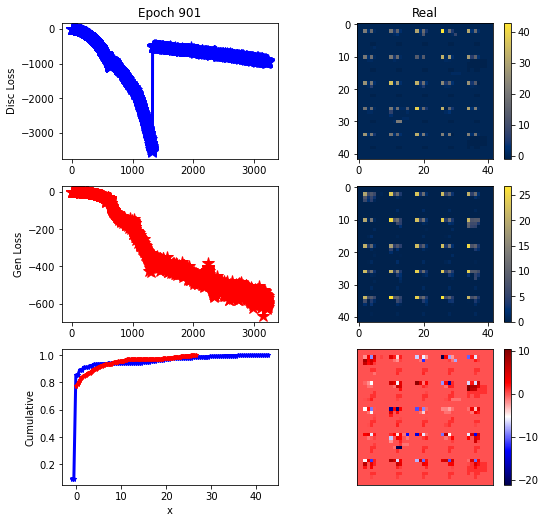

ErrG: -620.4376831054688, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


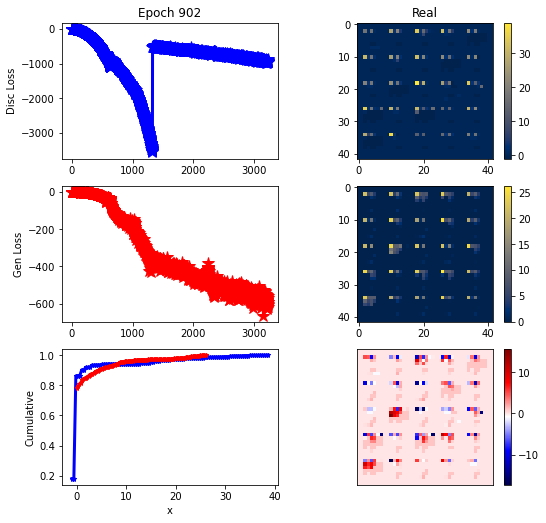

ErrG: -590.3574916294643, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


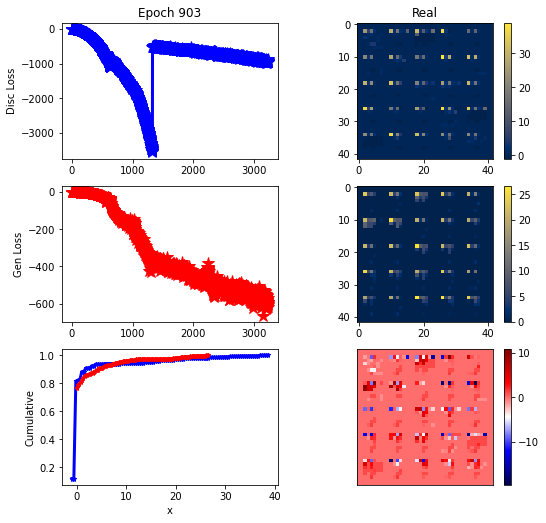

ErrG: -596.4493495396206, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


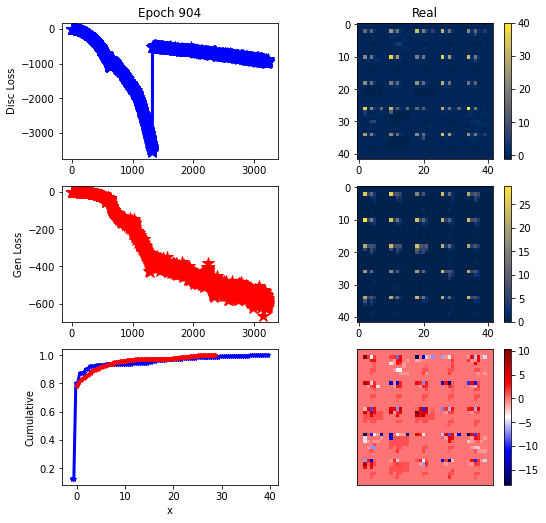

ErrG: -578.7572806222098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


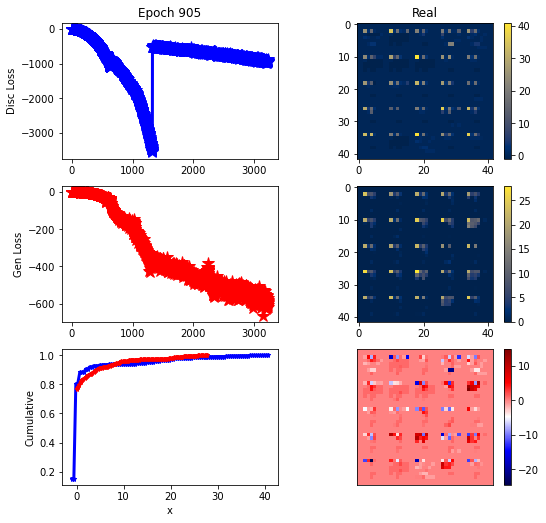

ErrG: -588.5036708286831, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


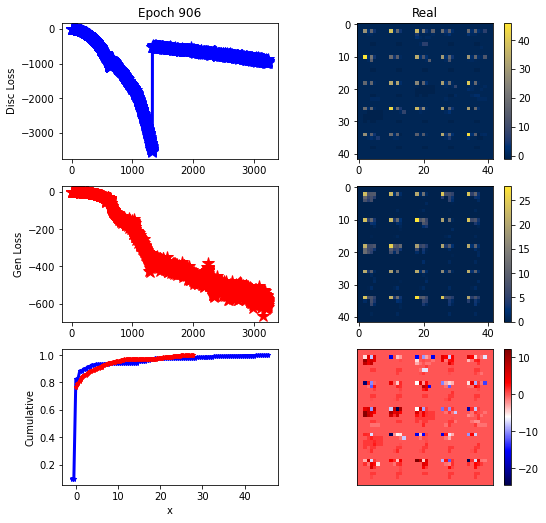

ErrG: -578.2157679966518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


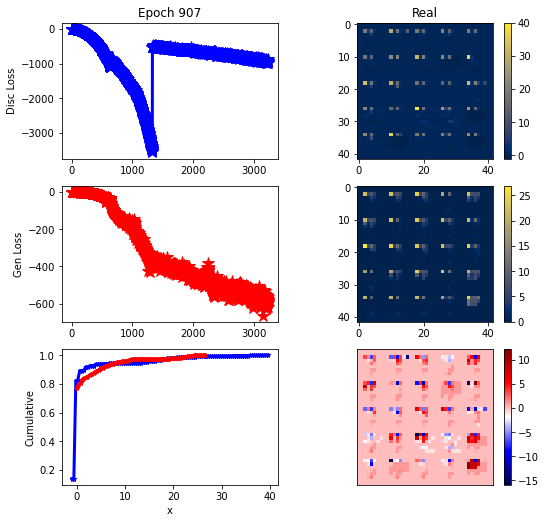

ErrG: -564.9552437918527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


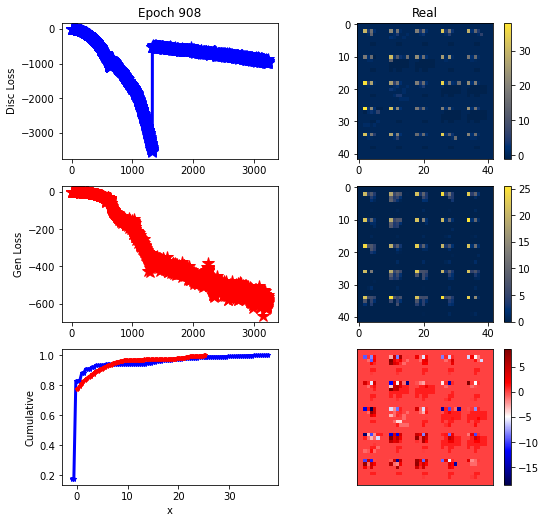

ErrG: -556.538835797991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


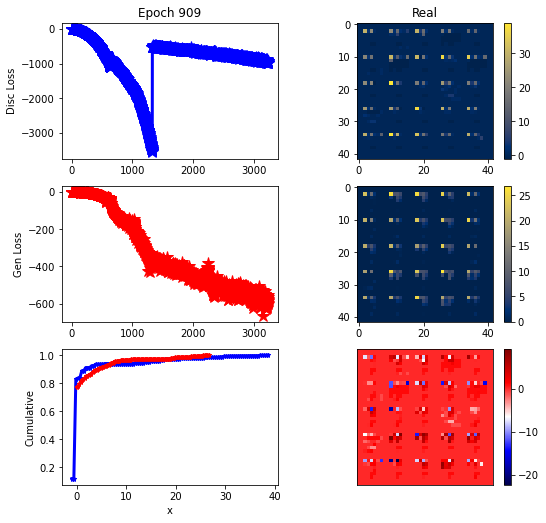

ErrG: -605.3010166713169, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


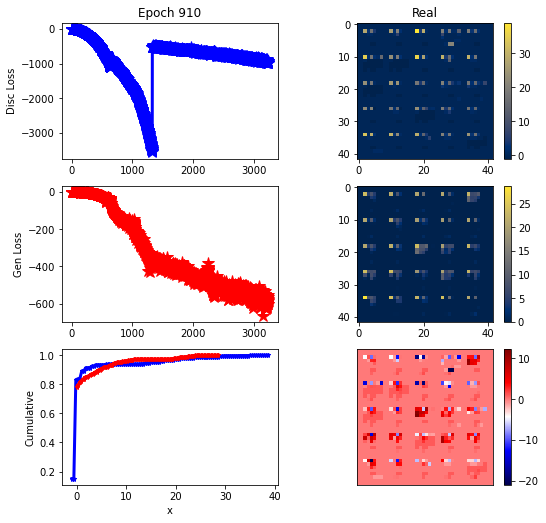

ErrG: -602.2607770647321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


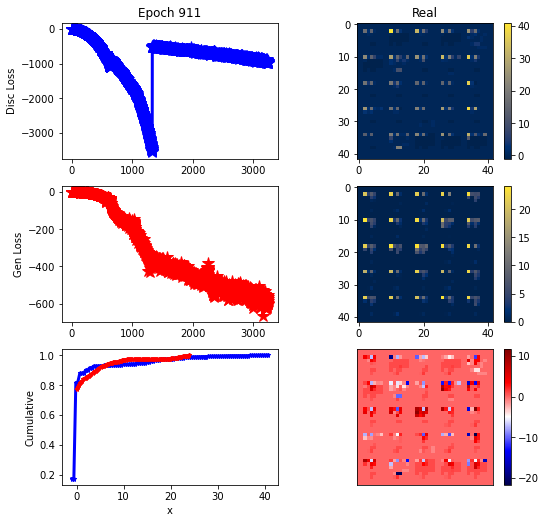

ErrG: -596.199968610491, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


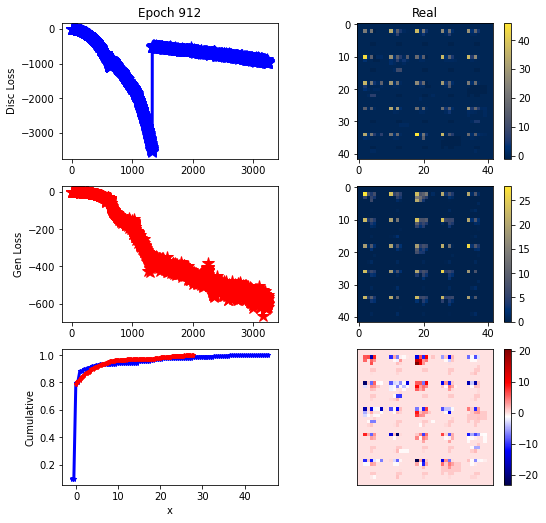

ErrG: -617.0599539620536, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


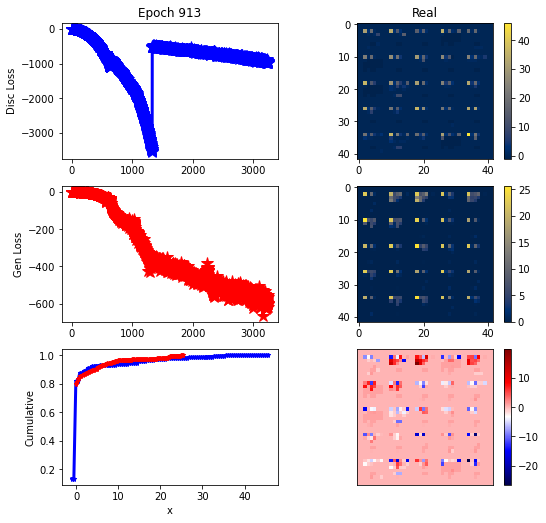

ErrG: -596.1087908063616, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


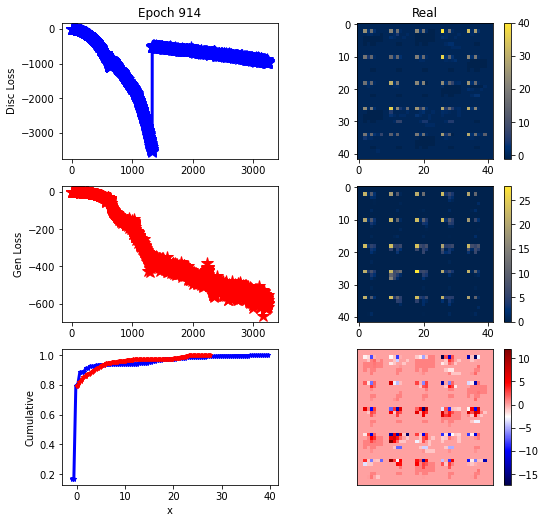

ErrG: -583.4699009486607, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


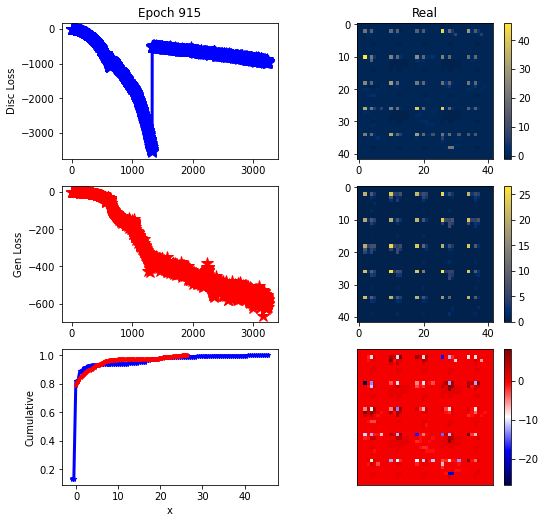

ErrG: -575.3660932268415, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


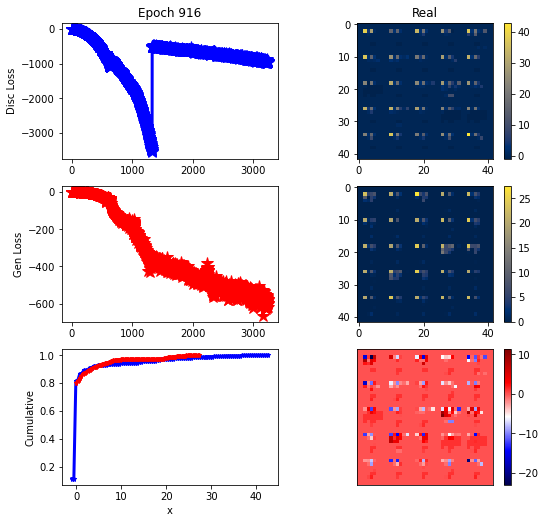

ErrG: -574.3312901088169, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


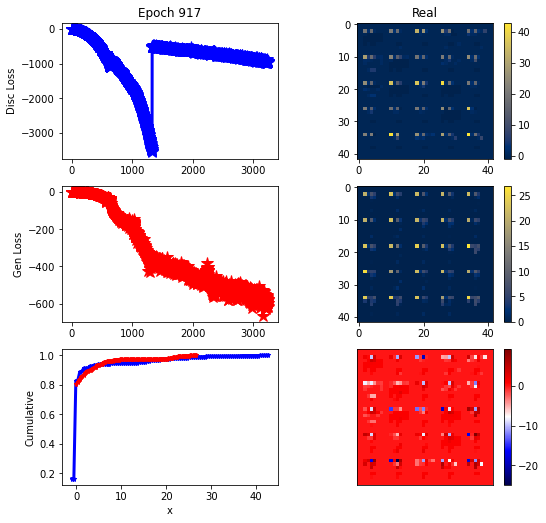

ErrG: -611.3227103097098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


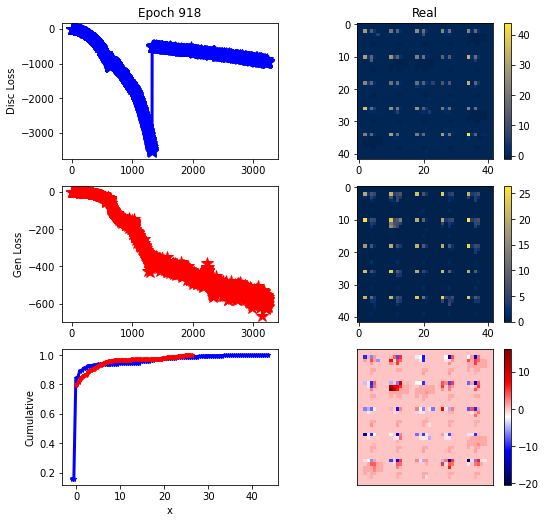

ErrG: -565.0395246233259, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


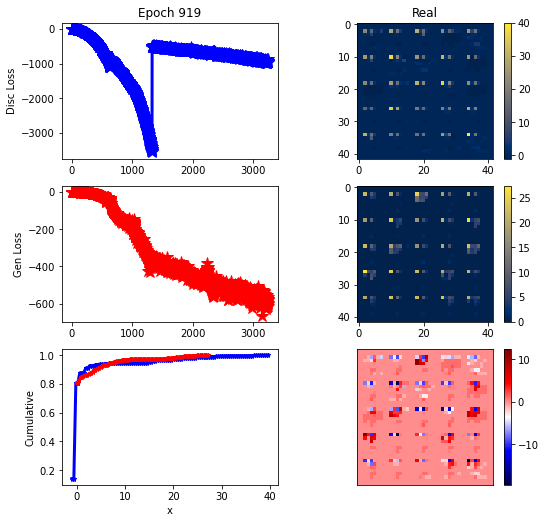

ErrG: -603.3743809291294, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


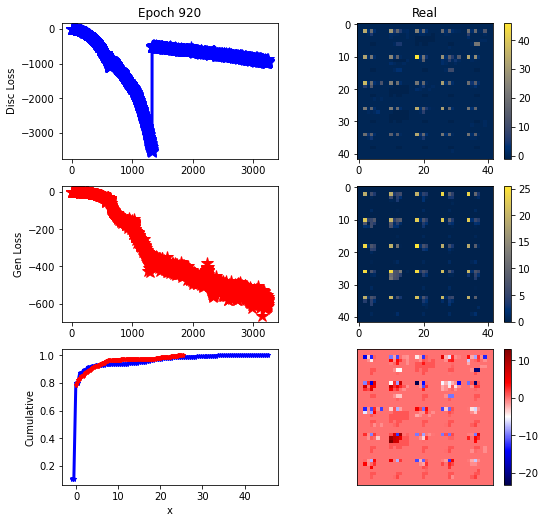

ErrG: -587.6788504464286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


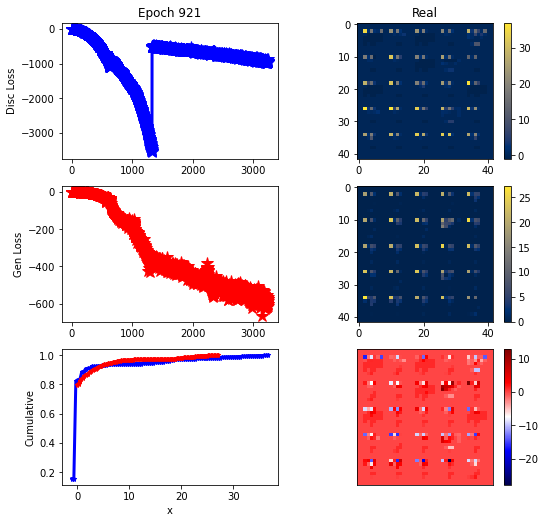

ErrG: -600.6646292550223, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


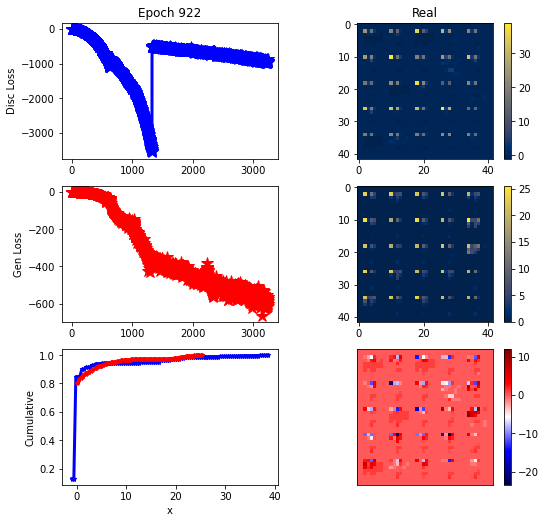

ErrG: -566.9858834402902, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


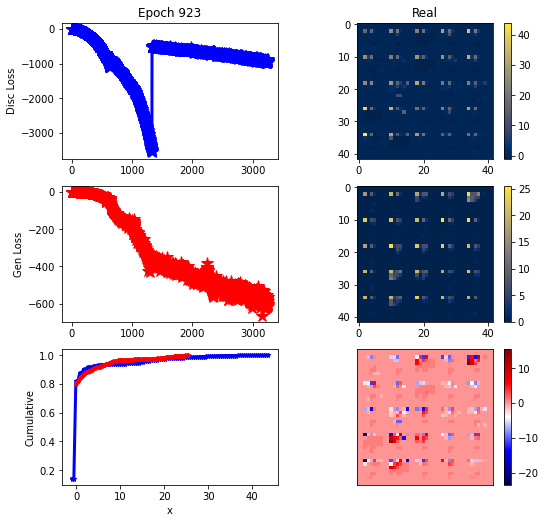

ErrG: -609.78955078125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


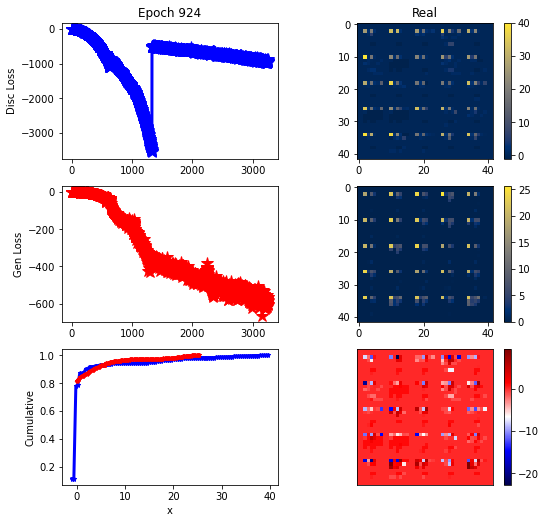

ErrG: -580.9522923060825, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


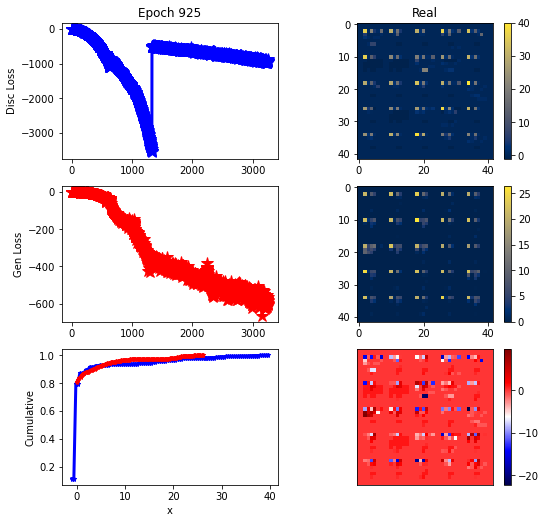

ErrG: -598.4187840053013, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


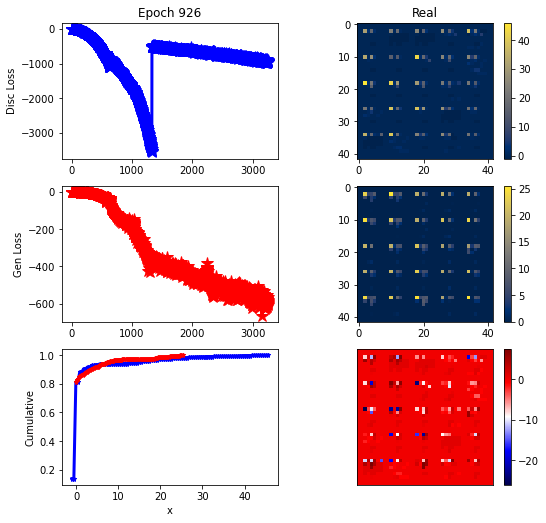

ErrG: -594.2824009486607, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


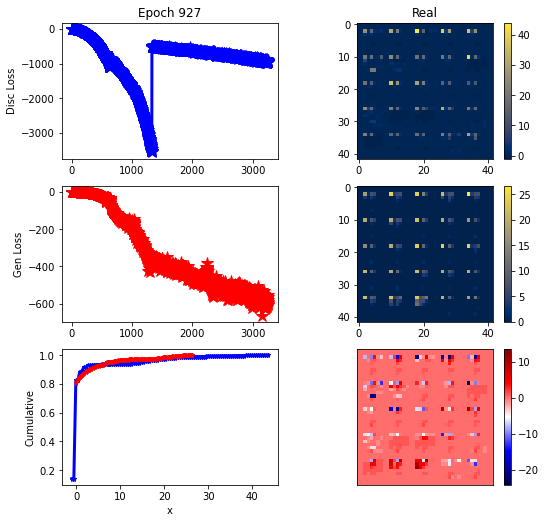

ErrG: -553.5452924455915, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


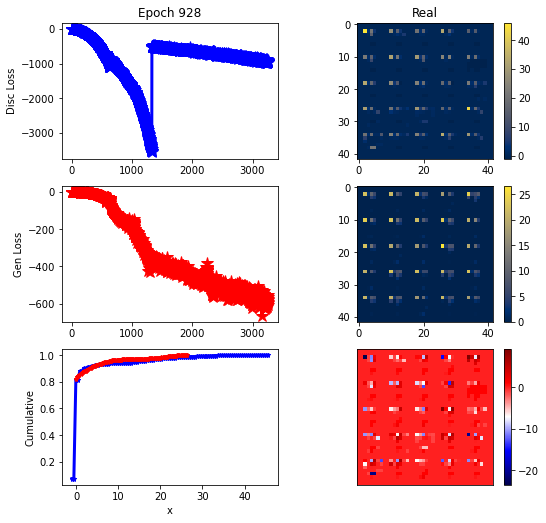

ErrG: -576.4588012695312, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


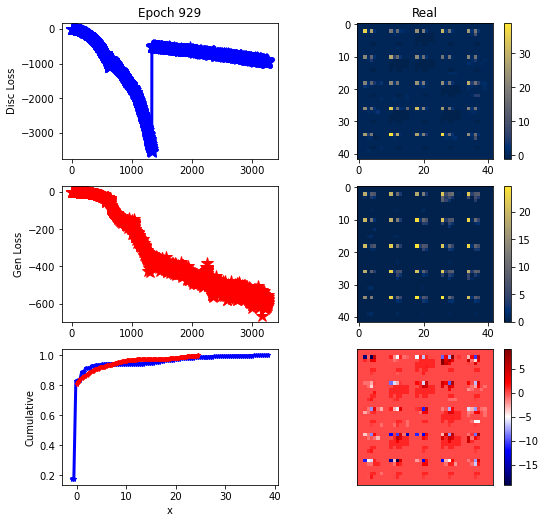

ErrG: -563.2295357840402, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


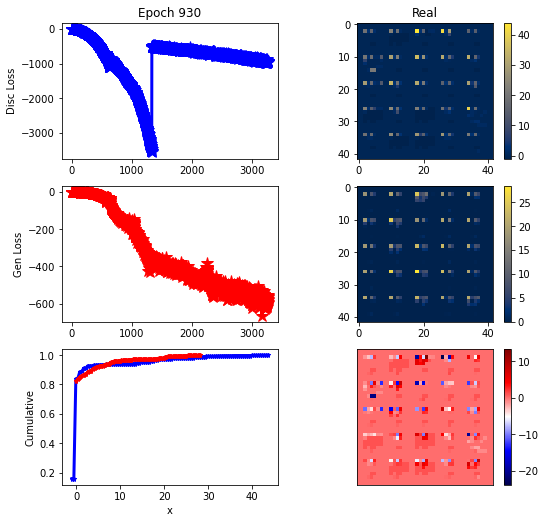

ErrG: -559.0323181152344, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


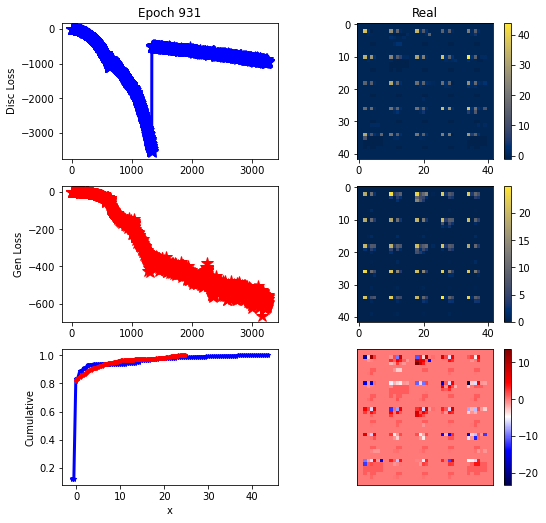

ErrG: -575.918461390904, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


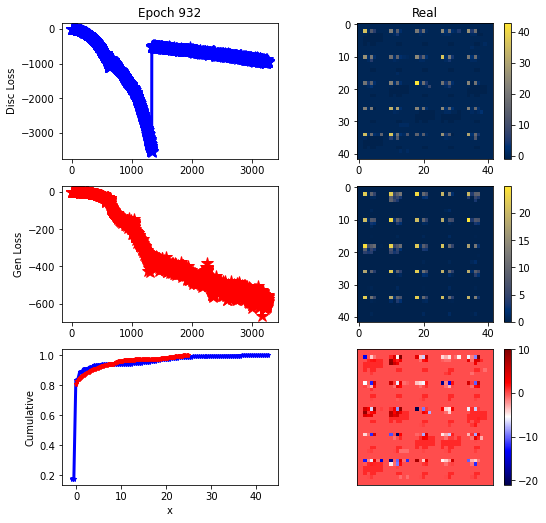

ErrG: -587.756103515625, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


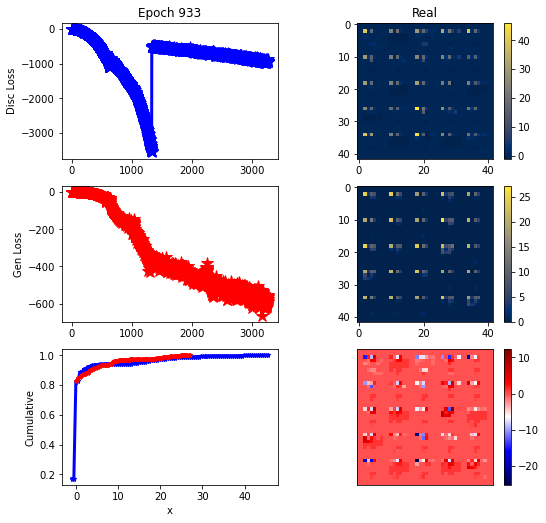

ErrG: -591.4596688406808, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


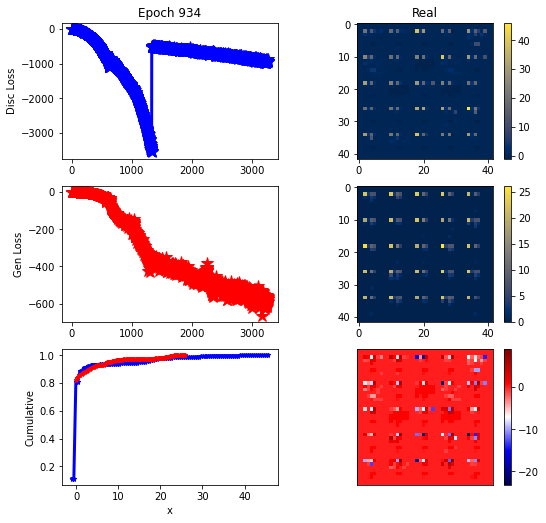

ErrG: -571.1431230817523, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


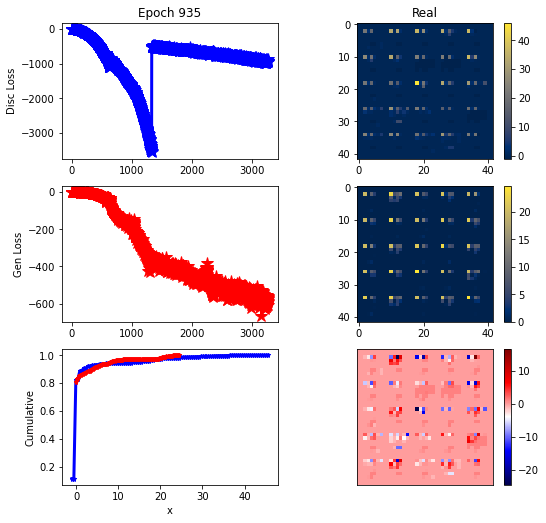

ErrG: -606.6272234235491, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


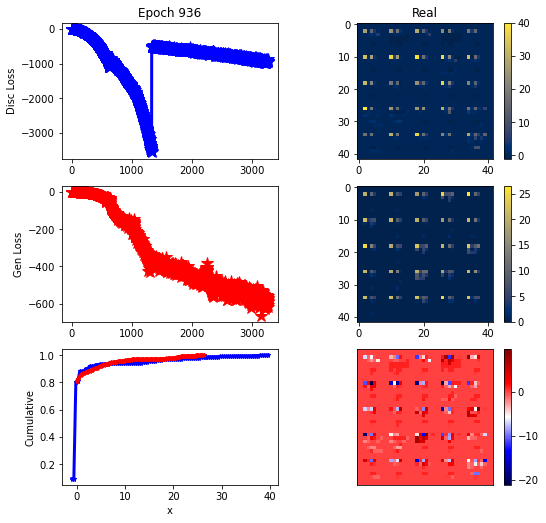

ErrG: -618.6026611328125, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


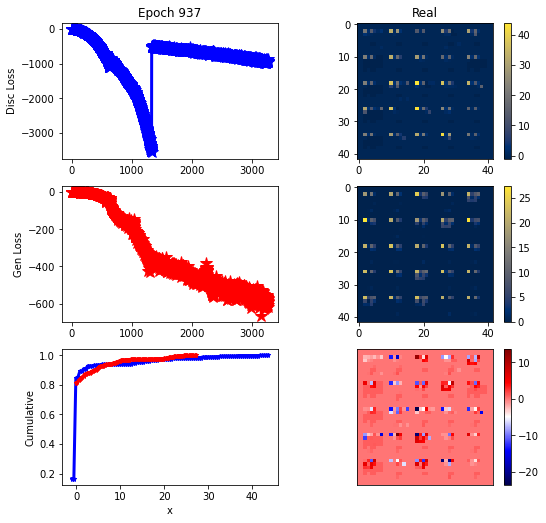

ErrG: -589.8155953543527, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


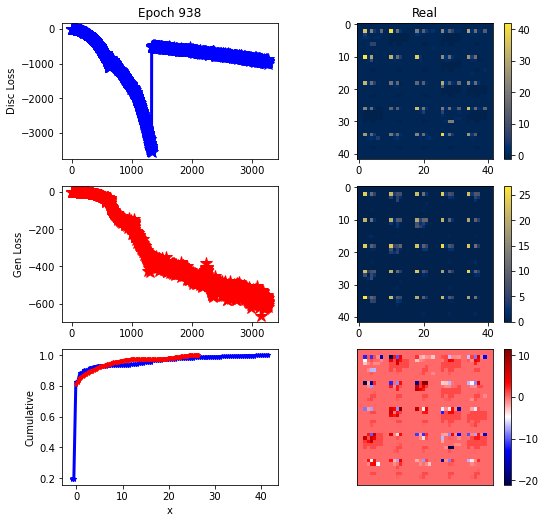

ErrG: -594.7961687360491, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


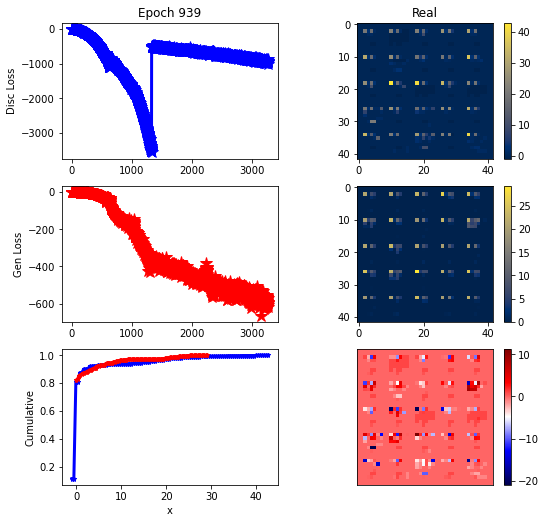

ErrG: -599.1726422991071, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


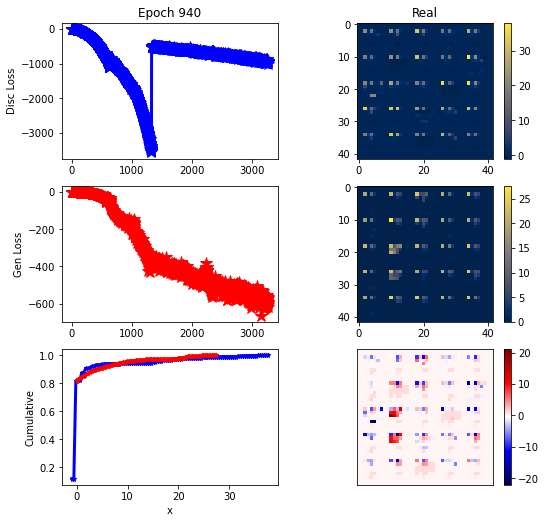

ErrG: -566.04640851702, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


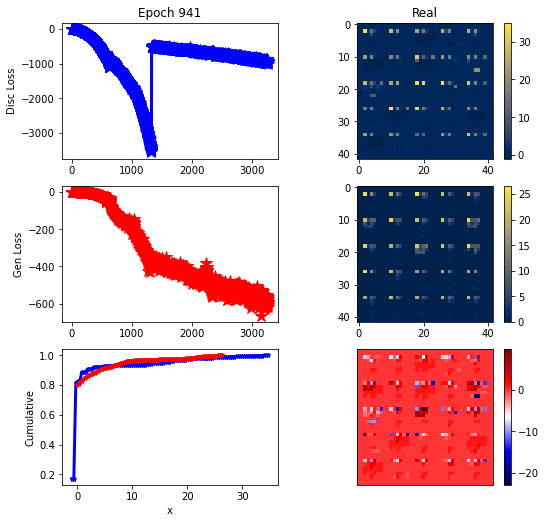

ErrG: -573.5462036132812, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


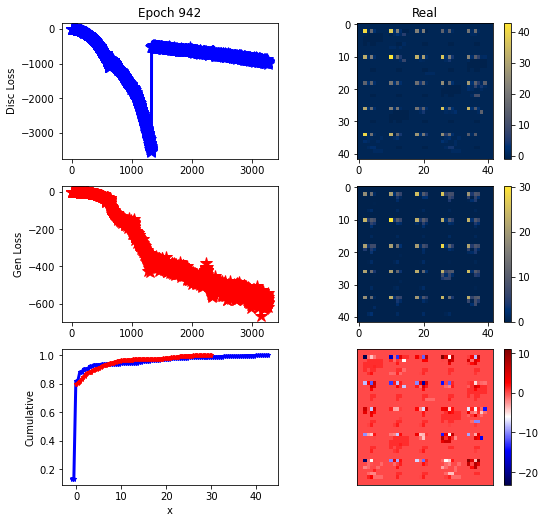

ErrG: -542.4078238351004, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


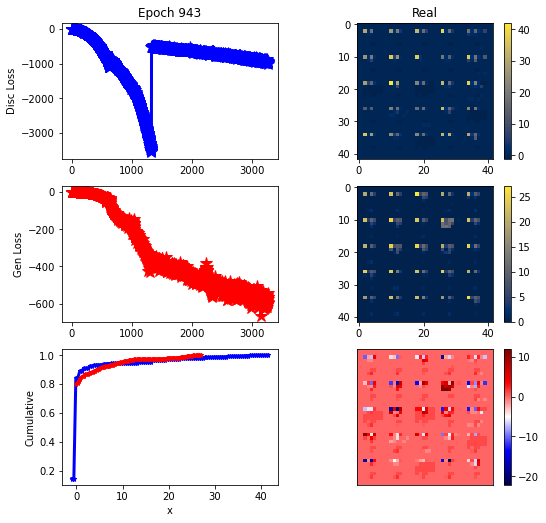

ErrG: -562.8557739257812, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


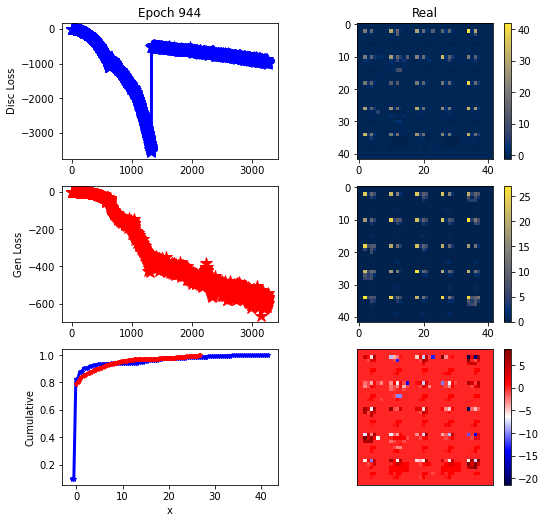

ErrG: -568.7664184570312, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


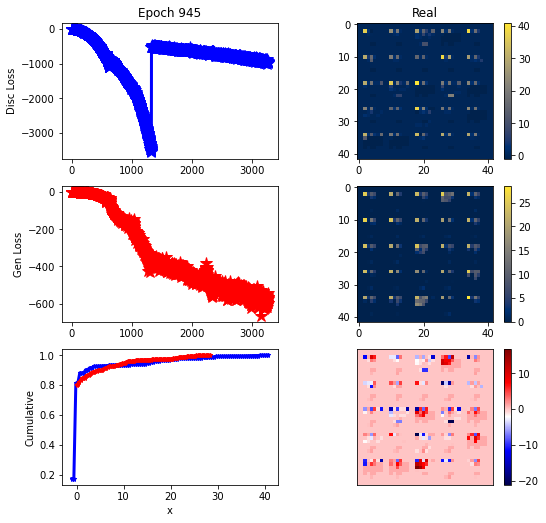

ErrG: -597.9973493303571, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


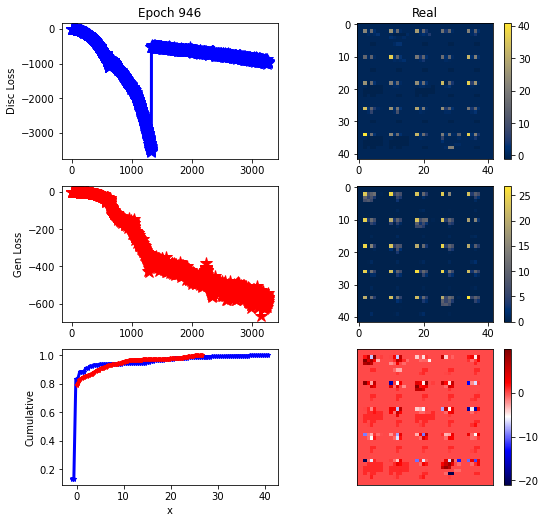

ErrG: -585.6185738699777, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


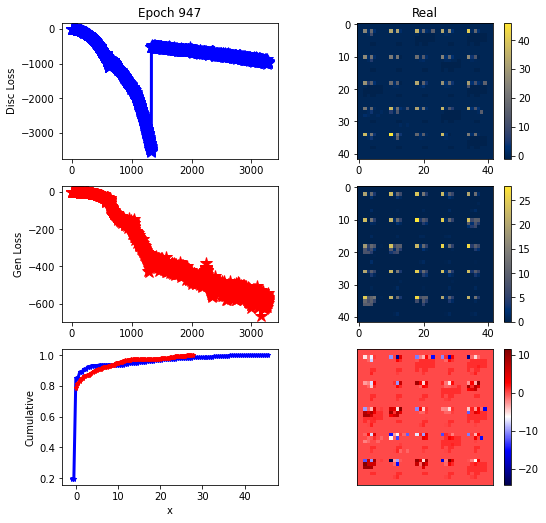

ErrG: -581.4788992745536, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


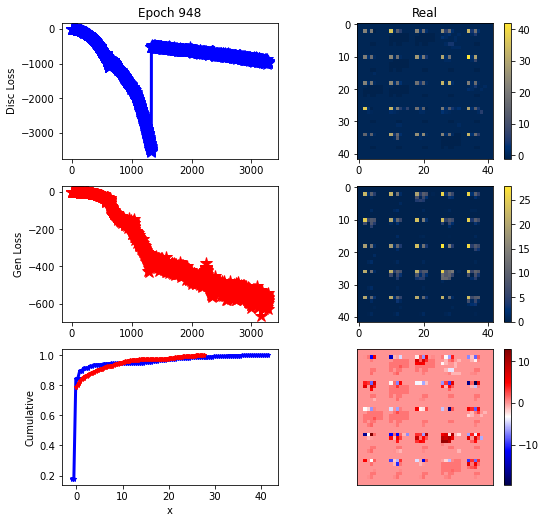

ErrG: -631.4716535295759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


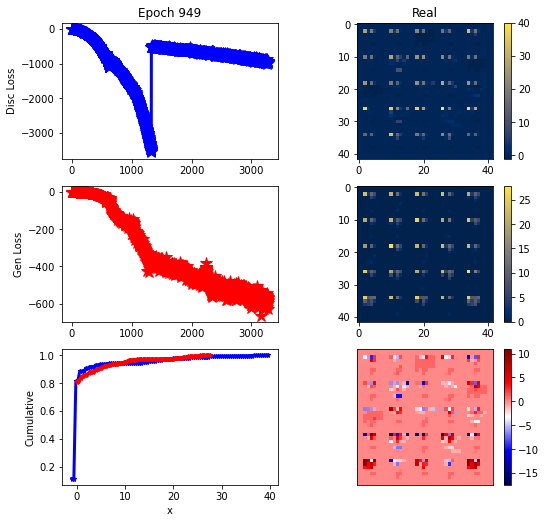

ErrG: -569.5344935825893, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


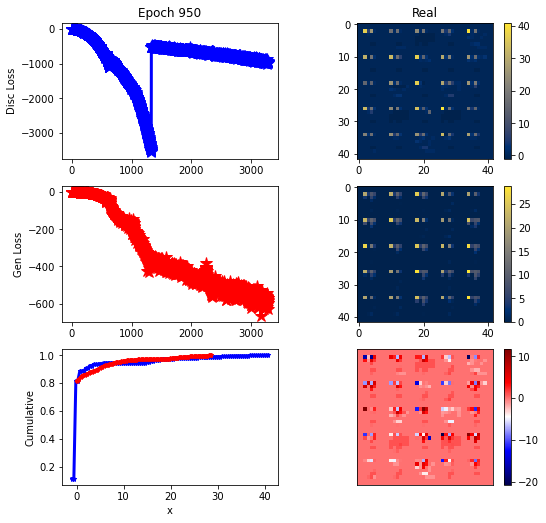

ErrG: -597.5622035435268, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


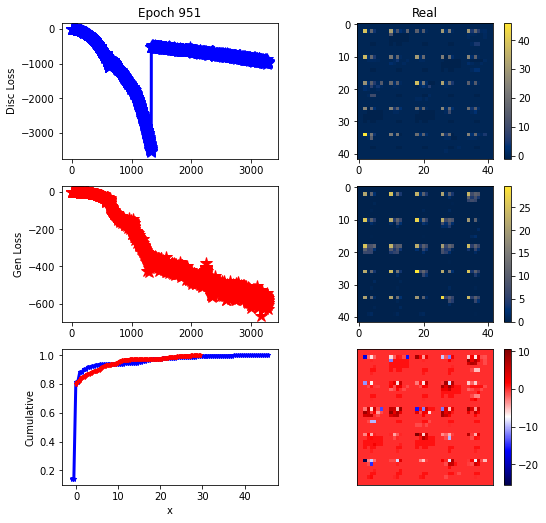

ErrG: -608.3264944893973, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


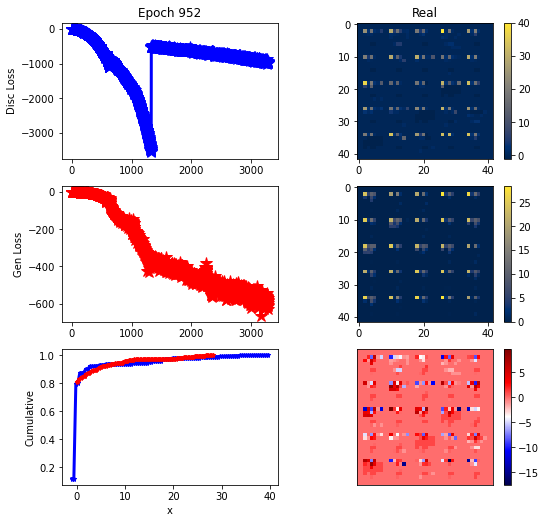

ErrG: -611.2590070452009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


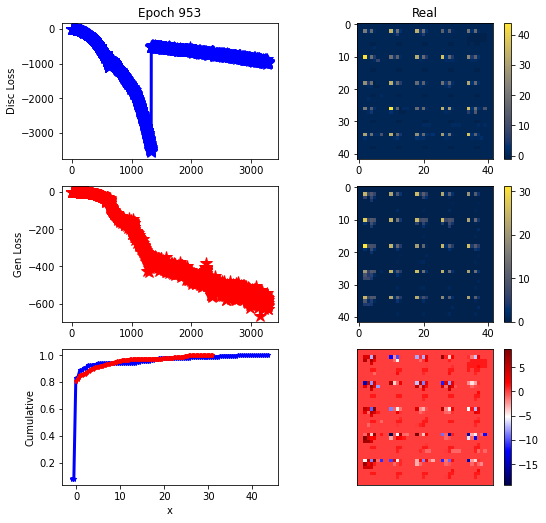

ErrG: -632.2002955845425, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


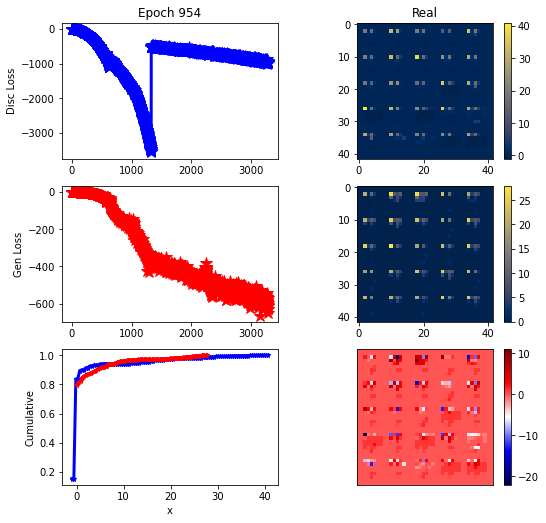

ErrG: -649.3688267299107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


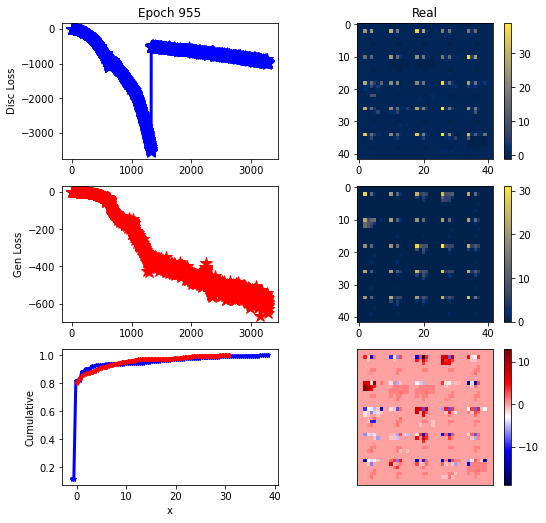

ErrG: -593.3721575055804, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


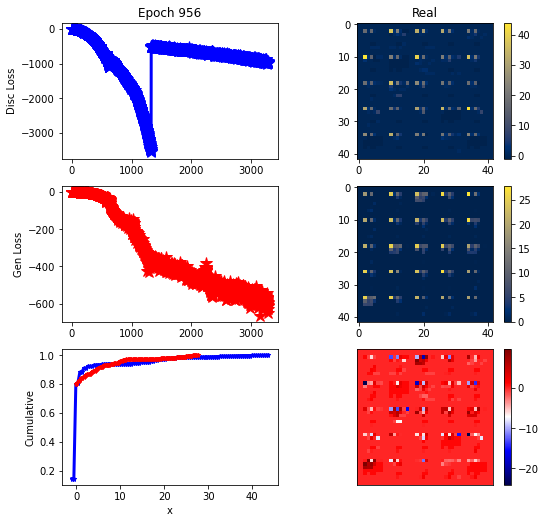

ErrG: -614.2719639369419, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


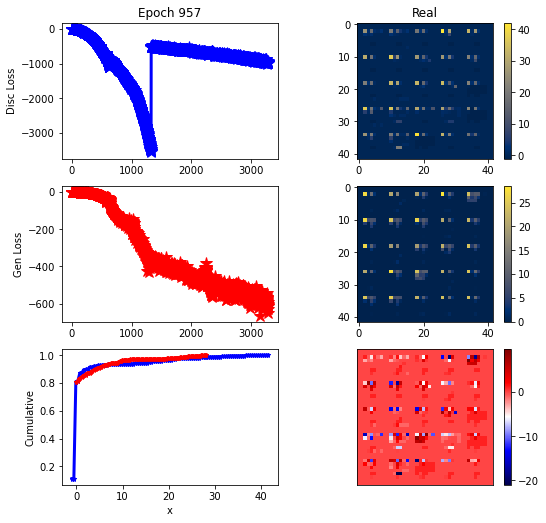

ErrG: -600.1130850655692, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


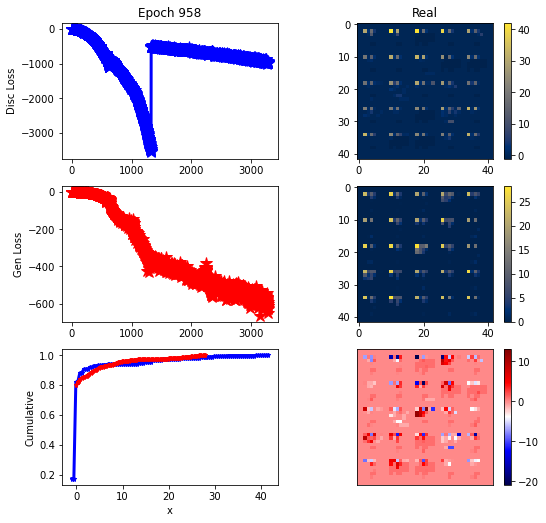

ErrG: -622.9228428431919, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


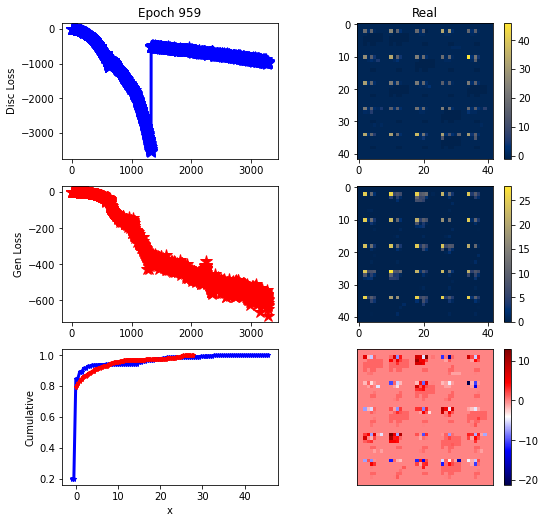

ErrG: -683.4050554547991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


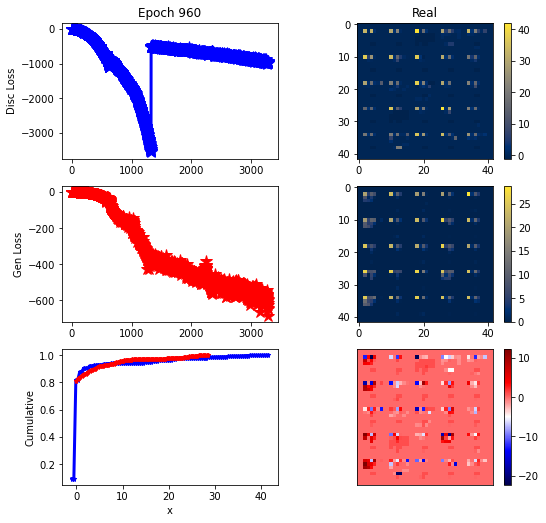

ErrG: -640.2440883091518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


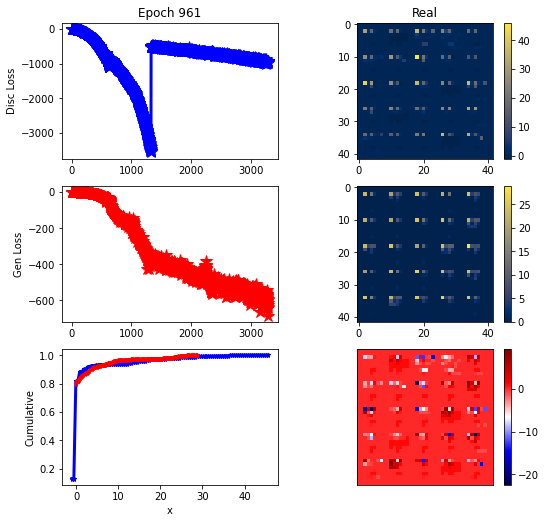

ErrG: -638.1655709402902, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


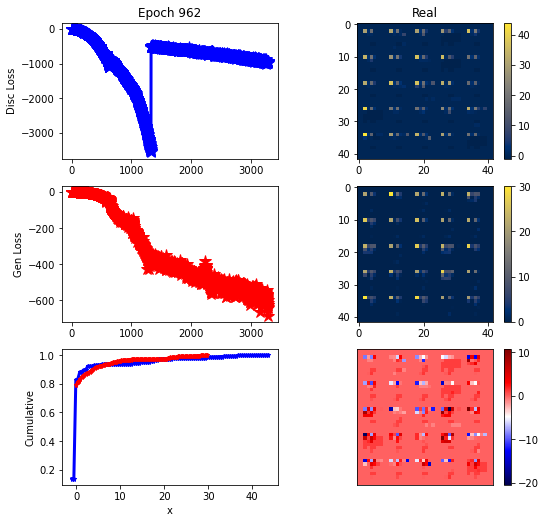

ErrG: -622.8728376116071, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


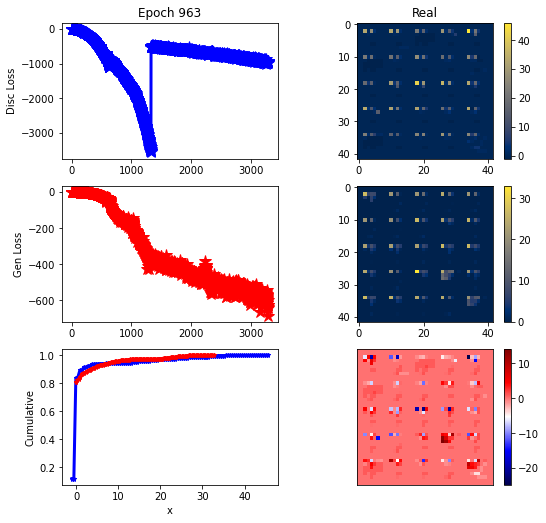

ErrG: -623.8836321149554, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


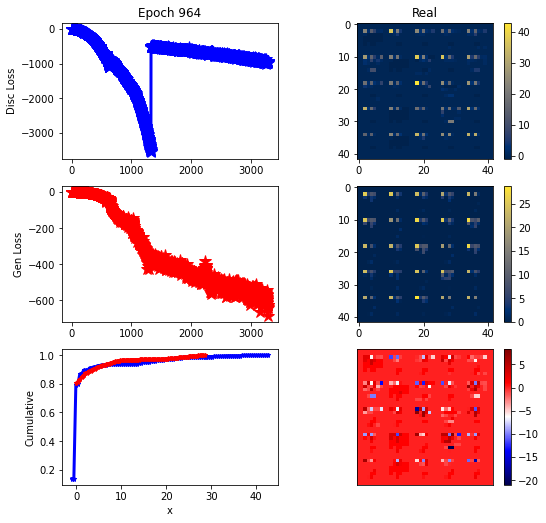

ErrG: -627.420654296875, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


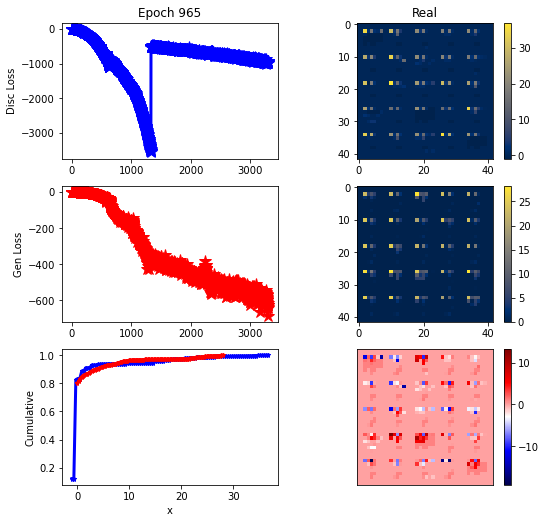

ErrG: -614.249773297991, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


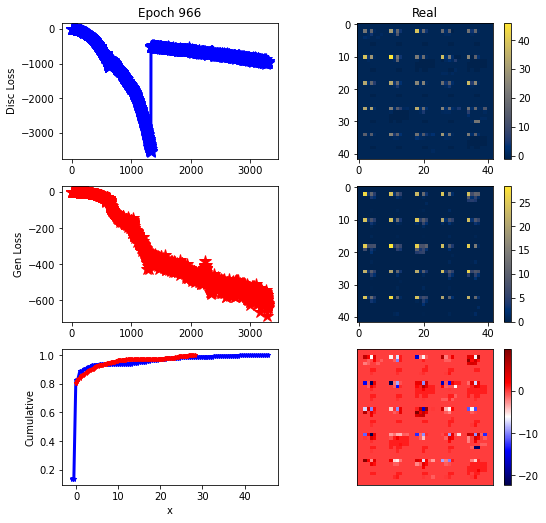

ErrG: -621.8679722377232, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


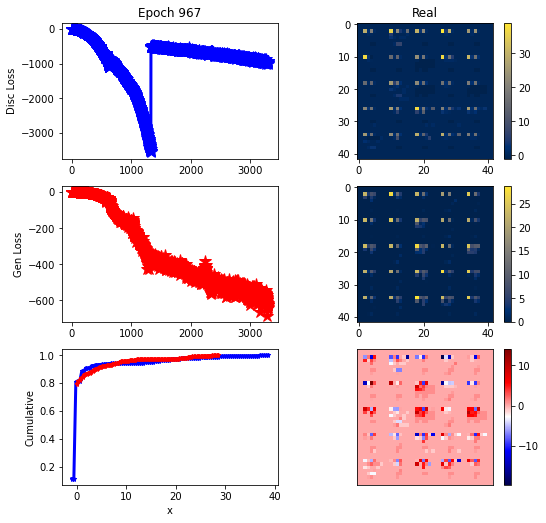

ErrG: -642.7767421177456, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


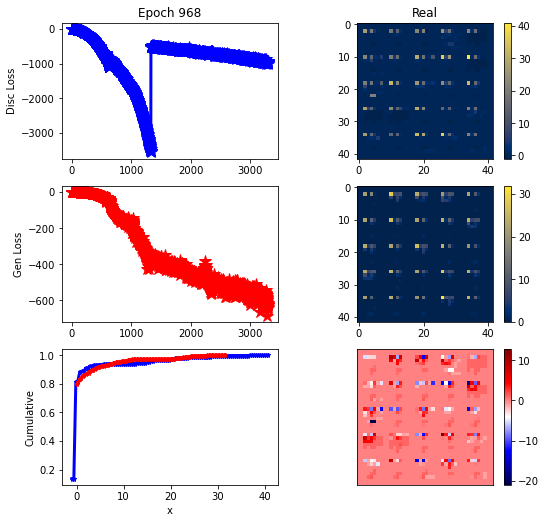

ErrG: -635.2865862165179, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


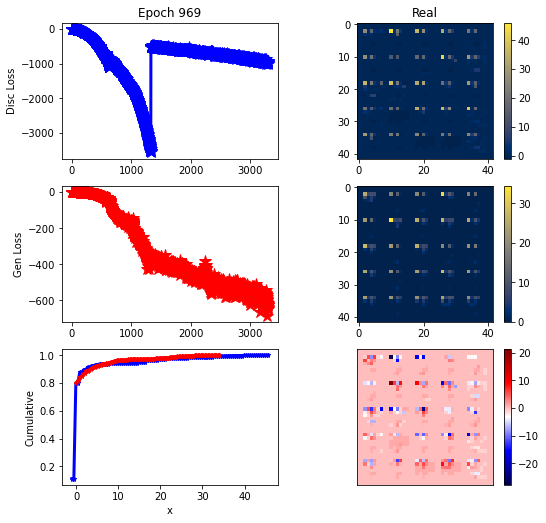

ErrG: -645.8398175920759, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


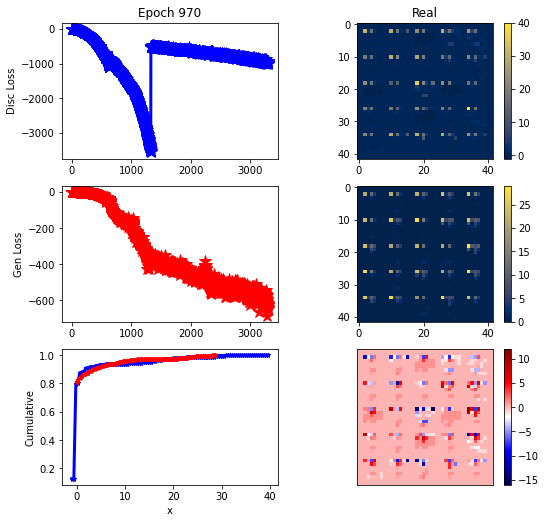

ErrG: -627.5765991210938, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


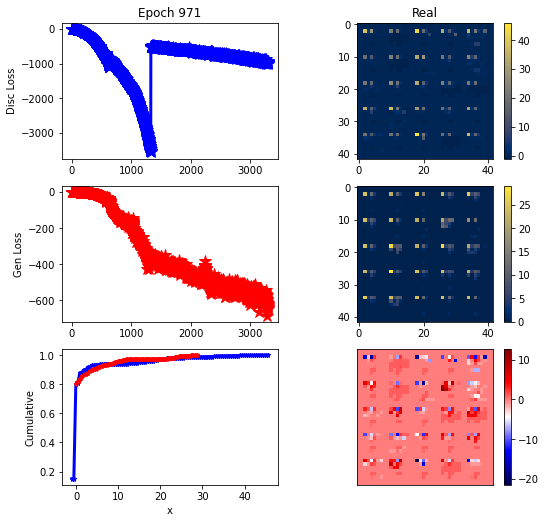

ErrG: -630.6736188616071, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


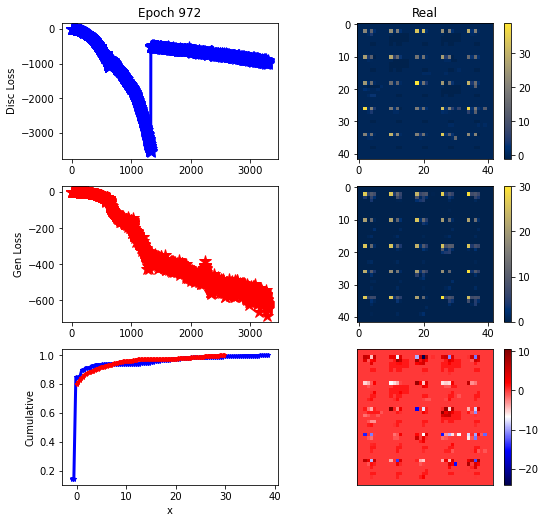

ErrG: -614.5219116210938, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


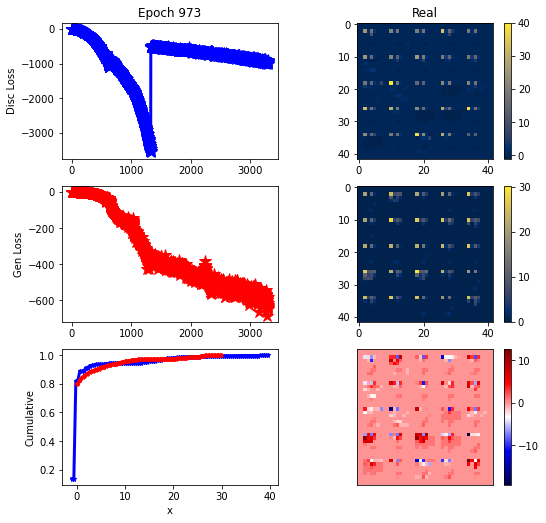

ErrG: -580.9454607282366, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


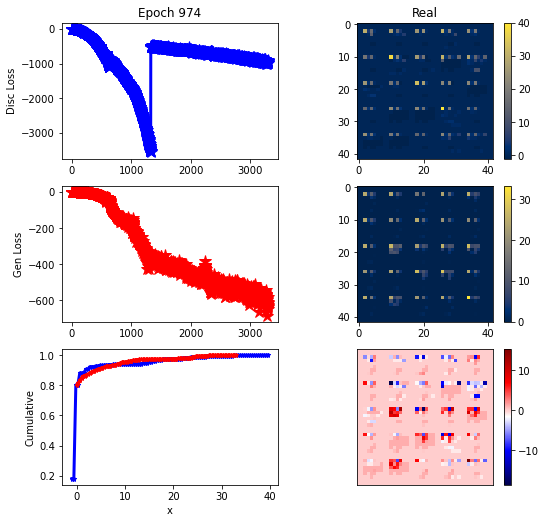

ErrG: -608.9479893275669, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


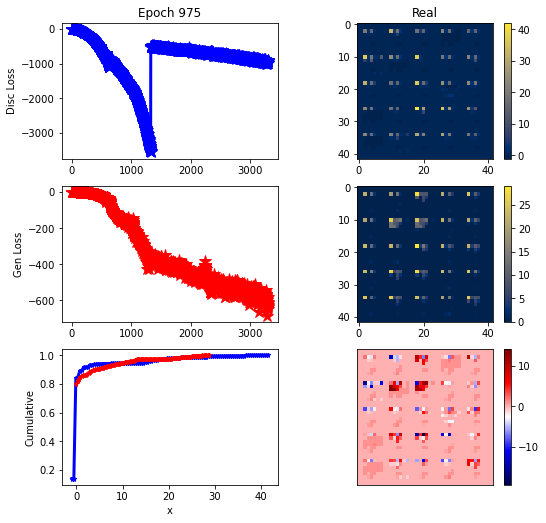

ErrG: -637.0624476841518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


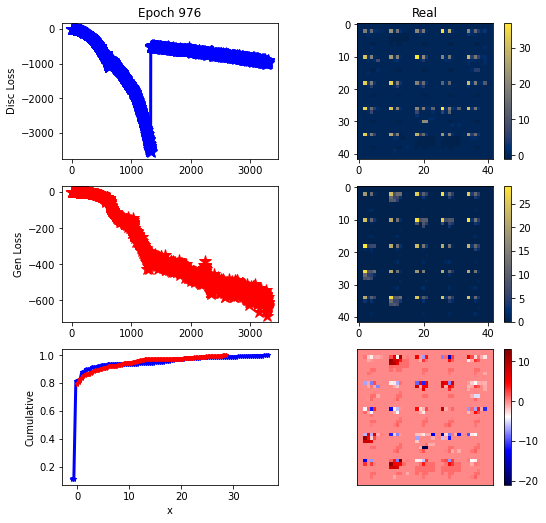

ErrG: -607.545427594866, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


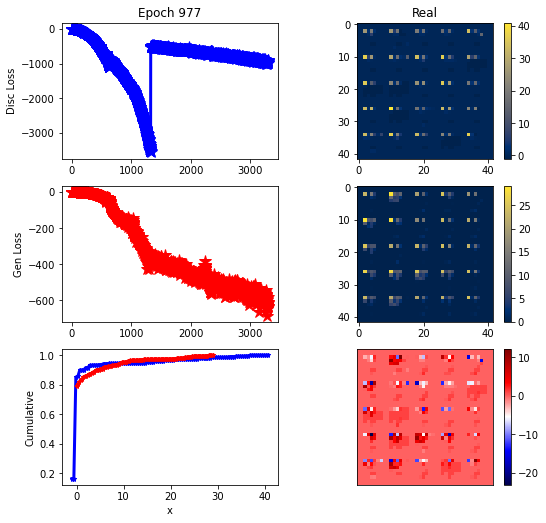

ErrG: -630.5569719587054, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


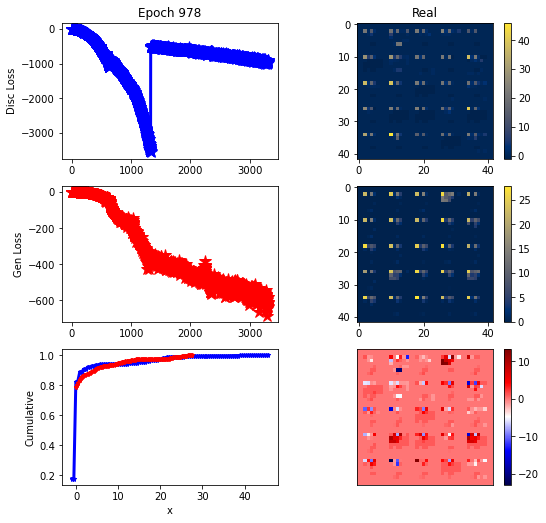

ErrG: -582.2720598493304, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


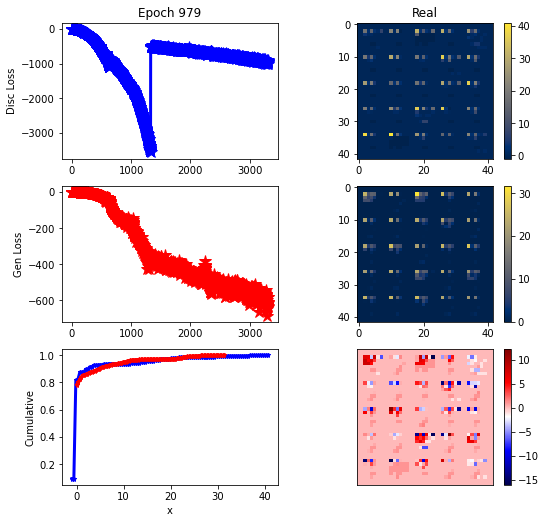

ErrG: -615.308820452009, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


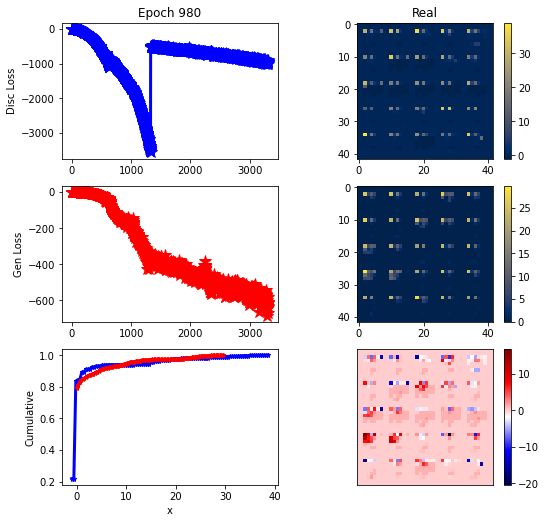

ErrG: -667.5072806222098, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


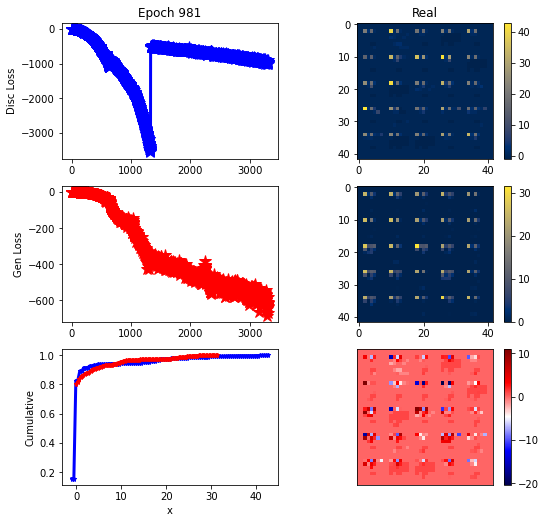

ErrG: -615.0895080566406, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


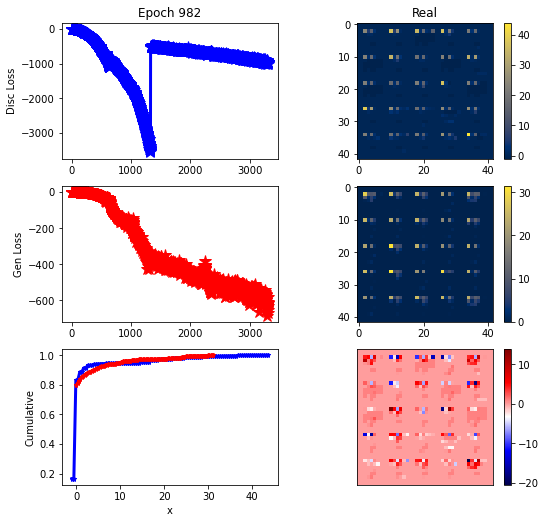

ErrG: -650.5124947684152, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


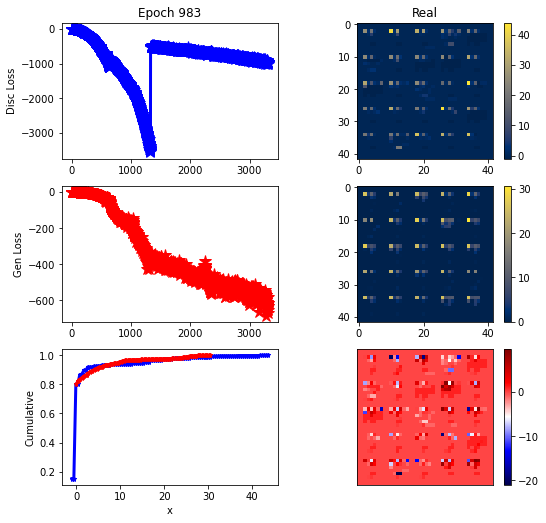

ErrG: -632.3204694475446, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


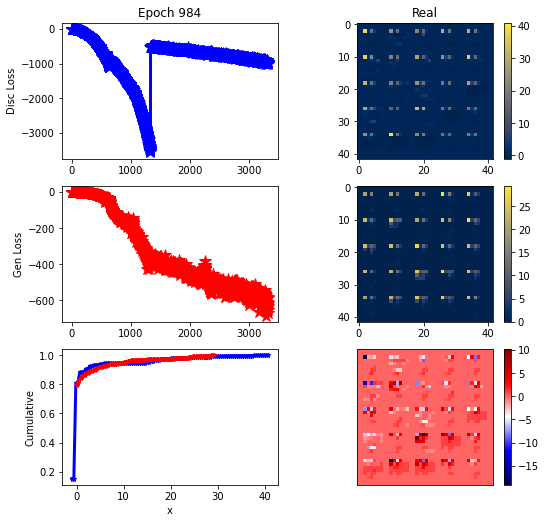

ErrG: -586.7588762555804, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


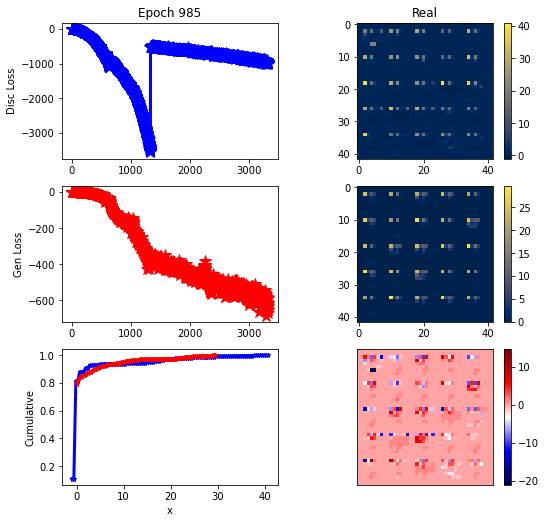

ErrG: -651.5048304966518, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


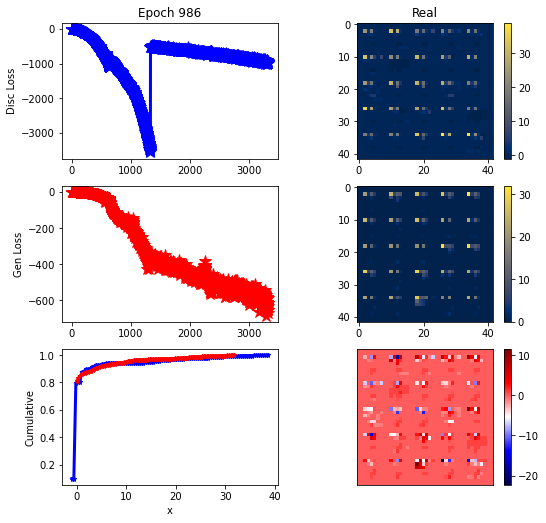

ErrG: -614.5931047712054, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


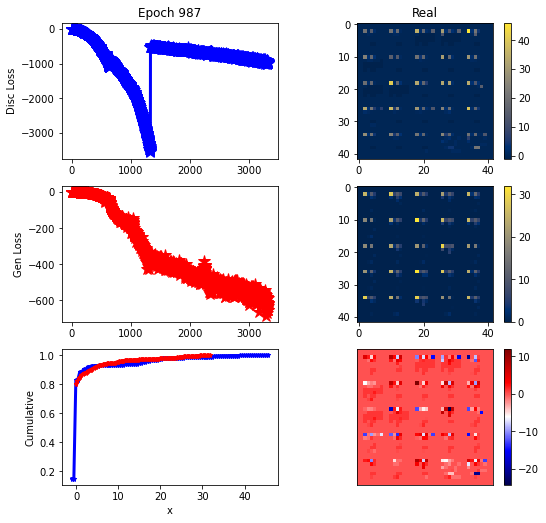

ErrG: -620.0774012974331, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


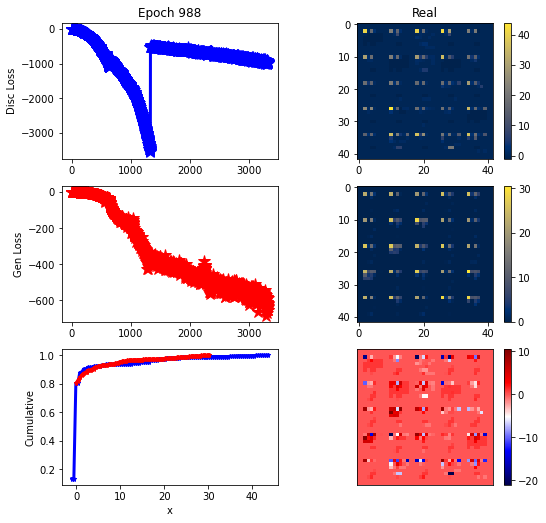

ErrG: -637.4674595424107, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


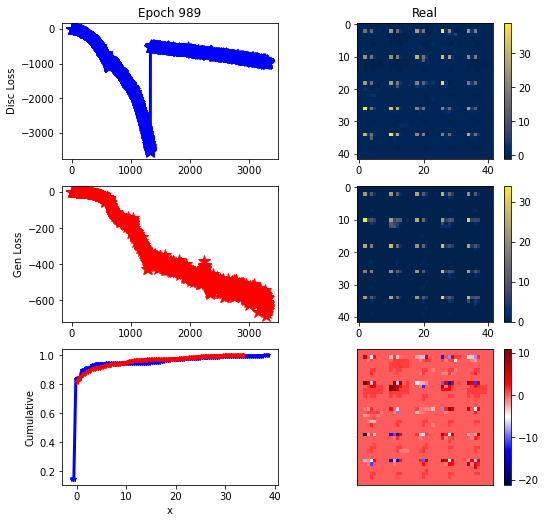

ErrG: -642.0169067382812, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


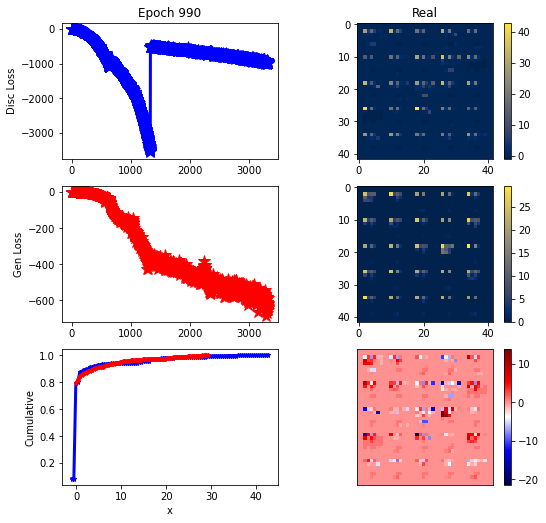

ErrG: -629.4563249860491, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


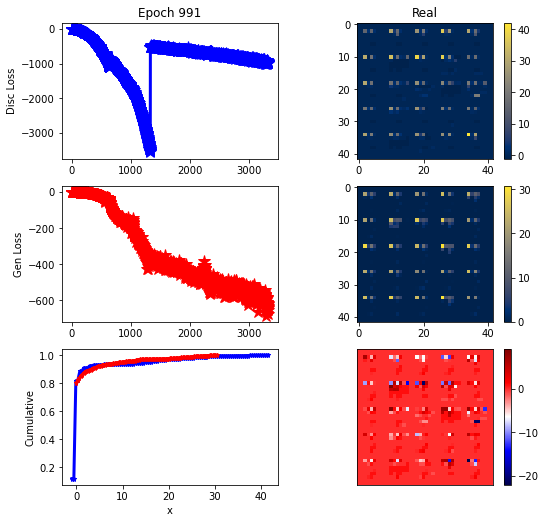

ErrG: -672.284912109375, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


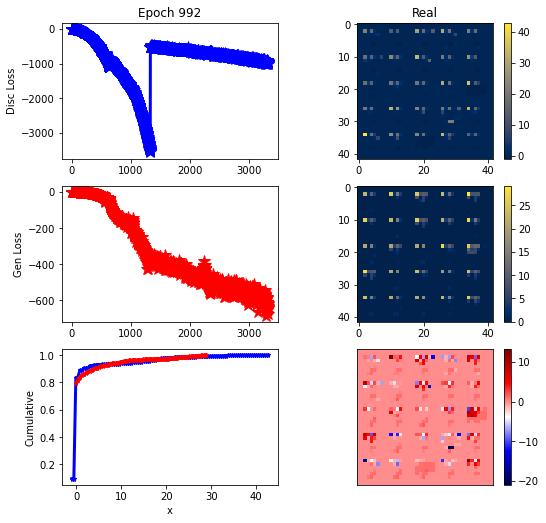

ErrG: -640.3692801339286, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


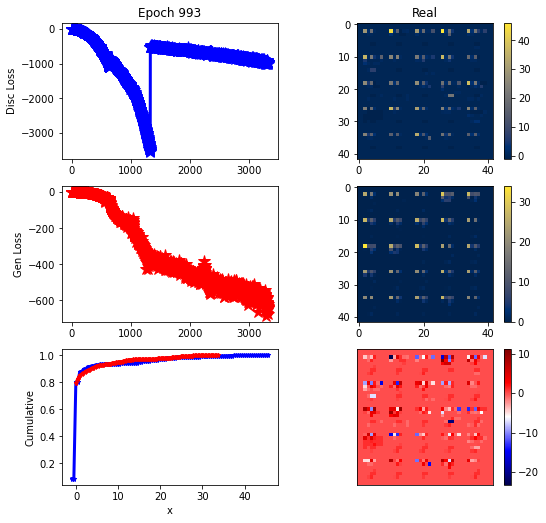

ErrG: -638.1650652204241, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


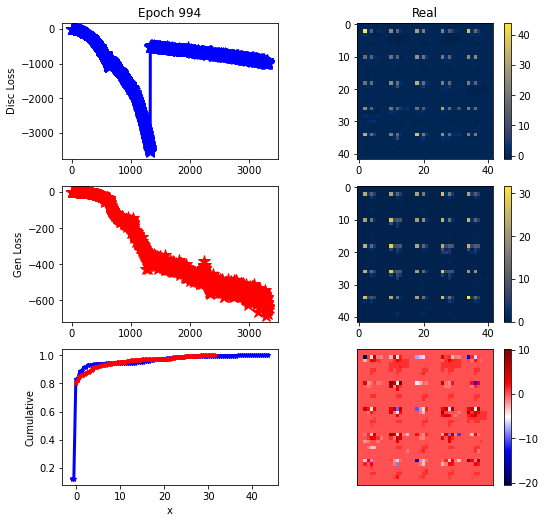

ErrG: -652.1607753208706, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


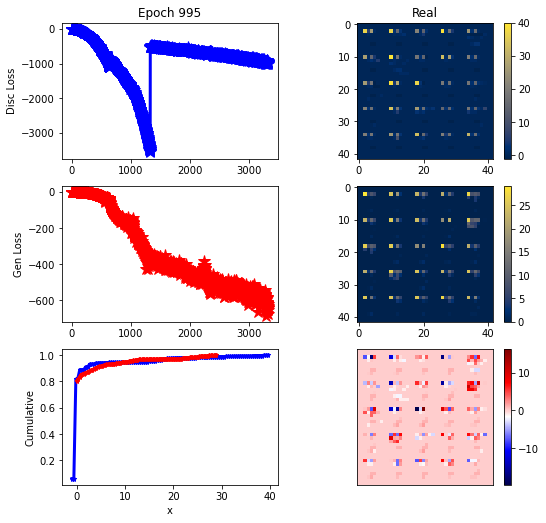

ErrG: -618.8635384695871, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


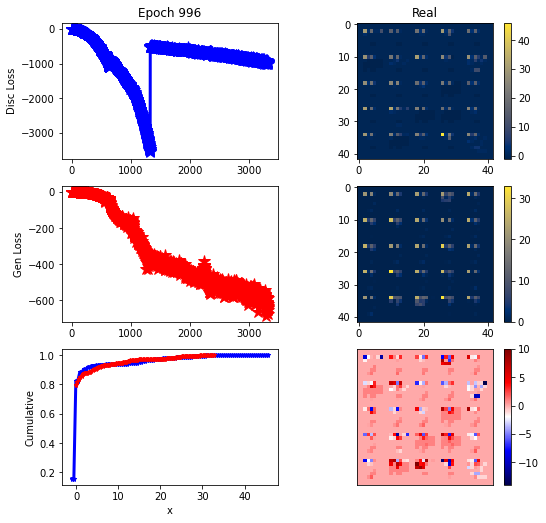

ErrG: -586.3575090680804, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


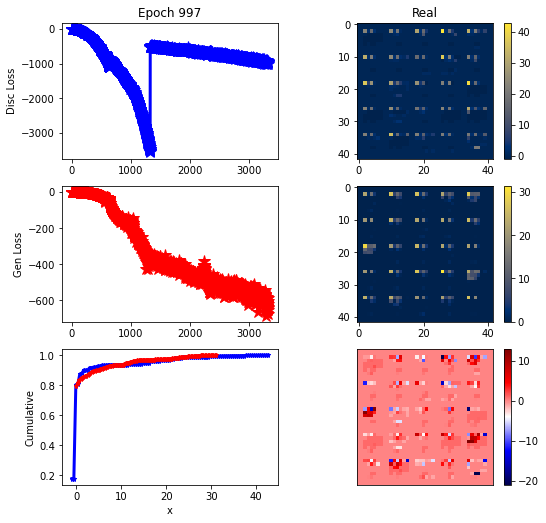

ErrG: -602.3945661272321, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


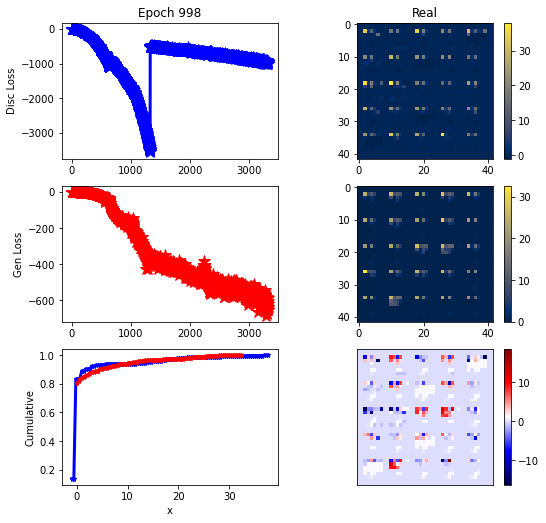

ErrG: -654.0055803571429, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


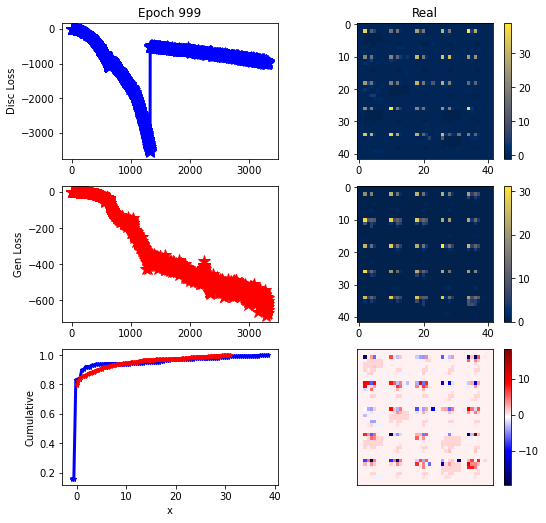

ErrG: -670.1700526646206, ErrReg: 0


/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:48: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b*-" (-> color='b'). The keyword argument will take precedence.
  axs[2, 0].plot(base[:-1], cumulative/np.cumsum(values)[-1], 'b*-',  c='blue', lw=3, ms=5)
/scratch/st-mgorges-1/jtoledom/SynthData/util/plotter.py:49: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r*-" (-> color='r'). The keyword argument will take precedence.
  axs[2, 0].plot(baseFake[:-1], cumulativeFake/np.cumsum(valuesFake)[-1],'r*-',  c='red', lw=3, ms=5)
/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


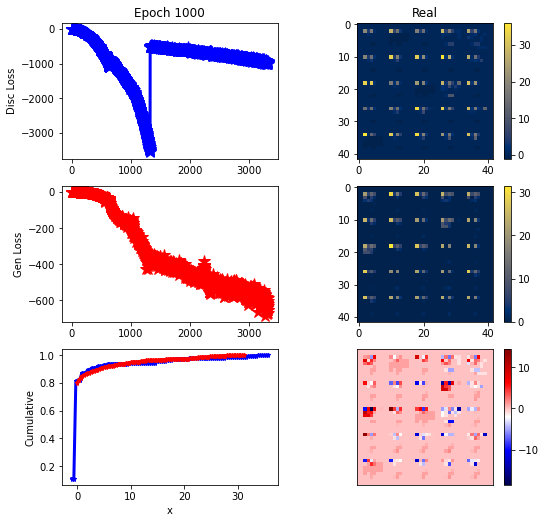

ErrG: -633.2732369559152, ErrReg: 0
Done!!


In [8]:
error_list_D, error_list_G  = train(dict, latentSpace=100, s=6, lam=dict['lambda']).continuetrainWGANs(device, 1000,25)
# error_list_D, error_list_G  = train(dict, latentSpace=100, s=6, lam=dict['lambda']).continuetrainGANs(device, 1000,25)


In [ ]:
#Load network
# clas = MLP().to(device)

#Loss
# criterion = nn.NLLLoss()
# opt = optim.Adam(clas.parameters(), lr=lr)


#TRAIN CLASS
# error_list, acc, accTrain = train().trainClass(100,25)

#TRAIN GANs
# error_list_D, error_list_G  = train().trainGANs(100,25, ngpu=1)
#
error_list_D, error_list_G  = train(s=6, lam=0.001).trainWGANs(2000,25)
#
# error_list_D, error_list_G  = train().trainWGANs_GP(100,25)
#
# error_list_D, error_list_G  = train().trainWGANs_GPandUnroll(100,25)

error_list_D, error_list_G  = train(s=6).continuetrainWGANs(1000,25)

In [6]:
#Load dataloaders
# test, test_label = generateDatasets(PATH, s=6).outputDatasets("test")
# train, train_label = generateDatasets().outputDatasets("train")
# trainloader, testloader = generateDatasets(PATH, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS).getDataLoaders()

/arc/project/st-mgorges-1/jupyter/Py3TorchEnv-2/lib/python3.9/site-packages/torchvision/transforms/transforms.py:280: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


# Generate Synth Data

In [9]:
# dict['PathRoot']#.keys()

@torch.no_grad()
def genSynData(rows=10):
    ar = Reshape(36)(g(torch.randn(rows,100).to(device))).detach().cpu().numpy()
    df = pd.read_csv("/scratch/st-mgorges-1/jtoledom/nobackup/SynData/kag_risk_factors_cervical_cancer.csv")
    dfSyn = pd.DataFrame(ar, columns = df.columns)
    for column in dfSyn.columns:
        dfSyn[column] = dfSyn[column].apply(lambda x: np.ceil(x)).astype(int)
    return dfSyn



In [10]:
try:
    _,_,g = inOut().load_model('Gen', dict, device, tag="Best")
except:
    _,_,g = inOut().load_model('Gen', dict, device)
g.eval();

In [11]:
dfSyn = genSynData(rows=5000)

In [12]:
dfSyn.head()

,Age,Number of sexual partners,First sexual intercourse,Num of pregnancies,Smokes,Smokes (years),Smokes (packs/year),Hormonal Contraceptives,Hormonal Contraceptives (years),IUD,...,STDs: Time since first diagnosis,STDs: Time since last diagnosis,Dx:Cancer,Dx:CIN,Dx:HPV,Dx,Hinselmann,Schiller,Citology,Biopsy
0,31,4,15,4,0,0,0,0,2,1,...,0,0,0,0,1,0,0,0,0,0
1,42,12,13,5,0,0,0,0,6,5,...,0,0,0,0,1,0,0,0,0,0
2,29,0,17,0,0,0,0,0,0,0,...,0,0,0,0,4,1,0,0,0,0
3,27,3,17,5,0,0,0,0,4,2,...,0,0,0,0,1,0,0,0,0,0
4,22,0,19,0,0,0,0,0,0,0,...,0,0,0,0,3,0,0,0,0,0


In [52]:
dfSyn.to_csv("/scratch/st-mgorges-1/jtoledom/nobackup/SynData/synData9.csv", index=False)

In [54]:
dfTemp = pd.read_csv("/scratch/st-mgorges-1/jtoledom/nobackup/SynData/synData9.csv")

In [56]:
dfTemp.shape

(5000, 36)

In [13]:
dfSyn["Biopsy"].sum()

0

(array([4.200e+01, 6.060e+02, 1.070e+03, 1.595e+03, 8.520e+02, 5.680e+02,
        2.200e+02, 3.800e+01, 8.000e+00, 1.000e+00]),
 array([18. , 21.6, 25.2, 28.8, 32.4, 36. , 39.6, 43.2, 46.8, 50.4, 54. ]),
 <BarContainer object of 10 artists>)

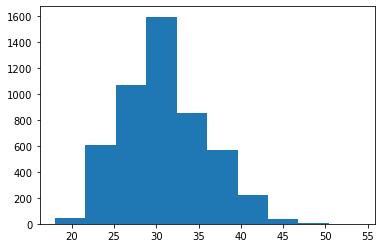

In [14]:
plt.hist(dfSyn["Age"])